##### libraries

In [1]:
# libraries
# base
from scipy.io import arff          # to read .arff format
import pandas as pd                # data manipulation
import numpy as np                 # linear algebra
import matplotlib.pyplot as plt    # plotting
import seaborn as sns              # plotting
from PIL import Image              # images handling

# support
import time                        # time measuring
import random                      # randomness
import pickle                      # object saving/loading

# math
from scipy.stats import spearmanr, wilcoxon  # spearman rho correlation coefficient and wilcoxon median equality test
from math import ceil              # ceil function

# warnings
from  warnings import simplefilter                             # warning handling
from sklearn.exceptions import ConvergenceWarning              # warning handling
from statsmodels.tools.sm_exceptions import ConvergenceWarning # warning handling

# Sklearn/xgboost - Machine Learning
from sklearn.ensemble import RandomForestClassifier                                           # Random Forest
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer              # scalers and power transform
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold                  # splitting, validation
from sklearn.metrics import roc_auc_score, average_precision_score, confusion_matrix          # metrics
from sklearn.metrics import precision_recall_curve, roc_curve                                 # metrics (curves)
from sklearn.decomposition import PCA                                                         # PCA
from xgboost.sklearn import XGBClassifier                                                     # sklearn API for XGB
import statsmodels.formula.api as smf                                                         # formula API for statsmodels


# tensorflow/keras - Deep Learning
import tensorflow as tf             # tensorflow background
from tensorflow import keras        # keras API for tensorflow
from keras import layers            # keras layers
from keras import models            # keras models
from keras import optimizers        # keras optimizers
from keras import activations       # keras activation functions
from keras import losses            # keras loss functions 
from keras import regularizers      # keras regularizers
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras import layers, models, optimizers, activations, losses, regularizers

Using TensorFlow backend.


##### notebook settings

In [2]:
# notebook settings
pd.set_option("display.max_columns", 70)
pd.set_option("display.max_rows", 70)
# ignoring some warnings
simplefilter("ignore", category=ConvergenceWarning) 
np.warnings.filterwarnings('ignore', '(overflow|invalid)')

random_state = 2021

##### preprocessing

 - loading, missing detection

In [3]:
def get_missing_info(data, y):
    '''
    function creates DataFrame of missing value counts and percentage, for a given data and positive, negative
    and positive percentage for a given target, arguments:
    data - dataset to get informations about (DataFrame)
    y - target value (string)
    
    returns - DataFrame object with informations
    '''
    
    # counting missing and calculating the percentage 
    missing_info = pd.DataFrame((data.isna().sum(), data.isna().sum()/data.shape[0]*100)).T
    missing_info.columns = ["missing_count", "missing_percentage"]
    
    # removing rows without missings
    missing_info = missing_info.where(missing_info > 0).dropna().sort_values(by = "missing_percentage", ascending = False)
    
    # target info inicjalization
    missing_info["non_{}_count".format(y)] = np.nan
    missing_info["{}_count".format(y)] = np.nan
    missing_info["{}_percentage".format(y)] = np.nan
    
    # target info colnames
    neg_count, pos_count, pos_per=missing_info.columns.tolist()[2:]
    
    # target info (counting) columns filling
    cols = missing_info.index.tolist()
    for i in cols:
        missing_info.loc[i, pos_count] = data[y].where(data[i].isna()).dropna().sum()
        missing_info.loc[i, neg_count] = data[y].where(
            data[i].isna()).dropna().shape[0]-missing_info.loc[i, pos_count]
    
    # target info (percentage) column filling
    missing_info[pos_per] = np.round(
        missing_info[pos_count]/(missing_info[neg_count]+missing_info[pos_count])*100, 2)
    
    
    return missing_info

In [4]:
# data loading
data = arff.loadarff(r"data\4year.arff")
data = pd.DataFrame(data[0])

# decoding target variable
data.rename({'class':'bankrupt'}, axis = 1, inplace = True)
data['bankrupt'].replace(b'1', 1, True)
data['bankrupt'].replace(b'0', 0, inplace=True)

In [5]:
get_missing_info(data, "bankrupt")

,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr37,4442.0,45.363562,4183.0,259.0,5.83
Attr27,641.0,6.546160,487.0,154.0,24.02
Attr60,614.0,6.270425,561.0,53.0,8.63
Attr45,613.0,6.260212,560.0,53.0,8.65
Attr64,231.0,2.359069,203.0,28.0,12.12
Attr54,231.0,2.359069,203.0,28.0,12.12
Attr53,231.0,2.359069,203.0,28.0,12.12
Attr28,231.0,2.359069,203.0,28.0,12.12
Attr24,211.0,2.154820,211.0,0.0,0.00
Attr41,187.0,1.909722,187.0,0.0,0.00


Columns to drop because of:
1. Too many missings:
 - Attr37,
 - Attr27,
 - Attr60,
 - Attr45,
2. Potential data leakage:
 - Attr21 (72% of missing data is a bankrupt class - when we observe data missing the algorithm could made a rule of predicting positive class (vast miniority of target) - unreasonable)

In [6]:
# column dropping
data.drop(labels = ["Attr37", "Attr27", "Attr60", "Attr45", "Attr21"], axis = 1, inplace = True)

 - functions for data imputation

In [7]:
def ProximityMatrix(RF, X, normalize = True):    
    '''
    function computes the proximity matrix for given (trained) random forest and data, arguments:
    RF - trained Random Forst classifier,
    X - data to apply RF,
    normalize - boolean, if true then proximity_matrix = proximity_matrix/num_of_Trees
    
    returns proximity matrix (np.arraty)
    -----
    note: this function is based on stackoverflow topic:
        https://stackoverflow.com/questions/18703136/proximity-matrix-in-sklearn-ensemble-randomforestclassifier
        
    '''
    
    # leaves indices for each x in X
    leaves = RF.apply(X)
    # number of trees
    nTrees = leaves.shape[1]
    # inicjalization (first iteration) proximity matrix
    proximity_matrix = np.equal.outer(leaves[:,0], leaves[:,0]).astype('float')
        # outer applies a function, here equal for each pair in the arguments (leaves[:,0] with itself) ->
        # we get proximities for the first column (first Tree), proximity_matrix[i,j] = 1 <=> i == j,
        # where i, j are indices of leaves for each sample
        # note: proximity_matrix is not the product of the Attr's, its a product of the Trees and the indices of its nodes

    # iteration through the rest of the trees
    for i in range(1, nTrees):
        proximity_matrix += np.equal.outer(leaves[:,i], leaves[:,i]).astype('float')
            
    proximity_matrix = (proximity_matrix/nTrees) if normalize == True else proximity_matrix

    return proximity_matrix    

def RFimputation(dta, n_iter, target, *args, **kwargs):
    '''
    Random Forest proximity based data imputer for a continuous features. Missing are inicialized with median of the 
    feature, after that random forest classifier is trained then based on node ID for particular observation simillarity 
    is determined and proximity matrix is computed and rescaled. 1-proximity is distance. Proximity is a weight in weighted
    average formula for a missing item. The process is repeated normally 5-7 times. Arguments:
    dta - dataset with continuous features with missings,
    n_iter - number of algorithm iterations
    target - target variable
    
    return imputed dataset, missing indices, history of process, missings changes during training 
    '''
    import time
    pd.set_option('mode.chained_assignment', None)
    
    start = time.time()
    # data copy to operate
    df = dta.copy()
    
    # features list
    features = [i for i in df.columns.tolist() if i != target]
    
    # Attr's missings indices inicialization
    # key - attr, value - indices
    attrs_indices = {}

    # Attr's updated values 
    # key - attr, value - imputed values
    attrs_values = {}

    # getting missings indices for each attr and set it to the median 
    for attr in features:
        # indices of missing data for each attribute
        indices = df[attr][df[attr].isna()].index.tolist()
        # median
        median = df[attr].median(skipna=True, axis=0)
        # imputation
        df.loc[indices, attr] = median
        # updating Attr's missings indices dictionary
        attrs_indices[attr] = indices
        # updating Attr's missings updated values dictionary
        attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()


    # ********* IMPUTATION LOOP *************** #
    # history inicialization
    history = {}
    # history is a dictionary keys = iteration, keys = dictionary of attrs:lists of missings
    history["iteration_0"] = attrs_values.copy()

    for i in range(n_iter):
        # build and train a classifier (RF)
        clf = RandomForestClassifier(*args, **kwargs) 
        clf.fit(df[features], df[target])

        # compute proximity matrix
        pm = ProximityMatrix(clf, df[features], True)

        # compute weight matrix (each row divided by its sum)
        pm_div = pm/pm.sum(axis = 1, keepdims = True)

        # reset missing values (= 0) (after that, weighted average excludes missing indices, is just a dot product)
        for attr in features:
            df[attr][attrs_indices[attr]] = 0

        # computing imputation matrix - weighted average formula (shape: (n_observations, n_features))
        imputation_matrix = np.dot(pm_div, df.values)

        # data imputation
        for attr in features:
            # attr index in df 
            attr_index = features.index(attr)
            # imputing data (weighted average based on proximity matrix)
            df[attr][attrs_indices[attr]] = imputation_matrix[attrs_indices[attr], attr_index]
            # updating Attr's missings updated values dictionary
            attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()
        
        # history update
        history["iteration_{}".format(i+1)] = attrs_values.copy()
    
    # ********* historical changes *************** #
    iterations = list(history.keys())
    # history changes dictionary inicialization
    # key: iteration, value: dictionary
    #                        key: attr, value: percentage change
    history_changes = history.copy()
    # keys for history_changes (excluding "zero" iteration)
    changes_keys = iterations[1:]

    for i in range(len(iterations)-1):
        # values for calculations (concrete iterations)
        itr_prev = iterations[i]
        itr = iterations[i+1]
        # list of the attr's
        attrs = list(history[itr].keys())
        for attr in attrs:
            # transform to array
            itr_prev_array = np.array(history[itr_prev][attr])
            itr_array = np.array(history[itr][attr])
            # change computation
            change = np.abs((itr_array - itr_prev_array) / itr_prev_array)
            # saving historical changes
            history_changes[itr][attr] = change
    
    # final shape of history_changes (excluding "zero" iteration)
    history_changes = {key: history_changes[key] for key in changes_keys}

    stop = time.time()
    print("Imputation time: {} seconds".format(round(stop - start), 2))
    return df, attrs_indices, history, history_changes

 - class for data standarization:
     - for CNN:
         $$0<int(x_{norm}=\frac{x-\mu}{\sigma}*100+128)<255$$
     - for other algorithms:
         $$x_{norm}=\frac{x-\mu}{\sigma}$$
 - integrated with:
     - outliers reduction with quantiles clipping,
     - Yeo-Johnson power transform, defined:
     $$\begin{cases}
    \frac{((y_i+1)^\lambda)-1)}{\lambda}         & \quad \text{if } \lambda \neq0, y\geq0\\
    \ln{(y_i+1)}                                 & \quad \text{if } \lambda=0, y\geq0\\
    \frac{-[(-y_i+1)^{2-\lambda}-1]}{2-\lambda}  & \quad \text{if } \lambda \neq2, y<0\\
    -\ln{(-y_i+1)}                               & \quad \text{if } \lambda=2, y<0
        \end{cases}$$

In [8]:
class scaler:
    
    def __init__(self, images=True):
        '''
        Class for normalizer-object which transforms vector of features to [0,255] vector of colour-scale, formula:

                                            0<int((x-mu)/sigma*100+128)<255

        where:
        x - feature vector,
        mu - mean(x),
        sigma - standard_deviation(x),
        int(.) - operation of rounding to integer.

        or for standarizing to zero mean and unit variance.
        
        arguments:
        images - boolean, when True [0,255] int standarization applied, when False zero mean and unit variance standarization applied.
        -------------
        note: scaler is integrated with quantile clipping.
        '''
        self.option=images
        self.mean=None
        self.std=None
        self.left_tail=None
        self.right_tail=None
        self.transformer=None
        
    def fit(self, X, q=None, power_transform=False):
        '''
        Function fits scaler to the data, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame),
        q - optional, quantile for clipping data before fit (float),
        power_transform - apply Yeo-Johnson power transformation (boolean).
        -------------
        note: quantile clipping is symmetric, when q=0.05 passed then function computes q_95 also for clipping left and
              right distribution tails. 
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        
        # quantile computations
        if q is not None:
            # saving quantiles in __init__
            self.left_tail=np.quantile(a=X, q=q, axis=0)
            self.right_tail=np.quantile(a=X, q=1-q, axis=0)
            # computing new X
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
                
        if power_transform==True:
            self.transformer=PowerTransformer(method='yeo-johnson', standardize=True)
            self.transformer.fit(X=X)
            X=self.transformer.transform(X=X)
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
        else:
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
    
    def transform(self, X):
        '''
        Function transforms data with fitted scaler, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame)
        
        return normalized data (numpy.array)
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        if X.shape[1]!=self.mean.shape[0]:
            raise error("X has {} columns while scaler was fitted on matrix with {} columns".format(X.shape[1], 
                                                                                              len(self.mean)))
        # quantile clipping if necessary
        try:
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
        except:
            pass 
        
        # normalization for images
        if self.option==True:
            try:
                # with power transform
                X=np.round(self.transformer.transform(X=X)*100+128)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=np.round((X[:,i]-self.mean[i])/self.std[i]*100+128)

            # [0,255] clipping
            X=X.clip(min=0, max=255)
        # normalization for float output
        else:
            try:
                # with power transform
                X=self.transformer.transform(X=X)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=(X[:,i]-self.mean[i])/self.std[i]
        
        return X

 - data splitting

In [9]:
# variables for target and features
target = "bankrupt"
features = [i for i in data.columns.tolist() if i != target]

In [10]:
# data splitting - train and test sets

X_train, X_test, Y_train, Y_test = train_test_split(data[features], data[target], stratify = data[target],
                                                 test_size = 0.1, random_state = random_state)
train_set = pd.concat((X_train, Y_train), axis=1)
train_set.reset_index(inplace=True, drop=True)
test_set = pd.concat((X_test, Y_test), axis=1)
test_set.reset_index(inplace=True, drop=True)

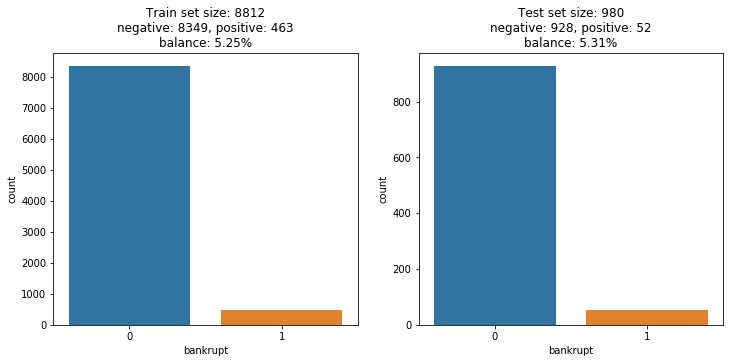

In [11]:
# sets balance vizualization

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (12,5))
sns.countplot(train_set[target], ax = ax[0])
sns.countplot(test_set[target], ax = ax[1])

ax[0].set_title("Train set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    train_set[target].shape[0], sum(train_set[target]==0), sum(train_set[target]==1),
    round(sum(train_set[target]==1)/train_set.shape[0]*100, 2)))
ax[1].set_title("Test set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    test_set[target].shape[0], sum(test_set[target]==0), sum(test_set[target]==1),
    round(sum(test_set[target]==1)/test_set.shape[0]*100, 2)))

plt.show()

##### Data imputation for train and test set

In [12]:
print("\t\t\t\tTRAIN SET MISSINGS")
get_missing_info(train_set, target)

				TRAIN SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr64,209.0,2.371766,184.0,25.0,11.96
Attr54,209.0,2.371766,184.0,25.0,11.96
Attr53,209.0,2.371766,184.0,25.0,11.96
Attr28,209.0,2.371766,184.0,25.0,11.96
Attr24,190.0,2.156151,190.0,0.0,0.00
Attr41,164.0,1.861099,164.0,0.0,0.00
Attr32,79.0,0.896505,77.0,2.0,2.53
Attr52,63.0,0.714934,63.0,0.0,0.00
Attr47,62.0,0.703586,62.0,0.0,0.00
Attr63,37.0,0.419882,36.0,1.0,2.70


In [13]:
print("\t\t\t\tTEST SET MISSINGS")
get_missing_info(test_set, target)

				TEST SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr41,23.0,2.346939,23.0,0.0,0.00
Attr64,22.0,2.244898,19.0,3.0,13.64
Attr28,22.0,2.244898,19.0,3.0,13.64
Attr54,22.0,2.244898,19.0,3.0,13.64
Attr53,22.0,2.244898,19.0,3.0,13.64
Attr24,21.0,2.142857,21.0,0.0,0.00
Attr32,17.0,1.734694,16.0,1.0,5.88
Attr52,13.0,1.326531,12.0,1.0,7.69
Attr47,11.0,1.122449,11.0,0.0,0.00
Attr63,6.0,0.612245,6.0,0.0,0.00


In [14]:
# Train set imputation
train_set_imp, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_set, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
test_set_imp, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(test_set, n_iter=10,
                                                                                     target=target, n_estimators=100,
                                                                                     n_jobs=-1, max_depth=8,
                                                                                     random_state=random_state)

train_test_imp_sets = dict(zip(["train_set_imp", "test_set_imp"], [train_set_imp, test_set_imp]))

# SAVING IMPUTED TRAIN AND TEST SET as dict
with open(r"data\4year_data\train_test_imp_sets_4year.p", "wb") as fp:
    pickle.dump(train_test_imp_sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 367 seconds
Imputation time: 9 seconds


In [14]:
# LOADING IMPUTED TRAIN AND TEST SET
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

##### training distribution analysis

							 RAW DATA


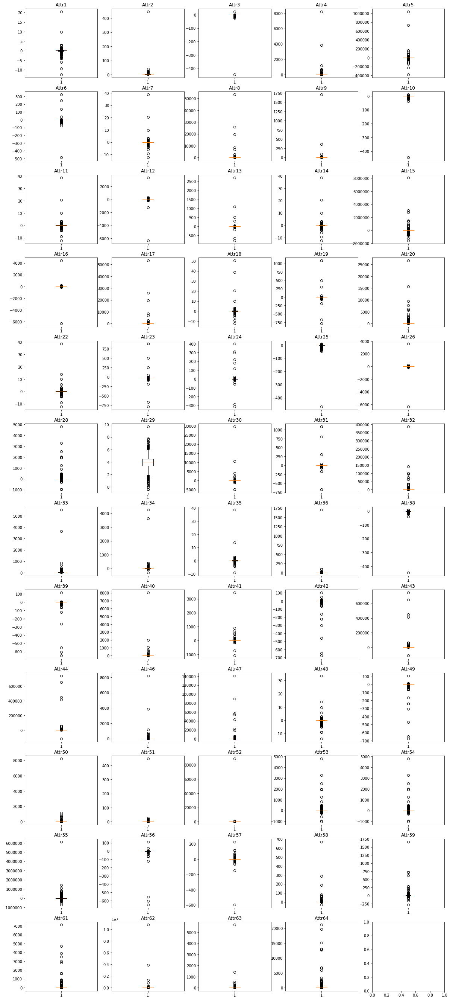

In [15]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t RAW DATA")
plt.show()

Lots of outliers, lets reduce them with quantiles

In [16]:
q=0.005
lb=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=q, axis=0)
ub=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=1-q, axis=0)

for i, feature in enumerate(features):
    train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature]=train_set_imp.loc[
        (train_set_imp[target]==0)|(train_set_imp[target]==1),feature].apply(
        lambda x: lb[i] if x<lb[i] else ub[i] if x>ub[i] else x)

							 Q_0.005 and Q_0.995 replaced


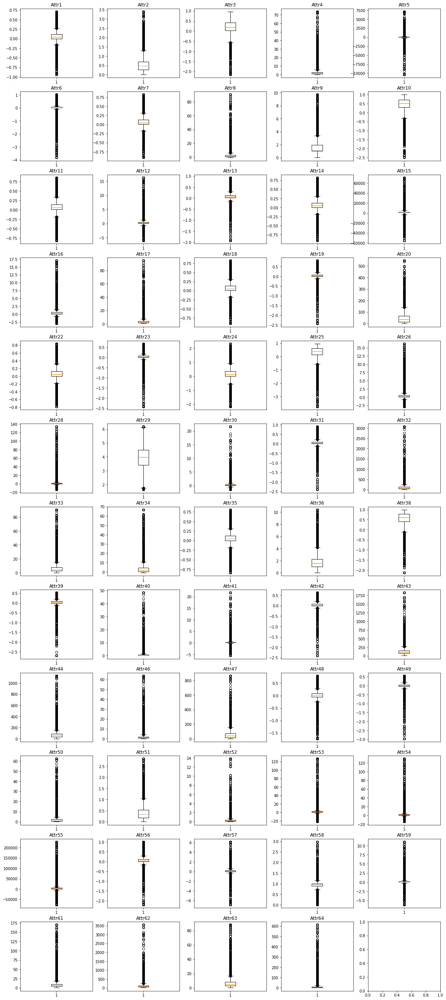

In [17]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

							 Q_0.005 and Q_0.995 replaced


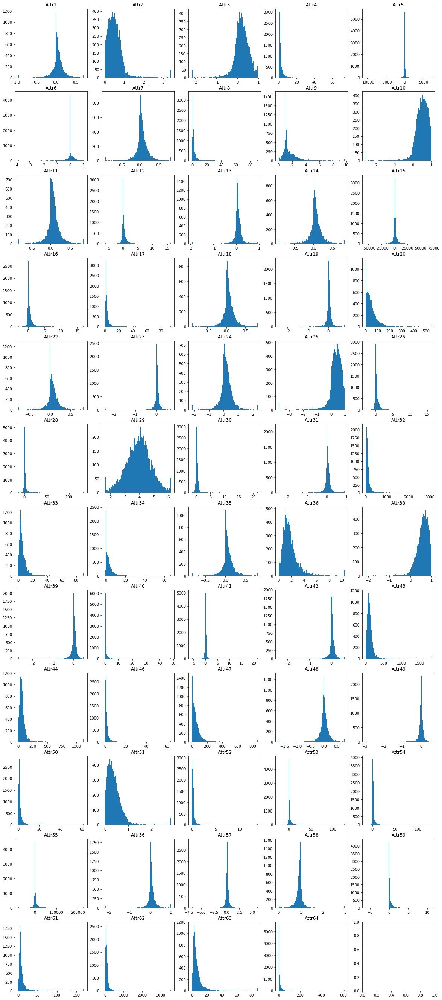

In [18]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

skewness is very big in this data, lets apply some power transforms.

In [19]:
transformer = PowerTransformer(method="yeo-johnson", standardize=False)
transformer.fit(X=train_set_imp[features])
train_set_imp_pt = pd.DataFrame(transformer.transform(X=train_set_imp[features]), columns=features)

				 Q_0.005 and Q_0.995 replaced, power transform applied


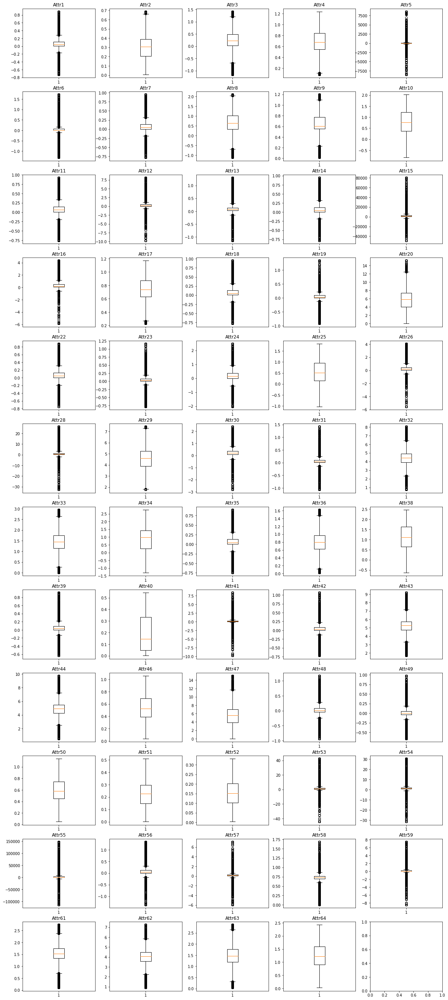

In [20]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

				 Q_0.005 and Q_0.995 replaced, power transform applied


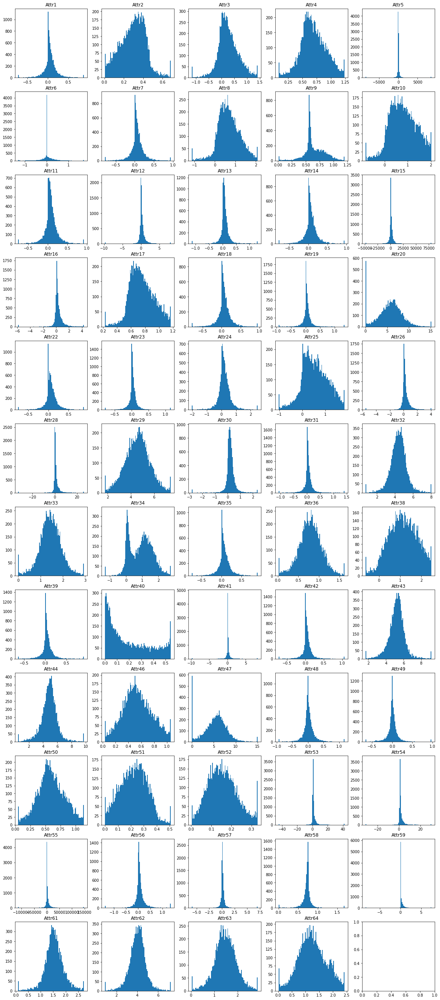

In [21]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

In [22]:
# print fitted lambdas
pd.Series(transformer.lambdas_, index=features, name="lambdas")

Attr1     1.734095
Attr2    -1.218263
Attr3     1.986738
Attr4    -0.781050
Attr5     1.023733
Attr6     2.242925
Attr7     1.430025
Attr8    -0.400158
Attr9    -0.662928
Attr10    2.709381
Attr11    1.237418
Attr12    0.640265
Attr13    1.886850
Attr14    1.430197
Attr15    1.012233
Attr16    0.262731
Attr17   -0.836192
Attr18    1.419081
Attr19    2.484488
Attr20    0.247202
Attr22    1.155575
Attr23    2.795542
Attr24    1.092160
Attr25    2.578480
Attr26    0.237704
Attr28    0.561863
Attr29    1.142391
Attr30   -0.183275
Attr31    2.232269
Attr32    0.000014
Attr33   -0.204974
Attr34   -0.217366
Attr35    1.354413
Attr36   -0.360046
Attr38    3.146779
Attr39    3.273945
Attr40   -1.840049
Attr41    0.551482
Attr42    2.952577
Attr43    0.051248
Attr44    0.088315
Attr46   -0.925094
Attr47    0.211453
Attr48    2.139424
Attr49    3.231970
Attr50   -0.851904
Attr51   -1.791857
Attr52   -3.023902
Attr53    0.707023
Attr54    0.610579
Attr55    0.961676
Attr56    1.734429
Attr57    1.

After skewness and outliers reduction zero mean and unit variance standarization is necessary.

In [23]:
normalizer=StandardScaler()
normalizer.fit(X=train_set_imp_pt)
train_set_imp_pt_norm=pd.DataFrame(normalizer.transform(X=train_set_imp_pt), columns=features)

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


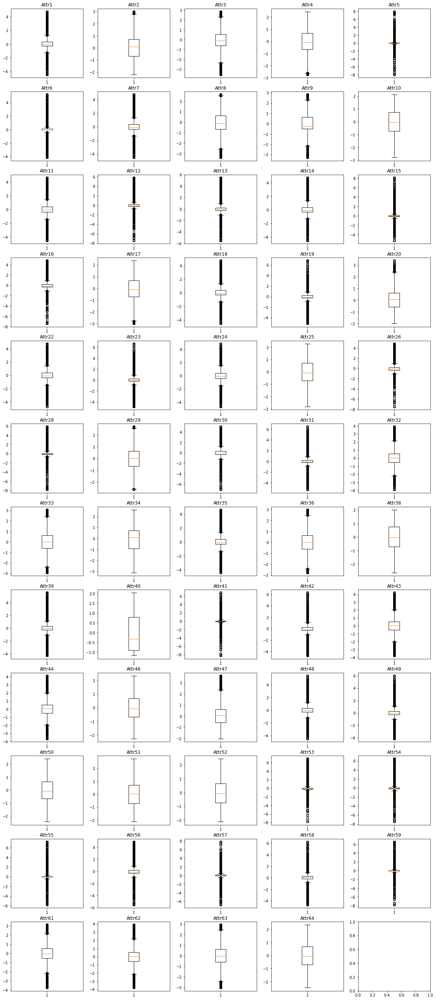

In [24]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


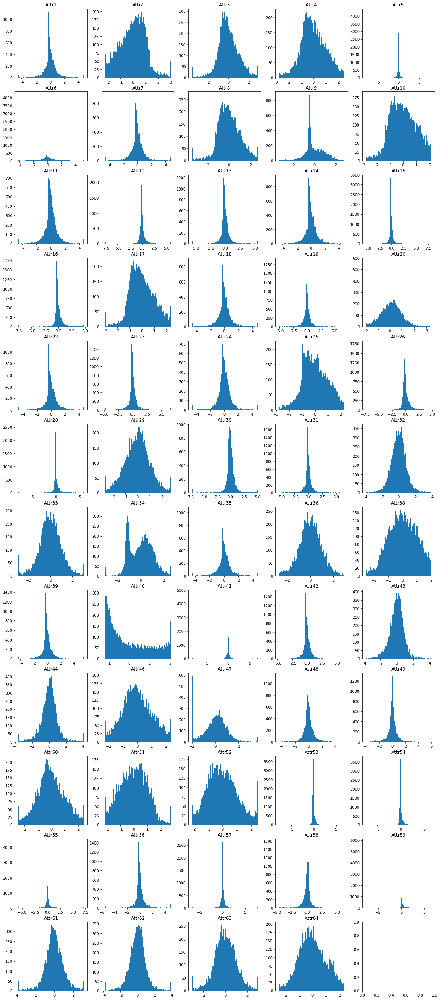

In [25]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

Distributions looks much better now, Gaussian-shape is not achived, however outliers and skewness are reduced. Attr40 distribution looks problematic (two modes). Attr40 also is not looking great.

Really similar results to 5year data (one year forecast horizon), maybe a bit more outliers found (in terms of quantiles), but achived distributions looks good enough.

##### Modelling 
 - preparing folds for n-fold Cross Validation (with imputation, just for time saving - one fold imputation takes 120 seconds on average, it does not make sense to perform it during hyperparameters optimization especially with fixed random seed)

In [27]:
# sets inicialization
trains=[]
valids=[]

# Stratification object
kf = StratifiedKFold(6, shuffle=True, random_state=random_state)
for train, valid in kf.split(train_set, train_set[target]):
    # extracting sets
    train_data = train_set.loc[train,:].copy()
    valid_data = train_set.loc[valid,:].copy()
    # reset index
    train_data.reset_index(drop=True, inplace=True)
    valid_data.reset_index(drop=True, inplace=True)
    # imputation
    train_data, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    valid_data, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(valid_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    
    # saving
    trains.append(train_data)
    valids.append(valid_data)
    
sets = {"training_sets" : trains,
        "validation_sets" : valids}

#SAVING
with open(r"data\4year_data\sets.p", "wb") as fp:
    pickle.dump(sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 313 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 305 seconds
Imputation time: 16 seconds
Imputation time: 304 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 324 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 320 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 322 seconds
Imputation time: 16 seconds


In [26]:
#LOADING
with open(r"data\4year_data\sets.p", "rb") as fp:
    sets = pickle.load(fp)

##### Logistic regression

In [27]:
def Logit_6FoldCrossValidation(datasets, features, target, random_state, normalize=False, q=None, alpha="none", info=0):
    '''
    function performes 6 fold Cross Validation for Logistic Regression, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    random_state - random seed,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    alpha - L1 norm regularization parameter, "none" for no regularization, (0,inf) for regularization
    info - folds' info
    
    returns Logit_history - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for Logistc Regression
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # Logistic Regression training
        formula = "{}~{}".format(target, "+".join(features))
        LogitRegression = smf.logit(formula, pd.concat((X_train, Y_train), axis=1))
        if alpha == "none":
            LogitRegression=LogitRegression.fit(method="powell", maxiter=1000, disp=info)
        else:
            LogitRegression=LogitRegression.fit_regularized(method="l1", alpha=alpha, disp=info)
        
        # metrics
        predsTrain = LogitRegression.predict(exog=X_train)
        predsValid = LogitRegression.predict(exog=X_valid)
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    Logit_history={"train_roc" : trainROCs,
                   "train_pr" : trainPRs,
                   "valid_roc" : validROCs,
                   "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))

    return Logit_history

In [30]:
# without normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=False, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\l


Cross validation time: 68s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 23s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 24s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 25s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.08 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 25s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 19s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.5 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 15s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 15s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 13s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 12s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 11s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 11s

alpha: none
train_roc 0.7652431407444164
train_pr 0.18875053960632193
valid_roc 0.7328931089025228
valid_pr 0.1432048805443393

alpha: 0.01
train_roc 0.7920594900030778
train_pr 0.2185646803666664
valid_roc 0.7589412651108529
valid_pr 0.1603600406467454

alpha: 0.03
train_roc 0.7922246374828489
train_pr 0.2184093860623777
valid_roc 0.7594322374590848
valid_pr 0.16089171279148431

alpha: 0.05
train_roc 0.792396743485572
train_pr 0.21841243537212254
valid_roc 0.7593470123558871
valid_pr 0.16143663108775885

alpha: 0.08, - failure

alpha: 0.1
train_roc 0.7924985141086797
train_pr 0.21811831341956012
valid_roc 0.7595352676663566
valid_pr 0.16242537220286873

alpha: 0.3
train_roc 0.7926883481157758
train_pr 0.2176999577687159
valid_roc 0.7602707696351564
valid_pr 0.16366769587545754

alpha: 0.5, - failure

alpha: 0.8
train_roc 0.7913444089627086
train_pr 0.21527819549226648
valid_roc 0.7597290145607221
valid_pr 0.16444335465411855

alpha: 1
train_roc 0.790367966

In [31]:
# with normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 44s

Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 24s

Cross validation time: 25s

Cross validation time: 27s

Cross validation time: 21s

Cross validation time: 16s

Cross validation time: 14s

Cross validation time: 10s

Cross validation time: 8s

Cross validation time: 8s

Cross validation time: 7s

alpha: none
train_roc 0.765776664221386
train_pr 0.18988149145839142
valid_roc 0.7356320554388801
valid_pr 0.14219556045277487

alpha: 0.01
train_roc 0.7903700341392074
train_pr 0.21436285435698174
valid_roc 0.7586311362449218
valid_pr 0.1612876619207163

alpha: 0.03
train_roc 0.7881872386659964
train_pr 0.20985362315544628
valid_roc 0.7555311579023124
valid_pr 0.15740745650962232

alpha: 0.05
train_roc 0.788111148480595
train_pr 0.20844444234881468
valid_roc 0.7560572429201423
valid_pr 0.15658184666628616

alpha: 0.08
train_roc 0.7861247950371686
train_pr 0.20518006352262805
valid_roc 0.755123702980460

In [33]:
# with normalization and outlier reduction (q=0.005)
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))


Cross validation time: 28s

Cross validation time: 24s

Cross validation time: 22s

Cross validation time: 20s

Cross validation time: 19s

Cross validation time: 19s

Cross validation time: 16s

Cross validation time: 14s

Cross validation time: 13s

Cross validation time: 12s

Cross validation time: 11s

Cross validation time: 10s

Cross validation time: 10s

Cross validation time: 9s

alpha: none
train_roc 0.7910412473976507
train_pr 0.24803860790820362
valid_roc 0.7532612068018251
valid_pr 0.19355667375916882

alpha: 0.01
train_roc 0.792127885300944
train_pr 0.24926499755120687
valid_roc 0.7509822938161519
valid_pr 0.1921152840051482

alpha: 0.03
train_roc 0.7921116787584168
train_pr 0.24913085687423667
valid_roc 0.7511117338099291
valid_pr 0.1919240616523473

alpha: 0.05
train_roc 0.7920936673154393
train_pr 0.24907616936474422
valid_roc 0.7511082901655609
valid_pr 0.1920679309870604

alpha: 0.08
train_roc 0.7920403180362108
train_pr 0.24895342524527334
valid_roc 0.75100578638950

a little improvement, approx 0.03

In [34]:
# with normalization and outlier reduction (q=0.005) and power transform
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize="power", q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 35s

Cross validation time: 28s

Cross validation time: 28s

Cross validation time: 27s

Cross validation time: 28s

Cross validation time: 28s

Cross validation time: 19s

Cross validation time: 18s

Cross validation time: 16s

Cross validation time: 16s

Cross validation time: 16s

Cross validation time: 15s

Cross validation time: 14s

Cross validation time: 14s

alpha: none
train_roc 0.8099557871635534
train_pr 0.339238176098809
valid_roc 0.7794916690975714
valid_pr 0.27484273804818565

alpha: 0.01
train_roc 0.8110895236215789
train_pr 0.3474444476154847
valid_roc 0.782495397206037
valid_pr 0.2782353219058683

alpha: 0.03
train_roc 0.8110482249541494
train_pr 0.34754163511529795
valid_roc 0.7825236189753157
valid_pr 0.27870076058043775

alpha: 0.05
train_roc 0.811014699198137
train_pr 0.34758155048159134
valid_roc 0.7824260242864137
valid_pr 0.27940132932550577

alpha: 0.08
train_roc 0.8109185517281426
train_pr 0.34778434209429343
valid_roc 0.782459192462539

The biggest improvement after applying power transform. Without normalization best logit was with $\alpha=0.8$ - 0.1644 mean AUC PR. With normalization only best logit was with $\alpha=0.01$ and AUC PR = 0.1612, so a bit worse. After quantile clipping and $\alpha=0$ - AUC PR = 0.1935 (approx. + 0.03). With full preprocessing pipeline, quantile clipping, power transform and normalization the best $\alpha=0.08$ and AUC PR = 0.28, so there is a big improvement (approx. + 0.09 to the second best and approx. + 0.12 compared to the no preprocessing applied). Much worse results than for 1 forecast horizon (0.4964 PR).

To sum up:
the best model with full preprocessing pipeline and $\alpha=0.08$

##### Random Forest, hyperparameters optimization
 - 6 fold Cross validation for Random Forest

In [28]:
def RF_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, saveModels=False, info=0,
                            *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Random Forest, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - fold's info,
    random_state - random seed
    *args and **kwargs - hyperparameters for Random Forest
    
    returns RFhistoriey - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    if saveModels:
        models = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # RF training
        RF = RandomForestClassifier(*args, **kwargs)
        RF.fit(X_train, Y_train)
        
        # metrics
        predsTrain = RF.predict_proba(X_train)[:,1]
        predsValid = RF.predict_proba(X_valid)[:,1]
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        # model saving
        if saveModels:
            models.append(RF)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    RFhistory={"train_roc" : trainROCs,
               "train_pr" : trainPRs,
               "valid_roc" : validROCs,
               "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        RFhistory["models"]=models
        return RFhistory
    return RFhistory

In [36]:
# attempt without normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=False, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 26s
valid ROC: 0.8043575342351031
valid PR: 0.2173154063968911
overfitting ROC: 0.19564246576489686
overfitting PR: 0.7826845936031089


In [37]:
# attempt with normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 26s
valid ROC: 0.7992077111256907
valid PR: 0.21497515549861426
overfitting ROC: 0.20079228887430933
overfitting PR: 0.7850248445013858


No improvement noted, results are even worse

In [38]:
# attempt with normalization and outlier reduction (0.005)
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 25s
valid ROC: 0.7977911325396855
valid PR: 0.21465974101459273
overfitting ROC: 0.20220886746031452
overfitting PR: 0.7853402589854073


No improvement noted

In [39]:
# attempt with normalization, outlier reduction (0.005) and power transform
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize="power", q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 30s
valid ROC: 0.7963202550504852
valid PR: 0.21267165614243236
overfitting ROC: 0.2036797449495148
overfitting PR: 0.7873283438575677


RF with power transform achivest the worst results, conclusions similar to one year forecast horizon (results reactions to preprocessing methods). Experiments will be performed on the raw data (best results in this simple test above)

In [40]:
depths = [i for i in range(2,22,2)]
RFhists = []
for depth in depths:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                     normalize=False, q=None, info=0, saveModels=False, max_depth=depth)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(depths, RFhists))

for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 6s

Cross validation time: 9s

Cross validation time: 13s

Cross validation time: 16s

Cross validation time: 20s

Cross validation time: 22s

Cross validation time: 24s

Cross validation time: 25s

Cross validation time: 26s

Cross validation time: 26s

depth: 2
valid ROC: 0.7608337085785243
valid PR: 0.16514202382223078
overfitting ROC: 0.02657830325813193
overfitting PR: 0.036182557342695265

depth: 4
valid ROC: 0.7814731419551663
valid PR: 0.19102416496784339
overfitting ROC: 0.0628856938719613
overfitting PR: 0.20847177377750356

depth: 6
valid ROC: 0.7950784304309274
valid PR: 0.21729719214722454
overfitting ROC: 0.11624767812983594
overfitting PR: 0.40980348760997765

depth: 8
valid ROC: 0.7991923405295082
valid PR: 0.22376475277493277
overfitting ROC: 0.16548797280867023
overfitting PR: 0.5902503408500132

depth: 10
valid ROC: 0.8026177121794887
valid PR: 0.2221092135632939
overfitting ROC: 0.1888698221336914
overfitting PR: 0.7118323995914659

depth: 12

6-14 should be ok (6 has worse results but much less overfitting, after 14 there is no improvement), mean=10 and that value will be used for further sequentional checking.
 - number of trees (weak estimators in ensemble learning words)

In [41]:
nums_of_trees = [10, 25, 75, 100, 200, 400, 600, 800, 1000]
RFhists = []
for num_of_trees in nums_of_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                    normalize=False, q=None, saveModels=False, max_depth=10, n_estimators=num_of_trees)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(nums_of_trees, RFhists))


Cross validation time: 2s

Cross validation time: 4s

Cross validation time: 13s

Cross validation time: 17s

Cross validation time: 35s

Cross validation time: 69s

Cross validation time: 104s

Cross validation time: 139s

Cross validation time: 173s


In [42]:
for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


depth: 10
valid ROC: 0.7621846436772749
valid PR: 0.1756607321765018
overfitting ROC: 0.20535259876786327
overfitting PR: 0.6685109528779204

depth: 25
valid ROC: 0.7948662114075082
valid PR: 0.20474012769411706
overfitting ROC: 0.19168863091666433
overfitting PR: 0.704919612096274

depth: 75
valid ROC: 0.8005015544927293
valid PR: 0.21264250606167798
overfitting ROC: 0.19044934739373065
overfitting PR: 0.7177065050351233

depth: 100
valid ROC: 0.8026177121794887
valid PR: 0.2221092135632939
overfitting ROC: 0.1888698221336914
overfitting PR: 0.7118323995914659

depth: 200
valid ROC: 0.807399128673206
valid PR: 0.225845756865411
overfitting ROC: 0.18533916930740002
overfitting PR: 0.7153103021403825

depth: 400
valid ROC: 0.8101702851983288
valid PR: 0.224602247682228
overfitting ROC: 0.18322796209303327
overfitting PR: 0.7195582585214257

depth: 600
valid ROC: 0.8121494683553113
valid PR: 0.22451479392303186
overfitting ROC: 0.1814112468069462
overfitting PR: 0.720408501268815

depth

100 trees is enough for experiments.

 - max number of features

In [43]:
print('Rule of thumb\nsquare root of number of features : {}'.format((len(features))**(1/2)))

Rule of thumb
square root of number of features : 7.681145747868608


In [44]:
max_features = [i for i in range(1,len(features), 4)]
RFhists = []
for n in max_features:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=False, q=None, saveModels=False, max_depth=10, n_estimators=100,
                                     max_features=n)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(max_features, RFhists))

for key in RF_CV_history.keys():
    print("\nmax number of features:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 4s

Cross validation time: 13s

Cross validation time: 22s

Cross validation time: 31s

Cross validation time: 40s

Cross validation time: 49s

Cross validation time: 59s

Cross validation time: 68s

Cross validation time: 77s

Cross validation time: 86s

Cross validation time: 95s

Cross validation time: 104s

Cross validation time: 113s

Cross validation time: 123s

Cross validation time: 132s

max number of features: 1
valid ROC: 0.7772006320278463
valid PR: 0.16927007771125244
overfitting ROC: 0.2094076477316671
overfitting PR: 0.7302575318266747

max number of features: 5
valid ROC: 0.7980765632514716
valid PR: 0.20730577425982308
overfitting ROC: 0.1932806158170376
overfitting PR: 0.7250364955844202

max number of features: 9
valid ROC: 0.8147298822211749
valid PR: 0.23359049233431217
overfitting ROC: 0.17601215576185558
overfitting PR: 0.7020984015297483

max number of features: 13
valid ROC: 0.8121982666886481
valid PR: 0.24503273579557136
overfitting RO

Best results for $>37$
 - min sample split

In [45]:
min_sample_spilt = [2, 4, 6, 8, 10, 15, 20, 30]
RFhists = []
for min_split in min_sample_spilt:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=False, q=None, saveModels=False, max_depth=10, n_estimators=100,
                                     max_features=57, min_samples_split=min_split)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_spilt, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples to split:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 132s

Cross validation time: 134s

Cross validation time: 134s

Cross validation time: 134s

Cross validation time: 134s

Cross validation time: 133s

Cross validation time: 131s

Cross validation time: 131s

min samples to split: 2
valid ROC: 0.8244531878151019
valid PR: 0.3078997361958901
overfitting ROC: 0.1622929082009632
overfitting PR: 0.6166275560182362

min samples to split: 4
valid ROC: 0.823298322374511
valid PR: 0.3066372777339425
overfitting ROC: 0.16276108996597716
overfitting PR: 0.6092876382852048

min samples to split: 6
valid ROC: 0.8224045340537754
valid PR: 0.30697099651808907
overfitting ROC: 0.1616767780203734
overfitting PR: 0.5958842618894553

min samples to split: 8
valid ROC: 0.8232475216333889
valid PR: 0.30903911049200694
overfitting ROC: 0.1590151946288344
overfitting PR: 0.5807746242535594

min samples to split: 10
valid ROC: 0.8230039258649908
valid PR: 0.30381178927490216
overfitting ROC: 0.15768603336322684
overfitting PR: 0.57405

2-20 has really good performance, bigger parameter less overfitting with constant results. 
 - min samples leaf, this parameter has to be lower than min_sample_split, thus while testing range 2-20 for min samples leaf, min_sample_split has to be at least 21. 

In [49]:
min_sample_leaf = [i for i in range(0,21,2) if i > 0]
RFhists = []
for min_leaf in min_sample_leaf:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=False, q=None, saveModels=False, max_depth=10, n_estimators=100,
                                     max_features=57, min_samples_split=21, min_samples_leaf=min_leaf)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_leaf, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples in leaf:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 130s

Cross validation time: 128s

Cross validation time: 126s

Cross validation time: 125s

Cross validation time: 123s

Cross validation time: 122s

Cross validation time: 121s

Cross validation time: 120s

Cross validation time: 118s

Cross validation time: 117s

min samples in leaf: 2
valid ROC: 0.8225798555976856
valid PR: 0.311331183021333
overfitting ROC: 0.15191416131198787
overfitting PR: 0.5070177064454053

min samples in leaf: 4
valid ROC: 0.8268512972273602
valid PR: 0.3288586338958281
overfitting ROC: 0.14998210513854238
overfitting PR: 0.49561812396325783

min samples in leaf: 6
valid ROC: 0.8316114847503516
valid PR: 0.3353023371812198
overfitting ROC: 0.14671630994111506
overfitting PR: 0.4899597909123693

min samples in leaf: 8
valid ROC: 0.8328734866390732
valid PR: 0.335619591247186
overfitting ROC: 0.14577371075036438
overfitting PR: 0.4859406221431478

min samples in leaf: 10
valid ROC: 0.8343415283047215
valid PR: 0.3351096624954715
overfit

it seems to be reasonable to try range 1-min_samples_split,<br>
To sum up:
 - max_depth $\in \{6,7,...,14\}$
 - n_estimators = 100 for random search, more can be tested after finding the best set of parameters,
 - max_features $>37$,
 - min_samples_split $\in \{2,3,...,20\}$,
 - min_samples_leaf $\in \{1,2,...,\text{min_samples_split}\}$
 
 
 - Random Search<br>
 Note: normalization will be applied without quantile clipping, because of no model improvement caused by this method (even worse results achived during simple test) 

In [50]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "max_features", "min_samples_split", "min_samples_leaf", 
                                "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])#

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(75):
    # its necessary to reset seeds in every iteration, because of RF_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(6, 14),
        "max_features" : random.randint(37, len(features)),
        "min_samples_split" : random.randint(2, 20),
    }
    # min_samples_leaf has to be lower than min_sample_split
    params["min_samples_leaf"] = random.randint(1, params["min_samples_split"])
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    RFhist = RF_6FoldCrossValidation(datasets=sets,
                                     features=features,
                                     target=target,
                                     random_state=random_state,
                                     normalize=norms[norm_mode],
                                     q=None,
                                     info=0,
                                     saveModels=False,
                                     max_depth=params["max_depth"],
                                     n_estimators=100,
                                     max_features=params["max_features"],
                                     min_samples_split=params["min_samples_split"],
                                     min_samples_leaf=params["min_samples_leaf"])
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["max_features"], params["min_samples_split"],
                        params["min_samples_leaf"], np.mean(RFhist["valid_roc"]),
                           np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]), np.mean(RFhist["valid_pr"]),
                           np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]), norm_mode]).reshape(1, -1), columns = rstls.columns.tolist()), ignore_index=True)
    
    
    # current iteration result
    print((rstls.iloc[k, :].to_dict()))
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\4year\RF_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 107s
{'max_depth': 13.0, 'max_features': 42.0, 'min_samples_split': 15.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.8355403318768486, 'overfittingROC': 0.1566620082118747, 'PRvalid': 0.32465995433803135, 'OverfittingPR': 0.5812274837115088, 'norm_mode': 2.0}
------------------------------

Cross validation time: 99s
{'max_depth': 11.0, 'max_features': 41.0, 'min_samples_split': 9.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.834161098348671, 'overfittingROC': 0.1582161384284353, 'PRvalid': 0.32362699894842645, 'OverfittingPR': 0.6100676844362738, 'norm_mode': 1.0}
------------------------------

Cross validation time: 94s
{'max_depth': 9.0, 'max_features': 47.0, 'min_samples_split': 15.0, 'min_samples_leaf': 10.0, 'ROCvalid': 0.8301086746333591, 'overfittingROC': 0.14245037920163584, 'PRvalid': 0.3271000076210559, 'OverfittingPR': 0.46387986771577255, 'norm_mode': 1.0}
------------------------------

Cross validation time: 173s
{'max_depth': 14.0, 'max_features': 59.0,

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
7,10.0,52.0,6.0,3.0,0.827824,0.160485,0.327174,0.592440,2.0
2,9.0,47.0,15.0,10.0,0.830109,0.142450,0.327100,0.463880,1.0
4,8.0,55.0,12.0,8.0,0.825534,0.138937,0.326893,0.452158,1.0
0,13.0,42.0,15.0,8.0,0.835540,0.156662,0.324660,0.581227,2.0
9,10.0,42.0,16.0,9.0,0.833931,0.146694,0.323696,0.510311,3.0



Cross validation time: 137s
{'max_depth': 13.0, 'max_features': 53.0, 'min_samples_split': 8.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.836602096684616, 'overfittingROC': 0.15714600908369591, 'PRvalid': 0.341822421283132, 'OverfittingPR': 0.586051625426395, 'norm_mode': 1.0}
------------------------------

Cross validation time: 102s
{'max_depth': 14.0, 'max_features': 42.0, 'min_samples_split': 17.0, 'min_samples_leaf': 14.0, 'ROCvalid': 0.8378615851695562, 'overfittingROC': 0.14493021591382949, 'PRvalid': 0.32991699216712445, 'OverfittingPR': 0.4668550198898864, 'norm_mode': 1.0}
------------------------------

Cross validation time: 120s
{'max_depth': 14.0, 'max_features': 47.0, 'min_samples_split': 10.0, 'min_samples_leaf': 10.0, 'ROCvalid': 0.8380071428842468, 'overfittingROC': 0.15219103112438315, 'PRvalid': 0.3316123024677757, 'OverfittingPR': 0.5430308263643842, 'norm_mode': 2.0}
------------------------------

Cross validation time: 119s
{'max_depth': 11.0, 'max_features': 50.

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
13,11.0,50.0,17.0,6.0,0.832752,0.153681,0.331667,0.546187,2.0
12,14.0,47.0,10.0,10.0,0.838007,0.152191,0.331612,0.543031,2.0
11,14.0,42.0,17.0,14.0,0.837862,0.144930,0.329917,0.466855,1.0
15,7.0,58.0,16.0,7.0,0.822698,0.123904,0.328291,0.394090,3.0



Cross validation time: 107s
{'max_depth': 11.0, 'max_features': 44.0, 'min_samples_split': 5.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.8288529596936938, 'overfittingROC': 0.16350073730718362, 'PRvalid': 0.3232063741540779, 'OverfittingPR': 0.6123879646548733, 'norm_mode': 2.0}
------------------------------

Cross validation time: 65s
{'max_depth': 6.0, 'max_features': 45.0, 'min_samples_split': 2.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8153125211888134, 'overfittingROC': 0.10680737330005097, 'PRvalid': 0.30620699830395276, 'OverfittingPR': 0.3848223445055467, 'norm_mode': 1.0}
------------------------------

Cross validation time: 90s
{'max_depth': 7.0, 'max_features': 54.0, 'min_samples_split': 16.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8163484555681778, 'overfittingROC': 0.11921895822362816, 'PRvalid': 0.314973335383621, 'OverfittingPR': 0.39161756122369423, 'norm_mode': 1.0}
------------------------------

Cross validation time: 89s
{'max_depth': 10.0, 'max_features': 39.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
29,11.0,47.0,16.0,9.0,0.834271,0.151378,0.335710,0.522813,2.0
13,11.0,50.0,17.0,6.0,0.832752,0.153681,0.331667,0.546187,2.0
12,14.0,47.0,10.0,10.0,0.838007,0.152191,0.331612,0.543031,2.0
11,14.0,42.0,17.0,14.0,0.837862,0.144930,0.329917,0.466855,1.0



Cross validation time: 125s
{'max_depth': 12.0, 'max_features': 51.0, 'min_samples_split': 14.0, 'min_samples_leaf': 12.0, 'ROCvalid': 0.8375766414195417, 'overfittingROC': 0.14616245380636483, 'PRvalid': 0.3289837817238013, 'OverfittingPR': 0.4945360278366356, 'norm_mode': 3.0}
------------------------------

Cross validation time: 126s
{'max_depth': 11.0, 'max_features': 53.0, 'min_samples_split': 17.0, 'min_samples_leaf': 11.0, 'ROCvalid': 0.8369024022168312, 'overfittingROC': 0.14530693401798656, 'PRvalid': 0.331686397879221, 'OverfittingPR': 0.4928248715546843, 'norm_mode': 3.0}
------------------------------

Cross validation time: 82s
{'max_depth': 6.0, 'max_features': 57.0, 'min_samples_split': 10.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.8147815478074346, 'overfittingROC': 0.10759107795757483, 'PRvalid': 0.32059119047671963, 'OverfittingPR': 0.3548430327900291, 'norm_mode': 1.0}
------------------------------

Cross validation time: 121s
{'max_depth': 12.0, 'max_features': 49

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
29,11.0,47.0,16.0,9.0,0.834271,0.151378,0.335710,0.522813,2.0
31,11.0,53.0,17.0,11.0,0.836902,0.145307,0.331686,0.492825,3.0
13,11.0,50.0,17.0,6.0,0.832752,0.153681,0.331667,0.546187,2.0
12,14.0,47.0,10.0,10.0,0.838007,0.152191,0.331612,0.543031,2.0



Cross validation time: 124s
{'max_depth': 10.0, 'max_features': 54.0, 'min_samples_split': 2.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8249208987312932, 'overfittingROC': 0.16354725993567043, 'PRvalid': 0.3207177618373967, 'OverfittingPR': 0.6060360912476401, 'norm_mode': 2.0}
------------------------------

Cross validation time: 89s
{'max_depth': 7.0, 'max_features': 51.0, 'min_samples_split': 19.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8232361242514258, 'overfittingROC': 0.12079132251398539, 'PRvalid': 0.32464344977271703, 'OverfittingPR': 0.37947113560016027, 'norm_mode': 3.0}
------------------------------

Cross validation time: 138s
{'max_depth': 12.0, 'max_features': 58.0, 'min_samples_split': 18.0, 'min_samples_leaf': 17.0, 'ROCvalid': 0.8371165847375285, 'overfittingROC': 0.13837386125495021, 'PRvalid': 0.33478839503908436, 'OverfittingPR': 0.40972633772744754, 'norm_mode': 3.0}
------------------------------

Cross validation time: 98s
{'max_depth': 9.0, 'max_features': 47

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
45,13.0,50.0,12.0,10.0,0.837181,0.151374,0.335920,0.530625,3.0
29,11.0,47.0,16.0,9.0,0.834271,0.151378,0.335710,0.522813,2.0
42,12.0,58.0,18.0,17.0,0.837117,0.138374,0.334788,0.409726,3.0
48,13.0,49.0,8.0,8.0,0.834643,0.157435,0.333405,0.573784,3.0



Cross validation time: 124s
{'max_depth': 14.0, 'max_features': 45.0, 'min_samples_split': 6.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.8330468924101946, 'overfittingROC': 0.1643130672999633, 'PRvalid': 0.3291535383882887, 'OverfittingPR': 0.6369911157041315, 'norm_mode': 2.0}
------------------------------

Cross validation time: 155s
{'max_depth': 12.0, 'max_features': 59.0, 'min_samples_split': 12.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8266229586772362, 'overfittingROC': 0.16587096150837766, 'PRvalid': 0.3202116914491474, 'OverfittingPR': 0.6094009030241179, 'norm_mode': 1.0}
------------------------------

Cross validation time: 123s
{'max_depth': 14.0, 'max_features': 45.0, 'min_samples_split': 8.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.8360558555081844, 'overfittingROC': 0.15739003675859298, 'PRvalid': 0.3359207221456191, 'OverfittingPR': 0.5796307209009807, 'norm_mode': 3.0}
------------------------------

Cross validation time: 91s
{'max_depth': 9.0, 'max_features': 44.0, '

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
52,14.0,45.0,8.0,8.0,0.836056,0.157390,0.335921,0.579631,3.0
45,13.0,50.0,12.0,10.0,0.837181,0.151374,0.335920,0.530625,3.0
29,11.0,47.0,16.0,9.0,0.834271,0.151378,0.335710,0.522813,2.0
42,12.0,58.0,18.0,17.0,0.837117,0.138374,0.334788,0.409726,3.0



Cross validation time: 68s
{'max_depth': 6.0, 'max_features': 47.0, 'min_samples_split': 3.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8143192820405009, 'overfittingROC': 0.10906518405098276, 'PRvalid': 0.311507194157952, 'OverfittingPR': 0.37203817638674874, 'norm_mode': 2.0}
------------------------------

Cross validation time: 97s
{'max_depth': 10.0, 'max_features': 42.0, 'min_samples_split': 11.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8308064604971754, 'overfittingROC': 0.15272119283729746, 'PRvalid': 0.3231463604314116, 'OverfittingPR': 0.5452914381378671, 'norm_mode': 3.0}
------------------------------

Cross validation time: 96s
{'max_depth': 7.0, 'max_features': 55.0, 'min_samples_split': 6.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8172195005470496, 'overfittingROC': 0.12738579949140982, 'PRvalid': 0.31894158352809926, 'OverfittingPR': 0.4438616188364169, 'norm_mode': 3.0}
------------------------------

Cross validation time: 104s
{'max_depth': 11.0, 'max_features': 46.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
52,14.0,45.0,8.0,8.0,0.836056,0.157390,0.335921,0.579631,3.0
45,13.0,50.0,12.0,10.0,0.837181,0.151374,0.335920,0.530625,3.0
29,11.0,47.0,16.0,9.0,0.834271,0.151378,0.335710,0.522813,2.0
42,12.0,58.0,18.0,17.0,0.837117,0.138374,0.334788,0.409726,3.0



Cross validation time: 112s
{'max_depth': 11.0, 'max_features': 45.0, 'min_samples_split': 14.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8216899112480932, 'overfittingROC': 0.16418593133189618, 'PRvalid': 0.2935713961913912, 'OverfittingPR': 0.5956257043729938, 'norm_mode': 1.0}
------------------------------

Cross validation time: 100s
{'max_depth': 11.0, 'max_features': 43.0, 'min_samples_split': 12.0, 'min_samples_leaf': 9.0, 'ROCvalid': 0.8320359354377302, 'overfittingROC': 0.1536195356504525, 'PRvalid': 0.32899129575832026, 'OverfittingPR': 0.5304914043913436, 'norm_mode': 2.0}
------------------------------

Cross validation time: 108s
{'max_depth': 8.0, 'max_features': 57.0, 'min_samples_split': 3.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8198904522406592, 'overfittingROC': 0.14156660835537183, 'PRvalid': 0.31427308602865794, 'OverfittingPR': 0.5174177592959333, 'norm_mode': 1.0}
------------------------------

Cross validation time: 134s
{'max_depth': 10.0, 'max_features': 57.

In [51]:
rstls.sort_values(by="PRvalid", ascending=False).head(5)

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
10,13.0,53.0,8.0,7.0,0.836602,0.157146,0.341822,0.586052,1.0
52,14.0,45.0,8.0,8.0,0.836056,0.157390,0.335921,0.579631,3.0
45,13.0,50.0,12.0,10.0,0.837181,0.151374,0.335920,0.530625,3.0
29,11.0,47.0,16.0,9.0,0.834271,0.151378,0.335710,0.522813,2.0
42,12.0,58.0,18.0,17.0,0.837117,0.138374,0.334788,0.409726,3.0


There are two interesting models: 
- index 10 - the best valid PR results (0.3418), but the highest overfitting (0.586),
- index 42 - a bit lower performance (0.3347), but much lower overfitting (0.409).

Lets try both with more trees and decide which one is better

In [29]:
n_trees = [100, 200, 300, 400]
RF10_hists = []
RF42_hists = []
for n in n_trees:
    RF10 = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   normalize=True, q=None, saveModels=False, max_depth=13, n_estimators=n,
                                   max_features=53, min_samples_split=8, min_samples_leaf=7)
    
    RF42 = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   normalize="power", q=None, saveModels=False, max_depth=12, n_estimators=n,
                                   max_features=58, min_samples_split=18, min_samples_leaf=17)
    
    RF10_hists.append(RF10)
    RF42_hists.append(RF42)

for i in range(len(RF10_hists)):
    print("\nnumber of trees:", (i+1)*100)
    print("RF10 valid_roc:", np.mean(RF10_hists[i]["valid_roc"]))
    print("RF42 valid_roc:", np.mean(RF42_hists[i]["valid_roc"]))
    print("RF10 valid_pr:", np.mean(RF10_hists[i]["valid_pr"]))
    print("RF42 valid_pr:", np.mean(RF42_hists[i]["valid_pr"]))
    print("RF10 overfitting ROC:", np.mean(RF10_hists[i]["train_roc"])-np.mean(RF10_hists[i]["valid_roc"]))
    print("RF42 overfitting ROC:", np.mean(RF42_hists[i]["train_roc"])-np.mean(RF42_hists[i]["valid_roc"]))
    print("RF10 overfitting PR:", np.mean(RF10_hists[i]["train_pr"])-np.mean(RF10_hists[i]["valid_pr"]))          
    print("RF42 overfitting PR:", np.mean(RF42_hists[i]["train_pr"])-np.mean(RF42_hists[i]["valid_pr"]))


Cross validation time: 141s

Cross validation time: 141s

Cross validation time: 285s

Cross validation time: 276s

Cross validation time: 411s

Cross validation time: 398s

Cross validation time: 544s

Cross validation time: 531s

number of trees: 100
RF10 valid_roc: 0.836602096684616
RF42 valid_roc: 0.8371165847375285
RF10 valid_pr: 0.341822421283132
RF42 valid_pr: 0.33478839503908436
RF10 overfitting ROC: 0.15714600908369591
RF42 overfitting ROC: 0.13837386125495021
RF10 overfitting PR: 0.586051625426395
RF42 overfitting PR: 0.40972633772744754

number of trees: 200
RF10 valid_roc: 0.8394641011176809
RF42 valid_roc: 0.8402820689402843
RF10 valid_pr: 0.343265703240911
RF42 valid_pr: 0.3369349267997852
RF10 overfitting ROC: 0.15509975249810048
RF42 overfitting ROC: 0.13653159663850578
RF10 overfitting PR: 0.58927731871652
RF42 overfitting PR: 0.4120989798495379

number of trees: 300
RF10 valid_roc: 0.8398277760007414
RF42 valid_roc: 0.839853894710857
RF10 valid_pr: 0.3392180914638971

200 trees gives the best models for sure, but it is hard to decide which one is better. 10 index has higher PR by 0.06, but higher overfitting by 0.17. Because of Occam's razor principle that says less complex model is prefered 42 index model is going to be the represent of Random Forest family.

To sum up, the best Random Forest specification is (42 index):
 - max depth: 12,
 - max_features: 58,
 - min_samples_split: 18,
 - min_samples_leaf: 17,
 - n_estimators: 200,
 - normalization with power transform but without quantile clipping.
 
##### Extreme Gradient Boosting (XGB)
 - training functions

In [29]:
def XGB_training(X_train, Y_train, X_valid=None, Y_valid=None, early_stopping_rounds=1,
                 booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                 subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                 gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1,
                 random_state=random_state, info=0):
    
    '''
    function runs Extreme Gradniet Boosting algorithm, arguments:
    X_train, Y_train, X_valid, Y_valid - (pandas.DataFrame()), training/validation sets,
    early_stopping_rounds - number of iterations over which the metric needs to be improved to continue training,
    booster - training algorithm to boost, gbtree are decision trees,
    tree_method - tree construction algorithm, dependend from dataset size,
    n_estimators - number of base learners (decision trees),
    max_depth - maximum depth of decision tree,
    learning_rate - learning rate (aka eta),
    subsample - (0,1] ratio of sample to perform training,
    colsample_bytree - (0,1] ratio of features to perform training by single tree,
    colsamlpe_bylevel - (0,1] ratio of features to perform trainin by tree level,
    gamma - minimal loss function reduction to perform split, regularization effect,
    min_child_weight - minimal sum by subtree,
    reg_alpha - [0,inf) L1 norm regularization parameter,
    reg_lambda - [0,inf) L2 norm regularization parameter,
    random_state - random seed,
    info - {0,1,2,3} additional info,
    
    returns XGBmodel, XGB_history  
    '''
    
    
    # library
    from xgboost.sklearn import XGBClassifier
    
    # model definition
    XGBmodel = XGBClassifier(booster=booster, tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                             learning_rate=learning_rate, subsample=subsample, colsample_bytree=colsample_bytree,
                             colsample_bylevel=colsample_bylevel, gamma=gamma, min_child_weight=min_child_weight,
                             reg_alpha=reg_alpha, reg_lambda=reg_lambda, random_state=random_state,
                             use_label_encoder=False) 
    
    # model training
    if X_valid is not None and Y_valid is not None:
        # training with validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train), (X_valid,Y_valid)), 
                     eval_metric=["logloss", "auc", "aucpr"], early_stopping_rounds = early_stopping_rounds,
                     verbose=info)
        
        # history with validation set
        XGB_results={}
        i=0
        for key in XGBmodel.evals_result().keys():
            i+=1
            for metric in XGBmodel.evals_result()[key].keys():
                if i==1:
                    XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
                else:
                    XGB_results["valid_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
        XGB_results["early_stopping"]=XGBmodel.best_iteration
    
    else:
        # training without validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train),(X_train, Y_train)), 
                     eval_metric=["logloss", "auc", "aucpr"], verbose=info)
        
        # history without validation set
        XGB_results={}
        for metric in XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]].keys():
            XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]][metric]
    
    return XGBmodel, XGB_results

def plot_XGB_training(history):
    '''
    function plots XGB training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from XGB_training() function.
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_logloss"]
    validLoss = history["valid_logloss"]
    trainROC = history["train_auc"]
    validROC = history["valid_auc"]
    trainPR = history["train_aucpr"]
    validPR = history["valid_aucpr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

##### XGB, hyperparameters optimization
- XGB 6 fold Cross Validation function

In [30]:
def XGB_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, early_stopping_rounds=1,
                             booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                             subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                             gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1, info=0, saveModels=False):
    '''
    function performes 6 fold Cross Validation for Extreme Gradient Boosting, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    random_state - random seed,
    rest of the arguments the same as for XGB_train() function
    
    returns XGBhistories - list of every XGB model history 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    XGBhistories=[]
    if saveModels:
        models=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2 or info==3:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # XGB training
        modelXGB, historyXGB = XGB_training(X_train=X_train,Y_train=Y_train, X_valid=X_valid, Y_valid=Y_valid,
                                            early_stopping_rounds=early_stopping_rounds, booster=booster, 
                                            tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                                            learning_rate=learning_rate, subsample=subsample, 
                                            colsample_bytree=colsample_bytree, colsample_bylevel=colsample_bylevel,
                                            gamma=gamma, min_child_weight=min_child_weight, reg_alpha=reg_alpha,
                                            reg_lambda=reg_lambda, random_state=random_state, info=info)

        # XGB history saving
        XGBhistories.append(historyXGB.copy())
        if saveModels:
            models.append(modelXGB)

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        return XGBhistories, models
    else:
        return XGBhistories

In [31]:
def XGB_CV_results(XGB_history, mean=True):
    '''
    helper function for Random Search in XGB, calculates metrics mean by fold and median of early stopping, for 
    given XGB model CV history, arguments:
    XGB_history - XGB model CV history, output of the XGB_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, median of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(XGB_history)):
        es=XGB_history[fold]["early_stopping"]
        train_auc.append(XGB_history[fold]["train_auc"][es])
        train_aucpr.append(XGB_history[fold]["train_aucpr"][es])
        valid_auc.append(XGB_history[fold]["valid_auc"][es])
        valid_aucpr.append(XGB_history[fold]["valid_aucpr"][es])
        early_stoppings.append(es)
    
    if mean == True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), np.median(early_stoppings)
    else:
        return valid_auc, valid_aucpr, train_auc, train_aucpr, early_stoppings

In [33]:
# without normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=False)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 33s
ROC: 0.8589495
PR: 0.362307
overfitting ROC: 0.1365911666666667
overfitting PR: 0.6149148333333334
early stopping: 191.0


In [34]:
# with normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=True, q=None)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 31s
ROC: 0.8591004999999999
PR: 0.36181033333333334
overfitting ROC: 0.13639883333333347
overfitting PR: 0.6150496666666666
early stopping: 187.5


In [36]:
# with normalization and outliers reduction (Q_0.005 and Q_0.995)
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=True, q=0.005)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 29s
ROC: 0.8601364999999999
PR: 0.36473266666666665
overfitting ROC: 0.13571316666666677
overfitting PR: 0.6082846666666666
early stopping: 149.5


In [37]:
# with normalization, outliers reduction (Q_0.005 and Q_0.995) and power transform
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize="power", q=0.005)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 37s
ROC: 0.8619533333333335
PR: 0.36917116666666666
overfitting ROC: 0.1343251666666665
overfitting PR: 0.6065701666666667
early stopping: 165.5


normalization $<$ raw data $<$ quantile clipping + normalization $<$ quantile clipping + power transform + normalization, but again, it seems to be reasonable to treat it as hiperparameter in random search. One different conclusion compared to the Random Forest experiments is that quantile clipping helps and will be used during random search procedure. Further experiments will be performed on full preprocessing pipeline, because of the best results in this simple test above.

 - max depth

In [38]:
depths = [i for i in range(2,22,2)]
XGBhists = []
for depth in depths:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, max_depth=depth, n_estimators=1000,
                                       early_stopping_rounds=50)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(depths, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nmax depth:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 16s

Cross validation time: 27s

Cross validation time: 37s

Cross validation time: 33s

Cross validation time: 53s

Cross validation time: 34s

Cross validation time: 42s

Cross validation time: 53s

Cross validation time: 52s

Cross validation time: 55s

max depth: 2
ROC: 0.7985294999999999
PR: 0.25769366666666665
overfitting ROC: 0.045455500000000204
overfitting PR: 0.10657116666666672
early stopping: 92.5

max depth: 4
ROC: 0.851522
PR: 0.3708113333333334
overfitting ROC: 0.11968350000000005
overfitting PR: 0.44849366666666657
early stopping: 259.5

max depth: 6
ROC: 0.8657726666666666
PR: 0.3800483333333333
overfitting ROC: 0.13202633333333336
overfitting PR: 0.6012151666666666
early stopping: 257.5

max depth: 8
ROC: 0.8578478333333334
PR: 0.3553731666666667
overfitting ROC: 0.13779433333333335
overfitting PR: 0.6213451666666667
early stopping: 138.5

max depth: 10
ROC: 0.8634636666666666
PR: 0.34517200000000003
overfitting ROC: 0.13552283333333337
overfit

4-10 makes sense in Random search, 7 will be used for further experiments.

 - learning rate $\eta$

In [39]:
etas = [0.001, 0.003, 0.01, 0.03, 0.1, 0.3]
XGBhists = []
for eta in etas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=eta)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(etas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\neta:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 15s

Cross validation time: 44s

Cross validation time: 40s

Cross validation time: 36s

Cross validation time: 21s

Cross validation time: 21s

eta: 0.001
ROC: 0.7933715
PR: 0.2780226666666667
overfitting ROC: 0.0921293333333334
overfitting PR: 0.3621125
early stopping: 17.0

eta: 0.003
ROC: 0.8133358333333334
PR: 0.3161135
overfitting ROC: 0.11136183333333338
overfitting PR: 0.43544900000000003
early stopping: 54.5

eta: 0.01
ROC: 0.8281391666666668
PR: 0.33783300000000005
overfitting ROC: 0.11515666666666657
overfitting PR: 0.4874935
early stopping: 225.5

eta: 0.03
ROC: 0.8619533333333335
PR: 0.36917116666666666
overfitting ROC: 0.1343251666666665
overfitting PR: 0.6065701666666667
early stopping: 165.5

eta: 0.1
ROC: 0.8640158333333333
PR: 0.36655283333333327
overfitting ROC: 0.13521783333333337
overfitting PR: 0.6264823333333334
early stopping: 66.5

eta: 0.3
ROC: 0.8507711666666665
PR: 0.3435588333333333
overfitting ROC: 0.14465716666666684
overfitting PR

Best $\eta \in [0.03,0.1]$ and this range will be searched in random search.
 - subsample

In [40]:
subsamples = np.arange(1,11)/10
XGBhists = []
for sub in subsamples:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=sub)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(subsamples, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nsubsample:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 13s

Cross validation time: 18s

Cross validation time: 24s

Cross validation time: 22s

Cross validation time: 32s

Cross validation time: 34s

Cross validation time: 36s

Cross validation time: 36s

Cross validation time: 49s

Cross validation time: 50s

subsample: 0.1
ROC: 0.7975709999999999
PR: 0.24350783333333334
overfitting ROC: 0.09942383333333338
overfitting PR: 0.2965791666666666
early stopping: 136.5

subsample: 0.2
ROC: 0.846886
PR: 0.3213465
overfitting ROC: 0.13175216666666667
overfitting PR: 0.5226755
early stopping: 168.0

subsample: 0.3
ROC: 0.8450426666666666
PR: 0.34789933333333334
overfitting ROC: 0.14537750000000005
overfitting PR: 0.582863
early stopping: 197.0

subsample: 0.4
ROC: 0.8483838333333332
PR: 0.3526775
overfitting ROC: 0.1369438333333335
overfitting PR: 0.5610723333333335
early stopping: 134.5

subsample: 0.5
ROC: 0.857725
PR: 0.3618683333333334
overfitting ROC: 0.1402823333333333
overfitting PR: 0.6193891666666667
early stopping

0.4-1 is worth considering,
 - colsample_bytree:

In [41]:
cols_bytree = np.arange(1,11)/10
XGBhists = []
for col in cols_bytree:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=1, colsample_bytree=col)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(cols_bytree, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ncolsample_bytree:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 16s

Cross validation time: 24s

Cross validation time: 21s

Cross validation time: 35s

Cross validation time: 37s

Cross validation time: 43s

Cross validation time: 50s

Cross validation time: 44s

Cross validation time: 53s

Cross validation time: 71s

colsample_bytree: 0.1
ROC: 0.8089613333333334
PR: 0.207302
overfitting ROC: 0.1496208333333332
overfitting PR: 0.6266628333333334
early stopping: 117.5

colsample_bytree: 0.2
ROC: 0.8386714999999999
PR: 0.28636433333333333
overfitting ROC: 0.1450880000000001
overfitting PR: 0.6633921666666667
early stopping: 230.5

colsample_bytree: 0.3
ROC: 0.8331391666666667
PR: 0.29811766666666667
overfitting ROC: 0.14652166666666666
overfitting PR: 0.6225371666666666
early stopping: 138.0

colsample_bytree: 0.4
ROC: 0.8676061666666667
PR: 0.35706299999999996
overfitting ROC: 0.13208149999999996
overfitting PR: 0.6393096666666667
early stopping: 204.5

colsample_bytree: 0.5
ROC: 0.8635315
PR: 0.3531143333333333
overfitting 

0.7-1 to test in random search,
 - $\gamma$

In [42]:
gammas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3, 5, 8, 11]
XGBhists = []
for gamma in gammas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=1, colsample_bytree=1, gamma=gamma)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(gammas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ngamma:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 71s

Cross validation time: 59s

Cross validation time: 49s

Cross validation time: 61s

Cross validation time: 74s

Cross validation time: 56s

Cross validation time: 69s

Cross validation time: 58s

Cross validation time: 53s

Cross validation time: 51s

Cross validation time: 46s

gamma: 0
ROC: 0.8630415
PR: 0.3806906666666667
overfitting ROC: 0.13636666666666653
overfitting PR: 0.6150048333333333
early stopping: 213.5

gamma: 0.01
ROC: 0.8600688333333332
PR: 0.3802526666666666
overfitting ROC: 0.13931300000000002
overfitting PR: 0.6150236666666666
early stopping: 195.5

gamma: 0.03
ROC: 0.8502291666666667
PR: 0.3707278333333333
overfitting ROC: 0.14451849999999988
overfitting PR: 0.6102405000000002
early stopping: 182.5

gamma: 0.1
ROC: 0.8525666666666667
PR: 0.37563966666666665
overfitting ROC: 0.1431889999999999
overfitting PR: 0.6105708333333333
early stopping: 207.0

gamma: 0.3
ROC: 0.858035
PR: 0.38095133333333336
overfitting ROC: 0.13851866666666668
ov

 $\gamma \in [1,5]>$ helps with overfitting without performance reduction - worth to consider in random search.
 - L1 norm regularization ($\alpha$)

In [43]:
alphas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for alpha in alphas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=1, colsample_bytree=1, gamma=3, 
                                       reg_alpha=alpha, reg_lambda=0)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(alphas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nalpha:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 54s

Cross validation time: 53s

Cross validation time: 52s

Cross validation time: 57s

Cross validation time: 54s

Cross validation time: 58s

Cross validation time: 58s

Cross validation time: 66s

alpha: 0
ROC: 0.8561809999999999
PR: 0.384433
overfitting ROC: 0.14336700000000013
overfitting PR: 0.6132916666666666
early stopping: 196.5

alpha: 0.01
ROC: 0.8554525000000001
PR: 0.38365000000000005
overfitting ROC: 0.14405749999999995
overfitting PR: 0.6135783333333332
early stopping: 198.5

alpha: 0.03
ROC: 0.8551521666666666
PR: 0.38592066666666663
overfitting ROC: 0.14270933333333335
overfitting PR: 0.6063128333333332
early stopping: 190.0

alpha: 0.1
ROC: 0.8584026666666666
PR: 0.3888708333333333
overfitting ROC: 0.1415683333333334
overfitting PR: 0.6106043333333334
early stopping: 204.0

alpha: 0.3
ROC: 0.8580963333333332
PR: 0.3885956666666666
overfitting ROC: 0.14113483333333343
overfitting PR: 0.6043198333333335
early stopping: 211.5

alpha: 0.7
ROC: 0.8

 0-1, $\Delta=0.1$
 - L2 regularization ($\lambda$)

In [44]:
lambdas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for lmbda in lambdas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize="power", q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=1, colsample_bytree=1, gamma=3, 
                                       reg_alpha=1, reg_lambda=lmbda)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(lambdas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nlambda:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 58s

Cross validation time: 60s

Cross validation time: 59s

Cross validation time: 63s

Cross validation time: 61s

Cross validation time: 64s

Cross validation time: 64s

Cross validation time: 62s

lambda: 0
ROC: 0.8634266666666667
PR: 0.4030485
overfitting ROC: 0.13503983333333347
overfitting PR: 0.5788116666666665
early stopping: 202.5

lambda: 0.01
ROC: 0.8652288333333334
PR: 0.4006168333333333
overfitting ROC: 0.13324933333333322
overfitting PR: 0.5814618333333335
early stopping: 208.5

lambda: 0.03
ROC: 0.8657276666666666
PR: 0.39968316666666664
overfitting ROC: 0.13248816666666685
overfitting PR: 0.5801925000000001
early stopping: 202.0

lambda: 0.1
ROC: 0.8638326666666667
PR: 0.4008493333333334
overfitting ROC: 0.1341608333333334
overfitting PR: 0.577592
early stopping: 224.5

lambda: 0.3
ROC: 0.8636293333333332
PR: 0.3919008333333333
overfitting ROC: 0.1337830000000002
overfitting PR: 0.582822
early stopping: 221.5

lambda: 0.7
ROC: 0.8658451666666668

 0-1, $\Delta=0.1$

Ranges to try in random search:
 - max depth $\in \{4,5,6,7,8,9,10\}$,
 - $\eta \in [0.03, 0.1]$,
 - subsample $\in [0.4, 1], \Delta=0.1$,
 - colsample by tree $\in [0.7,1], \Delta=0.1$,
 - $\gamma \in [1,5], \Delta=1$,
 - $\alpha \in [0,1], \Delta=0.1$,
 - $\lambda \in [0,1], \Delta=0.1$,
 - preprocessing method is also a hyperparameter, options: raw data, $\frac{x-\mu}{\sigma}$, $\frac{x-\mu}{\sigma}$ with outliers reduction, $\frac{x-\mu}{\sigma}$ with outliers reduction and power transform.

In [45]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "learning_rate", "subsample", "colsample_bytree",
                                "gamma", "reg_alpha", "reg_lambda", "early_stopping",
                               "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(200):
    # its necessary to reset seeds in every iteration, because of XGB_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(4, 10),
        "learning_rate" : random.randint(3,10)/100,
        "subsample" : random.randint(4, 10)/10,
        "colsample_bytree" : random.randint(7,10)/10,
        "gamma" : random.randint(1,5),
        "reg_alpha" : random.randint(0,10)/10,
        "reg_lambda" : random.randint(0,10)/10
    }
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=params["max_depth"],
                                       learning_rate=params["learning_rate"],
                                       subsample=params["subsample"],
                                       colsample_bytree=params["colsample_bytree"],
                                       gamma=params["gamma"],
                                       reg_alpha=params["reg_alpha"],
                                       reg_lambda=params["reg_lambda"],
                                       normalize=norms[norm_mode],
                                       q=0.005)
    
    ROC, PR, oROC, oPR, ERST = XGB_CV_results(XGB_history=XGBhist)
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["learning_rate"],
                                                               params["subsample"], params["colsample_bytree"],
                                                               params["gamma"], params["reg_alpha"], params["reg_lambda"],
                                                               ERST, ROC, oROC, PR, oPR, norm_mode]
                                                             ).reshape(1, -1), columns = rstls.columns.tolist()
                                             ), ignore_index=True)
    
    # current iteration result
    print(np.round(rstls.iloc[k, :], 5).to_dict())
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\4year\XGB_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 40s
{'max_depth': 7.0, 'learning_rate': 0.06, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.7, 'reg_lambda': 0.9, 'early_stopping': 118.0, 'ROCvalid': 0.86792, 'overfittingROC': 0.13164, 'PRvalid': 0.38304, 'OverfittingPR': 0.61186, 'norm_mode': 3.0}
------------------------------

Cross validation time: 50s
{'max_depth': 10.0, 'learning_rate': 0.06, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.4, 'reg_lambda': 0.2, 'early_stopping': 153.5, 'ROCvalid': 0.87287, 'overfittingROC': 0.12712, 'PRvalid': 0.39751, 'OverfittingPR': 0.60224, 'norm_mode': 3.0}
------------------------------

Cross validation time: 31s
{'max_depth': 4.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 5.0, 'reg_alpha': 1.0, 'reg_lambda': 0.0, 'early_stopping': 195.5, 'ROCvalid': 0.83048, 'overfittingROC': 0.10006, 'PRvalid': 0.36505, 'OverfittingPR': 0.34665, 'norm_mode': 1.0}
------------------------------

Cr

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
5,7.0,0.06,0.9,0.8,3.0,0.9,0.3,169.5,0.871230,0.126178,0.401303,0.574877,1.0
9,6.0,0.03,0.9,0.7,5.0,0.5,0.1,263.5,0.865449,0.129306,0.397648,0.550056,2.0
1,10.0,0.06,0.8,0.8,2.0,0.4,0.2,153.5,0.872869,0.127116,0.397506,0.602236,3.0
6,6.0,0.04,1.0,0.8,5.0,0.3,1.0,219.0,0.862424,0.126293,0.383826,0.521801,3.0
0,7.0,0.06,0.7,1.0,1.0,0.7,0.9,118.0,0.867919,0.131635,0.383038,0.611859,3.0



Cross validation time: 36s
{'max_depth': 7.0, 'learning_rate': 0.04, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.6, 'reg_lambda': 0.6, 'early_stopping': 151.5, 'ROCvalid': 0.86635, 'overfittingROC': 0.12883, 'PRvalid': 0.39131, 'OverfittingPR': 0.56531, 'norm_mode': 2.0}
------------------------------

Cross validation time: 27s
{'max_depth': 8.0, 'learning_rate': 0.09, 'subsample': 0.4, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.8, 'reg_lambda': 0.9, 'early_stopping': 104.5, 'ROCvalid': 0.86173, 'overfittingROC': 0.13476, 'PRvalid': 0.37617, 'OverfittingPR': 0.59374, 'norm_mode': 3.0}
------------------------------

Cross validation time: 15s
{'max_depth': 7.0, 'learning_rate': 0.09, 'subsample': 0.4, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.4, 'reg_lambda': 0.9, 'early_stopping': 73.0, 'ROCvalid': 0.85579, 'overfittingROC': 0.12148, 'PRvalid': 0.36809, 'OverfittingPR': 0.46658, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
5,7.0,0.06,0.9,0.8,3.0,0.9,0.3,169.5,0.871230,0.126178,0.401303,0.574877,1.0
9,6.0,0.03,0.9,0.7,5.0,0.5,0.1,263.5,0.865449,0.129306,0.397648,0.550056,2.0
1,10.0,0.06,0.8,0.8,2.0,0.4,0.2,153.5,0.872869,0.127116,0.397506,0.602236,3.0
17,8.0,0.03,0.9,0.8,5.0,0.4,0.7,243.5,0.867521,0.124908,0.394489,0.546681,3.0
10,7.0,0.04,0.6,1.0,3.0,0.6,0.6,151.5,0.866354,0.128830,0.391310,0.565313,2.0



Cross validation time: 47s
{'max_depth': 8.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.9, 'reg_lambda': 0.6, 'early_stopping': 207.0, 'ROCvalid': 0.87315, 'overfittingROC': 0.12367, 'PRvalid': 0.41206, 'OverfittingPR': 0.5599, 'norm_mode': 1.0}
------------------------------

Cross validation time: 33s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.8, 'reg_lambda': 0.3, 'early_stopping': 158.0, 'ROCvalid': 0.8636, 'overfittingROC': 0.11636, 'PRvalid': 0.39438, 'OverfittingPR': 0.49077, 'norm_mode': 3.0}
------------------------------

Cross validation time: 30s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.0, 'reg_lambda': 0.5, 'early_stopping': 196.5, 'ROCvalid': 0.86498, 'overfittingROC': 0.13186, 'PRvalid': 0.38072, 'OverfittingPR': 0.5866, 'norm_mode': 1.0}
------------------------------

Cross v

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
26,5.0,0.10,0.9,0.9,3.0,0.1,0.8,102.5,0.866432,0.128022,0.401440,0.550800,1.0
5,7.0,0.06,0.9,0.8,3.0,0.9,0.3,169.5,0.871230,0.126178,0.401303,0.574877,1.0
28,6.0,0.10,0.8,1.0,4.0,0.2,0.9,110.0,0.875917,0.121095,0.401138,0.567225,1.0
9,6.0,0.03,0.9,0.7,5.0,0.5,0.1,263.5,0.865449,0.129306,0.397648,0.550056,2.0



Cross validation time: 20s
{'max_depth': 8.0, 'learning_rate': 0.09, 'subsample': 0.4, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.0, 'reg_lambda': 0.9, 'early_stopping': 74.0, 'ROCvalid': 0.85713, 'overfittingROC': 0.1356, 'PRvalid': 0.36758, 'OverfittingPR': 0.5644, 'norm_mode': 3.0}
------------------------------

Cross validation time: 19s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.4, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 0.4, 'reg_lambda': 0.7, 'early_stopping': 245.5, 'ROCvalid': 0.86051, 'overfittingROC': 0.10707, 'PRvalid': 0.37526, 'OverfittingPR': 0.3949, 'norm_mode': 1.0}
------------------------------

Cross validation time: 31s
{'max_depth': 10.0, 'learning_rate': 0.07, 'subsample': 0.4, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.4, 'reg_lambda': 0.9, 'early_stopping': 151.0, 'ROCvalid': 0.85496, 'overfittingROC': 0.139, 'PRvalid': 0.37924, 'OverfittingPR': 0.57228, 'norm_mode': 2.0}
------------------------------

Cross va

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
26,5.0,0.10,0.9,0.9,3.0,0.1,0.8,102.5,0.866432,0.128022,0.401440,0.550800,1.0
5,7.0,0.06,0.9,0.8,3.0,0.9,0.3,169.5,0.871230,0.126178,0.401303,0.574877,1.0
28,6.0,0.10,0.8,1.0,4.0,0.2,0.9,110.0,0.875917,0.121095,0.401138,0.567225,1.0
9,6.0,0.03,0.9,0.7,5.0,0.5,0.1,263.5,0.865449,0.129306,0.397648,0.550056,2.0



Cross validation time: 50s
{'max_depth': 10.0, 'learning_rate': 0.03, 'subsample': 0.4, 'colsample_bytree': 1.0, 'gamma': 5.0, 'reg_alpha': 0.1, 'reg_lambda': 0.0, 'early_stopping': 307.0, 'ROCvalid': 0.86438, 'overfittingROC': 0.13467, 'PRvalid': 0.37818, 'OverfittingPR': 0.607, 'norm_mode': 3.0}
------------------------------

Cross validation time: 21s
{'max_depth': 8.0, 'learning_rate': 0.06, 'subsample': 0.4, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.0, 'reg_lambda': 0.6, 'early_stopping': 142.5, 'ROCvalid': 0.85406, 'overfittingROC': 0.12507, 'PRvalid': 0.38581, 'OverfittingPR': 0.50106, 'norm_mode': 1.0}
------------------------------

Cross validation time: 24s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 3.0, 'reg_alpha': 0.0, 'reg_lambda': 0.8, 'early_stopping': 170.0, 'ROCvalid': 0.84319, 'overfittingROC': 0.11256, 'PRvalid': 0.36659, 'OverfittingPR': 0.41468, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
26,5.0,0.10,0.9,0.9,3.0,0.1,0.8,102.5,0.866432,0.128022,0.401440,0.550800,1.0
5,7.0,0.06,0.9,0.8,3.0,0.9,0.3,169.5,0.871230,0.126178,0.401303,0.574877,1.0
28,6.0,0.10,0.8,1.0,4.0,0.2,0.9,110.0,0.875917,0.121095,0.401138,0.567225,1.0
9,6.0,0.03,0.9,0.7,5.0,0.5,0.1,263.5,0.865449,0.129306,0.397648,0.550056,2.0



Cross validation time: 40s
{'max_depth': 8.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.5, 'reg_lambda': 0.6, 'early_stopping': 157.0, 'ROCvalid': 0.87277, 'overfittingROC': 0.1206, 'PRvalid': 0.41175, 'OverfittingPR': 0.53764, 'norm_mode': 1.0}
------------------------------

Cross validation time: 34s
{'max_depth': 10.0, 'learning_rate': 0.09, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.8, 'reg_lambda': 0.1, 'early_stopping': 134.5, 'ROCvalid': 0.86755, 'overfittingROC': 0.13145, 'PRvalid': 0.39491, 'OverfittingPR': 0.59059, 'norm_mode': 2.0}
------------------------------

Cross validation time: 25s
{'max_depth': 8.0, 'learning_rate': 0.08, 'subsample': 0.5, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 1.0, 'reg_lambda': 0.9, 'early_stopping': 114.0, 'ROCvalid': 0.8564, 'overfittingROC': 0.14218, 'PRvalid': 0.36058, 'OverfittingPR': 0.62429, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
57,9.0,0.04,0.8,0.9,2.0,0.8,0.4,256.5,0.874839,0.124922,0.403149,0.594170,2.0
26,5.0,0.10,0.9,0.9,3.0,0.1,0.8,102.5,0.866432,0.128022,0.401440,0.550800,1.0
5,7.0,0.06,0.9,0.8,3.0,0.9,0.3,169.5,0.871230,0.126178,0.401303,0.574877,1.0



Cross validation time: 24s
{'max_depth': 8.0, 'learning_rate': 0.1, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.9, 'reg_lambda': 0.5, 'early_stopping': 78.0, 'ROCvalid': 0.86429, 'overfittingROC': 0.12635, 'PRvalid': 0.38914, 'OverfittingPR': 0.52726, 'norm_mode': 1.0}
------------------------------

Cross validation time: 54s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.7, 'reg_lambda': 0.5, 'early_stopping': 277.0, 'ROCvalid': 0.87244, 'overfittingROC': 0.12366, 'PRvalid': 0.40324, 'OverfittingPR': 0.57033, 'norm_mode': 2.0}
------------------------------

Cross validation time: 58s
{'max_depth': 9.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.6, 'reg_lambda': 0.3, 'early_stopping': 265.0, 'ROCvalid': 0.87058, 'overfittingROC': 0.12894, 'PRvalid': 0.38214, 'OverfittingPR': 0.61414, 'norm_mode': 2.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
61,6.0,0.03,0.8,1.0,1.0,0.7,0.5,277.0,0.872444,0.123658,0.403238,0.570333,2.0
57,9.0,0.04,0.8,0.9,2.0,0.8,0.4,256.5,0.874839,0.124922,0.403149,0.594170,2.0
26,5.0,0.10,0.9,0.9,3.0,0.1,0.8,102.5,0.866432,0.128022,0.401440,0.550800,1.0



Cross validation time: 24s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.4, 'reg_lambda': 0.4, 'early_stopping': 121.0, 'ROCvalid': 0.87061, 'overfittingROC': 0.12805, 'PRvalid': 0.39086, 'OverfittingPR': 0.59268, 'norm_mode': 1.0}
------------------------------

Cross validation time: 54s
{'max_depth': 10.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.5, 'reg_lambda': 0.5, 'early_stopping': 150.0, 'ROCvalid': 0.86597, 'overfittingROC': 0.13345, 'PRvalid': 0.38763, 'OverfittingPR': 0.60672, 'norm_mode': 3.0}
------------------------------

Cross validation time: 44s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.9, 'reg_lambda': 0.4, 'early_stopping': 224.5, 'ROCvalid': 0.87074, 'overfittingROC': 0.1201, 'PRvalid': 0.39925, 'OverfittingPR': 0.51699, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
61,6.0,0.03,0.8,1.0,1.0,0.7,0.5,277.0,0.872444,0.123658,0.403238,0.570333,2.0
57,9.0,0.04,0.8,0.9,2.0,0.8,0.4,256.5,0.874839,0.124922,0.403149,0.594170,2.0
26,5.0,0.10,0.9,0.9,3.0,0.1,0.8,102.5,0.866432,0.128022,0.401440,0.550800,1.0



Cross validation time: 40s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.3, 'reg_lambda': 0.8, 'early_stopping': 314.0, 'ROCvalid': 0.87089, 'overfittingROC': 0.12317, 'PRvalid': 0.39991, 'OverfittingPR': 0.54832, 'norm_mode': 2.0}
------------------------------

Cross validation time: 56s
{'max_depth': 7.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.8, 'reg_lambda': 0.5, 'early_stopping': 310.5, 'ROCvalid': 0.87004, 'overfittingROC': 0.12121, 'PRvalid': 0.40176, 'OverfittingPR': 0.52652, 'norm_mode': 2.0}
------------------------------

Cross validation time: 27s
{'max_depth': 8.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.3, 'reg_lambda': 0.6, 'early_stopping': 66.5, 'ROCvalid': 0.86399, 'overfittingROC': 0.13492, 'PRvalid': 0.39116, 'OverfittingPR': 0.59926, 'norm_mode': 1.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
61,6.0,0.03,0.8,1.0,1.0,0.7,0.5,277.0,0.872444,0.123658,0.403238,0.570333,2.0
57,9.0,0.04,0.8,0.9,2.0,0.8,0.4,256.5,0.874839,0.124922,0.403149,0.594170,2.0
81,7.0,0.03,0.9,0.8,5.0,0.8,0.5,310.5,0.870039,0.121211,0.401757,0.526515,2.0



Cross validation time: 23s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.5, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.3, 'reg_lambda': 0.7, 'early_stopping': 147.5, 'ROCvalid': 0.8653, 'overfittingROC': 0.1248, 'PRvalid': 0.37855, 'OverfittingPR': 0.53155, 'norm_mode': 1.0}
------------------------------

Cross validation time: 32s
{'max_depth': 8.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.2, 'reg_lambda': 0.9, 'early_stopping': 106.5, 'ROCvalid': 0.8677, 'overfittingROC': 0.12719, 'PRvalid': 0.39738, 'OverfittingPR': 0.56245, 'norm_mode': 1.0}
------------------------------

Cross validation time: 84s
{'max_depth': 8.0, 'learning_rate': 0.03, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 4.0, 'reg_alpha': 1.0, 'reg_lambda': 0.4, 'early_stopping': 332.0, 'ROCvalid': 0.87319, 'overfittingROC': 0.12342, 'PRvalid': 0.40432, 'OverfittingPR': 0.56131, 'norm_mode': 2.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
93,7.0,0.04,0.9,0.9,3.0,1.0,1.0,315.0,0.873507,0.124716,0.405143,0.573957,2.0
92,8.0,0.03,0.7,1.0,4.0,1.0,0.4,332.0,0.873194,0.123421,0.404319,0.561311,2.0
61,6.0,0.03,0.8,1.0,1.0,0.7,0.5,277.0,0.872444,0.123658,0.403238,0.570333,2.0



Cross validation time: 42s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.3, 'reg_lambda': 0.9, 'early_stopping': 220.5, 'ROCvalid': 0.86561, 'overfittingROC': 0.12767, 'PRvalid': 0.39251, 'OverfittingPR': 0.54529, 'norm_mode': 1.0}
------------------------------

Cross validation time: 29s
{'max_depth': 7.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 0.6, 'reg_lambda': 0.7, 'early_stopping': 78.5, 'ROCvalid': 0.86969, 'overfittingROC': 0.12989, 'PRvalid': 0.40393, 'OverfittingPR': 0.59073, 'norm_mode': 2.0}
------------------------------

Cross validation time: 48s
{'max_depth': 7.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.0, 'reg_lambda': 0.1, 'early_stopping': 152.0, 'ROCvalid': 0.8714, 'overfittingROC': 0.12825, 'PRvalid': 0.39604, 'OverfittingPR': 0.59929, 'norm_mode': 3.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
93,7.0,0.04,0.9,0.9,3.0,1.0,1.0,315.0,0.873507,0.124716,0.405143,0.573957,2.0
92,8.0,0.03,0.7,1.0,4.0,1.0,0.4,332.0,0.873194,0.123421,0.404319,0.561311,2.0
101,7.0,0.10,1.0,1.0,2.0,0.6,0.7,78.5,0.869688,0.129889,0.403931,0.590731,2.0



Cross validation time: 26s
{'max_depth': 9.0, 'learning_rate': 0.05, 'subsample': 0.4, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.4, 'reg_lambda': 1.0, 'early_stopping': 127.5, 'ROCvalid': 0.85549, 'overfittingROC': 0.14152, 'PRvalid': 0.3502, 'OverfittingPR': 0.6221, 'norm_mode': 2.0}
------------------------------

Cross validation time: 34s
{'max_depth': 4.0, 'learning_rate': 0.03, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 4.0, 'reg_alpha': 0.5, 'reg_lambda': 0.2, 'early_stopping': 245.5, 'ROCvalid': 0.84025, 'overfittingROC': 0.11425, 'PRvalid': 0.35426, 'OverfittingPR': 0.41932, 'norm_mode': 1.0}
------------------------------

Cross validation time: 37s
{'max_depth': 6.0, 'learning_rate': 0.07, 'subsample': 0.8, 'colsample_bytree': 1.0, 'gamma': 4.0, 'reg_alpha': 0.3, 'reg_lambda': 0.2, 'early_stopping': 142.5, 'ROCvalid': 0.8716, 'overfittingROC': 0.12705, 'PRvalid': 0.40679, 'OverfittingPR': 0.57638, 'norm_mode': 1.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0
93,7.0,0.04,0.9,0.9,3.0,1.0,1.0,315.0,0.873507,0.124716,0.405143,0.573957,2.0



Cross validation time: 35s
{'max_depth': 5.0, 'learning_rate': 0.05, 'subsample': 0.8, 'colsample_bytree': 1.0, 'gamma': 4.0, 'reg_alpha': 0.8, 'reg_lambda': 0.3, 'early_stopping': 121.5, 'ROCvalid': 0.86796, 'overfittingROC': 0.11784, 'PRvalid': 0.40408, 'OverfittingPR': 0.48565, 'norm_mode': 1.0}
------------------------------

Cross validation time: 40s
{'max_depth': 8.0, 'learning_rate': 0.04, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.5, 'reg_lambda': 1.0, 'early_stopping': 167.5, 'ROCvalid': 0.8626, 'overfittingROC': 0.13205, 'PRvalid': 0.37331, 'OverfittingPR': 0.57945, 'norm_mode': 3.0}
------------------------------

Cross validation time: 28s
{'max_depth': 7.0, 'learning_rate': 0.06, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.0, 'reg_lambda': 0.2, 'early_stopping': 126.0, 'ROCvalid': 0.86563, 'overfittingROC': 0.13417, 'PRvalid': 0.38163, 'OverfittingPR': 0.61656, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0
93,7.0,0.04,0.9,0.9,3.0,1.0,1.0,315.0,0.873507,0.124716,0.405143,0.573957,2.0



Cross validation time: 48s
{'max_depth': 7.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.0, 'reg_lambda': 0.8, 'early_stopping': 177.5, 'ROCvalid': 0.87482, 'overfittingROC': 0.12462, 'PRvalid': 0.39829, 'OverfittingPR': 0.59476, 'norm_mode': 3.0}
------------------------------

Cross validation time: 46s
{'max_depth': 8.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.7, 'reg_lambda': 0.6, 'early_stopping': 166.5, 'ROCvalid': 0.87363, 'overfittingROC': 0.12627, 'PRvalid': 0.39115, 'OverfittingPR': 0.60782, 'norm_mode': 2.0}
------------------------------

Cross validation time: 50s
{'max_depth': 10.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 1.0, 'reg_lambda': 0.0, 'early_stopping': 193.5, 'ROCvalid': 0.86955, 'overfittingROC': 0.13011, 'PRvalid': 0.39556, 'OverfittingPR': 0.6001, 'norm_mode': 2.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0



Cross validation time: 46s
{'max_depth': 10.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 0.1, 'reg_lambda': 0.7, 'early_stopping': 158.5, 'ROCvalid': 0.86718, 'overfittingROC': 0.13251, 'PRvalid': 0.37544, 'OverfittingPR': 0.6214, 'norm_mode': 2.0}
------------------------------

Cross validation time: 19s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 2.0, 'reg_alpha': 0.5, 'reg_lambda': 0.1, 'early_stopping': 108.0, 'ROCvalid': 0.85879, 'overfittingROC': 0.12302, 'PRvalid': 0.37478, 'OverfittingPR': 0.50699, 'norm_mode': 3.0}
------------------------------

Cross validation time: 18s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.2, 'reg_lambda': 0.8, 'early_stopping': 90.5, 'ROCvalid': 0.8563, 'overfittingROC': 0.12739, 'PRvalid': 0.36384, 'OverfittingPR': 0.51046, 'norm_mode': 2.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0



Cross validation time: 37s
{'max_depth': 8.0, 'learning_rate': 0.09, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.7, 'reg_lambda': 0.5, 'early_stopping': 200.0, 'ROCvalid': 0.8538, 'overfittingROC': 0.12495, 'PRvalid': 0.38865, 'OverfittingPR': 0.52799, 'norm_mode': 1.0}
------------------------------

Cross validation time: 26s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 4.0, 'reg_alpha': 0.2, 'reg_lambda': 0.1, 'early_stopping': 165.5, 'ROCvalid': 0.86121, 'overfittingROC': 0.12881, 'PRvalid': 0.38773, 'OverfittingPR': 0.51495, 'norm_mode': 2.0}
------------------------------

Cross validation time: 34s
{'max_depth': 5.0, 'learning_rate': 0.06, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 0.5, 'reg_lambda': 0.2, 'early_stopping': 250.0, 'ROCvalid': 0.86759, 'overfittingROC': 0.12737, 'PRvalid': 0.39962, 'OverfittingPR': 0.54572, 'norm_mode': 1.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0



Cross validation time: 30s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.1, 'reg_lambda': 0.5, 'early_stopping': 157.0, 'ROCvalid': 0.86098, 'overfittingROC': 0.128, 'PRvalid': 0.38878, 'OverfittingPR': 0.53638, 'norm_mode': 3.0}
------------------------------

Cross validation time: 23s
{'max_depth': 4.0, 'learning_rate': 0.08, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.8, 'early_stopping': 164.5, 'ROCvalid': 0.86657, 'overfittingROC': 0.1179, 'PRvalid': 0.39696, 'OverfittingPR': 0.4844, 'norm_mode': 1.0}
------------------------------

Cross validation time: 55s
{'max_depth': 10.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.9, 'early_stopping': 154.5, 'ROCvalid': 0.87438, 'overfittingROC': 0.12274, 'PRvalid': 0.39768, 'OverfittingPR': 0.57941, 'norm_mode': 3.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0



Cross validation time: 58s
{'max_depth': 10.0, 'learning_rate': 0.04, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.9, 'reg_lambda': 0.7, 'early_stopping': 210.5, 'ROCvalid': 0.87169, 'overfittingROC': 0.12724, 'PRvalid': 0.39555, 'OverfittingPR': 0.59263, 'norm_mode': 2.0}
------------------------------

Cross validation time: 44s
{'max_depth': 10.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.9, 'reg_lambda': 0.3, 'early_stopping': 131.5, 'ROCvalid': 0.86997, 'overfittingROC': 0.12996, 'PRvalid': 0.38342, 'OverfittingPR': 0.61561, 'norm_mode': 2.0}
------------------------------

Cross validation time: 28s
{'max_depth': 7.0, 'learning_rate': 0.08, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.1, 'reg_lambda': 0.3, 'early_stopping': 109.5, 'ROCvalid': 0.86601, 'overfittingROC': 0.13308, 'PRvalid': 0.3904, 'OverfittingPR': 0.5993, 'norm_mode': 1.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
112,6.0,0.07,0.8,1.0,4.0,0.3,0.2,142.5,0.871596,0.127048,0.406787,0.576384,1.0



Cross validation time: 15s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 0.4, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.5, 'reg_lambda': 0.2, 'early_stopping': 119.0, 'ROCvalid': 0.85133, 'overfittingROC': 0.12411, 'PRvalid': 0.36977, 'OverfittingPR': 0.46305, 'norm_mode': 1.0}
------------------------------

Cross validation time: 34s
{'max_depth': 7.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 3.0, 'reg_alpha': 0.3, 'reg_lambda': 0.7, 'early_stopping': 90.5, 'ROCvalid': 0.86657, 'overfittingROC': 0.13203, 'PRvalid': 0.40716, 'OverfittingPR': 0.57734, 'norm_mode': 3.0}
------------------------------

Cross validation time: 28s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.5, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.1, 'reg_lambda': 0.9, 'early_stopping': 222.0, 'ROCvalid': 0.86207, 'overfittingROC': 0.11953, 'PRvalid': 0.37394, 'OverfittingPR': 0.49791, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
181,7.0,0.08,1.0,0.8,3.0,0.3,0.7,90.5,0.866567,0.132029,0.407162,0.577343,3.0



Cross validation time: 19s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 0.3, 'reg_lambda': 0.3, 'early_stopping': 128.0, 'ROCvalid': 0.85856, 'overfittingROC': 0.13676, 'PRvalid': 0.37263, 'OverfittingPR': 0.57505, 'norm_mode': 2.0}
------------------------------

Cross validation time: 45s
{'max_depth': 8.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 5.0, 'reg_alpha': 0.0, 'reg_lambda': 1.0, 'early_stopping': 205.5, 'ROCvalid': 0.86745, 'overfittingROC': 0.11347, 'PRvalid': 0.38929, 'OverfittingPR': 0.50938, 'norm_mode': 1.0}
------------------------------

Cross validation time: 31s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.4, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.2, 'reg_lambda': 0.4, 'early_stopping': 169.5, 'ROCvalid': 0.8519, 'overfittingROC': 0.12286, 'PRvalid': 0.37621, 'OverfittingPR': 0.48566, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,8.0,0.04,0.7,0.9,3.0,0.9,0.6,207.0,0.873149,0.123673,0.412055,0.559895,1.0
50,8.0,0.07,0.9,0.9,5.0,0.5,0.6,157.0,0.872775,0.120597,0.411752,0.537644,1.0
117,7.0,0.03,0.8,0.9,5.0,1.0,0.2,270.5,0.868784,0.123618,0.411237,0.519551,2.0
138,6.0,0.09,0.9,1.0,3.0,1.0,0.4,140.5,0.871901,0.125961,0.407302,0.571043,1.0
181,7.0,0.08,1.0,0.8,3.0,0.3,0.7,90.5,0.866567,0.132029,0.407162,0.577343,3.0


Loop time: 6850.49 seconds


Based Occam's razor principle again, the choosen model is 117 index, performance lower by 0.001 than the highest one (20 index) and even less than the second highest one (50 index) while much lower overfitting, 0.04 and 0.017 respectively. So choosen model (117 index) specification is:

- max\_depth = 7,
- $\eta$ = 0.03,
- subsample = 0.8,
- colsample\_bytree = 0.9,
- $\gamma$ = 5,
- $\alpha$ = 1,
- $\lambda$ = 0.2,
- median of boosting rounds = 271,
- raw data.

Again, tree based models seems to be robust to data monotonic transformations.

##### Multilayer Percepton
- functions for neural network training

In [32]:
def network_training(network, X_train, Y_train, n_epochs, batch_size, random_state, X_val=None, Y_val=None, info=None):
    '''
    function trains given neural network, save training history (loss, ROC-AUC score, PR-AUC score) 
    and performs early stopping (PR-AUC, best weights, number of epoch), arguments: 
    network - keras model to train,
    X_train, Y_train - numpy.arrays with training data,
    X_valid, Y_valid - numpy.arrays with validation data,
    n_epochs - number of epochs (loops through entire data)
    batch_size - number of observations per one weights update,
    random_state - random seed,
    info - additional informations during training, 1 - info about samples structure and early stopping, 2 contains 1 and detailed info during training 
    
    returns trained keras model, history - dictionary (train_loss, valid_loss, train_roc, valid_roc, train_pr, valid_pr, best_weights, early_stopping)
    '''
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    # metrics history inicialization
    trainLoss = []
    trainROC = []
    trainPR = []
    if X_val is not None and Y_val is not None:
        validLoss = []
        validROC = []
        validPR = []
        # early stopping inicialization
        best_weights = None
        bestPR = 0
        bestEpoch = 0
        if info==1 or info==2:
            print("Train on {} samples, validate on {} samples".format(X_train.shape[0], X_val.shape[0]))
    elif info==1 or info==2:
        print("Train on {} samples".format(X_train.shape[0]))
    else:
        pass
        
    # training loop
    start=time.time()
    for epoch in range(n_epochs):
        if X_val is not None and Y_val is not None:
            # backprop
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, validation_data=(X_val, Y_val), verbose=0)
            
            # predictions
            predsValid = network.predict(X_val)
            
            # metrics computation
            rocValid = roc_auc_score(Y_val, predsValid)
            prValid = average_precision_score(Y_val, predsValid)
            
            # metrics saving
            validLoss.append(history.history["val_loss"][0])
            validROC.append(rocValid)
            validPR.append(prValid)
            
            # early stopping
            if prValid > bestPR:
                bestPR = prValid
                best_weights = network.get_weights()
                bestEpoch = epoch

        else:
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, verbose=0)
        
        # predictions
        predsTrain = network.predict(X_train)

        # metrics computation
        rocTrain = roc_auc_score(Y_train, predsTrain) 
        prTrain = average_precision_score(Y_train, predsTrain)

        # metrics saving
        trainLoss.append(history.history["loss"][0])
        trainROC.append(rocTrain)
        trainPR.append(prTrain)

        stop=time.time()
        if info==2 and X_val is not None and Y_val is not None:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}, validation loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch], validLoss[epoch]))
        elif info==2:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch]))
        else:
            pass
            
    if (info==1 or info==2) and X_val is not None and Y_val is not None:
        print("\nEarly stopping results:\nbest results in epoch: {}, \nbest valid PR: {}, \nvalid ROC: {}\
        \noverfitting PR: {}, \noverfitting ROC: {}".format(bestEpoch, bestPR, validROC[bestEpoch],
                                                           trainPR[bestEpoch]-bestPR,
                                                            trainROC[bestEpoch]-validROC[bestEpoch]))
    if X_val is not None and Y_val is not None:
        history = {"train_loss" : trainLoss
                  ,"valid_loss" : validLoss
                  ,"train_roc" : trainROC
                  ,"valid_roc" : validROC
                  ,"train_pr" : trainPR
                  ,"valid_pr" : validPR
                  ,"best_weights" : best_weights
                  ,"early_stopping" : bestEpoch
                  }
    else:
        history = {"train_loss" : trainLoss
                  ,"train_roc" : trainROC
                  ,"train_pr" : trainPR
                  }
    return network, history

def plot_network_training(history):
    '''
    function plots neural network training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from network_training() function
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_loss"]
    validLoss = history["valid_loss"]
    trainROC = history["train_roc"]
    validROC = history["valid_roc"]
    trainPR = history["train_pr"]
    validPR = history["valid_pr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

 - function for creating Multilayer Percepton 

In [33]:
def define_MLP(input_shape, n_layers, n_units, acti, drop, regu, opti, random_state=random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)
    dense = layers.Dense(units=n_units[0], use_bias=True, activation=acti[0], kernel_regularizer=regu[0])(inputs)
    if drop[0] > 0:
        dense = layers.Dropout(drop[0])(dense)
        
    for layer in range(1, n_layers):
        dense = layers.Dense(units=n_units[layer], use_bias=True, activation=acti[layer],
                             kernel_regularizer=regu[layer])(dense)
        if drop[layer] > 0:
            dense = layers.Dropout(drop[layer])(dense)

    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    MLP = models.Model(inputs = inputs, outputs = outputs)
    MLP.compile(loss = losses.BinaryCrossentropy(), optimizer = opti)

    return MLP

 - 6-fold Cross Validation Multilayer Percepton

In [34]:
def MLP_6FoldCrossValidation(datasets, features, target, n_epochs, batch_size, random_state, normalize="power", q=None, 
                             info=None, *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - same arguent as for network_training(),
    random_state - random seed
    *args and **kwargs - arguments for create_MLP() function
    
    returns MLPhistories - list of every MLP model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    MLPhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for MLP NOTE: X ARE NUMPY.ARRAYS()
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        else:
            X_train=X_train.values
            X_valid=X_valid.values
        
        # MLP training, NOTE: PASSED Y ARE NUMPY.ARRAYS(), .values attribute
        modelMLP = define_MLP(input_shape=X_train[0].shape, random_state=random_state, *args, **kwargs)
        modelMLP, historyMLP = network_training(network=modelMLP, X_train=X_train, Y_train=Y_train.values,
                                                X_val=X_valid, Y_val=Y_valid.values, n_epochs=n_epochs, batch_size=batch_size,
                                                random_state=random_state, info=info)
        # MLP history saving
        MLPhistories.append(historyMLP.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return MLPhistories

In [35]:
def network_CV_results(network_history, mean=True):
    '''
    helper function for CV in neural networks, calculates metrics mean by fold and list of early stopping, for 
    given neural network model CV history, arguments:
    network_history - model CV history, output of the MLP_6FoldCrossValidation() or CNN_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, list of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(network_history)):
        es=network_history[fold]["early_stopping"]
        train_auc.append(network_history[fold]["train_roc"][es])
        train_aucpr.append(network_history[fold]["train_pr"][es])
        valid_auc.append(network_history[fold]["valid_roc"][es])
        valid_aucpr.append(network_history[fold]["valid_pr"][es])
        early_stoppings.append(es)
    if mean==True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), early_stoppings
    else:
        return valid_auc, valid_aucpr, train_auc, valid_aucpr, early_stoppings


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 1.39s train loss: 0.3800621932588318, validation loss: 0.28008164273710623
Epoch: 2/400,
cumulative time: 1.51s train loss: 0.2785993758906108, validation loss: 0.2373590604475033
Epoch: 3/400,
cumulative time: 1.64s train loss: 0.2381219002737201, validation loss: 0.2114830881438343
Epoch: 4/400,
cumulative time: 1.77s train loss: 0.2185969781249774, validation loss: 0.2016424755607031
Epoch: 5/400,
cumulative time: 1.9s train loss: 0.2118535581440947, validation loss: 0.19786778466688523
Epoch: 6/400,
cumulative time: 2.03s train loss: 0.2077139818841262, validation loss: 0.19644408478795305
Epoch: 7/400,
cumulative time: 2.16s train loss: 0.2016832590606416, validation loss: 0.19620131808247512
Epoch: 8/400,
cumulative time: 2.29s train loss: 0.20429510706316528, validation loss: 0.19651086321081573
Epoch: 9/400,
cumulative time: 2.42s train loss: 0.20528021825564488, valida

Epoch: 77/400,
cumulative time: 11.59s train loss: 0.19458010939856601, validation loss: 0.19385197984880131
Epoch: 78/400,
cumulative time: 11.73s train loss: 0.1981954442761533, validation loss: 0.19390133183533192
Epoch: 79/400,
cumulative time: 11.87s train loss: 0.19286754703011968, validation loss: 0.19355829678846104
Epoch: 80/400,
cumulative time: 12.01s train loss: 0.1931383462687953, validation loss: 0.19395861987194454
Epoch: 81/400,
cumulative time: 12.14s train loss: 0.19244735483316056, validation loss: 0.19385764237120495
Epoch: 82/400,
cumulative time: 12.28s train loss: 0.1941105292580619, validation loss: 0.19339458216324074
Epoch: 83/400,
cumulative time: 12.42s train loss: 0.19421281106592475, validation loss: 0.19328134171690073
Epoch: 84/400,
cumulative time: 12.55s train loss: 0.1937830292909067, validation loss: 0.19268689739249692
Epoch: 85/400,
cumulative time: 12.69s train loss: 0.19167574301583232, validation loss: 0.19281297044700468
Epoch: 86/400,
cumulati

Epoch: 153/400,
cumulative time: 22.22s train loss: 0.18971120629139498, validation loss: 0.19124543261089805
Epoch: 154/400,
cumulative time: 22.35s train loss: 0.19288907098734426, validation loss: 0.1913165834645498
Epoch: 155/400,
cumulative time: 22.49s train loss: 0.18909835062355887, validation loss: 0.190812491331886
Epoch: 156/400,
cumulative time: 22.63s train loss: 0.19105477741283144, validation loss: 0.19065236138437297
Epoch: 157/400,
cumulative time: 22.77s train loss: 0.18955875585348034, validation loss: 0.19116633615175666
Epoch: 158/400,
cumulative time: 22.91s train loss: 0.19156909372896488, validation loss: 0.19125629317362833
Epoch: 159/400,
cumulative time: 23.05s train loss: 0.19164403340974945, validation loss: 0.19079024155501853
Epoch: 160/400,
cumulative time: 23.18s train loss: 0.19068332825347642, validation loss: 0.1914304596396674
Epoch: 161/400,
cumulative time: 23.32s train loss: 0.19016985528259336, validation loss: 0.1908467546298116
Epoch: 162/400,

Epoch: 229/400,
cumulative time: 32.84s train loss: 0.18845534130238908, validation loss: 0.1909040306562303
Epoch: 230/400,
cumulative time: 32.99s train loss: 0.18926695497138582, validation loss: 0.19118998480175856
Epoch: 231/400,
cumulative time: 33.14s train loss: 0.18938509124542605, validation loss: 0.1910838270528208
Epoch: 232/400,
cumulative time: 33.27s train loss: 0.19149897414462924, validation loss: 0.19142964112060748
Epoch: 233/400,
cumulative time: 33.42s train loss: 0.18966827952421833, validation loss: 0.1918928315235369
Epoch: 234/400,
cumulative time: 33.56s train loss: 0.18952220139346979, validation loss: 0.19222682504486763
Epoch: 235/400,
cumulative time: 33.72s train loss: 0.18860472033763473, validation loss: 0.19224003675521192
Epoch: 236/400,
cumulative time: 33.85s train loss: 0.19091478363339004, validation loss: 0.1916546627950149
Epoch: 237/400,
cumulative time: 34.0s train loss: 0.1903243106968085, validation loss: 0.19253056958429338
Epoch: 238/400,


Epoch: 305/400,
cumulative time: 43.96s train loss: 0.18870926682369174, validation loss: 0.19178460066703162
Epoch: 306/400,
cumulative time: 44.11s train loss: 0.18642644272275277, validation loss: 0.19157795488347482
Epoch: 307/400,
cumulative time: 44.25s train loss: 0.18795280146952725, validation loss: 0.19173534837322548
Epoch: 308/400,
cumulative time: 44.4s train loss: 0.18718060282892676, validation loss: 0.1916664917404916
Epoch: 309/400,
cumulative time: 44.55s train loss: 0.1857712755070287, validation loss: 0.19161903580246206
Epoch: 310/400,
cumulative time: 44.69s train loss: 0.18757875571738922, validation loss: 0.1916831862853448
Epoch: 311/400,
cumulative time: 44.83s train loss: 0.18717237674060055, validation loss: 0.19151139168044676
Epoch: 312/400,
cumulative time: 44.98s train loss: 0.18739705372170012, validation loss: 0.1917621927593256
Epoch: 313/400,
cumulative time: 45.12s train loss: 0.1871529696370996, validation loss: 0.19189052765591766
Epoch: 314/400,


Epoch: 381/400,
cumulative time: 55.07s train loss: 0.1866612948591924, validation loss: 0.19113445976828944
Epoch: 382/400,
cumulative time: 55.21s train loss: 0.18577280325248652, validation loss: 0.19134650087786662
Epoch: 383/400,
cumulative time: 55.36s train loss: 0.18585541754469923, validation loss: 0.1919690106112264
Epoch: 384/400,
cumulative time: 55.51s train loss: 0.18435098626349644, validation loss: 0.19185716836853364
Epoch: 385/400,
cumulative time: 55.65s train loss: 0.18530639328481585, validation loss: 0.19212197137576856
Epoch: 386/400,
cumulative time: 55.8s train loss: 0.18571440060359815, validation loss: 0.19217991772113485
Epoch: 387/400,
cumulative time: 55.95s train loss: 0.1874876369187086, validation loss: 0.19212421800223559
Epoch: 388/400,
cumulative time: 56.09s train loss: 0.18402296959761294, validation loss: 0.19230884051874755
Epoch: 389/400,
cumulative time: 56.23s train loss: 0.18714599074126426, validation loss: 0.19212785519410996
Epoch: 390/400

Epoch: 55/400,
cumulative time: 9.05s train loss: 0.1945406684316375, validation loss: 0.192264739553323
Epoch: 56/400,
cumulative time: 9.19s train loss: 0.1919933863529048, validation loss: 0.19140995178724163
Epoch: 57/400,
cumulative time: 9.33s train loss: 0.1957719154604186, validation loss: 0.19162315729729085
Epoch: 58/400,
cumulative time: 9.47s train loss: 0.1940634920837995, validation loss: 0.19192358217448746
Epoch: 59/400,
cumulative time: 9.61s train loss: 0.19267272694541407, validation loss: 0.19167594756700296
Epoch: 60/400,
cumulative time: 9.75s train loss: 0.196218457301777, validation loss: 0.19178205669697163
Epoch: 61/400,
cumulative time: 9.89s train loss: 0.19325968317345574, validation loss: 0.19196627542143213
Epoch: 62/400,
cumulative time: 10.03s train loss: 0.19329580777159475, validation loss: 0.19225452614122707
Epoch: 63/400,
cumulative time: 10.17s train loss: 0.19374373905034994, validation loss: 0.19308326460821762
Epoch: 64/400,
cumulative time: 10

Epoch: 131/400,
cumulative time: 19.87s train loss: 0.19057643747972594, validation loss: 0.19296938335108385
Epoch: 132/400,
cumulative time: 20.02s train loss: 0.1887206783228766, validation loss: 0.19307316144848455
Epoch: 133/400,
cumulative time: 20.17s train loss: 0.18818310084767323, validation loss: 0.1930951323738059
Epoch: 134/400,
cumulative time: 20.31s train loss: 0.19038298955595853, validation loss: 0.1921569606310823
Epoch: 135/400,
cumulative time: 20.46s train loss: 0.190611991297236, validation loss: 0.19194772705648772
Epoch: 136/400,
cumulative time: 20.6s train loss: 0.19125322466907685, validation loss: 0.19280675455288793
Epoch: 137/400,
cumulative time: 20.74s train loss: 0.1932204235631764, validation loss: 0.19305779994386163
Epoch: 138/400,
cumulative time: 20.89s train loss: 0.18932337704632468, validation loss: 0.19321617042839812
Epoch: 139/400,
cumulative time: 21.04s train loss: 0.19085901740435665, validation loss: 0.19322334942037026
Epoch: 140/400,
c

Epoch: 207/400,
cumulative time: 30.7s train loss: 0.18697799688851202, validation loss: 0.1920234187270931
Epoch: 208/400,
cumulative time: 30.85s train loss: 0.18984748051534406, validation loss: 0.1917921653241832
Epoch: 209/400,
cumulative time: 30.98s train loss: 0.18916356710286616, validation loss: 0.1919747667096763
Epoch: 210/400,
cumulative time: 31.13s train loss: 0.18725249203015587, validation loss: 0.19169068732092867
Epoch: 211/400,
cumulative time: 31.27s train loss: 0.18829663273798872, validation loss: 0.1909018540013153
Epoch: 212/400,
cumulative time: 31.4s train loss: 0.18810438353887424, validation loss: 0.19137640813729487
Epoch: 213/400,
cumulative time: 31.54s train loss: 0.18865152073299368, validation loss: 0.19160943686799828
Epoch: 214/400,
cumulative time: 31.7s train loss: 0.1883888865493712, validation loss: 0.1911402822676932
Epoch: 215/400,
cumulative time: 31.84s train loss: 0.18893161589356122, validation loss: 0.19052073189074528
Epoch: 216/400,
cum

Epoch: 283/400,
cumulative time: 41.56s train loss: 0.18690887660733788, validation loss: 0.19230352111865745
Epoch: 284/400,
cumulative time: 41.71s train loss: 0.1886717007893333, validation loss: 0.1926295342921724
Epoch: 285/400,
cumulative time: 41.85s train loss: 0.18794103260425363, validation loss: 0.19259022938060955
Epoch: 286/400,
cumulative time: 42.0s train loss: 0.1876652656881747, validation loss: 0.19288432573769027
Epoch: 287/400,
cumulative time: 42.15s train loss: 0.18695439212607637, validation loss: 0.19236864407221585
Epoch: 288/400,
cumulative time: 42.3s train loss: 0.18738871829663636, validation loss: 0.1919709055439155
Epoch: 289/400,
cumulative time: 42.44s train loss: 0.18791276204939938, validation loss: 0.19211339027480742
Epoch: 290/400,
cumulative time: 42.59s train loss: 0.18994652586323874, validation loss: 0.19184004865875853
Epoch: 291/400,
cumulative time: 42.73s train loss: 0.18798681137819276, validation loss: 0.1915558338611608
Epoch: 292/400,
c

Epoch: 359/400,
cumulative time: 52.68s train loss: 0.18756806383491065, validation loss: 0.1912783596428825
Epoch: 360/400,
cumulative time: 52.83s train loss: 0.18577659984229453, validation loss: 0.19134764675586055
Epoch: 361/400,
cumulative time: 52.97s train loss: 0.18640911432616508, validation loss: 0.1917798030104582
Epoch: 362/400,
cumulative time: 53.12s train loss: 0.1891160192183443, validation loss: 0.19192408127716562
Epoch: 363/400,
cumulative time: 53.27s train loss: 0.18471017193562098, validation loss: 0.19213308804776896
Epoch: 364/400,
cumulative time: 53.42s train loss: 0.18776125235712107, validation loss: 0.19243849934648705
Epoch: 365/400,
cumulative time: 53.56s train loss: 0.18647291984631809, validation loss: 0.191858623062696
Epoch: 366/400,
cumulative time: 53.71s train loss: 0.18681132184230193, validation loss: 0.1920168299387717
Epoch: 367/400,
cumulative time: 53.86s train loss: 0.18683358192663013, validation loss: 0.1919012191934274
Epoch: 368/400,
c

Epoch: 33/400,
cumulative time: 6.61s train loss: 0.19430172587876163, validation loss: 0.1972159197676985
Epoch: 34/400,
cumulative time: 6.74s train loss: 0.1950801886261995, validation loss: 0.19699991059757724
Epoch: 35/400,
cumulative time: 6.9s train loss: 0.19516896833422787, validation loss: 0.1978402728730923
Epoch: 36/400,
cumulative time: 7.03s train loss: 0.19376275698657777, validation loss: 0.19693660394239781
Epoch: 37/400,
cumulative time: 7.17s train loss: 0.19199314060854714, validation loss: 0.19644811460361586
Epoch: 38/400,
cumulative time: 7.3s train loss: 0.19268378086340424, validation loss: 0.19713146284658783
Epoch: 39/400,
cumulative time: 7.43s train loss: 0.19168713652120045, validation loss: 0.19676763952346463
Epoch: 40/400,
cumulative time: 7.57s train loss: 0.19200349882312032, validation loss: 0.1950589216043545
Epoch: 41/400,
cumulative time: 7.71s train loss: 0.19282137224001472, validation loss: 0.19662647307365422
Epoch: 42/400,
cumulative time: 7.

Epoch: 109/400,
cumulative time: 17.5s train loss: 0.19120047319678932, validation loss: 0.19590855959404724
Epoch: 110/400,
cumulative time: 17.65s train loss: 0.1872456396257587, validation loss: 0.19487882829020833
Epoch: 111/400,
cumulative time: 17.8s train loss: 0.19168610593026786, validation loss: 0.1950708275205672
Epoch: 112/400,
cumulative time: 17.95s train loss: 0.19075903806028258, validation loss: 0.19549049582101602
Epoch: 113/400,
cumulative time: 18.09s train loss: 0.19040400973501767, validation loss: 0.19593473442198064
Epoch: 114/400,
cumulative time: 18.24s train loss: 0.19010182620555946, validation loss: 0.19521644005489805
Epoch: 115/400,
cumulative time: 18.39s train loss: 0.18995823173290471, validation loss: 0.19541584795190006
Epoch: 116/400,
cumulative time: 18.54s train loss: 0.18969468732637038, validation loss: 0.19589739755921984
Epoch: 117/400,
cumulative time: 18.69s train loss: 0.1887826032071076, validation loss: 0.19626869205474204
Epoch: 118/400,

Epoch: 185/400,
cumulative time: 28.75s train loss: 0.18881742826083464, validation loss: 0.1971844558796159
Epoch: 186/400,
cumulative time: 28.9s train loss: 0.18961118892835657, validation loss: 0.19696338524454868
Epoch: 187/400,
cumulative time: 29.05s train loss: 0.18770493856571227, validation loss: 0.19747047608121063
Epoch: 188/400,
cumulative time: 29.21s train loss: 0.19049098791234195, validation loss: 0.1974266087059426
Epoch: 189/400,
cumulative time: 29.34s train loss: 0.19026950595287315, validation loss: 0.19745966505038648
Epoch: 190/400,
cumulative time: 29.47s train loss: 0.1893076609764829, validation loss: 0.19812578503536968
Epoch: 191/400,
cumulative time: 29.61s train loss: 0.19086164180668794, validation loss: 0.19772426225118203
Epoch: 192/400,
cumulative time: 29.75s train loss: 0.18940452195782112, validation loss: 0.19779148790161166
Epoch: 193/400,
cumulative time: 29.9s train loss: 0.1908242543082495, validation loss: 0.19742975480869726
Epoch: 194/400,


Epoch: 261/400,
cumulative time: 39.88s train loss: 0.18728874800730577, validation loss: 0.19577464631741512
Epoch: 262/400,
cumulative time: 40.03s train loss: 0.18719721599007016, validation loss: 0.19604197915432972
Epoch: 263/400,
cumulative time: 40.18s train loss: 0.18770118166092517, validation loss: 0.1961093978503677
Epoch: 264/400,
cumulative time: 40.33s train loss: 0.18651237503459175, validation loss: 0.19583254188319466
Epoch: 265/400,
cumulative time: 40.48s train loss: 0.18777102136805127, validation loss: 0.19655526463396295
Epoch: 266/400,
cumulative time: 40.63s train loss: 0.1855727577650237, validation loss: 0.19618315070644377
Epoch: 267/400,
cumulative time: 40.78s train loss: 0.18697849022795032, validation loss: 0.19572508127166754
Epoch: 268/400,
cumulative time: 40.93s train loss: 0.1882847563319094, validation loss: 0.1954565194896324
Epoch: 269/400,
cumulative time: 41.08s train loss: 0.18788250144781607, validation loss: 0.19603594390002135
Epoch: 270/400

Epoch: 337/400,
cumulative time: 51.15s train loss: 0.18649109658632587, validation loss: 0.19531883930291669
Epoch: 338/400,
cumulative time: 51.29s train loss: 0.18531845637649016, validation loss: 0.1953805696607204
Epoch: 339/400,
cumulative time: 51.44s train loss: 0.1866396963819567, validation loss: 0.19504113126117573
Epoch: 340/400,
cumulative time: 51.57s train loss: 0.18758666151902437, validation loss: 0.19583178147764901
Epoch: 341/400,
cumulative time: 51.72s train loss: 0.18789271478852312, validation loss: 0.19623662578037113
Epoch: 342/400,
cumulative time: 51.87s train loss: 0.1862657545117937, validation loss: 0.1957556675838077
Epoch: 343/400,
cumulative time: 52.03s train loss: 0.18754233487470914, validation loss: 0.19521780545367443
Epoch: 344/400,
cumulative time: 52.17s train loss: 0.18606165514141018, validation loss: 0.19540062880459247
Epoch: 345/400,
cumulative time: 52.31s train loss: 0.18903092748987632, validation loss: 0.19574695405625744
Epoch: 346/400

Epoch: 11/400,
cumulative time: 3.08s train loss: 0.19882045460789563, validation loss: 0.1897980644538177
Epoch: 12/400,
cumulative time: 3.22s train loss: 0.19839864846480798, validation loss: 0.18998773483251374
Epoch: 13/400,
cumulative time: 3.36s train loss: 0.2020147268784788, validation loss: 0.19009496215819663
Epoch: 14/400,
cumulative time: 3.51s train loss: 0.20043770090835256, validation loss: 0.19059827227913823
Epoch: 15/400,
cumulative time: 3.65s train loss: 0.19782577894793435, validation loss: 0.1905713849241349
Epoch: 16/400,
cumulative time: 3.79s train loss: 0.19679722592516685, validation loss: 0.1898291872280483
Epoch: 17/400,
cumulative time: 3.93s train loss: 0.1985616517699286, validation loss: 0.1901567235558596
Epoch: 18/400,
cumulative time: 4.07s train loss: 0.1971144149746798, validation loss: 0.18877537448118947
Epoch: 19/400,
cumulative time: 4.22s train loss: 0.20048726665726901, validation loss: 0.1886856719963075
Epoch: 20/400,
cumulative time: 4.36

Epoch: 89/400,
cumulative time: 14.17s train loss: 0.19073038367318892, validation loss: 0.18840704011300374
Epoch: 90/400,
cumulative time: 14.32s train loss: 0.1935265612049452, validation loss: 0.18826788238841227
Epoch: 91/400,
cumulative time: 14.46s train loss: 0.19195163450058614, validation loss: 0.18834362905840227
Epoch: 92/400,
cumulative time: 14.61s train loss: 0.19065029621651886, validation loss: 0.18883658001177808
Epoch: 93/400,
cumulative time: 14.75s train loss: 0.19448762354669918, validation loss: 0.1885511756673648
Epoch: 94/400,
cumulative time: 14.91s train loss: 0.19327295984629955, validation loss: 0.18877547875888662
Epoch: 95/400,
cumulative time: 15.05s train loss: 0.19241168001042908, validation loss: 0.1883393470590986
Epoch: 96/400,
cumulative time: 15.19s train loss: 0.19317174579196839, validation loss: 0.18793322958452835
Epoch: 97/400,
cumulative time: 15.33s train loss: 0.1918864331131944, validation loss: 0.1876586013764569
Epoch: 98/400,
cumulativ

Epoch: 165/400,
cumulative time: 25.0s train loss: 0.191771409097751, validation loss: 0.18709789235791519
Epoch: 166/400,
cumulative time: 25.13s train loss: 0.18979966615917865, validation loss: 0.18645975559726713
Epoch: 167/400,
cumulative time: 25.27s train loss: 0.18998370150868452, validation loss: 0.18661427417728185
Epoch: 168/400,
cumulative time: 25.42s train loss: 0.19237612197805973, validation loss: 0.18775816485945102
Epoch: 169/400,
cumulative time: 25.56s train loss: 0.19067696662043643, validation loss: 0.18829606217823522
Epoch: 170/400,
cumulative time: 25.7s train loss: 0.1907792549038005, validation loss: 0.18810247153632084
Epoch: 171/400,
cumulative time: 25.84s train loss: 0.18971692466222834, validation loss: 0.18845377770145383
Epoch: 172/400,
cumulative time: 25.98s train loss: 0.18930904662415912, validation loss: 0.1877396572216422
Epoch: 173/400,
cumulative time: 26.13s train loss: 0.19034954732816387, validation loss: 0.18734769093048986
Epoch: 174/400,


Epoch: 241/400,
cumulative time: 35.55s train loss: 0.18947144072484082, validation loss: 0.18676459788261748
Epoch: 242/400,
cumulative time: 35.68s train loss: 0.1894234507569789, validation loss: 0.18683599878972368
Epoch: 243/400,
cumulative time: 35.82s train loss: 0.18748186699752828, validation loss: 0.1866373960524696
Epoch: 244/400,
cumulative time: 35.96s train loss: 0.18880542102365586, validation loss: 0.18624191263080697
Epoch: 245/400,
cumulative time: 36.1s train loss: 0.18806859585349378, validation loss: 0.18583010681800244
Epoch: 246/400,
cumulative time: 36.24s train loss: 0.18998099564613088, validation loss: 0.18634255882669581
Epoch: 247/400,
cumulative time: 36.38s train loss: 0.18926538163158105, validation loss: 0.18630977875728685
Epoch: 248/400,
cumulative time: 36.53s train loss: 0.18687110101106819, validation loss: 0.18586397319119183
Epoch: 249/400,
cumulative time: 36.67s train loss: 0.18656348801431938, validation loss: 0.18607561714272663
Epoch: 250/40

Epoch: 317/400,
cumulative time: 46.25s train loss: 0.18811086595391247, validation loss: 0.18685622380411163
Epoch: 318/400,
cumulative time: 46.4s train loss: 0.18761717885160387, validation loss: 0.18678598309796712
Epoch: 319/400,
cumulative time: 46.54s train loss: 0.18562148002055073, validation loss: 0.18678382015739517
Epoch: 320/400,
cumulative time: 46.69s train loss: 0.18809315544593305, validation loss: 0.18674873485096138
Epoch: 321/400,
cumulative time: 46.84s train loss: 0.18845580188484198, validation loss: 0.1863376643582215
Epoch: 322/400,
cumulative time: 46.97s train loss: 0.1881306364708208, validation loss: 0.18630629065817436
Epoch: 323/400,
cumulative time: 47.11s train loss: 0.18766221735054703, validation loss: 0.1859300987727793
Epoch: 324/400,
cumulative time: 47.25s train loss: 0.1894593638034765, validation loss: 0.1859911792715688
Epoch: 325/400,
cumulative time: 47.4s train loss: 0.18803402651205353, validation loss: 0.18569227071178454
Epoch: 326/400,
c

Epoch: 393/400,
cumulative time: 57.15s train loss: 0.18684253149342345, validation loss: 0.18653021224345212
Epoch: 394/400,
cumulative time: 57.28s train loss: 0.18822598193730156, validation loss: 0.1863756612541726
Epoch: 395/400,
cumulative time: 57.43s train loss: 0.18761438732208582, validation loss: 0.18587764962706296
Epoch: 396/400,
cumulative time: 57.57s train loss: 0.1884062892447761, validation loss: 0.18564072160026182
Epoch: 397/400,
cumulative time: 57.72s train loss: 0.18905888797354345, validation loss: 0.1854924073910697
Epoch: 398/400,
cumulative time: 57.87s train loss: 0.18808879581220822, validation loss: 0.1858294645465094
Epoch: 399/400,
cumulative time: 58.01s train loss: 0.1871675497201748, validation loss: 0.18606198951855576
Epoch: 400/400,
cumulative time: 58.15s train loss: 0.18590928059328515, validation loss: 0.1859542262785446

Early stopping results:
best results in epoch: 41, 
best valid PR: 0.17966423753561134, 
valid ROC: 0.7504654463676751       

Epoch: 67/400,
cumulative time: 11.58s train loss: 0.19192157950747377, validation loss: 0.18166931907390055
Epoch: 68/400,
cumulative time: 11.73s train loss: 0.1945143652174922, validation loss: 0.18124558957298706
Epoch: 69/400,
cumulative time: 11.87s train loss: 0.1920424968669747, validation loss: 0.1818729343466278
Epoch: 70/400,
cumulative time: 12.02s train loss: 0.19498535944047446, validation loss: 0.18239800110256316
Epoch: 71/400,
cumulative time: 12.17s train loss: 0.19442004630086468, validation loss: 0.18239250693886416
Epoch: 72/400,
cumulative time: 12.31s train loss: 0.19252822227970837, validation loss: 0.18219491394810197
Epoch: 73/400,
cumulative time: 12.46s train loss: 0.19175104169511847, validation loss: 0.181741529451404
Epoch: 74/400,
cumulative time: 12.6s train loss: 0.191894353669713, validation loss: 0.1818524868473695
Epoch: 75/400,
cumulative time: 12.75s train loss: 0.19246937036067896, validation loss: 0.18226085517971652
Epoch: 76/400,
cumulative ti

Epoch: 143/400,
cumulative time: 22.49s train loss: 0.19049396844325112, validation loss: 0.18179904023941595
Epoch: 144/400,
cumulative time: 22.64s train loss: 0.19209146623810133, validation loss: 0.18218358171652058
Epoch: 145/400,
cumulative time: 22.78s train loss: 0.19004812129328844, validation loss: 0.18236931697630426
Epoch: 146/400,
cumulative time: 22.94s train loss: 0.19501073168253846, validation loss: 0.18248028186345294
Epoch: 147/400,
cumulative time: 23.08s train loss: 0.19025557028831738, validation loss: 0.18238358303133084
Epoch: 148/400,
cumulative time: 23.22s train loss: 0.1917120730118879, validation loss: 0.18290889543311148
Epoch: 149/400,
cumulative time: 23.38s train loss: 0.19151898098537345, validation loss: 0.18210929758055008
Epoch: 150/400,
cumulative time: 23.52s train loss: 0.19215703977998305, validation loss: 0.18196364599774903
Epoch: 151/400,
cumulative time: 23.67s train loss: 0.1938822374583784, validation loss: 0.18238865496839424
Epoch: 152/4

Epoch: 219/400,
cumulative time: 33.45s train loss: 0.18874259721000794, validation loss: 0.18338210740677344
Epoch: 220/400,
cumulative time: 33.58s train loss: 0.1886668308295131, validation loss: 0.18359830072124259
Epoch: 221/400,
cumulative time: 33.73s train loss: 0.19005888335666496, validation loss: 0.18340345021408325
Epoch: 222/400,
cumulative time: 33.87s train loss: 0.19048743332636772, validation loss: 0.18314532387483998
Epoch: 223/400,
cumulative time: 34.01s train loss: 0.1880864067396762, validation loss: 0.18295521865667375
Epoch: 224/400,
cumulative time: 34.16s train loss: 0.18809278369404392, validation loss: 0.1828380497299358
Epoch: 225/400,
cumulative time: 34.3s train loss: 0.1897912920901069, validation loss: 0.18272363282841622
Epoch: 226/400,
cumulative time: 34.44s train loss: 0.18857097333146985, validation loss: 0.1824024401056994
Epoch: 227/400,
cumulative time: 34.59s train loss: 0.18959536289792175, validation loss: 0.18242572649947955
Epoch: 228/400,


Epoch: 295/400,
cumulative time: 44.28s train loss: 0.18905474670020322, validation loss: 0.1824156710375557
Epoch: 296/400,
cumulative time: 44.43s train loss: 0.1885246317103213, validation loss: 0.18192133362270507
Epoch: 297/400,
cumulative time: 44.57s train loss: 0.1882056729515004, validation loss: 0.18151340873186206
Epoch: 298/400,
cumulative time: 44.71s train loss: 0.18836759889096605, validation loss: 0.1813291496208968
Epoch: 299/400,
cumulative time: 44.85s train loss: 0.18757568665197796, validation loss: 0.1810751960940192
Epoch: 300/400,
cumulative time: 44.99s train loss: 0.18870290712512267, validation loss: 0.1816331580768489
Epoch: 301/400,
cumulative time: 45.13s train loss: 0.18888657563619624, validation loss: 0.1811457339684385
Epoch: 302/400,
cumulative time: 45.27s train loss: 0.19053939543664455, validation loss: 0.1813237004042971
Epoch: 303/400,
cumulative time: 45.41s train loss: 0.18939280345597687, validation loss: 0.18154927891265468
Epoch: 304/400,
cu

Epoch: 371/400,
cumulative time: 55.25s train loss: 0.18827740896355222, validation loss: 0.18157072765219764
Epoch: 372/400,
cumulative time: 55.41s train loss: 0.18910780428525278, validation loss: 0.18142538318760712
Epoch: 373/400,
cumulative time: 55.55s train loss: 0.18967470620842022, validation loss: 0.1811414224169235
Epoch: 374/400,
cumulative time: 55.71s train loss: 0.1896721191769202, validation loss: 0.1813991736285693
Epoch: 375/400,
cumulative time: 55.85s train loss: 0.18889216515428361, validation loss: 0.18157345765049515
Epoch: 376/400,
cumulative time: 56.0s train loss: 0.186863521698351, validation loss: 0.18091902975246757
Epoch: 377/400,
cumulative time: 56.18s train loss: 0.1871072631329298, validation loss: 0.18106799308789198
Epoch: 378/400,
cumulative time: 56.38s train loss: 0.1891862748551927, validation loss: 0.18125517918076112
Epoch: 379/400,
cumulative time: 56.51s train loss: 0.18582032168434207, validation loss: 0.1810503819251905
Epoch: 380/400,
cum

Epoch: 45/400,
cumulative time: 8.84s train loss: 0.19156163838369394, validation loss: 0.1899461593955999
Epoch: 46/400,
cumulative time: 8.98s train loss: 0.19364616726900497, validation loss: 0.18940267029753824
Epoch: 47/400,
cumulative time: 9.13s train loss: 0.1961030640268053, validation loss: 0.189390617592783
Epoch: 48/400,
cumulative time: 9.27s train loss: 0.19657824117454958, validation loss: 0.18962287019725066
Epoch: 49/400,
cumulative time: 9.42s train loss: 0.19152751138478452, validation loss: 0.18909204241690258
Epoch: 50/400,
cumulative time: 9.56s train loss: 0.19230560514840556, validation loss: 0.18915841610701273
Epoch: 51/400,
cumulative time: 9.71s train loss: 0.1919519589901425, validation loss: 0.18894751627779788
Epoch: 52/400,
cumulative time: 9.85s train loss: 0.19281171397803137, validation loss: 0.1885853759558714
Epoch: 53/400,
cumulative time: 10.0s train loss: 0.19179435537352932, validation loss: 0.18951014356246113
Epoch: 54/400,
cumulative time: 10

Epoch: 121/400,
cumulative time: 19.91s train loss: 0.1904345406686039, validation loss: 0.1901847212816454
Epoch: 122/400,
cumulative time: 20.05s train loss: 0.18861892963871196, validation loss: 0.18961941170676203
Epoch: 123/400,
cumulative time: 20.19s train loss: 0.18922246896818054, validation loss: 0.18969454843682879
Epoch: 124/400,
cumulative time: 20.33s train loss: 0.1926453012551033, validation loss: 0.18985553294907473
Epoch: 125/400,
cumulative time: 20.48s train loss: 0.18958540292444573, validation loss: 0.18959068200406326
Epoch: 126/400,
cumulative time: 20.62s train loss: 0.1891300473727432, validation loss: 0.18994618375717132
Epoch: 127/400,
cumulative time: 20.76s train loss: 0.18802506264810467, validation loss: 0.18980285237043365
Epoch: 128/400,
cumulative time: 20.91s train loss: 0.1919619757357441, validation loss: 0.19000644598166364
Epoch: 129/400,
cumulative time: 21.05s train loss: 0.1904573192807779, validation loss: 0.18968046549961418
Epoch: 130/400,


Epoch: 196/400,
cumulative time: 30.9s train loss: 0.18929349489850936, validation loss: 0.18950299135021034
Epoch: 197/400,
cumulative time: 31.06s train loss: 0.1897626798965183, validation loss: 0.18937494745858682
Epoch: 198/400,
cumulative time: 31.2s train loss: 0.18904625519314752, validation loss: 0.19007378097938257
Epoch: 199/400,
cumulative time: 31.34s train loss: 0.18808823240786984, validation loss: 0.1900411447565952
Epoch: 200/400,
cumulative time: 31.47s train loss: 0.18841168844427159, validation loss: 0.1900890626683222
Epoch: 201/400,
cumulative time: 31.61s train loss: 0.18973210463117735, validation loss: 0.19024516698937324
Epoch: 202/400,
cumulative time: 31.74s train loss: 0.18728319635464605, validation loss: 0.18973572962290586
Epoch: 203/400,
cumulative time: 31.88s train loss: 0.1875962229782395, validation loss: 0.18942620065215499
Epoch: 204/400,
cumulative time: 32.02s train loss: 0.1892131686348606, validation loss: 0.18925769704239245
Epoch: 205/400,
c

Epoch: 271/400,
cumulative time: 41.74s train loss: 0.18704291615302396, validation loss: 0.18988198271320691
Epoch: 272/400,
cumulative time: 41.89s train loss: 0.1860234626023046, validation loss: 0.19001897223476494
Epoch: 273/400,
cumulative time: 42.04s train loss: 0.1866982839514617, validation loss: 0.18976619409280512
Epoch: 274/400,
cumulative time: 42.18s train loss: 0.18733238964087953, validation loss: 0.18905445218735883
Epoch: 275/400,
cumulative time: 42.33s train loss: 0.1860965661509754, validation loss: 0.18869911294623357
Epoch: 276/400,
cumulative time: 42.48s train loss: 0.18898332160785958, validation loss: 0.1885404758947097
Epoch: 277/400,
cumulative time: 42.62s train loss: 0.18587179016118996, validation loss: 0.18908888988744985
Epoch: 278/400,
cumulative time: 42.78s train loss: 0.186743302989045, validation loss: 0.1884439061992175
Epoch: 279/400,
cumulative time: 42.92s train loss: 0.18778064598639807, validation loss: 0.18841844129221316
Epoch: 280/400,
c

Epoch: 347/400,
cumulative time: 52.92s train loss: 0.1858574392026481, validation loss: 0.1893299649132045
Epoch: 348/400,
cumulative time: 53.07s train loss: 0.1853657671593308, validation loss: 0.18921776083412223
Epoch: 349/400,
cumulative time: 53.21s train loss: 0.18588408392149963, validation loss: 0.18933669853275414
Epoch: 350/400,
cumulative time: 53.36s train loss: 0.1850640757256928, validation loss: 0.1901101974481133
Epoch: 351/400,
cumulative time: 53.5s train loss: 0.18513121397471896, validation loss: 0.1899095638896204
Epoch: 352/400,
cumulative time: 53.65s train loss: 0.18617910624142892, validation loss: 0.19003171672694366
Epoch: 353/400,
cumulative time: 53.8s train loss: 0.18777822080821058, validation loss: 0.18916500808432576
Epoch: 354/400,
cumulative time: 53.95s train loss: 0.1858529239844263, validation loss: 0.18965820249484736
Epoch: 355/400,
cumulative time: 54.09s train loss: 0.18502461161537498, validation loss: 0.18945359668062559
Epoch: 356/400,
cum

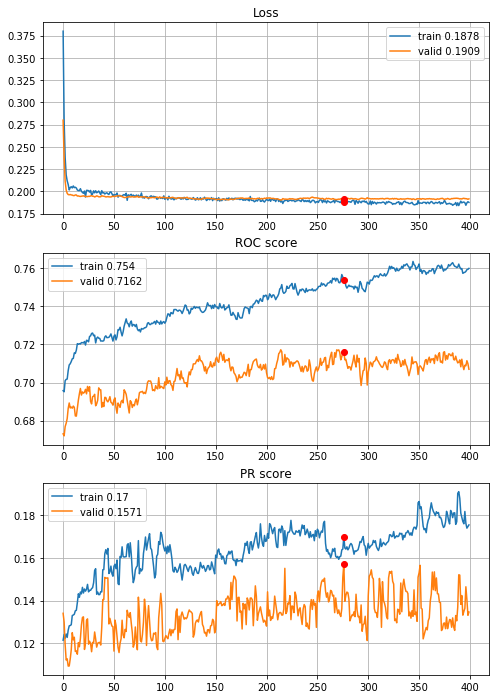


Fold 2------------------------------------------------------------


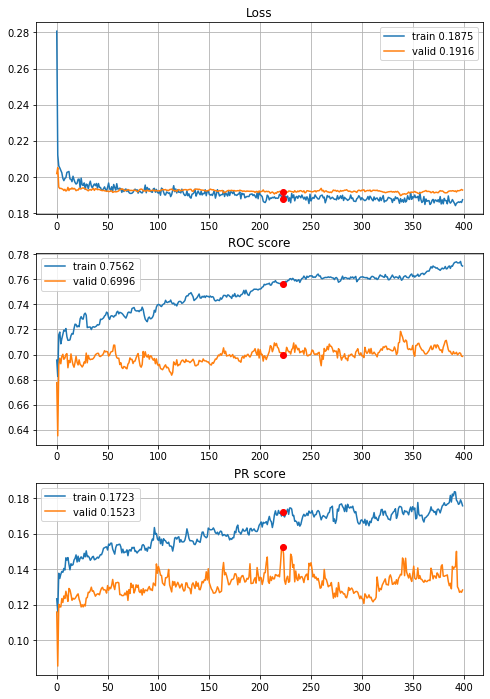


Fold 3------------------------------------------------------------


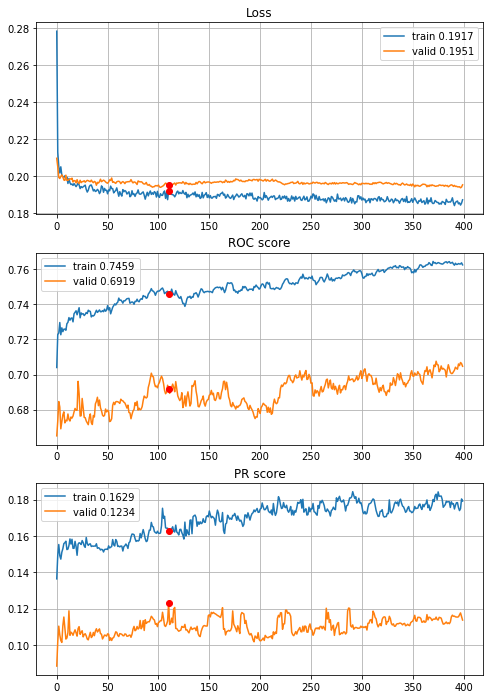


Fold 4------------------------------------------------------------


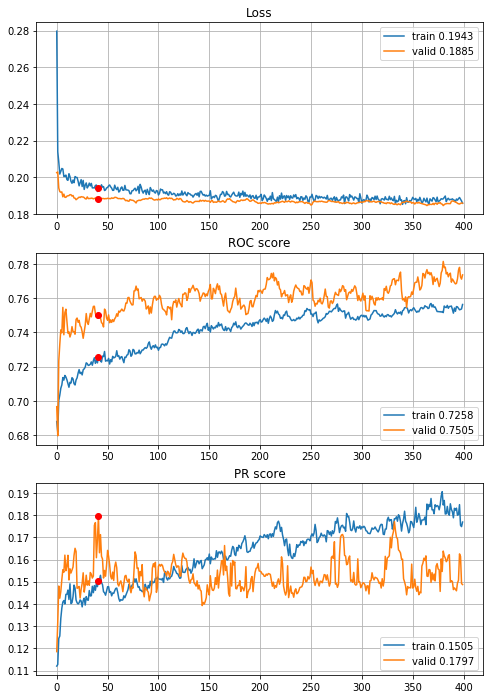


Fold 5------------------------------------------------------------


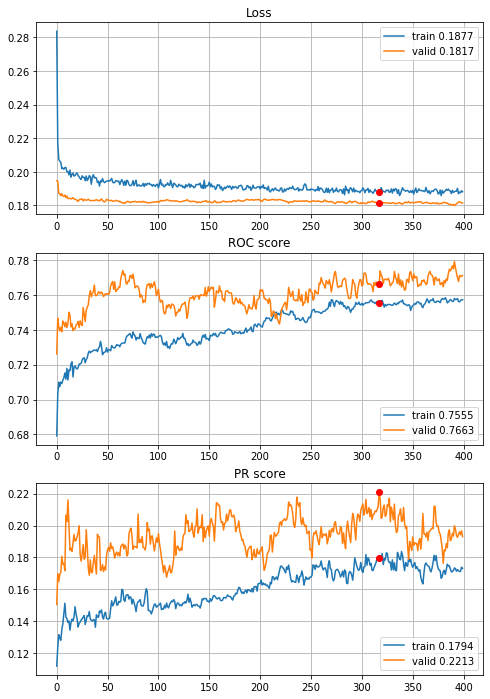


Fold 6------------------------------------------------------------


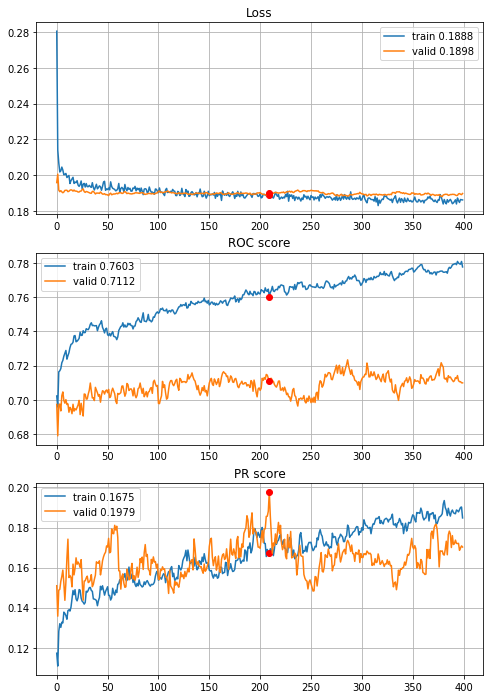

In [50]:
# raw data
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=False, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Learning curves looks awful on raw data, whats more it can be observed that positive class (the bankrupt one) detection is much harder (very low AUC-PRs). Lets check normalization option for the same architecture


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 2.29s train loss: 0.47063266340935894, validation loss: 0.33875612158853236
Epoch: 2/400,
cumulative time: 2.43s train loss: 0.3187719046030547, validation loss: 0.24633255812933527
Epoch: 3/400,
cumulative time: 2.58s train loss: 0.2495327501916827, validation loss: 0.21154956326872576
Epoch: 4/400,
cumulative time: 2.72s train loss: 0.21677513842676538, validation loss: 0.20178361118367288
Epoch: 5/400,
cumulative time: 2.86s train loss: 0.208744615336684, validation loss: 0.19979784808611692
Epoch: 6/400,
cumulative time: 3.0s train loss: 0.20552003235700392, validation loss: 0.19940398717673155
Epoch: 7/400,
cumulative time: 3.15s train loss: 0.20030527718869473, validation loss: 0.1990860449853927
Epoch: 8/400,
cumulative time: 3.29s train loss: 0.20123890551050888, validation loss: 0.19864766044102208
Epoch: 9/400,
cumulative time: 3.43s train loss: 0.20278873407522535, v

Epoch: 77/400,
cumulative time: 13.13s train loss: 0.18212730705486435, validation loss: 0.19156566080672147
Epoch: 78/400,
cumulative time: 13.27s train loss: 0.18489203168109442, validation loss: 0.19128732017062
Epoch: 79/400,
cumulative time: 13.42s train loss: 0.18136478919217783, validation loss: 0.19112916376981873
Epoch: 80/400,
cumulative time: 13.55s train loss: 0.18069803912203236, validation loss: 0.19136347482202815
Epoch: 81/400,
cumulative time: 13.68s train loss: 0.18052721475687952, validation loss: 0.19143776850200495
Epoch: 82/400,
cumulative time: 13.81s train loss: 0.18100223020094544, validation loss: 0.1912633731930819
Epoch: 83/400,
cumulative time: 13.95s train loss: 0.18025276744079965, validation loss: 0.19141345552800867
Epoch: 84/400,
cumulative time: 14.1s train loss: 0.18172703602204252, validation loss: 0.19126892103030618
Epoch: 85/400,
cumulative time: 14.25s train loss: 0.17963657007138834, validation loss: 0.19132084213324027
Epoch: 86/400,
cumulativ

Epoch: 153/400,
cumulative time: 23.99s train loss: 0.17513732581490574, validation loss: 0.1895165764469935
Epoch: 154/400,
cumulative time: 24.13s train loss: 0.17661925539502196, validation loss: 0.1893957917628603
Epoch: 155/400,
cumulative time: 24.27s train loss: 0.17546847136849753, validation loss: 0.1896321611634885
Epoch: 156/400,
cumulative time: 24.4s train loss: 0.17585242434424955, validation loss: 0.18953519890185033
Epoch: 157/400,
cumulative time: 24.54s train loss: 0.17590360592451568, validation loss: 0.18902028737991663
Epoch: 158/400,
cumulative time: 24.68s train loss: 0.17727938674701813, validation loss: 0.18898086045939066
Epoch: 159/400,
cumulative time: 24.82s train loss: 0.17555363354518305, validation loss: 0.1891672232164827
Epoch: 160/400,
cumulative time: 24.97s train loss: 0.17654894662499185, validation loss: 0.18941941530709366
Epoch: 161/400,
cumulative time: 25.12s train loss: 0.17648311193520538, validation loss: 0.1891153203418581
Epoch: 162/400,


Epoch: 229/400,
cumulative time: 35.04s train loss: 0.1738023663977909, validation loss: 0.1883032363214973
Epoch: 230/400,
cumulative time: 35.19s train loss: 0.17445107809078073, validation loss: 0.18847509704332435
Epoch: 231/400,
cumulative time: 35.34s train loss: 0.17369823860534445, validation loss: 0.188230213693326
Epoch: 232/400,
cumulative time: 35.47s train loss: 0.1728978864072406, validation loss: 0.18905342948972326
Epoch: 233/400,
cumulative time: 35.62s train loss: 0.17270816395032085, validation loss: 0.1890510996541172
Epoch: 234/400,
cumulative time: 35.76s train loss: 0.17216858114165992, validation loss: 0.1890912695633789
Epoch: 235/400,
cumulative time: 35.91s train loss: 0.1727507566640248, validation loss: 0.18907946111841054
Epoch: 236/400,
cumulative time: 36.05s train loss: 0.17450775606673144, validation loss: 0.18888126086466486
Epoch: 237/400,
cumulative time: 36.21s train loss: 0.17430298035246758, validation loss: 0.18912393522148963
Epoch: 238/400,
cu

Epoch: 305/400,
cumulative time: 46.08s train loss: 0.17255831329119264, validation loss: 0.1882537484189294
Epoch: 306/400,
cumulative time: 46.27s train loss: 0.17024075870299296, validation loss: 0.188027740610222
Epoch: 307/400,
cumulative time: 46.45s train loss: 0.17125259375525126, validation loss: 0.18802778263575695
Epoch: 308/400,
cumulative time: 46.6s train loss: 0.16910565421178006, validation loss: 0.1884954916814138
Epoch: 309/400,
cumulative time: 46.73s train loss: 0.1708737540623318, validation loss: 0.1878740909941104
Epoch: 310/400,
cumulative time: 46.87s train loss: 0.1722372995663384, validation loss: 0.18797411000225478
Epoch: 311/400,
cumulative time: 47.01s train loss: 0.1721783763610195, validation loss: 0.18748196482739538
Epoch: 312/400,
cumulative time: 47.16s train loss: 0.17198541067641096, validation loss: 0.18799287303927156
Epoch: 313/400,
cumulative time: 47.29s train loss: 0.16905300311077587, validation loss: 0.18765655579901294
Epoch: 314/400,
cum

Epoch: 381/400,
cumulative time: 57.09s train loss: 0.16813200390559685, validation loss: 0.18788921355267948
Epoch: 382/400,
cumulative time: 57.23s train loss: 0.17099757903678758, validation loss: 0.1882354096440412
Epoch: 383/400,
cumulative time: 57.37s train loss: 0.1665684089265499, validation loss: 0.18838853525458102
Epoch: 384/400,
cumulative time: 57.51s train loss: 0.1674509368807455, validation loss: 0.1887992739961454
Epoch: 385/400,
cumulative time: 57.66s train loss: 0.16723502240339416, validation loss: 0.1882454802220658
Epoch: 386/400,
cumulative time: 57.8s train loss: 0.16890587107444935, validation loss: 0.18805269458774324
Epoch: 387/400,
cumulative time: 57.94s train loss: 0.16800152911496036, validation loss: 0.18859256994691814
Epoch: 388/400,
cumulative time: 58.08s train loss: 0.16828939710717977, validation loss: 0.1884895779897438
Epoch: 389/400,
cumulative time: 58.23s train loss: 0.1697293656180474, validation loss: 0.18840943060820406
Epoch: 390/400,
cu

Epoch: 55/400,
cumulative time: 10.54s train loss: 0.18032550399413505, validation loss: 0.18818292170864453
Epoch: 56/400,
cumulative time: 10.69s train loss: 0.17597580911855712, validation loss: 0.1884909942492569
Epoch: 57/400,
cumulative time: 10.84s train loss: 0.1788338900980176, validation loss: 0.18897613256135062
Epoch: 58/400,
cumulative time: 10.98s train loss: 0.17939474031858801, validation loss: 0.18858301812000547
Epoch: 59/400,
cumulative time: 11.13s train loss: 0.17693429638827088, validation loss: 0.18860352054552776
Epoch: 60/400,
cumulative time: 11.27s train loss: 0.1791824949066921, validation loss: 0.18865476194655026
Epoch: 61/400,
cumulative time: 11.44s train loss: 0.17946398833110355, validation loss: 0.18869551126651815
Epoch: 62/400,
cumulative time: 11.57s train loss: 0.1779140173916058, validation loss: 0.18902746519521438
Epoch: 63/400,
cumulative time: 11.72s train loss: 0.17938484367372293, validation loss: 0.18862789119685727
Epoch: 64/400,
cumulati

Epoch: 131/400,
cumulative time: 21.63s train loss: 0.17475615049535176, validation loss: 0.19123327646878724
Epoch: 132/400,
cumulative time: 21.76s train loss: 0.17118132378929857, validation loss: 0.1910371419481066
Epoch: 133/400,
cumulative time: 21.9s train loss: 0.17238543754975963, validation loss: 0.19134710892436455
Epoch: 134/400,
cumulative time: 22.04s train loss: 0.1727321363998729, validation loss: 0.19124496930549548
Epoch: 135/400,
cumulative time: 22.19s train loss: 0.1734258561583707, validation loss: 0.19106864490989442
Epoch: 136/400,
cumulative time: 22.34s train loss: 0.17262656113302027, validation loss: 0.19099654842591593
Epoch: 137/400,
cumulative time: 22.48s train loss: 0.17506182989445238, validation loss: 0.1914282229439266
Epoch: 138/400,
cumulative time: 22.63s train loss: 0.17297394067377772, validation loss: 0.19148919019794855
Epoch: 139/400,
cumulative time: 22.78s train loss: 0.17191693510636474, validation loss: 0.19168435955144988
Epoch: 140/400,

Epoch: 207/400,
cumulative time: 32.48s train loss: 0.16996500798276964, validation loss: 0.19255438510904188
Epoch: 208/400,
cumulative time: 32.62s train loss: 0.16909172548173673, validation loss: 0.1925100782864592
Epoch: 209/400,
cumulative time: 32.77s train loss: 0.17163301891102284, validation loss: 0.19257328573581392
Epoch: 210/400,
cumulative time: 32.91s train loss: 0.169017517191666, validation loss: 0.1926093326286851
Epoch: 211/400,
cumulative time: 33.05s train loss: 0.171017792337145, validation loss: 0.19224356280207391
Epoch: 212/400,
cumulative time: 33.19s train loss: 0.17343560416805928, validation loss: 0.1922921076711138
Epoch: 213/400,
cumulative time: 33.34s train loss: 0.17300966562025719, validation loss: 0.19213057723761093
Epoch: 214/400,
cumulative time: 33.48s train loss: 0.17107132940481976, validation loss: 0.19207184895152865
Epoch: 215/400,
cumulative time: 33.63s train loss: 0.17037155895098083, validation loss: 0.1919467501529956
Epoch: 216/400,
cu

Epoch: 283/400,
cumulative time: 43.56s train loss: 0.16708939260420513, validation loss: 0.19378969946672026
Epoch: 284/400,
cumulative time: 43.71s train loss: 0.16761619012118456, validation loss: 0.19350158650912422
Epoch: 285/400,
cumulative time: 43.86s train loss: 0.16766892344948708, validation loss: 0.19327707069312902
Epoch: 286/400,
cumulative time: 44.01s train loss: 0.16868389947698825, validation loss: 0.19275832695568232
Epoch: 287/400,
cumulative time: 44.16s train loss: 0.16739792695255545, validation loss: 0.1929633029875421
Epoch: 288/400,
cumulative time: 44.31s train loss: 0.16614743735198345, validation loss: 0.19324226255437968
Epoch: 289/400,
cumulative time: 44.45s train loss: 0.16685375440563896, validation loss: 0.1933263215668109
Epoch: 290/400,
cumulative time: 44.58s train loss: 0.16659059180001318, validation loss: 0.19319548071891454
Epoch: 291/400,
cumulative time: 44.73s train loss: 0.1684716596345104, validation loss: 0.1931851794721319
Epoch: 292/400

Epoch: 359/400,
cumulative time: 54.72s train loss: 0.16580694161804985, validation loss: 0.1931511222342393
Epoch: 360/400,
cumulative time: 54.87s train loss: 0.16394827518235203, validation loss: 0.19327052360574268
Epoch: 361/400,
cumulative time: 55.02s train loss: 0.1657876293326486, validation loss: 0.19263285072869066
Epoch: 362/400,
cumulative time: 55.17s train loss: 0.16607323554553113, validation loss: 0.19248946797206662
Epoch: 363/400,
cumulative time: 55.32s train loss: 0.16614220487102246, validation loss: 0.19208078554002828
Epoch: 364/400,
cumulative time: 55.47s train loss: 0.16432744740473873, validation loss: 0.19238020018138716
Epoch: 365/400,
cumulative time: 55.62s train loss: 0.1638403579472976, validation loss: 0.1929017485019867
Epoch: 366/400,
cumulative time: 55.75s train loss: 0.16497251440925786, validation loss: 0.19312583383773768
Epoch: 367/400,
cumulative time: 55.92s train loss: 0.16621029431571854, validation loss: 0.19346501465716923
Epoch: 368/400

Epoch: 33/400,
cumulative time: 7.67s train loss: 0.1836169066196012, validation loss: 0.1920730588974151
Epoch: 34/400,
cumulative time: 7.82s train loss: 0.18383859055139348, validation loss: 0.19201823960485062
Epoch: 35/400,
cumulative time: 7.97s train loss: 0.18291914904822157, validation loss: 0.19222080483373288
Epoch: 36/400,
cumulative time: 8.12s train loss: 0.18060576077436502, validation loss: 0.19182984301677117
Epoch: 37/400,
cumulative time: 8.27s train loss: 0.1813565558866407, validation loss: 0.19185385102922206
Epoch: 38/400,
cumulative time: 8.45s train loss: 0.18139091915149513, validation loss: 0.19180075563566468
Epoch: 39/400,
cumulative time: 8.63s train loss: 0.18138903274931278, validation loss: 0.1917843999426084
Epoch: 40/400,
cumulative time: 8.8s train loss: 0.1812836108530118, validation loss: 0.19176199487515094
Epoch: 41/400,
cumulative time: 8.93s train loss: 0.18145310363716932, validation loss: 0.1916688178026246
Epoch: 42/400,
cumulative time: 9.0

Epoch: 109/400,
cumulative time: 18.67s train loss: 0.17660618564193878, validation loss: 0.1891557025698434
Epoch: 110/400,
cumulative time: 18.82s train loss: 0.1746663453447288, validation loss: 0.18935419186959873
Epoch: 111/400,
cumulative time: 19.0s train loss: 0.17662298242443186, validation loss: 0.1891822165640298
Epoch: 112/400,
cumulative time: 19.15s train loss: 0.17585908569700953, validation loss: 0.1890782150912236
Epoch: 113/400,
cumulative time: 19.3s train loss: 0.1763029409582375, validation loss: 0.18914471056446727
Epoch: 114/400,
cumulative time: 19.44s train loss: 0.17585550827785554, validation loss: 0.1886845170396619
Epoch: 115/400,
cumulative time: 19.58s train loss: 0.17501827549474952, validation loss: 0.18899182104958898
Epoch: 116/400,
cumulative time: 19.74s train loss: 0.17457661611839356, validation loss: 0.18897446409790916
Epoch: 117/400,
cumulative time: 19.88s train loss: 0.17541497260997718, validation loss: 0.1892059834900967
Epoch: 118/400,
cum

Epoch: 185/400,
cumulative time: 29.77s train loss: 0.1726997673194934, validation loss: 0.18994948353144164
Epoch: 186/400,
cumulative time: 29.92s train loss: 0.1719000566911587, validation loss: 0.18954774674466876
Epoch: 187/400,
cumulative time: 30.06s train loss: 0.1711803065876975, validation loss: 0.19000381827760182
Epoch: 188/400,
cumulative time: 30.2s train loss: 0.1713174680435867, validation loss: 0.1903246547836605
Epoch: 189/400,
cumulative time: 30.34s train loss: 0.1732600189397401, validation loss: 0.1899316993252285
Epoch: 190/400,
cumulative time: 30.49s train loss: 0.17115250468278442, validation loss: 0.19023814137043638
Epoch: 191/400,
cumulative time: 30.63s train loss: 0.17495324899256431, validation loss: 0.18965343877399268
Epoch: 192/400,
cumulative time: 30.78s train loss: 0.17320767007073118, validation loss: 0.1898929737229344
Epoch: 193/400,
cumulative time: 30.92s train loss: 0.17277580309097634, validation loss: 0.18975665406599754
Epoch: 194/400,
cum

Epoch: 261/400,
cumulative time: 40.84s train loss: 0.17068556222841946, validation loss: 0.1911343204338101
Epoch: 262/400,
cumulative time: 40.98s train loss: 0.1691723104784993, validation loss: 0.19159628209449386
Epoch: 263/400,
cumulative time: 41.12s train loss: 0.17182450273876926, validation loss: 0.19136518904390265
Epoch: 264/400,
cumulative time: 41.27s train loss: 0.17051543902144614, validation loss: 0.19123002377556164
Epoch: 265/400,
cumulative time: 41.41s train loss: 0.16856552188855564, validation loss: 0.19101724655470773
Epoch: 266/400,
cumulative time: 41.56s train loss: 0.1697007148451398, validation loss: 0.19121007672007023
Epoch: 267/400,
cumulative time: 41.7s train loss: 0.16992481629603015, validation loss: 0.1911531155149169
Epoch: 268/400,
cumulative time: 41.85s train loss: 0.17004781256461685, validation loss: 0.19131234844092856
Epoch: 269/400,
cumulative time: 41.99s train loss: 0.1717977956430506, validation loss: 0.19157703469366016
Epoch: 270/400,


Epoch: 337/400,
cumulative time: 51.71s train loss: 0.16614473440959476, validation loss: 0.19415548542188577
Epoch: 338/400,
cumulative time: 51.86s train loss: 0.1683167779431849, validation loss: 0.19403747708071975
Epoch: 339/400,
cumulative time: 52.0s train loss: 0.16639140751159567, validation loss: 0.19412541349904727
Epoch: 340/400,
cumulative time: 52.15s train loss: 0.1665687956444561, validation loss: 0.19394106492450888
Epoch: 341/400,
cumulative time: 52.29s train loss: 0.16559010246307182, validation loss: 0.19378477872594674
Epoch: 342/400,
cumulative time: 52.44s train loss: 0.16614745005946968, validation loss: 0.1939074479352868
Epoch: 343/400,
cumulative time: 52.58s train loss: 0.16683732385119446, validation loss: 0.19358131994472383
Epoch: 344/400,
cumulative time: 52.73s train loss: 0.16609190118892403, validation loss: 0.1938577879745186
Epoch: 345/400,
cumulative time: 52.87s train loss: 0.16624511885907625, validation loss: 0.19378339287738072
Epoch: 346/400,

Epoch: 11/400,
cumulative time: 4.86s train loss: 0.18747656343419303, validation loss: 0.18846012356737343
Epoch: 12/400,
cumulative time: 5.02s train loss: 0.1877968978422402, validation loss: 0.18813672507596388
Epoch: 13/400,
cumulative time: 5.15s train loss: 0.18796724941057422, validation loss: 0.18795998986883988
Epoch: 14/400,
cumulative time: 5.29s train loss: 0.1855897663416597, validation loss: 0.18770435271902583
Epoch: 15/400,
cumulative time: 5.42s train loss: 0.18355309949427068, validation loss: 0.18819753465561578
Epoch: 16/400,
cumulative time: 5.56s train loss: 0.18575693323577147, validation loss: 0.18846499002896822
Epoch: 17/400,
cumulative time: 5.71s train loss: 0.1858116340754095, validation loss: 0.18820632715221974
Epoch: 18/400,
cumulative time: 5.85s train loss: 0.18257678373298608, validation loss: 0.1885749993273967
Epoch: 19/400,
cumulative time: 5.98s train loss: 0.18642287528573306, validation loss: 0.1882850039342052
Epoch: 20/400,
cumulative time: 6

Epoch: 88/400,
cumulative time: 16.06s train loss: 0.17711344342432733, validation loss: 0.19138373372666767
Epoch: 89/400,
cumulative time: 16.21s train loss: 0.1755797664114748, validation loss: 0.19113200634129604
Epoch: 90/400,
cumulative time: 16.35s train loss: 0.177936629146788, validation loss: 0.19137782469097656
Epoch: 91/400,
cumulative time: 16.49s train loss: 0.17683542815578515, validation loss: 0.1910878472927884
Epoch: 92/400,
cumulative time: 16.63s train loss: 0.17644028282613597, validation loss: 0.19123932392602067
Epoch: 93/400,
cumulative time: 16.77s train loss: 0.1783132356380095, validation loss: 0.1912322784865933
Epoch: 94/400,
cumulative time: 16.94s train loss: 0.17773230066623152, validation loss: 0.19123773689656293
Epoch: 95/400,
cumulative time: 17.11s train loss: 0.17549450280928375, validation loss: 0.19150869094895376
Epoch: 96/400,
cumulative time: 17.25s train loss: 0.17673467431660328, validation loss: 0.19127464592659693
Epoch: 97/400,
cumulative

Epoch: 164/400,
cumulative time: 27.23s train loss: 0.17465929256405377, validation loss: 0.19138593016188513
Epoch: 165/400,
cumulative time: 27.38s train loss: 0.17552474263081932, validation loss: 0.19131030509510846
Epoch: 166/400,
cumulative time: 27.52s train loss: 0.17301643336320888, validation loss: 0.19141571292713275
Epoch: 167/400,
cumulative time: 27.66s train loss: 0.17237976930064497, validation loss: 0.19166824133360444
Epoch: 168/400,
cumulative time: 27.8s train loss: 0.17451242363884747, validation loss: 0.19146737432991104
Epoch: 169/400,
cumulative time: 27.95s train loss: 0.17430728641263182, validation loss: 0.19179951954934774
Epoch: 170/400,
cumulative time: 28.12s train loss: 0.1744130974132976, validation loss: 0.19218476845992513
Epoch: 171/400,
cumulative time: 28.26s train loss: 0.17260708771194502, validation loss: 0.19193805609129172
Epoch: 172/400,
cumulative time: 28.4s train loss: 0.17409871852837872, validation loss: 0.191585796424286
Epoch: 173/400,

Epoch: 239/400,
cumulative time: 38.01s train loss: 0.16957874213595586, validation loss: 0.19389758368103255
Epoch: 240/400,
cumulative time: 38.15s train loss: 0.17041563239731386, validation loss: 0.19345016927642836
Epoch: 241/400,
cumulative time: 38.29s train loss: 0.171111741788248, validation loss: 0.19346849732937824
Epoch: 242/400,
cumulative time: 38.42s train loss: 0.17069770520963673, validation loss: 0.19336584217496433
Epoch: 243/400,
cumulative time: 38.57s train loss: 0.17099332722999996, validation loss: 0.19379086785368405
Epoch: 244/400,
cumulative time: 38.71s train loss: 0.17015272122417793, validation loss: 0.1934633108732082
Epoch: 245/400,
cumulative time: 38.85s train loss: 0.17052319588350953, validation loss: 0.1930933451473997
Epoch: 246/400,
cumulative time: 39.0s train loss: 0.17199176638794905, validation loss: 0.19374604776775536
Epoch: 247/400,
cumulative time: 39.16s train loss: 0.1714597978372592, validation loss: 0.19345934002313425
Epoch: 248/400,


Epoch: 315/400,
cumulative time: 49.05s train loss: 0.16604769080126464, validation loss: 0.19395760200801068
Epoch: 316/400,
cumulative time: 49.2s train loss: 0.16923417478706473, validation loss: 0.19360207548711153
Epoch: 317/400,
cumulative time: 49.35s train loss: 0.16664690573956098, validation loss: 0.19375032775859755
Epoch: 318/400,
cumulative time: 49.49s train loss: 0.16715954355139603, validation loss: 0.19384340216628218
Epoch: 319/400,
cumulative time: 49.64s train loss: 0.16680082052552406, validation loss: 0.19403266845875813
Epoch: 320/400,
cumulative time: 49.78s train loss: 0.16798341236516465, validation loss: 0.19391907281904824
Epoch: 321/400,
cumulative time: 49.93s train loss: 0.1696782774566776, validation loss: 0.19345992126985825
Epoch: 322/400,
cumulative time: 50.08s train loss: 0.1679075925255705, validation loss: 0.19393572485146676
Epoch: 323/400,
cumulative time: 50.22s train loss: 0.16785295566575137, validation loss: 0.1940818652662799
Epoch: 324/400

Epoch: 391/400,
cumulative time: 60.16s train loss: 0.16666950591453394, validation loss: 0.19537207338175375
Epoch: 392/400,
cumulative time: 60.3s train loss: 0.1655299763131674, validation loss: 0.19474589404725476
Epoch: 393/400,
cumulative time: 60.45s train loss: 0.16422837648561536, validation loss: 0.19578792411425716
Epoch: 394/400,
cumulative time: 60.59s train loss: 0.16680716983461583, validation loss: 0.19598991297555668
Epoch: 395/400,
cumulative time: 60.74s train loss: 0.16531542783072156, validation loss: 0.19563221060109837
Epoch: 396/400,
cumulative time: 60.88s train loss: 0.16460922816607212, validation loss: 0.1958649093557816
Epoch: 397/400,
cumulative time: 61.03s train loss: 0.16560399785169086, validation loss: 0.19614461982347595
Epoch: 398/400,
cumulative time: 61.17s train loss: 0.16494223923931878, validation loss: 0.19598344526297384
Epoch: 399/400,
cumulative time: 61.32s train loss: 0.16609412945333138, validation loss: 0.1954682235351787
Epoch: 400/400

Epoch: 65/400,
cumulative time: 12.49s train loss: 0.1828187572402567, validation loss: 0.17039615636544267
Epoch: 66/400,
cumulative time: 12.63s train loss: 0.17927175207562696, validation loss: 0.1710573814058174
Epoch: 67/400,
cumulative time: 12.77s train loss: 0.17828205201068734, validation loss: 0.17044061475131428
Epoch: 68/400,
cumulative time: 12.91s train loss: 0.17926704870183874, validation loss: 0.1701120082542747
Epoch: 69/400,
cumulative time: 13.05s train loss: 0.17848736445027888, validation loss: 0.17023572816998173
Epoch: 70/400,
cumulative time: 13.19s train loss: 0.1793054963800902, validation loss: 0.16998021739055416
Epoch: 71/400,
cumulative time: 13.33s train loss: 0.18057042472307977, validation loss: 0.17021284638130046
Epoch: 72/400,
cumulative time: 13.47s train loss: 0.17782623302150916, validation loss: 0.16991457540024205
Epoch: 73/400,
cumulative time: 13.61s train loss: 0.17741744135037746, validation loss: 0.169991323770067
Epoch: 74/400,
cumulative

Epoch: 141/400,
cumulative time: 23.17s train loss: 0.1748828941850653, validation loss: 0.16885679511591914
Epoch: 142/400,
cumulative time: 23.31s train loss: 0.17411676475327778, validation loss: 0.16893725442301674
Epoch: 143/400,
cumulative time: 23.45s train loss: 0.1770541142238089, validation loss: 0.16861627102710247
Epoch: 144/400,
cumulative time: 23.59s train loss: 0.17516712318042654, validation loss: 0.16870693088958308
Epoch: 145/400,
cumulative time: 23.73s train loss: 0.17367829449580321, validation loss: 0.16876760480433134
Epoch: 146/400,
cumulative time: 23.87s train loss: 0.17796752424322249, validation loss: 0.16897510879289876
Epoch: 147/400,
cumulative time: 24.01s train loss: 0.1752032751180962, validation loss: 0.1685533580403237
Epoch: 148/400,
cumulative time: 24.15s train loss: 0.1739846327887901, validation loss: 0.16871485739377928
Epoch: 149/400,
cumulative time: 24.29s train loss: 0.17492743043638848, validation loss: 0.16895581544338845
Epoch: 150/400,

Epoch: 217/400,
cumulative time: 33.94s train loss: 0.17319254614493945, validation loss: 0.16831491227776868
Epoch: 218/400,
cumulative time: 34.08s train loss: 0.171307573736136, validation loss: 0.16818905309126878
Epoch: 219/400,
cumulative time: 34.22s train loss: 0.17091829180595727, validation loss: 0.16789568140493752
Epoch: 220/400,
cumulative time: 34.36s train loss: 0.1716516992677823, validation loss: 0.1681720330011942
Epoch: 221/400,
cumulative time: 34.5s train loss: 0.17375634504737808, validation loss: 0.1678905647034866
Epoch: 222/400,
cumulative time: 34.65s train loss: 0.17433812039902266, validation loss: 0.16824460376754444
Epoch: 223/400,
cumulative time: 34.79s train loss: 0.170744678719793, validation loss: 0.16875636977542
Epoch: 224/400,
cumulative time: 34.93s train loss: 0.17152731182674566, validation loss: 0.16840359201142183
Epoch: 225/400,
cumulative time: 35.08s train loss: 0.17360311899179987, validation loss: 0.16802599536869117
Epoch: 226/400,
cumul

Epoch: 293/400,
cumulative time: 44.88s train loss: 0.17118455454796422, validation loss: 0.16834655026486525
Epoch: 294/400,
cumulative time: 45.03s train loss: 0.1691774094237871, validation loss: 0.16847939362967695
Epoch: 295/400,
cumulative time: 45.18s train loss: 0.16830326781926722, validation loss: 0.16875798068433107
Epoch: 296/400,
cumulative time: 45.32s train loss: 0.1689292211329041, validation loss: 0.16830139387936943
Epoch: 297/400,
cumulative time: 45.48s train loss: 0.1681030908627902, validation loss: 0.16859261060199557
Epoch: 298/400,
cumulative time: 45.62s train loss: 0.17077006732594538, validation loss: 0.16845903744570892
Epoch: 299/400,
cumulative time: 45.78s train loss: 0.17025893491394575, validation loss: 0.1687811739154018
Epoch: 300/400,
cumulative time: 45.92s train loss: 0.1700373867644334, validation loss: 0.16815886577484718
Epoch: 301/400,
cumulative time: 46.07s train loss: 0.1721947984911972, validation loss: 0.16824214462931864
Epoch: 302/400,


Epoch: 369/400,
cumulative time: 55.95s train loss: 0.16844471459822782, validation loss: 0.16786616502649454
Epoch: 370/400,
cumulative time: 56.09s train loss: 0.16705065551325515, validation loss: 0.16747939885068655
Epoch: 371/400,
cumulative time: 56.23s train loss: 0.16808202134725314, validation loss: 0.16799678724533207
Epoch: 372/400,
cumulative time: 56.38s train loss: 0.16818002343770272, validation loss: 0.16735199461272368
Epoch: 373/400,
cumulative time: 56.52s train loss: 0.16932343422538704, validation loss: 0.1676474574151416
Epoch: 374/400,
cumulative time: 56.67s train loss: 0.1688426448283859, validation loss: 0.16752633060600192
Epoch: 375/400,
cumulative time: 56.82s train loss: 0.16860489096200348, validation loss: 0.16754438579894543
Epoch: 376/400,
cumulative time: 56.97s train loss: 0.1672637398904575, validation loss: 0.167438744564797
Epoch: 377/400,
cumulative time: 57.11s train loss: 0.1655817317952907, validation loss: 0.16802931414556763
Epoch: 378/400,


Epoch: 43/400,
cumulative time: 9.5s train loss: 0.18302848907532515, validation loss: 0.1832348351298301
Epoch: 44/400,
cumulative time: 9.64s train loss: 0.1797558801199973, validation loss: 0.18336590627152524
Epoch: 45/400,
cumulative time: 9.78s train loss: 0.1811792809142851, validation loss: 0.1829377188263537
Epoch: 46/400,
cumulative time: 9.94s train loss: 0.182151561030765, validation loss: 0.18354363173083973
Epoch: 47/400,
cumulative time: 10.08s train loss: 0.18126046436398507, validation loss: 0.18320465579182316
Epoch: 48/400,
cumulative time: 10.23s train loss: 0.1800501038277753, validation loss: 0.18348452014396885
Epoch: 49/400,
cumulative time: 10.38s train loss: 0.17960040843467306, validation loss: 0.18333776291124826
Epoch: 50/400,
cumulative time: 10.53s train loss: 0.17931098664029296, validation loss: 0.18306671450427184
Epoch: 51/400,
cumulative time: 10.67s train loss: 0.17959497297235433, validation loss: 0.18347886119454043
Epoch: 52/400,
cumulative time:

Epoch: 119/400,
cumulative time: 20.5s train loss: 0.1737576481401271, validation loss: 0.1839809625407006
Epoch: 120/400,
cumulative time: 20.64s train loss: 0.17503152042627335, validation loss: 0.1838999795613237
Epoch: 121/400,
cumulative time: 20.78s train loss: 0.17559693360494244, validation loss: 0.18400083358427485
Epoch: 122/400,
cumulative time: 20.93s train loss: 0.1728809097911635, validation loss: 0.1839731157191443
Epoch: 123/400,
cumulative time: 21.07s train loss: 0.17459445362728016, validation loss: 0.18379421073344487
Epoch: 124/400,
cumulative time: 21.2s train loss: 0.17731027971863877, validation loss: 0.18372885696082414
Epoch: 125/400,
cumulative time: 21.34s train loss: 0.174597201166849, validation loss: 0.18405896898267704
Epoch: 126/400,
cumulative time: 21.48s train loss: 0.17537603913633912, validation loss: 0.18386472148531463
Epoch: 127/400,
cumulative time: 21.62s train loss: 0.1743853189749136, validation loss: 0.18423981854961094
Epoch: 128/400,
cumu

Epoch: 195/400,
cumulative time: 31.22s train loss: 0.17358802692976846, validation loss: 0.1834113531687604
Epoch: 196/400,
cumulative time: 31.36s train loss: 0.17547819072538925, validation loss: 0.18289086880411048
Epoch: 197/400,
cumulative time: 31.5s train loss: 0.1733309629338759, validation loss: 0.18294807687929607
Epoch: 198/400,
cumulative time: 31.65s train loss: 0.1729439827075841, validation loss: 0.18299836098985386
Epoch: 199/400,
cumulative time: 31.79s train loss: 0.17398482547719885, validation loss: 0.1833227524478039
Epoch: 200/400,
cumulative time: 31.93s train loss: 0.17270995999132496, validation loss: 0.18316554475058003
Epoch: 201/400,
cumulative time: 32.07s train loss: 0.17309055544135682, validation loss: 0.18315461245479636
Epoch: 202/400,
cumulative time: 32.21s train loss: 0.17239800086630455, validation loss: 0.18315731338161864
Epoch: 203/400,
cumulative time: 32.35s train loss: 0.172281871054703, validation loss: 0.18344059931647225
Epoch: 204/400,
c

Epoch: 271/400,
cumulative time: 42.21s train loss: 0.17279070272254463, validation loss: 0.18327961581929178
Epoch: 272/400,
cumulative time: 42.36s train loss: 0.17001294950124746, validation loss: 0.18333937840825532
Epoch: 273/400,
cumulative time: 42.5s train loss: 0.17106133324250353, validation loss: 0.18356365485152368
Epoch: 274/400,
cumulative time: 42.65s train loss: 0.17268993523710433, validation loss: 0.1829947794937308
Epoch: 275/400,
cumulative time: 42.8s train loss: 0.17112733733744923, validation loss: 0.18307566778780004
Epoch: 276/400,
cumulative time: 42.94s train loss: 0.17083610672998792, validation loss: 0.18349506925253517
Epoch: 277/400,
cumulative time: 43.09s train loss: 0.17184286025273643, validation loss: 0.18364515726020617
Epoch: 278/400,
cumulative time: 43.24s train loss: 0.1701499159064363, validation loss: 0.1836259139128212
Epoch: 279/400,
cumulative time: 43.38s train loss: 0.17070803145242933, validation loss: 0.1832707580940275
Epoch: 280/400,


Epoch: 347/400,
cumulative time: 53.21s train loss: 0.17153553032034233, validation loss: 0.18268213601787994
Epoch: 348/400,
cumulative time: 53.36s train loss: 0.16818555419319076, validation loss: 0.18313899514460757
Epoch: 349/400,
cumulative time: 53.5s train loss: 0.16835027855814866, validation loss: 0.18299147724212028
Epoch: 350/400,
cumulative time: 53.64s train loss: 0.17043670777775233, validation loss: 0.18272107267087423
Epoch: 351/400,
cumulative time: 53.79s train loss: 0.16880312644164353, validation loss: 0.18200132441618136
Epoch: 352/400,
cumulative time: 53.92s train loss: 0.16880108784551454, validation loss: 0.18255956564352363
Epoch: 353/400,
cumulative time: 54.07s train loss: 0.169176260652609, validation loss: 0.18266095273826038
Epoch: 354/400,
cumulative time: 54.21s train loss: 0.16940221769942176, validation loss: 0.18297207950327637
Epoch: 355/400,
cumulative time: 54.35s train loss: 0.16812268849705753, validation loss: 0.18280512106678468
Epoch: 356/40

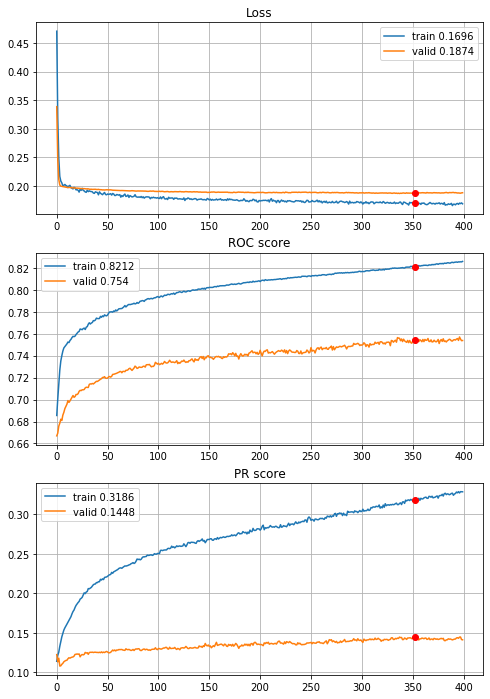


Fold 2------------------------------------------------------------


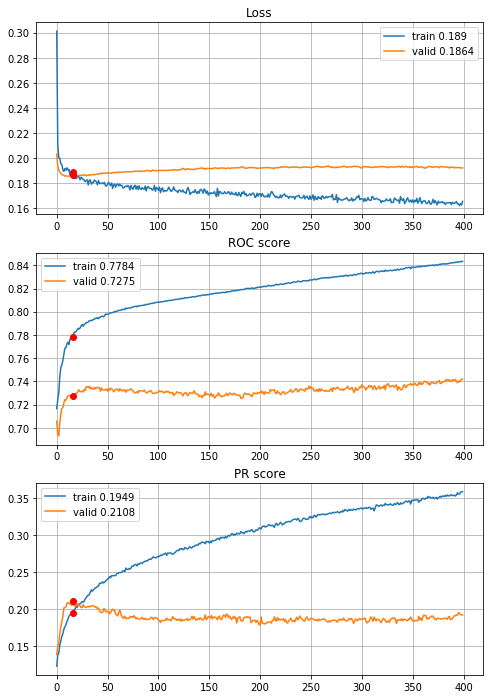


Fold 3------------------------------------------------------------


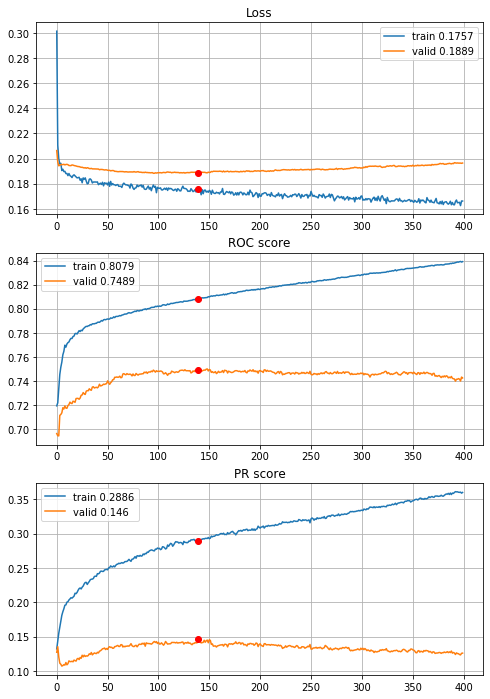


Fold 4------------------------------------------------------------


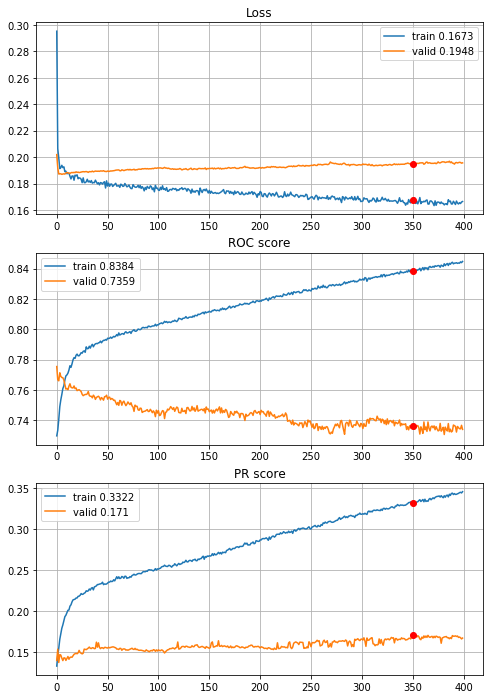


Fold 5------------------------------------------------------------


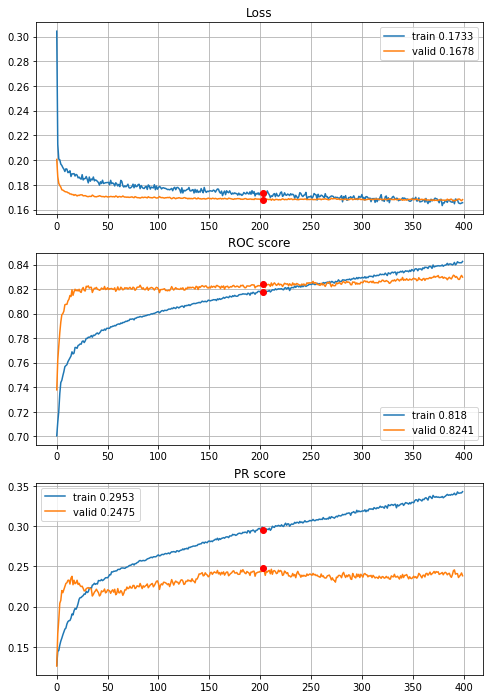


Fold 6------------------------------------------------------------


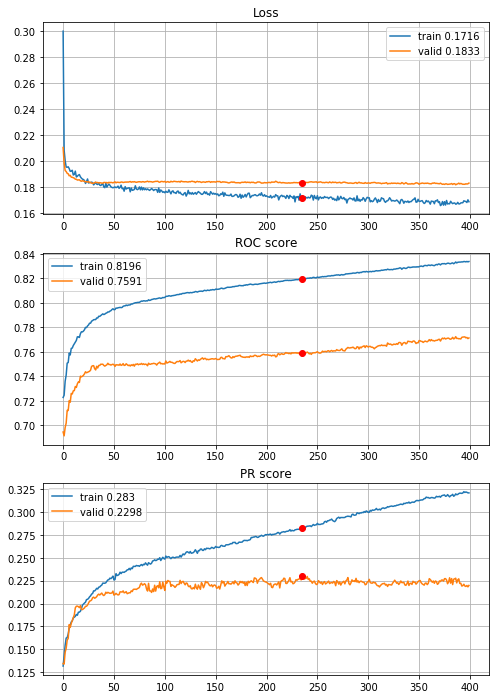

In [51]:
# normalization
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

+ 0.02 on PR and much smoother learning cureves. Outliers reduction:


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 3.93s train loss: 0.46574536002852784, validation loss: 0.3271667143371821
Epoch: 2/400,
cumulative time: 4.08s train loss: 0.31429185282302524, validation loss: 0.24436013800218204
Epoch: 3/400,
cumulative time: 4.24s train loss: 0.2521829059666872, validation loss: 0.21404926442345282
Epoch: 4/400,
cumulative time: 4.38s train loss: 0.21907026321811993, validation loss: 0.2019052610176611
Epoch: 5/400,
cumulative time: 4.53s train loss: 0.20854901493277517, validation loss: 0.1966032762869107
Epoch: 6/400,
cumulative time: 4.68s train loss: 0.20286524836818676, validation loss: 0.19403366300222255
Epoch: 7/400,
cumulative time: 4.84s train loss: 0.196122158788034, validation loss: 0.1928673345795937
Epoch: 8/400,
cumulative time: 4.98s train loss: 0.19562555413049393, validation loss: 0.19204119247510532
Epoch: 9/400,
cumulative time: 5.13s train loss: 0.19519578366071477, va

Epoch: 77/400,
cumulative time: 15.08s train loss: 0.1686432118472166, validation loss: 0.1805290189363098
Epoch: 78/400,
cumulative time: 15.22s train loss: 0.1703728813148886, validation loss: 0.17985611708696558
Epoch: 79/400,
cumulative time: 15.37s train loss: 0.16669975887173838, validation loss: 0.17927401622920883
Epoch: 80/400,
cumulative time: 15.52s train loss: 0.1664193871275177, validation loss: 0.17978655872010632
Epoch: 81/400,
cumulative time: 15.67s train loss: 0.1640185202647827, validation loss: 0.1802468296112537
Epoch: 82/400,
cumulative time: 15.82s train loss: 0.1668999816389836, validation loss: 0.18021721219919098
Epoch: 83/400,
cumulative time: 15.96s train loss: 0.16490156096970046, validation loss: 0.18016797754535713
Epoch: 84/400,
cumulative time: 16.09s train loss: 0.1680680487163382, validation loss: 0.17913190617782068
Epoch: 85/400,
cumulative time: 16.24s train loss: 0.16583366866180266, validation loss: 0.17872059766210774
Epoch: 86/400,
cumulative t

Epoch: 153/400,
cumulative time: 26.23s train loss: 0.15486254570765992, validation loss: 0.1750647225008277
Epoch: 154/400,
cumulative time: 26.38s train loss: 0.15620976007473367, validation loss: 0.17497375459391865
Epoch: 155/400,
cumulative time: 26.53s train loss: 0.15605477345735747, validation loss: 0.17526775864292116
Epoch: 156/400,
cumulative time: 26.67s train loss: 0.15700601030155828, validation loss: 0.17512714125373235
Epoch: 157/400,
cumulative time: 26.82s train loss: 0.15456976830537225, validation loss: 0.17419706298186716
Epoch: 158/400,
cumulative time: 26.96s train loss: 0.15850388695096898, validation loss: 0.1750260654195301
Epoch: 159/400,
cumulative time: 27.11s train loss: 0.15677672656245117, validation loss: 0.17567301871745744
Epoch: 160/400,
cumulative time: 27.26s train loss: 0.15798718665603328, validation loss: 0.17579532659646196
Epoch: 161/400,
cumulative time: 27.4s train loss: 0.15481308582740472, validation loss: 0.17487954836747044
Epoch: 162/40

Epoch: 229/400,
cumulative time: 37.41s train loss: 0.15015630569523594, validation loss: 0.17179171835345586
Epoch: 230/400,
cumulative time: 37.55s train loss: 0.15199436850254272, validation loss: 0.17296121551967786
Epoch: 231/400,
cumulative time: 37.7s train loss: 0.1510444540029713, validation loss: 0.1720038005857747
Epoch: 232/400,
cumulative time: 37.85s train loss: 0.1469054840110424, validation loss: 0.1726394941341804
Epoch: 233/400,
cumulative time: 37.99s train loss: 0.1512876194552344, validation loss: 0.1728992451913021
Epoch: 234/400,
cumulative time: 38.14s train loss: 0.14829514149779863, validation loss: 0.1728739489638294
Epoch: 235/400,
cumulative time: 38.29s train loss: 0.15084960841501863, validation loss: 0.17210403660919651
Epoch: 236/400,
cumulative time: 38.43s train loss: 0.15259511181943897, validation loss: 0.1720648643270977
Epoch: 237/400,
cumulative time: 38.58s train loss: 0.15237142013729096, validation loss: 0.17207965687921536
Epoch: 238/400,
cum

Epoch: 305/400,
cumulative time: 48.62s train loss: 0.1471991383455502, validation loss: 0.17217886452978368
Epoch: 306/400,
cumulative time: 48.77s train loss: 0.14298909870712598, validation loss: 0.17229993141289873
Epoch: 307/400,
cumulative time: 48.92s train loss: 0.14652462273401864, validation loss: 0.17188293195200907
Epoch: 308/400,
cumulative time: 49.07s train loss: 0.14297529712499982, validation loss: 0.1719107711960297
Epoch: 309/400,
cumulative time: 49.22s train loss: 0.1446581214816535, validation loss: 0.17185018389625886
Epoch: 310/400,
cumulative time: 49.37s train loss: 0.1442019537620903, validation loss: 0.1710099613508292
Epoch: 311/400,
cumulative time: 49.52s train loss: 0.14138994803752364, validation loss: 0.17092634719232866
Epoch: 312/400,
cumulative time: 49.67s train loss: 0.1437134410925722, validation loss: 0.17302493955952689
Epoch: 313/400,
cumulative time: 49.82s train loss: 0.1382667703657275, validation loss: 0.17147913023352704
Epoch: 314/400,
c

Epoch: 381/400,
cumulative time: 59.85s train loss: 0.13623072439329056, validation loss: 0.17094015884431873
Epoch: 382/400,
cumulative time: 59.99s train loss: 0.13838882773331299, validation loss: 0.17116990502875545
Epoch: 383/400,
cumulative time: 60.14s train loss: 0.13403933526635836, validation loss: 0.17168436443383714
Epoch: 384/400,
cumulative time: 60.29s train loss: 0.13612819416442132, validation loss: 0.17099805962398312
Epoch: 385/400,
cumulative time: 60.43s train loss: 0.13524329812288383, validation loss: 0.16983739714219995
Epoch: 386/400,
cumulative time: 60.58s train loss: 0.14066823469136272, validation loss: 0.16999602936578495
Epoch: 387/400,
cumulative time: 60.73s train loss: 0.13744884294201662, validation loss: 0.17091907500977252
Epoch: 388/400,
cumulative time: 60.87s train loss: 0.14097320161182517, validation loss: 0.17160069325734678
Epoch: 389/400,
cumulative time: 61.02s train loss: 0.13790225151869967, validation loss: 0.17236347313922146
Epoch: 390

Epoch: 55/400,
cumulative time: 11.89s train loss: 0.16381028919994028, validation loss: 0.18910195844322747
Epoch: 56/400,
cumulative time: 12.04s train loss: 0.1596926562665643, validation loss: 0.18898400675487648
Epoch: 57/400,
cumulative time: 12.18s train loss: 0.16247771961210405, validation loss: 0.18927665931217683
Epoch: 58/400,
cumulative time: 12.32s train loss: 0.16406799270134118, validation loss: 0.18911745896787363
Epoch: 59/400,
cumulative time: 12.46s train loss: 0.15943040051115123, validation loss: 0.18894264616269982
Epoch: 60/400,
cumulative time: 12.6s train loss: 0.1653680526380657, validation loss: 0.1894551554125454
Epoch: 61/400,
cumulative time: 12.74s train loss: 0.16255182901634016, validation loss: 0.18879730778336118
Epoch: 62/400,
cumulative time: 12.89s train loss: 0.16090135696991806, validation loss: 0.18903684772302537
Epoch: 63/400,
cumulative time: 13.03s train loss: 0.16260685538232578, validation loss: 0.18800505036152163
Epoch: 64/400,
cumulati

Epoch: 131/400,
cumulative time: 22.27s train loss: 0.154746279475573, validation loss: 0.19002061880430127
Epoch: 132/400,
cumulative time: 22.41s train loss: 0.14949269623201517, validation loss: 0.18916388959646063
Epoch: 133/400,
cumulative time: 22.55s train loss: 0.1495088270302123, validation loss: 0.190075053080886
Epoch: 134/400,
cumulative time: 22.69s train loss: 0.14953665497410806, validation loss: 0.1892896737368274
Epoch: 135/400,
cumulative time: 22.83s train loss: 0.15240875517016744, validation loss: 0.18958804132055473
Epoch: 136/400,
cumulative time: 22.98s train loss: 0.15203215602095893, validation loss: 0.19002177554624594
Epoch: 137/400,
cumulative time: 23.12s train loss: 0.15010199255162748, validation loss: 0.18994314452269354
Epoch: 138/400,
cumulative time: 23.26s train loss: 0.15286113458556083, validation loss: 0.1904115657201018
Epoch: 139/400,
cumulative time: 23.4s train loss: 0.14998627923724275, validation loss: 0.18967741936790122
Epoch: 140/400,
cu

Epoch: 207/400,
cumulative time: 32.86s train loss: 0.144263224595333, validation loss: 0.19372691627949415
Epoch: 208/400,
cumulative time: 33.01s train loss: 0.1434555415961555, validation loss: 0.19270025008060723
Epoch: 209/400,
cumulative time: 33.15s train loss: 0.14665655564274788, validation loss: 0.19242236645064278
Epoch: 210/400,
cumulative time: 33.29s train loss: 0.14163130755346898, validation loss: 0.19213743722909482
Epoch: 211/400,
cumulative time: 33.43s train loss: 0.14401820501895785, validation loss: 0.19227699310581567
Epoch: 212/400,
cumulative time: 33.57s train loss: 0.1426380975064117, validation loss: 0.19212329507360984
Epoch: 213/400,
cumulative time: 33.71s train loss: 0.14225697150294372, validation loss: 0.19219357444770974
Epoch: 214/400,
cumulative time: 33.85s train loss: 0.14415321380902454, validation loss: 0.1928467979087888
Epoch: 215/400,
cumulative time: 34.0s train loss: 0.14156495886392528, validation loss: 0.19203499781184655
Epoch: 216/400,


Epoch: 283/400,
cumulative time: 43.61s train loss: 0.1358816540587846, validation loss: 0.19611745911483622
Epoch: 284/400,
cumulative time: 43.75s train loss: 0.132849796407151, validation loss: 0.1957303713259038
Epoch: 285/400,
cumulative time: 43.89s train loss: 0.13720703830588143, validation loss: 0.19567282189513
Epoch: 286/400,
cumulative time: 44.04s train loss: 0.13759716070633435, validation loss: 0.19469726285494615
Epoch: 287/400,
cumulative time: 44.18s train loss: 0.13554750737622148, validation loss: 0.19523743938190585
Epoch: 288/400,
cumulative time: 44.32s train loss: 0.13262381791321698, validation loss: 0.195069045700777
Epoch: 289/400,
cumulative time: 44.46s train loss: 0.14126446524344005, validation loss: 0.19504789324379682
Epoch: 290/400,
cumulative time: 44.6s train loss: 0.13590529994298664, validation loss: 0.19419443052467478
Epoch: 291/400,
cumulative time: 44.74s train loss: 0.1359501831496296, validation loss: 0.19438494350368105
Epoch: 292/400,
cumul

Epoch: 359/400,
cumulative time: 54.72s train loss: 0.13099223636694474, validation loss: 0.1967424236750262
Epoch: 360/400,
cumulative time: 54.86s train loss: 0.12941493427686077, validation loss: 0.19748585695024248
Epoch: 361/400,
cumulative time: 55.01s train loss: 0.13219070794314744, validation loss: 0.19653530556827764
Epoch: 362/400,
cumulative time: 55.16s train loss: 0.1306134407768356, validation loss: 0.19626964663185173
Epoch: 363/400,
cumulative time: 55.31s train loss: 0.12949615666607525, validation loss: 0.19708769946499208
Epoch: 364/400,
cumulative time: 55.46s train loss: 0.13124994242628021, validation loss: 0.19683942270773946
Epoch: 365/400,
cumulative time: 55.61s train loss: 0.13403666107917245, validation loss: 0.19531253045152205
Epoch: 366/400,
cumulative time: 55.75s train loss: 0.13089147078419486, validation loss: 0.19637084115801254
Epoch: 367/400,
cumulative time: 55.9s train loss: 0.1322654122295195, validation loss: 0.19566329800409066
Epoch: 368/400

Epoch: 33/400,
cumulative time: 9.02s train loss: 0.16906590462867366, validation loss: 0.18870404875952018
Epoch: 34/400,
cumulative time: 9.17s train loss: 0.17025686707132018, validation loss: 0.18830293469724402
Epoch: 35/400,
cumulative time: 9.31s train loss: 0.1682236114514064, validation loss: 0.18843105954731135
Epoch: 36/400,
cumulative time: 9.46s train loss: 0.1666499756243124, validation loss: 0.18856810441099925
Epoch: 37/400,
cumulative time: 9.6s train loss: 0.16696149603305552, validation loss: 0.18882396811121088
Epoch: 38/400,
cumulative time: 9.75s train loss: 0.1639971603989098, validation loss: 0.18892787145342935
Epoch: 39/400,
cumulative time: 9.9s train loss: 0.16466712541132456, validation loss: 0.18965685436561694
Epoch: 40/400,
cumulative time: 10.05s train loss: 0.1649744495045306, validation loss: 0.18962810856497475
Epoch: 41/400,
cumulative time: 10.2s train loss: 0.1663359730287191, validation loss: 0.18891612498674204
Epoch: 42/400,
cumulative time: 10

Epoch: 109/400,
cumulative time: 20.18s train loss: 0.15276568278976735, validation loss: 0.19051844271126858
Epoch: 110/400,
cumulative time: 20.33s train loss: 0.15050164895162876, validation loss: 0.18984120175333719
Epoch: 111/400,
cumulative time: 20.48s train loss: 0.15331631936422083, validation loss: 0.1898579415291487
Epoch: 112/400,
cumulative time: 20.63s train loss: 0.14920124039814905, validation loss: 0.1898749871084364
Epoch: 113/400,
cumulative time: 20.78s train loss: 0.15529928422564304, validation loss: 0.19043760089909972
Epoch: 114/400,
cumulative time: 20.92s train loss: 0.15173796881621887, validation loss: 0.18964709186326736
Epoch: 115/400,
cumulative time: 21.07s train loss: 0.1505346921964187, validation loss: 0.19020095381345611
Epoch: 116/400,
cumulative time: 21.22s train loss: 0.15245234502176813, validation loss: 0.18931584404065058
Epoch: 117/400,
cumulative time: 21.37s train loss: 0.15277281794486505, validation loss: 0.19052562141921586
Epoch: 118/40

Epoch: 185/400,
cumulative time: 31.42s train loss: 0.146449507350219, validation loss: 0.1919180612486183
Epoch: 186/400,
cumulative time: 31.57s train loss: 0.1427822829715387, validation loss: 0.1909804138157788
Epoch: 187/400,
cumulative time: 31.71s train loss: 0.1420090284518645, validation loss: 0.1921402725579383
Epoch: 188/400,
cumulative time: 31.85s train loss: 0.13896729264940536, validation loss: 0.19318695089458365
Epoch: 189/400,
cumulative time: 32.0s train loss: 0.14454138071363634, validation loss: 0.19196715565503578
Epoch: 190/400,
cumulative time: 32.16s train loss: 0.1426688702854395, validation loss: 0.19292581209201565
Epoch: 191/400,
cumulative time: 32.3s train loss: 0.14117475173201594, validation loss: 0.19283070201732577
Epoch: 192/400,
cumulative time: 32.44s train loss: 0.14553318408599555, validation loss: 0.1929887148942811
Epoch: 193/400,
cumulative time: 32.59s train loss: 0.14896962190399243, validation loss: 0.1906037411473088
Epoch: 194/400,
cumula

Epoch: 261/400,
cumulative time: 42.63s train loss: 0.14206072100112602, validation loss: 0.19423641060549357
Epoch: 262/400,
cumulative time: 42.78s train loss: 0.13897456980792214, validation loss: 0.19410056437741663
Epoch: 263/400,
cumulative time: 42.93s train loss: 0.13820045625954058, validation loss: 0.19402571327837248
Epoch: 264/400,
cumulative time: 43.08s train loss: 0.13957544015706536, validation loss: 0.19259291812219614
Epoch: 265/400,
cumulative time: 43.23s train loss: 0.133037561960909, validation loss: 0.19402434709852776
Epoch: 266/400,
cumulative time: 43.37s train loss: 0.1387342640128883, validation loss: 0.19469478952592534
Epoch: 267/400,
cumulative time: 43.52s train loss: 0.14086659565358953, validation loss: 0.19341804048615788
Epoch: 268/400,
cumulative time: 43.67s train loss: 0.13789112257134373, validation loss: 0.19375713333903405
Epoch: 269/400,
cumulative time: 43.82s train loss: 0.13819761624189159, validation loss: 0.19444717054995167
Epoch: 270/40

Epoch: 337/400,
cumulative time: 53.89s train loss: 0.13035937064750536, validation loss: 0.19339318218443813
Epoch: 338/400,
cumulative time: 54.06s train loss: 0.13406708683952007, validation loss: 0.1938197857632452
Epoch: 339/400,
cumulative time: 54.21s train loss: 0.131987041185861, validation loss: 0.19474610030001893
Epoch: 340/400,
cumulative time: 54.35s train loss: 0.1334805469642896, validation loss: 0.19477609627663967
Epoch: 341/400,
cumulative time: 54.5s train loss: 0.1315579312943185, validation loss: 0.19549667447744543
Epoch: 342/400,
cumulative time: 54.65s train loss: 0.1313526507060664, validation loss: 0.19610185353142456
Epoch: 343/400,
cumulative time: 54.8s train loss: 0.1287652845534401, validation loss: 0.19405190525937843
Epoch: 344/400,
cumulative time: 54.95s train loss: 0.13684027866147996, validation loss: 0.19321674189655208
Epoch: 345/400,
cumulative time: 55.1s train loss: 0.13513651028748316, validation loss: 0.19325262948191027
Epoch: 346/400,
cumu

Epoch: 11/400,
cumulative time: 6.03s train loss: 0.18084244316830128, validation loss: 0.17943427429221942
Epoch: 12/400,
cumulative time: 6.17s train loss: 0.1813629135767478, validation loss: 0.178867245649626
Epoch: 13/400,
cumulative time: 6.32s train loss: 0.17983093969985572, validation loss: 0.18063927608700006
Epoch: 14/400,
cumulative time: 6.46s train loss: 0.17670373822141697, validation loss: 0.18045954935764927
Epoch: 15/400,
cumulative time: 6.61s train loss: 0.17477343165385825, validation loss: 0.17940853166896686
Epoch: 16/400,
cumulative time: 6.75s train loss: 0.17598721607413584, validation loss: 0.1798749977914227
Epoch: 17/400,
cumulative time: 6.9s train loss: 0.17580136041274014, validation loss: 0.18021521905476418
Epoch: 18/400,
cumulative time: 7.06s train loss: 0.17372374954550593, validation loss: 0.17884130616671703
Epoch: 19/400,
cumulative time: 7.22s train loss: 0.17645375896308657, validation loss: 0.17931237201085296
Epoch: 20/400,
cumulative time: 7

Epoch: 87/400,
cumulative time: 17.66s train loss: 0.1569386245049947, validation loss: 0.176765547896665
Epoch: 88/400,
cumulative time: 17.82s train loss: 0.16236808063239408, validation loss: 0.1762986754360777
Epoch: 89/400,
cumulative time: 17.97s train loss: 0.1554569539672491, validation loss: 0.17672483130041802
Epoch: 90/400,
cumulative time: 18.12s train loss: 0.15881420084457054, validation loss: 0.17682633827420788
Epoch: 91/400,
cumulative time: 18.28s train loss: 0.15835664832354987, validation loss: 0.17689365368663576
Epoch: 92/400,
cumulative time: 18.43s train loss: 0.15618972941354398, validation loss: 0.17774959046512823
Epoch: 93/400,
cumulative time: 18.59s train loss: 0.1601455295611902, validation loss: 0.17703610575466922
Epoch: 94/400,
cumulative time: 18.73s train loss: 0.15971311195684393, validation loss: 0.17569591682163366
Epoch: 95/400,
cumulative time: 18.88s train loss: 0.15674085857253559, validation loss: 0.17739248685564127
Epoch: 96/400,
cumulative

Epoch: 163/400,
cumulative time: 28.71s train loss: 0.15136397061873308, validation loss: 0.175756357716735
Epoch: 164/400,
cumulative time: 28.85s train loss: 0.15450587138547797, validation loss: 0.17563260009371562
Epoch: 165/400,
cumulative time: 29.0s train loss: 0.15305422973351956, validation loss: 0.175631218404085
Epoch: 166/400,
cumulative time: 29.15s train loss: 0.1507148525743447, validation loss: 0.17663094981581764
Epoch: 167/400,
cumulative time: 29.29s train loss: 0.14745462764661804, validation loss: 0.17689610442553677
Epoch: 168/400,
cumulative time: 29.44s train loss: 0.15223849060204897, validation loss: 0.17556824150176337
Epoch: 169/400,
cumulative time: 29.59s train loss: 0.14892383793605604, validation loss: 0.17689393659567978
Epoch: 170/400,
cumulative time: 29.73s train loss: 0.15069894894022035, validation loss: 0.17708627012329414
Epoch: 171/400,
cumulative time: 29.88s train loss: 0.15198064266409647, validation loss: 0.17713209837573657
Epoch: 172/400,


Epoch: 239/400,
cumulative time: 39.98s train loss: 0.14397759346161293, validation loss: 0.17774719717025433
Epoch: 240/400,
cumulative time: 40.13s train loss: 0.1425866094508808, validation loss: 0.17706039648343302
Epoch: 241/400,
cumulative time: 40.28s train loss: 0.14695377629410095, validation loss: 0.17727729855669527
Epoch: 242/400,
cumulative time: 40.43s train loss: 0.14523523018508847, validation loss: 0.1766121535681802
Epoch: 243/400,
cumulative time: 40.58s train loss: 0.14208179898585413, validation loss: 0.17788349397333403
Epoch: 244/400,
cumulative time: 40.73s train loss: 0.1419281877306393, validation loss: 0.1775332413071106
Epoch: 245/400,
cumulative time: 40.88s train loss: 0.14591011800197626, validation loss: 0.17733322172200622
Epoch: 246/400,
cumulative time: 41.03s train loss: 0.14413817559489273, validation loss: 0.1783480591478601
Epoch: 247/400,
cumulative time: 41.18s train loss: 0.14562230431995388, validation loss: 0.1783438158570868
Epoch: 248/400,


Epoch: 315/400,
cumulative time: 51.29s train loss: 0.14001470322762688, validation loss: 0.1791112342604656
Epoch: 316/400,
cumulative time: 51.45s train loss: 0.14079026582007934, validation loss: 0.17848500424781732
Epoch: 317/400,
cumulative time: 51.6s train loss: 0.1383847690003616, validation loss: 0.17762187728880213
Epoch: 318/400,
cumulative time: 51.75s train loss: 0.13868742209193202, validation loss: 0.17831490228904845
Epoch: 319/400,
cumulative time: 51.9s train loss: 0.13997173020658027, validation loss: 0.177762355526099
Epoch: 320/400,
cumulative time: 52.05s train loss: 0.13645786542943109, validation loss: 0.17861880016132145
Epoch: 321/400,
cumulative time: 52.19s train loss: 0.1355060523538974, validation loss: 0.17883084966991936
Epoch: 322/400,
cumulative time: 52.34s train loss: 0.1374158864792923, validation loss: 0.18017231636991948
Epoch: 323/400,
cumulative time: 52.49s train loss: 0.13788594751555766, validation loss: 0.17956077833415862
Epoch: 324/400,
cu

Epoch: 391/400,
cumulative time: 62.73s train loss: 0.1367308646521678, validation loss: 0.1799073225284126
Epoch: 392/400,
cumulative time: 62.88s train loss: 0.13208388423324688, validation loss: 0.17943557049036837
Epoch: 393/400,
cumulative time: 63.03s train loss: 0.13365540300470174, validation loss: 0.1804662577102913
Epoch: 394/400,
cumulative time: 63.18s train loss: 0.13015915135340975, validation loss: 0.18071929281710605
Epoch: 395/400,
cumulative time: 63.33s train loss: 0.13366951352769407, validation loss: 0.1796982468412067
Epoch: 396/400,
cumulative time: 63.48s train loss: 0.1317153263019798, validation loss: 0.1791807923433
Epoch: 397/400,
cumulative time: 63.63s train loss: 0.13497173267270926, validation loss: 0.18104231699418666
Epoch: 398/400,
cumulative time: 63.78s train loss: 0.1296205701826217, validation loss: 0.18134247563865577
Epoch: 399/400,
cumulative time: 63.93s train loss: 0.13012712606613566, validation loss: 0.18168805795230372
Epoch: 400/400,
cumu

Epoch: 65/400,
cumulative time: 14.16s train loss: 0.16247025709436935, validation loss: 0.16627862712505403
Epoch: 66/400,
cumulative time: 14.31s train loss: 0.16359780045847097, validation loss: 0.16588211467626635
Epoch: 67/400,
cumulative time: 14.45s train loss: 0.16376326660055482, validation loss: 0.16599527953512339
Epoch: 68/400,
cumulative time: 14.6s train loss: 0.16475688579871697, validation loss: 0.16583697532356922
Epoch: 69/400,
cumulative time: 14.75s train loss: 0.16290547507399114, validation loss: 0.16558923139883971
Epoch: 70/400,
cumulative time: 14.9s train loss: 0.16497370493162042, validation loss: 0.16567167142350278
Epoch: 71/400,
cumulative time: 15.05s train loss: 0.16267184961449216, validation loss: 0.1663048182099002
Epoch: 72/400,
cumulative time: 15.21s train loss: 0.16167442301341, validation loss: 0.16546749652487705
Epoch: 73/400,
cumulative time: 15.36s train loss: 0.1595287684286277, validation loss: 0.16583724279332226
Epoch: 74/400,
cumulative 

Epoch: 141/400,
cumulative time: 25.13s train loss: 0.15471999360195693, validation loss: 0.16497490648434013
Epoch: 142/400,
cumulative time: 25.28s train loss: 0.15156719669058497, validation loss: 0.1650848866158675
Epoch: 143/400,
cumulative time: 25.41s train loss: 0.15591595770916972, validation loss: 0.165789630964439
Epoch: 144/400,
cumulative time: 25.55s train loss: 0.1571972209530069, validation loss: 0.1650225644987026
Epoch: 145/400,
cumulative time: 25.68s train loss: 0.1550019389639298, validation loss: 0.16537016384526884
Epoch: 146/400,
cumulative time: 25.83s train loss: 0.15773083340003274, validation loss: 0.16471732564128388
Epoch: 147/400,
cumulative time: 25.98s train loss: 0.1538333129908784, validation loss: 0.1653073926022332
Epoch: 148/400,
cumulative time: 26.12s train loss: 0.15118203422334653, validation loss: 0.1657003832001452
Epoch: 149/400,
cumulative time: 26.26s train loss: 0.15086980783309553, validation loss: 0.16590910417101365
Epoch: 150/400,
cum

Epoch: 217/400,
cumulative time: 36.29s train loss: 0.15034324833453674, validation loss: 0.16431808035201534
Epoch: 218/400,
cumulative time: 36.44s train loss: 0.14612528463837757, validation loss: 0.16406596084544053
Epoch: 219/400,
cumulative time: 36.59s train loss: 0.14182315157089292, validation loss: 0.16390810293787506
Epoch: 220/400,
cumulative time: 36.74s train loss: 0.14682646179957262, validation loss: 0.16465114619410331
Epoch: 221/400,
cumulative time: 36.88s train loss: 0.15107931355765183, validation loss: 0.163689363311357
Epoch: 222/400,
cumulative time: 37.03s train loss: 0.15036710440779757, validation loss: 0.1645240467397004
Epoch: 223/400,
cumulative time: 37.18s train loss: 0.14464803682417002, validation loss: 0.16478018269795489
Epoch: 224/400,
cumulative time: 37.32s train loss: 0.14773865488270593, validation loss: 0.16376614105717688
Epoch: 225/400,
cumulative time: 37.47s train loss: 0.14565956550964798, validation loss: 0.16424391926228188
Epoch: 226/40

Epoch: 293/400,
cumulative time: 47.47s train loss: 0.14572313730655673, validation loss: 0.16346137026675064
Epoch: 294/400,
cumulative time: 47.62s train loss: 0.14055741053431706, validation loss: 0.16300241090864837
Epoch: 295/400,
cumulative time: 47.77s train loss: 0.13806308592691985, validation loss: 0.16497980433767434
Epoch: 296/400,
cumulative time: 47.91s train loss: 0.13936385024980133, validation loss: 0.163865029933667
Epoch: 297/400,
cumulative time: 48.06s train loss: 0.14458914679801801, validation loss: 0.1639734192342784
Epoch: 298/400,
cumulative time: 48.22s train loss: 0.13668085253251663, validation loss: 0.1635206984888955
Epoch: 299/400,
cumulative time: 48.37s train loss: 0.1359760176191565, validation loss: 0.16536930014635626
Epoch: 300/400,
cumulative time: 48.51s train loss: 0.14042029843294349, validation loss: 0.1633943884306123
Epoch: 301/400,
cumulative time: 48.66s train loss: 0.14280157043215105, validation loss: 0.16264345935401214
Epoch: 302/400,


Epoch: 369/400,
cumulative time: 58.85s train loss: 0.13779483482947733, validation loss: 0.1638249973144778
Epoch: 370/400,
cumulative time: 59.0s train loss: 0.1347449373733861, validation loss: 0.1636275704493315
Epoch: 371/400,
cumulative time: 59.15s train loss: 0.13420074212127456, validation loss: 0.16394726207292049
Epoch: 372/400,
cumulative time: 59.3s train loss: 0.13501023462200476, validation loss: 0.163409389210332
Epoch: 373/400,
cumulative time: 59.45s train loss: 0.1389479903861361, validation loss: 0.1633108018691923
Epoch: 374/400,
cumulative time: 59.59s train loss: 0.13467090724397265, validation loss: 0.16302343851782644
Epoch: 375/400,
cumulative time: 59.74s train loss: 0.1372508567966894, validation loss: 0.16349420124000036
Epoch: 376/400,
cumulative time: 59.9s train loss: 0.13669414840809074, validation loss: 0.16323155834661843
Epoch: 377/400,
cumulative time: 60.04s train loss: 0.13295473694022186, validation loss: 0.16362453974803723
Epoch: 378/400,
cumul

Epoch: 44/400,
cumulative time: 11.53s train loss: 0.16558366532849395, validation loss: 0.17969893706754378
Epoch: 45/400,
cumulative time: 11.68s train loss: 0.16603489336405508, validation loss: 0.1796660854478623
Epoch: 46/400,
cumulative time: 11.83s train loss: 0.16763537346480784, validation loss: 0.17915059963104185
Epoch: 47/400,
cumulative time: 11.97s train loss: 0.1653669705342558, validation loss: 0.1784371311195215
Epoch: 48/400,
cumulative time: 12.12s train loss: 0.16693068035393305, validation loss: 0.17888274208239055
Epoch: 49/400,
cumulative time: 12.26s train loss: 0.16655153559808963, validation loss: 0.17819058495175286
Epoch: 50/400,
cumulative time: 12.4s train loss: 0.1625007862480832, validation loss: 0.17787198903044174
Epoch: 51/400,
cumulative time: 12.57s train loss: 0.16520744176228452, validation loss: 0.17859529042032823
Epoch: 52/400,
cumulative time: 12.73s train loss: 0.16371892576059224, validation loss: 0.17818461460053758
Epoch: 53/400,
cumulativ

Epoch: 120/400,
cumulative time: 22.55s train loss: 0.1543312829803505, validation loss: 0.17809301795443008
Epoch: 121/400,
cumulative time: 22.7s train loss: 0.1565245938809966, validation loss: 0.17758239288015001
Epoch: 122/400,
cumulative time: 22.85s train loss: 0.15357958190021367, validation loss: 0.17748500782316323
Epoch: 123/400,
cumulative time: 23.0s train loss: 0.15283264896643708, validation loss: 0.1784360262004491
Epoch: 124/400,
cumulative time: 23.15s train loss: 0.151622047582905, validation loss: 0.17875272583734111
Epoch: 125/400,
cumulative time: 23.3s train loss: 0.1533963989166133, validation loss: 0.17828364635764415
Epoch: 126/400,
cumulative time: 23.45s train loss: 0.15390307307121606, validation loss: 0.1772059227773864
Epoch: 127/400,
cumulative time: 23.6s train loss: 0.15087807347515114, validation loss: 0.1779162979783739
Epoch: 128/400,
cumulative time: 23.74s train loss: 0.15092643640107578, validation loss: 0.17856561057574094
Epoch: 129/400,
cumula

Epoch: 196/400,
cumulative time: 33.79s train loss: 0.14618187501807423, validation loss: 0.1779100199202101
Epoch: 197/400,
cumulative time: 33.94s train loss: 0.14144866658508584, validation loss: 0.17915284684389748
Epoch: 198/400,
cumulative time: 34.09s train loss: 0.14471632705632118, validation loss: 0.18008781784805356
Epoch: 199/400,
cumulative time: 34.24s train loss: 0.14407547373397678, validation loss: 0.17979875958095778
Epoch: 200/400,
cumulative time: 34.39s train loss: 0.14732187885937154, validation loss: 0.17930985932372895
Epoch: 201/400,
cumulative time: 34.54s train loss: 0.14478171194958336, validation loss: 0.17988271954436394
Epoch: 202/400,
cumulative time: 34.69s train loss: 0.14158980102604965, validation loss: 0.17965125400136536
Epoch: 203/400,
cumulative time: 34.84s train loss: 0.14439869396112584, validation loss: 0.17959141148614624
Epoch: 204/400,
cumulative time: 34.99s train loss: 0.1447265326067773, validation loss: 0.18065932612328178
Epoch: 205/4

Epoch: 272/400,
cumulative time: 45.1s train loss: 0.13821495875659398, validation loss: 0.1805758258627286
Epoch: 273/400,
cumulative time: 45.25s train loss: 0.13585564917387655, validation loss: 0.1807012531591696
Epoch: 274/400,
cumulative time: 45.39s train loss: 0.1410729792232834, validation loss: 0.1805297145442352
Epoch: 275/400,
cumulative time: 45.54s train loss: 0.14086237814975394, validation loss: 0.18244022177659197
Epoch: 276/400,
cumulative time: 45.69s train loss: 0.13725479924746978, validation loss: 0.1822170532163872
Epoch: 277/400,
cumulative time: 45.84s train loss: 0.1408796367501284, validation loss: 0.181095330506482
Epoch: 278/400,
cumulative time: 45.99s train loss: 0.13798067893037544, validation loss: 0.1811836390306904
Epoch: 279/400,
cumulative time: 46.14s train loss: 0.1395643409605347, validation loss: 0.17998404514643412
Epoch: 280/400,
cumulative time: 46.29s train loss: 0.13805292160016908, validation loss: 0.18091819471900406
Epoch: 281/400,
cumul

Epoch: 348/400,
cumulative time: 56.42s train loss: 0.1315398995575854, validation loss: 0.18211032332451532
Epoch: 349/400,
cumulative time: 56.57s train loss: 0.13271135730315853, validation loss: 0.1815882699934598
Epoch: 350/400,
cumulative time: 56.71s train loss: 0.1374278319614061, validation loss: 0.18038993383623275
Epoch: 351/400,
cumulative time: 56.86s train loss: 0.13460588064004134, validation loss: 0.1786784859785267
Epoch: 352/400,
cumulative time: 57.01s train loss: 0.13323931096320513, validation loss: 0.18151150124112006
Epoch: 353/400,
cumulative time: 57.16s train loss: 0.13151699752183652, validation loss: 0.18161879104310874
Epoch: 354/400,
cumulative time: 57.31s train loss: 0.13176145431969097, validation loss: 0.18187105318668428
Epoch: 355/400,
cumulative time: 57.45s train loss: 0.12985124876053114, validation loss: 0.1819810468185825
Epoch: 356/400,
cumulative time: 57.58s train loss: 0.13070700730933668, validation loss: 0.18131287024440168
Epoch: 357/400,

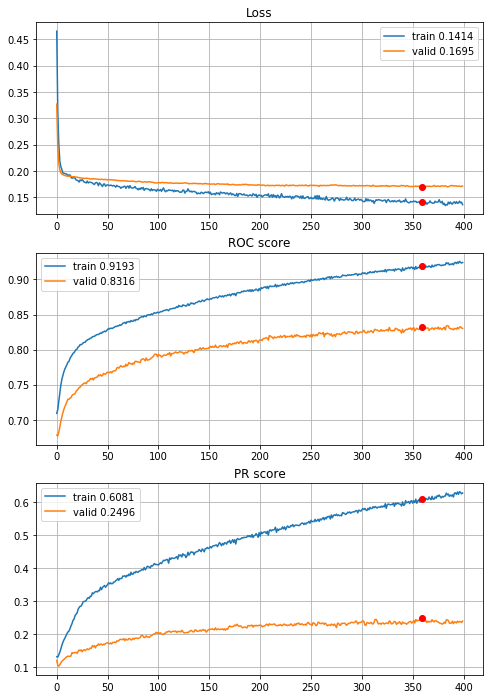


Fold 2------------------------------------------------------------


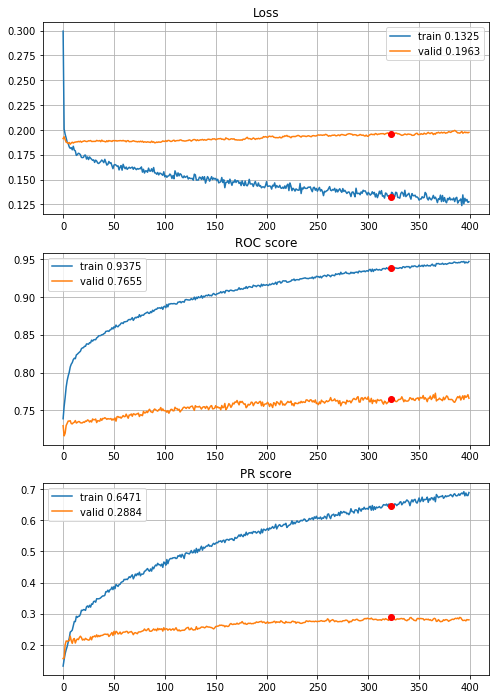


Fold 3------------------------------------------------------------


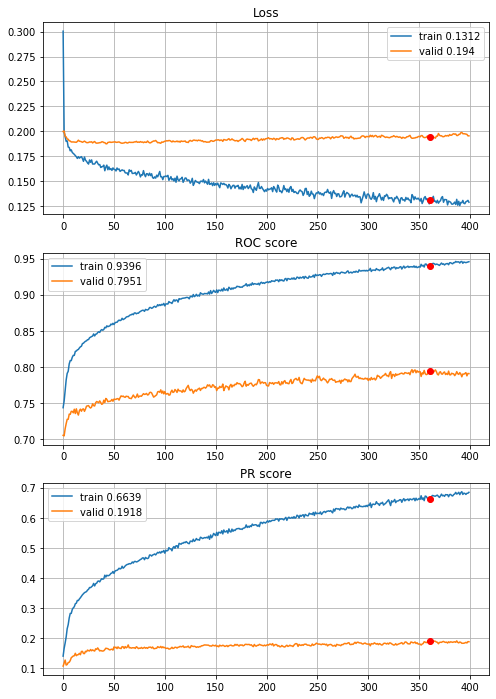


Fold 4------------------------------------------------------------


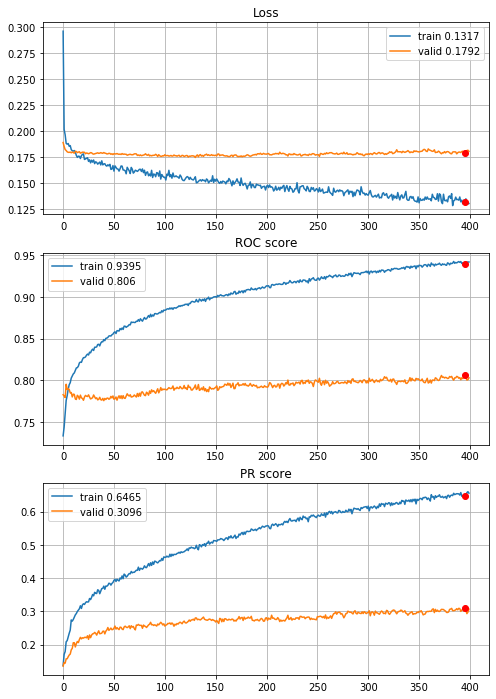


Fold 5------------------------------------------------------------


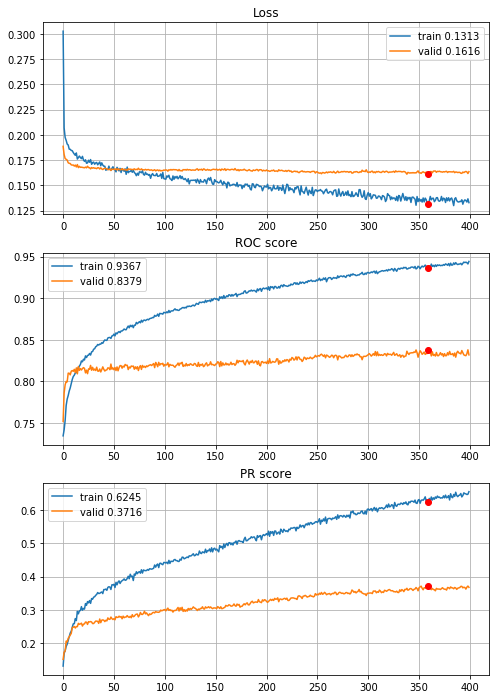


Fold 6------------------------------------------------------------


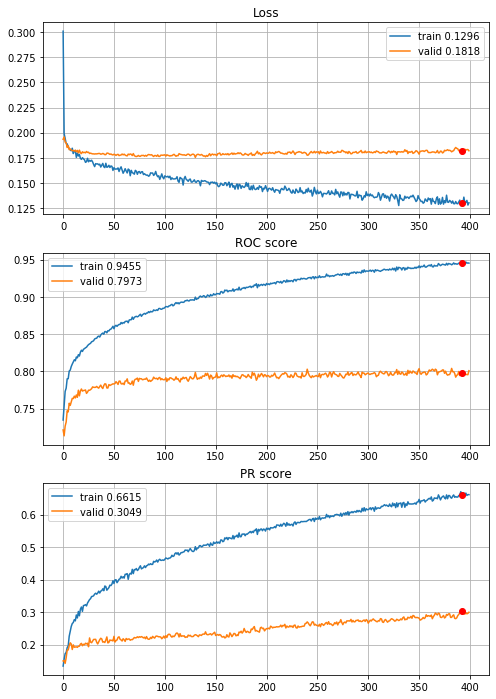

In [52]:
# normalization and quantile outliers reduction (Q_0.005 and Q_0.995)
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

What an improvement! +0.09 on PR compared to normalization only and +0.11 compared to raw data! Lets try power transform


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 5.43s train loss: 0.48251027576234706, validation loss: 0.353531512883831
Epoch: 2/400,
cumulative time: 5.59s train loss: 0.3352699785365341, validation loss: 0.25966156973491483
Epoch: 3/400,
cumulative time: 5.74s train loss: 0.2652636829504408, validation loss: 0.2199825882566795
Epoch: 4/400,
cumulative time: 5.89s train loss: 0.22603326225197967, validation loss: 0.2014119652986851
Epoch: 5/400,
cumulative time: 6.04s train loss: 0.21208210710964231, validation loss: 0.19286427863444333
Epoch: 6/400,
cumulative time: 6.19s train loss: 0.20319195777831245, validation loss: 0.18863596566848156
Epoch: 7/400,
cumulative time: 6.33s train loss: 0.19448871659344522, validation loss: 0.18681034684140638
Epoch: 8/400,
cumulative time: 6.48s train loss: 0.19301810195834665, validation loss: 0.18486366655811962
Epoch: 9/400,
cumulative time: 6.62s train loss: 0.18989496589940785, v

Epoch: 77/400,
cumulative time: 16.76s train loss: 0.15754819104639983, validation loss: 0.16471372163360665
Epoch: 78/400,
cumulative time: 16.91s train loss: 0.16002849974149128, validation loss: 0.1641629548747171
Epoch: 79/400,
cumulative time: 17.07s train loss: 0.15382568754106618, validation loss: 0.16279669524943285
Epoch: 80/400,
cumulative time: 17.22s train loss: 0.15604776970359296, validation loss: 0.16434050905736958
Epoch: 81/400,
cumulative time: 17.37s train loss: 0.15539151416330754, validation loss: 0.164496418547679
Epoch: 82/400,
cumulative time: 17.52s train loss: 0.15429274220363037, validation loss: 0.16400150935450242
Epoch: 83/400,
cumulative time: 17.67s train loss: 0.154431426237361, validation loss: 0.16383516265065431
Epoch: 84/400,
cumulative time: 17.83s train loss: 0.15484582190696736, validation loss: 0.1633481156610972
Epoch: 85/400,
cumulative time: 17.98s train loss: 0.15460723057139655, validation loss: 0.16466405199570588
Epoch: 86/400,
cumulative

Epoch: 153/400,
cumulative time: 28.0s train loss: 0.1383449476368012, validation loss: 0.16073685047616756
Epoch: 154/400,
cumulative time: 28.15s train loss: 0.1400885212860558, validation loss: 0.16055680631860897
Epoch: 155/400,
cumulative time: 28.3s train loss: 0.1400693297552572, validation loss: 0.158994450739162
Epoch: 156/400,
cumulative time: 28.45s train loss: 0.14363030585836167, validation loss: 0.15845821139518707
Epoch: 157/400,
cumulative time: 28.6s train loss: 0.13889304515931677, validation loss: 0.15740814883137658
Epoch: 158/400,
cumulative time: 28.75s train loss: 0.14370542452151258, validation loss: 0.15823254238755788
Epoch: 159/400,
cumulative time: 28.9s train loss: 0.14117155707160084, validation loss: 0.15909713630452296
Epoch: 160/400,
cumulative time: 29.05s train loss: 0.14135719634045638, validation loss: 0.1582880508461479
Epoch: 161/400,
cumulative time: 29.19s train loss: 0.14025090241544208, validation loss: 0.15755689518438706
Epoch: 162/400,
cumu

Epoch: 230/400,
cumulative time: 39.23s train loss: 0.1291064062091987, validation loss: 0.15546535498191907
Epoch: 231/400,
cumulative time: 39.38s train loss: 0.12702331019774227, validation loss: 0.15597696245284695
Epoch: 232/400,
cumulative time: 39.51s train loss: 0.13209321734919205, validation loss: 0.155108851111203
Epoch: 233/400,
cumulative time: 39.66s train loss: 0.12917472483610792, validation loss: 0.15513217669307497
Epoch: 234/400,
cumulative time: 39.8s train loss: 0.1303211438705368, validation loss: 0.15674631697251895
Epoch: 235/400,
cumulative time: 39.93s train loss: 0.128368382912013, validation loss: 0.15592303212765043
Epoch: 236/400,
cumulative time: 40.09s train loss: 0.13344009678816415, validation loss: 0.1558528651766748
Epoch: 237/400,
cumulative time: 40.24s train loss: 0.13325090843529203, validation loss: 0.15508641850347823
Epoch: 238/400,
cumulative time: 40.4s train loss: 0.12861448521004798, validation loss: 0.15470233835518318
Epoch: 239/400,
cum

Epoch: 306/400,
cumulative time: 50.09s train loss: 0.12030282852420134, validation loss: 0.15482249782960214
Epoch: 307/400,
cumulative time: 50.23s train loss: 0.12006585283937238, validation loss: 0.15058316018526208
Epoch: 308/400,
cumulative time: 50.36s train loss: 0.12240861107263093, validation loss: 0.1540570681175462
Epoch: 309/400,
cumulative time: 50.5s train loss: 0.1205321276413555, validation loss: 0.15339131854155016
Epoch: 310/400,
cumulative time: 50.64s train loss: 0.12235708770725329, validation loss: 0.15287242676629104
Epoch: 311/400,
cumulative time: 50.78s train loss: 0.12073589260313859, validation loss: 0.15158866809451554
Epoch: 312/400,
cumulative time: 50.91s train loss: 0.12331871308480688, validation loss: 0.15431591247603388
Epoch: 313/400,
cumulative time: 51.05s train loss: 0.12037171478023423, validation loss: 0.15171168966712067
Epoch: 314/400,
cumulative time: 51.19s train loss: 0.12188043471019404, validation loss: 0.15063766363204298
Epoch: 315/40

Epoch: 382/400,
cumulative time: 60.94s train loss: 0.1168120632692106, validation loss: 0.15104665735532347
Epoch: 383/400,
cumulative time: 61.09s train loss: 0.11330393125165732, validation loss: 0.14990437209322147
Epoch: 384/400,
cumulative time: 61.24s train loss: 0.11525238880332868, validation loss: 0.1491403468637908
Epoch: 385/400,
cumulative time: 61.38s train loss: 0.10941940326566806, validation loss: 0.14979826127939114
Epoch: 386/400,
cumulative time: 61.53s train loss: 0.11669183063130442, validation loss: 0.15089125849098636
Epoch: 387/400,
cumulative time: 61.67s train loss: 0.11718568883112823, validation loss: 0.14988090263247247
Epoch: 388/400,
cumulative time: 61.82s train loss: 0.11424674231512871, validation loss: 0.14860784106712263
Epoch: 389/400,
cumulative time: 61.97s train loss: 0.11915331430977735, validation loss: 0.149592802811026
Epoch: 390/400,
cumulative time: 62.12s train loss: 0.11579355288839269, validation loss: 0.15098463561844874
Epoch: 391/400

Epoch: 57/400,
cumulative time: 13.79s train loss: 0.14831465924693668, validation loss: 0.17599391191690614
Epoch: 58/400,
cumulative time: 13.92s train loss: 0.14664096533988358, validation loss: 0.1751315682274375
Epoch: 59/400,
cumulative time: 14.06s train loss: 0.14778010031515582, validation loss: 0.17507892029475322
Epoch: 60/400,
cumulative time: 14.2s train loss: 0.15343799596787083, validation loss: 0.17564959990442652
Epoch: 61/400,
cumulative time: 14.35s train loss: 0.14992238100844898, validation loss: 0.17522974700810878
Epoch: 62/400,
cumulative time: 14.49s train loss: 0.1470947553034977, validation loss: 0.1751321168620218
Epoch: 63/400,
cumulative time: 14.63s train loss: 0.1478246403993775, validation loss: 0.17497507694264186
Epoch: 64/400,
cumulative time: 14.77s train loss: 0.14607329394485197, validation loss: 0.17537982584344358
Epoch: 65/400,
cumulative time: 14.91s train loss: 0.1476461426626998, validation loss: 0.17502393531426028
Epoch: 66/400,
cumulative

Epoch: 133/400,
cumulative time: 24.59s train loss: 0.1322322050171653, validation loss: 0.17358163115806202
Epoch: 134/400,
cumulative time: 24.73s train loss: 0.13058074799039196, validation loss: 0.17294581622960536
Epoch: 135/400,
cumulative time: 24.88s train loss: 0.13303249530939645, validation loss: 0.17269717741673946
Epoch: 136/400,
cumulative time: 25.02s train loss: 0.12921709944251186, validation loss: 0.17270218441991922
Epoch: 137/400,
cumulative time: 25.16s train loss: 0.13322996989706304, validation loss: 0.17271549748656212
Epoch: 138/400,
cumulative time: 25.3s train loss: 0.1314786056313579, validation loss: 0.17304923156640253
Epoch: 139/400,
cumulative time: 25.44s train loss: 0.13477049905354752, validation loss: 0.17251872888546238
Epoch: 140/400,
cumulative time: 25.57s train loss: 0.13204817445884037, validation loss: 0.17221230773636886
Epoch: 141/400,
cumulative time: 25.72s train loss: 0.13342004786123132, validation loss: 0.1722853324440079
Epoch: 142/400

Epoch: 209/400,
cumulative time: 35.77s train loss: 0.1245823281752581, validation loss: 0.16963779235511023
Epoch: 210/400,
cumulative time: 35.92s train loss: 0.12105985622876884, validation loss: 0.17108131703712082
Epoch: 211/400,
cumulative time: 36.08s train loss: 0.12118128610740123, validation loss: 0.16983080932767802
Epoch: 212/400,
cumulative time: 36.22s train loss: 0.12077104518410459, validation loss: 0.16990643996844249
Epoch: 213/400,
cumulative time: 36.35s train loss: 0.12289488798961902, validation loss: 0.17086304906803867
Epoch: 214/400,
cumulative time: 36.49s train loss: 0.12134710250641269, validation loss: 0.16902979849308344
Epoch: 215/400,
cumulative time: 36.64s train loss: 0.12221169451041847, validation loss: 0.1693545599842737
Epoch: 216/400,
cumulative time: 36.79s train loss: 0.12202194811890175, validation loss: 0.16878882132678555
Epoch: 217/400,
cumulative time: 36.93s train loss: 0.12063798071350078, validation loss: 0.1689646617136008
Epoch: 218/40

Epoch: 285/400,
cumulative time: 46.62s train loss: 0.1120252606422054, validation loss: 0.16846830507903945
Epoch: 286/400,
cumulative time: 46.76s train loss: 0.11212747389011579, validation loss: 0.16771500465860165
Epoch: 287/400,
cumulative time: 46.9s train loss: 0.11471000401221747, validation loss: 0.16937619212880436
Epoch: 288/400,
cumulative time: 47.04s train loss: 0.11372706111219685, validation loss: 0.16861037546331337
Epoch: 289/400,
cumulative time: 47.19s train loss: 0.1118465173783053, validation loss: 0.16879830051941316
Epoch: 290/400,
cumulative time: 47.34s train loss: 0.11453423425646547, validation loss: 0.16891824492615368
Epoch: 291/400,
cumulative time: 47.48s train loss: 0.11438325341741704, validation loss: 0.16817844168132792
Epoch: 292/400,
cumulative time: 47.61s train loss: 0.1115254175826556, validation loss: 0.16779435015175115
Epoch: 293/400,
cumulative time: 47.76s train loss: 0.11143074315140232, validation loss: 0.1664449241116308
Epoch: 294/400,

Epoch: 361/400,
cumulative time: 57.56s train loss: 0.10704078946283399, validation loss: 0.16700845772186212
Epoch: 362/400,
cumulative time: 57.7s train loss: 0.1064899260774062, validation loss: 0.1684079010158757
Epoch: 363/400,
cumulative time: 57.84s train loss: 0.11012666513066549, validation loss: 0.16869586250707355
Epoch: 364/400,
cumulative time: 57.97s train loss: 0.11125067843982411, validation loss: 0.1670353852613107
Epoch: 365/400,
cumulative time: 58.11s train loss: 0.10920520381496954, validation loss: 0.16667221479975017
Epoch: 366/400,
cumulative time: 58.26s train loss: 0.10532133251501659, validation loss: 0.16752123227121068
Epoch: 367/400,
cumulative time: 58.4s train loss: 0.11129108134337022, validation loss: 0.16866829204693223
Epoch: 368/400,
cumulative time: 58.54s train loss: 0.10795202075087633, validation loss: 0.16906498774754264
Epoch: 369/400,
cumulative time: 58.68s train loss: 0.11142504043358638, validation loss: 0.1676266682622707
Epoch: 370/400,


Epoch: 35/400,
cumulative time: 10.24s train loss: 0.15678020236027204, validation loss: 0.17393098988648253
Epoch: 36/400,
cumulative time: 10.38s train loss: 0.15600268704501905, validation loss: 0.173719219178712
Epoch: 37/400,
cumulative time: 10.52s train loss: 0.15388511829093418, validation loss: 0.17395041691275012
Epoch: 38/400,
cumulative time: 10.66s train loss: 0.15424222505118595, validation loss: 0.1737057056412395
Epoch: 39/400,
cumulative time: 10.82s train loss: 0.15325365359315946, validation loss: 0.17278119878066162
Epoch: 40/400,
cumulative time: 10.97s train loss: 0.15306219518850273, validation loss: 0.17261713006773963
Epoch: 41/400,
cumulative time: 11.12s train loss: 0.15252175210717261, validation loss: 0.17278346413248163
Epoch: 42/400,
cumulative time: 11.26s train loss: 0.15235624830988728, validation loss: 0.1734552539129335
Epoch: 43/400,
cumulative time: 11.39s train loss: 0.15216301389299328, validation loss: 0.1724296464978472
Epoch: 44/400,
cumulativ

Epoch: 111/400,
cumulative time: 21.01s train loss: 0.1392426366103405, validation loss: 0.16850805836441243
Epoch: 112/400,
cumulative time: 21.15s train loss: 0.1361460749612393, validation loss: 0.16920365670086007
Epoch: 113/400,
cumulative time: 21.3s train loss: 0.1385602579220884, validation loss: 0.168725401092095
Epoch: 114/400,
cumulative time: 21.44s train loss: 0.13483722343377288, validation loss: 0.16812615954729876
Epoch: 115/400,
cumulative time: 21.57s train loss: 0.13440896541257652, validation loss: 0.17053516389684178
Epoch: 116/400,
cumulative time: 21.7s train loss: 0.13550226647981617, validation loss: 0.16805150266039362
Epoch: 117/400,
cumulative time: 21.85s train loss: 0.1345671907485335, validation loss: 0.16927389190909486
Epoch: 118/400,
cumulative time: 22.0s train loss: 0.1348561260508822, validation loss: 0.1700683616411126
Epoch: 119/400,
cumulative time: 22.13s train loss: 0.1344661936620495, validation loss: 0.16876135424661992
Epoch: 120/400,
cumula

Epoch: 187/400,
cumulative time: 31.98s train loss: 0.11942731464276858, validation loss: 0.16851060523558345
Epoch: 188/400,
cumulative time: 32.14s train loss: 0.12275426345049775, validation loss: 0.1673020406025782
Epoch: 189/400,
cumulative time: 32.28s train loss: 0.126364492583093, validation loss: 0.16729499366187658
Epoch: 190/400,
cumulative time: 32.42s train loss: 0.12130843449130818, validation loss: 0.16808668108640518
Epoch: 191/400,
cumulative time: 32.58s train loss: 0.1251842350824951, validation loss: 0.16799437044184576
Epoch: 192/400,
cumulative time: 32.73s train loss: 0.12471525582730827, validation loss: 0.1687440213051842
Epoch: 193/400,
cumulative time: 32.88s train loss: 0.12275726914032431, validation loss: 0.16804473068618384
Epoch: 194/400,
cumulative time: 33.03s train loss: 0.12931987381461985, validation loss: 0.16828137212176159
Epoch: 195/400,
cumulative time: 33.17s train loss: 0.12473612762992686, validation loss: 0.1665172279996885
Epoch: 196/400,


Epoch: 263/400,
cumulative time: 42.92s train loss: 0.1182461347738891, validation loss: 0.16657607571822272
Epoch: 264/400,
cumulative time: 43.06s train loss: 0.12004931532653171, validation loss: 0.16648370112749572
Epoch: 265/400,
cumulative time: 43.2s train loss: 0.1196892384795342, validation loss: 0.16731061908645317
Epoch: 266/400,
cumulative time: 43.33s train loss: 0.11587975587658803, validation loss: 0.16750734105168597
Epoch: 267/400,
cumulative time: 43.47s train loss: 0.12144951061495932, validation loss: 0.16675446478179556
Epoch: 268/400,
cumulative time: 43.61s train loss: 0.11886006761020135, validation loss: 0.16567879614982578
Epoch: 269/400,
cumulative time: 43.76s train loss: 0.11662982040885585, validation loss: 0.165163247844165
Epoch: 270/400,
cumulative time: 43.9s train loss: 0.11588330690569015, validation loss: 0.16516842899515646
Epoch: 271/400,
cumulative time: 44.05s train loss: 0.1140879145394095, validation loss: 0.1656244633208334
Epoch: 272/400,
cu

Epoch: 339/400,
cumulative time: 54.07s train loss: 0.10783005280344846, validation loss: 0.16634021224701298
Epoch: 340/400,
cumulative time: 54.2s train loss: 0.10839233907142809, validation loss: 0.16622974033295662
Epoch: 341/400,
cumulative time: 54.35s train loss: 0.10983317749110325, validation loss: 0.16665942366428324
Epoch: 342/400,
cumulative time: 54.49s train loss: 0.10616162918324401, validation loss: 0.16677809225165818
Epoch: 343/400,
cumulative time: 54.64s train loss: 0.10811710166201416, validation loss: 0.1663514608282715
Epoch: 344/400,
cumulative time: 54.78s train loss: 0.10853927708319061, validation loss: 0.16624798023676368
Epoch: 345/400,
cumulative time: 54.92s train loss: 0.10622421247943227, validation loss: 0.16567895713105665
Epoch: 346/400,
cumulative time: 55.07s train loss: 0.11106270784848266, validation loss: 0.16490831046058987
Epoch: 347/400,
cumulative time: 55.21s train loss: 0.1090507900866666, validation loss: 0.16587688332110379
Epoch: 348/40

Epoch: 13/400,
cumulative time: 7.93s train loss: 0.17223368862312302, validation loss: 0.17137265618233716
Epoch: 14/400,
cumulative time: 8.07s train loss: 0.16729961554823594, validation loss: 0.1711588864264803
Epoch: 15/400,
cumulative time: 8.21s train loss: 0.16584875793721976, validation loss: 0.16986665893485547
Epoch: 16/400,
cumulative time: 8.35s train loss: 0.16828854720525613, validation loss: 0.16900798805194944
Epoch: 17/400,
cumulative time: 8.49s train loss: 0.1679830763574746, validation loss: 0.1681422423939059
Epoch: 18/400,
cumulative time: 8.62s train loss: 0.16456571839476872, validation loss: 0.16819542167623325
Epoch: 19/400,
cumulative time: 8.75s train loss: 0.16658422063737316, validation loss: 0.16729919981639996
Epoch: 20/400,
cumulative time: 8.89s train loss: 0.16939206490777386, validation loss: 0.16621956780015246
Epoch: 21/400,
cumulative time: 9.03s train loss: 0.16775599124888446, validation loss: 0.1695918086092029
Epoch: 22/400,
cumulative time: 

Epoch: 89/400,
cumulative time: 18.47s train loss: 0.1422608233709256, validation loss: 0.15509158415482757
Epoch: 90/400,
cumulative time: 18.62s train loss: 0.14606585064335967, validation loss: 0.15355586245848746
Epoch: 91/400,
cumulative time: 18.77s train loss: 0.14514028817419297, validation loss: 0.1552422982218965
Epoch: 92/400,
cumulative time: 18.91s train loss: 0.14142706712430625, validation loss: 0.1543960545422513
Epoch: 93/400,
cumulative time: 19.06s train loss: 0.1438572364599913, validation loss: 0.15512372155713744
Epoch: 94/400,
cumulative time: 19.21s train loss: 0.14160796282573243, validation loss: 0.1521205730568884
Epoch: 95/400,
cumulative time: 19.35s train loss: 0.14125394566083788, validation loss: 0.15380132153701262
Epoch: 96/400,
cumulative time: 19.49s train loss: 0.14399531588159237, validation loss: 0.15272714599327947
Epoch: 97/400,
cumulative time: 19.64s train loss: 0.14089908862891581, validation loss: 0.1529484646023334
Epoch: 98/400,
cumulative

Epoch: 165/400,
cumulative time: 29.45s train loss: 0.13558856657516336, validation loss: 0.15039376950004296
Epoch: 166/400,
cumulative time: 29.58s train loss: 0.13495776232575, validation loss: 0.14996392881894616
Epoch: 167/400,
cumulative time: 29.73s train loss: 0.13137393579420692, validation loss: 0.1506988144675593
Epoch: 168/400,
cumulative time: 29.88s train loss: 0.13143137281822215, validation loss: 0.1503417409647071
Epoch: 169/400,
cumulative time: 30.03s train loss: 0.13482572783221508, validation loss: 0.14845427640487419
Epoch: 170/400,
cumulative time: 30.17s train loss: 0.13387587431518416, validation loss: 0.1499174358773345
Epoch: 171/400,
cumulative time: 30.32s train loss: 0.135017817678397, validation loss: 0.15050757557173988
Epoch: 172/400,
cumulative time: 30.46s train loss: 0.13523486893698644, validation loss: 0.14934728460461205
Epoch: 173/400,
cumulative time: 30.61s train loss: 0.13331070121762767, validation loss: 0.15027469819585346
Epoch: 174/400,
cu

Epoch: 241/400,
cumulative time: 40.37s train loss: 0.12437079362261771, validation loss: 0.1458913944991289
Epoch: 242/400,
cumulative time: 40.51s train loss: 0.12931696337209025, validation loss: 0.145310349990674
Epoch: 243/400,
cumulative time: 40.65s train loss: 0.12641936288259992, validation loss: 0.1463680929619086
Epoch: 244/400,
cumulative time: 40.79s train loss: 0.12558335385050806, validation loss: 0.145322411106183
Epoch: 245/400,
cumulative time: 40.93s train loss: 0.12454149317355015, validation loss: 0.14492709107996252
Epoch: 246/400,
cumulative time: 41.07s train loss: 0.1266418601635219, validation loss: 0.1435765535491433
Epoch: 247/400,
cumulative time: 41.21s train loss: 0.12617394230609433, validation loss: 0.14512259597839994
Epoch: 248/400,
cumulative time: 41.35s train loss: 0.12416029825094332, validation loss: 0.1453554698344069
Epoch: 249/400,
cumulative time: 41.51s train loss: 0.12585398954168484, validation loss: 0.1433361200165635
Epoch: 250/400,
cumu

Epoch: 317/400,
cumulative time: 51.31s train loss: 0.11842088081601139, validation loss: 0.14302544651833254
Epoch: 318/400,
cumulative time: 51.45s train loss: 0.11663470651239591, validation loss: 0.14450362884649376
Epoch: 319/400,
cumulative time: 51.59s train loss: 0.11960880449831883, validation loss: 0.14272935116388427
Epoch: 320/400,
cumulative time: 51.73s train loss: 0.12029153663103447, validation loss: 0.1456955650109998
Epoch: 321/400,
cumulative time: 51.87s train loss: 0.12183134900473223, validation loss: 0.14358472379800655
Epoch: 322/400,
cumulative time: 52.01s train loss: 0.11778339361496717, validation loss: 0.14541487415036514
Epoch: 323/400,
cumulative time: 52.15s train loss: 0.12137412618636176, validation loss: 0.14507636202688198
Epoch: 324/400,
cumulative time: 52.29s train loss: 0.11907553168914956, validation loss: 0.1439503516933397
Epoch: 325/400,
cumulative time: 52.44s train loss: 0.11670475261064961, validation loss: 0.1436704356727996
Epoch: 326/40

Epoch: 393/400,
cumulative time: 62.31s train loss: 0.11270215787043221, validation loss: 0.1424819750190187
Epoch: 394/400,
cumulative time: 62.46s train loss: 0.11549145613998545, validation loss: 0.14227812330969505
Epoch: 395/400,
cumulative time: 62.61s train loss: 0.11705776127152948, validation loss: 0.14360613935329705
Epoch: 396/400,
cumulative time: 62.75s train loss: 0.11508740421501765, validation loss: 0.1421680417370845
Epoch: 397/400,
cumulative time: 62.91s train loss: 0.11684411678914233, validation loss: 0.14173207241836416
Epoch: 398/400,
cumulative time: 63.05s train loss: 0.11098781625707127, validation loss: 0.1434463997878048
Epoch: 399/400,
cumulative time: 63.2s train loss: 0.11296464878333681, validation loss: 0.14353859821211487
Epoch: 400/400,
cumulative time: 63.34s train loss: 0.11313758990582143, validation loss: 0.1444194061647393

Early stopping results:
best results in epoch: 389, 
best valid PR: 0.4948837130776827, 
valid ROC: 0.8788733432874338      

Epoch: 67/400,
cumulative time: 15.96s train loss: 0.1487715045002356, validation loss: 0.14892741276474025
Epoch: 68/400,
cumulative time: 16.1s train loss: 0.14807147378292673, validation loss: 0.15230044769250078
Epoch: 69/400,
cumulative time: 16.25s train loss: 0.1487162116050623, validation loss: 0.1489495045076599
Epoch: 70/400,
cumulative time: 16.39s train loss: 0.15157102457245644, validation loss: 0.148649522572837
Epoch: 71/400,
cumulative time: 16.55s train loss: 0.14457264567130856, validation loss: 0.14931181312744235
Epoch: 72/400,
cumulative time: 16.69s train loss: 0.14502525366923907, validation loss: 0.1487165751793404
Epoch: 73/400,
cumulative time: 16.82s train loss: 0.14546252460643033, validation loss: 0.1507278351514151
Epoch: 74/400,
cumulative time: 16.95s train loss: 0.147993949225704, validation loss: 0.14914005259889349
Epoch: 75/400,
cumulative time: 17.09s train loss: 0.14292723114941114, validation loss: 0.14876310645072272
Epoch: 76/400,
cumulative tim

Epoch: 143/400,
cumulative time: 26.57s train loss: 0.1362340819589745, validation loss: 0.14296984609612326
Epoch: 144/400,
cumulative time: 26.71s train loss: 0.13394314216851605, validation loss: 0.14113373859539344
Epoch: 145/400,
cumulative time: 26.85s train loss: 0.13648127939365398, validation loss: 0.14187425676459187
Epoch: 146/400,
cumulative time: 26.99s train loss: 0.13733943429428572, validation loss: 0.14103605336324396
Epoch: 147/400,
cumulative time: 27.13s train loss: 0.13428912157383555, validation loss: 0.14188833670736334
Epoch: 148/400,
cumulative time: 27.27s train loss: 0.13441084930165986, validation loss: 0.1413271426037969
Epoch: 149/400,
cumulative time: 27.41s train loss: 0.132999084104656, validation loss: 0.1431041841042464
Epoch: 150/400,
cumulative time: 27.54s train loss: 0.12987970353625633, validation loss: 0.14145901710891268
Epoch: 151/400,
cumulative time: 27.68s train loss: 0.13851978790120492, validation loss: 0.1421627722761774
Epoch: 152/400,


Epoch: 219/400,
cumulative time: 37.34s train loss: 0.1258161542237146, validation loss: 0.13725108229009592
Epoch: 220/400,
cumulative time: 37.49s train loss: 0.12602189021927665, validation loss: 0.1377177859481414
Epoch: 221/400,
cumulative time: 37.63s train loss: 0.12896349253680775, validation loss: 0.13728188939534675
Epoch: 222/400,
cumulative time: 37.77s train loss: 0.12636738545859885, validation loss: 0.13667016361690348
Epoch: 223/400,
cumulative time: 37.91s train loss: 0.12433825546270946, validation loss: 0.13601728382568593
Epoch: 224/400,
cumulative time: 38.05s train loss: 0.12227363305365208, validation loss: 0.13808037303083598
Epoch: 225/400,
cumulative time: 38.18s train loss: 0.12566762465034045, validation loss: 0.1375047278562586
Epoch: 226/400,
cumulative time: 38.33s train loss: 0.1256526410863745, validation loss: 0.1376919775531305
Epoch: 227/400,
cumulative time: 38.46s train loss: 0.12122787894530948, validation loss: 0.1382540234184395
Epoch: 228/400,


Epoch: 295/400,
cumulative time: 48.2s train loss: 0.1190412682957931, validation loss: 0.1333278533406251
Epoch: 296/400,
cumulative time: 48.34s train loss: 0.1202284718370613, validation loss: 0.1336882471510435
Epoch: 297/400,
cumulative time: 48.48s train loss: 0.11721970220877584, validation loss: 0.1350074771598834
Epoch: 298/400,
cumulative time: 48.63s train loss: 0.11690190807796512, validation loss: 0.13376192738395945
Epoch: 299/400,
cumulative time: 48.78s train loss: 0.11519167941136688, validation loss: 0.135243198243084
Epoch: 300/400,
cumulative time: 48.91s train loss: 0.11837483429571123, validation loss: 0.13383144148364054
Epoch: 301/400,
cumulative time: 49.06s train loss: 0.11789390090893556, validation loss: 0.13332128713582453
Epoch: 302/400,
cumulative time: 49.2s train loss: 0.12038597008842399, validation loss: 0.13406450545024481
Epoch: 303/400,
cumulative time: 49.35s train loss: 0.11738776692548414, validation loss: 0.13353011064860737
Epoch: 304/400,
cum

Epoch: 371/400,
cumulative time: 59.12s train loss: 0.11662497919474876, validation loss: 0.13206073498652807
Epoch: 372/400,
cumulative time: 59.27s train loss: 0.11019573630541887, validation loss: 0.13197891253785152
Epoch: 373/400,
cumulative time: 59.42s train loss: 0.11005517205300544, validation loss: 0.13250526917809036
Epoch: 374/400,
cumulative time: 59.56s train loss: 0.11325133537715362, validation loss: 0.1318564385439622
Epoch: 375/400,
cumulative time: 59.7s train loss: 0.1132195938017406, validation loss: 0.13143395195012197
Epoch: 376/400,
cumulative time: 59.86s train loss: 0.11140328373816798, validation loss: 0.13122397129314797
Epoch: 377/400,
cumulative time: 60.01s train loss: 0.11489972695180728, validation loss: 0.1312624415743091
Epoch: 378/400,
cumulative time: 60.15s train loss: 0.11125085711446722, validation loss: 0.13211443249836605
Epoch: 379/400,
cumulative time: 60.3s train loss: 0.11667248117483844, validation loss: 0.13145404458248972
Epoch: 380/400,

Epoch: 45/400,
cumulative time: 13.16s train loss: 0.1522634546546375, validation loss: 0.16797464235358406
Epoch: 46/400,
cumulative time: 13.31s train loss: 0.15679219628487406, validation loss: 0.16787706774327021
Epoch: 47/400,
cumulative time: 13.45s train loss: 0.15301357558471898, validation loss: 0.167133911611761
Epoch: 48/400,
cumulative time: 13.6s train loss: 0.15619388248260116, validation loss: 0.1674692042232859
Epoch: 49/400,
cumulative time: 13.76s train loss: 0.15149691539830762, validation loss: 0.16614256675383052
Epoch: 50/400,
cumulative time: 13.92s train loss: 0.14993973786908169, validation loss: 0.16666764102125037
Epoch: 51/400,
cumulative time: 14.06s train loss: 0.15270071077994465, validation loss: 0.16623756488434951
Epoch: 52/400,
cumulative time: 14.2s train loss: 0.15194796772028496, validation loss: 0.16778198438785383
Epoch: 53/400,
cumulative time: 14.36s train loss: 0.15164979491261096, validation loss: 0.16713035453811328
Epoch: 54/400,
cumulative

Epoch: 122/400,
cumulative time: 24.99s train loss: 0.13449706214891993, validation loss: 0.16236904517262768
Epoch: 123/400,
cumulative time: 25.13s train loss: 0.13844034754648837, validation loss: 0.16370211513230845
Epoch: 124/400,
cumulative time: 25.29s train loss: 0.13695961251359814, validation loss: 0.16222136057608783
Epoch: 125/400,
cumulative time: 25.44s train loss: 0.13480668630824305, validation loss: 0.1627627078250903
Epoch: 126/400,
cumulative time: 25.6s train loss: 0.1343874718592155, validation loss: 0.1622867895853617
Epoch: 127/400,
cumulative time: 25.75s train loss: 0.1298845626012075, validation loss: 0.16290227051732975
Epoch: 128/400,
cumulative time: 25.89s train loss: 0.1363969553395911, validation loss: 0.164265157213328
Epoch: 129/400,
cumulative time: 26.04s train loss: 0.13774453867673225, validation loss: 0.16244449086832416
Epoch: 130/400,
cumulative time: 26.19s train loss: 0.13620872054987612, validation loss: 0.16200712268375245
Epoch: 131/400,
cu

Epoch: 198/400,
cumulative time: 36.5s train loss: 0.12844576187886314, validation loss: 0.16190437231547827
Epoch: 199/400,
cumulative time: 36.66s train loss: 0.1273872489738633, validation loss: 0.16159638086440453
Epoch: 200/400,
cumulative time: 36.8s train loss: 0.12854105286900774, validation loss: 0.16033090659155833
Epoch: 201/400,
cumulative time: 36.95s train loss: 0.12594210415315654, validation loss: 0.16177548616312504
Epoch: 202/400,
cumulative time: 37.1s train loss: 0.12573499423258963, validation loss: 0.16222448354683391
Epoch: 203/400,
cumulative time: 37.25s train loss: 0.1272987492914131, validation loss: 0.16193319591173358
Epoch: 204/400,
cumulative time: 37.4s train loss: 0.12797150578276784, validation loss: 0.16200409531187296
Epoch: 205/400,
cumulative time: 37.55s train loss: 0.12899692529662307, validation loss: 0.16096509260199052
Epoch: 206/400,
cumulative time: 37.71s train loss: 0.12430173617814036, validation loss: 0.16001899272447062
Epoch: 207/400,


Epoch: 274/400,
cumulative time: 48.01s train loss: 0.1230699089771717, validation loss: 0.1594792582927023
Epoch: 275/400,
cumulative time: 48.16s train loss: 0.12196613608784405, validation loss: 0.16085607806164823
Epoch: 276/400,
cumulative time: 48.32s train loss: 0.11879225801635931, validation loss: 0.16090603258044583
Epoch: 277/400,
cumulative time: 48.47s train loss: 0.12189404144558512, validation loss: 0.16010938178778344
Epoch: 278/400,
cumulative time: 48.62s train loss: 0.1176186068701783, validation loss: 0.16091022484146605
Epoch: 279/400,
cumulative time: 48.77s train loss: 0.1210441161474631, validation loss: 0.16007967321684316
Epoch: 280/400,
cumulative time: 48.92s train loss: 0.11595030411091797, validation loss: 0.16039166201606433
Epoch: 281/400,
cumulative time: 49.08s train loss: 0.11986041878003116, validation loss: 0.1610964121099064
Epoch: 282/400,
cumulative time: 49.23s train loss: 0.11819178061377184, validation loss: 0.16101812077965333
Epoch: 283/400,

Epoch: 350/400,
cumulative time: 59.55s train loss: 0.11462894947042847, validation loss: 0.15709125525660672
Epoch: 351/400,
cumulative time: 59.7s train loss: 0.11463526300761305, validation loss: 0.15679140899543542
Epoch: 352/400,
cumulative time: 59.85s train loss: 0.11318670665492224, validation loss: 0.15874084195868196
Epoch: 353/400,
cumulative time: 60.0s train loss: 0.11666350548758227, validation loss: 0.15846888281465876
Epoch: 354/400,
cumulative time: 60.16s train loss: 0.11513552138042152, validation loss: 0.15891111017857001
Epoch: 355/400,
cumulative time: 60.31s train loss: 0.112004598237428, validation loss: 0.1593145732374542
Epoch: 356/400,
cumulative time: 60.46s train loss: 0.11108466336698411, validation loss: 0.15861516902654632
Epoch: 357/400,
cumulative time: 60.61s train loss: 0.11483650317533278, validation loss: 0.1584913125642314
Epoch: 358/400,
cumulative time: 60.76s train loss: 0.11541767925032148, validation loss: 0.15836378312809266
Epoch: 359/400,


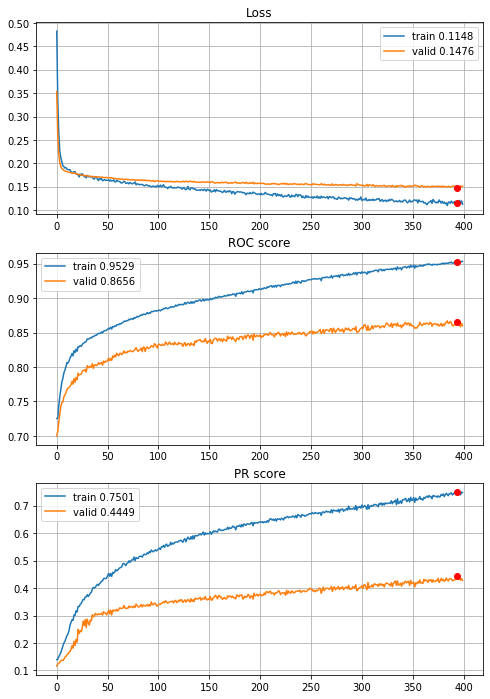


Fold 2------------------------------------------------------------


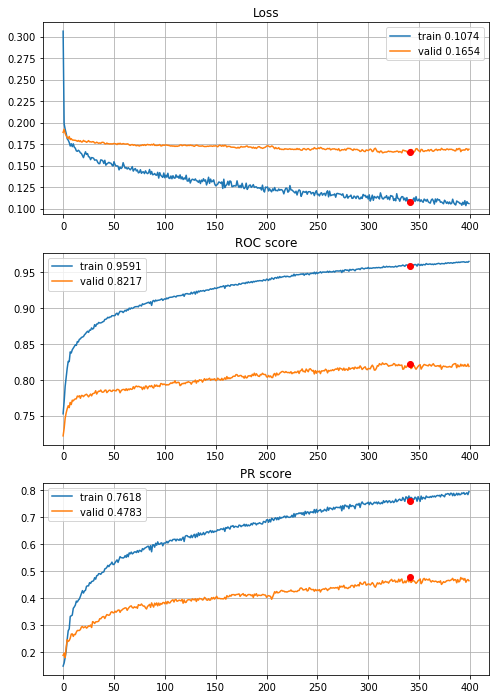


Fold 3------------------------------------------------------------


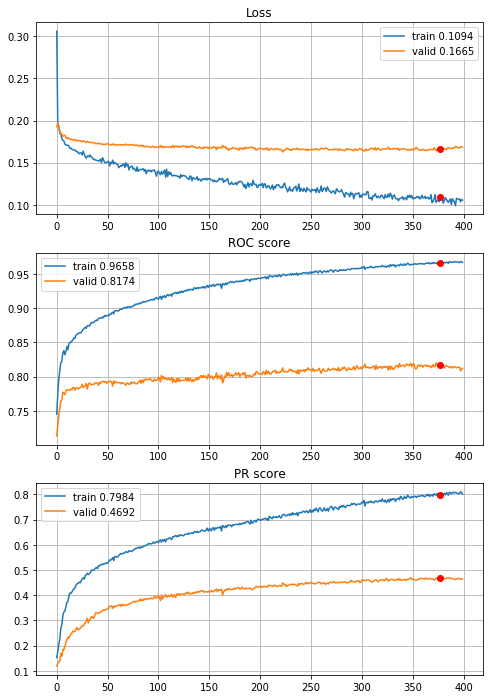


Fold 4------------------------------------------------------------


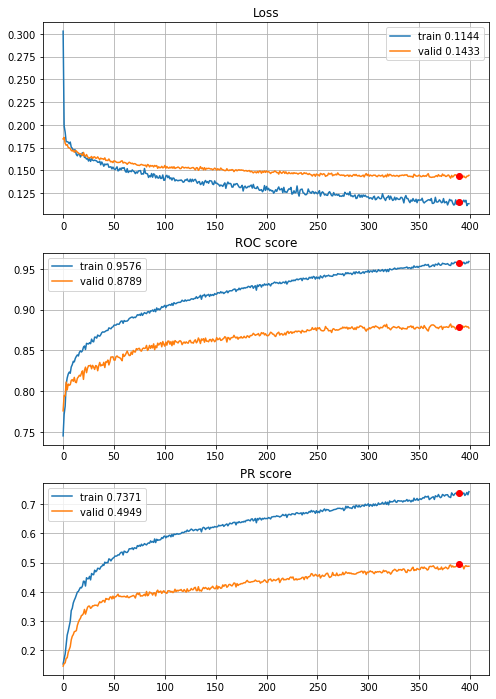


Fold 5------------------------------------------------------------


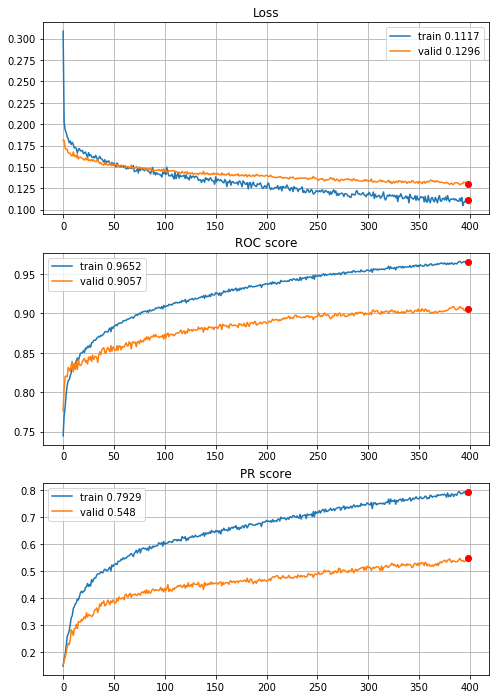


Fold 6------------------------------------------------------------


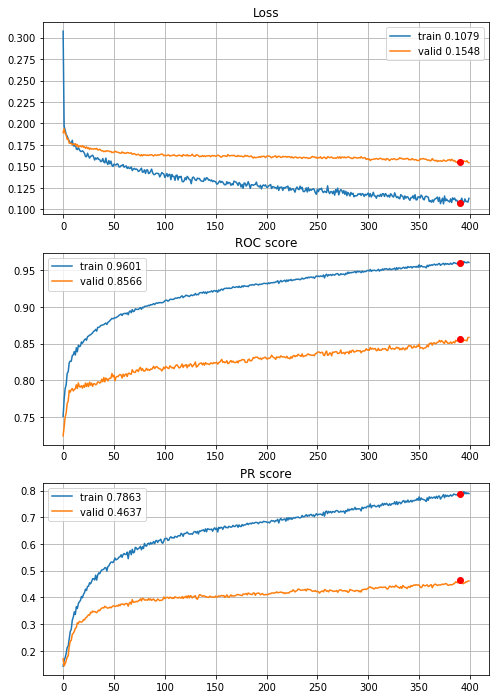

In [53]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

First of all, very big scores improvement, + 0.2 compared to normalization and quantile clipping, + 0.29 to normalization only and + 0.31 to the raw data, it is more than triple multiplier. What is more, this improvement is much bigger than for one year forecast horizon. Third, results are better than the best model so far - XGBoost and there is still potential for regularization, dropouts, layers, hidden units, more epochs etc. 

Lets add another layer


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 7.03s train loss: 0.5175121181442711, validation loss: 0.3593481206788426
Epoch: 2/400,
cumulative time: 7.2s train loss: 0.30450553287606497, validation loss: 0.24833172709865584
Epoch: 3/400,
cumulative time: 7.36s train loss: 0.23408884858177578, validation loss: 0.2148665936018351
Epoch: 4/400,
cumulative time: 7.51s train loss: 0.2117664173344866, validation loss: 0.20252511795886607
Epoch: 5/400,
cumulative time: 7.68s train loss: 0.20029983680173258, validation loss: 0.19701130881935988
Epoch: 6/400,
cumulative time: 7.85s train loss: 0.19575679182486785, validation loss: 0.1940261616217514
Epoch: 7/400,
cumulative time: 8.02s train loss: 0.19206411881471513, validation loss: 0.19195557311126535
Epoch: 8/400,
cumulative time: 8.18s train loss: 0.1895458881701271, validation loss: 0.19079886226730333
Epoch: 9/400,
cumulative time: 8.34s train loss: 0.1877416587161641, val

Epoch: 77/400,
cumulative time: 18.89s train loss: 0.15016743471564672, validation loss: 0.16647330708573513
Epoch: 78/400,
cumulative time: 19.05s train loss: 0.1478357403906298, validation loss: 0.16625569604585738
Epoch: 79/400,
cumulative time: 19.21s train loss: 0.1500301406540339, validation loss: 0.16449126754389726
Epoch: 80/400,
cumulative time: 19.37s train loss: 0.14928192199372342, validation loss: 0.1653150602860707
Epoch: 81/400,
cumulative time: 19.53s train loss: 0.14669520221523769, validation loss: 0.1656192783152189
Epoch: 82/400,
cumulative time: 19.69s train loss: 0.14694512745559046, validation loss: 0.1657877224614784
Epoch: 83/400,
cumulative time: 19.9s train loss: 0.14787314696856127, validation loss: 0.16605710764171477
Epoch: 84/400,
cumulative time: 20.1s train loss: 0.14767560423289042, validation loss: 0.1648632789790184
Epoch: 85/400,
cumulative time: 20.27s train loss: 0.14492948911551412, validation loss: 0.16663649964283891
Epoch: 86/400,
cumulative t

Epoch: 153/400,
cumulative time: 31.12s train loss: 0.13131150980744458, validation loss: 0.15849475460120657
Epoch: 154/400,
cumulative time: 31.27s train loss: 0.1343712544130334, validation loss: 0.1590615274895609
Epoch: 155/400,
cumulative time: 31.42s train loss: 0.1368884540019788, validation loss: 0.15859695992111106
Epoch: 156/400,
cumulative time: 31.57s train loss: 0.13376874319704746, validation loss: 0.15656565292056845
Epoch: 157/400,
cumulative time: 31.74s train loss: 0.13444306216925994, validation loss: 0.158129480560269
Epoch: 158/400,
cumulative time: 31.88s train loss: 0.13461169842379497, validation loss: 0.1567285092429615
Epoch: 159/400,
cumulative time: 32.03s train loss: 0.13426903429187872, validation loss: 0.15801566336088393
Epoch: 160/400,
cumulative time: 32.18s train loss: 0.1338204309246885, validation loss: 0.15769504254127215
Epoch: 161/400,
cumulative time: 32.33s train loss: 0.13590285836854812, validation loss: 0.15753806270329299
Epoch: 162/400,
c

Epoch: 229/400,
cumulative time: 42.86s train loss: 0.12575139204958682, validation loss: 0.1537211336312122
Epoch: 230/400,
cumulative time: 43.01s train loss: 0.12501381488419774, validation loss: 0.15603766739977062
Epoch: 231/400,
cumulative time: 43.17s train loss: 0.12546976677739585, validation loss: 0.15502175562961154
Epoch: 232/400,
cumulative time: 43.32s train loss: 0.12768252673654648, validation loss: 0.1548146264458936
Epoch: 233/400,
cumulative time: 43.48s train loss: 0.12654027606808455, validation loss: 0.15402252551160595
Epoch: 234/400,
cumulative time: 43.63s train loss: 0.12501723441760415, validation loss: 0.15515961766324132
Epoch: 235/400,
cumulative time: 43.79s train loss: 0.12520166270178149, validation loss: 0.15441439963669254
Epoch: 236/400,
cumulative time: 43.94s train loss: 0.1280497851873246, validation loss: 0.154709030893727
Epoch: 237/400,
cumulative time: 44.1s train loss: 0.12849300076197526, validation loss: 0.15471962548746715
Epoch: 238/400,


Epoch: 305/400,
cumulative time: 54.64s train loss: 0.12052587417921935, validation loss: 0.15287440484725676
Epoch: 306/400,
cumulative time: 54.79s train loss: 0.11988310973995407, validation loss: 0.15144403505033177
Epoch: 307/400,
cumulative time: 54.95s train loss: 0.12102868975661811, validation loss: 0.15171309638136987
Epoch: 308/400,
cumulative time: 55.1s train loss: 0.12026068280068856, validation loss: 0.15369379418978812
Epoch: 309/400,
cumulative time: 55.26s train loss: 0.11743978599278426, validation loss: 0.15110573163439905
Epoch: 310/400,
cumulative time: 55.41s train loss: 0.11921581874527853, validation loss: 0.1529195140704888
Epoch: 311/400,
cumulative time: 55.56s train loss: 0.1182499812439289, validation loss: 0.1525889884622183
Epoch: 312/400,
cumulative time: 55.72s train loss: 0.1196395791229964, validation loss: 0.15493350511022455
Epoch: 313/400,
cumulative time: 55.87s train loss: 0.12185638096073449, validation loss: 0.1517860867422888
Epoch: 314/400,


Epoch: 381/400,
cumulative time: 66.42s train loss: 0.11418162143012897, validation loss: 0.14904437694442443
Epoch: 382/400,
cumulative time: 66.58s train loss: 0.1133692205483917, validation loss: 0.14571559226293804
Epoch: 383/400,
cumulative time: 66.73s train loss: 0.11185200119942293, validation loss: 0.14781314486585725
Epoch: 384/400,
cumulative time: 66.9s train loss: 0.11433663117849874, validation loss: 0.14819269916936603
Epoch: 385/400,
cumulative time: 67.04s train loss: 0.11561422364743906, validation loss: 0.14659290955008253
Epoch: 386/400,
cumulative time: 67.2s train loss: 0.11394309215871641, validation loss: 0.1450193262347727
Epoch: 387/400,
cumulative time: 67.35s train loss: 0.11171520575241774, validation loss: 0.14605220508177805
Epoch: 388/400,
cumulative time: 67.5s train loss: 0.11037287556409155, validation loss: 0.1495002569431671
Epoch: 389/400,
cumulative time: 67.66s train loss: 0.11395521652413602, validation loss: 0.14843251188447315
Epoch: 390/400,


Epoch: 55/400,
cumulative time: 15.38s train loss: 0.14478372891949615, validation loss: 0.16784376828564196
Epoch: 56/400,
cumulative time: 15.55s train loss: 0.14083540761858798, validation loss: 0.16758019778905392
Epoch: 57/400,
cumulative time: 15.72s train loss: 0.1426249765418749, validation loss: 0.1685395038517419
Epoch: 58/400,
cumulative time: 15.89s train loss: 0.14157577370178404, validation loss: 0.16768231894630733
Epoch: 59/400,
cumulative time: 16.05s train loss: 0.1440930186801169, validation loss: 0.16639375532460585
Epoch: 60/400,
cumulative time: 16.22s train loss: 0.1448971470370209, validation loss: 0.16701929111457178
Epoch: 61/400,
cumulative time: 16.38s train loss: 0.14394314156701385, validation loss: 0.1671438937521127
Epoch: 62/400,
cumulative time: 16.54s train loss: 0.14163674207777902, validation loss: 0.16694055278541442
Epoch: 63/400,
cumulative time: 16.71s train loss: 0.14022474188368245, validation loss: 0.16541424731440574
Epoch: 64/400,
cumulativ

Epoch: 131/400,
cumulative time: 27.24s train loss: 0.130516542334591, validation loss: 0.16242128394549196
Epoch: 132/400,
cumulative time: 27.4s train loss: 0.12501912998005366, validation loss: 0.16226142063138435
Epoch: 133/400,
cumulative time: 27.56s train loss: 0.1256812792451476, validation loss: 0.16231376090428715
Epoch: 134/400,
cumulative time: 27.72s train loss: 0.12860061660415062, validation loss: 0.16372114971249666
Epoch: 135/400,
cumulative time: 27.88s train loss: 0.12464666215191254, validation loss: 0.1621485419160578
Epoch: 136/400,
cumulative time: 28.04s train loss: 0.12303580616258494, validation loss: 0.16203768121762047
Epoch: 137/400,
cumulative time: 28.2s train loss: 0.12241303225710073, validation loss: 0.16348194444033465
Epoch: 138/400,
cumulative time: 28.35s train loss: 0.12619678962868694, validation loss: 0.1631670631037187
Epoch: 139/400,
cumulative time: 28.51s train loss: 0.12684279914433472, validation loss: 0.16351951156610367
Epoch: 140/400,
c

Epoch: 207/400,
cumulative time: 38.93s train loss: 0.12104119561043387, validation loss: 0.1605065225783946
Epoch: 208/400,
cumulative time: 39.09s train loss: 0.12133672245756963, validation loss: 0.1617774604696088
Epoch: 209/400,
cumulative time: 39.25s train loss: 0.12233879389075189, validation loss: 0.16057147093274465
Epoch: 210/400,
cumulative time: 39.41s train loss: 0.11763400340587993, validation loss: 0.16297932499683657
Epoch: 211/400,
cumulative time: 39.57s train loss: 0.11643129319610054, validation loss: 0.1604565197539784
Epoch: 212/400,
cumulative time: 39.73s train loss: 0.11589564701427349, validation loss: 0.1610074633538439
Epoch: 213/400,
cumulative time: 39.89s train loss: 0.11702329443619781, validation loss: 0.16037585547256014
Epoch: 214/400,
cumulative time: 40.05s train loss: 0.11934209904269076, validation loss: 0.160180280470702
Epoch: 215/400,
cumulative time: 40.21s train loss: 0.11733690191866444, validation loss: 0.15932869981185688
Epoch: 216/400,


Epoch: 283/400,
cumulative time: 50.62s train loss: 0.11057992388198669, validation loss: 0.15829292610744136
Epoch: 284/400,
cumulative time: 50.78s train loss: 0.11209675626851842, validation loss: 0.15661607679154615
Epoch: 285/400,
cumulative time: 50.94s train loss: 0.10977715691753227, validation loss: 0.1582744305812639
Epoch: 286/400,
cumulative time: 51.1s train loss: 0.1063666213904985, validation loss: 0.15817536922378392
Epoch: 287/400,
cumulative time: 51.26s train loss: 0.11044194693706932, validation loss: 0.158024078002992
Epoch: 288/400,
cumulative time: 51.42s train loss: 0.10592442773861893, validation loss: 0.156401568799298
Epoch: 289/400,
cumulative time: 51.58s train loss: 0.11098086657404624, validation loss: 0.15814839846691037
Epoch: 290/400,
cumulative time: 51.74s train loss: 0.1109495762906574, validation loss: 0.1566956701623168
Epoch: 291/400,
cumulative time: 51.9s train loss: 0.10926907879608488, validation loss: 0.15819802966509003
Epoch: 292/400,
cumu

Epoch: 358/400,
cumulative time: 62.26s train loss: 0.10985923621990726, validation loss: 0.1555528981830491
Epoch: 359/400,
cumulative time: 62.41s train loss: 0.10620908226691522, validation loss: 0.15596659964367676
Epoch: 360/400,
cumulative time: 62.55s train loss: 0.10399206623944375, validation loss: 0.1552688944615662
Epoch: 361/400,
cumulative time: 62.69s train loss: 0.10268865951419234, validation loss: 0.15607918816675045
Epoch: 362/400,
cumulative time: 62.83s train loss: 0.10057081318869182, validation loss: 0.15658723264729757
Epoch: 363/400,
cumulative time: 62.99s train loss: 0.10111002729152702, validation loss: 0.1563255488517497
Epoch: 364/400,
cumulative time: 63.15s train loss: 0.10305665383283082, validation loss: 0.15627278820177257
Epoch: 365/400,
cumulative time: 63.31s train loss: 0.1025967391074134, validation loss: 0.157102073690492
Epoch: 366/400,
cumulative time: 63.45s train loss: 0.10575675864919694, validation loss: 0.15642910847317368
Epoch: 367/400,


Epoch: 31/400,
cumulative time: 11.98s train loss: 0.15497344043945463, validation loss: 0.17969242086249845
Epoch: 32/400,
cumulative time: 12.13s train loss: 0.1550859259478276, validation loss: 0.18017054844705974
Epoch: 33/400,
cumulative time: 12.29s train loss: 0.15463041682691742, validation loss: 0.17833862028169015
Epoch: 34/400,
cumulative time: 12.44s train loss: 0.1524063544739791, validation loss: 0.17874059247434992
Epoch: 35/400,
cumulative time: 12.6s train loss: 0.15414656286755554, validation loss: 0.17815450706231992
Epoch: 36/400,
cumulative time: 12.76s train loss: 0.1531132707824081, validation loss: 0.17756929968270094
Epoch: 37/400,
cumulative time: 12.91s train loss: 0.15182402067827006, validation loss: 0.17839702869492213
Epoch: 38/400,
cumulative time: 13.07s train loss: 0.15039263597288655, validation loss: 0.17757347259617243
Epoch: 39/400,
cumulative time: 13.23s train loss: 0.14862635667571153, validation loss: 0.17835495635674387
Epoch: 40/400,
cumulati

Epoch: 107/400,
cumulative time: 23.85s train loss: 0.12982913081313646, validation loss: 0.1720936772691871
Epoch: 108/400,
cumulative time: 24.0s train loss: 0.13444573696117773, validation loss: 0.17211101290885894
Epoch: 109/400,
cumulative time: 24.16s train loss: 0.13305645059714538, validation loss: 0.1726030922406705
Epoch: 110/400,
cumulative time: 24.32s train loss: 0.1306498558979, validation loss: 0.1718319979470307
Epoch: 111/400,
cumulative time: 24.47s train loss: 0.12824679265514344, validation loss: 0.17156547108136366
Epoch: 112/400,
cumulative time: 24.63s train loss: 0.12875117946390266, validation loss: 0.1719095520294792
Epoch: 113/400,
cumulative time: 24.78s train loss: 0.12814581077015727, validation loss: 0.1716205987944905
Epoch: 114/400,
cumulative time: 24.94s train loss: 0.12858806678551704, validation loss: 0.17096266739826124
Epoch: 115/400,
cumulative time: 25.09s train loss: 0.1314560754733759, validation loss: 0.17211405518024125
Epoch: 116/400,
cumul

Epoch: 183/400,
cumulative time: 35.6s train loss: 0.12281157777888337, validation loss: 0.16763296673661435
Epoch: 184/400,
cumulative time: 35.76s train loss: 0.11983738764846551, validation loss: 0.1674940837350648
Epoch: 185/400,
cumulative time: 35.9s train loss: 0.12149964663920863, validation loss: 0.16787198643403609
Epoch: 186/400,
cumulative time: 36.05s train loss: 0.11769016559578069, validation loss: 0.16633512135506326
Epoch: 187/400,
cumulative time: 36.21s train loss: 0.1211589117967334, validation loss: 0.16684787975557
Epoch: 188/400,
cumulative time: 36.36s train loss: 0.12269889996070621, validation loss: 0.16697811645216645
Epoch: 189/400,
cumulative time: 36.51s train loss: 0.1232251773707454, validation loss: 0.16446177837920076
Epoch: 190/400,
cumulative time: 36.67s train loss: 0.12155300572394805, validation loss: 0.16559363866112037
Epoch: 191/400,
cumulative time: 36.82s train loss: 0.12178273973868553, validation loss: 0.1658328029069063
Epoch: 192/400,
cum

Epoch: 259/400,
cumulative time: 47.2s train loss: 0.11461168841333168, validation loss: 0.16353410359667303
Epoch: 260/400,
cumulative time: 47.35s train loss: 0.11818660147732649, validation loss: 0.1646856903989271
Epoch: 261/400,
cumulative time: 47.51s train loss: 0.11612971918663764, validation loss: 0.16290716369432848
Epoch: 262/400,
cumulative time: 47.66s train loss: 0.11556252722525555, validation loss: 0.16356758331059598
Epoch: 263/400,
cumulative time: 47.81s train loss: 0.109233577899715, validation loss: 0.165648426061751
Epoch: 264/400,
cumulative time: 47.97s train loss: 0.11394136423991094, validation loss: 0.16374317800576707
Epoch: 265/400,
cumulative time: 48.12s train loss: 0.11104058070065426, validation loss: 0.16393609654343477
Epoch: 266/400,
cumulative time: 48.28s train loss: 0.11545238229095424, validation loss: 0.1638582971040857
Epoch: 267/400,
cumulative time: 48.43s train loss: 0.11634853216002038, validation loss: 0.16358333512623346
Epoch: 268/400,
c

Epoch: 335/400,
cumulative time: 58.94s train loss: 0.10936910069562686, validation loss: 0.1632575396273394
Epoch: 336/400,
cumulative time: 59.09s train loss: 0.10880241896254514, validation loss: 0.16403208283480533
Epoch: 337/400,
cumulative time: 59.24s train loss: 0.11033145441892733, validation loss: 0.1633666021593417
Epoch: 338/400,
cumulative time: 59.39s train loss: 0.11161924319766156, validation loss: 0.1657926209671632
Epoch: 339/400,
cumulative time: 59.54s train loss: 0.1063223231462583, validation loss: 0.1630510364648353
Epoch: 340/400,
cumulative time: 59.71s train loss: 0.11036942531314774, validation loss: 0.16117757677504446
Epoch: 341/400,
cumulative time: 59.88s train loss: 0.11178760523876767, validation loss: 0.1617710728114604
Epoch: 342/400,
cumulative time: 60.03s train loss: 0.11123796862496937, validation loss: 0.16180408905768087
Epoch: 343/400,
cumulative time: 60.19s train loss: 0.10504752653838016, validation loss: 0.1610427849588141
Epoch: 344/400,
c

Epoch: 9/400,
cumulative time: 8.73s train loss: 0.1755521796358617, validation loss: 0.17871629320455296
Epoch: 10/400,
cumulative time: 8.87s train loss: 0.17400867036889656, validation loss: 0.17841841091786703
Epoch: 11/400,
cumulative time: 9.03s train loss: 0.17285719390105733, validation loss: 0.17809188743283588
Epoch: 12/400,
cumulative time: 9.18s train loss: 0.17215251885065344, validation loss: 0.17667648420397158
Epoch: 13/400,
cumulative time: 9.33s train loss: 0.17114148257003725, validation loss: 0.17797624242192145
Epoch: 14/400,
cumulative time: 9.48s train loss: 0.17097767013166087, validation loss: 0.17713089730562687
Epoch: 15/400,
cumulative time: 9.64s train loss: 0.16955596392427108, validation loss: 0.1752543137481701
Epoch: 16/400,
cumulative time: 9.8s train loss: 0.16751912861441487, validation loss: 0.1751910510559809
Epoch: 17/400,
cumulative time: 9.97s train loss: 0.16614301262841177, validation loss: 0.17493965048178106
Epoch: 18/400,
cumulative time: 1

Epoch: 85/400,
cumulative time: 20.81s train loss: 0.13694285274558474, validation loss: 0.15890208064211397
Epoch: 86/400,
cumulative time: 20.97s train loss: 0.13900434819977145, validation loss: 0.15818159903004675
Epoch: 87/400,
cumulative time: 21.13s train loss: 0.1378816230922438, validation loss: 0.1586061723078896
Epoch: 88/400,
cumulative time: 21.29s train loss: 0.13511769384669298, validation loss: 0.1580077159700952
Epoch: 89/400,
cumulative time: 21.45s train loss: 0.13810356026869225, validation loss: 0.1575653423371974
Epoch: 90/400,
cumulative time: 21.6s train loss: 0.14068597564495308, validation loss: 0.15817326913892696
Epoch: 91/400,
cumulative time: 21.76s train loss: 0.13568668486201665, validation loss: 0.1584378480201193
Epoch: 92/400,
cumulative time: 21.91s train loss: 0.1359566583373104, validation loss: 0.15733135124913197
Epoch: 93/400,
cumulative time: 22.07s train loss: 0.13585752340792862, validation loss: 0.1585510281618961
Epoch: 94/400,
cumulative t

Epoch: 161/400,
cumulative time: 32.87s train loss: 0.12792365023863506, validation loss: 0.1542573999474047
Epoch: 162/400,
cumulative time: 33.03s train loss: 0.12738811669623382, validation loss: 0.15680346869748818
Epoch: 163/400,
cumulative time: 33.19s train loss: 0.12520529689368998, validation loss: 0.1555309204563468
Epoch: 164/400,
cumulative time: 33.36s train loss: 0.12611802968629193, validation loss: 0.1541064472690255
Epoch: 165/400,
cumulative time: 33.52s train loss: 0.12562090254854347, validation loss: 0.15674686031206844
Epoch: 166/400,
cumulative time: 33.68s train loss: 0.12733887576949737, validation loss: 0.15252433583353392
Epoch: 167/400,
cumulative time: 33.85s train loss: 0.12767298996192825, validation loss: 0.15294103424836375
Epoch: 168/400,
cumulative time: 34.01s train loss: 0.1250584649606214, validation loss: 0.1538601523763554
Epoch: 169/400,
cumulative time: 34.16s train loss: 0.12616223213938232, validation loss: 0.15535118974050427
Epoch: 170/400,

Epoch: 237/400,
cumulative time: 44.65s train loss: 0.12205324331522963, validation loss: 0.1499115784935922
Epoch: 238/400,
cumulative time: 44.8s train loss: 0.12022496511809397, validation loss: 0.15321621188223158
Epoch: 239/400,
cumulative time: 44.95s train loss: 0.1217040790068134, validation loss: 0.15288107178298854
Epoch: 240/400,
cumulative time: 45.09s train loss: 0.11808429962402303, validation loss: 0.15137997731170824
Epoch: 241/400,
cumulative time: 45.24s train loss: 0.12284888508439827, validation loss: 0.15125232592093207
Epoch: 242/400,
cumulative time: 45.4s train loss: 0.12126261790032025, validation loss: 0.15136363153923443
Epoch: 243/400,
cumulative time: 45.58s train loss: 0.11950848849413426, validation loss: 0.15317899680527153
Epoch: 244/400,
cumulative time: 45.74s train loss: 0.12031795367766966, validation loss: 0.15282345273569378
Epoch: 245/400,
cumulative time: 45.9s train loss: 0.12049346766938765, validation loss: 0.1508860531471634
Epoch: 246/400,


Epoch: 313/400,
cumulative time: 56.5s train loss: 0.1155808291670803, validation loss: 0.1504189105383631
Epoch: 314/400,
cumulative time: 56.64s train loss: 0.11673889496776789, validation loss: 0.149798142252689
Epoch: 315/400,
cumulative time: 56.8s train loss: 0.11570144788061876, validation loss: 0.15160218519244248
Epoch: 316/400,
cumulative time: 56.94s train loss: 0.1157273766874504, validation loss: 0.15038108658311802
Epoch: 317/400,
cumulative time: 57.1s train loss: 0.1136767670987056, validation loss: 0.14941689094124075
Epoch: 318/400,
cumulative time: 57.26s train loss: 0.11140408247697098, validation loss: 0.14810229397655914
Epoch: 319/400,
cumulative time: 57.41s train loss: 0.11176712381592989, validation loss: 0.14947466872799875
Epoch: 320/400,
cumulative time: 57.56s train loss: 0.1156313451516617, validation loss: 0.15101270414153437
Epoch: 321/400,
cumulative time: 57.72s train loss: 0.11538349228477211, validation loss: 0.1526169192129613
Epoch: 322/400,
cumul

Epoch: 389/400,
cumulative time: 68.35s train loss: 0.11075873934336226, validation loss: 0.15003274853859247
Epoch: 390/400,
cumulative time: 68.51s train loss: 0.11109210185003462, validation loss: 0.150509243690294
Epoch: 391/400,
cumulative time: 68.65s train loss: 0.11096018241180901, validation loss: 0.15273173728550754
Epoch: 392/400,
cumulative time: 68.81s train loss: 0.10803801250907456, validation loss: 0.14926733406244125
Epoch: 393/400,
cumulative time: 68.96s train loss: 0.10917426107280605, validation loss: 0.15123906244705776
Epoch: 394/400,
cumulative time: 69.12s train loss: 0.10747287405879787, validation loss: 0.14926670771662762
Epoch: 395/400,
cumulative time: 69.28s train loss: 0.11245336514166715, validation loss: 0.1513285737020617
Epoch: 396/400,
cumulative time: 69.43s train loss: 0.11182936000820727, validation loss: 0.1480993450276295
Epoch: 397/400,
cumulative time: 69.58s train loss: 0.1093234820457549, validation loss: 0.1489744085065356
Epoch: 398/400,


Epoch: 64/400,
cumulative time: 18.0s train loss: 0.1464050008199119, validation loss: 0.15185623863656125
Epoch: 65/400,
cumulative time: 18.17s train loss: 0.14858544218782052, validation loss: 0.1535994273074966
Epoch: 66/400,
cumulative time: 18.34s train loss: 0.14296986802211253, validation loss: 0.1531732673541077
Epoch: 67/400,
cumulative time: 18.49s train loss: 0.14225109934214347, validation loss: 0.15374379201058797
Epoch: 68/400,
cumulative time: 18.64s train loss: 0.14437317760754578, validation loss: 0.15484131052481057
Epoch: 69/400,
cumulative time: 18.8s train loss: 0.14452128194085848, validation loss: 0.15250585577387252
Epoch: 70/400,
cumulative time: 18.97s train loss: 0.14492925743659663, validation loss: 0.15323689271383778
Epoch: 71/400,
cumulative time: 19.14s train loss: 0.14406298185355781, validation loss: 0.15042160611792546
Epoch: 72/400,
cumulative time: 19.29s train loss: 0.14282332218915614, validation loss: 0.15274485779230862
Epoch: 73/400,
cumulativ

Epoch: 140/400,
cumulative time: 30.06s train loss: 0.13141652107977334, validation loss: 0.15246394692795803
Epoch: 141/400,
cumulative time: 30.21s train loss: 0.12773278220668272, validation loss: 0.15124070756035865
Epoch: 142/400,
cumulative time: 30.36s train loss: 0.1277536887123629, validation loss: 0.15213044320692484
Epoch: 143/400,
cumulative time: 30.53s train loss: 0.12914210977540036, validation loss: 0.15102220174402242
Epoch: 144/400,
cumulative time: 30.69s train loss: 0.1302377415074275, validation loss: 0.15118060666022248
Epoch: 145/400,
cumulative time: 30.85s train loss: 0.13010622636863478, validation loss: 0.15008143235089344
Epoch: 146/400,
cumulative time: 31.01s train loss: 0.13074829516230327, validation loss: 0.14991977033319526
Epoch: 147/400,
cumulative time: 31.15s train loss: 0.13224474420620855, validation loss: 0.14945580379920695
Epoch: 148/400,
cumulative time: 31.29s train loss: 0.12829622448562017, validation loss: 0.14952586891703126
Epoch: 149/4

Epoch: 215/400,
cumulative time: 41.82s train loss: 0.12249857919749221, validation loss: 0.1512447170486892
Epoch: 216/400,
cumulative time: 41.98s train loss: 0.12276222006354912, validation loss: 0.15131439120389462
Epoch: 217/400,
cumulative time: 42.15s train loss: 0.11873305266345638, validation loss: 0.1517226691548116
Epoch: 218/400,
cumulative time: 42.31s train loss: 0.12306266392262608, validation loss: 0.1518881339630574
Epoch: 219/400,
cumulative time: 42.46s train loss: 0.12189276631280357, validation loss: 0.15127440233402745
Epoch: 220/400,
cumulative time: 42.62s train loss: 0.11904804440608861, validation loss: 0.15097934630894855
Epoch: 221/400,
cumulative time: 42.78s train loss: 0.12143943233370846, validation loss: 0.1510940671616744
Epoch: 222/400,
cumulative time: 42.94s train loss: 0.1241537752705332, validation loss: 0.15135979201715713
Epoch: 223/400,
cumulative time: 43.09s train loss: 0.12334926510615221, validation loss: 0.14984243960000515
Epoch: 224/400,

Epoch: 291/400,
cumulative time: 53.78s train loss: 0.11576062550845359, validation loss: 0.14749752418506049
Epoch: 292/400,
cumulative time: 53.94s train loss: 0.1168971676683796, validation loss: 0.14641509686243956
Epoch: 293/400,
cumulative time: 54.09s train loss: 0.11628154248672827, validation loss: 0.14771176636097216
Epoch: 294/400,
cumulative time: 54.25s train loss: 0.11643465514820321, validation loss: 0.1472543905253144
Epoch: 295/400,
cumulative time: 54.41s train loss: 0.11403531744702838, validation loss: 0.14979389127171333
Epoch: 296/400,
cumulative time: 54.57s train loss: 0.1161110810752885, validation loss: 0.14846080539580586
Epoch: 297/400,
cumulative time: 54.72s train loss: 0.11878844586957839, validation loss: 0.15024317737049564
Epoch: 298/400,
cumulative time: 54.87s train loss: 0.11451820023601351, validation loss: 0.14753820019335123
Epoch: 299/400,
cumulative time: 55.03s train loss: 0.1193710583138375, validation loss: 0.15027976893802106
Epoch: 300/400

Epoch: 367/400,
cumulative time: 65.71s train loss: 0.11270631724270568, validation loss: 0.148307309417455
Epoch: 368/400,
cumulative time: 65.86s train loss: 0.11778355856306348, validation loss: 0.14829933541834517
Epoch: 369/400,
cumulative time: 66.0s train loss: 0.11102305164800101, validation loss: 0.14760267975098107
Epoch: 370/400,
cumulative time: 66.15s train loss: 0.11368440556865438, validation loss: 0.15004786015653154
Epoch: 371/400,
cumulative time: 66.3s train loss: 0.11157813954140691, validation loss: 0.1507575522286041
Epoch: 372/400,
cumulative time: 66.45s train loss: 0.11263545425831947, validation loss: 0.15018419667631794
Epoch: 373/400,
cumulative time: 66.6s train loss: 0.11400721488370355, validation loss: 0.14980356309979098
Epoch: 374/400,
cumulative time: 66.75s train loss: 0.11007248993946771, validation loss: 0.15027208228364627
Epoch: 375/400,
cumulative time: 66.91s train loss: 0.11260033477592832, validation loss: 0.15006450166778604
Epoch: 376/400,


Epoch: 41/400,
cumulative time: 14.59s train loss: 0.1512710070298388, validation loss: 0.16420357032838895
Epoch: 42/400,
cumulative time: 14.75s train loss: 0.15179478499251123, validation loss: 0.16416054730600493
Epoch: 43/400,
cumulative time: 14.91s train loss: 0.15040468717955685, validation loss: 0.16449942470246504
Epoch: 44/400,
cumulative time: 15.07s train loss: 0.15120859575013515, validation loss: 0.16487309592458793
Epoch: 45/400,
cumulative time: 15.23s train loss: 0.15099608937931736, validation loss: 0.16349993171094224
Epoch: 46/400,
cumulative time: 15.39s train loss: 0.15148772998694696, validation loss: 0.16348813608166957
Epoch: 47/400,
cumulative time: 15.54s train loss: 0.14790414635514057, validation loss: 0.1637168277349394
Epoch: 48/400,
cumulative time: 15.7s train loss: 0.14973163015710308, validation loss: 0.16323400780111957
Epoch: 49/400,
cumulative time: 15.86s train loss: 0.14759951264826757, validation loss: 0.1627540549603405
Epoch: 50/400,
cumulati

Epoch: 117/400,
cumulative time: 26.41s train loss: 0.13125573035962637, validation loss: 0.1621717394656966
Epoch: 118/400,
cumulative time: 26.55s train loss: 0.12758120404016673, validation loss: 0.1604596520558365
Epoch: 119/400,
cumulative time: 26.69s train loss: 0.13031627402147827, validation loss: 0.161549096170823
Epoch: 120/400,
cumulative time: 26.84s train loss: 0.13052941774969723, validation loss: 0.16127403652960337
Epoch: 121/400,
cumulative time: 27.0s train loss: 0.1309034826704717, validation loss: 0.16089217569831282
Epoch: 122/400,
cumulative time: 27.16s train loss: 0.12909295376236013, validation loss: 0.16095319219765936
Epoch: 123/400,
cumulative time: 27.31s train loss: 0.13202521940875872, validation loss: 0.16162589180209655
Epoch: 124/400,
cumulative time: 27.44s train loss: 0.1321686678109508, validation loss: 0.16122703250162607
Epoch: 125/400,
cumulative time: 27.6s train loss: 0.13008773973321214, validation loss: 0.1607258803025903
Epoch: 126/400,
cum

Epoch: 193/400,
cumulative time: 38.09s train loss: 0.12144591895283112, validation loss: 0.15958792955820178
Epoch: 194/400,
cumulative time: 38.25s train loss: 0.12189126553212765, validation loss: 0.15987161723566964
Epoch: 195/400,
cumulative time: 38.4s train loss: 0.12500958319465286, validation loss: 0.1587210407008592
Epoch: 196/400,
cumulative time: 38.55s train loss: 0.1232961164016382, validation loss: 0.15844030318939067
Epoch: 197/400,
cumulative time: 38.7s train loss: 0.12101468872603573, validation loss: 0.15771124909862835
Epoch: 198/400,
cumulative time: 38.85s train loss: 0.12323166542201584, validation loss: 0.15832749480122765
Epoch: 199/400,
cumulative time: 39.01s train loss: 0.12165421394992433, validation loss: 0.15950899889910902
Epoch: 200/400,
cumulative time: 39.15s train loss: 0.12436439532153552, validation loss: 0.1583552558675449
Epoch: 201/400,
cumulative time: 39.31s train loss: 0.12009111134647868, validation loss: 0.15860859085412377
Epoch: 202/400,

Epoch: 269/400,
cumulative time: 49.9s train loss: 0.11814776598425147, validation loss: 0.15788401277578495
Epoch: 270/400,
cumulative time: 50.06s train loss: 0.116247553331676, validation loss: 0.15728368135093018
Epoch: 271/400,
cumulative time: 50.22s train loss: 0.11756102928246548, validation loss: 0.15861989494809012
Epoch: 272/400,
cumulative time: 50.37s train loss: 0.11920269053786474, validation loss: 0.15745916574868585
Epoch: 273/400,
cumulative time: 50.54s train loss: 0.116943766113395, validation loss: 0.1583674728301955
Epoch: 274/400,
cumulative time: 50.68s train loss: 0.11456387140635961, validation loss: 0.15954829979819887
Epoch: 275/400,
cumulative time: 50.83s train loss: 0.11608761670737484, validation loss: 0.15934118062095357
Epoch: 276/400,
cumulative time: 50.98s train loss: 0.11350821653149681, validation loss: 0.16088510020471075
Epoch: 277/400,
cumulative time: 51.13s train loss: 0.11572961306731036, validation loss: 0.15924747168449355
Epoch: 278/400,


Epoch: 345/400,
cumulative time: 61.63s train loss: 0.112866355061596, validation loss: 0.158443645962415
Epoch: 346/400,
cumulative time: 61.78s train loss: 0.10843673191380267, validation loss: 0.15892504979869002
Epoch: 347/400,
cumulative time: 61.93s train loss: 0.11005757781950866, validation loss: 0.15713465743639812
Epoch: 348/400,
cumulative time: 62.09s train loss: 0.10789166383591353, validation loss: 0.1570856563483012
Epoch: 349/400,
cumulative time: 62.24s train loss: 0.11073632897659, validation loss: 0.15751323197290748
Epoch: 350/400,
cumulative time: 62.39s train loss: 0.11166546344229533, validation loss: 0.158447801478065
Epoch: 351/400,
cumulative time: 62.54s train loss: 0.11455199877226274, validation loss: 0.15629918670296994
Epoch: 352/400,
cumulative time: 62.7s train loss: 0.1107776355067337, validation loss: 0.15698797523731756
Epoch: 353/400,
cumulative time: 62.86s train loss: 0.10887547994482946, validation loss: 0.15751415854497566
Epoch: 354/400,
cumula

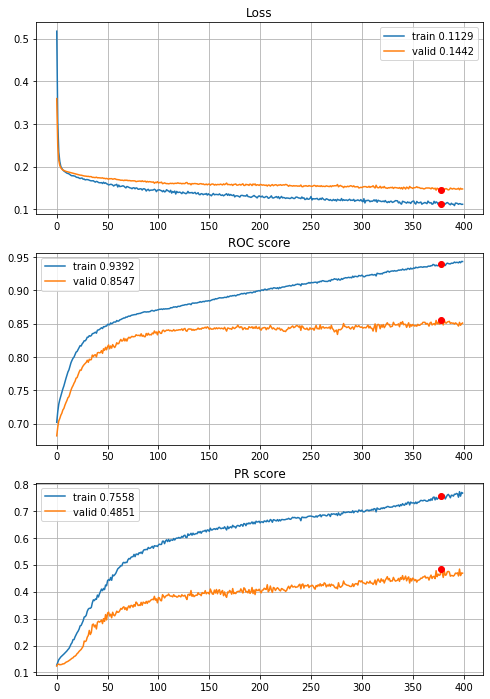


Fold 2------------------------------------------------------------


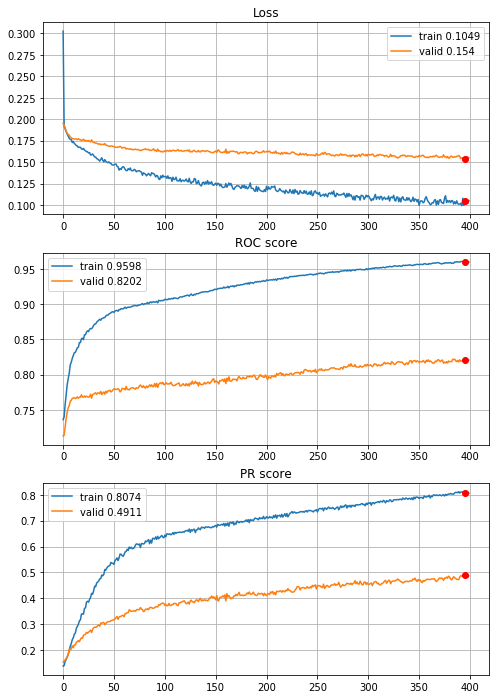


Fold 3------------------------------------------------------------


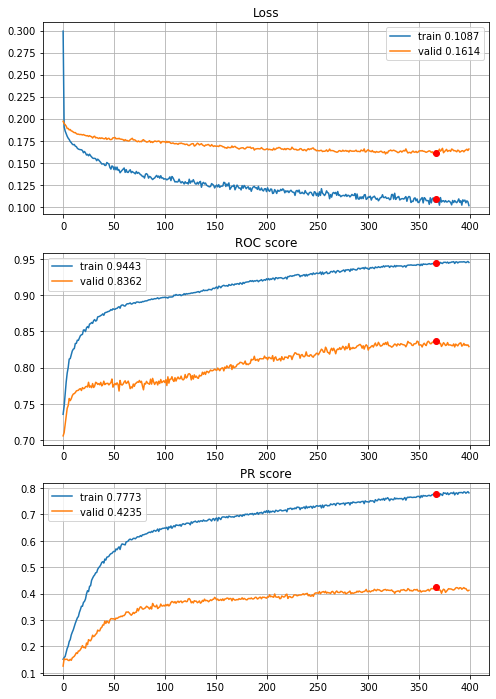


Fold 4------------------------------------------------------------


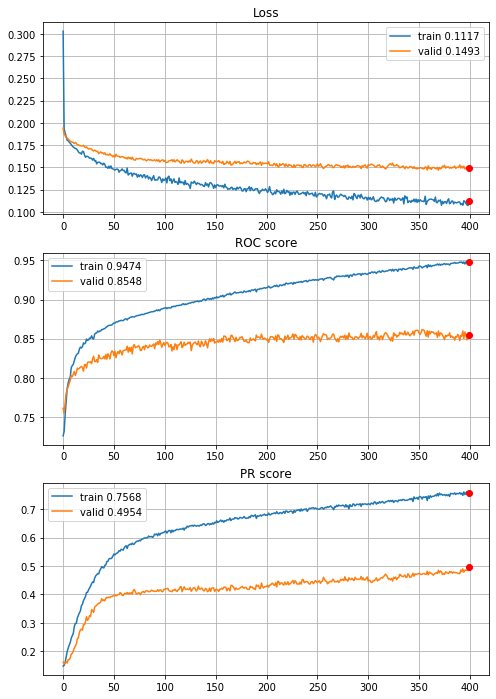


Fold 5------------------------------------------------------------


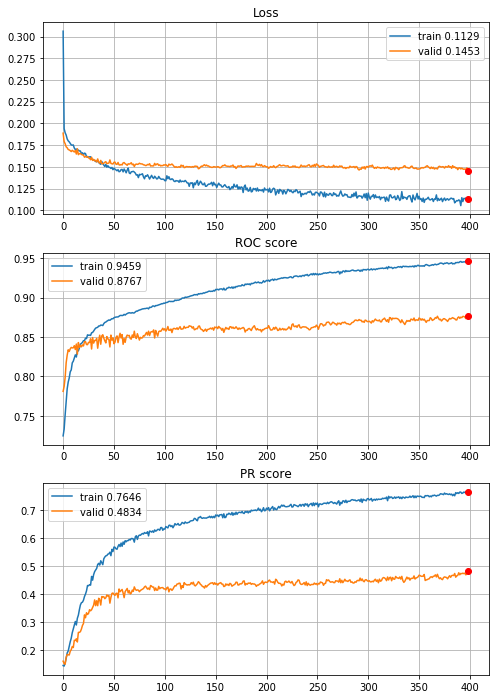


Fold 6------------------------------------------------------------


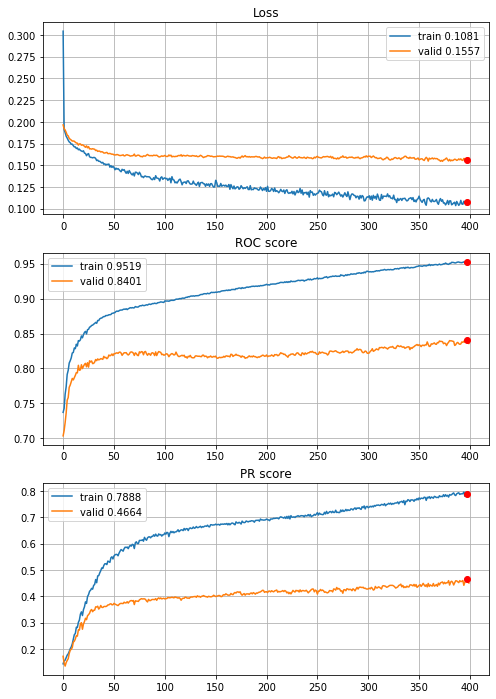

In [54]:
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=3, n_units=[60,60,30],
                                        acti=[activations.tanh, activations.sigmoid, activations.sigmoid],
                                        drop=[0.4,0.4,0], regu=[None,None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Results gets worse, lets apply some dropout on the last layer


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 12.35s train loss: 0.27879348966271095, validation loss: 0.2053511872978905
Epoch: 2/400,
cumulative time: 12.52s train loss: 0.22089117983982412, validation loss: 0.19712112351004327
Epoch: 3/400,
cumulative time: 12.68s train loss: 0.20846721745066596, validation loss: 0.19454958238635767
Epoch: 4/400,
cumulative time: 12.84s train loss: 0.2047226522029071, validation loss: 0.19267377266476476
Epoch: 5/400,
cumulative time: 12.99s train loss: 0.205664853802189, validation loss: 0.19163999113604843
Epoch: 6/400,
cumulative time: 13.16s train loss: 0.2019894239782524, validation loss: 0.19098247980243743
Epoch: 7/400,
cumulative time: 13.31s train loss: 0.19723020180862996, validation loss: 0.19012744942841034
Epoch: 8/400,
cumulative time: 13.46s train loss: 0.19908602953760757, validation loss: 0.18945690770389434
Epoch: 9/400,
cumulative time: 13.62s train loss: 0.1960365335

Epoch: 77/400,
cumulative time: 24.75s train loss: 0.15556967992654666, validation loss: 0.1678044255024077
Epoch: 78/400,
cumulative time: 24.92s train loss: 0.15250090079948492, validation loss: 0.1667842406290092
Epoch: 79/400,
cumulative time: 25.09s train loss: 0.15619540069646445, validation loss: 0.16600732901941925
Epoch: 80/400,
cumulative time: 25.26s train loss: 0.15302752182202167, validation loss: 0.16723791298369634
Epoch: 81/400,
cumulative time: 25.42s train loss: 0.1554073827453064, validation loss: 0.16650024382048842
Epoch: 82/400,
cumulative time: 25.59s train loss: 0.15656304020542677, validation loss: 0.16731606760627157
Epoch: 83/400,
cumulative time: 25.75s train loss: 0.15802935127437268, validation loss: 0.16654906913364234
Epoch: 84/400,
cumulative time: 25.92s train loss: 0.15731256465836863, validation loss: 0.16454007411141067
Epoch: 85/400,
cumulative time: 26.11s train loss: 0.15273119778711367, validation loss: 0.16723113704328232
Epoch: 86/400,
cumulat

Epoch: 153/400,
cumulative time: 37.2s train loss: 0.13970165279553498, validation loss: 0.16377160478563355
Epoch: 154/400,
cumulative time: 37.34s train loss: 0.1412381980353572, validation loss: 0.15991949197221889
Epoch: 155/400,
cumulative time: 37.49s train loss: 0.13682718503366417, validation loss: 0.15921623654881653
Epoch: 156/400,
cumulative time: 37.63s train loss: 0.140279686326765, validation loss: 0.15830426223428984
Epoch: 157/400,
cumulative time: 37.8s train loss: 0.13756338760701184, validation loss: 0.1574677510213657
Epoch: 158/400,
cumulative time: 37.97s train loss: 0.14309544716424552, validation loss: 0.15639670510694556
Epoch: 159/400,
cumulative time: 38.11s train loss: 0.1429718663756438, validation loss: 0.1593496949799293
Epoch: 160/400,
cumulative time: 38.26s train loss: 0.13687763874405462, validation loss: 0.1589439889356504
Epoch: 161/400,
cumulative time: 38.41s train loss: 0.13809098515582965, validation loss: 0.15825619408068323
Epoch: 162/400,
cum

cumulative time: 49.15s train loss: 0.13271544897863136, validation loss: 0.1577129069845071
Epoch: 229/400,
cumulative time: 49.34s train loss: 0.12823780295789752, validation loss: 0.15648196075666998
Epoch: 230/400,
cumulative time: 49.5s train loss: 0.13040621829413596, validation loss: 0.15645863770059049
Epoch: 231/400,
cumulative time: 49.65s train loss: 0.12792188102658725, validation loss: 0.1622142605001704
Epoch: 232/400,
cumulative time: 49.82s train loss: 0.13071901388857, validation loss: 0.15765086822642851
Epoch: 233/400,
cumulative time: 49.98s train loss: 0.13174918592260268, validation loss: 0.155992640219147
Epoch: 234/400,
cumulative time: 50.16s train loss: 0.13491607507421652, validation loss: 0.1553003062310878
Epoch: 235/400,
cumulative time: 50.3s train loss: 0.1340790430844098, validation loss: 0.15964599432508664
Epoch: 236/400,
cumulative time: 50.46s train loss: 0.1330759300411876, validation loss: 0.15753707618353074
Epoch: 237/400,
cumulative time: 50.62

Epoch: 304/400,
cumulative time: 61.64s train loss: 0.12411561992867155, validation loss: 0.15604287604031067
Epoch: 305/400,
cumulative time: 61.81s train loss: 0.12841698875970126, validation loss: 0.15752771564735857
Epoch: 306/400,
cumulative time: 61.98s train loss: 0.12228952194918538, validation loss: 0.15497289536111286
Epoch: 307/400,
cumulative time: 62.15s train loss: 0.11949773886686578, validation loss: 0.1580126126499059
Epoch: 308/400,
cumulative time: 62.32s train loss: 0.12378978681356531, validation loss: 0.15948953801592328
Epoch: 309/400,
cumulative time: 62.49s train loss: 0.12292448430340247, validation loss: 0.15937513329083616
Epoch: 310/400,
cumulative time: 62.66s train loss: 0.12583926389681033, validation loss: 0.15693409109983905
Epoch: 311/400,
cumulative time: 62.82s train loss: 0.12533418184122694, validation loss: 0.16099818874533442
Epoch: 312/400,
cumulative time: 62.99s train loss: 0.12327909395636451, validation loss: 0.15906778553093753
Epoch: 313/

Epoch: 380/400,
cumulative time: 73.96s train loss: 0.12079389166149314, validation loss: 0.1560329122150569
Epoch: 381/400,
cumulative time: 74.12s train loss: 0.11871481259358152, validation loss: 0.1566896722927801
Epoch: 382/400,
cumulative time: 74.29s train loss: 0.12259559770638914, validation loss: 0.1529552566104393
Epoch: 383/400,
cumulative time: 74.45s train loss: 0.11996636583429095, validation loss: 0.15621474030230464
Epoch: 384/400,
cumulative time: 74.62s train loss: 0.12107363662447962, validation loss: 0.15420998774920294
Epoch: 385/400,
cumulative time: 74.78s train loss: 0.115734271828938, validation loss: 0.15513044152436734
Epoch: 386/400,
cumulative time: 74.94s train loss: 0.11736086504053196, validation loss: 0.1542699837193674
Epoch: 387/400,
cumulative time: 75.11s train loss: 0.11717652705519982, validation loss: 0.15653835185293116
Epoch: 388/400,
cumulative time: 75.27s train loss: 0.11973864442805707, validation loss: 0.15547752805394002
Epoch: 389/400,


Epoch: 55/400,
cumulative time: 21.1s train loss: 0.1485906712174107, validation loss: 0.1656783528783193
Epoch: 56/400,
cumulative time: 21.26s train loss: 0.14617487441189816, validation loss: 0.1654107507249788
Epoch: 57/400,
cumulative time: 21.41s train loss: 0.14766025655230336, validation loss: 0.1674369397294854
Epoch: 58/400,
cumulative time: 21.6s train loss: 0.1478844391103176, validation loss: 0.16616517947473194
Epoch: 59/400,
cumulative time: 21.82s train loss: 0.14777230425814786, validation loss: 0.16620114551181286
Epoch: 60/400,
cumulative time: 21.98s train loss: 0.1476340290718567, validation loss: 0.16548541405316192
Epoch: 61/400,
cumulative time: 22.14s train loss: 0.14641088414513642, validation loss: 0.16623347428601318
Epoch: 62/400,
cumulative time: 22.32s train loss: 0.14525829705375587, validation loss: 0.16490749855525158
Epoch: 63/400,
cumulative time: 22.49s train loss: 0.14541003040245926, validation loss: 0.16434107908511178
Epoch: 64/400,
cumulative t

Epoch: 131/400,
cumulative time: 34.09s train loss: 0.13182214030319447, validation loss: 0.1615203116583613
Epoch: 132/400,
cumulative time: 34.27s train loss: 0.12898452879094174, validation loss: 0.1637878487859152
Epoch: 133/400,
cumulative time: 34.44s train loss: 0.13132706903459979, validation loss: 0.16189458775552784
Epoch: 134/400,
cumulative time: 34.61s train loss: 0.12930262664792877, validation loss: 0.16216344594793144
Epoch: 135/400,
cumulative time: 34.79s train loss: 0.1331726197738276, validation loss: 0.16195663265057209
Epoch: 136/400,
cumulative time: 34.97s train loss: 0.1294389912539244, validation loss: 0.162942223367519
Epoch: 137/400,
cumulative time: 35.14s train loss: 0.1308398827693288, validation loss: 0.16202776927254978
Epoch: 138/400,
cumulative time: 35.31s train loss: 0.130583904041316, validation loss: 0.16337967896802316
Epoch: 139/400,
cumulative time: 35.49s train loss: 0.13104528845387423, validation loss: 0.16319432093871541
Epoch: 140/400,
cum

Epoch: 207/400,
cumulative time: 47.03s train loss: 0.12379494512152578, validation loss: 0.16563316029379205
Epoch: 208/400,
cumulative time: 47.2s train loss: 0.1240013002574111, validation loss: 0.16449363646335224
Epoch: 209/400,
cumulative time: 47.38s train loss: 0.127370129878557, validation loss: 0.16645156138198078
Epoch: 210/400,
cumulative time: 47.55s train loss: 0.12052328921788544, validation loss: 0.1659728150999895
Epoch: 211/400,
cumulative time: 47.72s train loss: 0.1202212079626881, validation loss: 0.16566197524434292
Epoch: 212/400,
cumulative time: 47.89s train loss: 0.12155137661893703, validation loss: 0.16604813514435834
Epoch: 213/400,
cumulative time: 48.06s train loss: 0.12084101323034788, validation loss: 0.16645867357739305
Epoch: 214/400,
cumulative time: 48.24s train loss: 0.12194023788052424, validation loss: 0.16616449400102953
Epoch: 215/400,
cumulative time: 48.41s train loss: 0.12750863224109674, validation loss: 0.16502441776253238
Epoch: 216/400,


Epoch: 283/400,
cumulative time: 59.78s train loss: 0.11561645923965425, validation loss: 0.16370310610536817
Epoch: 284/400,
cumulative time: 59.94s train loss: 0.1175021654750579, validation loss: 0.1636779440694962
Epoch: 285/400,
cumulative time: 60.11s train loss: 0.11663654163717234, validation loss: 0.1634986597088586
Epoch: 286/400,
cumulative time: 60.28s train loss: 0.11648547245146679, validation loss: 0.16578224470738734
Epoch: 287/400,
cumulative time: 60.45s train loss: 0.11995919544341599, validation loss: 0.1628086418623499
Epoch: 288/400,
cumulative time: 60.62s train loss: 0.1157229525868743, validation loss: 0.1627588588072379
Epoch: 289/400,
cumulative time: 60.79s train loss: 0.1172340808127567, validation loss: 0.1637709270617522
Epoch: 290/400,
cumulative time: 60.96s train loss: 0.11744494675924355, validation loss: 0.16300087128471077
Epoch: 291/400,
cumulative time: 61.13s train loss: 0.11191036269001751, validation loss: 0.16306816089145174
Epoch: 292/400,
cu

Epoch: 359/400,
cumulative time: 72.73s train loss: 0.11178527758830285, validation loss: 0.16619056601196508
Epoch: 360/400,
cumulative time: 72.9s train loss: 0.1144945024388794, validation loss: 0.16573815707084352
Epoch: 361/400,
cumulative time: 73.07s train loss: 0.11476105971287986, validation loss: 0.16455335368340807
Epoch: 362/400,
cumulative time: 73.24s train loss: 0.1120594365335316, validation loss: 0.16431271454726376
Epoch: 363/400,
cumulative time: 73.41s train loss: 0.10821973909178109, validation loss: 0.16493164265618346
Epoch: 364/400,
cumulative time: 73.59s train loss: 0.1124971875207846, validation loss: 0.1646004374372951
Epoch: 365/400,
cumulative time: 73.77s train loss: 0.10913190669143588, validation loss: 0.1641777932867053
Epoch: 366/400,
cumulative time: 73.94s train loss: 0.11311282503329716, validation loss: 0.16624506084670657
Epoch: 367/400,
cumulative time: 74.11s train loss: 0.11239898899230454, validation loss: 0.16676905515893453
Epoch: 368/400,


Epoch: 33/400,
cumulative time: 18.39s train loss: 0.1590181776634049, validation loss: 0.17454806949063334
Epoch: 34/400,
cumulative time: 18.55s train loss: 0.15815879670992122, validation loss: 0.17418506018274735
Epoch: 35/400,
cumulative time: 18.7s train loss: 0.15882305168787336, validation loss: 0.17432746689809756
Epoch: 36/400,
cumulative time: 18.85s train loss: 0.1550951292554413, validation loss: 0.17409306285817905
Epoch: 37/400,
cumulative time: 19.02s train loss: 0.1601746519924785, validation loss: 0.17335090425608513
Epoch: 38/400,
cumulative time: 19.18s train loss: 0.15377308081885735, validation loss: 0.17266643533218143
Epoch: 39/400,
cumulative time: 19.35s train loss: 0.15711247130982903, validation loss: 0.1727789927494615
Epoch: 40/400,
cumulative time: 19.52s train loss: 0.15631380835508726, validation loss: 0.17348762633566794
Epoch: 41/400,
cumulative time: 19.69s train loss: 0.15464778034868543, validation loss: 0.17277696733778233
Epoch: 42/400,
cumulativ

Epoch: 110/400,
cumulative time: 30.9s train loss: 0.13240256479098006, validation loss: 0.1644889829392495
Epoch: 111/400,
cumulative time: 31.07s train loss: 0.13540968585246496, validation loss: 0.16368546891244923
Epoch: 112/400,
cumulative time: 31.24s train loss: 0.13644154775691392, validation loss: 0.16277637612138013
Epoch: 113/400,
cumulative time: 31.4s train loss: 0.13441475476939233, validation loss: 0.16345911655116033
Epoch: 114/400,
cumulative time: 31.57s train loss: 0.13508434916133535, validation loss: 0.16332405451571072
Epoch: 115/400,
cumulative time: 31.74s train loss: 0.1360726008886994, validation loss: 0.1630179427609791
Epoch: 116/400,
cumulative time: 31.9s train loss: 0.13135708045114472, validation loss: 0.16348044851184945
Epoch: 117/400,
cumulative time: 32.06s train loss: 0.13547423054062993, validation loss: 0.16317942667526805
Epoch: 118/400,
cumulative time: 32.23s train loss: 0.13335677462281315, validation loss: 0.16231715989567294
Epoch: 119/400,


Epoch: 186/400,
cumulative time: 43.44s train loss: 0.12298310238192749, validation loss: 0.1603158161987489
Epoch: 187/400,
cumulative time: 43.61s train loss: 0.12338076507383239, validation loss: 0.16198953114820225
Epoch: 188/400,
cumulative time: 43.78s train loss: 0.12746701540632663, validation loss: 0.1622521241986078
Epoch: 189/400,
cumulative time: 43.94s train loss: 0.12425683244776696, validation loss: 0.16044269226253075
Epoch: 190/400,
cumulative time: 44.12s train loss: 0.1238464609297845, validation loss: 0.1612086391534182
Epoch: 191/400,
cumulative time: 44.28s train loss: 0.12678145287992454, validation loss: 0.1600558912169779
Epoch: 192/400,
cumulative time: 44.45s train loss: 0.12502607732025006, validation loss: 0.1607826130580058
Epoch: 193/400,
cumulative time: 44.62s train loss: 0.1228565079912525, validation loss: 0.15985234425618097
Epoch: 194/400,
cumulative time: 44.78s train loss: 0.12624001594918083, validation loss: 0.16033071555435616
Epoch: 195/400,
c

Epoch: 262/400,
cumulative time: 56.22s train loss: 0.11754146223880445, validation loss: 0.16123117321887903
Epoch: 263/400,
cumulative time: 56.38s train loss: 0.1165458710838059, validation loss: 0.16069990142906013
Epoch: 264/400,
cumulative time: 56.55s train loss: 0.12397677063674088, validation loss: 0.15907892312948357
Epoch: 265/400,
cumulative time: 56.72s train loss: 0.1203371967324343, validation loss: 0.15917208262290006
Epoch: 266/400,
cumulative time: 56.89s train loss: 0.12177260984691632, validation loss: 0.15844267888731337
Epoch: 267/400,
cumulative time: 57.06s train loss: 0.11921085969646539, validation loss: 0.15839799126854878
Epoch: 268/400,
cumulative time: 57.23s train loss: 0.11859005081743695, validation loss: 0.15826588205693934
Epoch: 269/400,
cumulative time: 57.4s train loss: 0.11833254358297828, validation loss: 0.15988937034503062
Epoch: 270/400,
cumulative time: 57.57s train loss: 0.11928608904685406, validation loss: 0.1598635109064123
Epoch: 271/400

Epoch: 338/400,
cumulative time: 69.03s train loss: 0.1148002091523787, validation loss: 0.1598746009612262
Epoch: 339/400,
cumulative time: 69.2s train loss: 0.11101743297040843, validation loss: 0.16023831264229352
Epoch: 340/400,
cumulative time: 69.37s train loss: 0.1141901287350037, validation loss: 0.15989315886129077
Epoch: 341/400,
cumulative time: 69.54s train loss: 0.11561264030825097, validation loss: 0.1618477175883325
Epoch: 342/400,
cumulative time: 69.71s train loss: 0.11817570412197928, validation loss: 0.15945273310128646
Epoch: 343/400,
cumulative time: 69.88s train loss: 0.11053180919832549, validation loss: 0.16014067114535604
Epoch: 344/400,
cumulative time: 70.05s train loss: 0.11436862825239352, validation loss: 0.15995047633505094
Epoch: 345/400,
cumulative time: 70.21s train loss: 0.11112137178617847, validation loss: 0.16153394239666188
Epoch: 346/400,
cumulative time: 70.38s train loss: 0.11547145856046943, validation loss: 0.16008887095586063
Epoch: 347/400,

Epoch: 11/400,
cumulative time: 15.04s train loss: 0.17891642895500423, validation loss: 0.17749626240696204
Epoch: 12/400,
cumulative time: 15.21s train loss: 0.18012793986759668, validation loss: 0.1759865795616555
Epoch: 13/400,
cumulative time: 15.37s train loss: 0.17781433528440127, validation loss: 0.1766486840235124
Epoch: 14/400,
cumulative time: 15.54s train loss: 0.17379537186821653, validation loss: 0.1758517280596304
Epoch: 15/400,
cumulative time: 15.7s train loss: 0.1763882123935325, validation loss: 0.17495813545846386
Epoch: 16/400,
cumulative time: 15.86s train loss: 0.1729803156149772, validation loss: 0.17565680128364355
Epoch: 17/400,
cumulative time: 16.02s train loss: 0.17127717794992772, validation loss: 0.17565920592936796
Epoch: 18/400,
cumulative time: 16.18s train loss: 0.17036840877691406, validation loss: 0.17406720385574176
Epoch: 19/400,
cumulative time: 16.34s train loss: 0.17032758581302285, validation loss: 0.17422458918992154
Epoch: 20/400,
cumulative

Epoch: 87/400,
cumulative time: 27.47s train loss: 0.1407075608404102, validation loss: 0.15761006878621728
Epoch: 88/400,
cumulative time: 27.64s train loss: 0.14734942289978675, validation loss: 0.15557655454736896
Epoch: 89/400,
cumulative time: 27.78s train loss: 0.14231044615539107, validation loss: 0.15591434866615994
Epoch: 90/400,
cumulative time: 27.96s train loss: 0.14407162079933827, validation loss: 0.15417607738259215
Epoch: 91/400,
cumulative time: 28.12s train loss: 0.14349954938849588, validation loss: 0.15400155196999757
Epoch: 92/400,
cumulative time: 28.29s train loss: 0.1410033899834642, validation loss: 0.15355846654037947
Epoch: 93/400,
cumulative time: 28.47s train loss: 0.14314349163508813, validation loss: 0.15536582209245942
Epoch: 94/400,
cumulative time: 28.64s train loss: 0.14027928145066865, validation loss: 0.15404313080484483
Epoch: 95/400,
cumulative time: 28.8s train loss: 0.1452896559711667, validation loss: 0.15329952280362338
Epoch: 96/400,
cumulati

Epoch: 163/400,
cumulative time: 39.96s train loss: 0.13120361260159633, validation loss: 0.15150323861143555
Epoch: 164/400,
cumulative time: 40.12s train loss: 0.1288728993312468, validation loss: 0.15147129783547597
Epoch: 165/400,
cumulative time: 40.29s train loss: 0.1330733503646622, validation loss: 0.15273724490278345
Epoch: 166/400,
cumulative time: 40.45s train loss: 0.13364747888050302, validation loss: 0.15257855379475957
Epoch: 167/400,
cumulative time: 40.62s train loss: 0.1347797686148125, validation loss: 0.15343314007563685
Epoch: 168/400,
cumulative time: 40.78s train loss: 0.12871203112022667, validation loss: 0.1531771956210724
Epoch: 169/400,
cumulative time: 40.94s train loss: 0.12988281262784598, validation loss: 0.15350616794812427
Epoch: 170/400,
cumulative time: 41.1s train loss: 0.12836600309835214, validation loss: 0.15433596961144447
Epoch: 171/400,
cumulative time: 41.27s train loss: 0.13107480206854674, validation loss: 0.15366632084078818
Epoch: 172/400,

Epoch: 239/400,
cumulative time: 52.4s train loss: 0.12289678812408486, validation loss: 0.15142141434714615
Epoch: 240/400,
cumulative time: 52.57s train loss: 0.12654314321952442, validation loss: 0.15182872160183808
Epoch: 241/400,
cumulative time: 52.73s train loss: 0.1252090952368145, validation loss: 0.15114317690336113
Epoch: 242/400,
cumulative time: 52.89s train loss: 0.12746588985625784, validation loss: 0.15120684654230646
Epoch: 243/400,
cumulative time: 53.05s train loss: 0.122417112867952, validation loss: 0.15234462193602036
Epoch: 244/400,
cumulative time: 53.22s train loss: 0.12239882612356645, validation loss: 0.15319899418388117
Epoch: 245/400,
cumulative time: 53.38s train loss: 0.12682099308172753, validation loss: 0.1522209387478007
Epoch: 246/400,
cumulative time: 53.55s train loss: 0.12257995224812368, validation loss: 0.1524034232164906
Epoch: 247/400,
cumulative time: 53.71s train loss: 0.12897994166135335, validation loss: 0.1510564533827498
Epoch: 248/400,
c

Epoch: 315/400,
cumulative time: 64.95s train loss: 0.11759552563931659, validation loss: 0.1505074348475675
Epoch: 316/400,
cumulative time: 65.12s train loss: 0.11988407985668618, validation loss: 0.1491557453423637
Epoch: 317/400,
cumulative time: 65.28s train loss: 0.12266195719283168, validation loss: 0.14876089765962247
Epoch: 318/400,
cumulative time: 65.45s train loss: 0.11597841075541261, validation loss: 0.14931626732532793
Epoch: 319/400,
cumulative time: 65.61s train loss: 0.12400588684974194, validation loss: 0.14847772713012644
Epoch: 320/400,
cumulative time: 65.77s train loss: 0.1180597437320151, validation loss: 0.14979063922893116
Epoch: 321/400,
cumulative time: 65.93s train loss: 0.11710935886064018, validation loss: 0.147493896474637
Epoch: 322/400,
cumulative time: 66.09s train loss: 0.11979031947966608, validation loss: 0.1485447519749829
Epoch: 323/400,
cumulative time: 66.25s train loss: 0.11652393732334082, validation loss: 0.15155154976859395
Epoch: 324/400,


Epoch: 391/400,
cumulative time: 77.12s train loss: 0.11392188454322069, validation loss: 0.1487894141203372
Epoch: 392/400,
cumulative time: 77.28s train loss: 0.11134351302918956, validation loss: 0.14655732990853068
Epoch: 393/400,
cumulative time: 77.45s train loss: 0.11268086487917683, validation loss: 0.1483249350966362
Epoch: 394/400,
cumulative time: 77.62s train loss: 0.11178791196668049, validation loss: 0.1477392977338165
Epoch: 395/400,
cumulative time: 77.78s train loss: 0.1117410733534857, validation loss: 0.15003250871003282
Epoch: 396/400,
cumulative time: 77.95s train loss: 0.11487575411191837, validation loss: 0.14893010187668407
Epoch: 397/400,
cumulative time: 78.12s train loss: 0.11429208157989677, validation loss: 0.14601330144661798
Epoch: 398/400,
cumulative time: 78.28s train loss: 0.11443839858480262, validation loss: 0.1462133375964577
Epoch: 399/400,
cumulative time: 78.43s train loss: 0.11296336724085881, validation loss: 0.14921701503213852
Epoch: 400/400,

Epoch: 66/400,
cumulative time: 24.37s train loss: 0.1470486912734336, validation loss: 0.14749663400308963
Epoch: 67/400,
cumulative time: 24.54s train loss: 0.1468718065728062, validation loss: 0.14793823028049288
Epoch: 68/400,
cumulative time: 24.71s train loss: 0.14957566235685205, validation loss: 0.15029594700083096
Epoch: 69/400,
cumulative time: 24.87s train loss: 0.15060003489775337, validation loss: 0.1477563614660128
Epoch: 70/400,
cumulative time: 25.04s train loss: 0.1470583598829465, validation loss: 0.1481767866445822
Epoch: 71/400,
cumulative time: 25.21s train loss: 0.14828415131419573, validation loss: 0.14745102335549182
Epoch: 72/400,
cumulative time: 25.38s train loss: 0.14619482691706137, validation loss: 0.1472008000318296
Epoch: 73/400,
cumulative time: 25.54s train loss: 0.14542634122901493, validation loss: 0.1468746479428107
Epoch: 74/400,
cumulative time: 25.71s train loss: 0.1435715671819442, validation loss: 0.14725539268930862
Epoch: 75/400,
cumulative t

cumulative time: 36.91s train loss: 0.13514611655785366, validation loss: 0.1413971342105794
Epoch: 143/400,
cumulative time: 37.14s train loss: 0.13352596593618976, validation loss: 0.14327400994844916
Epoch: 144/400,
cumulative time: 37.3s train loss: 0.13365609566062234, validation loss: 0.14215032901482946
Epoch: 145/400,
cumulative time: 37.45s train loss: 0.13362411202250093, validation loss: 0.14327245687796894
Epoch: 146/400,
cumulative time: 37.64s train loss: 0.13024327374613298, validation loss: 0.14311868128968194
Epoch: 147/400,
cumulative time: 37.79s train loss: 0.1334423968377716, validation loss: 0.14287302807501293
Epoch: 148/400,
cumulative time: 37.96s train loss: 0.1321606178928272, validation loss: 0.14246954097937822
Epoch: 149/400,
cumulative time: 38.13s train loss: 0.1306446793008279, validation loss: 0.14342152114135368
Epoch: 150/400,
cumulative time: 38.3s train loss: 0.13488149998632457, validation loss: 0.14151928833703578
Epoch: 151/400,
cumulative time:

Epoch: 218/400,
cumulative time: 49.77s train loss: 0.12277253547557558, validation loss: 0.1406583366890207
Epoch: 219/400,
cumulative time: 49.92s train loss: 0.13218665012403966, validation loss: 0.13999546748618988
Epoch: 220/400,
cumulative time: 50.08s train loss: 0.12541999772783524, validation loss: 0.14217131169720956
Epoch: 221/400,
cumulative time: 50.25s train loss: 0.12705432735626992, validation loss: 0.14203507598357565
Epoch: 222/400,
cumulative time: 50.41s train loss: 0.13021966832850235, validation loss: 0.14030417584755764
Epoch: 223/400,
cumulative time: 50.56s train loss: 0.12726456763259336, validation loss: 0.14181454547703753
Epoch: 224/400,
cumulative time: 50.77s train loss: 0.1244987523698599, validation loss: 0.1394128755993674
Epoch: 225/400,
cumulative time: 50.98s train loss: 0.12391932988397307, validation loss: 0.1413922733157792
Epoch: 226/400,
cumulative time: 51.14s train loss: 0.12437962602888901, validation loss: 0.1405278169207417
Epoch: 227/400,

Epoch: 293/400,
cumulative time: 62.27s train loss: 0.11900413334816044, validation loss: 0.13937322905018154
Epoch: 294/400,
cumulative time: 62.43s train loss: 0.12266645024374355, validation loss: 0.13777043319203222
Epoch: 295/400,
cumulative time: 62.6s train loss: 0.120251550953957, validation loss: 0.13624725013727712
Epoch: 296/400,
cumulative time: 62.77s train loss: 0.11770501157901937, validation loss: 0.13696428451291223
Epoch: 297/400,
cumulative time: 62.94s train loss: 0.1231114321930054, validation loss: 0.136830188486248
Epoch: 298/400,
cumulative time: 63.11s train loss: 0.11710417595913143, validation loss: 0.1353308197912793
Epoch: 299/400,
cumulative time: 63.27s train loss: 0.12142023430987056, validation loss: 0.13655275374407339
Epoch: 300/400,
cumulative time: 63.44s train loss: 0.1211393269809665, validation loss: 0.1367737152474128
Epoch: 301/400,
cumulative time: 63.61s train loss: 0.12073675607592842, validation loss: 0.13641258166742584
Epoch: 302/400,
cum

Epoch: 369/400,
cumulative time: 74.99s train loss: 0.11268535125107872, validation loss: 0.13798285140694
Epoch: 370/400,
cumulative time: 75.16s train loss: 0.12027897451819612, validation loss: 0.13665553147851284
Epoch: 371/400,
cumulative time: 75.32s train loss: 0.11867710485778472, validation loss: 0.13508070407470826
Epoch: 372/400,
cumulative time: 75.49s train loss: 0.11471168968161012, validation loss: 0.13748046905005334
Epoch: 373/400,
cumulative time: 75.65s train loss: 0.11838646022266097, validation loss: 0.13866636234180804
Epoch: 374/400,
cumulative time: 75.82s train loss: 0.11121226987377426, validation loss: 0.13881136707413425
Epoch: 375/400,
cumulative time: 75.99s train loss: 0.11225010413871286, validation loss: 0.13774440191909468
Epoch: 376/400,
cumulative time: 76.16s train loss: 0.11766049531663815, validation loss: 0.13591738914111653
Epoch: 377/400,
cumulative time: 76.32s train loss: 0.11740925625648374, validation loss: 0.13765183400758604
Epoch: 378/40

Epoch: 43/400,
cumulative time: 22.46s train loss: 0.15691938475870035, validation loss: 0.16081029621310713
Epoch: 44/400,
cumulative time: 22.63s train loss: 0.1531513093814481, validation loss: 0.16080924442256178
Epoch: 45/400,
cumulative time: 22.79s train loss: 0.15814126769084816, validation loss: 0.15964353866164627
Epoch: 46/400,
cumulative time: 22.96s train loss: 0.15238978149276025, validation loss: 0.16059531046113137
Epoch: 47/400,
cumulative time: 23.13s train loss: 0.15356639208178766, validation loss: 0.15849090820274822
Epoch: 48/400,
cumulative time: 23.29s train loss: 0.14871427579935081, validation loss: 0.1596089348968433
Epoch: 49/400,
cumulative time: 23.46s train loss: 0.15108266319016356, validation loss: 0.159797241398684
Epoch: 50/400,
cumulative time: 23.62s train loss: 0.14900995147554508, validation loss: 0.15879479204926245
Epoch: 51/400,
cumulative time: 23.78s train loss: 0.15010329812140183, validation loss: 0.15803050842613225
Epoch: 52/400,
cumulati

Epoch: 119/400,
cumulative time: 34.53s train loss: 0.13209638109507774, validation loss: 0.15630409241291093
Epoch: 120/400,
cumulative time: 34.69s train loss: 0.13184725198984015, validation loss: 0.1562433995570409
Epoch: 121/400,
cumulative time: 34.84s train loss: 0.13382008648020963, validation loss: 0.15609061734228108
Epoch: 122/400,
cumulative time: 34.99s train loss: 0.13557532003396933, validation loss: 0.1562683239010764
Epoch: 123/400,
cumulative time: 35.15s train loss: 0.1324581263611227, validation loss: 0.15531792564759136
Epoch: 124/400,
cumulative time: 35.3s train loss: 0.1376813895338923, validation loss: 0.15523484083303637
Epoch: 125/400,
cumulative time: 35.45s train loss: 0.13511837983589156, validation loss: 0.15513962458524783
Epoch: 126/400,
cumulative time: 35.6s train loss: 0.13265357177485437, validation loss: 0.1553981163277613
Epoch: 127/400,
cumulative time: 35.77s train loss: 0.13237097883933835, validation loss: 0.1553867073775312
Epoch: 128/400,
cu

Epoch: 194/400,
cumulative time: 46.68s train loss: 0.12296340598122162, validation loss: 0.1549511723910593
Epoch: 195/400,
cumulative time: 46.85s train loss: 0.12213297446576923, validation loss: 0.1545725756043147
Epoch: 196/400,
cumulative time: 47.02s train loss: 0.12588067664835836, validation loss: 0.1545720950621675
Epoch: 197/400,
cumulative time: 47.19s train loss: 0.12699122752280081, validation loss: 0.15492374756518112
Epoch: 198/400,
cumulative time: 47.36s train loss: 0.1289874117086948, validation loss: 0.1547353608021132
Epoch: 199/400,
cumulative time: 47.53s train loss: 0.1273853367961505, validation loss: 0.1549681230202033
Epoch: 200/400,
cumulative time: 47.7s train loss: 0.12971009861085409, validation loss: 0.15341574706807123
Epoch: 201/400,
cumulative time: 47.87s train loss: 0.12362510109754495, validation loss: 0.15344523648637517
Epoch: 202/400,
cumulative time: 48.03s train loss: 0.12332106644616407, validation loss: 0.15338120178119038
Epoch: 203/400,
cu

Epoch: 269/400,
cumulative time: 59.39s train loss: 0.12197213550554771, validation loss: 0.15349640473926424
Epoch: 270/400,
cumulative time: 59.55s train loss: 0.12253173040165231, validation loss: 0.15345879023950496
Epoch: 271/400,
cumulative time: 59.72s train loss: 0.12051873094116161, validation loss: 0.1546314419412158
Epoch: 272/400,
cumulative time: 59.89s train loss: 0.12251783096412104, validation loss: 0.15352090867363138
Epoch: 273/400,
cumulative time: 60.06s train loss: 0.11979639509485827, validation loss: 0.15418709598339547
Epoch: 274/400,
cumulative time: 60.23s train loss: 0.12035594792521208, validation loss: 0.1533483445786488
Epoch: 275/400,
cumulative time: 60.4s train loss: 0.1192020413309563, validation loss: 0.15285150053065868
Epoch: 276/400,
cumulative time: 60.57s train loss: 0.12245414119157007, validation loss: 0.15281376001052052
Epoch: 277/400,
cumulative time: 60.73s train loss: 0.12066189996078448, validation loss: 0.15336308645576807
Epoch: 278/400

Epoch: 345/400,
cumulative time: 72.21s train loss: 0.11391594923204845, validation loss: 0.15290511937492224
Epoch: 346/400,
cumulative time: 72.37s train loss: 0.11940633761239987, validation loss: 0.15208479914337153
Epoch: 347/400,
cumulative time: 72.53s train loss: 0.11500490065014765, validation loss: 0.15340606810408328
Epoch: 348/400,
cumulative time: 72.7s train loss: 0.11451091329021326, validation loss: 0.15355692609982205
Epoch: 349/400,
cumulative time: 72.87s train loss: 0.11507288584473475, validation loss: 0.15380128820195835
Epoch: 350/400,
cumulative time: 73.02s train loss: 0.11901159653306202, validation loss: 0.15343598381943535
Epoch: 351/400,
cumulative time: 73.2s train loss: 0.11713861394064878, validation loss: 0.15258361041870688
Epoch: 352/400,
cumulative time: 73.37s train loss: 0.11730158102976601, validation loss: 0.15222528588016612
Epoch: 353/400,
cumulative time: 73.55s train loss: 0.1149479491141075, validation loss: 0.15101827439479024
Epoch: 354/40

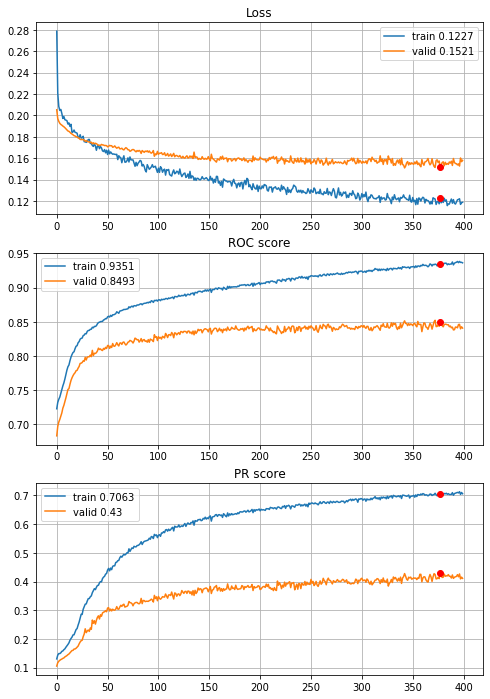


Fold 2------------------------------------------------------------


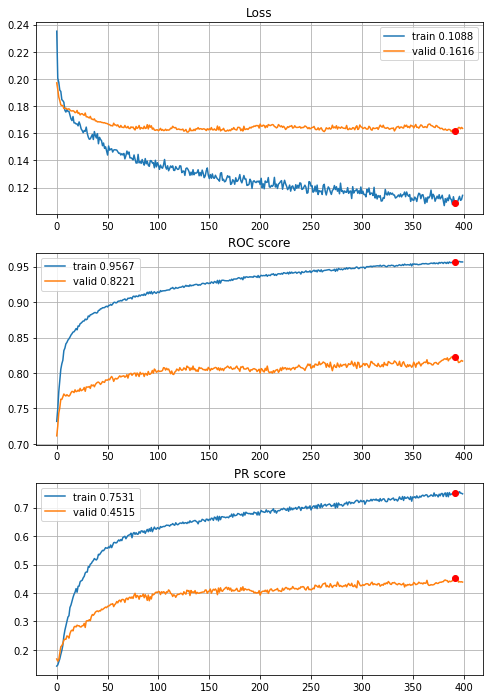


Fold 3------------------------------------------------------------


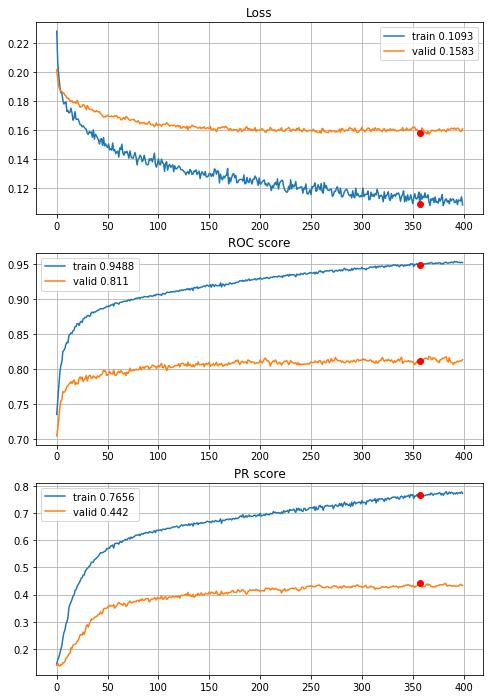


Fold 4------------------------------------------------------------


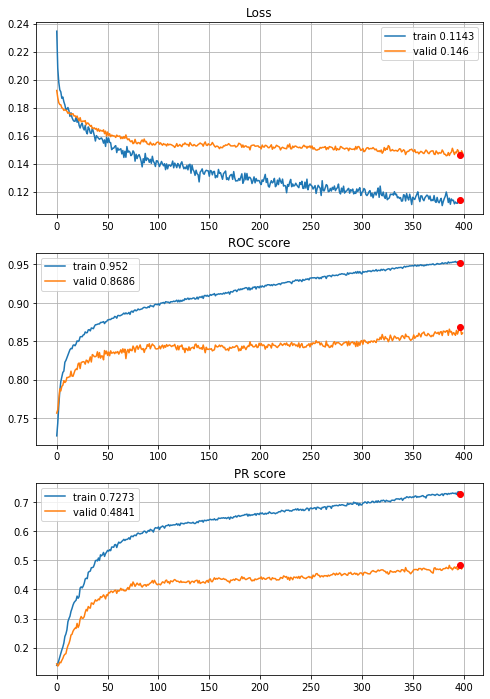


Fold 5------------------------------------------------------------


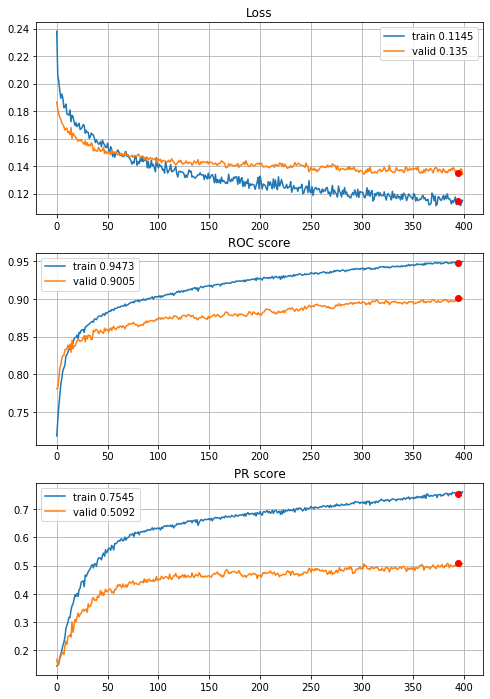


Fold 6------------------------------------------------------------


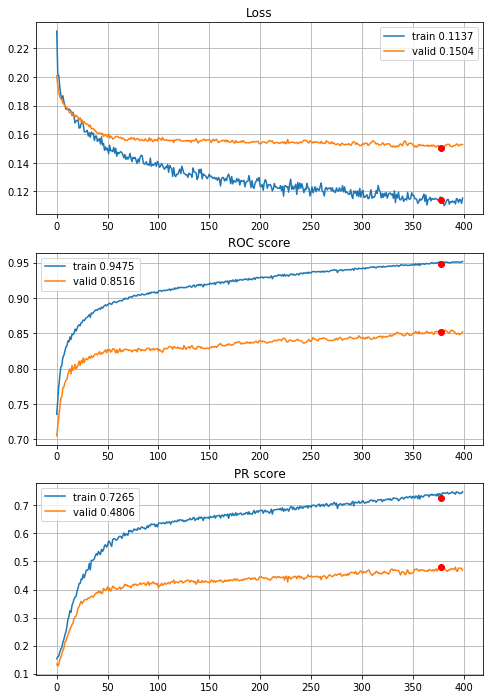

In [55]:
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=3, n_units=[60,60,30],
                                        acti=[activations.tanh, activations.sigmoid, activations.sigmoid],
                                        drop=[0.4,0.4,0.4], regu=[None,None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Dropout doesn't help, thus two layers should be enough, lets try more epochs (early stopping was not used in fact)


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/800,
cumulative time: 10.5s train loss: 0.4767213335287891, validation loss: 0.34895462327217713
Epoch: 2/800,
cumulative time: 10.66s train loss: 0.3320939555879868, validation loss: 0.2579665230073598
Epoch: 3/800,
cumulative time: 10.81s train loss: 0.2639587903508175, validation loss: 0.21928891373216253
Epoch: 4/800,
cumulative time: 10.96s train loss: 0.22540800650462653, validation loss: 0.20105862423747148
Epoch: 5/800,
cumulative time: 11.11s train loss: 0.2117011519469829, validation loss: 0.19267619354048093
Epoch: 6/800,
cumulative time: 11.25s train loss: 0.20295465103931848, validation loss: 0.18852168134964592
Epoch: 7/800,
cumulative time: 11.39s train loss: 0.19431704581676737, validation loss: 0.18674567552794397
Epoch: 8/800,
cumulative time: 11.53s train loss: 0.19289682806349898, validation loss: 0.18482327519062022
Epoch: 9/800,
cumulative time: 11.67s train loss: 0.18978933059

Epoch: 77/800,
cumulative time: 21.22s train loss: 0.15757831906965508, validation loss: 0.1646933152997794
Epoch: 78/800,
cumulative time: 21.36s train loss: 0.1599967161125762, validation loss: 0.1641205970002649
Epoch: 79/800,
cumulative time: 21.51s train loss: 0.15368738974531193, validation loss: 0.1627501176379829
Epoch: 80/800,
cumulative time: 21.65s train loss: 0.15600466342034366, validation loss: 0.16430783254545184
Epoch: 81/800,
cumulative time: 21.79s train loss: 0.15533525367556225, validation loss: 0.1644690959753026
Epoch: 82/800,
cumulative time: 21.94s train loss: 0.15428317497426933, validation loss: 0.16396874088953756
Epoch: 83/800,
cumulative time: 22.08s train loss: 0.15438810279449552, validation loss: 0.16378289468236484
Epoch: 84/800,
cumulative time: 22.23s train loss: 0.15481036532141118, validation loss: 0.16330654655410126
Epoch: 85/800,
cumulative time: 22.37s train loss: 0.15453143892285937, validation loss: 0.16464347438474672
Epoch: 86/800,
cumulativ

Epoch: 153/800,
cumulative time: 32.18s train loss: 0.13837054784593733, validation loss: 0.1608533118252368
Epoch: 154/800,
cumulative time: 32.33s train loss: 0.1401335360604347, validation loss: 0.1605727407520851
Epoch: 155/800,
cumulative time: 32.47s train loss: 0.14006682796129558, validation loss: 0.1590913168989614
Epoch: 156/800,
cumulative time: 32.62s train loss: 0.14362656192081136, validation loss: 0.15849839064683777
Epoch: 157/800,
cumulative time: 32.76s train loss: 0.13897575497887008, validation loss: 0.157498156632835
Epoch: 158/800,
cumulative time: 32.91s train loss: 0.1436458330550214, validation loss: 0.1582968533241968
Epoch: 159/800,
cumulative time: 33.07s train loss: 0.1412910332386555, validation loss: 0.15914179355291544
Epoch: 160/800,
cumulative time: 33.21s train loss: 0.14141821699125898, validation loss: 0.1583460211611833
Epoch: 161/800,
cumulative time: 33.36s train loss: 0.14014899412082032, validation loss: 0.15756492152394203
Epoch: 162/800,
cumu

Epoch: 229/800,
cumulative time: 43.25s train loss: 0.13324046614472684, validation loss: 0.15454257759940795
Epoch: 230/800,
cumulative time: 43.39s train loss: 0.12918379381715026, validation loss: 0.15563791911158942
Epoch: 231/800,
cumulative time: 43.54s train loss: 0.1273059815687882, validation loss: 0.1560086933445817
Epoch: 232/800,
cumulative time: 43.68s train loss: 0.13214485253720165, validation loss: 0.1552165369747284
Epoch: 233/800,
cumulative time: 43.83s train loss: 0.12903380648253415, validation loss: 0.15520378664247514
Epoch: 234/800,
cumulative time: 43.97s train loss: 0.13014912066303155, validation loss: 0.15680762032938295
Epoch: 235/800,
cumulative time: 44.12s train loss: 0.12835780002129074, validation loss: 0.15603350258100754
Epoch: 236/800,
cumulative time: 44.26s train loss: 0.13370809754087606, validation loss: 0.15608860358565416
Epoch: 237/800,
cumulative time: 44.41s train loss: 0.13328260364550978, validation loss: 0.15529948574414132
Epoch: 238/80

Epoch: 305/800,
cumulative time: 54.48s train loss: 0.12576679040893585, validation loss: 0.1527542825293752
Epoch: 306/800,
cumulative time: 54.63s train loss: 0.12049895687221296, validation loss: 0.15471590520817866
Epoch: 307/800,
cumulative time: 54.78s train loss: 0.1200642541495328, validation loss: 0.1507811500273082
Epoch: 308/800,
cumulative time: 54.94s train loss: 0.12221660152185228, validation loss: 0.1542759316461763
Epoch: 309/800,
cumulative time: 55.1s train loss: 0.1205518773427033, validation loss: 0.15321249916003302
Epoch: 310/800,
cumulative time: 55.25s train loss: 0.12240923129211861, validation loss: 0.15297212678409094
Epoch: 311/800,
cumulative time: 55.41s train loss: 0.12055720644175447, validation loss: 0.15181049127372614
Epoch: 312/800,
cumulative time: 55.56s train loss: 0.12326076117625893, validation loss: 0.1544800922933933
Epoch: 313/800,
cumulative time: 55.7s train loss: 0.12039218854347335, validation loss: 0.15170324857012604
Epoch: 314/800,
cu

Epoch: 380/800,
cumulative time: 65.66s train loss: 0.11856366503320662, validation loss: 0.15096893659085947
Epoch: 381/800,
cumulative time: 65.81s train loss: 0.11420895218500142, validation loss: 0.14973677217027134
Epoch: 382/800,
cumulative time: 65.95s train loss: 0.11666612674616735, validation loss: 0.1504752230611766
Epoch: 383/800,
cumulative time: 66.1s train loss: 0.11347951386420681, validation loss: 0.1496958534396206
Epoch: 384/800,
cumulative time: 66.25s train loss: 0.11532144917343352, validation loss: 0.14887084512178228
Epoch: 385/800,
cumulative time: 66.4s train loss: 0.10979220319407912, validation loss: 0.1493171780003099
Epoch: 386/800,
cumulative time: 66.54s train loss: 0.11665819538243538, validation loss: 0.1504349171953026
Epoch: 387/800,
cumulative time: 66.67s train loss: 0.11750905003881124, validation loss: 0.14958034472006207
Epoch: 388/800,
cumulative time: 66.81s train loss: 0.11439672253704292, validation loss: 0.14829059378316892
Epoch: 389/800,


Epoch: 456/800,
cumulative time: 76.57s train loss: 0.11291898233732572, validation loss: 0.14798798426793008
Epoch: 457/800,
cumulative time: 76.71s train loss: 0.10896120098157328, validation loss: 0.14653491966776333
Epoch: 458/800,
cumulative time: 76.86s train loss: 0.11001020221461494, validation loss: 0.14879382938816077
Epoch: 459/800,
cumulative time: 77.01s train loss: 0.10983594793820761, validation loss: 0.1484393594701571
Epoch: 460/800,
cumulative time: 77.16s train loss: 0.1099256467514007, validation loss: 0.14693316239090173
Epoch: 461/800,
cumulative time: 77.3s train loss: 0.11340784311627361, validation loss: 0.1473317967538853
Epoch: 462/800,
cumulative time: 77.45s train loss: 0.11213824742357104, validation loss: 0.14706819367051693
Epoch: 463/800,
cumulative time: 77.59s train loss: 0.11173674783942227, validation loss: 0.14682230698242732
Epoch: 464/800,
cumulative time: 77.74s train loss: 0.10934432228766133, validation loss: 0.1450010388988147
Epoch: 465/800,

Epoch: 532/800,
cumulative time: 87.7s train loss: 0.10651548656905264, validation loss: 0.14532020011469163
Epoch: 533/800,
cumulative time: 87.84s train loss: 0.10412358941494339, validation loss: 0.14745071901603163
Epoch: 534/800,
cumulative time: 87.99s train loss: 0.10750352810136339, validation loss: 0.14700921403258085
Epoch: 535/800,
cumulative time: 88.14s train loss: 0.10588677571971036, validation loss: 0.1479597323966562
Epoch: 536/800,
cumulative time: 88.28s train loss: 0.10831125248205786, validation loss: 0.1459623225758561
Epoch: 537/800,
cumulative time: 88.43s train loss: 0.10845819138468375, validation loss: 0.14617057093923153
Epoch: 538/800,
cumulative time: 88.58s train loss: 0.10560162807012569, validation loss: 0.14633203471818695
Epoch: 539/800,
cumulative time: 88.72s train loss: 0.10299010294571115, validation loss: 0.14705993967489614
Epoch: 540/800,
cumulative time: 88.87s train loss: 0.10660338186992865, validation loss: 0.14591735718078236
Epoch: 541/80

Epoch: 608/800,
cumulative time: 98.89s train loss: 0.10097500292758567, validation loss: 0.14417421693011478
Epoch: 609/800,
cumulative time: 99.04s train loss: 0.10471540489785112, validation loss: 0.14514272378528092
Epoch: 610/800,
cumulative time: 99.19s train loss: 0.10234772692592141, validation loss: 0.1479743311322409
Epoch: 611/800,
cumulative time: 99.33s train loss: 0.10249310474978243, validation loss: 0.1469111216461845
Epoch: 612/800,
cumulative time: 99.48s train loss: 0.10034681877736969, validation loss: 0.14500484836190797
Epoch: 613/800,
cumulative time: 99.63s train loss: 0.10532594551109706, validation loss: 0.14473680883057674
Epoch: 614/800,
cumulative time: 99.77s train loss: 0.106025404928816, validation loss: 0.14503797611831565
Epoch: 615/800,
cumulative time: 99.92s train loss: 0.10095926128600788, validation loss: 0.14379329603086774
Epoch: 616/800,
cumulative time: 100.07s train loss: 0.10313872082038941, validation loss: 0.14631288683763405
Epoch: 617/80

Epoch: 684/800,
cumulative time: 110.05s train loss: 0.10157541320058673, validation loss: 0.14512170624010737
Epoch: 685/800,
cumulative time: 110.2s train loss: 0.10263149048227486, validation loss: 0.14414868780226023
Epoch: 686/800,
cumulative time: 110.34s train loss: 0.10196785701140224, validation loss: 0.14557534228018792
Epoch: 687/800,
cumulative time: 110.49s train loss: 0.09786434178576066, validation loss: 0.14568793756406756
Epoch: 688/800,
cumulative time: 110.64s train loss: 0.09834987861952177, validation loss: 0.14433290257066023
Epoch: 689/800,
cumulative time: 110.78s train loss: 0.09694726056117835, validation loss: 0.14520459174298364
Epoch: 690/800,
cumulative time: 110.93s train loss: 0.098716683274846, validation loss: 0.14686536114381396
Epoch: 691/800,
cumulative time: 111.08s train loss: 0.09768776785129263, validation loss: 0.14645886143265005
Epoch: 692/800,
cumulative time: 111.23s train loss: 0.09618910660694036, validation loss: 0.148586463246563
Epoch:

Epoch: 760/800,
cumulative time: 121.34s train loss: 0.10299596581296051, validation loss: 0.145421911140053
Epoch: 761/800,
cumulative time: 121.49s train loss: 0.09618475590417158, validation loss: 0.14706977594255832
Epoch: 762/800,
cumulative time: 121.64s train loss: 0.1003448370548355, validation loss: 0.14641393504027528
Epoch: 763/800,
cumulative time: 121.79s train loss: 0.09749900239167057, validation loss: 0.14536298692753885
Epoch: 764/800,
cumulative time: 121.94s train loss: 0.09816937799266552, validation loss: 0.14647787754595726
Epoch: 765/800,
cumulative time: 122.08s train loss: 0.09836078054992928, validation loss: 0.14619663896367532
Epoch: 766/800,
cumulative time: 122.23s train loss: 0.09900094115789297, validation loss: 0.14437548397267408
Epoch: 767/800,
cumulative time: 122.38s train loss: 0.09595714257042041, validation loss: 0.1455979089882197
Epoch: 768/800,
cumulative time: 122.53s train loss: 0.10035947845528598, validation loss: 0.1455936236617677
Epoch:

Epoch: 33/800,
cumulative time: 13.88s train loss: 0.1566204619264791, validation loss: 0.17637087659335932
Epoch: 34/800,
cumulative time: 14.02s train loss: 0.15649748813037764, validation loss: 0.17722223941528367
Epoch: 35/800,
cumulative time: 14.16s train loss: 0.15390760492851538, validation loss: 0.1766481105164657
Epoch: 36/800,
cumulative time: 14.31s train loss: 0.1523690109484757, validation loss: 0.17595107254931683
Epoch: 37/800,
cumulative time: 14.45s train loss: 0.152321575682072, validation loss: 0.17642668865423286
Epoch: 38/800,
cumulative time: 14.59s train loss: 0.15666960393694138, validation loss: 0.17593324820430528
Epoch: 39/800,
cumulative time: 14.73s train loss: 0.15648408826269605, validation loss: 0.17698256382331953
Epoch: 40/800,
cumulative time: 14.87s train loss: 0.1555366598929077, validation loss: 0.17713160840242878
Epoch: 41/800,
cumulative time: 15.01s train loss: 0.15256224139808522, validation loss: 0.1767834065883966
Epoch: 42/800,
cumulative 

Epoch: 109/800,
cumulative time: 24.51s train loss: 0.1383132622341978, validation loss: 0.17257765449781334
Epoch: 110/800,
cumulative time: 24.65s train loss: 0.1357249010673388, validation loss: 0.1729714839514459
Epoch: 111/800,
cumulative time: 24.8s train loss: 0.1354431887786979, validation loss: 0.17229768908737955
Epoch: 112/800,
cumulative time: 24.94s train loss: 0.13931289130557253, validation loss: 0.17285876665353125
Epoch: 113/800,
cumulative time: 25.08s train loss: 0.13644145743676106, validation loss: 0.17237723481298062
Epoch: 114/800,
cumulative time: 25.22s train loss: 0.13776645078559055, validation loss: 0.1728115782719879
Epoch: 115/800,
cumulative time: 25.36s train loss: 0.1352488608402013, validation loss: 0.17290862146549438
Epoch: 116/800,
cumulative time: 25.5s train loss: 0.1393136950307397, validation loss: 0.1739024391145508
Epoch: 117/800,
cumulative time: 25.64s train loss: 0.1346409268455026, validation loss: 0.1741743683713565
Epoch: 118/800,
cumula

Epoch: 185/800,
cumulative time: 35.53s train loss: 0.12756260421447202, validation loss: 0.17168647427190478
Epoch: 186/800,
cumulative time: 35.67s train loss: 0.12472352037292792, validation loss: 0.1713958570671536
Epoch: 187/800,
cumulative time: 35.82s train loss: 0.12606217345874998, validation loss: 0.1704442368134339
Epoch: 188/800,
cumulative time: 35.96s train loss: 0.12798259804111792, validation loss: 0.171521368807396
Epoch: 189/800,
cumulative time: 36.11s train loss: 0.12471119598432895, validation loss: 0.1702640142020439
Epoch: 190/800,
cumulative time: 36.26s train loss: 0.12523822523942682, validation loss: 0.1710354379746604
Epoch: 191/800,
cumulative time: 36.4s train loss: 0.12540115516906244, validation loss: 0.1699260716599782
Epoch: 192/800,
cumulative time: 36.55s train loss: 0.12393072537086518, validation loss: 0.17107494462502093
Epoch: 193/800,
cumulative time: 36.69s train loss: 0.12441317722897398, validation loss: 0.17194408099208258
Epoch: 194/800,
cu

Epoch: 261/800,
cumulative time: 45.67s train loss: 0.12080649978398919, validation loss: 0.17002822812760746
Epoch: 262/800,
cumulative time: 45.8s train loss: 0.11377507889163635, validation loss: 0.16956055161294034
Epoch: 263/800,
cumulative time: 45.92s train loss: 0.12037851388096793, validation loss: 0.17002188998614953
Epoch: 264/800,
cumulative time: 46.05s train loss: 0.11508253948712534, validation loss: 0.16833582498168687
Epoch: 265/800,
cumulative time: 46.19s train loss: 0.11574592007557216, validation loss: 0.1689975363683587
Epoch: 266/800,
cumulative time: 46.33s train loss: 0.11602510815965988, validation loss: 0.16945265251268246
Epoch: 267/800,
cumulative time: 46.47s train loss: 0.11611667363196064, validation loss: 0.16941247243431654
Epoch: 268/800,
cumulative time: 46.61s train loss: 0.11718691815358975, validation loss: 0.16953014722379234
Epoch: 269/800,
cumulative time: 46.75s train loss: 0.11331316996348029, validation loss: 0.16863496638606243
Epoch: 270/8

Epoch: 337/800,
cumulative time: 56.75s train loss: 0.11232393466004166, validation loss: 0.16711718530740927
Epoch: 338/800,
cumulative time: 56.9s train loss: 0.1089781142175644, validation loss: 0.1672809469032401
Epoch: 339/800,
cumulative time: 57.04s train loss: 0.11289142357013246, validation loss: 0.16579332372073496
Epoch: 340/800,
cumulative time: 57.18s train loss: 0.10690470314611941, validation loss: 0.1653428964159617
Epoch: 341/800,
cumulative time: 57.33s train loss: 0.11050652147524528, validation loss: 0.16627592404250632
Epoch: 342/800,
cumulative time: 57.47s train loss: 0.10739124414017524, validation loss: 0.16535141877956824
Epoch: 343/800,
cumulative time: 57.62s train loss: 0.10918831578493281, validation loss: 0.16877227478424167
Epoch: 344/800,
cumulative time: 57.76s train loss: 0.10550980795396539, validation loss: 0.1682699550326135
Epoch: 345/800,
cumulative time: 57.91s train loss: 0.11060567290893647, validation loss: 0.16621621884278817
Epoch: 346/800,

Epoch: 413/800,
cumulative time: 67.62s train loss: 0.1053284774310547, validation loss: 0.16974106300153077
Epoch: 414/800,
cumulative time: 67.76s train loss: 0.10620983975850544, validation loss: 0.16808935058530777
Epoch: 415/800,
cumulative time: 67.91s train loss: 0.10954521889259944, validation loss: 0.16986721426938325
Epoch: 416/800,
cumulative time: 68.06s train loss: 0.10615942962026298, validation loss: 0.1692644874099325
Epoch: 417/800,
cumulative time: 68.2s train loss: 0.10373737513420368, validation loss: 0.16678264677281116
Epoch: 418/800,
cumulative time: 68.34s train loss: 0.10700726893342484, validation loss: 0.16926185616309178
Epoch: 419/800,
cumulative time: 68.49s train loss: 0.10217958714812486, validation loss: 0.16881738825770282
Epoch: 420/800,
cumulative time: 68.62s train loss: 0.09886385564556989, validation loss: 0.16937771202695864
Epoch: 421/800,
cumulative time: 68.76s train loss: 0.10532227580742633, validation loss: 0.16922463953921063
Epoch: 422/80

Epoch: 489/800,
cumulative time: 78.78s train loss: 0.10274375649885685, validation loss: 0.16996392706590416
Epoch: 490/800,
cumulative time: 78.93s train loss: 0.1007359867861481, validation loss: 0.17054057850104923
Epoch: 491/800,
cumulative time: 79.08s train loss: 0.09762254796072944, validation loss: 0.17171977913809763
Epoch: 492/800,
cumulative time: 79.23s train loss: 0.09758376336225158, validation loss: 0.1722937191045958
Epoch: 493/800,
cumulative time: 79.38s train loss: 0.098051288159191, validation loss: 0.17151415360225472
Epoch: 494/800,
cumulative time: 79.53s train loss: 0.09957416557626862, validation loss: 0.17060129988591147
Epoch: 495/800,
cumulative time: 79.68s train loss: 0.09991345532267908, validation loss: 0.17223155985404393
Epoch: 496/800,
cumulative time: 79.82s train loss: 0.10293077685402603, validation loss: 0.17124083097529622
Epoch: 497/800,
cumulative time: 79.97s train loss: 0.09768474787924183, validation loss: 0.17413595861991787
Epoch: 498/800

Epoch: 565/800,
cumulative time: 90.06s train loss: 0.10094565125929307, validation loss: 0.17232586190844978
Epoch: 566/800,
cumulative time: 90.21s train loss: 0.10046715395689725, validation loss: 0.17164033795900294
Epoch: 567/800,
cumulative time: 90.35s train loss: 0.09457454756795183, validation loss: 0.17243157638588108
Epoch: 568/800,
cumulative time: 90.5s train loss: 0.09478507589599051, validation loss: 0.17257367489875947
Epoch: 569/800,
cumulative time: 90.65s train loss: 0.09805378859757923, validation loss: 0.17014509989259355
Epoch: 570/800,
cumulative time: 90.8s train loss: 0.09436771098788649, validation loss: 0.17098807619087059
Epoch: 571/800,
cumulative time: 90.95s train loss: 0.09365745498080288, validation loss: 0.1720319620610663
Epoch: 572/800,
cumulative time: 91.09s train loss: 0.10046300230831634, validation loss: 0.16947813511117937
Epoch: 573/800,
cumulative time: 91.24s train loss: 0.09369912119152338, validation loss: 0.17292129864613162
Epoch: 574/80

Epoch: 641/800,
cumulative time: 100.99s train loss: 0.09391898501638526, validation loss: 0.1714022879376551
Epoch: 642/800,
cumulative time: 101.13s train loss: 0.09227733051445704, validation loss: 0.17215269598082833
Epoch: 643/800,
cumulative time: 101.27s train loss: 0.09195266325743601, validation loss: 0.17095518747181046
Epoch: 644/800,
cumulative time: 101.41s train loss: 0.09359309013847206, validation loss: 0.17468052688628496
Epoch: 645/800,
cumulative time: 101.55s train loss: 0.09559032857117723, validation loss: 0.1711737972191599
Epoch: 646/800,
cumulative time: 101.68s train loss: 0.090848093222049, validation loss: 0.1719278862396822
Epoch: 647/800,
cumulative time: 101.82s train loss: 0.09368753503745768, validation loss: 0.17301765913010617
Epoch: 648/800,
cumulative time: 101.96s train loss: 0.09248060276689994, validation loss: 0.1702438560653658
Epoch: 649/800,
cumulative time: 102.1s train loss: 0.09281952288415246, validation loss: 0.1728356211079149
Epoch: 65

Epoch: 717/800,
cumulative time: 111.76s train loss: 0.09086461003905792, validation loss: 0.17324986213969082
Epoch: 718/800,
cumulative time: 111.89s train loss: 0.08993337256827569, validation loss: 0.17508144293758965
Epoch: 719/800,
cumulative time: 112.04s train loss: 0.09041980410180656, validation loss: 0.17248007026738743
Epoch: 720/800,
cumulative time: 112.17s train loss: 0.08834144235749052, validation loss: 0.1720679988101926
Epoch: 721/800,
cumulative time: 112.31s train loss: 0.09274098482863156, validation loss: 0.16947405296393686
Epoch: 722/800,
cumulative time: 112.46s train loss: 0.09036814496803881, validation loss: 0.17272970580462293
Epoch: 723/800,
cumulative time: 112.6s train loss: 0.08966049303069973, validation loss: 0.1717311886143652
Epoch: 724/800,
cumulative time: 112.73s train loss: 0.08978822506329036, validation loss: 0.17386335425124516
Epoch: 725/800,
cumulative time: 112.87s train loss: 0.09104707393499481, validation loss: 0.1741823368509908
Epoch

Epoch: 793/800,
cumulative time: 122.81s train loss: 0.08731352114558107, validation loss: 0.1684439797246026
Epoch: 794/800,
cumulative time: 122.97s train loss: 0.09133092628140776, validation loss: 0.16821486501364258
Epoch: 795/800,
cumulative time: 123.11s train loss: 0.08832899748012737, validation loss: 0.171678703204761
Epoch: 796/800,
cumulative time: 123.26s train loss: 0.08871395196286239, validation loss: 0.17297856382888704
Epoch: 797/800,
cumulative time: 123.42s train loss: 0.0894386303387496, validation loss: 0.17149353466060716
Epoch: 798/800,
cumulative time: 123.56s train loss: 0.08885361272174559, validation loss: 0.17248923238683833
Epoch: 799/800,
cumulative time: 123.71s train loss: 0.09227991387112076, validation loss: 0.16858670533393175
Epoch: 800/800,
cumulative time: 123.87s train loss: 0.09433569613528092, validation loss: 0.16928612675145016

Early stopping results:
best results in epoch: 793, 
best valid PR: 0.5384046516755678, 
valid ROC: 0.8322930661292

Epoch: 67/800,
cumulative time: 19.39s train loss: 0.14875286327677267, validation loss: 0.1711770315369917
Epoch: 68/800,
cumulative time: 19.53s train loss: 0.14441122289279754, validation loss: 0.17140584624162575
Epoch: 69/800,
cumulative time: 19.67s train loss: 0.15011188685772253, validation loss: 0.17223219569440273
Epoch: 70/800,
cumulative time: 19.82s train loss: 0.1463232506738767, validation loss: 0.17111125961706863
Epoch: 71/800,
cumulative time: 19.96s train loss: 0.14780152959531714, validation loss: 0.17090923126617039
Epoch: 72/800,
cumulative time: 20.1s train loss: 0.1414307385772349, validation loss: 0.1711758591229612
Epoch: 73/800,
cumulative time: 20.24s train loss: 0.14501360072177874, validation loss: 0.1716772054554736
Epoch: 74/800,
cumulative time: 20.39s train loss: 0.14559092083378936, validation loss: 0.17100974854520587
Epoch: 75/800,
cumulative time: 20.53s train loss: 0.14609167505175902, validation loss: 0.17166099504113116
Epoch: 76/800,
cumulative

Epoch: 143/800,
cumulative time: 30.25s train loss: 0.12819252637926862, validation loss: 0.16719144992555704
Epoch: 144/800,
cumulative time: 30.39s train loss: 0.13091218699620594, validation loss: 0.16763650343440845
Epoch: 145/800,
cumulative time: 30.53s train loss: 0.13008710660114448, validation loss: 0.16676159160448792
Epoch: 146/800,
cumulative time: 30.68s train loss: 0.13114555289046276, validation loss: 0.16896616708591244
Epoch: 147/800,
cumulative time: 30.82s train loss: 0.1300516918486249, validation loss: 0.16814460026682276
Epoch: 148/800,
cumulative time: 30.96s train loss: 0.13162928479038108, validation loss: 0.1681009792121111
Epoch: 149/800,
cumulative time: 31.1s train loss: 0.1297382371035678, validation loss: 0.1684384057520197
Epoch: 150/800,
cumulative time: 31.25s train loss: 0.13129934216108177, validation loss: 0.16685217990203322
Epoch: 151/800,
cumulative time: 31.39s train loss: 0.13071557028764733, validation loss: 0.16847773056560994
Epoch: 152/800,

Epoch: 219/800,
cumulative time: 40.88s train loss: 0.12408385294713166, validation loss: 0.16633065753927678
Epoch: 220/800,
cumulative time: 41.02s train loss: 0.1223732408034157, validation loss: 0.16558652989429384
Epoch: 221/800,
cumulative time: 41.17s train loss: 0.12041179863191927, validation loss: 0.1658354225898779
Epoch: 222/800,
cumulative time: 41.31s train loss: 0.1214969926790858, validation loss: 0.16572751862569438
Epoch: 223/800,
cumulative time: 41.45s train loss: 0.12033937972819758, validation loss: 0.16287888078319532
Epoch: 224/800,
cumulative time: 41.6s train loss: 0.12418195841894575, validation loss: 0.16371404454162772
Epoch: 225/800,
cumulative time: 41.74s train loss: 0.1258997709922727, validation loss: 0.16538883783202174
Epoch: 226/800,
cumulative time: 41.87s train loss: 0.12070851370308715, validation loss: 0.16544633036653064
Epoch: 227/800,
cumulative time: 42.01s train loss: 0.11932843839454177, validation loss: 0.16726222699235457
Epoch: 228/800,

Epoch: 295/800,
cumulative time: 51.64s train loss: 0.11376193869540888, validation loss: 0.16620021772433333
Epoch: 296/800,
cumulative time: 51.78s train loss: 0.11298933499303092, validation loss: 0.1646094113243446
Epoch: 297/800,
cumulative time: 51.93s train loss: 0.11387454818294465, validation loss: 0.16532227759096718
Epoch: 298/800,
cumulative time: 52.07s train loss: 0.11436910761501749, validation loss: 0.16589336673405156
Epoch: 299/800,
cumulative time: 52.22s train loss: 0.10880147864915006, validation loss: 0.16723057706799127
Epoch: 300/800,
cumulative time: 52.36s train loss: 0.11159890798092635, validation loss: 0.16597072671594224
Epoch: 301/800,
cumulative time: 52.5s train loss: 0.10927312159293129, validation loss: 0.16557684809557835
Epoch: 302/800,
cumulative time: 52.65s train loss: 0.1129631511821387, validation loss: 0.16420545986390098
Epoch: 303/800,
cumulative time: 52.8s train loss: 0.11231872725515978, validation loss: 0.1645345307070029
Epoch: 304/800,

Epoch: 371/800,
cumulative time: 61.91s train loss: 0.1040922583162127, validation loss: 0.16548931760963248
Epoch: 372/800,
cumulative time: 62.04s train loss: 0.10679573486781682, validation loss: 0.16772336274933214
Epoch: 373/800,
cumulative time: 62.17s train loss: 0.11231103512477147, validation loss: 0.16601079230693183
Epoch: 374/800,
cumulative time: 62.3s train loss: 0.10311602328510923, validation loss: 0.1640610429423451
Epoch: 375/800,
cumulative time: 62.45s train loss: 0.10535111158566726, validation loss: 0.16619302759452934
Epoch: 376/800,
cumulative time: 62.58s train loss: 0.1056741217444772, validation loss: 0.16665080214049882
Epoch: 377/800,
cumulative time: 62.71s train loss: 0.10403951444771802, validation loss: 0.16790619417467112
Epoch: 378/800,
cumulative time: 62.84s train loss: 0.10941003228498547, validation loss: 0.166547834295006
Epoch: 379/800,
cumulative time: 62.98s train loss: 0.10688530206355609, validation loss: 0.1664268290047097
Epoch: 380/800,
c

Epoch: 447/800,
cumulative time: 72.74s train loss: 0.09968823384243478, validation loss: 0.1665797005651596
Epoch: 448/800,
cumulative time: 72.89s train loss: 0.09700290504125131, validation loss: 0.16743840143297545
Epoch: 449/800,
cumulative time: 73.04s train loss: 0.10375600906925274, validation loss: 0.168323194183323
Epoch: 450/800,
cumulative time: 73.19s train loss: 0.10276139394944425, validation loss: 0.16694557723583536
Epoch: 451/800,
cumulative time: 73.34s train loss: 0.09985849938055938, validation loss: 0.1679964107445424
Epoch: 452/800,
cumulative time: 73.49s train loss: 0.10075472881853881, validation loss: 0.16699182664642048
Epoch: 453/800,
cumulative time: 73.64s train loss: 0.1031884276828762, validation loss: 0.16911871504061396
Epoch: 454/800,
cumulative time: 73.79s train loss: 0.10286616101905645, validation loss: 0.1682635385459422
Epoch: 455/800,
cumulative time: 73.94s train loss: 0.10072194733944216, validation loss: 0.16732857694343453
Epoch: 456/800,


Epoch: 523/800,
cumulative time: 83.94s train loss: 0.09882685312795554, validation loss: 0.1683420691159893
Epoch: 524/800,
cumulative time: 84.09s train loss: 0.09912372228601851, validation loss: 0.16771776984344947
Epoch: 525/800,
cumulative time: 84.23s train loss: 0.09899473291874158, validation loss: 0.16805945533607344
Epoch: 526/800,
cumulative time: 84.38s train loss: 0.100036491998718, validation loss: 0.16829892246393707
Epoch: 527/800,
cumulative time: 84.53s train loss: 0.09649196975658622, validation loss: 0.1687751219356198
Epoch: 528/800,
cumulative time: 84.68s train loss: 0.09632232105307434, validation loss: 0.1691845566784954
Epoch: 529/800,
cumulative time: 84.82s train loss: 0.09697549115908531, validation loss: 0.168445658407867
Epoch: 530/800,
cumulative time: 84.97s train loss: 0.1006757215124035, validation loss: 0.1667978228700656
Epoch: 531/800,
cumulative time: 85.12s train loss: 0.10095773386219437, validation loss: 0.16622931535062213
Epoch: 532/800,
cum

Epoch: 599/800,
cumulative time: 95.15s train loss: 0.0907532304462467, validation loss: 0.1681589274645014
Epoch: 600/800,
cumulative time: 95.3s train loss: 0.09118754968877127, validation loss: 0.16915282919505895
Epoch: 601/800,
cumulative time: 95.44s train loss: 0.09266908132792916, validation loss: 0.17032637386763477
Epoch: 602/800,
cumulative time: 95.59s train loss: 0.09315045649952092, validation loss: 0.1708178569095487
Epoch: 603/800,
cumulative time: 95.74s train loss: 0.09318382013449629, validation loss: 0.1727532271404831
Epoch: 604/800,
cumulative time: 95.88s train loss: 0.0922822638499904, validation loss: 0.1716825151479999
Epoch: 605/800,
cumulative time: 96.03s train loss: 0.09495098365314257, validation loss: 0.17028273529467572
Epoch: 606/800,
cumulative time: 96.18s train loss: 0.09514557483567865, validation loss: 0.16856210249228248
Epoch: 607/800,
cumulative time: 96.33s train loss: 0.09638994069924459, validation loss: 0.16676222481761682
Epoch: 608/800,
c

Epoch: 675/800,
cumulative time: 106.33s train loss: 0.09186544109312923, validation loss: 0.1720648517589978
Epoch: 676/800,
cumulative time: 106.48s train loss: 0.08910989284568142, validation loss: 0.17216176371780523
Epoch: 677/800,
cumulative time: 106.63s train loss: 0.08916674560841757, validation loss: 0.17279286671447625
Epoch: 678/800,
cumulative time: 106.78s train loss: 0.09186820656844483, validation loss: 0.17043828323148724
Epoch: 679/800,
cumulative time: 106.93s train loss: 0.09057518828979358, validation loss: 0.17115882406273694
Epoch: 680/800,
cumulative time: 107.08s train loss: 0.08921083962172169, validation loss: 0.16940894625558586
Epoch: 681/800,
cumulative time: 107.23s train loss: 0.09322979356918545, validation loss: 0.16780743781931146
Epoch: 682/800,
cumulative time: 107.37s train loss: 0.09288077035100262, validation loss: 0.1697377983589737
Epoch: 683/800,
cumulative time: 107.52s train loss: 0.09165468005747329, validation loss: 0.16967297347935792
Epo

Epoch: 751/800,
cumulative time: 117.54s train loss: 0.09217351571234796, validation loss: 0.1719062197382877
Epoch: 752/800,
cumulative time: 117.7s train loss: 0.08637826398966765, validation loss: 0.17235167102394988
Epoch: 753/800,
cumulative time: 117.84s train loss: 0.0890952090947225, validation loss: 0.17399427408341084
Epoch: 754/800,
cumulative time: 117.99s train loss: 0.091130662128587, validation loss: 0.17275294404885166
Epoch: 755/800,
cumulative time: 118.13s train loss: 0.08628441383533285, validation loss: 0.17094029642393022
Epoch: 756/800,
cumulative time: 118.27s train loss: 0.08701008309480947, validation loss: 0.17044333928981714
Epoch: 757/800,
cumulative time: 118.43s train loss: 0.09298941837406834, validation loss: 0.1714930676172346
Epoch: 758/800,
cumulative time: 118.58s train loss: 0.08817634288534618, validation loss: 0.1713872368823435
Epoch: 759/800,
cumulative time: 118.74s train loss: 0.09029698733711672, validation loss: 0.17197746401582956
Epoch: 7

Epoch: 25/800,
cumulative time: 14.87s train loss: 0.1628610173010232, validation loss: 0.16498764217346196
Epoch: 26/800,
cumulative time: 15.02s train loss: 0.16011845816323012, validation loss: 0.163370204050984
Epoch: 27/800,
cumulative time: 15.16s train loss: 0.16316944709772896, validation loss: 0.1636999604489383
Epoch: 28/800,
cumulative time: 15.31s train loss: 0.15972651570860866, validation loss: 0.16408549761431326
Epoch: 29/800,
cumulative time: 15.46s train loss: 0.1626577443413687, validation loss: 0.1651370793256409
Epoch: 30/800,
cumulative time: 15.61s train loss: 0.1610912067695679, validation loss: 0.16287176096983066
Epoch: 31/800,
cumulative time: 15.75s train loss: 0.1605447948985507, validation loss: 0.16447791234013823
Epoch: 32/800,
cumulative time: 15.9s train loss: 0.1610733895243862, validation loss: 0.16475399152976142
Epoch: 33/800,
cumulative time: 16.05s train loss: 0.16063132773144734, validation loss: 0.16326161173227452
Epoch: 34/800,
cumulative tim

Epoch: 101/800,
cumulative time: 26.07s train loss: 0.13908183830571438, validation loss: 0.15520019659872686
Epoch: 102/800,
cumulative time: 26.21s train loss: 0.14360969427510858, validation loss: 0.15217813213436354
Epoch: 103/800,
cumulative time: 26.36s train loss: 0.1443868831589455, validation loss: 0.15405077648008658
Epoch: 104/800,
cumulative time: 26.51s train loss: 0.1417744695210869, validation loss: 0.15264141080816074
Epoch: 105/800,
cumulative time: 26.65s train loss: 0.1436482570739723, validation loss: 0.15222985389242374
Epoch: 106/800,
cumulative time: 26.8s train loss: 0.14046372159509882, validation loss: 0.15343821462601362
Epoch: 107/800,
cumulative time: 26.95s train loss: 0.14169341229773924, validation loss: 0.15249176377175697
Epoch: 108/800,
cumulative time: 27.1s train loss: 0.13912098926110147, validation loss: 0.1537202088868561
Epoch: 109/800,
cumulative time: 27.24s train loss: 0.14142584444374864, validation loss: 0.15216882811913773
Epoch: 110/800,


Epoch: 177/800,
cumulative time: 37.22s train loss: 0.1333606794515066, validation loss: 0.15001320750677644
Epoch: 178/800,
cumulative time: 37.37s train loss: 0.1270844425788436, validation loss: 0.1500627274432906
Epoch: 179/800,
cumulative time: 37.52s train loss: 0.13161815545136998, validation loss: 0.14913416842038002
Epoch: 180/800,
cumulative time: 37.66s train loss: 0.1324599613862354, validation loss: 0.1494723015126929
Epoch: 181/800,
cumulative time: 37.81s train loss: 0.13042648182985292, validation loss: 0.14964327324686447
Epoch: 182/800,
cumulative time: 37.96s train loss: 0.1309244036867283, validation loss: 0.14881259619865067
Epoch: 183/800,
cumulative time: 38.11s train loss: 0.1322215959504825, validation loss: 0.1492523760049825
Epoch: 184/800,
cumulative time: 38.25s train loss: 0.1317575607567023, validation loss: 0.14966244891113453
Epoch: 185/800,
cumulative time: 38.39s train loss: 0.13284938459490198, validation loss: 0.1482122426255371
Epoch: 186/800,
cumu

Epoch: 253/800,
cumulative time: 48.45s train loss: 0.1275041423130227, validation loss: 0.14364824313708435
Epoch: 254/800,
cumulative time: 48.59s train loss: 0.1214329132641042, validation loss: 0.14648981742342773
Epoch: 255/800,
cumulative time: 48.74s train loss: 0.12487378326741451, validation loss: 0.1458875256038345
Epoch: 256/800,
cumulative time: 48.88s train loss: 0.1261893676206557, validation loss: 0.1451091884633487
Epoch: 257/800,
cumulative time: 49.01s train loss: 0.1251832515155524, validation loss: 0.14610514541805156
Epoch: 258/800,
cumulative time: 49.14s train loss: 0.12267873293857037, validation loss: 0.1456064420686927
Epoch: 259/800,
cumulative time: 49.28s train loss: 0.12334843450300086, validation loss: 0.1432232851475741
Epoch: 260/800,
cumulative time: 49.41s train loss: 0.12252615691327146, validation loss: 0.14393347125421826
Epoch: 261/800,
cumulative time: 49.54s train loss: 0.1222773513938188, validation loss: 0.14423591748559614
Epoch: 262/800,
cum

Epoch: 329/800,
cumulative time: 59.51s train loss: 0.11956520487563123, validation loss: 0.1442643096042864
Epoch: 330/800,
cumulative time: 59.65s train loss: 0.11842666259338595, validation loss: 0.14392252295823874
Epoch: 331/800,
cumulative time: 59.79s train loss: 0.11785463427983495, validation loss: 0.14292743696575672
Epoch: 332/800,
cumulative time: 59.93s train loss: 0.11789312329633869, validation loss: 0.1442827094850936
Epoch: 333/800,
cumulative time: 60.08s train loss: 0.12004368856851629, validation loss: 0.14408969403408756
Epoch: 334/800,
cumulative time: 60.21s train loss: 0.11997591679575624, validation loss: 0.1444864412344906
Epoch: 335/800,
cumulative time: 60.36s train loss: 0.11813836243806702, validation loss: 0.14463355346063597
Epoch: 336/800,
cumulative time: 60.49s train loss: 0.11397701219164609, validation loss: 0.1440965256027984
Epoch: 337/800,
cumulative time: 60.62s train loss: 0.11981268420898669, validation loss: 0.14491478904036945
Epoch: 338/800

Epoch: 405/800,
cumulative time: 70.83s train loss: 0.11266117946102852, validation loss: 0.1431010022424694
Epoch: 406/800,
cumulative time: 70.98s train loss: 0.11311473198317222, validation loss: 0.14399312950868523
Epoch: 407/800,
cumulative time: 71.14s train loss: 0.11156325040827261, validation loss: 0.1430632562723348
Epoch: 408/800,
cumulative time: 71.28s train loss: 0.11479106347591403, validation loss: 0.1454513673071475
Epoch: 409/800,
cumulative time: 71.43s train loss: 0.11711333377633548, validation loss: 0.14519349086479397
Epoch: 410/800,
cumulative time: 71.57s train loss: 0.11475325991992777, validation loss: 0.14310326269486065
Epoch: 411/800,
cumulative time: 71.73s train loss: 0.10966966172037731, validation loss: 0.14318780383948487
Epoch: 412/800,
cumulative time: 71.91s train loss: 0.11213007264511958, validation loss: 0.1438605162341064
Epoch: 413/800,
cumulative time: 72.06s train loss: 0.11108040890194619, validation loss: 0.14478582091036096
Epoch: 414/800

Epoch: 480/800,
cumulative time: 82.13s train loss: 0.11056497638473617, validation loss: 0.14189031380345984
Epoch: 481/800,
cumulative time: 82.28s train loss: 0.10853668739003283, validation loss: 0.14265038994114929
Epoch: 482/800,
cumulative time: 82.43s train loss: 0.10766190674902226, validation loss: 0.14201342150660257
Epoch: 483/800,
cumulative time: 82.59s train loss: 0.10880111102900063, validation loss: 0.14150582432462863
Epoch: 484/800,
cumulative time: 82.74s train loss: 0.10777516735317628, validation loss: 0.14210322796486932
Epoch: 485/800,
cumulative time: 82.89s train loss: 0.11021532710064794, validation loss: 0.13961645744746035
Epoch: 486/800,
cumulative time: 83.04s train loss: 0.10888970234276212, validation loss: 0.1405946591056229
Epoch: 487/800,
cumulative time: 83.2s train loss: 0.1099131188908244, validation loss: 0.14180930849441142
Epoch: 488/800,
cumulative time: 83.35s train loss: 0.10629563253151206, validation loss: 0.14073341055294541
Epoch: 489/80

Epoch: 556/800,
cumulative time: 93.57s train loss: 0.10613355363817967, validation loss: 0.14046358596596936
Epoch: 557/800,
cumulative time: 93.71s train loss: 0.10889629070154574, validation loss: 0.1379694660721059
Epoch: 558/800,
cumulative time: 93.85s train loss: 0.10588755951815107, validation loss: 0.1378794206474978
Epoch: 559/800,
cumulative time: 94.0s train loss: 0.10678992594447559, validation loss: 0.1404242217743616
Epoch: 560/800,
cumulative time: 94.16s train loss: 0.11026762469935349, validation loss: 0.1381623334852995
Epoch: 561/800,
cumulative time: 94.3s train loss: 0.10660531717117551, validation loss: 0.13895718928824646
Epoch: 562/800,
cumulative time: 94.45s train loss: 0.1070988485814115, validation loss: 0.13730522382616428
Epoch: 563/800,
cumulative time: 94.6s train loss: 0.10427625862576892, validation loss: 0.14035686131356281
Epoch: 564/800,
cumulative time: 94.75s train loss: 0.10534733334378912, validation loss: 0.13773129886514562
Epoch: 565/800,
cu

Epoch: 632/800,
cumulative time: 105.03s train loss: 0.10412745977493555, validation loss: 0.13697004409531008
Epoch: 633/800,
cumulative time: 105.19s train loss: 0.10645349959834109, validation loss: 0.13820452304459332
Epoch: 634/800,
cumulative time: 105.34s train loss: 0.10275262156604145, validation loss: 0.13810597669518343
Epoch: 635/800,
cumulative time: 105.49s train loss: 0.10350902652007495, validation loss: 0.1382845429192602
Epoch: 636/800,
cumulative time: 105.66s train loss: 0.10141775021554014, validation loss: 0.1395982556739902
Epoch: 637/800,
cumulative time: 105.81s train loss: 0.09825530641331881, validation loss: 0.13747051583414097
Epoch: 638/800,
cumulative time: 105.96s train loss: 0.10212080812670953, validation loss: 0.13682173351757862
Epoch: 639/800,
cumulative time: 106.12s train loss: 0.10048484615956213, validation loss: 0.135547223557332
Epoch: 640/800,
cumulative time: 106.28s train loss: 0.10261783863723595, validation loss: 0.13788743240034768
Epoch

Epoch: 708/800,
cumulative time: 116.49s train loss: 0.10263811311393217, validation loss: 0.13482624972004562
Epoch: 709/800,
cumulative time: 116.64s train loss: 0.09682574586839551, validation loss: 0.13656760736985463
Epoch: 710/800,
cumulative time: 116.81s train loss: 0.09864375419862975, validation loss: 0.13559849336084012
Epoch: 711/800,
cumulative time: 116.96s train loss: 0.10333439917382892, validation loss: 0.13527990252773645
Epoch: 712/800,
cumulative time: 117.11s train loss: 0.09971667532840152, validation loss: 0.13707210029202144
Epoch: 713/800,
cumulative time: 117.26s train loss: 0.100922105242093, validation loss: 0.1360109597140222
Epoch: 714/800,
cumulative time: 117.41s train loss: 0.09721876640467882, validation loss: 0.13840123583988076
Epoch: 715/800,
cumulative time: 117.56s train loss: 0.09899492430876487, validation loss: 0.13543964978218728
Epoch: 716/800,
cumulative time: 117.72s train loss: 0.09651089640772831, validation loss: 0.1375633800634322
Epoch

Epoch: 783/800,
cumulative time: 127.71s train loss: 0.09509710211118592, validation loss: 0.13417139866467315
Epoch: 784/800,
cumulative time: 127.86s train loss: 0.09846863053190145, validation loss: 0.1354036858347178
Epoch: 785/800,
cumulative time: 128.01s train loss: 0.09202515446212756, validation loss: 0.13497786806139353
Epoch: 786/800,
cumulative time: 128.16s train loss: 0.09564440480803625, validation loss: 0.1336658556823263
Epoch: 787/800,
cumulative time: 128.31s train loss: 0.10063937922398596, validation loss: 0.13272870022111236
Epoch: 788/800,
cumulative time: 128.47s train loss: 0.09177503402123055, validation loss: 0.1335214735538153
Epoch: 789/800,
cumulative time: 128.61s train loss: 0.09884591412494735, validation loss: 0.13489282387831814
Epoch: 790/800,
cumulative time: 128.76s train loss: 0.0946553060740545, validation loss: 0.1365385046209747
Epoch: 791/800,
cumulative time: 128.91s train loss: 0.09485348746389552, validation loss: 0.13461819179533613
Epoch:

Epoch: 56/800,
cumulative time: 19.6s train loss: 0.1504754986297461, validation loss: 0.15055431437752229
Epoch: 57/800,
cumulative time: 19.75s train loss: 0.15062257395103607, validation loss: 0.1511850823376744
Epoch: 58/800,
cumulative time: 19.9s train loss: 0.15018665074717766, validation loss: 0.15217889331748116
Epoch: 59/800,
cumulative time: 20.06s train loss: 0.15141612603400137, validation loss: 0.15126550437156772
Epoch: 60/800,
cumulative time: 20.21s train loss: 0.15073308696633525, validation loss: 0.15139807403412436
Epoch: 61/800,
cumulative time: 20.36s train loss: 0.14915448325951958, validation loss: 0.15170601487403346
Epoch: 62/800,
cumulative time: 20.51s train loss: 0.15130346824774166, validation loss: 0.14965049081992063
Epoch: 63/800,
cumulative time: 20.66s train loss: 0.1476557936665474, validation loss: 0.14958209810367398
Epoch: 64/800,
cumulative time: 20.81s train loss: 0.15001411031128145, validation loss: 0.1506142910843974
Epoch: 65/800,
cumulative

Epoch: 132/800,
cumulative time: 30.96s train loss: 0.13892664329994933, validation loss: 0.14203002262221046
Epoch: 133/800,
cumulative time: 31.11s train loss: 0.13798669861195395, validation loss: 0.14243909349152437
Epoch: 134/800,
cumulative time: 31.26s train loss: 0.13435044306409516, validation loss: 0.14104429221323792
Epoch: 135/800,
cumulative time: 31.41s train loss: 0.1348869277728409, validation loss: 0.14258302489361582
Epoch: 136/800,
cumulative time: 31.56s train loss: 0.135100860528096, validation loss: 0.14302983054794796
Epoch: 137/800,
cumulative time: 31.7s train loss: 0.13187668893754093, validation loss: 0.14203258188649484
Epoch: 138/800,
cumulative time: 31.84s train loss: 0.13473399476734577, validation loss: 0.14199492994097013
Epoch: 139/800,
cumulative time: 32.0s train loss: 0.13502883496805862, validation loss: 0.1447251099047609
Epoch: 140/800,
cumulative time: 32.16s train loss: 0.13214311398736206, validation loss: 0.1412151928087671
Epoch: 141/800,
c

Epoch: 208/800,
cumulative time: 42.06s train loss: 0.12447991751110048, validation loss: 0.1377922144365733
Epoch: 209/800,
cumulative time: 42.21s train loss: 0.12576038993830124, validation loss: 0.13813738469085188
Epoch: 210/800,
cumulative time: 42.35s train loss: 0.12609148950951096, validation loss: 0.13750031639184873
Epoch: 211/800,
cumulative time: 42.51s train loss: 0.12590252055354367, validation loss: 0.13759637572257005
Epoch: 212/800,
cumulative time: 42.66s train loss: 0.12818592621220481, validation loss: 0.13802627501476364
Epoch: 213/800,
cumulative time: 42.84s train loss: 0.12367923313260792, validation loss: 0.13846587504409963
Epoch: 214/800,
cumulative time: 43.0s train loss: 0.12589392916772166, validation loss: 0.1379562025174133
Epoch: 215/800,
cumulative time: 43.15s train loss: 0.12710337305120914, validation loss: 0.13860863331471868
Epoch: 216/800,
cumulative time: 43.31s train loss: 0.12205577495635725, validation loss: 0.13756445120279082
Epoch: 217/80

Epoch: 283/800,
cumulative time: 53.19s train loss: 0.11458282522686751, validation loss: 0.1354983963011396
Epoch: 284/800,
cumulative time: 53.33s train loss: 0.11445017402671066, validation loss: 0.1354330935254084
Epoch: 285/800,
cumulative time: 53.48s train loss: 0.11863513961880749, validation loss: 0.1337031591632873
Epoch: 286/800,
cumulative time: 53.63s train loss: 0.11811409575949891, validation loss: 0.1352926606885906
Epoch: 287/800,
cumulative time: 53.77s train loss: 0.11741471305603166, validation loss: 0.13629258047454362
Epoch: 288/800,
cumulative time: 53.92s train loss: 0.11729610830642818, validation loss: 0.13464292801652683
Epoch: 289/800,
cumulative time: 54.07s train loss: 0.12135037765199062, validation loss: 0.13421202422568843
Epoch: 290/800,
cumulative time: 54.22s train loss: 0.12236083604695686, validation loss: 0.13493089794056942
Epoch: 291/800,
cumulative time: 54.37s train loss: 0.11851124774688988, validation loss: 0.13401165758881323
Epoch: 292/800

Epoch: 359/800,
cumulative time: 64.41s train loss: 0.10875428848228294, validation loss: 0.13326804476919552
Epoch: 360/800,
cumulative time: 64.56s train loss: 0.11666420212904223, validation loss: 0.13234638630816006
Epoch: 361/800,
cumulative time: 64.72s train loss: 0.1107393062342778, validation loss: 0.1330101644412211
Epoch: 362/800,
cumulative time: 64.88s train loss: 0.1082841693636736, validation loss: 0.1345622275095707
Epoch: 363/800,
cumulative time: 65.03s train loss: 0.11373011956766475, validation loss: 0.13451085320854056
Epoch: 364/800,
cumulative time: 65.18s train loss: 0.11418688511942597, validation loss: 0.13318996353719476
Epoch: 365/800,
cumulative time: 65.32s train loss: 0.11088334206564754, validation loss: 0.13405644914962614
Epoch: 366/800,
cumulative time: 65.48s train loss: 0.109382502162476, validation loss: 0.13288728253311943
Epoch: 367/800,
cumulative time: 65.63s train loss: 0.11453604578062859, validation loss: 0.1322486000059411
Epoch: 368/800,
c

Epoch: 435/800,
cumulative time: 75.79s train loss: 0.10673241646177174, validation loss: 0.12926484980399666
Epoch: 436/800,
cumulative time: 75.94s train loss: 0.10519141993588871, validation loss: 0.12921748271755043
Epoch: 437/800,
cumulative time: 76.09s train loss: 0.1058474002641368, validation loss: 0.12893525115150847
Epoch: 438/800,
cumulative time: 76.23s train loss: 0.1079246776324569, validation loss: 0.128920875865286
Epoch: 439/800,
cumulative time: 76.37s train loss: 0.10664836429201537, validation loss: 0.12908389661917893
Epoch: 440/800,
cumulative time: 76.52s train loss: 0.11092580431029363, validation loss: 0.12913860035527305
Epoch: 441/800,
cumulative time: 76.67s train loss: 0.10758526791252342, validation loss: 0.12920417424484235
Epoch: 442/800,
cumulative time: 76.82s train loss: 0.10812101708948288, validation loss: 0.12982038969849047
Epoch: 443/800,
cumulative time: 76.97s train loss: 0.10653766102618122, validation loss: 0.13049416280572357
Epoch: 444/800

Epoch: 511/800,
cumulative time: 86.98s train loss: 0.1031262513051268, validation loss: 0.13089912100530127
Epoch: 512/800,
cumulative time: 87.14s train loss: 0.10627542135421357, validation loss: 0.1316934707358845
Epoch: 513/800,
cumulative time: 87.29s train loss: 0.10114931237471973, validation loss: 0.13063588628814396
Epoch: 514/800,
cumulative time: 87.44s train loss: 0.10564571349782167, validation loss: 0.1303804455583849
Epoch: 515/800,
cumulative time: 87.59s train loss: 0.10216606914396509, validation loss: 0.12906836517337883
Epoch: 516/800,
cumulative time: 87.74s train loss: 0.10128051287054302, validation loss: 0.12835675649527634
Epoch: 517/800,
cumulative time: 87.89s train loss: 0.10350259814070525, validation loss: 0.13074900935675532
Epoch: 518/800,
cumulative time: 88.03s train loss: 0.10513954406729971, validation loss: 0.13104047379596032
Epoch: 519/800,
cumulative time: 88.17s train loss: 0.10046566262524696, validation loss: 0.128833265685824
Epoch: 520/800,

Epoch: 587/800,
cumulative time: 98.13s train loss: 0.0988517008368778, validation loss: 0.13135463270366354
Epoch: 588/800,
cumulative time: 98.28s train loss: 0.10001946671527033, validation loss: 0.13098432077983094
Epoch: 589/800,
cumulative time: 98.43s train loss: 0.10056139184222891, validation loss: 0.1307516183490974
Epoch: 590/800,
cumulative time: 98.59s train loss: 0.1001659666567489, validation loss: 0.13250886882358415
Epoch: 591/800,
cumulative time: 98.73s train loss: 0.09967719692197144, validation loss: 0.12922546901925383
Epoch: 592/800,
cumulative time: 98.88s train loss: 0.09802149491656514, validation loss: 0.1303755415131513
Epoch: 593/800,
cumulative time: 99.03s train loss: 0.09678028966249463, validation loss: 0.1321421309554447
Epoch: 594/800,
cumulative time: 99.18s train loss: 0.09456668628180859, validation loss: 0.13096859156882407
Epoch: 595/800,
cumulative time: 99.33s train loss: 0.1011437063079027, validation loss: 0.127597829555377
Epoch: 596/800,
cu

Epoch: 663/800,
cumulative time: 109.48s train loss: 0.09919180023871475, validation loss: 0.1314820883546928
Epoch: 664/800,
cumulative time: 109.62s train loss: 0.09628089128390831, validation loss: 0.13033436843744742
Epoch: 665/800,
cumulative time: 109.76s train loss: 0.09245000866673936, validation loss: 0.13023482132144779
Epoch: 666/800,
cumulative time: 109.91s train loss: 0.1011378994091842, validation loss: 0.12857905674817127
Epoch: 667/800,
cumulative time: 110.06s train loss: 0.09704080135977476, validation loss: 0.12804137646380498
Epoch: 668/800,
cumulative time: 110.19s train loss: 0.09950317731147433, validation loss: 0.12884370533988002
Epoch: 669/800,
cumulative time: 110.34s train loss: 0.09719603494812039, validation loss: 0.1274102671675851
Epoch: 670/800,
cumulative time: 110.48s train loss: 0.10244260477368804, validation loss: 0.1281680234223198
Epoch: 671/800,
cumulative time: 110.62s train loss: 0.09561302950950684, validation loss: 0.12970331775110813
Epoch

Epoch: 738/800,
cumulative time: 120.67s train loss: 0.09789449518367908, validation loss: 0.127260769968624
Epoch: 739/800,
cumulative time: 120.82s train loss: 0.09463039826406958, validation loss: 0.12818264537960372
Epoch: 740/800,
cumulative time: 120.97s train loss: 0.09089011498189213, validation loss: 0.12990113936506759
Epoch: 741/800,
cumulative time: 121.12s train loss: 0.08924647793376693, validation loss: 0.12946994717382604
Epoch: 742/800,
cumulative time: 121.27s train loss: 0.09562598248894989, validation loss: 0.12917562433054078
Epoch: 743/800,
cumulative time: 121.42s train loss: 0.0951906301198864, validation loss: 0.12854291952395308
Epoch: 744/800,
cumulative time: 121.56s train loss: 0.09269729311210723, validation loss: 0.12874989738378279
Epoch: 745/800,
cumulative time: 121.71s train loss: 0.09379355347672709, validation loss: 0.12845869693265624
Epoch: 746/800,
cumulative time: 121.86s train loss: 0.09453833559203349, validation loss: 0.12896686555863401
Epoc

Epoch: 11/800,
cumulative time: 12.91s train loss: 0.17406716298774566, validation loss: 0.1760640955182447
Epoch: 12/800,
cumulative time: 13.06s train loss: 0.17365717307171402, validation loss: 0.17547244931842715
Epoch: 13/800,
cumulative time: 13.21s train loss: 0.1764373821865824, validation loss: 0.17649807072465362
Epoch: 14/800,
cumulative time: 13.35s train loss: 0.17026889354623612, validation loss: 0.1735756392171987
Epoch: 15/800,
cumulative time: 13.49s train loss: 0.16954786976908937, validation loss: 0.17560331783275188
Epoch: 16/800,
cumulative time: 13.63s train loss: 0.17208544736269513, validation loss: 0.17241119183295428
Epoch: 17/800,
cumulative time: 13.77s train loss: 0.16955522155644848, validation loss: 0.17373652869901476
Epoch: 18/800,
cumulative time: 13.91s train loss: 0.16767699406573586, validation loss: 0.17395536707110237
Epoch: 19/800,
cumulative time: 14.05s train loss: 0.16728484890097042, validation loss: 0.17272147051076472
Epoch: 20/800,
cumulat

Epoch: 87/800,
cumulative time: 24.02s train loss: 0.14435907577474913, validation loss: 0.16337019016291204
Epoch: 88/800,
cumulative time: 24.16s train loss: 0.1468937108983044, validation loss: 0.16368568999241093
Epoch: 89/800,
cumulative time: 24.31s train loss: 0.14275222539715063, validation loss: 0.1628103505525667
Epoch: 90/800,
cumulative time: 24.46s train loss: 0.14063400196719078, validation loss: 0.1621415485153406
Epoch: 91/800,
cumulative time: 24.61s train loss: 0.14044746156570892, validation loss: 0.16336160512483738
Epoch: 92/800,
cumulative time: 24.75s train loss: 0.14178296860534706, validation loss: 0.16345339459278277
Epoch: 93/800,
cumulative time: 24.9s train loss: 0.1420342610471259, validation loss: 0.1627224891037967
Epoch: 94/800,
cumulative time: 25.05s train loss: 0.14190709781437333, validation loss: 0.16345015712265099
Epoch: 95/800,
cumulative time: 25.19s train loss: 0.1415924163665095, validation loss: 0.16310742383756818
Epoch: 96/800,
cumulative 

Epoch: 163/800,
cumulative time: 35.0s train loss: 0.12982541895096145, validation loss: 0.1637913487668908
Epoch: 164/800,
cumulative time: 35.13s train loss: 0.13130613007584754, validation loss: 0.16268786489557505
Epoch: 165/800,
cumulative time: 35.27s train loss: 0.13091956377678707, validation loss: 0.16222545654799697
Epoch: 166/800,
cumulative time: 35.42s train loss: 0.12801046892473056, validation loss: 0.16266011625365925
Epoch: 167/800,
cumulative time: 35.57s train loss: 0.12974097075910676, validation loss: 0.16281607755198466
Epoch: 168/800,
cumulative time: 35.72s train loss: 0.1285168342718404, validation loss: 0.16248074985979688
Epoch: 169/800,
cumulative time: 35.85s train loss: 0.13286694300549676, validation loss: 0.16310632308026426
Epoch: 170/800,
cumulative time: 35.99s train loss: 0.13236823708857845, validation loss: 0.16205181865584947
Epoch: 171/800,
cumulative time: 36.13s train loss: 0.13175112501695785, validation loss: 0.16189130336777066
Epoch: 172/80

Epoch: 239/800,
cumulative time: 46.24s train loss: 0.12195613615880345, validation loss: 0.16011187694053233
Epoch: 240/800,
cumulative time: 46.38s train loss: 0.12503912156013558, validation loss: 0.16019680068830702
Epoch: 241/800,
cumulative time: 46.54s train loss: 0.12023398049037766, validation loss: 0.16012481997951825
Epoch: 242/800,
cumulative time: 46.69s train loss: 0.1254907796496205, validation loss: 0.15925013893144332
Epoch: 243/800,
cumulative time: 46.84s train loss: 0.12154331033712573, validation loss: 0.15980429015546144
Epoch: 244/800,
cumulative time: 46.98s train loss: 0.12314326250174921, validation loss: 0.15957802347331346
Epoch: 245/800,
cumulative time: 47.13s train loss: 0.12228428994859356, validation loss: 0.16070388460516605
Epoch: 246/800,
cumulative time: 47.28s train loss: 0.12342170762478462, validation loss: 0.1616079419323469
Epoch: 247/800,
cumulative time: 47.42s train loss: 0.1240845159941996, validation loss: 0.1609891644534363
Epoch: 248/800

Epoch: 314/800,
cumulative time: 57.4s train loss: 0.11510137723016194, validation loss: 0.1590512307913979
Epoch: 315/800,
cumulative time: 57.55s train loss: 0.1182601466097246, validation loss: 0.15795101521775248
Epoch: 316/800,
cumulative time: 57.69s train loss: 0.11819035906450162, validation loss: 0.1585775308148575
Epoch: 317/800,
cumulative time: 57.84s train loss: 0.11504808602111986, validation loss: 0.1584590439677076
Epoch: 318/800,
cumulative time: 57.99s train loss: 0.11840920166918005, validation loss: 0.15737506467087717
Epoch: 319/800,
cumulative time: 58.14s train loss: 0.11670890243719931, validation loss: 0.15910364488489945
Epoch: 320/800,
cumulative time: 58.29s train loss: 0.11477105804234093, validation loss: 0.15906600027829815
Epoch: 321/800,
cumulative time: 58.43s train loss: 0.11647986923192256, validation loss: 0.15780482330544768
Epoch: 322/800,
cumulative time: 58.58s train loss: 0.11426572399295071, validation loss: 0.15680907368253946
Epoch: 323/800,

Epoch: 389/800,
cumulative time: 68.76s train loss: 0.10876927739983193, validation loss: 0.15585638554284617
Epoch: 390/800,
cumulative time: 68.91s train loss: 0.10439728472223567, validation loss: 0.15570479179719812
Epoch: 391/800,
cumulative time: 69.07s train loss: 0.10793566399848409, validation loss: 0.15477859642996125
Epoch: 392/800,
cumulative time: 69.22s train loss: 0.11039366225929106, validation loss: 0.15532280528050027
Epoch: 393/800,
cumulative time: 69.37s train loss: 0.11305255314420445, validation loss: 0.15531445117997214
Epoch: 394/800,
cumulative time: 69.51s train loss: 0.10686536304336162, validation loss: 0.15619683065718137
Epoch: 395/800,
cumulative time: 69.67s train loss: 0.10826110903149337, validation loss: 0.1562588828075322
Epoch: 396/800,
cumulative time: 69.82s train loss: 0.11217792847747701, validation loss: 0.15582508370483278
Epoch: 397/800,
cumulative time: 69.97s train loss: 0.10921802364435851, validation loss: 0.15565170288816785
Epoch: 398/

Epoch: 465/800,
cumulative time: 79.98s train loss: 0.10342223830480526, validation loss: 0.15548711512694566
Epoch: 466/800,
cumulative time: 80.13s train loss: 0.10575316191807162, validation loss: 0.15594737960548427
Epoch: 467/800,
cumulative time: 80.28s train loss: 0.100625044007812, validation loss: 0.15593207487455832
Epoch: 468/800,
cumulative time: 80.42s train loss: 0.10473640585086899, validation loss: 0.15649825991296312
Epoch: 469/800,
cumulative time: 80.57s train loss: 0.1034486837023646, validation loss: 0.15591918915631986
Epoch: 470/800,
cumulative time: 80.72s train loss: 0.1014755111794375, validation loss: 0.15563373942669145
Epoch: 471/800,
cumulative time: 80.87s train loss: 0.1043603512436184, validation loss: 0.1543035916781068
Epoch: 472/800,
cumulative time: 81.03s train loss: 0.10407089677178717, validation loss: 0.15445497924365528
Epoch: 473/800,
cumulative time: 81.18s train loss: 0.10147692094615829, validation loss: 0.15555877997781015
Epoch: 474/800,


Epoch: 541/800,
cumulative time: 91.16s train loss: 0.09746814317887645, validation loss: 0.1508058475315246
Epoch: 542/800,
cumulative time: 91.3s train loss: 0.10138447565576447, validation loss: 0.15055095794171663
Epoch: 543/800,
cumulative time: 91.45s train loss: 0.10243678447833053, validation loss: 0.1523183822043098
Epoch: 544/800,
cumulative time: 91.6s train loss: 0.09876740097691161, validation loss: 0.15268849701257753
Epoch: 545/800,
cumulative time: 91.74s train loss: 0.10243607479328197, validation loss: 0.1513316514077076
Epoch: 546/800,
cumulative time: 91.89s train loss: 0.09658228784134056, validation loss: 0.15101500486889066
Epoch: 547/800,
cumulative time: 92.04s train loss: 0.09658185664811912, validation loss: 0.15260896048120323
Epoch: 548/800,
cumulative time: 92.19s train loss: 0.1042186593604406, validation loss: 0.15329906582954145
Epoch: 549/800,
cumulative time: 92.34s train loss: 0.09939517205568894, validation loss: 0.1534718370080319
Epoch: 550/800,
c

Epoch: 617/800,
cumulative time: 102.31s train loss: 0.09137515965970902, validation loss: 0.15254611355488568
Epoch: 618/800,
cumulative time: 102.46s train loss: 0.09885826307574129, validation loss: 0.15114741005023755
Epoch: 619/800,
cumulative time: 102.6s train loss: 0.10053060096658133, validation loss: 0.14918443153559025
Epoch: 620/800,
cumulative time: 102.75s train loss: 0.09669607279270336, validation loss: 0.1497062978205304
Epoch: 621/800,
cumulative time: 102.9s train loss: 0.09755494379720495, validation loss: 0.1508623002660372
Epoch: 622/800,
cumulative time: 103.04s train loss: 0.09861091610190331, validation loss: 0.15075117629782706
Epoch: 623/800,
cumulative time: 103.19s train loss: 0.09823064006102111, validation loss: 0.1505125623592239
Epoch: 624/800,
cumulative time: 103.34s train loss: 0.09725592320699708, validation loss: 0.1510579198477054
Epoch: 625/800,
cumulative time: 103.49s train loss: 0.09604634904893103, validation loss: 0.15191034874206344
Epoch: 

Epoch: 693/800,
cumulative time: 113.52s train loss: 0.09165179339787377, validation loss: 0.15200583948385812
Epoch: 694/800,
cumulative time: 113.67s train loss: 0.09292074220056173, validation loss: 0.15246582321558727
Epoch: 695/800,
cumulative time: 113.81s train loss: 0.09151112843377918, validation loss: 0.1531230426147296
Epoch: 696/800,
cumulative time: 113.96s train loss: 0.09358908073704747, validation loss: 0.1521107369084774
Epoch: 697/800,
cumulative time: 114.11s train loss: 0.09334319142912857, validation loss: 0.15024233556654537
Epoch: 698/800,
cumulative time: 114.25s train loss: 0.09541120842983845, validation loss: 0.15253003508014965
Epoch: 699/800,
cumulative time: 114.4s train loss: 0.09225552131813466, validation loss: 0.15458132234231978
Epoch: 700/800,
cumulative time: 114.55s train loss: 0.09448516560203045, validation loss: 0.15483428732738183
Epoch: 701/800,
cumulative time: 114.7s train loss: 0.09248907956312977, validation loss: 0.15364911999015457
Epoch

Epoch: 769/800,
cumulative time: 124.72s train loss: 0.09528879679471644, validation loss: 0.15156334201102362
Epoch: 770/800,
cumulative time: 124.87s train loss: 0.08919747635896656, validation loss: 0.15244409124232444
Epoch: 771/800,
cumulative time: 125.02s train loss: 0.08806789703139617, validation loss: 0.15218502581525564
Epoch: 772/800,
cumulative time: 125.16s train loss: 0.09698452040946724, validation loss: 0.15255810438124945
Epoch: 773/800,
cumulative time: 125.31s train loss: 0.09213617755798116, validation loss: 0.1524463309944488
Epoch: 774/800,
cumulative time: 125.45s train loss: 0.09101695425337696, validation loss: 0.15117278823004757
Epoch: 775/800,
cumulative time: 125.6s train loss: 0.09645773904410258, validation loss: 0.1504774976125855
Epoch: 776/800,
cumulative time: 125.74s train loss: 0.0939012287419963, validation loss: 0.15127922613833517
Epoch: 777/800,
cumulative time: 125.89s train loss: 0.09056828294176617, validation loss: 0.15118961854348065
Epoch

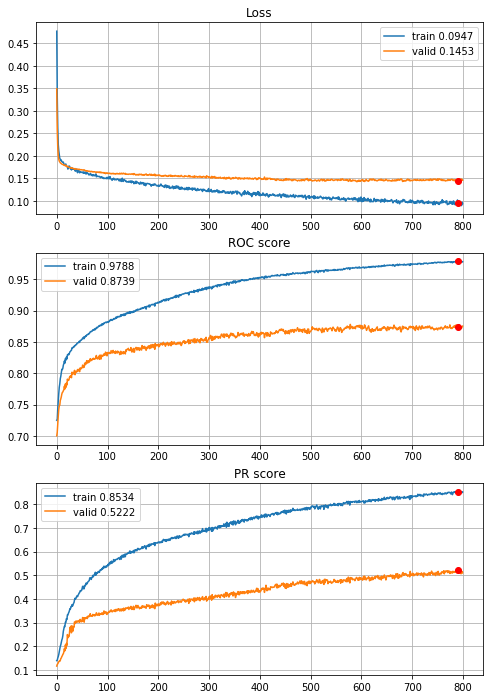


Fold 2------------------------------------------------------------


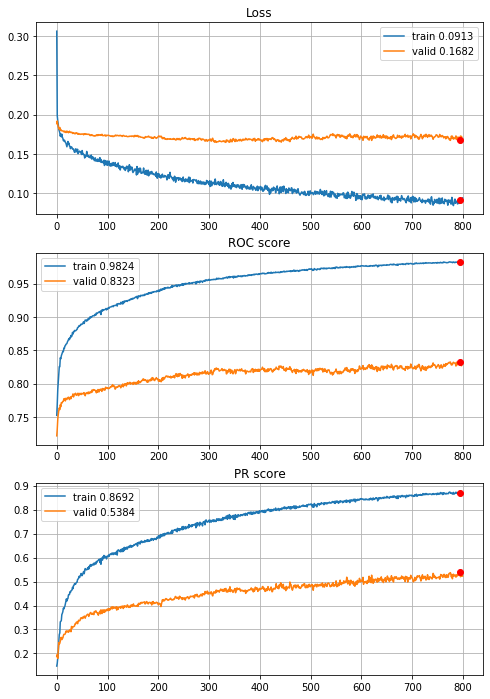


Fold 3------------------------------------------------------------


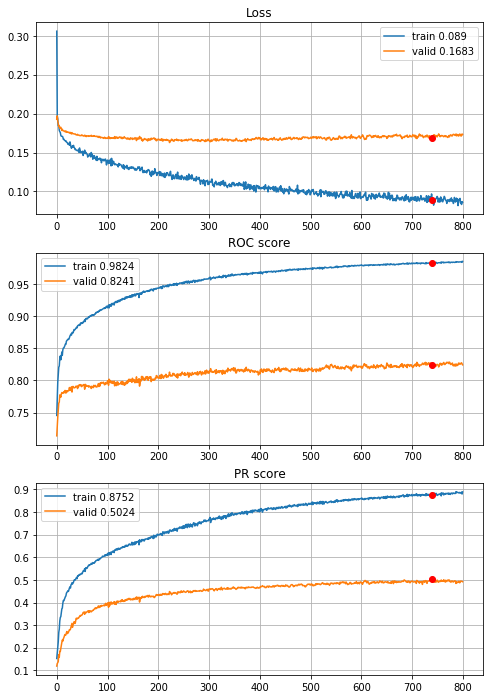


Fold 4------------------------------------------------------------


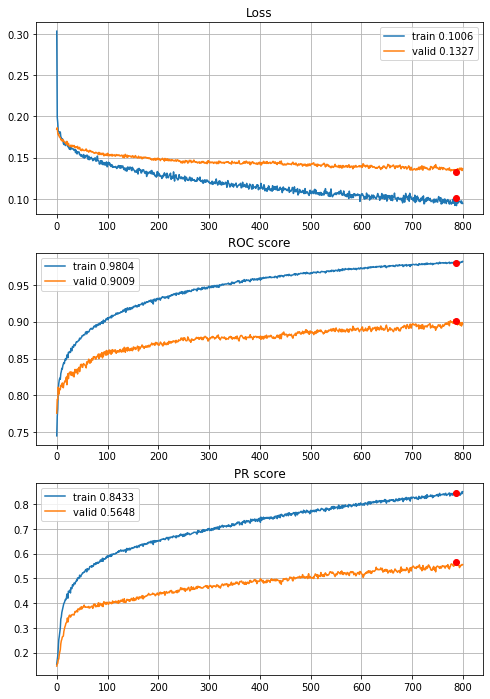


Fold 5------------------------------------------------------------


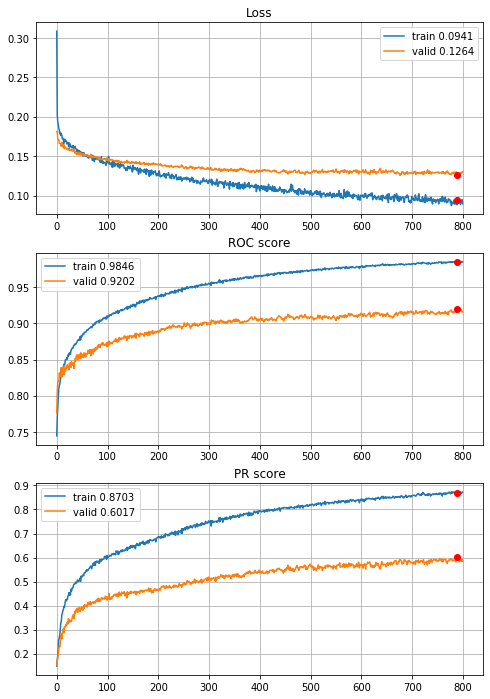


Fold 6------------------------------------------------------------


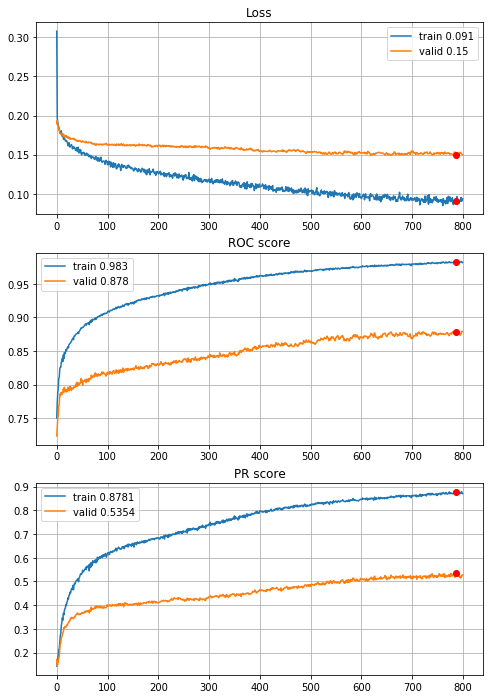

In [56]:
# two layers 800 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=800,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Learning curves are still growing with simillar overvitting, lets try much more epochs, 1600. 


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/1600,
cumulative time: 2.41s train loss: 0.47669296751356116, validation loss: 0.3488244737712115
Epoch: 2/1600,
cumulative time: 2.56s train loss: 0.3319926227484901, validation loss: 0.2579395601828947
Epoch: 3/1600,
cumulative time: 2.71s train loss: 0.26390457847341436, validation loss: 0.2192378440545967
Epoch: 4/1600,
cumulative time: 2.85s train loss: 0.22536075565911728, validation loss: 0.2010341976028141
Epoch: 5/1600,
cumulative time: 2.99s train loss: 0.21167294864724023, validation loss: 0.1926590264086986
Epoch: 6/1600,
cumulative time: 3.13s train loss: 0.202929176541354, validation loss: 0.1885047782088235
Epoch: 7/1600,
cumulative time: 3.26s train loss: 0.19429321125825486, validation loss: 0.1867375507230577
Epoch: 8/1600,
cumulative time: 3.4s train loss: 0.19288150406080226, validation loss: 0.18481792625194507
Epoch: 9/1600,
cumulative time: 3.53s train loss: 0.1897771269444238

Epoch: 77/1600,
cumulative time: 12.16s train loss: 0.15757480284003036, validation loss: 0.1646907319314144
Epoch: 78/1600,
cumulative time: 12.28s train loss: 0.15999454639960614, validation loss: 0.16411837107718114
Epoch: 79/1600,
cumulative time: 12.42s train loss: 0.1536866584560632, validation loss: 0.1627479203811221
Epoch: 80/1600,
cumulative time: 12.56s train loss: 0.15600245866539464, validation loss: 0.16430637990032596
Epoch: 81/1600,
cumulative time: 12.7s train loss: 0.15533515284159813, validation loss: 0.1644676968790058
Epoch: 82/1600,
cumulative time: 12.83s train loss: 0.15428106506887418, validation loss: 0.16396730490044073
Epoch: 83/1600,
cumulative time: 12.97s train loss: 0.154387896656016, validation loss: 0.16378080932115358
Epoch: 84/1600,
cumulative time: 13.11s train loss: 0.1548104766712159, validation loss: 0.163304629721067
Epoch: 85/1600,
cumulative time: 13.24s train loss: 0.15453019358312078, validation loss: 0.16464145187417856
Epoch: 86/1600,
cumu

Epoch: 153/1600,
cumulative time: 22.63s train loss: 0.13837145075118787, validation loss: 0.16085285997212218
Epoch: 154/1600,
cumulative time: 22.77s train loss: 0.1401301190798896, validation loss: 0.16057296441151545
Epoch: 155/1600,
cumulative time: 22.91s train loss: 0.14006283322033888, validation loss: 0.15908925729271828
Epoch: 156/1600,
cumulative time: 23.04s train loss: 0.14362649851122622, validation loss: 0.15849524110535362
Epoch: 157/1600,
cumulative time: 23.18s train loss: 0.13897751791631754, validation loss: 0.15749497362713655
Epoch: 158/1600,
cumulative time: 23.32s train loss: 0.143641706498754, validation loss: 0.15829381205704524
Epoch: 159/1600,
cumulative time: 23.45s train loss: 0.14128251613225434, validation loss: 0.15913931174372392
Epoch: 160/1600,
cumulative time: 23.59s train loss: 0.1414152651804029, validation loss: 0.15834445187313528
Epoch: 161/1600,
cumulative time: 23.73s train loss: 0.1401516541414522, validation loss: 0.15756281820830234
Epoch:

Epoch: 229/1600,
cumulative time: 32.96s train loss: 0.13323616477021985, validation loss: 0.15454066374863468
Epoch: 230/1600,
cumulative time: 33.09s train loss: 0.1291817761932279, validation loss: 0.15563618099105203
Epoch: 231/1600,
cumulative time: 33.23s train loss: 0.12730127886946255, validation loss: 0.15600456813714228
Epoch: 232/1600,
cumulative time: 33.37s train loss: 0.13214288045993766, validation loss: 0.1552132049777055
Epoch: 233/1600,
cumulative time: 33.5s train loss: 0.129031983745629, validation loss: 0.1551998147983142
Epoch: 234/1600,
cumulative time: 33.64s train loss: 0.1301451182837839, validation loss: 0.15680274065048863
Epoch: 235/1600,
cumulative time: 33.78s train loss: 0.12835714766679854, validation loss: 0.1560293106784457
Epoch: 236/1600,
cumulative time: 33.91s train loss: 0.13370470042516372, validation loss: 0.15608422148787626
Epoch: 237/1600,
cumulative time: 34.05s train loss: 0.13327761124715515, validation loss: 0.15529576843697007
Epoch: 23

Epoch: 305/1600,
cumulative time: 43.23s train loss: 0.1257634623594867, validation loss: 0.1527645992555125
Epoch: 306/1600,
cumulative time: 43.35s train loss: 0.12049613335380012, validation loss: 0.15473120155952835
Epoch: 307/1600,
cumulative time: 43.48s train loss: 0.12006131394222291, validation loss: 0.15078799225709485
Epoch: 308/1600,
cumulative time: 43.61s train loss: 0.12221545903726216, validation loss: 0.1542851704776977
Epoch: 309/1600,
cumulative time: 43.73s train loss: 0.12054270167620584, validation loss: 0.153218449348897
Epoch: 310/1600,
cumulative time: 43.86s train loss: 0.12239986507725069, validation loss: 0.1529819566510501
Epoch: 311/1600,
cumulative time: 43.99s train loss: 0.12055298741934785, validation loss: 0.151820722619963
Epoch: 312/1600,
cumulative time: 44.12s train loss: 0.12326690315364185, validation loss: 0.15449352699368077
Epoch: 313/1600,
cumulative time: 44.24s train loss: 0.1203866930345935, validation loss: 0.15171460988896487
Epoch: 314

Epoch: 381/1600,
cumulative time: 53.36s train loss: 0.11421452572762796, validation loss: 0.1497560341476664
Epoch: 382/1600,
cumulative time: 53.5s train loss: 0.11667786603944431, validation loss: 0.15049323656674224
Epoch: 383/1600,
cumulative time: 53.64s train loss: 0.11346755283016544, validation loss: 0.14971518215271304
Epoch: 384/1600,
cumulative time: 53.78s train loss: 0.11531814655620591, validation loss: 0.14889351029514536
Epoch: 385/1600,
cumulative time: 53.92s train loss: 0.10978277481358788, validation loss: 0.14933813456128942
Epoch: 386/1600,
cumulative time: 54.06s train loss: 0.11666668153387089, validation loss: 0.15046541982154768
Epoch: 387/1600,
cumulative time: 54.2s train loss: 0.11750362292348113, validation loss: 0.14960602538532103
Epoch: 388/1600,
cumulative time: 54.34s train loss: 0.11439626643325852, validation loss: 0.14831137356910679
Epoch: 389/1600,
cumulative time: 54.48s train loss: 0.11917004315531353, validation loss: 0.1494429510434198
Epoch

Epoch: 457/1600,
cumulative time: 63.16s train loss: 0.10896625351117642, validation loss: 0.1465545749080027
Epoch: 458/1600,
cumulative time: 63.28s train loss: 0.11001751199212464, validation loss: 0.14881175639801403
Epoch: 459/1600,
cumulative time: 63.4s train loss: 0.10984433463154543, validation loss: 0.1484588440723205
Epoch: 460/1600,
cumulative time: 63.53s train loss: 0.10993435954131986, validation loss: 0.14695703776374489
Epoch: 461/1600,
cumulative time: 63.66s train loss: 0.11340418507905742, validation loss: 0.14734958294827244
Epoch: 462/1600,
cumulative time: 63.79s train loss: 0.11212131672138156, validation loss: 0.14708591312920666
Epoch: 463/1600,
cumulative time: 63.91s train loss: 0.1117327895984977, validation loss: 0.14683492797178993
Epoch: 464/1600,
cumulative time: 64.03s train loss: 0.10934249762089039, validation loss: 0.14502097882325346
Epoch: 465/1600,
cumulative time: 64.16s train loss: 0.1113727592864284, validation loss: 0.1464880011351925
Epoch: 

Epoch: 533/1600,
cumulative time: 73.62s train loss: 0.10412109636422741, validation loss: 0.1474784584253154
Epoch: 534/1600,
cumulative time: 73.76s train loss: 0.1075060774601238, validation loss: 0.14703734415862899
Epoch: 535/1600,
cumulative time: 73.9s train loss: 0.10588543888485336, validation loss: 0.14798951931069546
Epoch: 536/1600,
cumulative time: 74.04s train loss: 0.10831635536979334, validation loss: 0.1459842562127714
Epoch: 537/1600,
cumulative time: 74.18s train loss: 0.10843743803746918, validation loss: 0.14620562098600817
Epoch: 538/1600,
cumulative time: 74.32s train loss: 0.10559832426778598, validation loss: 0.1463596740594277
Epoch: 539/1600,
cumulative time: 74.46s train loss: 0.10299446577761522, validation loss: 0.14709292067160323
Epoch: 540/1600,
cumulative time: 74.6s train loss: 0.10659229070918202, validation loss: 0.14594589024680743
Epoch: 541/1600,
cumulative time: 74.74s train loss: 0.10483428724054321, validation loss: 0.14774793240389425
Epoch: 

Epoch: 609/1600,
cumulative time: 84.43s train loss: 0.10472094228238285, validation loss: 0.1451468451380973
Epoch: 610/1600,
cumulative time: 84.57s train loss: 0.10235089069022059, validation loss: 0.14797813378888136
Epoch: 611/1600,
cumulative time: 84.71s train loss: 0.10247492276403018, validation loss: 0.14691996599761217
Epoch: 612/1600,
cumulative time: 84.85s train loss: 0.10035729252921127, validation loss: 0.14501482809255364
Epoch: 613/1600,
cumulative time: 84.99s train loss: 0.10534370928722718, validation loss: 0.14475321574954456
Epoch: 614/1600,
cumulative time: 85.13s train loss: 0.10603166933700464, validation loss: 0.14504694955904035
Epoch: 615/1600,
cumulative time: 85.27s train loss: 0.10094716136098866, validation loss: 0.14380660550662497
Epoch: 616/1600,
cumulative time: 85.41s train loss: 0.1031283451497644, validation loss: 0.14633761757161845
Epoch: 617/1600,
cumulative time: 85.55s train loss: 0.1016820235258793, validation loss: 0.14856611500596253
Epoc

Epoch: 685/1600,
cumulative time: 95.18s train loss: 0.10263411233073017, validation loss: 0.14412763778695936
Epoch: 686/1600,
cumulative time: 95.32s train loss: 0.10197436158641326, validation loss: 0.14555632983891634
Epoch: 687/1600,
cumulative time: 95.46s train loss: 0.09787936132625973, validation loss: 0.14566989226800556
Epoch: 688/1600,
cumulative time: 95.6s train loss: 0.0983510838754817, validation loss: 0.1443303015826104
Epoch: 689/1600,
cumulative time: 95.75s train loss: 0.09695054151764135, validation loss: 0.14519824943751847
Epoch: 690/1600,
cumulative time: 95.89s train loss: 0.0987275768648242, validation loss: 0.14685571218040055
Epoch: 691/1600,
cumulative time: 96.03s train loss: 0.09769801685697423, validation loss: 0.14643704574719996
Epoch: 692/1600,
cumulative time: 96.18s train loss: 0.09618770232621743, validation loss: 0.14857653162769918
Epoch: 693/1600,
cumulative time: 96.32s train loss: 0.09679207051444018, validation loss: 0.14802750306035323
Epoch

Epoch: 759/1600,
cumulative time: 105.7s train loss: 0.09949981380950589, validation loss: 0.1459725689044041
Epoch: 760/1600,
cumulative time: 105.84s train loss: 0.10300557908412954, validation loss: 0.14539958466633068
Epoch: 761/1600,
cumulative time: 105.99s train loss: 0.09618599084932035, validation loss: 0.14704549339979664
Epoch: 762/1600,
cumulative time: 106.13s train loss: 0.10035044549434594, validation loss: 0.146389902632118
Epoch: 763/1600,
cumulative time: 106.27s train loss: 0.0975104401733543, validation loss: 0.14533976275268423
Epoch: 764/1600,
cumulative time: 106.41s train loss: 0.09816912780109355, validation loss: 0.14644109700673935
Epoch: 765/1600,
cumulative time: 106.55s train loss: 0.09836547260759768, validation loss: 0.14617883091966175
Epoch: 766/1600,
cumulative time: 106.69s train loss: 0.09901204865045839, validation loss: 0.14436749017425263
Epoch: 767/1600,
cumulative time: 106.84s train loss: 0.09596350450278238, validation loss: 0.145588498767985

Epoch: 833/1600,
cumulative time: 115.85s train loss: 0.09441928244669594, validation loss: 0.14595932322265828
Epoch: 834/1600,
cumulative time: 115.99s train loss: 0.09530288951952647, validation loss: 0.14600803813129318
Epoch: 835/1600,
cumulative time: 116.13s train loss: 0.09289724807656137, validation loss: 0.14494577776501177
Epoch: 836/1600,
cumulative time: 116.27s train loss: 0.09255182639781062, validation loss: 0.1452765786440864
Epoch: 837/1600,
cumulative time: 116.41s train loss: 0.09780882984545905, validation loss: 0.14649721377556466
Epoch: 838/1600,
cumulative time: 116.56s train loss: 0.09215924115989768, validation loss: 0.14572420734544447
Epoch: 839/1600,
cumulative time: 116.7s train loss: 0.09236036341403496, validation loss: 0.14724968385947976
Epoch: 840/1600,
cumulative time: 116.83s train loss: 0.09106073223016867, validation loss: 0.14650916972072697
Epoch: 841/1600,
cumulative time: 116.98s train loss: 0.09272235995593585, validation loss: 0.147400417889

Epoch: 907/1600,
cumulative time: 126.26s train loss: 0.09260199486348897, validation loss: 0.149709844382301
Epoch: 908/1600,
cumulative time: 126.4s train loss: 0.09334402086461059, validation loss: 0.14904500376699406
Epoch: 909/1600,
cumulative time: 126.54s train loss: 0.09106501219452978, validation loss: 0.14635670964128716
Epoch: 910/1600,
cumulative time: 126.68s train loss: 0.0906380076434686, validation loss: 0.14705285984817373
Epoch: 911/1600,
cumulative time: 126.83s train loss: 0.09081887891108961, validation loss: 0.14791564104750174
Epoch: 912/1600,
cumulative time: 126.97s train loss: 0.09703210135636466, validation loss: 0.14606741006841784
Epoch: 913/1600,
cumulative time: 127.11s train loss: 0.09266062632830156, validation loss: 0.14635228485863092
Epoch: 914/1600,
cumulative time: 127.25s train loss: 0.09310672002986944, validation loss: 0.1456024690580011
Epoch: 915/1600,
cumulative time: 127.39s train loss: 0.09134291356852313, validation loss: 0.145875199371409

Epoch: 981/1600,
cumulative time: 136.74s train loss: 0.0908430416949208, validation loss: 0.14857105193615283
Epoch: 982/1600,
cumulative time: 136.88s train loss: 0.09092536288496585, validation loss: 0.14624697732795575
Epoch: 983/1600,
cumulative time: 137.02s train loss: 0.08913553633322414, validation loss: 0.14656181340318217
Epoch: 984/1600,
cumulative time: 137.16s train loss: 0.0876134346359378, validation loss: 0.14862568132766987
Epoch: 985/1600,
cumulative time: 137.31s train loss: 0.09162108393150861, validation loss: 0.14634448163074404
Epoch: 986/1600,
cumulative time: 137.45s train loss: 0.09042236999633055, validation loss: 0.14662600866055472
Epoch: 987/1600,
cumulative time: 137.59s train loss: 0.09186011207727943, validation loss: 0.14379780515876248
Epoch: 988/1600,
cumulative time: 137.73s train loss: 0.08856460423365156, validation loss: 0.14427535657861593
Epoch: 989/1600,
cumulative time: 137.87s train loss: 0.08826859070115724, validation loss: 0.144935915042

Epoch: 1055/1600,
cumulative time: 147.3s train loss: 0.08752029747517642, validation loss: 0.14811554008434222
Epoch: 1056/1600,
cumulative time: 147.44s train loss: 0.08613353664286046, validation loss: 0.14744000693743858
Epoch: 1057/1600,
cumulative time: 147.58s train loss: 0.08460465020062682, validation loss: 0.14718719743765318
Epoch: 1058/1600,
cumulative time: 147.73s train loss: 0.08849523125370339, validation loss: 0.14634538143163153
Epoch: 1059/1600,
cumulative time: 147.88s train loss: 0.08800841497982066, validation loss: 0.14670191122975942
Epoch: 1060/1600,
cumulative time: 148.02s train loss: 0.08496233320489463, validation loss: 0.14666767198265288
Epoch: 1061/1600,
cumulative time: 148.16s train loss: 0.09075594598451006, validation loss: 0.14502294021775886
Epoch: 1062/1600,
cumulative time: 148.3s train loss: 0.08445231974567297, validation loss: 0.14682725525332438
Epoch: 1063/1600,
cumulative time: 148.45s train loss: 0.08913009948891513, validation loss: 0.146

Epoch: 1129/1600,
cumulative time: 157.82s train loss: 0.08696316624392318, validation loss: 0.14632181977438555
Epoch: 1130/1600,
cumulative time: 157.96s train loss: 0.08191592426749661, validation loss: 0.14721098073572428
Epoch: 1131/1600,
cumulative time: 158.1s train loss: 0.09006055927655685, validation loss: 0.14594337818896877
Epoch: 1132/1600,
cumulative time: 158.25s train loss: 0.0875889418212169, validation loss: 0.14551605771113774
Epoch: 1133/1600,
cumulative time: 158.39s train loss: 0.0851108808281976, validation loss: 0.14462755761477636
Epoch: 1134/1600,
cumulative time: 158.53s train loss: 0.08638576817122075, validation loss: 0.14360495735342768
Epoch: 1135/1600,
cumulative time: 158.67s train loss: 0.083648823010902, validation loss: 0.14510796961125424
Epoch: 1136/1600,
cumulative time: 158.81s train loss: 0.08820647350103414, validation loss: 0.1465961108550967
Epoch: 1137/1600,
cumulative time: 158.96s train loss: 0.08620380674759373, validation loss: 0.1476234

Epoch: 1203/1600,
cumulative time: 168.32s train loss: 0.08501326439674652, validation loss: 0.1455105803932277
Epoch: 1204/1600,
cumulative time: 168.47s train loss: 0.08386441874991933, validation loss: 0.14513058351813082
Epoch: 1205/1600,
cumulative time: 168.61s train loss: 0.08246679274799323, validation loss: 0.14622926754639862
Epoch: 1206/1600,
cumulative time: 168.75s train loss: 0.08102528258689366, validation loss: 0.146279751422699
Epoch: 1207/1600,
cumulative time: 168.89s train loss: 0.08378415215056809, validation loss: 0.14690891108073045
Epoch: 1208/1600,
cumulative time: 169.04s train loss: 0.08306824885908401, validation loss: 0.1472791830766274
Epoch: 1209/1600,
cumulative time: 169.18s train loss: 0.07749055750717766, validation loss: 0.1469902622914785
Epoch: 1210/1600,
cumulative time: 169.32s train loss: 0.08259343570188331, validation loss: 0.14776183468010087
Epoch: 1211/1600,
cumulative time: 169.46s train loss: 0.08455915932217492, validation loss: 0.146736

Epoch: 1277/1600,
cumulative time: 178.77s train loss: 0.08518041987705179, validation loss: 0.1445327322039984
Epoch: 1278/1600,
cumulative time: 178.91s train loss: 0.08166395714444359, validation loss: 0.14388095945058996
Epoch: 1279/1600,
cumulative time: 179.06s train loss: 0.08411164988549158, validation loss: 0.14337869779726045
Epoch: 1280/1600,
cumulative time: 179.19s train loss: 0.0819485132856061, validation loss: 0.1435708194321885
Epoch: 1281/1600,
cumulative time: 179.34s train loss: 0.0813586468418093, validation loss: 0.1414829238671036
Epoch: 1282/1600,
cumulative time: 179.48s train loss: 0.07940961840804389, validation loss: 0.14302777638436986
Epoch: 1283/1600,
cumulative time: 179.62s train loss: 0.0804121081553573, validation loss: 0.14581215958801397
Epoch: 1284/1600,
cumulative time: 179.76s train loss: 0.0833902651136892, validation loss: 0.1439387451393252
Epoch: 1285/1600,
cumulative time: 179.91s train loss: 0.08330966500268878, validation loss: 0.145859667

Epoch: 1351/1600,
cumulative time: 189.21s train loss: 0.08386969095141397, validation loss: 0.14281271475159935
Epoch: 1352/1600,
cumulative time: 189.35s train loss: 0.07464125029637195, validation loss: 0.1432974110297235
Epoch: 1353/1600,
cumulative time: 189.49s train loss: 0.07857075372354935, validation loss: 0.14312531964928216
Epoch: 1354/1600,
cumulative time: 189.64s train loss: 0.07834353742974665, validation loss: 0.14284572013386906
Epoch: 1355/1600,
cumulative time: 189.78s train loss: 0.07858585423520908, validation loss: 0.1451346139627058
Epoch: 1356/1600,
cumulative time: 189.92s train loss: 0.07759179995549596, validation loss: 0.14650413595834827
Epoch: 1357/1600,
cumulative time: 190.06s train loss: 0.08008786773451923, validation loss: 0.1457292584333394
Epoch: 1358/1600,
cumulative time: 190.2s train loss: 0.0774252698896903, validation loss: 0.14381188449403556
Epoch: 1359/1600,
cumulative time: 190.32s train loss: 0.08071285935001349, validation loss: 0.143717

Epoch: 1425/1600,
cumulative time: 199.66s train loss: 0.07050058414902623, validation loss: 0.14964337812304254
Epoch: 1426/1600,
cumulative time: 199.81s train loss: 0.07946637503261968, validation loss: 0.14969731257674318
Epoch: 1427/1600,
cumulative time: 199.95s train loss: 0.08110135759898042, validation loss: 0.14891545107325702
Epoch: 1428/1600,
cumulative time: 200.09s train loss: 0.08427095968019048, validation loss: 0.1469930575728173
Epoch: 1429/1600,
cumulative time: 200.24s train loss: 0.084509566011285, validation loss: 0.14518133153754728
Epoch: 1430/1600,
cumulative time: 200.38s train loss: 0.08133518476362338, validation loss: 0.14594177535555652
Epoch: 1431/1600,
cumulative time: 200.52s train loss: 0.07817151769234701, validation loss: 0.1484371505479897
Epoch: 1432/1600,
cumulative time: 200.66s train loss: 0.0809203432838647, validation loss: 0.1471528801851487
Epoch: 1433/1600,
cumulative time: 200.8s train loss: 0.08211390161411193, validation loss: 0.14468079

Epoch: 1499/1600,
cumulative time: 210.19s train loss: 0.0722940395885895, validation loss: 0.14730866058616107
Epoch: 1500/1600,
cumulative time: 210.33s train loss: 0.07314925572636925, validation loss: 0.14761453456136953
Epoch: 1501/1600,
cumulative time: 210.48s train loss: 0.0786607044390156, validation loss: 0.15023099719828859
Epoch: 1502/1600,
cumulative time: 210.62s train loss: 0.07483276485357787, validation loss: 0.15035731378382286
Epoch: 1503/1600,
cumulative time: 210.75s train loss: 0.07486628547227628, validation loss: 0.14966191234760662
Epoch: 1504/1600,
cumulative time: 210.88s train loss: 0.07263185813095627, validation loss: 0.1503097116947174
Epoch: 1505/1600,
cumulative time: 211.02s train loss: 0.0783926491533908, validation loss: 0.1492325914725712
Epoch: 1506/1600,
cumulative time: 211.17s train loss: 0.07580114321903167, validation loss: 0.14836315250745674
Epoch: 1507/1600,
cumulative time: 211.31s train loss: 0.07442870794566016, validation loss: 0.148488

Epoch: 1573/1600,
cumulative time: 220.67s train loss: 0.07782553080441466, validation loss: 0.1481007479278306
Epoch: 1574/1600,
cumulative time: 220.81s train loss: 0.0795622106494914, validation loss: 0.14624821310996036
Epoch: 1575/1600,
cumulative time: 220.96s train loss: 0.07411452193418397, validation loss: 0.14640750130923774
Epoch: 1576/1600,
cumulative time: 221.1s train loss: 0.08019915711523791, validation loss: 0.14848231296501976
Epoch: 1577/1600,
cumulative time: 221.25s train loss: 0.07921659038329212, validation loss: 0.14765846797241655
Epoch: 1578/1600,
cumulative time: 221.39s train loss: 0.07775717195471966, validation loss: 0.14756753116622923
Epoch: 1579/1600,
cumulative time: 221.53s train loss: 0.07468685600310503, validation loss: 0.1476139030625335
Epoch: 1580/1600,
cumulative time: 221.67s train loss: 0.0773942163750584, validation loss: 0.14515260419852072
Epoch: 1581/1600,
cumulative time: 221.81s train loss: 0.07433944140362687, validation loss: 0.146091

Epoch: 47/1600,
cumulative time: 8.98s train loss: 0.15300989462701692, validation loss: 0.17506717116026102
Epoch: 48/1600,
cumulative time: 9.12s train loss: 0.15288565389737924, validation loss: 0.17546639433720226
Epoch: 49/1600,
cumulative time: 9.26s train loss: 0.1507999345002716, validation loss: 0.17511513710549448
Epoch: 50/1600,
cumulative time: 9.4s train loss: 0.1494906691444451, validation loss: 0.17537937769279585
Epoch: 51/1600,
cumulative time: 9.55s train loss: 0.15455868293117897, validation loss: 0.17574500607502874
Epoch: 52/1600,
cumulative time: 9.69s train loss: 0.15140855338322473, validation loss: 0.1754379278445747
Epoch: 53/1600,
cumulative time: 9.83s train loss: 0.14953045180313726, validation loss: 0.17534960971712824
Epoch: 54/1600,
cumulative time: 9.97s train loss: 0.1497478010027639, validation loss: 0.174490395403379
Epoch: 55/1600,
cumulative time: 10.11s train loss: 0.14931169840903302, validation loss: 0.1758315949171396
Epoch: 56/1600,
cumulative

Epoch: 123/1600,
cumulative time: 19.68s train loss: 0.1322288137499, validation loss: 0.17329054469353006
Epoch: 124/1600,
cumulative time: 19.81s train loss: 0.13204611932429375, validation loss: 0.17366094414558111
Epoch: 125/1600,
cumulative time: 19.94s train loss: 0.13537198153135319, validation loss: 0.17335119388028827
Epoch: 126/1600,
cumulative time: 20.08s train loss: 0.1298265626843515, validation loss: 0.17393801053966934
Epoch: 127/1600,
cumulative time: 20.22s train loss: 0.13281867939161537, validation loss: 0.17344276032900632
Epoch: 128/1600,
cumulative time: 20.36s train loss: 0.13423633086580714, validation loss: 0.17349167009390803
Epoch: 129/1600,
cumulative time: 20.49s train loss: 0.13384308497051475, validation loss: 0.17300131332212926
Epoch: 130/1600,
cumulative time: 20.63s train loss: 0.13307411184991785, validation loss: 0.17240149529309723
Epoch: 131/1600,
cumulative time: 20.77s train loss: 0.13461132898742068, validation loss: 0.1732830639099328
Epoch: 

Epoch: 199/1600,
cumulative time: 30.35s train loss: 0.11937150886569217, validation loss: 0.17111581613146748
Epoch: 200/1600,
cumulative time: 30.49s train loss: 0.1251246834156803, validation loss: 0.17151153169273112
Epoch: 201/1600,
cumulative time: 30.64s train loss: 0.12454137676063812, validation loss: 0.17260645702227675
Epoch: 202/1600,
cumulative time: 30.78s train loss: 0.125271239493615, validation loss: 0.17312451198930395
Epoch: 203/1600,
cumulative time: 30.92s train loss: 0.12058183804497348, validation loss: 0.17275666690465136
Epoch: 204/1600,
cumulative time: 31.06s train loss: 0.12317397025679269, validation loss: 0.17189447796815427
Epoch: 205/1600,
cumulative time: 31.21s train loss: 0.12110445007476887, validation loss: 0.17193459921787188
Epoch: 206/1600,
cumulative time: 31.35s train loss: 0.11959768343784334, validation loss: 0.17288914901046545
Epoch: 207/1600,
cumulative time: 31.49s train loss: 0.12294846605831672, validation loss: 0.1724487853098922
Epoch

Epoch: 275/1600,
cumulative time: 41.19s train loss: 0.11572738536474378, validation loss: 0.16857270361352242
Epoch: 276/1600,
cumulative time: 41.33s train loss: 0.11726486045792628, validation loss: 0.1685221367411016
Epoch: 277/1600,
cumulative time: 41.47s train loss: 0.11343505327178496, validation loss: 0.16836369204999965
Epoch: 278/1600,
cumulative time: 41.61s train loss: 0.11263216995631221, validation loss: 0.16921083663620048
Epoch: 279/1600,
cumulative time: 41.75s train loss: 0.1134827386049586, validation loss: 0.16791339353021104
Epoch: 280/1600,
cumulative time: 41.9s train loss: 0.11641413241068803, validation loss: 0.16949881340894998
Epoch: 281/1600,
cumulative time: 42.04s train loss: 0.1122013086781066, validation loss: 0.17022733167168883
Epoch: 282/1600,
cumulative time: 42.19s train loss: 0.1141547877993422, validation loss: 0.16982148322444776
Epoch: 283/1600,
cumulative time: 42.33s train loss: 0.1143516304412022, validation loss: 0.16999503537008273
Epoch: 

Epoch: 351/1600,
cumulative time: 52.01s train loss: 0.1111915424216529, validation loss: 0.16702437999298816
Epoch: 352/1600,
cumulative time: 52.15s train loss: 0.10840455509532493, validation loss: 0.16596332434856462
Epoch: 353/1600,
cumulative time: 52.29s train loss: 0.11035203872430914, validation loss: 0.16883992507719037
Epoch: 354/1600,
cumulative time: 52.43s train loss: 0.1084562502634001, validation loss: 0.16862912251378825
Epoch: 355/1600,
cumulative time: 52.58s train loss: 0.10748094283363953, validation loss: 0.16663277967293463
Epoch: 356/1600,
cumulative time: 52.72s train loss: 0.11118384209897429, validation loss: 0.16648504677640086
Epoch: 357/1600,
cumulative time: 52.86s train loss: 0.11018959885273125, validation loss: 0.1673951814416479
Epoch: 358/1600,
cumulative time: 53.0s train loss: 0.10869657270580908, validation loss: 0.16715627147418613
Epoch: 359/1600,
cumulative time: 53.15s train loss: 0.11084902570733221, validation loss: 0.16739599883982403
Epoch

Epoch: 427/1600,
cumulative time: 62.79s train loss: 0.10400970444543865, validation loss: 0.16957500436482095
Epoch: 428/1600,
cumulative time: 62.93s train loss: 0.10808061955472063, validation loss: 0.1699877904488409
Epoch: 429/1600,
cumulative time: 63.08s train loss: 0.10502400899836856, validation loss: 0.16842633727215195
Epoch: 430/1600,
cumulative time: 63.22s train loss: 0.10553879225069798, validation loss: 0.16932223835634164
Epoch: 431/1600,
cumulative time: 63.37s train loss: 0.10664955135949801, validation loss: 0.16822872415357418
Epoch: 432/1600,
cumulative time: 63.52s train loss: 0.1008486365573487, validation loss: 0.16745268288236478
Epoch: 433/1600,
cumulative time: 63.66s train loss: 0.1061175653842105, validation loss: 0.16610108118141648
Epoch: 434/1600,
cumulative time: 63.8s train loss: 0.10556492009345378, validation loss: 0.1672399230935364
Epoch: 435/1600,
cumulative time: 63.95s train loss: 0.1096251629882477, validation loss: 0.16837911041031248
Epoch: 

Epoch: 503/1600,
cumulative time: 73.63s train loss: 0.10101393657471022, validation loss: 0.1704492733704143
Epoch: 504/1600,
cumulative time: 73.77s train loss: 0.10117083149499827, validation loss: 0.1702019961777798
Epoch: 505/1600,
cumulative time: 73.91s train loss: 0.10104914781618846, validation loss: 0.17324920695013868
Epoch: 506/1600,
cumulative time: 74.06s train loss: 0.09850189052537402, validation loss: 0.17536297984233593
Epoch: 507/1600,
cumulative time: 74.2s train loss: 0.0988056882130228, validation loss: 0.17275294811649336
Epoch: 508/1600,
cumulative time: 74.34s train loss: 0.10038995650363167, validation loss: 0.1715488229948619
Epoch: 509/1600,
cumulative time: 74.48s train loss: 0.1028897828671964, validation loss: 0.1714657039170447
Epoch: 510/1600,
cumulative time: 74.62s train loss: 0.10286841488056606, validation loss: 0.16993501526794927
Epoch: 511/1600,
cumulative time: 74.77s train loss: 0.09900262165242882, validation loss: 0.16923590182974033
Epoch: 5

Epoch: 579/1600,
cumulative time: 84.41s train loss: 0.09395750778626148, validation loss: 0.17450840500867473
Epoch: 580/1600,
cumulative time: 84.55s train loss: 0.09571569205247689, validation loss: 0.17150115840507252
Epoch: 581/1600,
cumulative time: 84.69s train loss: 0.09716277408405852, validation loss: 0.17276216347538914
Epoch: 582/1600,
cumulative time: 84.83s train loss: 0.1026302300435182, validation loss: 0.17175156814334666
Epoch: 583/1600,
cumulative time: 84.98s train loss: 0.09785137431860684, validation loss: 0.17270914302889062
Epoch: 584/1600,
cumulative time: 85.12s train loss: 0.09821686437616033, validation loss: 0.17073656905663104
Epoch: 585/1600,
cumulative time: 85.26s train loss: 0.09645427275415047, validation loss: 0.171481642955781
Epoch: 586/1600,
cumulative time: 85.4s train loss: 0.1016612558142538, validation loss: 0.17389498559226788
Epoch: 587/1600,
cumulative time: 85.55s train loss: 0.10030557677184271, validation loss: 0.1733150566675129
Epoch: 

Epoch: 655/1600,
cumulative time: 95.21s train loss: 0.09522839978664005, validation loss: 0.17034272214561355
Epoch: 656/1600,
cumulative time: 95.35s train loss: 0.09669440634265576, validation loss: 0.1709847333755438
Epoch: 657/1600,
cumulative time: 95.5s train loss: 0.09525332834211907, validation loss: 0.16960854482455998
Epoch: 658/1600,
cumulative time: 95.64s train loss: 0.09044163873190615, validation loss: 0.17199303796597287
Epoch: 659/1600,
cumulative time: 95.78s train loss: 0.08911661558379826, validation loss: 0.17221044823578055
Epoch: 660/1600,
cumulative time: 95.94s train loss: 0.09359698234592458, validation loss: 0.16842363188468007
Epoch: 661/1600,
cumulative time: 96.08s train loss: 0.0880829233559003, validation loss: 0.1723596650861087
Epoch: 662/1600,
cumulative time: 96.21s train loss: 0.0948023836413911, validation loss: 0.17088297753004578
Epoch: 663/1600,
cumulative time: 96.36s train loss: 0.09292157745894629, validation loss: 0.17349517100964215
Epoch:

Epoch: 729/1600,
cumulative time: 105.59s train loss: 0.08997408695743209, validation loss: 0.1730484088326166
Epoch: 730/1600,
cumulative time: 105.73s train loss: 0.0903386826470066, validation loss: 0.17407209508836147
Epoch: 731/1600,
cumulative time: 105.86s train loss: 0.0904055414532391, validation loss: 0.17129161240820823
Epoch: 732/1600,
cumulative time: 106.01s train loss: 0.09292710849480815, validation loss: 0.17295659477001474
Epoch: 733/1600,
cumulative time: 106.15s train loss: 0.08910669590534606, validation loss: 0.17296961960214755
Epoch: 734/1600,
cumulative time: 106.29s train loss: 0.09255542656746414, validation loss: 0.17478049294408118
Epoch: 735/1600,
cumulative time: 106.43s train loss: 0.09105554464902618, validation loss: 0.1723032655350362
Epoch: 736/1600,
cumulative time: 106.58s train loss: 0.0873614948830893, validation loss: 0.1727287185646548
Epoch: 737/1600,
cumulative time: 106.72s train loss: 0.08641453990673444, validation loss: 0.1735737377117084

Epoch: 803/1600,
cumulative time: 116.26s train loss: 0.09185933169998745, validation loss: 0.16837923717669195
Epoch: 804/1600,
cumulative time: 116.4s train loss: 0.08882223377411394, validation loss: 0.1694287029383457
Epoch: 805/1600,
cumulative time: 116.54s train loss: 0.08893645257894145, validation loss: 0.1697757191413353
Epoch: 806/1600,
cumulative time: 116.69s train loss: 0.08953806638096685, validation loss: 0.1687535473568412
Epoch: 807/1600,
cumulative time: 116.84s train loss: 0.0949948721885048, validation loss: 0.1718217557216275
Epoch: 808/1600,
cumulative time: 116.99s train loss: 0.08600586231777133, validation loss: 0.1700472351825505
Epoch: 809/1600,
cumulative time: 117.13s train loss: 0.08464279560412566, validation loss: 0.170474708825857
Epoch: 810/1600,
cumulative time: 117.28s train loss: 0.09260208308027078, validation loss: 0.16900643625678946
Epoch: 811/1600,
cumulative time: 117.43s train loss: 0.08807987768984808, validation loss: 0.16964256419585302
E

Epoch: 877/1600,
cumulative time: 126.79s train loss: 0.08217611986837838, validation loss: 0.17326655751125922
Epoch: 878/1600,
cumulative time: 126.92s train loss: 0.08627215504897935, validation loss: 0.1726028679827592
Epoch: 879/1600,
cumulative time: 127.06s train loss: 0.08841415068831476, validation loss: 0.17414571297684034
Epoch: 880/1600,
cumulative time: 127.19s train loss: 0.08702281813692628, validation loss: 0.17510093110527938
Epoch: 881/1600,
cumulative time: 127.33s train loss: 0.08972927813213884, validation loss: 0.1727220069102238
Epoch: 882/1600,
cumulative time: 127.46s train loss: 0.0899531027878214, validation loss: 0.17332378221032893
Epoch: 883/1600,
cumulative time: 127.59s train loss: 0.08328474368420638, validation loss: 0.17319203880244652
Epoch: 884/1600,
cumulative time: 127.72s train loss: 0.08524616463529662, validation loss: 0.1722431953481625
Epoch: 885/1600,
cumulative time: 127.86s train loss: 0.08823858192371897, validation loss: 0.17506625465262

Epoch: 951/1600,
cumulative time: 137.17s train loss: 0.08307241426734399, validation loss: 0.17518894249095326
Epoch: 952/1600,
cumulative time: 137.31s train loss: 0.08273096287139313, validation loss: 0.1714484669709384
Epoch: 953/1600,
cumulative time: 137.45s train loss: 0.08538948559666076, validation loss: 0.1750200197628114
Epoch: 954/1600,
cumulative time: 137.6s train loss: 0.08350617585679125, validation loss: 0.1707351009270786
Epoch: 955/1600,
cumulative time: 137.74s train loss: 0.08548997003591695, validation loss: 0.17324312623663773
Epoch: 956/1600,
cumulative time: 137.88s train loss: 0.07955435889728807, validation loss: 0.17420524370414697
Epoch: 957/1600,
cumulative time: 138.02s train loss: 0.08358750280627483, validation loss: 0.17374447133161325
Epoch: 958/1600,
cumulative time: 138.17s train loss: 0.0890384476769365, validation loss: 0.17277143813461734
Epoch: 959/1600,
cumulative time: 138.31s train loss: 0.08376269275455729, validation loss: 0.173436357384234

Epoch: 1025/1600,
cumulative time: 147.74s train loss: 0.08422072241002884, validation loss: 0.1729027737943878
Epoch: 1026/1600,
cumulative time: 147.88s train loss: 0.0858322950750975, validation loss: 0.17198558820701929
Epoch: 1027/1600,
cumulative time: 148.02s train loss: 0.08179135105557295, validation loss: 0.16992211628418702
Epoch: 1028/1600,
cumulative time: 148.16s train loss: 0.08457774978806305, validation loss: 0.1732190535882446
Epoch: 1029/1600,
cumulative time: 148.31s train loss: 0.08369555213922021, validation loss: 0.17242644976259008
Epoch: 1030/1600,
cumulative time: 148.45s train loss: 0.0823351504824255, validation loss: 0.17204572656493028
Epoch: 1031/1600,
cumulative time: 148.59s train loss: 0.08180008236692725, validation loss: 0.17341824058998678
Epoch: 1032/1600,
cumulative time: 148.74s train loss: 0.0852725615340115, validation loss: 0.17033612565311793
Epoch: 1033/1600,
cumulative time: 148.88s train loss: 0.08256780457329428, validation loss: 0.172508

Epoch: 1099/1600,
cumulative time: 158.31s train loss: 0.08281495987183876, validation loss: 0.17397240443323808
Epoch: 1100/1600,
cumulative time: 158.46s train loss: 0.08225540493008844, validation loss: 0.17244471903253852
Epoch: 1101/1600,
cumulative time: 158.6s train loss: 0.07844532402918447, validation loss: 0.17522225992524598
Epoch: 1102/1600,
cumulative time: 158.74s train loss: 0.07912012116673303, validation loss: 0.1762395005513406
Epoch: 1103/1600,
cumulative time: 158.89s train loss: 0.08249345777121776, validation loss: 0.1738623616807391
Epoch: 1104/1600,
cumulative time: 159.02s train loss: 0.07919443583177575, validation loss: 0.17276871829230903
Epoch: 1105/1600,
cumulative time: 159.18s train loss: 0.08570860524147031, validation loss: 0.1723645577794277
Epoch: 1106/1600,
cumulative time: 159.33s train loss: 0.08186162722081526, validation loss: 0.1730055943527053
Epoch: 1107/1600,
cumulative time: 159.48s train loss: 0.08300644492071736, validation loss: 0.173940

Epoch: 1173/1600,
cumulative time: 168.82s train loss: 0.0808812119203693, validation loss: 0.1756447869764452
Epoch: 1174/1600,
cumulative time: 168.96s train loss: 0.07614391111623814, validation loss: 0.17692793072426377
Epoch: 1175/1600,
cumulative time: 169.1s train loss: 0.07791171940587675, validation loss: 0.17682342478273838
Epoch: 1176/1600,
cumulative time: 169.24s train loss: 0.08062513530087961, validation loss: 0.17636811298586383
Epoch: 1177/1600,
cumulative time: 169.39s train loss: 0.08596547285631861, validation loss: 0.17447252687221484
Epoch: 1178/1600,
cumulative time: 169.53s train loss: 0.08159772139466233, validation loss: 0.17527284128800633
Epoch: 1179/1600,
cumulative time: 169.67s train loss: 0.08198681941384534, validation loss: 0.1763845437274164
Epoch: 1180/1600,
cumulative time: 169.81s train loss: 0.0809483112495666, validation loss: 0.17570910907627532
Epoch: 1181/1600,
cumulative time: 169.95s train loss: 0.08036439005809569, validation loss: 0.174114

Epoch: 1247/1600,
cumulative time: 179.36s train loss: 0.07591640921955162, validation loss: 0.17513894593537138
Epoch: 1248/1600,
cumulative time: 179.5s train loss: 0.07646633300792777, validation loss: 0.17542181919228064
Epoch: 1249/1600,
cumulative time: 179.65s train loss: 0.07357381229242836, validation loss: 0.17569395789713013
Epoch: 1250/1600,
cumulative time: 179.8s train loss: 0.07827978395813413, validation loss: 0.17596607768389544
Epoch: 1251/1600,
cumulative time: 179.95s train loss: 0.08143293687417529, validation loss: 0.1787293810496288
Epoch: 1252/1600,
cumulative time: 180.11s train loss: 0.08068099814546656, validation loss: 0.17488008478898592
Epoch: 1253/1600,
cumulative time: 180.25s train loss: 0.07703335499856431, validation loss: 0.17765743523288374
Epoch: 1254/1600,
cumulative time: 180.4s train loss: 0.07442563493071111, validation loss: 0.1778710991083318
Epoch: 1255/1600,
cumulative time: 180.53s train loss: 0.07726714876141126, validation loss: 0.176761

Epoch: 1320/1600,
cumulative time: 189.83s train loss: 0.07726694840238252, validation loss: 0.17800556095361386
Epoch: 1321/1600,
cumulative time: 189.97s train loss: 0.07649128402219423, validation loss: 0.1767627667557065
Epoch: 1322/1600,
cumulative time: 190.12s train loss: 0.07511706219131999, validation loss: 0.17612121848629153
Epoch: 1323/1600,
cumulative time: 190.26s train loss: 0.0774064522678466, validation loss: 0.17559284935949449
Epoch: 1324/1600,
cumulative time: 190.4s train loss: 0.08009727528828879, validation loss: 0.17352346252774284
Epoch: 1325/1600,
cumulative time: 190.54s train loss: 0.07492054664395038, validation loss: 0.17687891503330638
Epoch: 1326/1600,
cumulative time: 190.68s train loss: 0.07614373575110178, validation loss: 0.17769471482406107
Epoch: 1327/1600,
cumulative time: 190.83s train loss: 0.07192113042490596, validation loss: 0.17669351273669606
Epoch: 1328/1600,
cumulative time: 190.97s train loss: 0.07691352426636434, validation loss: 0.1780

Epoch: 1394/1600,
cumulative time: 200.38s train loss: 0.07427358261892862, validation loss: 0.1766241611855788
Epoch: 1395/1600,
cumulative time: 200.52s train loss: 0.07471353273337014, validation loss: 0.17884689311822147
Epoch: 1396/1600,
cumulative time: 200.66s train loss: 0.071084714798914, validation loss: 0.1801564513095144
Epoch: 1397/1600,
cumulative time: 200.8s train loss: 0.07384198421368104, validation loss: 0.1766574096119753
Epoch: 1398/1600,
cumulative time: 200.94s train loss: 0.07626462953139046, validation loss: 0.17650654253665893
Epoch: 1399/1600,
cumulative time: 201.08s train loss: 0.07719854735437667, validation loss: 0.17718325030892945
Epoch: 1400/1600,
cumulative time: 201.23s train loss: 0.07568747871386068, validation loss: 0.1771831360497874
Epoch: 1401/1600,
cumulative time: 201.37s train loss: 0.07597524048990098, validation loss: 0.17607352060473153
Epoch: 1402/1600,
cumulative time: 201.51s train loss: 0.0758310960060112, validation loss: 0.175472523

Epoch: 1468/1600,
cumulative time: 210.89s train loss: 0.07664171424679773, validation loss: 0.17667766534162266
Epoch: 1469/1600,
cumulative time: 211.04s train loss: 0.07476206961118703, validation loss: 0.17319676127865494
Epoch: 1470/1600,
cumulative time: 211.17s train loss: 0.07545136338287294, validation loss: 0.17352301760787783
Epoch: 1471/1600,
cumulative time: 211.31s train loss: 0.07160439353320054, validation loss: 0.17623794142732496
Epoch: 1472/1600,
cumulative time: 211.45s train loss: 0.07190280946446719, validation loss: 0.17638817244926386
Epoch: 1473/1600,
cumulative time: 211.59s train loss: 0.07812576167398069, validation loss: 0.17359358154445217
Epoch: 1474/1600,
cumulative time: 211.74s train loss: 0.07213005979117866, validation loss: 0.17360747680118735
Epoch: 1475/1600,
cumulative time: 211.88s train loss: 0.07936196217708362, validation loss: 0.1758744189981054
Epoch: 1476/1600,
cumulative time: 212.02s train loss: 0.07796074697590809, validation loss: 0.17

Epoch: 1542/1600,
cumulative time: 221.47s train loss: 0.07271347707511618, validation loss: 0.18072887716486472
Epoch: 1543/1600,
cumulative time: 221.61s train loss: 0.0705099109492777, validation loss: 0.18060671393566183
Epoch: 1544/1600,
cumulative time: 221.74s train loss: 0.07431015931856205, validation loss: 0.18039487146089644
Epoch: 1545/1600,
cumulative time: 221.89s train loss: 0.06984641598229364, validation loss: 0.1777361004205688
Epoch: 1546/1600,
cumulative time: 222.03s train loss: 0.07233948125495714, validation loss: 0.17536653822238465
Epoch: 1547/1600,
cumulative time: 222.17s train loss: 0.07898525564636957, validation loss: 0.1758190786923739
Epoch: 1548/1600,
cumulative time: 222.32s train loss: 0.07224515622275476, validation loss: 0.1781202159198147
Epoch: 1549/1600,
cumulative time: 222.47s train loss: 0.07032296200725893, validation loss: 0.1790526009502664
Epoch: 1550/1600,
cumulative time: 222.61s train loss: 0.06985600118974436, validation loss: 0.179545

Epoch: 13/1600,
cumulative time: 4.7s train loss: 0.1699606380746911, validation loss: 0.17839339262900342
Epoch: 14/1600,
cumulative time: 4.85s train loss: 0.16696517977746358, validation loss: 0.17787079405549272
Epoch: 15/1600,
cumulative time: 4.99s train loss: 0.16733219454768372, validation loss: 0.17776181795834034
Epoch: 16/1600,
cumulative time: 5.13s train loss: 0.16591296078852602, validation loss: 0.17781475322274143
Epoch: 17/1600,
cumulative time: 5.26s train loss: 0.16548156643512868, validation loss: 0.17688683358035662
Epoch: 18/1600,
cumulative time: 5.39s train loss: 0.16496182476509888, validation loss: 0.17679198697929563
Epoch: 19/1600,
cumulative time: 5.53s train loss: 0.16515570734293344, validation loss: 0.17783957303909317
Epoch: 20/1600,
cumulative time: 5.66s train loss: 0.1634780393664038, validation loss: 0.17611554117937978
Epoch: 21/1600,
cumulative time: 5.79s train loss: 0.16321502582921038, validation loss: 0.1760837485223826
Epoch: 22/1600,
cumulat

Epoch: 89/1600,
cumulative time: 15.03s train loss: 0.1368885955782299, validation loss: 0.16957895431370862
Epoch: 90/1600,
cumulative time: 15.15s train loss: 0.14043157529955938, validation loss: 0.16935124684954436
Epoch: 91/1600,
cumulative time: 15.28s train loss: 0.14132454864509292, validation loss: 0.16913344785621817
Epoch: 92/1600,
cumulative time: 15.4s train loss: 0.14004432095967342, validation loss: 0.16914806601707427
Epoch: 93/1600,
cumulative time: 15.53s train loss: 0.14118155960440554, validation loss: 0.16823833848117078
Epoch: 94/1600,
cumulative time: 15.66s train loss: 0.13917547624279689, validation loss: 0.1686004536686664
Epoch: 95/1600,
cumulative time: 15.79s train loss: 0.14109897947954284, validation loss: 0.16964518027779518
Epoch: 96/1600,
cumulative time: 15.91s train loss: 0.14075542171222546, validation loss: 0.16932364596324034
Epoch: 97/1600,
cumulative time: 16.03s train loss: 0.14160892484250745, validation loss: 0.16819450371804248
Epoch: 98/160

Epoch: 165/1600,
cumulative time: 25.28s train loss: 0.12666078039496856, validation loss: 0.16939888372155093
Epoch: 166/1600,
cumulative time: 25.42s train loss: 0.12874184509384912, validation loss: 0.16830292237584002
Epoch: 167/1600,
cumulative time: 25.56s train loss: 0.12834500930833018, validation loss: 0.169146806924744
Epoch: 168/1600,
cumulative time: 25.71s train loss: 0.12994103776764093, validation loss: 0.16603470136715168
Epoch: 169/1600,
cumulative time: 25.85s train loss: 0.1312901792507738, validation loss: 0.16712940842866736
Epoch: 170/1600,
cumulative time: 25.99s train loss: 0.12592533075337056, validation loss: 0.16469287511197137
Epoch: 171/1600,
cumulative time: 26.13s train loss: 0.12421064585321495, validation loss: 0.1665302965209304
Epoch: 172/1600,
cumulative time: 26.27s train loss: 0.1251574050506746, validation loss: 0.16695172377716855
Epoch: 173/1600,
cumulative time: 26.4s train loss: 0.12702505419876242, validation loss: 0.16661903706434392
Epoch: 

Epoch: 241/1600,
cumulative time: 36.0s train loss: 0.11977058505185631, validation loss: 0.16602910012311073
Epoch: 242/1600,
cumulative time: 36.14s train loss: 0.11788132978418324, validation loss: 0.16605149920575873
Epoch: 243/1600,
cumulative time: 36.29s train loss: 0.11598169121672602, validation loss: 0.16592568337633304
Epoch: 244/1600,
cumulative time: 36.42s train loss: 0.11977404090773097, validation loss: 0.16588699669558796
Epoch: 245/1600,
cumulative time: 36.56s train loss: 0.11747012705414428, validation loss: 0.1658779249619756
Epoch: 246/1600,
cumulative time: 36.71s train loss: 0.11549636826322983, validation loss: 0.16488834805761252
Epoch: 247/1600,
cumulative time: 36.84s train loss: 0.12065602657877911, validation loss: 0.16634325864689944
Epoch: 248/1600,
cumulative time: 36.98s train loss: 0.11783036024259089, validation loss: 0.164618052009663
Epoch: 249/1600,
cumulative time: 37.12s train loss: 0.11843021274481517, validation loss: 0.16551898926029893
Epoch

Epoch: 317/1600,
cumulative time: 46.7s train loss: 0.11051282788794647, validation loss: 0.1675741529083317
Epoch: 318/1600,
cumulative time: 46.85s train loss: 0.10920131076840082, validation loss: 0.16582992263112936
Epoch: 319/1600,
cumulative time: 46.99s train loss: 0.10853337750790572, validation loss: 0.16543539427347617
Epoch: 320/1600,
cumulative time: 47.13s train loss: 0.11147795507287875, validation loss: 0.16519250550831638
Epoch: 321/1600,
cumulative time: 47.27s train loss: 0.11145496399760912, validation loss: 0.16596085450899203
Epoch: 322/1600,
cumulative time: 47.41s train loss: 0.10869213651769837, validation loss: 0.1667046153663047
Epoch: 323/1600,
cumulative time: 47.55s train loss: 0.10768099394226763, validation loss: 0.16673497999704476
Epoch: 324/1600,
cumulative time: 47.69s train loss: 0.1123113422742717, validation loss: 0.16645563770671373
Epoch: 325/1600,
cumulative time: 47.83s train loss: 0.10893204841972307, validation loss: 0.16620996076083655
Epoch

Epoch: 393/1600,
cumulative time: 57.46s train loss: 0.0992138972048066, validation loss: 0.16923235055538485
Epoch: 394/1600,
cumulative time: 57.6s train loss: 0.1078670568278192, validation loss: 0.16928490023575646
Epoch: 395/1600,
cumulative time: 57.74s train loss: 0.1071503569106794, validation loss: 0.16785437524967894
Epoch: 396/1600,
cumulative time: 57.88s train loss: 0.10654120014410455, validation loss: 0.1676424330111829
Epoch: 397/1600,
cumulative time: 58.03s train loss: 0.10723882951131555, validation loss: 0.16737394822017118
Epoch: 398/1600,
cumulative time: 58.17s train loss: 0.10373550065163126, validation loss: 0.16944448101106674
Epoch: 399/1600,
cumulative time: 58.31s train loss: 0.10661924779963042, validation loss: 0.16862411409555608
Epoch: 400/1600,
cumulative time: 58.45s train loss: 0.10560920952900334, validation loss: 0.16865494480094104
Epoch: 401/1600,
cumulative time: 58.59s train loss: 0.10339848602011274, validation loss: 0.16924586273359554
Epoch:

Epoch: 469/1600,
cumulative time: 68.37s train loss: 0.09983073499438777, validation loss: 0.167761452846011
Epoch: 470/1600,
cumulative time: 68.53s train loss: 0.10075961655059336, validation loss: 0.1682135977860289
Epoch: 471/1600,
cumulative time: 68.65s train loss: 0.10165798623304056, validation loss: 0.16840746075706145
Epoch: 472/1600,
cumulative time: 68.79s train loss: 0.10309237809086973, validation loss: 0.16844786859800248
Epoch: 473/1600,
cumulative time: 68.93s train loss: 0.09937154832351246, validation loss: 0.16794928168869083
Epoch: 474/1600,
cumulative time: 69.08s train loss: 0.09989017918482718, validation loss: 0.1689540931791412
Epoch: 475/1600,
cumulative time: 69.25s train loss: 0.10805971221192955, validation loss: 0.16880493457419601
Epoch: 476/1600,
cumulative time: 69.37s train loss: 0.09678741142987783, validation loss: 0.16737964625582555
Epoch: 477/1600,
cumulative time: 69.51s train loss: 0.10239452762364627, validation loss: 0.1667333173662566
Epoch:

Epoch: 545/1600,
cumulative time: 79.13s train loss: 0.09748829396936982, validation loss: 0.16886453481658614
Epoch: 546/1600,
cumulative time: 79.28s train loss: 0.09801803852428813, validation loss: 0.16919290633977394
Epoch: 547/1600,
cumulative time: 79.42s train loss: 0.09418894158252396, validation loss: 0.1677020777338942
Epoch: 548/1600,
cumulative time: 79.56s train loss: 0.09908186196347406, validation loss: 0.1678314970881051
Epoch: 549/1600,
cumulative time: 79.7s train loss: 0.09622801166577218, validation loss: 0.16682038493226223
Epoch: 550/1600,
cumulative time: 79.84s train loss: 0.09094470430504929, validation loss: 0.16780664454803246
Epoch: 551/1600,
cumulative time: 79.99s train loss: 0.09233216511347662, validation loss: 0.16821599747146207
Epoch: 552/1600,
cumulative time: 80.13s train loss: 0.09918267535555352, validation loss: 0.1673839895334919
Epoch: 553/1600,
cumulative time: 80.27s train loss: 0.09642211317378852, validation loss: 0.16823944076134933
Epoch

Epoch: 621/1600,
cumulative time: 89.87s train loss: 0.09748149518723645, validation loss: 0.16923350621194885
Epoch: 622/1600,
cumulative time: 90.02s train loss: 0.09414038439038402, validation loss: 0.16963535500595242
Epoch: 623/1600,
cumulative time: 90.16s train loss: 0.09537727291701227, validation loss: 0.1706719547713022
Epoch: 624/1600,
cumulative time: 90.29s train loss: 0.09643905383376064, validation loss: 0.17150331714106223
Epoch: 625/1600,
cumulative time: 90.44s train loss: 0.09148163024864225, validation loss: 0.1697668290466902
Epoch: 626/1600,
cumulative time: 90.58s train loss: 0.09397186922934503, validation loss: 0.17151836692840572
Epoch: 627/1600,
cumulative time: 90.72s train loss: 0.0951229590584208, validation loss: 0.1707244391665319
Epoch: 628/1600,
cumulative time: 90.86s train loss: 0.0901347531311911, validation loss: 0.17139809583221835
Epoch: 629/1600,
cumulative time: 91.0s train loss: 0.0925446016328156, validation loss: 0.17208908038775558
Epoch: 6

Epoch: 697/1600,
cumulative time: 100.66s train loss: 0.09187771069261597, validation loss: 0.17116669888517497
Epoch: 698/1600,
cumulative time: 100.8s train loss: 0.09237948678566814, validation loss: 0.17077563165441673
Epoch: 699/1600,
cumulative time: 100.95s train loss: 0.0887293066272907, validation loss: 0.17016752682996494
Epoch: 700/1600,
cumulative time: 101.09s train loss: 0.09257943812013485, validation loss: 0.170729406598963
Epoch: 701/1600,
cumulative time: 101.24s train loss: 0.09231766307429463, validation loss: 0.17090890961816474
Epoch: 702/1600,
cumulative time: 101.38s train loss: 0.09004091512324065, validation loss: 0.1730013118259269
Epoch: 703/1600,
cumulative time: 101.51s train loss: 0.09027694391770825, validation loss: 0.17212373851066223
Epoch: 704/1600,
cumulative time: 101.66s train loss: 0.08898878054614452, validation loss: 0.17133541149578588
Epoch: 705/1600,
cumulative time: 101.8s train loss: 0.09299279669033123, validation loss: 0.1704185675446722

Epoch: 771/1600,
cumulative time: 111.22s train loss: 0.0877123730411634, validation loss: 0.16937356987439345
Epoch: 772/1600,
cumulative time: 111.36s train loss: 0.08867150171119965, validation loss: 0.17050127315837726
Epoch: 773/1600,
cumulative time: 111.5s train loss: 0.08932012342597392, validation loss: 0.1718136376268284
Epoch: 774/1600,
cumulative time: 111.64s train loss: 0.08697742506421328, validation loss: 0.1701716373289743
Epoch: 775/1600,
cumulative time: 111.78s train loss: 0.08998925986797547, validation loss: 0.1711982745979009
Epoch: 776/1600,
cumulative time: 111.92s train loss: 0.08864025965213256, validation loss: 0.1727802893330728
Epoch: 777/1600,
cumulative time: 112.06s train loss: 0.08762412673402965, validation loss: 0.1726005538090952
Epoch: 778/1600,
cumulative time: 112.2s train loss: 0.09177160736700503, validation loss: 0.1723178996773623
Epoch: 779/1600,
cumulative time: 112.34s train loss: 0.08771860535594823, validation loss: 0.17118416186941976
E

Epoch: 845/1600,
cumulative time: 121.67s train loss: 0.08387671448528791, validation loss: 0.17081522332964663
Epoch: 846/1600,
cumulative time: 121.81s train loss: 0.08403657160036801, validation loss: 0.17246742935063808
Epoch: 847/1600,
cumulative time: 121.95s train loss: 0.08275825034430773, validation loss: 0.17150364352619674
Epoch: 848/1600,
cumulative time: 122.09s train loss: 0.08708708387019928, validation loss: 0.17257341647164362
Epoch: 849/1600,
cumulative time: 122.23s train loss: 0.08202367989861574, validation loss: 0.17230049882355478
Epoch: 850/1600,
cumulative time: 122.37s train loss: 0.08566753170652772, validation loss: 0.17329852654262007
Epoch: 851/1600,
cumulative time: 122.51s train loss: 0.08681793596753304, validation loss: 0.17431361864747605
Epoch: 852/1600,
cumulative time: 122.65s train loss: 0.08697170211629031, validation loss: 0.17127797001474482
Epoch: 853/1600,
cumulative time: 122.79s train loss: 0.0887497183568111, validation loss: 0.17284245868

Epoch: 919/1600,
cumulative time: 132.23s train loss: 0.08379323004430278, validation loss: 0.17282529566830077
Epoch: 920/1600,
cumulative time: 132.37s train loss: 0.08777206528987154, validation loss: 0.17419789530656385
Epoch: 921/1600,
cumulative time: 132.51s train loss: 0.08470244127529024, validation loss: 0.17506462601352663
Epoch: 922/1600,
cumulative time: 132.65s train loss: 0.0820330035549718, validation loss: 0.17442406112438485
Epoch: 923/1600,
cumulative time: 132.79s train loss: 0.08540043008355083, validation loss: 0.1753696804451569
Epoch: 924/1600,
cumulative time: 132.94s train loss: 0.08068675463317802, validation loss: 0.1747316655108846
Epoch: 925/1600,
cumulative time: 133.08s train loss: 0.08090783952986871, validation loss: 0.17492215057430502
Epoch: 926/1600,
cumulative time: 133.22s train loss: 0.08549711503617108, validation loss: 0.17557105991084046
Epoch: 927/1600,
cumulative time: 133.36s train loss: 0.08194738213212845, validation loss: 0.1769391740358

Epoch: 993/1600,
cumulative time: 142.29s train loss: 0.08122708995707448, validation loss: 0.1741485681214894
Epoch: 994/1600,
cumulative time: 142.42s train loss: 0.08292852603705722, validation loss: 0.17524929171196046
Epoch: 995/1600,
cumulative time: 142.55s train loss: 0.08151841419327248, validation loss: 0.17689145972649203
Epoch: 996/1600,
cumulative time: 142.69s train loss: 0.08275914966987034, validation loss: 0.176693581597508
Epoch: 997/1600,
cumulative time: 142.83s train loss: 0.08099290180657616, validation loss: 0.1747347873599453
Epoch: 998/1600,
cumulative time: 142.97s train loss: 0.07850838936768938, validation loss: 0.1733396026433285
Epoch: 999/1600,
cumulative time: 143.1s train loss: 0.0785510685326828, validation loss: 0.17536323998881653
Epoch: 1000/1600,
cumulative time: 143.22s train loss: 0.08281146142193947, validation loss: 0.1778259221756028
Epoch: 1001/1600,
cumulative time: 143.36s train loss: 0.0901091427420638, validation loss: 0.17405605369923957

Epoch: 1067/1600,
cumulative time: 152.67s train loss: 0.0785356537938264, validation loss: 0.17847968991959964
Epoch: 1068/1600,
cumulative time: 152.82s train loss: 0.08446154321338278, validation loss: 0.17633527125770174
Epoch: 1069/1600,
cumulative time: 152.96s train loss: 0.07980256226513929, validation loss: 0.17480816612485478
Epoch: 1070/1600,
cumulative time: 153.1s train loss: 0.08271058557201727, validation loss: 0.17673859974005499
Epoch: 1071/1600,
cumulative time: 153.24s train loss: 0.07419024296556427, validation loss: 0.178140313498336
Epoch: 1072/1600,
cumulative time: 153.38s train loss: 0.07703430315977576, validation loss: 0.17664637777211312
Epoch: 1073/1600,
cumulative time: 153.52s train loss: 0.0790283297393159, validation loss: 0.17821617082643865
Epoch: 1074/1600,
cumulative time: 153.66s train loss: 0.07855540037004984, validation loss: 0.17864592120791878
Epoch: 1075/1600,
cumulative time: 153.8s train loss: 0.08374506998444455, validation loss: 0.1764531

Epoch: 1141/1600,
cumulative time: 163.12s train loss: 0.08081988676779767, validation loss: 0.17711761845383536
Epoch: 1142/1600,
cumulative time: 163.26s train loss: 0.08537678044209701, validation loss: 0.17637271264160953
Epoch: 1143/1600,
cumulative time: 163.4s train loss: 0.0812789734768012, validation loss: 0.17387829160024879
Epoch: 1144/1600,
cumulative time: 163.54s train loss: 0.07439624585325932, validation loss: 0.17624385284679614
Epoch: 1145/1600,
cumulative time: 163.68s train loss: 0.07584313306073215, validation loss: 0.17781630541857932
Epoch: 1146/1600,
cumulative time: 163.83s train loss: 0.07550211959972168, validation loss: 0.179136429435952
Epoch: 1147/1600,
cumulative time: 163.97s train loss: 0.08424894320133611, validation loss: 0.17820618970609994
Epoch: 1148/1600,
cumulative time: 164.11s train loss: 0.0809440027217717, validation loss: 0.17670545708248614
Epoch: 1149/1600,
cumulative time: 164.25s train loss: 0.07595887847105733, validation loss: 0.176580

Epoch: 1215/1600,
cumulative time: 173.66s train loss: 0.07740361539155638, validation loss: 0.17866498507797676
Epoch: 1216/1600,
cumulative time: 173.8s train loss: 0.07421788641804736, validation loss: 0.1794215767784456
Epoch: 1217/1600,
cumulative time: 173.94s train loss: 0.07292837086554105, validation loss: 0.18105474915773873
Epoch: 1218/1600,
cumulative time: 174.08s train loss: 0.08215001309788976, validation loss: 0.17868221757605093
Epoch: 1219/1600,
cumulative time: 174.22s train loss: 0.07885209051327761, validation loss: 0.17930688502595407
Epoch: 1220/1600,
cumulative time: 174.36s train loss: 0.07758655803625353, validation loss: 0.18090043829118743
Epoch: 1221/1600,
cumulative time: 174.51s train loss: 0.07167610345730725, validation loss: 0.18105882205388593
Epoch: 1222/1600,
cumulative time: 174.65s train loss: 0.07459061781035024, validation loss: 0.17923847972900386
Epoch: 1223/1600,
cumulative time: 174.79s train loss: 0.07736670966807413, validation loss: 0.177

Epoch: 1289/1600,
cumulative time: 184.11s train loss: 0.07808500923440581, validation loss: 0.1785936725431758
Epoch: 1290/1600,
cumulative time: 184.25s train loss: 0.073907310938853, validation loss: 0.17744712388539818
Epoch: 1291/1600,
cumulative time: 184.39s train loss: 0.07348221362075445, validation loss: 0.17962071052045542
Epoch: 1292/1600,
cumulative time: 184.53s train loss: 0.07846772188076478, validation loss: 0.18062002872674135
Epoch: 1293/1600,
cumulative time: 184.67s train loss: 0.07721314754377151, validation loss: 0.18007014516342895
Epoch: 1294/1600,
cumulative time: 184.81s train loss: 0.07964143667120985, validation loss: 0.18120288449213406
Epoch: 1295/1600,
cumulative time: 184.95s train loss: 0.07841053098363057, validation loss: 0.18239958816600382
Epoch: 1296/1600,
cumulative time: 185.09s train loss: 0.0777151241368889, validation loss: 0.18206554415925497
Epoch: 1297/1600,
cumulative time: 185.24s train loss: 0.07793943538001621, validation loss: 0.17953

Epoch: 1363/1600,
cumulative time: 194.64s train loss: 0.07789160096319044, validation loss: 0.18023811462300418
Epoch: 1364/1600,
cumulative time: 194.78s train loss: 0.07936968363696704, validation loss: 0.17959162245971805
Epoch: 1365/1600,
cumulative time: 194.92s train loss: 0.07388264300707785, validation loss: 0.177425285660547
Epoch: 1366/1600,
cumulative time: 195.06s train loss: 0.07391399623787843, validation loss: 0.18129720811214148
Epoch: 1367/1600,
cumulative time: 195.21s train loss: 0.07178425300325049, validation loss: 0.18288304474663783
Epoch: 1368/1600,
cumulative time: 195.35s train loss: 0.0775527628566083, validation loss: 0.18123174598218633
Epoch: 1369/1600,
cumulative time: 195.49s train loss: 0.07941600178910847, validation loss: 0.18143436586556588
Epoch: 1370/1600,
cumulative time: 195.63s train loss: 0.0740788199649785, validation loss: 0.1803244244411253
Epoch: 1371/1600,
cumulative time: 195.77s train loss: 0.0697256172884798, validation loss: 0.1809205

Epoch: 1437/1600,
cumulative time: 205.12s train loss: 0.07471654526295754, validation loss: 0.18051761200105032
Epoch: 1438/1600,
cumulative time: 205.26s train loss: 0.07386029113135317, validation loss: 0.18109817947961587
Epoch: 1439/1600,
cumulative time: 205.4s train loss: 0.07048629810413401, validation loss: 0.1827061357264457
Epoch: 1440/1600,
cumulative time: 205.55s train loss: 0.07449999064040674, validation loss: 0.18250723196341928
Epoch: 1441/1600,
cumulative time: 205.69s train loss: 0.07287002025504666, validation loss: 0.1833589620700574
Epoch: 1442/1600,
cumulative time: 205.83s train loss: 0.07379506329607448, validation loss: 0.18367193404957904
Epoch: 1443/1600,
cumulative time: 205.98s train loss: 0.07610292421268554, validation loss: 0.18342743019736324
Epoch: 1444/1600,
cumulative time: 206.13s train loss: 0.07234114081166704, validation loss: 0.1824372485837943
Epoch: 1445/1600,
cumulative time: 206.27s train loss: 0.07340102055494717, validation loss: 0.18356

Epoch: 1511/1600,
cumulative time: 215.59s train loss: 0.08352212616890957, validation loss: 0.18728852320723666
Epoch: 1512/1600,
cumulative time: 215.73s train loss: 0.07654465440304066, validation loss: 0.18614509575946384
Epoch: 1513/1600,
cumulative time: 215.87s train loss: 0.07342005530901148, validation loss: 0.18594972151246017
Epoch: 1514/1600,
cumulative time: 216.01s train loss: 0.06939869127375187, validation loss: 0.18452532186728907
Epoch: 1515/1600,
cumulative time: 216.15s train loss: 0.07411489715153104, validation loss: 0.18467544904771185
Epoch: 1516/1600,
cumulative time: 216.29s train loss: 0.07422355320758689, validation loss: 0.18371057382564793
Epoch: 1517/1600,
cumulative time: 216.44s train loss: 0.07482913648424284, validation loss: 0.18440541146238132
Epoch: 1518/1600,
cumulative time: 216.58s train loss: 0.07439779595553217, validation loss: 0.18357931701320626
Epoch: 1519/1600,
cumulative time: 216.72s train loss: 0.0766794718238844, validation loss: 0.18

Epoch: 1585/1600,
cumulative time: 226.05s train loss: 0.07041911646139308, validation loss: 0.18351428645901977
Epoch: 1586/1600,
cumulative time: 226.19s train loss: 0.06725295868020006, validation loss: 0.18530475736232419
Epoch: 1587/1600,
cumulative time: 226.34s train loss: 0.07429032352308186, validation loss: 0.18362712541593834
Epoch: 1588/1600,
cumulative time: 226.48s train loss: 0.07089184027357451, validation loss: 0.18341514474279302
Epoch: 1589/1600,
cumulative time: 226.62s train loss: 0.07052875087974053, validation loss: 0.18616288078732032
Epoch: 1590/1600,
cumulative time: 226.76s train loss: 0.07152124118030956, validation loss: 0.18567628376414128
Epoch: 1591/1600,
cumulative time: 226.9s train loss: 0.07525979894264491, validation loss: 0.18455706219270654
Epoch: 1592/1600,
cumulative time: 227.04s train loss: 0.07348711091031192, validation loss: 0.18371567012421366
Epoch: 1593/1600,
cumulative time: 227.18s train loss: 0.07064182566836259, validation loss: 0.18

Epoch: 59/1600,
cumulative time: 11.3s train loss: 0.15274958586264223, validation loss: 0.16039776332407601
Epoch: 60/1600,
cumulative time: 11.44s train loss: 0.15208254815828212, validation loss: 0.15787165081971677
Epoch: 61/1600,
cumulative time: 11.58s train loss: 0.15289910262049536, validation loss: 0.15870467050494264
Epoch: 62/1600,
cumulative time: 11.71s train loss: 0.1491907470868846, validation loss: 0.15830317830414575
Epoch: 63/1600,
cumulative time: 11.85s train loss: 0.14776455302435226, validation loss: 0.15777149324801765
Epoch: 64/1600,
cumulative time: 11.99s train loss: 0.15173347559357378, validation loss: 0.15652756643506277
Epoch: 65/1600,
cumulative time: 12.13s train loss: 0.147433194370762, validation loss: 0.15780795264641714
Epoch: 66/1600,
cumulative time: 12.27s train loss: 0.14869939319634168, validation loss: 0.1587738447991904
Epoch: 67/1600,
cumulative time: 12.41s train loss: 0.14911627698850521, validation loss: 0.15813225923629745
Epoch: 68/1600,

Epoch: 135/1600,
cumulative time: 21.98s train loss: 0.1375133950107513, validation loss: 0.15148660929086177
Epoch: 136/1600,
cumulative time: 22.11s train loss: 0.13418408255477732, validation loss: 0.15393740758350546
Epoch: 137/1600,
cumulative time: 22.26s train loss: 0.13510706927005853, validation loss: 0.1516892025773423
Epoch: 138/1600,
cumulative time: 22.4s train loss: 0.13724038773980465, validation loss: 0.15262033779699027
Epoch: 139/1600,
cumulative time: 22.54s train loss: 0.13348778678061413, validation loss: 0.15046519638527972
Epoch: 140/1600,
cumulative time: 22.68s train loss: 0.13704543898520574, validation loss: 0.15282239844557216
Epoch: 141/1600,
cumulative time: 22.83s train loss: 0.13871597408858727, validation loss: 0.15048627953005128
Epoch: 142/1600,
cumulative time: 22.97s train loss: 0.13635165865205703, validation loss: 0.15205273192459584
Epoch: 143/1600,
cumulative time: 23.11s train loss: 0.13751350115133892, validation loss: 0.15172419268473059
Epoc

Epoch: 211/1600,
cumulative time: 32.4s train loss: 0.12673236333502422, validation loss: 0.14738444901794864
Epoch: 212/1600,
cumulative time: 32.53s train loss: 0.12952675924352447, validation loss: 0.14742449362153015
Epoch: 213/1600,
cumulative time: 32.67s train loss: 0.13156109132165889, validation loss: 0.1457029315303831
Epoch: 214/1600,
cumulative time: 32.81s train loss: 0.12840318656269673, validation loss: 0.14900472023764624
Epoch: 215/1600,
cumulative time: 32.95s train loss: 0.12879905874046824, validation loss: 0.14737042790777105
Epoch: 216/1600,
cumulative time: 33.09s train loss: 0.1299010085609877, validation loss: 0.14654359538957648
Epoch: 217/1600,
cumulative time: 33.23s train loss: 0.12527567818689847, validation loss: 0.14787078721333394
Epoch: 218/1600,
cumulative time: 33.36s train loss: 0.13111524302961391, validation loss: 0.14843495705445825
Epoch: 219/1600,
cumulative time: 33.48s train loss: 0.12590007759335417, validation loss: 0.14647808916476246
Epoc

Epoch: 287/1600,
cumulative time: 42.9s train loss: 0.12172607513583195, validation loss: 0.14526777998008558
Epoch: 288/1600,
cumulative time: 43.03s train loss: 0.12271262157008805, validation loss: 0.14411357271379155
Epoch: 289/1600,
cumulative time: 43.17s train loss: 0.11879727863517035, validation loss: 0.14533537602935867
Epoch: 290/1600,
cumulative time: 43.32s train loss: 0.11922570393169249, validation loss: 0.1440147534266388
Epoch: 291/1600,
cumulative time: 43.45s train loss: 0.12226316124103415, validation loss: 0.14366495717821517
Epoch: 292/1600,
cumulative time: 43.58s train loss: 0.12297048847084878, validation loss: 0.14442325180042676
Epoch: 293/1600,
cumulative time: 43.7s train loss: 0.12023358447186777, validation loss: 0.14327435829430069
Epoch: 294/1600,
cumulative time: 43.84s train loss: 0.12255210462000297, validation loss: 0.1432472290515575
Epoch: 295/1600,
cumulative time: 43.97s train loss: 0.12027050914243118, validation loss: 0.14377897574107934
Epoch

Epoch: 363/1600,
cumulative time: 53.57s train loss: 0.11882087372696953, validation loss: 0.14211064548700175
Epoch: 364/1600,
cumulative time: 53.71s train loss: 0.11345179288580975, validation loss: 0.1423263356566348
Epoch: 365/1600,
cumulative time: 53.86s train loss: 0.1134543256215466, validation loss: 0.14250581007047605
Epoch: 366/1600,
cumulative time: 54.0s train loss: 0.11450725761674072, validation loss: 0.1424436051984317
Epoch: 367/1600,
cumulative time: 54.14s train loss: 0.12014582593272496, validation loss: 0.143380622410547
Epoch: 368/1600,
cumulative time: 54.28s train loss: 0.11513788022743199, validation loss: 0.14403015605400338
Epoch: 369/1600,
cumulative time: 54.42s train loss: 0.11486806158683094, validation loss: 0.14299067356823414
Epoch: 370/1600,
cumulative time: 54.55s train loss: 0.11545738601585541, validation loss: 0.14513060873548053
Epoch: 371/1600,
cumulative time: 54.69s train loss: 0.11737700292910865, validation loss: 0.14363019476746766
Epoch: 

Epoch: 439/1600,
cumulative time: 64.21s train loss: 0.11041625438963995, validation loss: 0.14307490341147247
Epoch: 440/1600,
cumulative time: 64.35s train loss: 0.11249307480333905, validation loss: 0.14525977997369227
Epoch: 441/1600,
cumulative time: 64.49s train loss: 0.11408663111982757, validation loss: 0.1425274025225331
Epoch: 442/1600,
cumulative time: 64.63s train loss: 0.11206928312161565, validation loss: 0.14375652578755088
Epoch: 443/1600,
cumulative time: 64.77s train loss: 0.11109249193962532, validation loss: 0.14586200491557566
Epoch: 444/1600,
cumulative time: 64.91s train loss: 0.1124674621129838, validation loss: 0.14288453186670075
Epoch: 445/1600,
cumulative time: 65.05s train loss: 0.10751806552040306, validation loss: 0.14150183158435328
Epoch: 446/1600,
cumulative time: 65.18s train loss: 0.11013278731829981, validation loss: 0.14230613161951122
Epoch: 447/1600,
cumulative time: 65.32s train loss: 0.1143992026692253, validation loss: 0.1410502576965958
Epoch

Epoch: 515/1600,
cumulative time: 74.84s train loss: 0.10567226133866221, validation loss: 0.14205125427676188
Epoch: 516/1600,
cumulative time: 74.98s train loss: 0.10744274287186152, validation loss: 0.14051527571037076
Epoch: 517/1600,
cumulative time: 75.12s train loss: 0.10720874826954867, validation loss: 0.14072303850282367
Epoch: 518/1600,
cumulative time: 75.26s train loss: 0.10445221005981435, validation loss: 0.14107678615576236
Epoch: 519/1600,
cumulative time: 75.4s train loss: 0.1070198547559263, validation loss: 0.14062934824810133
Epoch: 520/1600,
cumulative time: 75.53s train loss: 0.10778729764922965, validation loss: 0.14092452341273498
Epoch: 521/1600,
cumulative time: 75.67s train loss: 0.1045510243970952, validation loss: 0.13948785875263955
Epoch: 522/1600,
cumulative time: 75.81s train loss: 0.10756757175700794, validation loss: 0.1399209683265225
Epoch: 523/1600,
cumulative time: 75.95s train loss: 0.10436889794762316, validation loss: 0.14091374947758578
Epoch

Epoch: 591/1600,
cumulative time: 85.41s train loss: 0.10495615348445124, validation loss: 0.13849480583036408
Epoch: 592/1600,
cumulative time: 85.54s train loss: 0.10393213911836095, validation loss: 0.13889906820673129
Epoch: 593/1600,
cumulative time: 85.68s train loss: 0.10578242929336015, validation loss: 0.13883223404399062
Epoch: 594/1600,
cumulative time: 85.83s train loss: 0.1057134593621223, validation loss: 0.13875830899784564
Epoch: 595/1600,
cumulative time: 85.97s train loss: 0.10465626983345164, validation loss: 0.13948756081056563
Epoch: 596/1600,
cumulative time: 86.12s train loss: 0.10462958710761514, validation loss: 0.13995009679993942
Epoch: 597/1600,
cumulative time: 86.27s train loss: 0.10506800465954433, validation loss: 0.1402233308009991
Epoch: 598/1600,
cumulative time: 86.4s train loss: 0.09689445120407908, validation loss: 0.13864734618740068
Epoch: 599/1600,
cumulative time: 86.54s train loss: 0.10112759335889619, validation loss: 0.13957417380493298
Epoc

Epoch: 667/1600,
cumulative time: 96.16s train loss: 0.10117007260826325, validation loss: 0.13667990769392135
Epoch: 668/1600,
cumulative time: 96.29s train loss: 0.09983606473165427, validation loss: 0.13877815114672773
Epoch: 669/1600,
cumulative time: 96.42s train loss: 0.10015776013948118, validation loss: 0.14005480521061212
Epoch: 670/1600,
cumulative time: 96.56s train loss: 0.10090338391973913, validation loss: 0.1389292000892456
Epoch: 671/1600,
cumulative time: 96.69s train loss: 0.09711990161693244, validation loss: 0.13838771509020567
Epoch: 672/1600,
cumulative time: 96.83s train loss: 0.10043442875946411, validation loss: 0.13984925534710582
Epoch: 673/1600,
cumulative time: 96.97s train loss: 0.10176086198093617, validation loss: 0.13868570505274325
Epoch: 674/1600,
cumulative time: 97.11s train loss: 0.10049160575283884, validation loss: 0.13872832628924317
Epoch: 675/1600,
cumulative time: 97.25s train loss: 0.09950017717218068, validation loss: 0.14026300084680177
Ep

Epoch: 741/1600,
cumulative time: 106.59s train loss: 0.09818344662783014, validation loss: 0.1359171481198239
Epoch: 742/1600,
cumulative time: 106.73s train loss: 0.09668685447454582, validation loss: 0.13827724796399687
Epoch: 743/1600,
cumulative time: 106.87s train loss: 0.09509672376313393, validation loss: 0.1370406250733758
Epoch: 744/1600,
cumulative time: 107.01s train loss: 0.0997687008890894, validation loss: 0.1385182219248714
Epoch: 745/1600,
cumulative time: 107.16s train loss: 0.09658264511229475, validation loss: 0.14014775542842847
Epoch: 746/1600,
cumulative time: 107.29s train loss: 0.09659684779297245, validation loss: 0.13850217910548146
Epoch: 747/1600,
cumulative time: 107.42s train loss: 0.09621218094851071, validation loss: 0.1415286462797122
Epoch: 748/1600,
cumulative time: 107.55s train loss: 0.09970147116103387, validation loss: 0.1375108737374261
Epoch: 749/1600,
cumulative time: 107.67s train loss: 0.09762778635811907, validation loss: 0.1384079303665985

Epoch: 815/1600,
cumulative time: 117.13s train loss: 0.09515946353369052, validation loss: 0.1389652933491745
Epoch: 816/1600,
cumulative time: 117.28s train loss: 0.09251090756870008, validation loss: 0.13510437669844916
Epoch: 817/1600,
cumulative time: 117.43s train loss: 0.09206765704440369, validation loss: 0.1361752569147971
Epoch: 818/1600,
cumulative time: 117.58s train loss: 0.09497115498754417, validation loss: 0.13602446406126184
Epoch: 819/1600,
cumulative time: 117.72s train loss: 0.09665175859327944, validation loss: 0.13613155340158348
Epoch: 820/1600,
cumulative time: 117.87s train loss: 0.0898472162093711, validation loss: 0.13624762815224872
Epoch: 821/1600,
cumulative time: 118.02s train loss: 0.09627292021940599, validation loss: 0.13645429408128282
Epoch: 822/1600,
cumulative time: 118.17s train loss: 0.09658731777998694, validation loss: 0.1391445370638265
Epoch: 823/1600,
cumulative time: 118.3s train loss: 0.09438423628331724, validation loss: 0.133169049050955

Epoch: 889/1600,
cumulative time: 127.58s train loss: 0.09364959499369391, validation loss: 0.1362565459545329
Epoch: 890/1600,
cumulative time: 127.72s train loss: 0.09484244148554763, validation loss: 0.1378859270483235
Epoch: 891/1600,
cumulative time: 127.86s train loss: 0.09247847896180393, validation loss: 0.13517379242396826
Epoch: 892/1600,
cumulative time: 128.0s train loss: 0.08990765799886603, validation loss: 0.13537809904981746
Epoch: 893/1600,
cumulative time: 128.15s train loss: 0.090782036544938, validation loss: 0.13605978676175648
Epoch: 894/1600,
cumulative time: 128.28s train loss: 0.09117668756006947, validation loss: 0.13536361565875552
Epoch: 895/1600,
cumulative time: 128.42s train loss: 0.09190828999397654, validation loss: 0.1339232719739819
Epoch: 896/1600,
cumulative time: 128.56s train loss: 0.09250198420120426, validation loss: 0.13344503747434985
Epoch: 897/1600,
cumulative time: 128.7s train loss: 0.09379277298011085, validation loss: 0.13594391078791543

Epoch: 963/1600,
cumulative time: 137.87s train loss: 0.09177789998248506, validation loss: 0.1321293759540768
Epoch: 964/1600,
cumulative time: 138.01s train loss: 0.09042660059082919, validation loss: 0.13109006980716817
Epoch: 965/1600,
cumulative time: 138.15s train loss: 0.08953761554220531, validation loss: 0.1306781850861724
Epoch: 966/1600,
cumulative time: 138.29s train loss: 0.09628754386346801, validation loss: 0.13043638368988622
Epoch: 967/1600,
cumulative time: 138.43s train loss: 0.09468270933333428, validation loss: 0.1319578400146726
Epoch: 968/1600,
cumulative time: 138.57s train loss: 0.08886251575564, validation loss: 0.1327630279318178
Epoch: 969/1600,
cumulative time: 138.71s train loss: 0.08760728038990512, validation loss: 0.13263613919849862
Epoch: 970/1600,
cumulative time: 138.85s train loss: 0.0899913657142602, validation loss: 0.13346533789733708
Epoch: 971/1600,
cumulative time: 138.99s train loss: 0.09083033985623576, validation loss: 0.13296461810336946


Epoch: 1037/1600,
cumulative time: 147.92s train loss: 0.0935027745911167, validation loss: 0.13252164952969211
Epoch: 1038/1600,
cumulative time: 148.05s train loss: 0.0854750364718508, validation loss: 0.13385806001920617
Epoch: 1039/1600,
cumulative time: 148.18s train loss: 0.08472696647411242, validation loss: 0.1342776716059775
Epoch: 1040/1600,
cumulative time: 148.3s train loss: 0.09346642833034138, validation loss: 0.1337917851014069
Epoch: 1041/1600,
cumulative time: 148.43s train loss: 0.08543327325239958, validation loss: 0.13632459183831536
Epoch: 1042/1600,
cumulative time: 148.57s train loss: 0.09261852480196164, validation loss: 0.13524838979752232
Epoch: 1043/1600,
cumulative time: 148.71s train loss: 0.08907314057037159, validation loss: 0.13502077184176267
Epoch: 1044/1600,
cumulative time: 148.85s train loss: 0.09000002861633769, validation loss: 0.13551321382259657
Epoch: 1045/1600,
cumulative time: 148.99s train loss: 0.08990217225295588, validation loss: 0.136418

Epoch: 1111/1600,
cumulative time: 158.14s train loss: 0.08576089984086818, validation loss: 0.1339257795381416
Epoch: 1112/1600,
cumulative time: 158.28s train loss: 0.08558484921862218, validation loss: 0.1334553252908143
Epoch: 1113/1600,
cumulative time: 158.41s train loss: 0.08825171779144626, validation loss: 0.1323853092910969
Epoch: 1114/1600,
cumulative time: 158.55s train loss: 0.08303882255612481, validation loss: 0.13340071936177916
Epoch: 1115/1600,
cumulative time: 158.69s train loss: 0.08304775394646426, validation loss: 0.1333216342839195
Epoch: 1116/1600,
cumulative time: 158.83s train loss: 0.09163015552832063, validation loss: 0.13361592771367528
Epoch: 1117/1600,
cumulative time: 158.97s train loss: 0.08860721154209218, validation loss: 0.13465983029569065
Epoch: 1118/1600,
cumulative time: 159.1s train loss: 0.09117788873256738, validation loss: 0.13391018609679256
Epoch: 1119/1600,
cumulative time: 159.24s train loss: 0.0852620845342728, validation loss: 0.1341423

Epoch: 1185/1600,
cumulative time: 168.57s train loss: 0.0866400151714291, validation loss: 0.1329546249424056
Epoch: 1186/1600,
cumulative time: 168.7s train loss: 0.0887408410747532, validation loss: 0.1326359379466007
Epoch: 1187/1600,
cumulative time: 168.85s train loss: 0.08206589148108062, validation loss: 0.1331233359705923
Epoch: 1188/1600,
cumulative time: 168.98s train loss: 0.08620866343336406, validation loss: 0.1347623775105155
Epoch: 1189/1600,
cumulative time: 169.12s train loss: 0.08744749283370117, validation loss: 0.1306546017618874
Epoch: 1190/1600,
cumulative time: 169.26s train loss: 0.08554802007641403, validation loss: 0.13134889463894703
Epoch: 1191/1600,
cumulative time: 169.4s train loss: 0.08907472518751233, validation loss: 0.13324851648713393
Epoch: 1192/1600,
cumulative time: 169.54s train loss: 0.08590941918585422, validation loss: 0.13299718160382576
Epoch: 1193/1600,
cumulative time: 169.68s train loss: 0.08949874398714187, validation loss: 0.1323094698

Epoch: 1259/1600,
cumulative time: 179.07s train loss: 0.08564969712299367, validation loss: 0.13347152470933735
Epoch: 1260/1600,
cumulative time: 179.21s train loss: 0.07887341237946457, validation loss: 0.13462856022414096
Epoch: 1261/1600,
cumulative time: 179.35s train loss: 0.0784194018551249, validation loss: 0.13332823859217055
Epoch: 1262/1600,
cumulative time: 179.49s train loss: 0.08959273538948827, validation loss: 0.13287872588293662
Epoch: 1263/1600,
cumulative time: 179.63s train loss: 0.08836662499623453, validation loss: 0.13421261801534642
Epoch: 1264/1600,
cumulative time: 179.77s train loss: 0.08889397299676895, validation loss: 0.13286778196905485
Epoch: 1265/1600,
cumulative time: 179.92s train loss: 0.08523968590141139, validation loss: 0.13256479978277377
Epoch: 1266/1600,
cumulative time: 180.06s train loss: 0.09031784701364397, validation loss: 0.13228906835115548
Epoch: 1267/1600,
cumulative time: 180.2s train loss: 0.08564992803975231, validation loss: 0.132

Epoch: 1333/1600,
cumulative time: 189.53s train loss: 0.08924105898282451, validation loss: 0.13232145656770067
Epoch: 1334/1600,
cumulative time: 189.67s train loss: 0.08099999046225842, validation loss: 0.13392780295150308
Epoch: 1335/1600,
cumulative time: 189.81s train loss: 0.08295927327631053, validation loss: 0.1343298603009009
Epoch: 1336/1600,
cumulative time: 189.96s train loss: 0.07949136455491211, validation loss: 0.1356079542389364
Epoch: 1337/1600,
cumulative time: 190.1s train loss: 0.0827016468985146, validation loss: 0.13453416576021945
Epoch: 1338/1600,
cumulative time: 190.24s train loss: 0.08467116192882204, validation loss: 0.13407484218326046
Epoch: 1339/1600,
cumulative time: 190.38s train loss: 0.08199668950834375, validation loss: 0.13352616756160376
Epoch: 1340/1600,
cumulative time: 190.52s train loss: 0.0814971545799688, validation loss: 0.1339323835116491
Epoch: 1341/1600,
cumulative time: 190.66s train loss: 0.08414158402724858, validation loss: 0.1353608

Epoch: 1407/1600,
cumulative time: 199.95s train loss: 0.07853933544348797, validation loss: 0.135570130019954
Epoch: 1408/1600,
cumulative time: 200.09s train loss: 0.08824887191013048, validation loss: 0.13485720086211328
Epoch: 1409/1600,
cumulative time: 200.22s train loss: 0.08460103589232215, validation loss: 0.13321347168467335
Epoch: 1410/1600,
cumulative time: 200.37s train loss: 0.08407497596252879, validation loss: 0.1342927441457407
Epoch: 1411/1600,
cumulative time: 200.51s train loss: 0.082006431327648, validation loss: 0.1317713968278276
Epoch: 1412/1600,
cumulative time: 200.65s train loss: 0.08045396754340842, validation loss: 0.13155620945319585
Epoch: 1413/1600,
cumulative time: 200.79s train loss: 0.08582572952414118, validation loss: 0.1343014712557653
Epoch: 1414/1600,
cumulative time: 200.93s train loss: 0.0839550428931596, validation loss: 0.13399389310098977
Epoch: 1415/1600,
cumulative time: 201.08s train loss: 0.08185191388580206, validation loss: 0.135424807

Epoch: 1481/1600,
cumulative time: 210.29s train loss: 0.08392803800860137, validation loss: 0.13367492130940425
Epoch: 1482/1600,
cumulative time: 210.43s train loss: 0.08270088531686713, validation loss: 0.13371183047130694
Epoch: 1483/1600,
cumulative time: 210.56s train loss: 0.08486202791745147, validation loss: 0.13696627120041702
Epoch: 1484/1600,
cumulative time: 210.7s train loss: 0.07863652250923173, validation loss: 0.13426227156526788
Epoch: 1485/1600,
cumulative time: 210.84s train loss: 0.07932197769826559, validation loss: 0.1362441103522513
Epoch: 1486/1600,
cumulative time: 210.98s train loss: 0.08062282234661654, validation loss: 0.13592749202105364
Epoch: 1487/1600,
cumulative time: 211.12s train loss: 0.08182547344537874, validation loss: 0.1344746451766577
Epoch: 1488/1600,
cumulative time: 211.26s train loss: 0.076394100538675, validation loss: 0.13317034399128025
Epoch: 1489/1600,
cumulative time: 211.4s train loss: 0.08020885814608857, validation loss: 0.1362652

Epoch: 1555/1600,
cumulative time: 220.78s train loss: 0.07808706138080591, validation loss: 0.1344439307693075
Epoch: 1556/1600,
cumulative time: 220.92s train loss: 0.08448663358080051, validation loss: 0.1345984348741983
Epoch: 1557/1600,
cumulative time: 221.07s train loss: 0.0864926190712253, validation loss: 0.13547352632955276
Epoch: 1558/1600,
cumulative time: 221.21s train loss: 0.08006909065710562, validation loss: 0.13484397518383232
Epoch: 1559/1600,
cumulative time: 221.35s train loss: 0.08054925347119671, validation loss: 0.13497663681364286
Epoch: 1560/1600,
cumulative time: 221.49s train loss: 0.07805744173614268, validation loss: 0.13312117625573122
Epoch: 1561/1600,
cumulative time: 221.62s train loss: 0.08477238501912564, validation loss: 0.135308658928592
Epoch: 1562/1600,
cumulative time: 221.75s train loss: 0.07856980226725953, validation loss: 0.13679665720649445
Epoch: 1563/1600,
cumulative time: 221.9s train loss: 0.0793881737792604, validation loss: 0.13707001

Epoch: 27/1600,
cumulative time: 7.15s train loss: 0.16326584765983823, validation loss: 0.15833428820813383
Epoch: 28/1600,
cumulative time: 7.29s train loss: 0.16428414055132073, validation loss: 0.15723079546514585
Epoch: 29/1600,
cumulative time: 7.42s train loss: 0.16200538377291757, validation loss: 0.15896599106389106
Epoch: 30/1600,
cumulative time: 7.56s train loss: 0.16093322526347015, validation loss: 0.15686571123002335
Epoch: 31/1600,
cumulative time: 7.69s train loss: 0.16219255691171017, validation loss: 0.15835571321544595
Epoch: 32/1600,
cumulative time: 7.83s train loss: 0.1605828873699527, validation loss: 0.15687718173382392
Epoch: 33/1600,
cumulative time: 7.97s train loss: 0.16363104717290608, validation loss: 0.15619507866431973
Epoch: 34/1600,
cumulative time: 8.1s train loss: 0.16094477155523818, validation loss: 0.15695164525216543
Epoch: 35/1600,
cumulative time: 8.24s train loss: 0.15718598811925757, validation loss: 0.15918631758287102
Epoch: 36/1600,
cumul

Epoch: 103/1600,
cumulative time: 17.01s train loss: 0.14974543383478925, validation loss: 0.14486124837512215
Epoch: 104/1600,
cumulative time: 17.14s train loss: 0.14295963492155206, validation loss: 0.1434761313696161
Epoch: 105/1600,
cumulative time: 17.27s train loss: 0.13969527784134372, validation loss: 0.14597184537866784
Epoch: 106/1600,
cumulative time: 17.4s train loss: 0.13980508623705581, validation loss: 0.1450877538209715
Epoch: 107/1600,
cumulative time: 17.54s train loss: 0.1395575831094371, validation loss: 0.14562867753390396
Epoch: 108/1600,
cumulative time: 17.68s train loss: 0.14162919170391586, validation loss: 0.14584270224218798
Epoch: 109/1600,
cumulative time: 17.85s train loss: 0.1383722437371161, validation loss: 0.14515897008395
Epoch: 110/1600,
cumulative time: 18.03s train loss: 0.1360437381639265, validation loss: 0.14588005211437755
Epoch: 111/1600,
cumulative time: 18.17s train loss: 0.1443765893850419, validation loss: 0.14468205298934061
Epoch: 112/

Epoch: 178/1600,
cumulative time: 27.63s train loss: 0.13377297704345456, validation loss: 0.14062967556414552
Epoch: 179/1600,
cumulative time: 27.78s train loss: 0.1320462393856451, validation loss: 0.13934176745101282
Epoch: 180/1600,
cumulative time: 27.92s train loss: 0.13008856977496402, validation loss: 0.14070579690772442
Epoch: 181/1600,
cumulative time: 28.06s train loss: 0.12983602313791484, validation loss: 0.14094965897845638
Epoch: 182/1600,
cumulative time: 28.2s train loss: 0.13168478417281296, validation loss: 0.13860950394652843
Epoch: 183/1600,
cumulative time: 28.34s train loss: 0.12444209061514318, validation loss: 0.1401231947078367
Epoch: 184/1600,
cumulative time: 28.47s train loss: 0.13138564409635362, validation loss: 0.14089017600957965
Epoch: 185/1600,
cumulative time: 28.61s train loss: 0.13189627641247897, validation loss: 0.13930432537027534
Epoch: 186/1600,
cumulative time: 28.75s train loss: 0.12582852800370625, validation loss: 0.13913845102371247
Epoc

Epoch: 254/1600,
cumulative time: 38.25s train loss: 0.12098518483064792, validation loss: 0.1360817010379942
Epoch: 255/1600,
cumulative time: 38.38s train loss: 0.12256881226592724, validation loss: 0.13554901452049897
Epoch: 256/1600,
cumulative time: 38.51s train loss: 0.1233003028731363, validation loss: 0.13644535611167916
Epoch: 257/1600,
cumulative time: 38.65s train loss: 0.11986475571795227, validation loss: 0.13536631356549197
Epoch: 258/1600,
cumulative time: 38.78s train loss: 0.12081118186323017, validation loss: 0.13358746895348345
Epoch: 259/1600,
cumulative time: 38.91s train loss: 0.12263453127471385, validation loss: 0.1351102184433216
Epoch: 260/1600,
cumulative time: 39.03s train loss: 0.12151130772356049, validation loss: 0.13468726917248655
Epoch: 261/1600,
cumulative time: 39.16s train loss: 0.12038028602993567, validation loss: 0.13524948879670382
Epoch: 262/1600,
cumulative time: 39.29s train loss: 0.12139382582027992, validation loss: 0.13516042049598628
Epoc

Epoch: 330/1600,
cumulative time: 48.61s train loss: 0.10949890974560075, validation loss: 0.13177816146522842
Epoch: 331/1600,
cumulative time: 48.75s train loss: 0.11601807751078037, validation loss: 0.13396705264778813
Epoch: 332/1600,
cumulative time: 48.9s train loss: 0.11536476355094731, validation loss: 0.13337745608848187
Epoch: 333/1600,
cumulative time: 49.04s train loss: 0.11864643081949622, validation loss: 0.1334085520813673
Epoch: 334/1600,
cumulative time: 49.18s train loss: 0.1155988673145897, validation loss: 0.13183644475867054
Epoch: 335/1600,
cumulative time: 49.31s train loss: 0.1128402457436575, validation loss: 0.13326095924674652
Epoch: 336/1600,
cumulative time: 49.45s train loss: 0.11349056500024396, validation loss: 0.1321615836093309
Epoch: 337/1600,
cumulative time: 49.59s train loss: 0.11427732799526848, validation loss: 0.13307738404629665
Epoch: 338/1600,
cumulative time: 49.73s train loss: 0.1161475606599502, validation loss: 0.13293044071147161
Epoch: 

Epoch: 406/1600,
cumulative time: 59.43s train loss: 0.10777470075640998, validation loss: 0.13069750457920884
Epoch: 407/1600,
cumulative time: 59.57s train loss: 0.10817216600703324, validation loss: 0.13224093509426885
Epoch: 408/1600,
cumulative time: 59.71s train loss: 0.11210360358345417, validation loss: 0.1324007680350331
Epoch: 409/1600,
cumulative time: 59.85s train loss: 0.1103562245060221, validation loss: 0.1328023467872708
Epoch: 410/1600,
cumulative time: 60.0s train loss: 0.10685927037368803, validation loss: 0.13213947725961903
Epoch: 411/1600,
cumulative time: 60.14s train loss: 0.11205257587073968, validation loss: 0.13293377859188035
Epoch: 412/1600,
cumulative time: 60.28s train loss: 0.10733218696211873, validation loss: 0.13150732148164623
Epoch: 413/1600,
cumulative time: 60.42s train loss: 0.10787826387134578, validation loss: 0.13136441942700247
Epoch: 414/1600,
cumulative time: 60.56s train loss: 0.10518049894708303, validation loss: 0.13231251377622502
Epoch

Epoch: 482/1600,
cumulative time: 70.13s train loss: 0.10221028095719958, validation loss: 0.12971554312865155
Epoch: 483/1600,
cumulative time: 70.27s train loss: 0.1054083849191828, validation loss: 0.12828034931940993
Epoch: 484/1600,
cumulative time: 70.41s train loss: 0.10198553047631918, validation loss: 0.12804039615417045
Epoch: 485/1600,
cumulative time: 70.55s train loss: 0.10553868961254691, validation loss: 0.1296736316740188
Epoch: 486/1600,
cumulative time: 70.69s train loss: 0.10187243070952545, validation loss: 0.1296207680384697
Epoch: 487/1600,
cumulative time: 70.84s train loss: 0.10157274430280872, validation loss: 0.12918273902597155
Epoch: 488/1600,
cumulative time: 70.98s train loss: 0.10253548212876962, validation loss: 0.12831138549448684
Epoch: 489/1600,
cumulative time: 71.12s train loss: 0.10868608512284644, validation loss: 0.12665239621045155
Epoch: 490/1600,
cumulative time: 71.26s train loss: 0.10528522116499334, validation loss: 0.12724070787957645
Epoc

Epoch: 558/1600,
cumulative time: 80.88s train loss: 0.09933931394510605, validation loss: 0.1278920481209859
Epoch: 559/1600,
cumulative time: 81.02s train loss: 0.0976408710967027, validation loss: 0.13063639461263324
Epoch: 560/1600,
cumulative time: 81.17s train loss: 0.09711678060530513, validation loss: 0.13083210001808745
Epoch: 561/1600,
cumulative time: 81.31s train loss: 0.10278066939396341, validation loss: 0.1313545880813852
Epoch: 562/1600,
cumulative time: 81.45s train loss: 0.0997707245177498, validation loss: 0.13046017165323695
Epoch: 563/1600,
cumulative time: 81.59s train loss: 0.09699940167606884, validation loss: 0.13205514895940346
Epoch: 564/1600,
cumulative time: 81.73s train loss: 0.09688495899589168, validation loss: 0.1304659211160539
Epoch: 565/1600,
cumulative time: 81.87s train loss: 0.09611481152300384, validation loss: 0.13194999826579717
Epoch: 566/1600,
cumulative time: 82.01s train loss: 0.09852375894224917, validation loss: 0.12913194892557506
Epoch:

Epoch: 634/1600,
cumulative time: 91.65s train loss: 0.09860659244192321, validation loss: 0.12965278788304785
Epoch: 635/1600,
cumulative time: 91.79s train loss: 0.09941895965949382, validation loss: 0.13038437030904948
Epoch: 636/1600,
cumulative time: 91.93s train loss: 0.09471560299522315, validation loss: 0.13260363197659603
Epoch: 637/1600,
cumulative time: 92.07s train loss: 0.09502728160852181, validation loss: 0.1328794001538195
Epoch: 638/1600,
cumulative time: 92.21s train loss: 0.09556944731294233, validation loss: 0.1344434053964446
Epoch: 639/1600,
cumulative time: 92.35s train loss: 0.09528915046902946, validation loss: 0.13143596589078047
Epoch: 640/1600,
cumulative time: 92.5s train loss: 0.09996718936751968, validation loss: 0.1288985947619017
Epoch: 641/1600,
cumulative time: 92.63s train loss: 0.09638408442232799, validation loss: 0.12848769634840274
Epoch: 642/1600,
cumulative time: 92.77s train loss: 0.09316878622166472, validation loss: 0.1298591138170753
Epoch:

Epoch: 708/1600,
cumulative time: 102.08s train loss: 0.09836680563633414, validation loss: 0.1268432946109317
Epoch: 709/1600,
cumulative time: 102.22s train loss: 0.09598957518752754, validation loss: 0.128489404338176
Epoch: 710/1600,
cumulative time: 102.37s train loss: 0.09542324391755728, validation loss: 0.1295273378186882
Epoch: 711/1600,
cumulative time: 102.51s train loss: 0.09353295354119832, validation loss: 0.12869351029355455
Epoch: 712/1600,
cumulative time: 102.65s train loss: 0.09484026142982421, validation loss: 0.12914129153746676
Epoch: 713/1600,
cumulative time: 102.79s train loss: 0.10009778872708544, validation loss: 0.12826478719833112
Epoch: 714/1600,
cumulative time: 102.93s train loss: 0.10220787617477359, validation loss: 0.12860955837961763
Epoch: 715/1600,
cumulative time: 103.08s train loss: 0.09309474540740446, validation loss: 0.12823707332240789
Epoch: 716/1600,
cumulative time: 103.22s train loss: 0.09481449985434352, validation loss: 0.12938162463156

Epoch: 782/1600,
cumulative time: 112.55s train loss: 0.09162679997075975, validation loss: 0.12856641644231306
Epoch: 783/1600,
cumulative time: 112.69s train loss: 0.09434266203673544, validation loss: 0.1299759751282206
Epoch: 784/1600,
cumulative time: 112.84s train loss: 0.08926869223243303, validation loss: 0.12920863448314834
Epoch: 785/1600,
cumulative time: 112.98s train loss: 0.09331420232584468, validation loss: 0.12862374296548906
Epoch: 786/1600,
cumulative time: 113.12s train loss: 0.09441245479959678, validation loss: 0.1280317689908785
Epoch: 787/1600,
cumulative time: 113.26s train loss: 0.08893683736977494, validation loss: 0.13005559900597916
Epoch: 788/1600,
cumulative time: 113.4s train loss: 0.09054359485454094, validation loss: 0.12965918479522828
Epoch: 789/1600,
cumulative time: 113.55s train loss: 0.08812114974780086, validation loss: 0.12755410404677936
Epoch: 790/1600,
cumulative time: 113.69s train loss: 0.09413627459016306, validation loss: 0.1264177680279

Epoch: 856/1600,
cumulative time: 123.05s train loss: 0.09018067384852921, validation loss: 0.12566911911322895
Epoch: 857/1600,
cumulative time: 123.19s train loss: 0.08968672883232208, validation loss: 0.12762758067786206
Epoch: 858/1600,
cumulative time: 123.33s train loss: 0.08829755733329356, validation loss: 0.12894042339734227
Epoch: 859/1600,
cumulative time: 123.47s train loss: 0.08860242172207253, validation loss: 0.12880863978118923
Epoch: 860/1600,
cumulative time: 123.61s train loss: 0.09323003091331986, validation loss: 0.12735598128319436
Epoch: 861/1600,
cumulative time: 123.75s train loss: 0.0871363221028564, validation loss: 0.12707892801277643
Epoch: 862/1600,
cumulative time: 123.89s train loss: 0.08960993845352583, validation loss: 0.12620507443592724
Epoch: 863/1600,
cumulative time: 124.03s train loss: 0.0853186375238326, validation loss: 0.12530939494150536
Epoch: 864/1600,
cumulative time: 124.16s train loss: 0.08764974347139204, validation loss: 0.125498988556

Epoch: 930/1600,
cumulative time: 133.52s train loss: 0.08646119108995776, validation loss: 0.127839176070544
Epoch: 931/1600,
cumulative time: 133.65s train loss: 0.09067808804944287, validation loss: 0.12692834811452625
Epoch: 932/1600,
cumulative time: 133.78s train loss: 0.08447287037506018, validation loss: 0.13157757702575393
Epoch: 933/1600,
cumulative time: 133.92s train loss: 0.08810587553814671, validation loss: 0.13097345257528145
Epoch: 934/1600,
cumulative time: 134.06s train loss: 0.08955594573133424, validation loss: 0.1281151227470315
Epoch: 935/1600,
cumulative time: 134.21s train loss: 0.08820259560321606, validation loss: 0.13039551879347833
Epoch: 936/1600,
cumulative time: 134.37s train loss: 0.08675708227094936, validation loss: 0.12967896591415198
Epoch: 937/1600,
cumulative time: 134.5s train loss: 0.08663765247708312, validation loss: 0.13013108506067897
Epoch: 938/1600,
cumulative time: 134.64s train loss: 0.09240947532303193, validation loss: 0.13275488692384

Epoch: 1004/1600,
cumulative time: 144.0s train loss: 0.08882440766522536, validation loss: 0.12842554707658713
Epoch: 1005/1600,
cumulative time: 144.15s train loss: 0.0851577638540912, validation loss: 0.1299763773986689
Epoch: 1006/1600,
cumulative time: 144.29s train loss: 0.09237998238945287, validation loss: 0.1283471713233384
Epoch: 1007/1600,
cumulative time: 144.42s train loss: 0.08582712263112365, validation loss: 0.12922033116383838
Epoch: 1008/1600,
cumulative time: 144.56s train loss: 0.08723749790730234, validation loss: 0.129214095403453
Epoch: 1009/1600,
cumulative time: 144.69s train loss: 0.08782753998856009, validation loss: 0.12735694800110214
Epoch: 1010/1600,
cumulative time: 144.83s train loss: 0.08472024001412434, validation loss: 0.1284746457429283
Epoch: 1011/1600,
cumulative time: 144.97s train loss: 0.08338494105609479, validation loss: 0.12848615641286978
Epoch: 1012/1600,
cumulative time: 145.11s train loss: 0.0831849755625969, validation loss: 0.129008424

Epoch: 1078/1600,
cumulative time: 154.51s train loss: 0.08217659179417494, validation loss: 0.1327346220348609
Epoch: 1079/1600,
cumulative time: 154.66s train loss: 0.0846407193495752, validation loss: 0.13165255399466536
Epoch: 1080/1600,
cumulative time: 154.8s train loss: 0.08575157384633661, validation loss: 0.13033801543574566
Epoch: 1081/1600,
cumulative time: 154.94s train loss: 0.08750579946660203, validation loss: 0.1300203143149533
Epoch: 1082/1600,
cumulative time: 155.07s train loss: 0.08892553946721593, validation loss: 0.1290878267395399
Epoch: 1083/1600,
cumulative time: 155.21s train loss: 0.08262704326700183, validation loss: 0.12895620500602903
Epoch: 1084/1600,
cumulative time: 155.35s train loss: 0.08912923935119038, validation loss: 0.12781037232896938
Epoch: 1085/1600,
cumulative time: 155.49s train loss: 0.08534700510828616, validation loss: 0.128897548391806
Epoch: 1086/1600,
cumulative time: 155.63s train loss: 0.08310294101595035, validation loss: 0.12824661

Epoch: 1152/1600,
cumulative time: 164.53s train loss: 0.08196091858674173, validation loss: 0.12651635923648724
Epoch: 1153/1600,
cumulative time: 164.66s train loss: 0.08433473490844105, validation loss: 0.12710482480983967
Epoch: 1154/1600,
cumulative time: 164.8s train loss: 0.08150192319510874, validation loss: 0.12944458046425592
Epoch: 1155/1600,
cumulative time: 164.94s train loss: 0.08302849882702325, validation loss: 0.1277362815020682
Epoch: 1156/1600,
cumulative time: 165.08s train loss: 0.08408480061802502, validation loss: 0.12668224933686634
Epoch: 1157/1600,
cumulative time: 165.22s train loss: 0.08237763507746176, validation loss: 0.12560381307913757
Epoch: 1158/1600,
cumulative time: 165.36s train loss: 0.08137682485465196, validation loss: 0.12646642374001665
Epoch: 1159/1600,
cumulative time: 165.49s train loss: 0.08493161731864242, validation loss: 0.13045693937008973
Epoch: 1160/1600,
cumulative time: 165.62s train loss: 0.08730866769653357, validation loss: 0.126

Epoch: 1226/1600,
cumulative time: 174.76s train loss: 0.08624818307410495, validation loss: 0.1254500165703511
Epoch: 1227/1600,
cumulative time: 174.9s train loss: 0.083651394876479, validation loss: 0.12660532301591268
Epoch: 1228/1600,
cumulative time: 175.05s train loss: 0.07727334042605265, validation loss: 0.12653913442299217
Epoch: 1229/1600,
cumulative time: 175.17s train loss: 0.07879427756834166, validation loss: 0.12854486536386878
Epoch: 1230/1600,
cumulative time: 175.31s train loss: 0.08366343688447037, validation loss: 0.1298021585540973
Epoch: 1231/1600,
cumulative time: 175.45s train loss: 0.08943731069548587, validation loss: 0.12782949644676347
Epoch: 1232/1600,
cumulative time: 175.6s train loss: 0.08077034348528629, validation loss: 0.12862753114924444
Epoch: 1233/1600,
cumulative time: 175.74s train loss: 0.08045626901930161, validation loss: 0.129501558393646
Epoch: 1234/1600,
cumulative time: 175.87s train loss: 0.08614956857413378, validation loss: 0.128309075

Epoch: 1300/1600,
cumulative time: 185.17s train loss: 0.08477737181890992, validation loss: 0.12709706861332912
Epoch: 1301/1600,
cumulative time: 185.31s train loss: 0.07960869657171968, validation loss: 0.12769629246979058
Epoch: 1302/1600,
cumulative time: 185.45s train loss: 0.08388015479437828, validation loss: 0.1314129474945874
Epoch: 1303/1600,
cumulative time: 185.59s train loss: 0.07828891746119508, validation loss: 0.12991011047314557
Epoch: 1304/1600,
cumulative time: 185.74s train loss: 0.07934690061713161, validation loss: 0.12979556384625812
Epoch: 1305/1600,
cumulative time: 185.88s train loss: 0.08441651164917255, validation loss: 0.1298895360501001
Epoch: 1306/1600,
cumulative time: 186.02s train loss: 0.08138167552146777, validation loss: 0.12885640138298354
Epoch: 1307/1600,
cumulative time: 186.16s train loss: 0.08577308179465709, validation loss: 0.12830750768044988
Epoch: 1308/1600,
cumulative time: 186.31s train loss: 0.08020892012296224, validation loss: 0.130

Epoch: 1374/1600,
cumulative time: 195.59s train loss: 0.0819543921327815, validation loss: 0.13023296030040332
Epoch: 1375/1600,
cumulative time: 195.73s train loss: 0.08282173249854306, validation loss: 0.12946472214458749
Epoch: 1376/1600,
cumulative time: 195.87s train loss: 0.0776373704718852, validation loss: 0.1303976836642225
Epoch: 1377/1600,
cumulative time: 196.01s train loss: 0.0759911916222756, validation loss: 0.13010225823651542
Epoch: 1378/1600,
cumulative time: 196.15s train loss: 0.07415524800663129, validation loss: 0.13104818247725594
Epoch: 1379/1600,
cumulative time: 196.29s train loss: 0.07960232290234376, validation loss: 0.12990451163589467
Epoch: 1380/1600,
cumulative time: 196.43s train loss: 0.07665272824027959, validation loss: 0.13098924277142218
Epoch: 1381/1600,
cumulative time: 196.57s train loss: 0.08514335592863737, validation loss: 0.13032454644058317
Epoch: 1382/1600,
cumulative time: 196.71s train loss: 0.07755490427751557, validation loss: 0.12991

Epoch: 1448/1600,
cumulative time: 206.03s train loss: 0.07665603649995263, validation loss: 0.13173547740365893
Epoch: 1449/1600,
cumulative time: 206.17s train loss: 0.07971768845826355, validation loss: 0.1321392138501279
Epoch: 1450/1600,
cumulative time: 206.31s train loss: 0.07571931382994247, validation loss: 0.13254788866119424
Epoch: 1451/1600,
cumulative time: 206.45s train loss: 0.07717425670588393, validation loss: 0.13071574115420231
Epoch: 1452/1600,
cumulative time: 206.59s train loss: 0.07812919807650782, validation loss: 0.1310748607021749
Epoch: 1453/1600,
cumulative time: 206.73s train loss: 0.08399560306756909, validation loss: 0.13027214283270797
Epoch: 1454/1600,
cumulative time: 206.87s train loss: 0.08119230034653592, validation loss: 0.13134432352612388
Epoch: 1455/1600,
cumulative time: 207.02s train loss: 0.07937920371208478, validation loss: 0.1294526328568725
Epoch: 1456/1600,
cumulative time: 207.16s train loss: 0.0726770202939709, validation loss: 0.12987

Epoch: 1522/1600,
cumulative time: 216.51s train loss: 0.07814953534626494, validation loss: 0.13083566549647732
Epoch: 1523/1600,
cumulative time: 216.65s train loss: 0.07908736424893953, validation loss: 0.13336469665453934
Epoch: 1524/1600,
cumulative time: 216.79s train loss: 0.07463447975952478, validation loss: 0.13146086012797395
Epoch: 1525/1600,
cumulative time: 216.93s train loss: 0.07719310284703808, validation loss: 0.13044283954218558
Epoch: 1526/1600,
cumulative time: 217.08s train loss: 0.07952126633367768, validation loss: 0.12928839028896688
Epoch: 1527/1600,
cumulative time: 217.22s train loss: 0.07922685129085073, validation loss: 0.13046070330393086
Epoch: 1528/1600,
cumulative time: 217.36s train loss: 0.08004380118260099, validation loss: 0.13153486394346248
Epoch: 1529/1600,
cumulative time: 217.5s train loss: 0.07789185272087394, validation loss: 0.13192507973808684
Epoch: 1530/1600,
cumulative time: 217.63s train loss: 0.07882374253485165, validation loss: 0.13

Epoch: 1596/1600,
cumulative time: 226.87s train loss: 0.0788302502984461, validation loss: 0.13239593633351598
Epoch: 1597/1600,
cumulative time: 227.01s train loss: 0.07750299198183684, validation loss: 0.13152350836537516
Epoch: 1598/1600,
cumulative time: 227.15s train loss: 0.07419303714750185, validation loss: 0.13145778311939266
Epoch: 1599/1600,
cumulative time: 227.29s train loss: 0.07636441558920058, validation loss: 0.13199177400617573
Epoch: 1600/1600,
cumulative time: 227.44s train loss: 0.07645163892196138, validation loss: 0.13205344516185064

Early stopping results:
best results in epoch: 1126, 
best valid PR: 0.6250401183714973, 
valid ROC: 0.9241412792814662        
overfitting PR: 0.27971900798834004, 
overfitting ROC: 0.06597782170491095

----------
Fold: 6
----------
Train on 7344 samples, validate on 1468 samples
Epoch: 1/1600,
cumulative time: 3.65s train loss: 0.30740994460929455, validation loss: 0.1894652730803074
Epoch: 2/1600,
cumulative time: 3.8s train los

Epoch: 69/1600,
cumulative time: 13.0s train loss: 0.1451787838188846, validation loss: 0.16405387712028435
Epoch: 70/1600,
cumulative time: 13.14s train loss: 0.14687717005139733, validation loss: 0.16468740790595152
Epoch: 71/1600,
cumulative time: 13.28s train loss: 0.14776591413851203, validation loss: 0.1648909908995966
Epoch: 72/1600,
cumulative time: 13.41s train loss: 0.14652197429005356, validation loss: 0.16415702594236067
Epoch: 73/1600,
cumulative time: 13.55s train loss: 0.1470055074262593, validation loss: 0.163295975579228
Epoch: 74/1600,
cumulative time: 13.69s train loss: 0.14629980916469834, validation loss: 0.16397656565303698
Epoch: 75/1600,
cumulative time: 13.84s train loss: 0.14416987520149527, validation loss: 0.16408787391653504
Epoch: 76/1600,
cumulative time: 13.99s train loss: 0.14476886459814955, validation loss: 0.16313000945044473
Epoch: 77/1600,
cumulative time: 14.13s train loss: 0.14648228829568313, validation loss: 0.16232705869450556
Epoch: 78/1600,


Epoch: 145/1600,
cumulative time: 23.85s train loss: 0.13454979379947474, validation loss: 0.16253783375187206
Epoch: 146/1600,
cumulative time: 23.98s train loss: 0.13317671383696575, validation loss: 0.16123871909256526
Epoch: 147/1600,
cumulative time: 24.12s train loss: 0.13417878400023078, validation loss: 0.16235802732712568
Epoch: 148/1600,
cumulative time: 24.26s train loss: 0.132261753133001, validation loss: 0.162706884258612
Epoch: 149/1600,
cumulative time: 24.41s train loss: 0.13326996295613466, validation loss: 0.1621227096512467
Epoch: 150/1600,
cumulative time: 24.54s train loss: 0.13250888772268246, validation loss: 0.16241452838890558
Epoch: 151/1600,
cumulative time: 24.69s train loss: 0.13232794247186197, validation loss: 0.16188823760611484
Epoch: 152/1600,
cumulative time: 24.83s train loss: 0.12942414531942806, validation loss: 0.16219122417535053
Epoch: 153/1600,
cumulative time: 24.97s train loss: 0.1297586360329474, validation loss: 0.16312488178628667
Epoch: 

Epoch: 221/1600,
cumulative time: 34.59s train loss: 0.12639222424964305, validation loss: 0.16070944852416458
Epoch: 222/1600,
cumulative time: 34.72s train loss: 0.12707800745217368, validation loss: 0.16152717573035316
Epoch: 223/1600,
cumulative time: 34.86s train loss: 0.1217617335483789, validation loss: 0.16123072001118752
Epoch: 224/1600,
cumulative time: 35.0s train loss: 0.12519386770256463, validation loss: 0.16133950141129116
Epoch: 225/1600,
cumulative time: 35.14s train loss: 0.1223866208081087, validation loss: 0.1600393873591189
Epoch: 226/1600,
cumulative time: 35.29s train loss: 0.123590364794537, validation loss: 0.16125369343997997
Epoch: 227/1600,
cumulative time: 35.43s train loss: 0.12413314016726607, validation loss: 0.1601062944458356
Epoch: 228/1600,
cumulative time: 35.57s train loss: 0.1224066235940733, validation loss: 0.1600925976192269
Epoch: 229/1600,
cumulative time: 35.71s train loss: 0.12005364230969892, validation loss: 0.1609271338427749
Epoch: 230/

Epoch: 297/1600,
cumulative time: 45.34s train loss: 0.11511009925578707, validation loss: 0.16012300719438521
Epoch: 298/1600,
cumulative time: 45.48s train loss: 0.11764058421014896, validation loss: 0.16018068258541482
Epoch: 299/1600,
cumulative time: 45.62s train loss: 0.11657048777062325, validation loss: 0.15813543204959146
Epoch: 300/1600,
cumulative time: 45.76s train loss: 0.11763260089883618, validation loss: 0.15902356332426826
Epoch: 301/1600,
cumulative time: 45.9s train loss: 0.11904062494465144, validation loss: 0.15822309426130976
Epoch: 302/1600,
cumulative time: 46.04s train loss: 0.11484559591299569, validation loss: 0.15871657587445726
Epoch: 303/1600,
cumulative time: 46.18s train loss: 0.11843014052360926, validation loss: 0.15680999505747242
Epoch: 304/1600,
cumulative time: 46.32s train loss: 0.11452531465177053, validation loss: 0.15806936232083824
Epoch: 305/1600,
cumulative time: 46.46s train loss: 0.11660904389215646, validation loss: 0.1581196914089473
Epo

Epoch: 373/1600,
cumulative time: 55.67s train loss: 0.11007159664082566, validation loss: 0.15594537235410727
Epoch: 374/1600,
cumulative time: 55.81s train loss: 0.11299768352601068, validation loss: 0.15625438348920534
Epoch: 375/1600,
cumulative time: 55.95s train loss: 0.10639873626063658, validation loss: 0.15752150174179583
Epoch: 376/1600,
cumulative time: 56.09s train loss: 0.11558150612670028, validation loss: 0.1569157051232108
Epoch: 377/1600,
cumulative time: 56.24s train loss: 0.10997580141965341, validation loss: 0.15622479808630996
Epoch: 378/1600,
cumulative time: 56.38s train loss: 0.11201454273349969, validation loss: 0.15632241685197204
Epoch: 379/1600,
cumulative time: 56.52s train loss: 0.11012121253446036, validation loss: 0.15735541388636065
Epoch: 380/1600,
cumulative time: 56.66s train loss: 0.10976084989489489, validation loss: 0.15745991556740263
Epoch: 381/1600,
cumulative time: 56.81s train loss: 0.10858010465567343, validation loss: 0.1581086180698157
Epo

Epoch: 449/1600,
cumulative time: 66.39s train loss: 0.10333693742727727, validation loss: 0.15471842157215449
Epoch: 450/1600,
cumulative time: 66.53s train loss: 0.1043259606195496, validation loss: 0.1549808431000573
Epoch: 451/1600,
cumulative time: 66.67s train loss: 0.10396624445582461, validation loss: 0.1541393071270931
Epoch: 452/1600,
cumulative time: 66.82s train loss: 0.10932536495845432, validation loss: 0.15392145658627518
Epoch: 453/1600,
cumulative time: 66.96s train loss: 0.1072411063474183, validation loss: 0.15320192740301344
Epoch: 454/1600,
cumulative time: 67.1s train loss: 0.10669107989393872, validation loss: 0.15471794669407266
Epoch: 455/1600,
cumulative time: 67.24s train loss: 0.10381160991789859, validation loss: 0.15376055008181108
Epoch: 456/1600,
cumulative time: 67.38s train loss: 0.10887374253213114, validation loss: 0.15478969515588042
Epoch: 457/1600,
cumulative time: 67.52s train loss: 0.10738431442983465, validation loss: 0.15551833858160297
Epoch:

Epoch: 525/1600,
cumulative time: 77.13s train loss: 0.10285425472351234, validation loss: 0.15157770672026383
Epoch: 526/1600,
cumulative time: 77.27s train loss: 0.10016966685003445, validation loss: 0.15278604277473054
Epoch: 527/1600,
cumulative time: 77.42s train loss: 0.10331501593115315, validation loss: 0.15224294962325927
Epoch: 528/1600,
cumulative time: 77.56s train loss: 0.10406875762731356, validation loss: 0.15060194770549234
Epoch: 529/1600,
cumulative time: 77.7s train loss: 0.10047383594259716, validation loss: 0.15206658510283164
Epoch: 530/1600,
cumulative time: 77.84s train loss: 0.10244834618460313, validation loss: 0.1515025739794044
Epoch: 531/1600,
cumulative time: 77.99s train loss: 0.10143937492308923, validation loss: 0.15217368941175516
Epoch: 532/1600,
cumulative time: 78.13s train loss: 0.10339769775409065, validation loss: 0.1511839304312211
Epoch: 533/1600,
cumulative time: 78.27s train loss: 0.10335217037264557, validation loss: 0.15037178167976864
Epoc

Epoch: 601/1600,
cumulative time: 87.96s train loss: 0.09412987938268447, validation loss: 0.1524089207867673
Epoch: 602/1600,
cumulative time: 88.1s train loss: 0.0962056476229189, validation loss: 0.1523981239616221
Epoch: 603/1600,
cumulative time: 88.24s train loss: 0.09757188631095852, validation loss: 0.1522456740082447
Epoch: 604/1600,
cumulative time: 88.38s train loss: 0.09737771510071484, validation loss: 0.15246749764729586
Epoch: 605/1600,
cumulative time: 88.52s train loss: 0.09977238965352636, validation loss: 0.1523182878235218
Epoch: 606/1600,
cumulative time: 88.66s train loss: 0.09840708264111174, validation loss: 0.15175591549285425
Epoch: 607/1600,
cumulative time: 88.81s train loss: 0.09266030279339203, validation loss: 0.15323612240094905
Epoch: 608/1600,
cumulative time: 88.96s train loss: 0.09806989832052836, validation loss: 0.15168065929973157
Epoch: 609/1600,
cumulative time: 89.1s train loss: 0.10032233299204597, validation loss: 0.15271286649137167
Epoch: 6

Epoch: 677/1600,
cumulative time: 98.64s train loss: 0.09426338872456343, validation loss: 0.15014156102322102
Epoch: 678/1600,
cumulative time: 98.78s train loss: 0.0949512412802018, validation loss: 0.15074369330618947
Epoch: 679/1600,
cumulative time: 98.93s train loss: 0.09230764761611754, validation loss: 0.15042624736270724
Epoch: 680/1600,
cumulative time: 99.08s train loss: 0.09504825636046514, validation loss: 0.15161397444129965
Epoch: 681/1600,
cumulative time: 99.22s train loss: 0.09548267396471274, validation loss: 0.15038555852398885
Epoch: 682/1600,
cumulative time: 99.35s train loss: 0.09740396601620713, validation loss: 0.15071927579449698
Epoch: 683/1600,
cumulative time: 99.49s train loss: 0.09287975368461286, validation loss: 0.15006010921555255
Epoch: 684/1600,
cumulative time: 99.63s train loss: 0.09330087533719789, validation loss: 0.15035797719531552
Epoch: 685/1600,
cumulative time: 99.77s train loss: 0.09539650757908659, validation loss: 0.15109623770663458
Ep

Epoch: 751/1600,
cumulative time: 109.11s train loss: 0.09266417146069941, validation loss: 0.15280258445429543
Epoch: 752/1600,
cumulative time: 109.25s train loss: 0.08925438559084546, validation loss: 0.15263663899224525
Epoch: 753/1600,
cumulative time: 109.4s train loss: 0.09227681474674956, validation loss: 0.15115009092951665
Epoch: 754/1600,
cumulative time: 109.54s train loss: 0.09111894017150361, validation loss: 0.15151564646969048
Epoch: 755/1600,
cumulative time: 109.68s train loss: 0.09090723606914054, validation loss: 0.15255886919248332
Epoch: 756/1600,
cumulative time: 109.82s train loss: 0.09291929166768079, validation loss: 0.1506697338795142
Epoch: 757/1600,
cumulative time: 109.96s train loss: 0.09264022805616422, validation loss: 0.15121234542301956
Epoch: 758/1600,
cumulative time: 110.1s train loss: 0.08975735192302785, validation loss: 0.15283715626483718
Epoch: 759/1600,
cumulative time: 110.24s train loss: 0.09013313164808716, validation loss: 0.1519113650357

Epoch: 825/1600,
cumulative time: 119.58s train loss: 0.09375999671912272, validation loss: 0.15289233249360923
Epoch: 826/1600,
cumulative time: 119.72s train loss: 0.0876728754738155, validation loss: 0.151754769230165
Epoch: 827/1600,
cumulative time: 119.86s train loss: 0.08840351152864806, validation loss: 0.15303081876981486
Epoch: 828/1600,
cumulative time: 120.0s train loss: 0.08914740555280563, validation loss: 0.15395522393712555
Epoch: 829/1600,
cumulative time: 120.14s train loss: 0.0889004048037146, validation loss: 0.1538755752410161
Epoch: 830/1600,
cumulative time: 120.28s train loss: 0.09103368498863802, validation loss: 0.15419086358162298
Epoch: 831/1600,
cumulative time: 120.42s train loss: 0.09162132162600756, validation loss: 0.15561482609739422
Epoch: 832/1600,
cumulative time: 120.56s train loss: 0.09200324533681724, validation loss: 0.15391249210657476
Epoch: 833/1600,
cumulative time: 120.7s train loss: 0.09085481575322957, validation loss: 0.1540360709687832


Epoch: 899/1600,
cumulative time: 130.05s train loss: 0.09135707141019907, validation loss: 0.15031949687515683
Epoch: 900/1600,
cumulative time: 130.19s train loss: 0.08884723298454532, validation loss: 0.150967349331288
Epoch: 901/1600,
cumulative time: 130.33s train loss: 0.0914459317579687, validation loss: 0.15092436776417803
Epoch: 902/1600,
cumulative time: 130.47s train loss: 0.08649765371399767, validation loss: 0.1508177687243967
Epoch: 903/1600,
cumulative time: 130.61s train loss: 0.08392908901162852, validation loss: 0.15191069892950215
Epoch: 904/1600,
cumulative time: 130.75s train loss: 0.08630487575522403, validation loss: 0.1528260275132812
Epoch: 905/1600,
cumulative time: 130.89s train loss: 0.08876389781041537, validation loss: 0.15342147780293014
Epoch: 906/1600,
cumulative time: 131.04s train loss: 0.08812205339041346, validation loss: 0.15482495645979769
Epoch: 907/1600,
cumulative time: 131.18s train loss: 0.08968041322958982, validation loss: 0.153540186309928

Epoch: 973/1600,
cumulative time: 140.5s train loss: 0.08835712208946221, validation loss: 0.1564559171874614
Epoch: 974/1600,
cumulative time: 140.64s train loss: 0.08696154355272359, validation loss: 0.15601991557538997
Epoch: 975/1600,
cumulative time: 140.79s train loss: 0.08564007414549524, validation loss: 0.15588744246586142
Epoch: 976/1600,
cumulative time: 140.93s train loss: 0.08341906349578454, validation loss: 0.15590681760934783
Epoch: 977/1600,
cumulative time: 141.07s train loss: 0.08763478111682667, validation loss: 0.1560300834761166
Epoch: 978/1600,
cumulative time: 141.21s train loss: 0.087268205992634, validation loss: 0.15599515162185038
Epoch: 979/1600,
cumulative time: 141.35s train loss: 0.08662253720300325, validation loss: 0.1573628742014355
Epoch: 980/1600,
cumulative time: 141.49s train loss: 0.08554165557631513, validation loss: 0.15637852495145407
Epoch: 981/1600,
cumulative time: 141.64s train loss: 0.08688638945290726, validation loss: 0.1583365902040732

Epoch: 1047/1600,
cumulative time: 151.06s train loss: 0.08346951140135461, validation loss: 0.15733736546390387
Epoch: 1048/1600,
cumulative time: 151.2s train loss: 0.07915589468825551, validation loss: 0.1571378344390795
Epoch: 1049/1600,
cumulative time: 151.34s train loss: 0.08345839303100486, validation loss: 0.15805183725599048
Epoch: 1050/1600,
cumulative time: 151.48s train loss: 0.0842773316718216, validation loss: 0.15738771337132687
Epoch: 1051/1600,
cumulative time: 151.62s train loss: 0.08312856105982055, validation loss: 0.1573800267880067
Epoch: 1052/1600,
cumulative time: 151.77s train loss: 0.08706779605435098, validation loss: 0.15635059083677444
Epoch: 1053/1600,
cumulative time: 151.9s train loss: 0.08164846769803911, validation loss: 0.1559008557948332
Epoch: 1054/1600,
cumulative time: 152.05s train loss: 0.08009631804257535, validation loss: 0.15678683655179165
Epoch: 1055/1600,
cumulative time: 152.19s train loss: 0.08375204616167414, validation loss: 0.1555439

Epoch: 1121/1600,
cumulative time: 161.51s train loss: 0.08285084556918064, validation loss: 0.15703221694731256
Epoch: 1122/1600,
cumulative time: 161.64s train loss: 0.07848234137637877, validation loss: 0.1561517196349617
Epoch: 1123/1600,
cumulative time: 161.79s train loss: 0.08118682562765181, validation loss: 0.15538594523591956
Epoch: 1124/1600,
cumulative time: 161.93s train loss: 0.08611536559025901, validation loss: 0.15635789309600392
Epoch: 1125/1600,
cumulative time: 162.06s train loss: 0.08335077499236286, validation loss: 0.15664324182661743
Epoch: 1126/1600,
cumulative time: 162.19s train loss: 0.08079606156962597, validation loss: 0.1551255584778188
Epoch: 1127/1600,
cumulative time: 162.33s train loss: 0.07859350781997337, validation loss: 0.1555020326712963
Epoch: 1128/1600,
cumulative time: 162.48s train loss: 0.08042164135436185, validation loss: 0.15494982376491667
Epoch: 1129/1600,
cumulative time: 162.62s train loss: 0.08457090529209421, validation loss: 0.1551

Epoch: 1195/1600,
cumulative time: 171.64s train loss: 0.08339975163855941, validation loss: 0.15821184638166946
Epoch: 1196/1600,
cumulative time: 171.76s train loss: 0.0805305143156797, validation loss: 0.16038971686639317
Epoch: 1197/1600,
cumulative time: 171.89s train loss: 0.08049592016414944, validation loss: 0.16082215549713585
Epoch: 1198/1600,
cumulative time: 172.01s train loss: 0.08359129736524619, validation loss: 0.1617131431356113
Epoch: 1199/1600,
cumulative time: 172.14s train loss: 0.08348574698243233, validation loss: 0.16064610350521774
Epoch: 1200/1600,
cumulative time: 172.26s train loss: 0.08192488741868202, validation loss: 0.1628321917468748
Epoch: 1201/1600,
cumulative time: 172.39s train loss: 0.0769139742701921, validation loss: 0.16308541859852846
Epoch: 1202/1600,
cumulative time: 172.53s train loss: 0.08196984837338946, validation loss: 0.16238731205747628
Epoch: 1203/1600,
cumulative time: 172.67s train loss: 0.08174174095753556, validation loss: 0.16075

Epoch: 1269/1600,
cumulative time: 181.91s train loss: 0.07639541999641847, validation loss: 0.1597278461631702
Epoch: 1270/1600,
cumulative time: 182.05s train loss: 0.07866528745505286, validation loss: 0.1606771057162038
Epoch: 1271/1600,
cumulative time: 182.19s train loss: 0.08293025216801916, validation loss: 0.15852018558402478
Epoch: 1272/1600,
cumulative time: 182.33s train loss: 0.07840387274923051, validation loss: 0.15754238528273087
Epoch: 1273/1600,
cumulative time: 182.48s train loss: 0.07900963578178408, validation loss: 0.1593461690079776
Epoch: 1274/1600,
cumulative time: 182.61s train loss: 0.07969476106172846, validation loss: 0.16036928061406033
Epoch: 1275/1600,
cumulative time: 182.76s train loss: 0.07857945218605186, validation loss: 0.15875152136105283
Epoch: 1276/1600,
cumulative time: 182.9s train loss: 0.07736294216137533, validation loss: 0.15990486210186736
Epoch: 1277/1600,
cumulative time: 183.04s train loss: 0.07932402758426915, validation loss: 0.15828

Epoch: 1343/1600,
cumulative time: 192.3s train loss: 0.0770210938189333, validation loss: 0.15892774868523069
Epoch: 1344/1600,
cumulative time: 192.45s train loss: 0.07877975956421175, validation loss: 0.157438463407089
Epoch: 1345/1600,
cumulative time: 192.59s train loss: 0.07532768659922649, validation loss: 0.1593051248252879
Epoch: 1346/1600,
cumulative time: 192.73s train loss: 0.07975693993688376, validation loss: 0.15810298621248484
Epoch: 1347/1600,
cumulative time: 192.87s train loss: 0.07851724700661364, validation loss: 0.15997730098076024
Epoch: 1348/1600,
cumulative time: 193.02s train loss: 0.07951080433269536, validation loss: 0.16004519245767462
Epoch: 1349/1600,
cumulative time: 193.15s train loss: 0.07872642648014724, validation loss: 0.1605556544616859
Epoch: 1350/1600,
cumulative time: 193.29s train loss: 0.0781941314467304, validation loss: 0.16031250795121088
Epoch: 1351/1600,
cumulative time: 193.43s train loss: 0.0800860120391388, validation loss: 0.160994587

Epoch: 1417/1600,
cumulative time: 202.66s train loss: 0.07752551493886249, validation loss: 0.16151283658046164
Epoch: 1418/1600,
cumulative time: 202.78s train loss: 0.0765989195111092, validation loss: 0.16143653996552693
Epoch: 1419/1600,
cumulative time: 202.92s train loss: 0.07197941876318882, validation loss: 0.16008737307721976
Epoch: 1420/1600,
cumulative time: 203.06s train loss: 0.07728120813263917, validation loss: 0.15999048047924885
Epoch: 1421/1600,
cumulative time: 203.2s train loss: 0.08175997553628611, validation loss: 0.15995153626401679
Epoch: 1422/1600,
cumulative time: 203.34s train loss: 0.07360877172234175, validation loss: 0.16077640584647168
Epoch: 1423/1600,
cumulative time: 203.48s train loss: 0.08308479797261441, validation loss: 0.16056839686282973
Epoch: 1424/1600,
cumulative time: 203.62s train loss: 0.08340862318102375, validation loss: 0.16159644415373697
Epoch: 1425/1600,
cumulative time: 203.76s train loss: 0.07978251332129009, validation loss: 0.159

Epoch: 1491/1600,
cumulative time: 213.21s train loss: 0.07876557511153726, validation loss: 0.1625328821914235
Epoch: 1492/1600,
cumulative time: 213.35s train loss: 0.07696251530699383, validation loss: 0.16202128342573585
Epoch: 1493/1600,
cumulative time: 213.49s train loss: 0.07562100359346223, validation loss: 0.1616584586248573
Epoch: 1494/1600,
cumulative time: 213.63s train loss: 0.07344005310356065, validation loss: 0.1620837627054885
Epoch: 1495/1600,
cumulative time: 213.77s train loss: 0.07505620838282934, validation loss: 0.16228904836996375
Epoch: 1496/1600,
cumulative time: 213.91s train loss: 0.07100732815259163, validation loss: 0.16324110328136088
Epoch: 1497/1600,
cumulative time: 214.05s train loss: 0.0748318691102865, validation loss: 0.1623601705566739
Epoch: 1498/1600,
cumulative time: 214.18s train loss: 0.07557768494698314, validation loss: 0.16169771581522777
Epoch: 1499/1600,
cumulative time: 214.33s train loss: 0.07767803359914709, validation loss: 0.162249

Epoch: 1565/1600,
cumulative time: 223.6s train loss: 0.07456323003684513, validation loss: 0.1636555511555165
Epoch: 1566/1600,
cumulative time: 223.74s train loss: 0.07663912950834352, validation loss: 0.16189211689199673
Epoch: 1567/1600,
cumulative time: 223.88s train loss: 0.07552844533201689, validation loss: 0.1613227860946259
Epoch: 1568/1600,
cumulative time: 224.01s train loss: 0.07578965112128679, validation loss: 0.1631688195755274
Epoch: 1569/1600,
cumulative time: 224.16s train loss: 0.07642619396014086, validation loss: 0.1631550523541279
Epoch: 1570/1600,
cumulative time: 224.29s train loss: 0.08253241228223789, validation loss: 0.16395704369048006
Epoch: 1571/1600,
cumulative time: 224.43s train loss: 0.07952448912877955, validation loss: 0.16354735664597
Epoch: 1572/1600,
cumulative time: 224.57s train loss: 0.07637709077784471, validation loss: 0.1644739940640712
Epoch: 1573/1600,
cumulative time: 224.72s train loss: 0.0809809330633734, validation loss: 0.16342202586

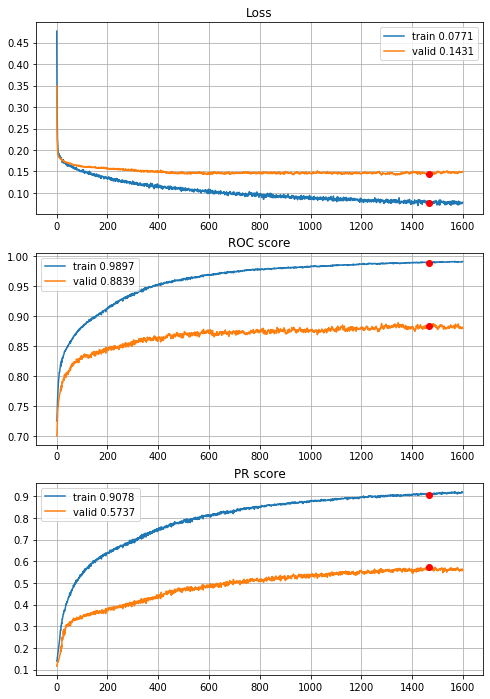


Fold 2------------------------------------------------------------


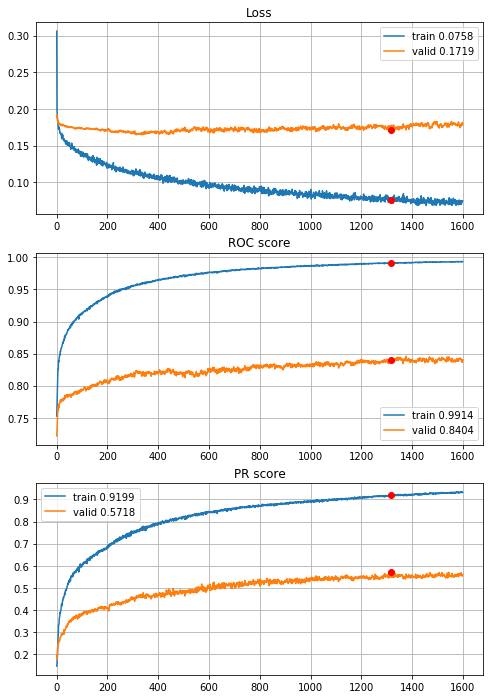


Fold 3------------------------------------------------------------


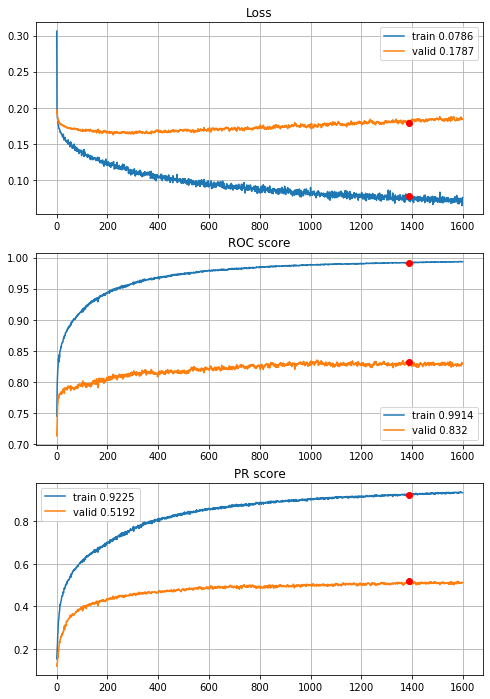


Fold 4------------------------------------------------------------


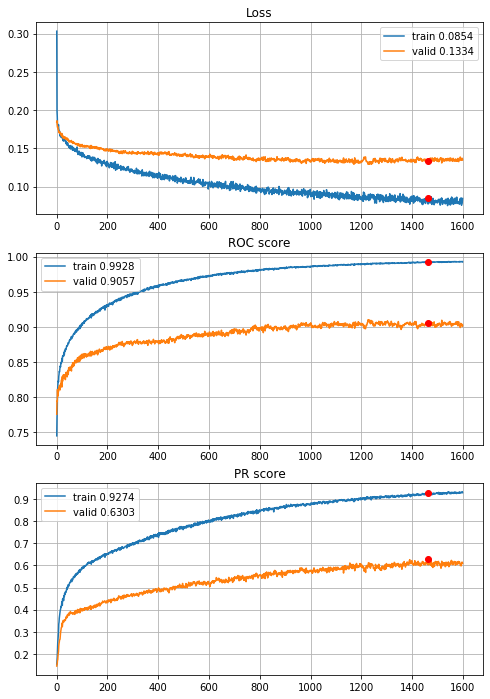


Fold 5------------------------------------------------------------


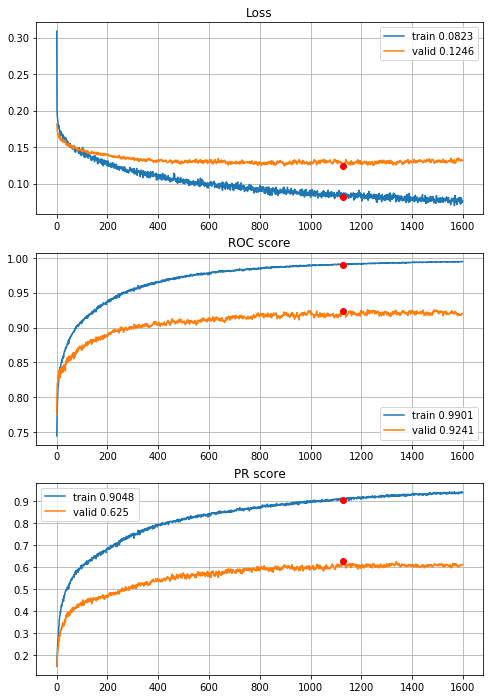


Fold 6------------------------------------------------------------


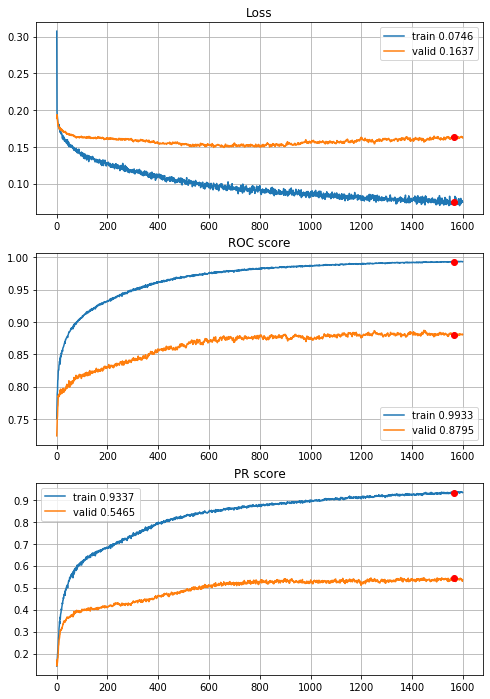

In [37]:
# two layers 1600 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=1600,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Pretty amazing results, overfitting didn't blow up, while performance increased, lets try some regularization with more epochs. 0.00005 L1 on two layers was a golden nugget in one year forecast horizon problem. Lets try it.


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/2100,
cumulative time: 3.99s train loss: 0.5191077303329573, validation loss: 0.3903923724848369
Epoch: 2/2100,
cumulative time: 4.13s train loss: 0.37270177391639414, validation loss: 0.2978062302056748
Epoch: 3/2100,
cumulative time: 4.27s train loss: 0.3031944131658007, validation loss: 0.2579112540425858
Epoch: 4/2100,
cumulative time: 4.4s train loss: 0.26354448027106214, validation loss: 0.23875917039857258
Epoch: 5/2100,
cumulative time: 4.53s train loss: 0.24892231369885473, validation loss: 0.22954408399420909
Epoch: 6/2100,
cumulative time: 4.66s train loss: 0.23935593182078244, validation loss: 0.22464803536787092
Epoch: 7/2100,
cumulative time: 4.79s train loss: 0.23007206302011887, validation loss: 0.22216553201961062
Epoch: 8/2100,
cumulative time: 4.92s train loss: 0.227963157603904, validation loss: 0.21962299391150555
Epoch: 9/2100,
cumulative time: 5.04s train loss: 0.2244315569271

Epoch: 76/2100,
cumulative time: 14.25s train loss: 0.18516258576999775, validation loss: 0.18751415827389556
Epoch: 77/2100,
cumulative time: 14.39s train loss: 0.18465849607837925, validation loss: 0.18747111848619538
Epoch: 78/2100,
cumulative time: 14.53s train loss: 0.18720203497852045, validation loss: 0.18686838056499086
Epoch: 79/2100,
cumulative time: 14.67s train loss: 0.1825536855958259, validation loss: 0.18611498692353784
Epoch: 80/2100,
cumulative time: 14.81s train loss: 0.18384534018485826, validation loss: 0.18728324424011356
Epoch: 81/2100,
cumulative time: 14.95s train loss: 0.18287957355483553, validation loss: 0.18735290767588203
Epoch: 82/2100,
cumulative time: 15.09s train loss: 0.1834437956374753, validation loss: 0.18720261417861858
Epoch: 83/2100,
cumulative time: 15.23s train loss: 0.1819490225267527, validation loss: 0.1867783676815163
Epoch: 84/2100,
cumulative time: 15.37s train loss: 0.18390299037482422, validation loss: 0.1861594774391961
Epoch: 85/2100,

Epoch: 152/2100,
cumulative time: 24.82s train loss: 0.17525687572474896, validation loss: 0.17965735988076484
Epoch: 153/2100,
cumulative time: 24.96s train loss: 0.16957168060087402, validation loss: 0.1812884982870581
Epoch: 154/2100,
cumulative time: 25.1s train loss: 0.17190363934793995, validation loss: 0.18088883355290328
Epoch: 155/2100,
cumulative time: 25.24s train loss: 0.17117706688186152, validation loss: 0.18001232819138457
Epoch: 156/2100,
cumulative time: 25.38s train loss: 0.17479367513601743, validation loss: 0.17943928128525544
Epoch: 157/2100,
cumulative time: 25.52s train loss: 0.17346657479586985, validation loss: 0.17940952690220593
Epoch: 158/2100,
cumulative time: 25.66s train loss: 0.17484039245583, validation loss: 0.18006908723170292
Epoch: 159/2100,
cumulative time: 25.8s train loss: 0.1751335064928619, validation loss: 0.1799366409637394
Epoch: 160/2100,
cumulative time: 25.94s train loss: 0.173214158533088, validation loss: 0.17959265229327084
Epoch: 161/

Epoch: 228/2100,
cumulative time: 35.38s train loss: 0.1652998492622934, validation loss: 0.17353886680346595
Epoch: 229/2100,
cumulative time: 35.52s train loss: 0.1660362700017908, validation loss: 0.1731200204709503
Epoch: 230/2100,
cumulative time: 35.65s train loss: 0.1626199535496891, validation loss: 0.17299704515382172
Epoch: 231/2100,
cumulative time: 35.79s train loss: 0.16216292045680733, validation loss: 0.17302661807541947
Epoch: 232/2100,
cumulative time: 35.93s train loss: 0.1635604240999679, validation loss: 0.17221617107289108
Epoch: 233/2100,
cumulative time: 36.07s train loss: 0.16128781750589208, validation loss: 0.1719741917958951
Epoch: 234/2100,
cumulative time: 36.21s train loss: 0.16297680275504828, validation loss: 0.1727588885673623
Epoch: 235/2100,
cumulative time: 36.35s train loss: 0.16346919544809246, validation loss: 0.1726796264405799
Epoch: 236/2100,
cumulative time: 36.49s train loss: 0.16689895669965576, validation loss: 0.1723319282939111
Epoch: 237

Epoch: 304/2100,
cumulative time: 45.93s train loss: 0.1560032344105522, validation loss: 0.16692524827849387
Epoch: 305/2100,
cumulative time: 46.07s train loss: 0.15802921655107288, validation loss: 0.16974562641874796
Epoch: 306/2100,
cumulative time: 46.21s train loss: 0.15691686518531917, validation loss: 0.16792078586035314
Epoch: 307/2100,
cumulative time: 46.34s train loss: 0.15589923752226006, validation loss: 0.1676287716692041
Epoch: 308/2100,
cumulative time: 46.48s train loss: 0.15546428273902121, validation loss: 0.16854953821659738
Epoch: 309/2100,
cumulative time: 46.62s train loss: 0.1537281629740664, validation loss: 0.16781681416958186
Epoch: 310/2100,
cumulative time: 46.76s train loss: 0.16063429869383666, validation loss: 0.16705158965534056
Epoch: 311/2100,
cumulative time: 46.9s train loss: 0.15532003258889301, validation loss: 0.16700906018930037
Epoch: 312/2100,
cumulative time: 47.04s train loss: 0.15988567189837158, validation loss: 0.16890367183902785
Epoch

Epoch: 380/2100,
cumulative time: 56.46s train loss: 0.153432685442002, validation loss: 0.16272444448923887
Epoch: 381/2100,
cumulative time: 56.63s train loss: 0.1521477031477235, validation loss: 0.1633155042415902
Epoch: 382/2100,
cumulative time: 56.75s train loss: 0.1536629918455899, validation loss: 0.16316965304523037
Epoch: 383/2100,
cumulative time: 56.89s train loss: 0.1531174321838122, validation loss: 0.16258149727458773
Epoch: 384/2100,
cumulative time: 57.04s train loss: 0.15471878263860409, validation loss: 0.1625595295952647
Epoch: 385/2100,
cumulative time: 57.18s train loss: 0.14987830188413026, validation loss: 0.16414381434837924
Epoch: 386/2100,
cumulative time: 57.32s train loss: 0.15442400604352532, validation loss: 0.16435911743270856
Epoch: 387/2100,
cumulative time: 57.46s train loss: 0.15504325242226316, validation loss: 0.164235153080169
Epoch: 388/2100,
cumulative time: 57.6s train loss: 0.15368365328878175, validation loss: 0.16562151908874512
Epoch: 389/

Epoch: 456/2100,
cumulative time: 67.31s train loss: 0.152453292924751, validation loss: 0.16135570632104893
Epoch: 457/2100,
cumulative time: 67.45s train loss: 0.14971257654495204, validation loss: 0.1616697999045831
Epoch: 458/2100,
cumulative time: 67.6s train loss: 0.15050016785169612, validation loss: 0.16336938323943773
Epoch: 459/2100,
cumulative time: 67.74s train loss: 0.1507320111995657, validation loss: 0.16283845860914278
Epoch: 460/2100,
cumulative time: 67.88s train loss: 0.15124359110809876, validation loss: 0.1604558315161055
Epoch: 461/2100,
cumulative time: 68.03s train loss: 0.1532087595459877, validation loss: 0.1595045632351167
Epoch: 462/2100,
cumulative time: 68.17s train loss: 0.14984087677664643, validation loss: 0.16027197939672788
Epoch: 463/2100,
cumulative time: 68.31s train loss: 0.15202728808778485, validation loss: 0.1599593760206068
Epoch: 464/2100,
cumulative time: 68.45s train loss: 0.15042358972096692, validation loss: 0.16003624531912755
Epoch: 465

Epoch: 532/2100,
cumulative time: 77.86s train loss: 0.14875884201713988, validation loss: 0.15931062422657272
Epoch: 533/2100,
cumulative time: 78.0s train loss: 0.1490566837768147, validation loss: 0.1608663851647575
Epoch: 534/2100,
cumulative time: 78.13s train loss: 0.148437202601801, validation loss: 0.15952075626308046
Epoch: 535/2100,
cumulative time: 78.28s train loss: 0.14989201850954753, validation loss: 0.16024875531316696
Epoch: 536/2100,
cumulative time: 78.42s train loss: 0.15034783066504173, validation loss: 0.15935937717425086
Epoch: 537/2100,
cumulative time: 78.56s train loss: 0.1505576864343548, validation loss: 0.1585859540695232
Epoch: 538/2100,
cumulative time: 78.71s train loss: 0.15032262634016685, validation loss: 0.16032456253117003
Epoch: 539/2100,
cumulative time: 78.85s train loss: 0.1464562384297798, validation loss: 0.1604892445044748
Epoch: 540/2100,
cumulative time: 78.99s train loss: 0.1456094408747969, validation loss: 0.15944187068225088
Epoch: 541/

Epoch: 608/2100,
cumulative time: 88.56s train loss: 0.1429506737140711, validation loss: 0.1594523702899642
Epoch: 609/2100,
cumulative time: 88.7s train loss: 0.14671788820632875, validation loss: 0.1620694690614107
Epoch: 610/2100,
cumulative time: 88.84s train loss: 0.14719650182828872, validation loss: 0.1609438279601812
Epoch: 611/2100,
cumulative time: 88.98s train loss: 0.15013850299405837, validation loss: 0.16070437704202187
Epoch: 612/2100,
cumulative time: 89.13s train loss: 0.14506191174239305, validation loss: 0.15971893955648472
Epoch: 613/2100,
cumulative time: 89.27s train loss: 0.1454151678806541, validation loss: 0.1591737996343044
Epoch: 614/2100,
cumulative time: 89.41s train loss: 0.14757095534624853, validation loss: 0.15995862098110217
Epoch: 615/2100,
cumulative time: 89.55s train loss: 0.1442218705875809, validation loss: 0.15979801913643468
Epoch: 616/2100,
cumulative time: 89.69s train loss: 0.1488007586487434, validation loss: 0.16056934505234452
Epoch: 617

Epoch: 684/2100,
cumulative time: 99.48s train loss: 0.1486741859837707, validation loss: 0.15816468730761618
Epoch: 685/2100,
cumulative time: 99.62s train loss: 0.14939149521391706, validation loss: 0.15942684396178322
Epoch: 686/2100,
cumulative time: 99.76s train loss: 0.14708295089094903, validation loss: 0.15976846983961868
Epoch: 687/2100,
cumulative time: 99.9s train loss: 0.14631785570471226, validation loss: 0.1593080647568706
Epoch: 688/2100,
cumulative time: 100.05s train loss: 0.14879795757744954, validation loss: 0.15866799869652587
Epoch: 689/2100,
cumulative time: 100.19s train loss: 0.14264518965147796, validation loss: 0.16011830092166215
Epoch: 690/2100,
cumulative time: 100.33s train loss: 0.14481086900322537, validation loss: 0.16033287196235643
Epoch: 691/2100,
cumulative time: 100.47s train loss: 0.1476021568476951, validation loss: 0.1601660357315253
Epoch: 692/2100,
cumulative time: 100.61s train loss: 0.14595739579356595, validation loss: 0.15918409554547724
E

Epoch: 758/2100,
cumulative time: 109.99s train loss: 0.14235947863633214, validation loss: 0.15991519402694832
Epoch: 759/2100,
cumulative time: 110.13s train loss: 0.147086305606435, validation loss: 0.15909952645483594
Epoch: 760/2100,
cumulative time: 110.28s train loss: 0.14741139526662977, validation loss: 0.15987891208322133
Epoch: 761/2100,
cumulative time: 110.42s train loss: 0.1442941652909459, validation loss: 0.15802700391547708
Epoch: 762/2100,
cumulative time: 110.56s train loss: 0.14637852147126187, validation loss: 0.15948391742776089
Epoch: 763/2100,
cumulative time: 110.7s train loss: 0.1420986267659282, validation loss: 0.16056886012047794
Epoch: 764/2100,
cumulative time: 110.84s train loss: 0.1471343286295897, validation loss: 0.1593720541672288
Epoch: 765/2100,
cumulative time: 110.98s train loss: 0.14761126044862166, validation loss: 0.15909142725276168
Epoch: 766/2100,
cumulative time: 111.12s train loss: 0.14403954577286887, validation loss: 0.15876671831124164

Epoch: 832/2100,
cumulative time: 120.52s train loss: 0.1451839242735757, validation loss: 0.16015654848983615
Epoch: 833/2100,
cumulative time: 120.67s train loss: 0.14422877686891927, validation loss: 0.16003682109837308
Epoch: 834/2100,
cumulative time: 120.81s train loss: 0.14730436233218938, validation loss: 0.159634092780828
Epoch: 835/2100,
cumulative time: 120.95s train loss: 0.1453840236369651, validation loss: 0.16026104689455908
Epoch: 836/2100,
cumulative time: 121.09s train loss: 0.14425292828866187, validation loss: 0.15892066477390274
Epoch: 837/2100,
cumulative time: 121.23s train loss: 0.14313254233368017, validation loss: 0.16018455843279522
Epoch: 838/2100,
cumulative time: 121.37s train loss: 0.1463009249254093, validation loss: 0.16129688615292576
Epoch: 839/2100,
cumulative time: 121.51s train loss: 0.14205442784585176, validation loss: 0.1608638096679385
Epoch: 840/2100,
cumulative time: 121.65s train loss: 0.14526509165248414, validation loss: 0.1602897732090674

Epoch: 906/2100,
cumulative time: 131.0s train loss: 0.14402233712130633, validation loss: 0.15927915739680407
Epoch: 907/2100,
cumulative time: 131.14s train loss: 0.14717115973413242, validation loss: 0.16105244394424742
Epoch: 908/2100,
cumulative time: 131.28s train loss: 0.14300646867192637, validation loss: 0.16101865964409767
Epoch: 909/2100,
cumulative time: 131.43s train loss: 0.14346667137958366, validation loss: 0.15923840869560463
Epoch: 910/2100,
cumulative time: 131.57s train loss: 0.14178857012688262, validation loss: 0.16033218674224764
Epoch: 911/2100,
cumulative time: 131.71s train loss: 0.14138737588158976, validation loss: 0.16126583246774134
Epoch: 912/2100,
cumulative time: 131.86s train loss: 0.1418146742846455, validation loss: 0.16067201270385206
Epoch: 913/2100,
cumulative time: 132.0s train loss: 0.14283751052653743, validation loss: 0.1610166972149303
Epoch: 914/2100,
cumulative time: 132.14s train loss: 0.1445940548634474, validation loss: 0.160479198200431

Epoch: 980/2100,
cumulative time: 141.55s train loss: 0.14401938829047956, validation loss: 0.16152409835889114
Epoch: 981/2100,
cumulative time: 141.69s train loss: 0.142102448322233, validation loss: 0.16067559240098062
Epoch: 982/2100,
cumulative time: 141.84s train loss: 0.1380591809579142, validation loss: 0.16000955884070361
Epoch: 983/2100,
cumulative time: 141.98s train loss: 0.14380988237579562, validation loss: 0.15946440973843418
Epoch: 984/2100,
cumulative time: 142.13s train loss: 0.13782715139829152, validation loss: 0.1615157382901304
Epoch: 985/2100,
cumulative time: 142.27s train loss: 0.1419142507393094, validation loss: 0.15978655868277736
Epoch: 986/2100,
cumulative time: 142.41s train loss: 0.14439525893058242, validation loss: 0.1598315805683662
Epoch: 987/2100,
cumulative time: 142.56s train loss: 0.14429712059118596, validation loss: 0.15928901197392573
Epoch: 988/2100,
cumulative time: 142.7s train loss: 0.14075706501828866, validation loss: 0.15870915577474948

Epoch: 1054/2100,
cumulative time: 152.07s train loss: 0.14046450843444785, validation loss: 0.1600828276778501
Epoch: 1055/2100,
cumulative time: 152.21s train loss: 0.1421183212692595, validation loss: 0.16059357309276512
Epoch: 1056/2100,
cumulative time: 152.36s train loss: 0.1451481009364112, validation loss: 0.1591793654766758
Epoch: 1057/2100,
cumulative time: 152.5s train loss: 0.13682190693501928, validation loss: 0.16095068794152134
Epoch: 1058/2100,
cumulative time: 152.64s train loss: 0.13613432709314868, validation loss: 0.15908227183325424
Epoch: 1059/2100,
cumulative time: 152.78s train loss: 0.1399630854215996, validation loss: 0.159690389063506
Epoch: 1060/2100,
cumulative time: 152.92s train loss: 0.13867227590678255, validation loss: 0.15700440217314163
Epoch: 1061/2100,
cumulative time: 153.06s train loss: 0.14128531885337037, validation loss: 0.15876759118048653
Epoch: 1062/2100,
cumulative time: 153.2s train loss: 0.14020371070175036, validation loss: 0.1578128374

Epoch: 1128/2100,
cumulative time: 162.58s train loss: 0.1393425949318653, validation loss: 0.15839158158833028
Epoch: 1129/2100,
cumulative time: 162.72s train loss: 0.1348518812614193, validation loss: 0.15960569777117042
Epoch: 1130/2100,
cumulative time: 162.86s train loss: 0.13701963961229943, validation loss: 0.15898755081175459
Epoch: 1131/2100,
cumulative time: 162.98s train loss: 0.14097020169231753, validation loss: 0.15926526151115672
Epoch: 1132/2100,
cumulative time: 163.12s train loss: 0.13997495398848708, validation loss: 0.16088189275959383
Epoch: 1133/2100,
cumulative time: 163.26s train loss: 0.13951401019817183, validation loss: 0.15754477779138162
Epoch: 1134/2100,
cumulative time: 163.4s train loss: 0.1412522342432979, validation loss: 0.1568407620740148
Epoch: 1135/2100,
cumulative time: 163.54s train loss: 0.14121950796526167, validation loss: 0.15675324767604826
Epoch: 1136/2100,
cumulative time: 163.68s train loss: 0.1378077077521431, validation loss: 0.1577086

Epoch: 1202/2100,
cumulative time: 173.11s train loss: 0.13321164747045391, validation loss: 0.15816739052432666
Epoch: 1203/2100,
cumulative time: 173.25s train loss: 0.14194803782254883, validation loss: 0.15731189534362275
Epoch: 1204/2100,
cumulative time: 173.39s train loss: 0.14094758725947196, validation loss: 0.15654161356394594
Epoch: 1205/2100,
cumulative time: 173.54s train loss: 0.13813517455036464, validation loss: 0.15813295639559394
Epoch: 1206/2100,
cumulative time: 173.68s train loss: 0.13860476536905345, validation loss: 0.1569059993272902
Epoch: 1207/2100,
cumulative time: 173.83s train loss: 0.1395576691657536, validation loss: 0.15672587910178895
Epoch: 1208/2100,
cumulative time: 173.97s train loss: 0.14050799850123333, validation loss: 0.157981520540216
Epoch: 1209/2100,
cumulative time: 174.12s train loss: 0.13460738009447365, validation loss: 0.15808385369159317
Epoch: 1210/2100,
cumulative time: 174.27s train loss: 0.1389040866234834, validation loss: 0.158591

Epoch: 1276/2100,
cumulative time: 183.73s train loss: 0.13966476408926812, validation loss: 0.1568563506463663
Epoch: 1277/2100,
cumulative time: 183.87s train loss: 0.1388781591022143, validation loss: 0.15773780014013417
Epoch: 1278/2100,
cumulative time: 184.01s train loss: 0.138939577049672, validation loss: 0.15732028974895984
Epoch: 1279/2100,
cumulative time: 184.15s train loss: 0.14058200535877483, validation loss: 0.15813917539369662
Epoch: 1280/2100,
cumulative time: 184.29s train loss: 0.13964044324009617, validation loss: 0.15660451936875985
Epoch: 1281/2100,
cumulative time: 184.43s train loss: 0.1400852434953032, validation loss: 0.15704589565851965
Epoch: 1282/2100,
cumulative time: 184.59s train loss: 0.13687597478376037, validation loss: 0.1567630460568234
Epoch: 1283/2100,
cumulative time: 184.73s train loss: 0.1432294719277327, validation loss: 0.15762194447407032
Epoch: 1284/2100,
cumulative time: 184.88s train loss: 0.13893599913739774, validation loss: 0.15731554

Epoch: 1350/2100,
cumulative time: 194.34s train loss: 0.14096868731792755, validation loss: 0.15781161576570338
Epoch: 1351/2100,
cumulative time: 194.5s train loss: 0.13696880337248118, validation loss: 0.15938763745468923
Epoch: 1352/2100,
cumulative time: 194.64s train loss: 0.13558143342907417, validation loss: 0.15710006248512748
Epoch: 1353/2100,
cumulative time: 194.82s train loss: 0.13866783415331238, validation loss: 0.1580062571068537
Epoch: 1354/2100,
cumulative time: 194.97s train loss: 0.13707773156091724, validation loss: 0.15710553410225292
Epoch: 1355/2100,
cumulative time: 195.1s train loss: 0.13447264530475922, validation loss: 0.15904436928427407
Epoch: 1356/2100,
cumulative time: 195.22s train loss: 0.13556341418417342, validation loss: 0.15802585693181495
Epoch: 1357/2100,
cumulative time: 195.35s train loss: 0.13724274506778983, validation loss: 0.15615865712956234
Epoch: 1358/2100,
cumulative time: 195.49s train loss: 0.13701085060891705, validation loss: 0.1562

Epoch: 1424/2100,
cumulative time: 204.67s train loss: 0.13950398002425088, validation loss: 0.15673952440650712
Epoch: 1425/2100,
cumulative time: 204.82s train loss: 0.13783686907702467, validation loss: 0.15663179575666591
Epoch: 1426/2100,
cumulative time: 204.96s train loss: 0.13498890120396576, validation loss: 0.15934876105548412
Epoch: 1427/2100,
cumulative time: 205.09s train loss: 0.1411633359347704, validation loss: 0.15716383086328525
Epoch: 1428/2100,
cumulative time: 205.22s train loss: 0.13746788841282234, validation loss: 0.15525573638120096
Epoch: 1429/2100,
cumulative time: 205.36s train loss: 0.13918773303942023, validation loss: 0.15555080032981602
Epoch: 1430/2100,
cumulative time: 205.5s train loss: 0.13819076317898604, validation loss: 0.1564333294832114
Epoch: 1431/2100,
cumulative time: 205.65s train loss: 0.13505153622197696, validation loss: 0.1570401352794094
Epoch: 1432/2100,
cumulative time: 205.79s train loss: 0.13529913261762094, validation loss: 0.15570

Epoch: 1498/2100,
cumulative time: 215.19s train loss: 0.13727084564225933, validation loss: 0.15654622845052454
Epoch: 1499/2100,
cumulative time: 215.33s train loss: 0.13365489091959049, validation loss: 0.1558210779668686
Epoch: 1500/2100,
cumulative time: 215.47s train loss: 0.1315892526970464, validation loss: 0.15754524889732396
Epoch: 1501/2100,
cumulative time: 215.61s train loss: 0.13602292223046006, validation loss: 0.15648923176255172
Epoch: 1502/2100,
cumulative time: 215.76s train loss: 0.1340126504848394, validation loss: 0.15601230966062915
Epoch: 1503/2100,
cumulative time: 215.9s train loss: 0.13160743511808384, validation loss: 0.15613373949707893
Epoch: 1504/2100,
cumulative time: 216.04s train loss: 0.13259500758647594, validation loss: 0.1583154418989458
Epoch: 1505/2100,
cumulative time: 216.18s train loss: 0.1356960651095047, validation loss: 0.15749438974303887
Epoch: 1506/2100,
cumulative time: 216.33s train loss: 0.1334178733246115, validation loss: 0.15849714

Epoch: 1572/2100,
cumulative time: 225.72s train loss: 0.13756093520726428, validation loss: 0.1555045951966772
Epoch: 1573/2100,
cumulative time: 225.86s train loss: 0.13500335263033808, validation loss: 0.15632637168697308
Epoch: 1574/2100,
cumulative time: 226.0s train loss: 0.13479119275248735, validation loss: 0.15709934456158528
Epoch: 1575/2100,
cumulative time: 226.14s train loss: 0.137902076363596, validation loss: 0.1557437432226151
Epoch: 1576/2100,
cumulative time: 226.29s train loss: 0.13222742082616312, validation loss: 0.15809516942444263
Epoch: 1577/2100,
cumulative time: 226.43s train loss: 0.13219513424602303, validation loss: 0.15932775626099782
Epoch: 1578/2100,
cumulative time: 226.57s train loss: 0.13527818519105123, validation loss: 0.15528262205234264
Epoch: 1579/2100,
cumulative time: 226.71s train loss: 0.1356105790522351, validation loss: 0.15744757514327784
Epoch: 1580/2100,
cumulative time: 226.86s train loss: 0.13395964226126264, validation loss: 0.1565758

Epoch: 1646/2100,
cumulative time: 236.26s train loss: 0.13460538250280144, validation loss: 0.1556870218155902
Epoch: 1647/2100,
cumulative time: 236.39s train loss: 0.13234486682009472, validation loss: 0.15676142282434025
Epoch: 1648/2100,
cumulative time: 236.53s train loss: 0.13889308314581228, validation loss: 0.15743535737791703
Epoch: 1649/2100,
cumulative time: 236.67s train loss: 0.1324817404124582, validation loss: 0.15710528417052338
Epoch: 1650/2100,
cumulative time: 236.84s train loss: 0.13323328286981642, validation loss: 0.1566338966276631
Epoch: 1651/2100,
cumulative time: 237.01s train loss: 0.13471124792324657, validation loss: 0.1583490033308773
Epoch: 1652/2100,
cumulative time: 237.13s train loss: 0.13157602125124598, validation loss: 0.15690983381500206
Epoch: 1653/2100,
cumulative time: 237.27s train loss: 0.13395202568988782, validation loss: 0.15574808563806314
Epoch: 1654/2100,
cumulative time: 237.42s train loss: 0.13717450136776663, validation loss: 0.15545

Epoch: 1720/2100,
cumulative time: 246.86s train loss: 0.12720023221018592, validation loss: 0.1554904364155944
Epoch: 1721/2100,
cumulative time: 247.03s train loss: 0.13246388851898203, validation loss: 0.15656256208093577
Epoch: 1722/2100,
cumulative time: 247.17s train loss: 0.12987449689816832, validation loss: 0.15604649393878234
Epoch: 1723/2100,
cumulative time: 247.31s train loss: 0.13256353108930471, validation loss: 0.15511419123496387
Epoch: 1724/2100,
cumulative time: 247.45s train loss: 0.1353852052576906, validation loss: 0.1573117920092939
Epoch: 1725/2100,
cumulative time: 247.59s train loss: 0.1344825576239494, validation loss: 0.15572919704177252
Epoch: 1726/2100,
cumulative time: 247.74s train loss: 0.1317482784575116, validation loss: 0.1574958410390467
Epoch: 1727/2100,
cumulative time: 247.88s train loss: 0.1332880062367308, validation loss: 0.15509532364636883
Epoch: 1728/2100,
cumulative time: 248.02s train loss: 0.12951049016263266, validation loss: 0.15832705

Epoch: 1794/2100,
cumulative time: 257.43s train loss: 0.1349197946073865, validation loss: 0.1572715573322213
Epoch: 1795/2100,
cumulative time: 257.57s train loss: 0.1288021231958234, validation loss: 0.15642455431212365
Epoch: 1796/2100,
cumulative time: 257.71s train loss: 0.12824867994615985, validation loss: 0.1565155114058007
Epoch: 1797/2100,
cumulative time: 257.84s train loss: 0.13188675883662776, validation loss: 0.15481890237923784
Epoch: 1798/2100,
cumulative time: 257.99s train loss: 0.13158623530423788, validation loss: 0.15636249666639215
Epoch: 1799/2100,
cumulative time: 258.13s train loss: 0.1310973536843632, validation loss: 0.15463996455935575
Epoch: 1800/2100,
cumulative time: 258.27s train loss: 0.1330779173280666, validation loss: 0.15341956181092845
Epoch: 1801/2100,
cumulative time: 258.41s train loss: 0.13146851011900068, validation loss: 0.1528447521958244
Epoch: 1802/2100,
cumulative time: 258.55s train loss: 0.1289058129442545, validation loss: 0.154400557

Epoch: 1868/2100,
cumulative time: 267.96s train loss: 0.13247407172050266, validation loss: 0.15748083617834918
Epoch: 1869/2100,
cumulative time: 268.11s train loss: 0.13414270482854884, validation loss: 0.15498208084668003
Epoch: 1870/2100,
cumulative time: 268.25s train loss: 0.130067612601937, validation loss: 0.1542588514665749
Epoch: 1871/2100,
cumulative time: 268.41s train loss: 0.12992833576052387, validation loss: 0.1543390147129316
Epoch: 1872/2100,
cumulative time: 268.55s train loss: 0.13021814213142593, validation loss: 0.15508648380890763
Epoch: 1873/2100,
cumulative time: 268.7s train loss: 0.1269401519735746, validation loss: 0.15437103735905588
Epoch: 1874/2100,
cumulative time: 268.84s train loss: 0.1301894850149217, validation loss: 0.15589993545966865
Epoch: 1875/2100,
cumulative time: 268.99s train loss: 0.13432004527079383, validation loss: 0.15425373863370503
Epoch: 1876/2100,
cumulative time: 269.13s train loss: 0.13074177988588884, validation loss: 0.15573596

Epoch: 1942/2100,
cumulative time: 278.5s train loss: 0.12771222203154176, validation loss: 0.15448606942404364
Epoch: 1943/2100,
cumulative time: 278.65s train loss: 0.1263877509011408, validation loss: 0.15530659826415344
Epoch: 1944/2100,
cumulative time: 278.79s train loss: 0.1289065717082168, validation loss: 0.15463510806906214
Epoch: 1945/2100,
cumulative time: 278.93s train loss: 0.1302052786274192, validation loss: 0.15394132824232987
Epoch: 1946/2100,
cumulative time: 279.08s train loss: 0.13360152339904457, validation loss: 0.15446809179690357
Epoch: 1947/2100,
cumulative time: 279.22s train loss: 0.13132830829455094, validation loss: 0.15353872416537176
Epoch: 1948/2100,
cumulative time: 279.37s train loss: 0.13222924643554465, validation loss: 0.15335461950732218
Epoch: 1949/2100,
cumulative time: 279.51s train loss: 0.12704329491351585, validation loss: 0.1536635164097915
Epoch: 1950/2100,
cumulative time: 279.65s train loss: 0.12475948898068699, validation loss: 0.153897

Epoch: 2016/2100,
cumulative time: 289.09s train loss: 0.1274031440850566, validation loss: 0.15356053001138936
Epoch: 2017/2100,
cumulative time: 289.23s train loss: 0.1302128045854071, validation loss: 0.15244539911808652
Epoch: 2018/2100,
cumulative time: 289.37s train loss: 0.12920422553021754, validation loss: 0.15367245916568803
Epoch: 2019/2100,
cumulative time: 289.51s train loss: 0.1239729213713382, validation loss: 0.1518323235441991
Epoch: 2020/2100,
cumulative time: 289.65s train loss: 0.1274355899044884, validation loss: 0.15608958617978716
Epoch: 2021/2100,
cumulative time: 289.79s train loss: 0.1284720919327208, validation loss: 0.15436691432237787
Epoch: 2022/2100,
cumulative time: 289.94s train loss: 0.1293192519270463, validation loss: 0.15510052751934877
Epoch: 2023/2100,
cumulative time: 290.08s train loss: 0.1286439737131286, validation loss: 0.15376094320422537
Epoch: 2024/2100,
cumulative time: 290.22s train loss: 0.1254213005994299, validation loss: 0.1536094790

Epoch: 2090/2100,
cumulative time: 299.52s train loss: 0.13061073250347174, validation loss: 0.15443674367938096
Epoch: 2091/2100,
cumulative time: 299.65s train loss: 0.12934236728080073, validation loss: 0.1578621094611488
Epoch: 2092/2100,
cumulative time: 299.79s train loss: 0.1277386078137428, validation loss: 0.1546981887317499
Epoch: 2093/2100,
cumulative time: 299.93s train loss: 0.12586719273351996, validation loss: 0.15642802348300824
Epoch: 2094/2100,
cumulative time: 300.07s train loss: 0.13030872832977136, validation loss: 0.15442631708634313
Epoch: 2095/2100,
cumulative time: 300.21s train loss: 0.12922037299405353, validation loss: 0.15432465333083278
Epoch: 2096/2100,
cumulative time: 300.35s train loss: 0.13218839421927173, validation loss: 0.15413154263006254
Epoch: 2097/2100,
cumulative time: 300.49s train loss: 0.1310473447491813, validation loss: 0.15383651366722348
Epoch: 2098/2100,
cumulative time: 300.63s train loss: 0.13002126845241355, validation loss: 0.15662

Epoch: 63/2100,
cumulative time: 12.65s train loss: 0.1770388123942188, validation loss: 0.1950078099215412
Epoch: 64/2100,
cumulative time: 12.79s train loss: 0.1782633002579058, validation loss: 0.19493442037383094
Epoch: 65/2100,
cumulative time: 12.93s train loss: 0.17668881560847657, validation loss: 0.1942677390137199
Epoch: 66/2100,
cumulative time: 13.07s train loss: 0.17644369764750423, validation loss: 0.1939420180612068
Epoch: 67/2100,
cumulative time: 13.21s train loss: 0.1758940008304172, validation loss: 0.19377554499672903
Epoch: 68/2100,
cumulative time: 13.35s train loss: 0.1768575555745253, validation loss: 0.19403366078074244
Epoch: 69/2100,
cumulative time: 13.49s train loss: 0.1814103828684504, validation loss: 0.1941241533010488
Epoch: 70/2100,
cumulative time: 13.64s train loss: 0.17609457233516101, validation loss: 0.19329470370682508
Epoch: 71/2100,
cumulative time: 13.78s train loss: 0.1766328887297869, validation loss: 0.19351618615764596
Epoch: 72/2100,
cumu

Epoch: 139/2100,
cumulative time: 22.98s train loss: 0.16589317540495463, validation loss: 0.18875339130222432
Epoch: 140/2100,
cumulative time: 23.11s train loss: 0.16451209926822766, validation loss: 0.18873577015670973
Epoch: 141/2100,
cumulative time: 23.25s train loss: 0.1663460976118355, validation loss: 0.18828292195086094
Epoch: 142/2100,
cumulative time: 23.39s train loss: 0.1638996715415292, validation loss: 0.18845022735017916
Epoch: 143/2100,
cumulative time: 23.52s train loss: 0.16795479759409562, validation loss: 0.18866340148562555
Epoch: 144/2100,
cumulative time: 23.66s train loss: 0.16845192810251394, validation loss: 0.18811266999653686
Epoch: 145/2100,
cumulative time: 23.8s train loss: 0.16479301895024454, validation loss: 0.1878383963123481
Epoch: 146/2100,
cumulative time: 23.94s train loss: 0.1661009344217905, validation loss: 0.18787276042895384
Epoch: 147/2100,
cumulative time: 24.07s train loss: 0.16614093481642048, validation loss: 0.18807199285945736
Epoch:

Epoch: 215/2100,
cumulative time: 33.59s train loss: 0.15557716807966154, validation loss: 0.1839207553737743
Epoch: 216/2100,
cumulative time: 33.73s train loss: 0.15687463348435882, validation loss: 0.1842353742207046
Epoch: 217/2100,
cumulative time: 33.88s train loss: 0.1590285976580341, validation loss: 0.18387844945558324
Epoch: 218/2100,
cumulative time: 34.01s train loss: 0.15482370974045756, validation loss: 0.18307015349501407
Epoch: 219/2100,
cumulative time: 34.15s train loss: 0.15739252619079036, validation loss: 0.18364712489430315
Epoch: 220/2100,
cumulative time: 34.3s train loss: 0.15945368031544369, validation loss: 0.18419733390952553
Epoch: 221/2100,
cumulative time: 34.44s train loss: 0.15627204353350246, validation loss: 0.18445865971202993
Epoch: 222/2100,
cumulative time: 34.57s train loss: 0.15812203691503454, validation loss: 0.18305204468896552
Epoch: 223/2100,
cumulative time: 34.71s train loss: 0.1566966099183371, validation loss: 0.18344466509950494
Epoch:

Epoch: 291/2100,
cumulative time: 44.01s train loss: 0.15101582933499869, validation loss: 0.18270303510824298
Epoch: 292/2100,
cumulative time: 44.14s train loss: 0.1517826416674937, validation loss: 0.1828325085083265
Epoch: 293/2100,
cumulative time: 44.28s train loss: 0.1547713916945097, validation loss: 0.18217572823440728
Epoch: 294/2100,
cumulative time: 44.4s train loss: 0.15332839329033607, validation loss: 0.18188607386377412
Epoch: 295/2100,
cumulative time: 44.55s train loss: 0.15186775211829767, validation loss: 0.1838936120819445
Epoch: 296/2100,
cumulative time: 44.68s train loss: 0.1537756906913896, validation loss: 0.18280478406106637
Epoch: 297/2100,
cumulative time: 44.82s train loss: 0.15637762728283552, validation loss: 0.1822607095161208
Epoch: 298/2100,
cumulative time: 44.96s train loss: 0.15572375596283924, validation loss: 0.18307202985450635
Epoch: 299/2100,
cumulative time: 45.09s train loss: 0.15296986545486183, validation loss: 0.18414488184241068
Epoch: 3

Epoch: 367/2100,
cumulative time: 54.67s train loss: 0.15182276840643744, validation loss: 0.18338422722723957
Epoch: 368/2100,
cumulative time: 54.8s train loss: 0.1485835943063111, validation loss: 0.18162096114772125
Epoch: 369/2100,
cumulative time: 54.94s train loss: 0.14869441489351554, validation loss: 0.18278369829920865
Epoch: 370/2100,
cumulative time: 55.09s train loss: 0.14626272278822006, validation loss: 0.18237123707876146
Epoch: 371/2100,
cumulative time: 55.23s train loss: 0.1501630513573576, validation loss: 0.18188378138758035
Epoch: 372/2100,
cumulative time: 55.38s train loss: 0.14853089195935518, validation loss: 0.18302151641933345
Epoch: 373/2100,
cumulative time: 55.52s train loss: 0.1487504510216828, validation loss: 0.1841305446227121
Epoch: 374/2100,
cumulative time: 55.66s train loss: 0.14981543947780845, validation loss: 0.18138350202487066
Epoch: 375/2100,
cumulative time: 55.81s train loss: 0.14706214879686755, validation loss: 0.1831684836406461
Epoch: 

Epoch: 443/2100,
cumulative time: 65.45s train loss: 0.1458152414350407, validation loss: 0.18072050705379658
Epoch: 444/2100,
cumulative time: 65.59s train loss: 0.14670498088158462, validation loss: 0.1811801751630496
Epoch: 445/2100,
cumulative time: 65.73s train loss: 0.14937867151973327, validation loss: 0.18095133919712636
Epoch: 446/2100,
cumulative time: 65.87s train loss: 0.1485470288434276, validation loss: 0.1805266909772965
Epoch: 447/2100,
cumulative time: 66.01s train loss: 0.14541933253807252, validation loss: 0.17958623049127723
Epoch: 448/2100,
cumulative time: 66.15s train loss: 0.14914241483470295, validation loss: 0.18148874726280864
Epoch: 449/2100,
cumulative time: 66.3s train loss: 0.145608783034088, validation loss: 0.1806596837699454
Epoch: 450/2100,
cumulative time: 66.46s train loss: 0.15134524788297068, validation loss: 0.1800053857413987
Epoch: 451/2100,
cumulative time: 66.59s train loss: 0.14760291676632994, validation loss: 0.18283415978826414
Epoch: 452

Epoch: 519/2100,
cumulative time: 76.21s train loss: 0.146252681771741, validation loss: 0.1795892385579519
Epoch: 520/2100,
cumulative time: 76.35s train loss: 0.14681915298406653, validation loss: 0.1828719690655104
Epoch: 521/2100,
cumulative time: 76.49s train loss: 0.14563316427222978, validation loss: 0.17997368410422415
Epoch: 522/2100,
cumulative time: 76.63s train loss: 0.14646791724682698, validation loss: 0.1810879932628999
Epoch: 523/2100,
cumulative time: 76.77s train loss: 0.14397127711649538, validation loss: 0.17812321501941888
Epoch: 524/2100,
cumulative time: 76.91s train loss: 0.14577444390844424, validation loss: 0.17909696876718692
Epoch: 525/2100,
cumulative time: 77.06s train loss: 0.14526304761212902, validation loss: 0.17922794680923243
Epoch: 526/2100,
cumulative time: 77.2s train loss: 0.14505235547836284, validation loss: 0.17870683643467333
Epoch: 527/2100,
cumulative time: 77.33s train loss: 0.1453614541815588, validation loss: 0.17967693653741282
Epoch: 5

Epoch: 595/2100,
cumulative time: 87.01s train loss: 0.1444535978035967, validation loss: 0.1803697613508544
Epoch: 596/2100,
cumulative time: 87.14s train loss: 0.14018938131249928, validation loss: 0.18131697594794877
Epoch: 597/2100,
cumulative time: 87.28s train loss: 0.1431100954480868, validation loss: 0.1809473784705098
Epoch: 598/2100,
cumulative time: 87.41s train loss: 0.1429770974015956, validation loss: 0.18203309467449083
Epoch: 599/2100,
cumulative time: 87.55s train loss: 0.14564014005308723, validation loss: 0.18124714098145475
Epoch: 600/2100,
cumulative time: 87.68s train loss: 0.1439070979897534, validation loss: 0.18249517569662033
Epoch: 601/2100,
cumulative time: 87.82s train loss: 0.14253248146277397, validation loss: 0.18327312044662386
Epoch: 602/2100,
cumulative time: 87.95s train loss: 0.14053881199616722, validation loss: 0.18035263492592019
Epoch: 603/2100,
cumulative time: 88.09s train loss: 0.14416484473049682, validation loss: 0.1822598490121009
Epoch: 6

Epoch: 671/2100,
cumulative time: 97.83s train loss: 0.14494188864103183, validation loss: 0.1823401334254899
Epoch: 672/2100,
cumulative time: 97.97s train loss: 0.138865422048045, validation loss: 0.1830872032839559
Epoch: 673/2100,
cumulative time: 98.11s train loss: 0.1449758588180025, validation loss: 0.18337737903293092
Epoch: 674/2100,
cumulative time: 98.26s train loss: 0.1405190431859015, validation loss: 0.18244253602094437
Epoch: 675/2100,
cumulative time: 98.4s train loss: 0.14155822384447553, validation loss: 0.18158014893653524
Epoch: 676/2100,
cumulative time: 98.54s train loss: 0.1409077414387694, validation loss: 0.18220430241303026
Epoch: 677/2100,
cumulative time: 98.68s train loss: 0.1404644579931142, validation loss: 0.18226400957049116
Epoch: 678/2100,
cumulative time: 98.82s train loss: 0.1410092990518217, validation loss: 0.18058754756306206
Epoch: 679/2100,
cumulative time: 98.96s train loss: 0.14030185212162655, validation loss: 0.18149294958299647
Epoch: 680/

Epoch: 745/2100,
cumulative time: 108.28s train loss: 0.144337945781221, validation loss: 0.18102996711669284
Epoch: 746/2100,
cumulative time: 108.43s train loss: 0.14135747405037186, validation loss: 0.1829830690701045
Epoch: 747/2100,
cumulative time: 108.57s train loss: 0.14016915193195648, validation loss: 0.18008790885899
Epoch: 748/2100,
cumulative time: 108.71s train loss: 0.13692096840267073, validation loss: 0.17969943865007734
Epoch: 749/2100,
cumulative time: 108.85s train loss: 0.14029434332442708, validation loss: 0.18157902792085995
Epoch: 750/2100,
cumulative time: 109.0s train loss: 0.14029648256337596, validation loss: 0.1791741483121441
Epoch: 751/2100,
cumulative time: 109.14s train loss: 0.14087220492308428, validation loss: 0.17938790852273703
Epoch: 752/2100,
cumulative time: 109.28s train loss: 0.14026165503897428, validation loss: 0.18116377903702635
Epoch: 753/2100,
cumulative time: 109.42s train loss: 0.1407770957667383, validation loss: 0.1803719861987012
Ep

Epoch: 819/2100,
cumulative time: 118.81s train loss: 0.13919916163141197, validation loss: 0.1802123099606081
Epoch: 820/2100,
cumulative time: 118.94s train loss: 0.1398685691744012, validation loss: 0.18034197658888737
Epoch: 821/2100,
cumulative time: 119.11s train loss: 0.13690518124233747, validation loss: 0.18194147739546732
Epoch: 822/2100,
cumulative time: 119.27s train loss: 0.1360006645234586, validation loss: 0.17993671843151887
Epoch: 823/2100,
cumulative time: 119.4s train loss: 0.14247915539578523, validation loss: 0.17908317877209212
Epoch: 824/2100,
cumulative time: 119.54s train loss: 0.1420405596316096, validation loss: 0.1810907284831254
Epoch: 825/2100,
cumulative time: 119.68s train loss: 0.1379666407897624, validation loss: 0.1783138995392944
Epoch: 826/2100,
cumulative time: 119.82s train loss: 0.14078812443007083, validation loss: 0.17855101381539487
Epoch: 827/2100,
cumulative time: 119.96s train loss: 0.13819475922884222, validation loss: 0.18024776659910982


Epoch: 893/2100,
cumulative time: 129.37s train loss: 0.13697793574484496, validation loss: 0.17981869132442488
Epoch: 894/2100,
cumulative time: 129.51s train loss: 0.13727529377788286, validation loss: 0.18024504251671616
Epoch: 895/2100,
cumulative time: 129.65s train loss: 0.13462956457717307, validation loss: 0.18216822502806204
Epoch: 896/2100,
cumulative time: 129.79s train loss: 0.1373829869699303, validation loss: 0.17966596267919624
Epoch: 897/2100,
cumulative time: 129.94s train loss: 0.1357490726583387, validation loss: 0.18084859802375608
Epoch: 898/2100,
cumulative time: 130.08s train loss: 0.1326524812414132, validation loss: 0.17989564016004903
Epoch: 899/2100,
cumulative time: 130.22s train loss: 0.13771680453631138, validation loss: 0.18111321793639634
Epoch: 900/2100,
cumulative time: 130.36s train loss: 0.14026582793738623, validation loss: 0.18060805981787312
Epoch: 901/2100,
cumulative time: 130.5s train loss: 0.1356115037197153, validation loss: 0.180905708808571

Epoch: 967/2100,
cumulative time: 139.85s train loss: 0.14044360536840977, validation loss: 0.18175100308441644
Epoch: 968/2100,
cumulative time: 139.99s train loss: 0.1390576020530503, validation loss: 0.1809195292653317
Epoch: 969/2100,
cumulative time: 140.14s train loss: 0.1347750051581988, validation loss: 0.18002388349920004
Epoch: 970/2100,
cumulative time: 140.28s train loss: 0.1361046697947954, validation loss: 0.1824573728910833
Epoch: 971/2100,
cumulative time: 140.42s train loss: 0.1331651229434193, validation loss: 0.1818650200344252
Epoch: 972/2100,
cumulative time: 140.57s train loss: 0.13691855810585682, validation loss: 0.1804300765751007
Epoch: 973/2100,
cumulative time: 140.7s train loss: 0.13696616276008922, validation loss: 0.18050187241876914
Epoch: 974/2100,
cumulative time: 140.84s train loss: 0.13791834021700705, validation loss: 0.18158626481332774
Epoch: 975/2100,
cumulative time: 140.98s train loss: 0.1399093257354875, validation loss: 0.18140339307674672
Ep

Epoch: 1041/2100,
cumulative time: 150.52s train loss: 0.1340366130628541, validation loss: 0.1804188563050341
Epoch: 1042/2100,
cumulative time: 150.66s train loss: 0.13467886085107966, validation loss: 0.18013883130009925
Epoch: 1043/2100,
cumulative time: 150.8s train loss: 0.13797751085506252, validation loss: 0.1802671242421626
Epoch: 1044/2100,
cumulative time: 150.95s train loss: 0.13585587592657752, validation loss: 0.18130648900977278
Epoch: 1045/2100,
cumulative time: 151.09s train loss: 0.13445964232990174, validation loss: 0.1828368890033927
Epoch: 1046/2100,
cumulative time: 151.23s train loss: 0.13416831938687615, validation loss: 0.1826053789535942
Epoch: 1047/2100,
cumulative time: 151.37s train loss: 0.13394807169020345, validation loss: 0.18094281326799347
Epoch: 1048/2100,
cumulative time: 151.52s train loss: 0.1378574194494408, validation loss: 0.18332523725282748
Epoch: 1049/2100,
cumulative time: 151.66s train loss: 0.13597678743484445, validation loss: 0.18300559

Epoch: 1115/2100,
cumulative time: 161.07s train loss: 0.1346867166091242, validation loss: 0.17847344312256416
Epoch: 1116/2100,
cumulative time: 161.2s train loss: 0.1355305605735536, validation loss: 0.17822994003192838
Epoch: 1117/2100,
cumulative time: 161.34s train loss: 0.1353718866777407, validation loss: 0.1799345619170093
Epoch: 1118/2100,
cumulative time: 161.48s train loss: 0.13622325590004897, validation loss: 0.17956529370045646
Epoch: 1119/2100,
cumulative time: 161.61s train loss: 0.1330141477265508, validation loss: 0.18077436330936814
Epoch: 1120/2100,
cumulative time: 161.74s train loss: 0.1346084385842438, validation loss: 0.1789516143100127
Epoch: 1121/2100,
cumulative time: 161.86s train loss: 0.1343052633026551, validation loss: 0.18178733326165022
Epoch: 1122/2100,
cumulative time: 161.99s train loss: 0.1393988183229638, validation loss: 0.18122713576173036
Epoch: 1123/2100,
cumulative time: 162.12s train loss: 0.1356243410203659, validation loss: 0.182033871756

Epoch: 1189/2100,
cumulative time: 171.14s train loss: 0.13702511934234518, validation loss: 0.1810794539643113
Epoch: 1190/2100,
cumulative time: 171.28s train loss: 0.13447866289610436, validation loss: 0.18248269798765385
Epoch: 1191/2100,
cumulative time: 171.42s train loss: 0.13435588018512362, validation loss: 0.18320377604177487
Epoch: 1192/2100,
cumulative time: 171.57s train loss: 0.13333183738243087, validation loss: 0.1823476849059169
Epoch: 1193/2100,
cumulative time: 171.71s train loss: 0.13035371699515666, validation loss: 0.18147582690110411
Epoch: 1194/2100,
cumulative time: 171.85s train loss: 0.13357795940933542, validation loss: 0.18045793540669267
Epoch: 1195/2100,
cumulative time: 171.99s train loss: 0.13767947338143016, validation loss: 0.18038001206150017
Epoch: 1196/2100,
cumulative time: 172.13s train loss: 0.13680636965881882, validation loss: 0.18317753507662501
Epoch: 1197/2100,
cumulative time: 172.27s train loss: 0.13374497172951974, validation loss: 0.180

Epoch: 1263/2100,
cumulative time: 181.67s train loss: 0.13636936116560303, validation loss: 0.18499341054259716
Epoch: 1264/2100,
cumulative time: 181.81s train loss: 0.13750198304685637, validation loss: 0.18148162823051234
Epoch: 1265/2100,
cumulative time: 181.96s train loss: 0.13711700185343986, validation loss: 0.18226695196656162
Epoch: 1266/2100,
cumulative time: 182.1s train loss: 0.13169860843699424, validation loss: 0.18249499624363008
Epoch: 1267/2100,
cumulative time: 182.24s train loss: 0.13733714013930548, validation loss: 0.1810955684188274
Epoch: 1268/2100,
cumulative time: 182.38s train loss: 0.13294726921681502, validation loss: 0.1814842122024302
Epoch: 1269/2100,
cumulative time: 182.52s train loss: 0.13546794968901094, validation loss: 0.18008292130136913
Epoch: 1270/2100,
cumulative time: 182.68s train loss: 0.1371169473037852, validation loss: 0.1808637555275262
Epoch: 1271/2100,
cumulative time: 182.83s train loss: 0.13480522177568594, validation loss: 0.183041

Epoch: 1337/2100,
cumulative time: 192.19s train loss: 0.1341189939610383, validation loss: 0.1834266809905119
Epoch: 1338/2100,
cumulative time: 192.33s train loss: 0.132554019171601, validation loss: 0.18466533419224093
Epoch: 1339/2100,
cumulative time: 192.47s train loss: 0.13231668108598618, validation loss: 0.1834152129899084
Epoch: 1340/2100,
cumulative time: 192.62s train loss: 0.1313202242390687, validation loss: 0.18262338748872484
Epoch: 1341/2100,
cumulative time: 192.76s train loss: 0.13163426393232341, validation loss: 0.18108158138148878
Epoch: 1342/2100,
cumulative time: 192.9s train loss: 0.13331606757262576, validation loss: 0.1824981582112017
Epoch: 1343/2100,
cumulative time: 193.04s train loss: 0.13607114112890173, validation loss: 0.18424493888959825
Epoch: 1344/2100,
cumulative time: 193.19s train loss: 0.1318794658373832, validation loss: 0.18135657872043556
Epoch: 1345/2100,
cumulative time: 193.33s train loss: 0.13171619006200364, validation loss: 0.1821246423

Epoch: 1411/2100,
cumulative time: 202.69s train loss: 0.13050984379488037, validation loss: 0.1829108364164951
Epoch: 1412/2100,
cumulative time: 202.83s train loss: 0.13116294013679505, validation loss: 0.18313211680391842
Epoch: 1413/2100,
cumulative time: 202.98s train loss: 0.13090092263964628, validation loss: 0.18399992522290973
Epoch: 1414/2100,
cumulative time: 203.12s train loss: 0.13101063898850668, validation loss: 0.18209483094609782
Epoch: 1415/2100,
cumulative time: 203.26s train loss: 0.1337012444698533, validation loss: 0.1820754804442414
Epoch: 1416/2100,
cumulative time: 203.4s train loss: 0.1311882667849227, validation loss: 0.1827801314643486
Epoch: 1417/2100,
cumulative time: 203.55s train loss: 0.1295160541218827, validation loss: 0.1830300586494643
Epoch: 1418/2100,
cumulative time: 203.69s train loss: 0.13161368888664454, validation loss: 0.18555790106807135
Epoch: 1419/2100,
cumulative time: 203.83s train loss: 0.13233766062828203, validation loss: 0.182186956

Epoch: 1485/2100,
cumulative time: 213.19s train loss: 0.12952784903324155, validation loss: 0.18301764085452682
Epoch: 1486/2100,
cumulative time: 213.33s train loss: 0.13341853039012722, validation loss: 0.18495583353682063
Epoch: 1487/2100,
cumulative time: 213.47s train loss: 0.13429846156078545, validation loss: 0.18750646152489847
Epoch: 1488/2100,
cumulative time: 213.61s train loss: 0.12981086620132815, validation loss: 0.18380671890212857
Epoch: 1489/2100,
cumulative time: 213.76s train loss: 0.13178301242096588, validation loss: 0.1831253479691977
Epoch: 1490/2100,
cumulative time: 213.9s train loss: 0.13327196396072538, validation loss: 0.18367837772148657
Epoch: 1491/2100,
cumulative time: 214.04s train loss: 0.13351014240851733, validation loss: 0.183433630348388
Epoch: 1492/2100,
cumulative time: 214.19s train loss: 0.13009349569367823, validation loss: 0.18405672939274895
Epoch: 1493/2100,
cumulative time: 214.33s train loss: 0.13098891758835968, validation loss: 0.18288

Epoch: 1559/2100,
cumulative time: 223.76s train loss: 0.12971819594175732, validation loss: 0.1843878818540203
Epoch: 1560/2100,
cumulative time: 223.9s train loss: 0.12907941292209876, validation loss: 0.18437983494295077
Epoch: 1561/2100,
cumulative time: 224.05s train loss: 0.13148639033848236, validation loss: 0.18225271431786255
Epoch: 1562/2100,
cumulative time: 224.19s train loss: 0.13045769721476597, validation loss: 0.184762188199834
Epoch: 1563/2100,
cumulative time: 224.34s train loss: 0.1323696528470729, validation loss: 0.18401231902281875
Epoch: 1564/2100,
cumulative time: 224.48s train loss: 0.1345682425324767, validation loss: 0.18335502175265547
Epoch: 1565/2100,
cumulative time: 224.63s train loss: 0.1319769238554683, validation loss: 0.1810635733636891
Epoch: 1566/2100,
cumulative time: 224.77s train loss: 0.1306139540013997, validation loss: 0.18369906930756294
Epoch: 1567/2100,
cumulative time: 224.92s train loss: 0.13334207972794482, validation loss: 0.1845674597

Epoch: 1633/2100,
cumulative time: 234.32s train loss: 0.12952262105732998, validation loss: 0.18806894501915913
Epoch: 1634/2100,
cumulative time: 234.46s train loss: 0.13026069968951004, validation loss: 0.18775062275184426
Epoch: 1635/2100,
cumulative time: 234.6s train loss: 0.13085072814208779, validation loss: 0.18446122442604815
Epoch: 1636/2100,
cumulative time: 234.74s train loss: 0.13647097062223632, validation loss: 0.1827180044506179
Epoch: 1637/2100,
cumulative time: 234.89s train loss: 0.1281010806296707, validation loss: 0.18373206365343825
Epoch: 1638/2100,
cumulative time: 235.03s train loss: 0.12935566376774477, validation loss: 0.18608627423207885
Epoch: 1639/2100,
cumulative time: 235.17s train loss: 0.13057467579663035, validation loss: 0.18933356671490745
Epoch: 1640/2100,
cumulative time: 235.31s train loss: 0.1325913836394963, validation loss: 0.18569939581004027
Epoch: 1641/2100,
cumulative time: 235.45s train loss: 0.1300622722849069, validation loss: 0.185067

Epoch: 1707/2100,
cumulative time: 244.86s train loss: 0.13342941256731355, validation loss: 0.1880427580187319
Epoch: 1708/2100,
cumulative time: 245.0s train loss: 0.13018348503385532, validation loss: 0.18840219294481167
Epoch: 1709/2100,
cumulative time: 245.14s train loss: 0.1288475125934713, validation loss: 0.18553025476822163
Epoch: 1710/2100,
cumulative time: 245.29s train loss: 0.1272911674057806, validation loss: 0.18599604517525764
Epoch: 1711/2100,
cumulative time: 245.43s train loss: 0.13445669938607874, validation loss: 0.18710084498902418
Epoch: 1712/2100,
cumulative time: 245.57s train loss: 0.1312257510343706, validation loss: 0.18944794693270697
Epoch: 1713/2100,
cumulative time: 245.72s train loss: 0.12998856611201828, validation loss: 0.1900426465041626
Epoch: 1714/2100,
cumulative time: 245.86s train loss: 0.13295722374344787, validation loss: 0.1905313393974726
Epoch: 1715/2100,
cumulative time: 246.0s train loss: 0.1264715282388268, validation loss: 0.1876529921

Epoch: 1781/2100,
cumulative time: 255.37s train loss: 0.13376544294497078, validation loss: 0.18646036154400986
Epoch: 1782/2100,
cumulative time: 255.51s train loss: 0.13136279529809594, validation loss: 0.187156798534851
Epoch: 1783/2100,
cumulative time: 255.66s train loss: 0.13096924335369212, validation loss: 0.18701883758956514
Epoch: 1784/2100,
cumulative time: 255.8s train loss: 0.12912406586389621, validation loss: 0.18979568432552463
Epoch: 1785/2100,
cumulative time: 255.93s train loss: 0.1263657640602354, validation loss: 0.18874484057163526
Epoch: 1786/2100,
cumulative time: 256.07s train loss: 0.12710757185867985, validation loss: 0.19031418717946222
Epoch: 1787/2100,
cumulative time: 256.21s train loss: 0.1303517755319357, validation loss: 0.1897654712119015
Epoch: 1788/2100,
cumulative time: 256.35s train loss: 0.13092804917372913, validation loss: 0.18739362334904824
Epoch: 1789/2100,
cumulative time: 256.49s train loss: 0.1284639595149243, validation loss: 0.18677554

Epoch: 1855/2100,
cumulative time: 265.79s train loss: 0.13113127268742236, validation loss: 0.18823196700919315
Epoch: 1856/2100,
cumulative time: 265.93s train loss: 0.1315514487981082, validation loss: 0.18828924798575936
Epoch: 1857/2100,
cumulative time: 266.08s train loss: 0.13055933945780956, validation loss: 0.1891124446713413
Epoch: 1858/2100,
cumulative time: 266.22s train loss: 0.12520904837009547, validation loss: 0.18561317382660586
Epoch: 1859/2100,
cumulative time: 266.36s train loss: 0.13314643409496332, validation loss: 0.18812783931776972
Epoch: 1860/2100,
cumulative time: 266.5s train loss: 0.12878804434718413, validation loss: 0.18890629007834167
Epoch: 1861/2100,
cumulative time: 266.65s train loss: 0.13143324729217004, validation loss: 0.18726680763040457
Epoch: 1862/2100,
cumulative time: 266.78s train loss: 0.13034517216037927, validation loss: 0.1877550614821497
Epoch: 1863/2100,
cumulative time: 266.93s train loss: 0.12464137019516743, validation loss: 0.18777

Epoch: 1929/2100,
cumulative time: 276.28s train loss: 0.13017061086282505, validation loss: 0.18770043305428843
Epoch: 1930/2100,
cumulative time: 276.42s train loss: 0.12746785511912725, validation loss: 0.1893687815265318
Epoch: 1931/2100,
cumulative time: 276.57s train loss: 0.12934599880925093, validation loss: 0.18850575832788274
Epoch: 1932/2100,
cumulative time: 276.71s train loss: 0.12930756777395072, validation loss: 0.18738027806587168
Epoch: 1933/2100,
cumulative time: 276.85s train loss: 0.12518439931488323, validation loss: 0.18974502363360765
Epoch: 1934/2100,
cumulative time: 276.99s train loss: 0.13125191615336632, validation loss: 0.1895315658384801
Epoch: 1935/2100,
cumulative time: 277.14s train loss: 0.1304261009492326, validation loss: 0.19012851025110367
Epoch: 1936/2100,
cumulative time: 277.27s train loss: 0.1326137244859671, validation loss: 0.18963700030797837
Epoch: 1937/2100,
cumulative time: 277.41s train loss: 0.12771882844096258, validation loss: 0.18934

Epoch: 2003/2100,
cumulative time: 286.44s train loss: 0.12469728608721854, validation loss: 0.18946740687542662
Epoch: 2004/2100,
cumulative time: 286.59s train loss: 0.13129194176612652, validation loss: 0.18531180381612603
Epoch: 2005/2100,
cumulative time: 286.73s train loss: 0.13068838948192413, validation loss: 0.1859613543286301
Epoch: 2006/2100,
cumulative time: 286.88s train loss: 0.12604437408156832, validation loss: 0.18737943750445415
Epoch: 2007/2100,
cumulative time: 287.02s train loss: 0.13067780653032282, validation loss: 0.18793894408348064
Epoch: 2008/2100,
cumulative time: 287.17s train loss: 0.1325247581532228, validation loss: 0.1891889507325025
Epoch: 2009/2100,
cumulative time: 287.31s train loss: 0.13033256066112545, validation loss: 0.1875509705731786
Epoch: 2010/2100,
cumulative time: 287.45s train loss: 0.12412388066935082, validation loss: 0.18827954193842175
Epoch: 2011/2100,
cumulative time: 287.59s train loss: 0.12721857687591062, validation loss: 0.18671

Epoch: 2077/2100,
cumulative time: 296.89s train loss: 0.1239145364250618, validation loss: 0.18867307037135383
Epoch: 2078/2100,
cumulative time: 297.04s train loss: 0.13059325814531234, validation loss: 0.18777387394963518
Epoch: 2079/2100,
cumulative time: 297.18s train loss: 0.12720814724717236, validation loss: 0.1878801345155708
Epoch: 2080/2100,
cumulative time: 297.32s train loss: 0.12974866207404437, validation loss: 0.1905090717828298
Epoch: 2081/2100,
cumulative time: 297.46s train loss: 0.12903961027681576, validation loss: 0.19095145966261726
Epoch: 2082/2100,
cumulative time: 297.6s train loss: 0.12746301393620604, validation loss: 0.1894299252715705
Epoch: 2083/2100,
cumulative time: 297.74s train loss: 0.12503576322620902, validation loss: 0.1918346471095507
Epoch: 2084/2100,
cumulative time: 297.88s train loss: 0.1275183591795328, validation loss: 0.18921653588078638
Epoch: 2085/2100,
cumulative time: 298.02s train loss: 0.12833658002604098, validation loss: 0.18800536

Epoch: 51/2100,
cumulative time: 11.7s train loss: 0.1776577385593204, validation loss: 0.19150016101304165
Epoch: 52/2100,
cumulative time: 11.84s train loss: 0.17966347860572418, validation loss: 0.191853325603526
Epoch: 53/2100,
cumulative time: 11.97s train loss: 0.1763978653162389, validation loss: 0.19080839554130666
Epoch: 54/2100,
cumulative time: 12.11s train loss: 0.17954272250948625, validation loss: 0.19101870879581626
Epoch: 55/2100,
cumulative time: 12.24s train loss: 0.17776417845879655, validation loss: 0.19053705993195308
Epoch: 56/2100,
cumulative time: 12.37s train loss: 0.1818052993172377, validation loss: 0.19121268580282846
Epoch: 57/2100,
cumulative time: 12.51s train loss: 0.1783649285109446, validation loss: 0.1908850323654828
Epoch: 58/2100,
cumulative time: 12.66s train loss: 0.17926360732298302, validation loss: 0.19030411624640653
Epoch: 59/2100,
cumulative time: 12.82s train loss: 0.17890383899780088, validation loss: 0.18998446609188377
Epoch: 60/2100,
cu

Epoch: 127/2100,
cumulative time: 22.52s train loss: 0.16812574290562013, validation loss: 0.1844944538227793
Epoch: 128/2100,
cumulative time: 22.66s train loss: 0.16881403344846074, validation loss: 0.18478324594466844
Epoch: 129/2100,
cumulative time: 22.8s train loss: 0.16749262966415496, validation loss: 0.18523490043462257
Epoch: 130/2100,
cumulative time: 22.95s train loss: 0.1670499434104882, validation loss: 0.18388907696577544
Epoch: 131/2100,
cumulative time: 23.09s train loss: 0.16687050383032204, validation loss: 0.1845190773880993
Epoch: 132/2100,
cumulative time: 23.23s train loss: 0.17021667652707748, validation loss: 0.18468044949803245
Epoch: 133/2100,
cumulative time: 23.38s train loss: 0.17055936270126704, validation loss: 0.1850036337028319
Epoch: 134/2100,
cumulative time: 23.52s train loss: 0.16618055998507889, validation loss: 0.184998270522339
Epoch: 135/2100,
cumulative time: 23.67s train loss: 0.16885338674144557, validation loss: 0.18343041544061198
Epoch: 1

Epoch: 203/2100,
cumulative time: 33.32s train loss: 0.16324051734895614, validation loss: 0.17923071627474058
Epoch: 204/2100,
cumulative time: 33.46s train loss: 0.15999258601111904, validation loss: 0.17834208746440075
Epoch: 205/2100,
cumulative time: 33.6s train loss: 0.1616683648621437, validation loss: 0.17790941066324834
Epoch: 206/2100,
cumulative time: 33.74s train loss: 0.16116526280520285, validation loss: 0.17804881484026483
Epoch: 207/2100,
cumulative time: 33.89s train loss: 0.15899294002754527, validation loss: 0.17676447641289583
Epoch: 208/2100,
cumulative time: 34.04s train loss: 0.1589337066718965, validation loss: 0.17933619280020505
Epoch: 209/2100,
cumulative time: 34.19s train loss: 0.15956775076412366, validation loss: 0.1769170244690348
Epoch: 210/2100,
cumulative time: 34.33s train loss: 0.16083478000221502, validation loss: 0.176751813489292
Epoch: 211/2100,
cumulative time: 34.47s train loss: 0.15985250979130264, validation loss: 0.17673057509450543
Epoch: 

Epoch: 279/2100,
cumulative time: 44.23s train loss: 0.15516411286518617, validation loss: 0.1735725891659096
Epoch: 280/2100,
cumulative time: 44.36s train loss: 0.1556533491592811, validation loss: 0.17286556046215185
Epoch: 281/2100,
cumulative time: 44.5s train loss: 0.1556957075941811, validation loss: 0.17505045304134478
Epoch: 282/2100,
cumulative time: 44.63s train loss: 0.15346715862600352, validation loss: 0.17396187939515642
Epoch: 283/2100,
cumulative time: 44.77s train loss: 0.15340531349027903, validation loss: 0.1729594688479636
Epoch: 284/2100,
cumulative time: 44.91s train loss: 0.14923117403866856, validation loss: 0.17257040771519433
Epoch: 285/2100,
cumulative time: 45.05s train loss: 0.15211359248626594, validation loss: 0.17244990082765776
Epoch: 286/2100,
cumulative time: 45.2s train loss: 0.15354971150140517, validation loss: 0.1747423572005505
Epoch: 287/2100,
cumulative time: 45.35s train loss: 0.1554984947985887, validation loss: 0.17459418164620683
Epoch: 28

Epoch: 355/2100,
cumulative time: 55.06s train loss: 0.1516096504892427, validation loss: 0.17114026868846482
Epoch: 356/2100,
cumulative time: 55.2s train loss: 0.15349348155667733, validation loss: 0.17107286584710005
Epoch: 357/2100,
cumulative time: 55.34s train loss: 0.15407769747680106, validation loss: 0.17045928595664958
Epoch: 358/2100,
cumulative time: 55.48s train loss: 0.1507066325536301, validation loss: 0.17066786318023322
Epoch: 359/2100,
cumulative time: 55.63s train loss: 0.15215068417341918, validation loss: 0.1705523003235084
Epoch: 360/2100,
cumulative time: 55.77s train loss: 0.15331029335939153, validation loss: 0.16956940026531583
Epoch: 361/2100,
cumulative time: 55.91s train loss: 0.14773148171635134, validation loss: 0.17073622828766633
Epoch: 362/2100,
cumulative time: 56.05s train loss: 0.15256232276090106, validation loss: 0.17148555436858195
Epoch: 363/2100,
cumulative time: 56.19s train loss: 0.15238873282708476, validation loss: 0.17048623413354705
Epoch

Epoch: 431/2100,
cumulative time: 65.93s train loss: 0.15152549265751833, validation loss: 0.16944472786924156
Epoch: 432/2100,
cumulative time: 66.07s train loss: 0.15015590508270213, validation loss: 0.16876622177330794
Epoch: 433/2100,
cumulative time: 66.21s train loss: 0.1490197595780639, validation loss: 0.17011681938552792
Epoch: 434/2100,
cumulative time: 66.36s train loss: 0.15037447713943555, validation loss: 0.16988022074640974
Epoch: 435/2100,
cumulative time: 66.52s train loss: 0.1498598265466063, validation loss: 0.16978472894231342
Epoch: 436/2100,
cumulative time: 66.66s train loss: 0.14880317028489634, validation loss: 0.16823324854273305
Epoch: 437/2100,
cumulative time: 66.8s train loss: 0.1463494465540398, validation loss: 0.17038309498049112
Epoch: 438/2100,
cumulative time: 66.94s train loss: 0.14629034042950956, validation loss: 0.1699588243108448
Epoch: 439/2100,
cumulative time: 67.09s train loss: 0.15195701567472106, validation loss: 0.1699267590812796
Epoch: 

Epoch: 507/2100,
cumulative time: 76.8s train loss: 0.1430008948969448, validation loss: 0.16716458800092207
Epoch: 508/2100,
cumulative time: 76.95s train loss: 0.1443287569973184, validation loss: 0.1696191069380291
Epoch: 509/2100,
cumulative time: 77.09s train loss: 0.14297492162304323, validation loss: 0.16975635297246494
Epoch: 510/2100,
cumulative time: 77.23s train loss: 0.14826633169258807, validation loss: 0.16759052994382714
Epoch: 511/2100,
cumulative time: 77.37s train loss: 0.14455819611091242, validation loss: 0.16676468992006058
Epoch: 512/2100,
cumulative time: 77.51s train loss: 0.14861544451052172, validation loss: 0.16812573377375217
Epoch: 513/2100,
cumulative time: 77.65s train loss: 0.14521928852388258, validation loss: 0.16516698428243906
Epoch: 514/2100,
cumulative time: 77.79s train loss: 0.14421857376197988, validation loss: 0.1662623827923229
Epoch: 515/2100,
cumulative time: 77.94s train loss: 0.14587538790738536, validation loss: 0.1673650669353685
Epoch: 

Epoch: 583/2100,
cumulative time: 87.62s train loss: 0.14123344243416974, validation loss: 0.16571300861744592
Epoch: 584/2100,
cumulative time: 87.76s train loss: 0.1413674382861979, validation loss: 0.16676368054644114
Epoch: 585/2100,
cumulative time: 87.91s train loss: 0.1468827924728556, validation loss: 0.16613005749866053
Epoch: 586/2100,
cumulative time: 88.05s train loss: 0.1472828597658323, validation loss: 0.16536483777226682
Epoch: 587/2100,
cumulative time: 88.19s train loss: 0.14013495837758969, validation loss: 0.16545375018114944
Epoch: 588/2100,
cumulative time: 88.34s train loss: 0.14452038934964437, validation loss: 0.16799458671662984
Epoch: 589/2100,
cumulative time: 88.48s train loss: 0.14438746631932847, validation loss: 0.16732243348579978
Epoch: 590/2100,
cumulative time: 88.62s train loss: 0.14177690436636153, validation loss: 0.16622976449535687
Epoch: 591/2100,
cumulative time: 88.77s train loss: 0.14509577896985276, validation loss: 0.16544208466154608
Epoc

Epoch: 659/2100,
cumulative time: 98.47s train loss: 0.13998116063362212, validation loss: 0.166408522334774
Epoch: 660/2100,
cumulative time: 98.6s train loss: 0.14421539229608338, validation loss: 0.1643595049339058
Epoch: 661/2100,
cumulative time: 98.75s train loss: 0.14047497223560937, validation loss: 0.16365868862467287
Epoch: 662/2100,
cumulative time: 98.89s train loss: 0.14061444031231152, validation loss: 0.16467066838515707
Epoch: 663/2100,
cumulative time: 99.03s train loss: 0.1416396212751528, validation loss: 0.16551605773832295
Epoch: 664/2100,
cumulative time: 99.16s train loss: 0.13913831894832493, validation loss: 0.16451559014430736
Epoch: 665/2100,
cumulative time: 99.31s train loss: 0.1420333132159965, validation loss: 0.16622486475213522
Epoch: 666/2100,
cumulative time: 99.44s train loss: 0.14171476580783973, validation loss: 0.1655867194808852
Epoch: 667/2100,
cumulative time: 99.58s train loss: 0.13988849684853782, validation loss: 0.16525400835206672
Epoch: 6

Epoch: 733/2100,
cumulative time: 108.63s train loss: 0.14005704326589377, validation loss: 0.16459461339604214
Epoch: 734/2100,
cumulative time: 108.77s train loss: 0.1431997313468443, validation loss: 0.16627224960280082
Epoch: 735/2100,
cumulative time: 108.91s train loss: 0.13843975909055295, validation loss: 0.16740237828661098
Epoch: 736/2100,
cumulative time: 109.06s train loss: 0.14434357520168004, validation loss: 0.16635436038730744
Epoch: 737/2100,
cumulative time: 109.19s train loss: 0.13951457651738133, validation loss: 0.16511561531368124
Epoch: 738/2100,
cumulative time: 109.31s train loss: 0.13819734885300372, validation loss: 0.1655821054768124
Epoch: 739/2100,
cumulative time: 109.44s train loss: 0.14440439396336052, validation loss: 0.1655117466569028
Epoch: 740/2100,
cumulative time: 109.58s train loss: 0.1369146472237569, validation loss: 0.16530479188473393
Epoch: 741/2100,
cumulative time: 109.73s train loss: 0.14011536120158943, validation loss: 0.16580450253838

Epoch: 807/2100,
cumulative time: 119.13s train loss: 0.1393280486305728, validation loss: 0.16510125373885126
Epoch: 808/2100,
cumulative time: 119.27s train loss: 0.1402801860371955, validation loss: 0.16562385746538436
Epoch: 809/2100,
cumulative time: 119.41s train loss: 0.13646177252282501, validation loss: 0.16484119429159846
Epoch: 810/2100,
cumulative time: 119.56s train loss: 0.13959233791151504, validation loss: 0.16562571649936042
Epoch: 811/2100,
cumulative time: 119.7s train loss: 0.1385354415560376, validation loss: 0.1670436104436242
Epoch: 812/2100,
cumulative time: 119.85s train loss: 0.14157308112405292, validation loss: 0.16528194233866433
Epoch: 813/2100,
cumulative time: 119.99s train loss: 0.13830499992283915, validation loss: 0.16515714095473047
Epoch: 814/2100,
cumulative time: 120.13s train loss: 0.14189901747581632, validation loss: 0.16600795044551664
Epoch: 815/2100,
cumulative time: 120.27s train loss: 0.1377386063282535, validation loss: 0.1666384313466031

Epoch: 881/2100,
cumulative time: 129.68s train loss: 0.1431705363396158, validation loss: 0.16382212516927167
Epoch: 882/2100,
cumulative time: 129.82s train loss: 0.1372848440747519, validation loss: 0.16230398621422812
Epoch: 883/2100,
cumulative time: 129.97s train loss: 0.13874028526712273, validation loss: 0.16469866629763474
Epoch: 884/2100,
cumulative time: 130.1s train loss: 0.13767291663916448, validation loss: 0.16556118354657787
Epoch: 885/2100,
cumulative time: 130.24s train loss: 0.1398484627614144, validation loss: 0.16523235244074186
Epoch: 886/2100,
cumulative time: 130.38s train loss: 0.13554560745077368, validation loss: 0.16359399601948998
Epoch: 887/2100,
cumulative time: 130.53s train loss: 0.13905313234189284, validation loss: 0.16365522482997305
Epoch: 888/2100,
cumulative time: 130.67s train loss: 0.13831871989660394, validation loss: 0.16351691727292547
Epoch: 889/2100,
cumulative time: 130.81s train loss: 0.13563460757950582, validation loss: 0.16432376958587

Epoch: 955/2100,
cumulative time: 140.16s train loss: 0.13802035347928018, validation loss: 0.16303084675067944
Epoch: 956/2100,
cumulative time: 140.3s train loss: 0.14155890660805126, validation loss: 0.16143917966408336
Epoch: 957/2100,
cumulative time: 140.45s train loss: 0.14072292403703682, validation loss: 0.1617451650987603
Epoch: 958/2100,
cumulative time: 140.59s train loss: 0.13840686821383968, validation loss: 0.1614251779893209
Epoch: 959/2100,
cumulative time: 140.72s train loss: 0.13468704458585345, validation loss: 0.1626669733783191
Epoch: 960/2100,
cumulative time: 140.87s train loss: 0.13600718260752998, validation loss: 0.16345215892613219
Epoch: 961/2100,
cumulative time: 141.01s train loss: 0.13809260642164883, validation loss: 0.1637049780421877
Epoch: 962/2100,
cumulative time: 141.15s train loss: 0.13499838638156308, validation loss: 0.16550518656523558
Epoch: 963/2100,
cumulative time: 141.29s train loss: 0.13912096056068982, validation loss: 0.163555672515242

Epoch: 1029/2100,
cumulative time: 150.64s train loss: 0.1400274229332973, validation loss: 0.16202398976393506
Epoch: 1030/2100,
cumulative time: 150.78s train loss: 0.13755844128191932, validation loss: 0.16074133686178635
Epoch: 1031/2100,
cumulative time: 150.93s train loss: 0.13519432391942432, validation loss: 0.16343906296606045
Epoch: 1032/2100,
cumulative time: 151.08s train loss: 0.1342851126032062, validation loss: 0.16563870142600096
Epoch: 1033/2100,
cumulative time: 151.23s train loss: 0.1386813884325773, validation loss: 0.16364777041504056
Epoch: 1034/2100,
cumulative time: 151.37s train loss: 0.13576272390879224, validation loss: 0.16512452984967957
Epoch: 1035/2100,
cumulative time: 151.51s train loss: 0.13751031698342744, validation loss: 0.16651203993066305
Epoch: 1036/2100,
cumulative time: 151.64s train loss: 0.13829202551040082, validation loss: 0.16751281534676002
Epoch: 1037/2100,
cumulative time: 151.78s train loss: 0.13581327140030933, validation loss: 0.1648

Epoch: 1103/2100,
cumulative time: 161.15s train loss: 0.1349611311773505, validation loss: 0.16560838745312273
Epoch: 1104/2100,
cumulative time: 161.29s train loss: 0.14150436263545144, validation loss: 0.16395963796390978
Epoch: 1105/2100,
cumulative time: 161.42s train loss: 0.1355442280533462, validation loss: 0.16295737172163124
Epoch: 1106/2100,
cumulative time: 161.56s train loss: 0.13803946448536444, validation loss: 0.1641901232215967
Epoch: 1107/2100,
cumulative time: 161.7s train loss: 0.13677096777207096, validation loss: 0.1663909010573907
Epoch: 1108/2100,
cumulative time: 161.83s train loss: 0.13575000255735828, validation loss: 0.16440101703305565
Epoch: 1109/2100,
cumulative time: 161.98s train loss: 0.13312105616537115, validation loss: 0.16344646728103707
Epoch: 1110/2100,
cumulative time: 162.12s train loss: 0.13699964239907236, validation loss: 0.16529712169206084
Epoch: 1111/2100,
cumulative time: 162.26s train loss: 0.13706733009381109, validation loss: 0.167573

Epoch: 1177/2100,
cumulative time: 171.63s train loss: 0.13859395777478653, validation loss: 0.16458734102075484
Epoch: 1178/2100,
cumulative time: 171.78s train loss: 0.13447294736629317, validation loss: 0.16386689835052412
Epoch: 1179/2100,
cumulative time: 171.91s train loss: 0.1377471019473953, validation loss: 0.16479710968803435
Epoch: 1180/2100,
cumulative time: 172.04s train loss: 0.13804889187961514, validation loss: 0.16558662550923287
Epoch: 1181/2100,
cumulative time: 172.18s train loss: 0.13748285650443953, validation loss: 0.16477402006995523
Epoch: 1182/2100,
cumulative time: 172.33s train loss: 0.13944225367369192, validation loss: 0.16447063039929952
Epoch: 1183/2100,
cumulative time: 172.47s train loss: 0.13896562012951721, validation loss: 0.16262011111310098
Epoch: 1184/2100,
cumulative time: 172.62s train loss: 0.13656897396640655, validation loss: 0.16240578946651774
Epoch: 1185/2100,
cumulative time: 172.76s train loss: 0.1351406198686432, validation loss: 0.161

Epoch: 1250/2100,
cumulative time: 182.21s train loss: 0.131204190611612, validation loss: 0.16471966558406756
Epoch: 1251/2100,
cumulative time: 182.35s train loss: 0.13155760388477905, validation loss: 0.16534946317206928
Epoch: 1252/2100,
cumulative time: 182.49s train loss: 0.1329990177169639, validation loss: 0.1651620612694667
Epoch: 1253/2100,
cumulative time: 182.64s train loss: 0.13846849934145328, validation loss: 0.16161695044611976
Epoch: 1254/2100,
cumulative time: 182.78s train loss: 0.1369484897292506, validation loss: 0.16317408864111865
Epoch: 1255/2100,
cumulative time: 182.92s train loss: 0.13391146487928648, validation loss: 0.16216196691892518
Epoch: 1256/2100,
cumulative time: 183.06s train loss: 0.1328569858409916, validation loss: 0.16301964413072886
Epoch: 1257/2100,
cumulative time: 183.21s train loss: 0.13397581614559, validation loss: 0.16291556555531803
Epoch: 1258/2100,
cumulative time: 183.35s train loss: 0.1318515289098483, validation loss: 0.16368624552

Epoch: 1324/2100,
cumulative time: 192.78s train loss: 0.13418058136836492, validation loss: 0.1641251058238473
Epoch: 1325/2100,
cumulative time: 192.93s train loss: 0.13459474528564772, validation loss: 0.16376155992200214
Epoch: 1326/2100,
cumulative time: 193.07s train loss: 0.13310243211454256, validation loss: 0.16271581914126265
Epoch: 1327/2100,
cumulative time: 193.21s train loss: 0.13014697374013243, validation loss: 0.16522455211396603
Epoch: 1328/2100,
cumulative time: 193.35s train loss: 0.12955253603842187, validation loss: 0.1618847285427148
Epoch: 1329/2100,
cumulative time: 193.49s train loss: 0.13319365316161047, validation loss: 0.1612953075833512
Epoch: 1330/2100,
cumulative time: 193.63s train loss: 0.13512967196339468, validation loss: 0.16334853267044824
Epoch: 1331/2100,
cumulative time: 193.77s train loss: 0.14022514915841325, validation loss: 0.1602047940372528
Epoch: 1332/2100,
cumulative time: 193.91s train loss: 0.13137037538262913, validation loss: 0.16144

Epoch: 1398/2100,
cumulative time: 203.18s train loss: 0.13532728323669568, validation loss: 0.16036854205568118
Epoch: 1399/2100,
cumulative time: 203.31s train loss: 0.1331749434691837, validation loss: 0.16414894909173797
Epoch: 1400/2100,
cumulative time: 203.45s train loss: 0.1323030409814713, validation loss: 0.16397078548303828
Epoch: 1401/2100,
cumulative time: 203.59s train loss: 0.13313040926689254, validation loss: 0.1639382021718483
Epoch: 1402/2100,
cumulative time: 203.73s train loss: 0.1346748790976528, validation loss: 0.16435923083977605
Epoch: 1403/2100,
cumulative time: 203.88s train loss: 0.13136567502105884, validation loss: 0.16429053629394128
Epoch: 1404/2100,
cumulative time: 204.01s train loss: 0.1340739326415847, validation loss: 0.16310399924921617
Epoch: 1405/2100,
cumulative time: 204.15s train loss: 0.1287882068150946, validation loss: 0.16371382644096957
Epoch: 1406/2100,
cumulative time: 204.29s train loss: 0.1360790229320169, validation loss: 0.16489435

Epoch: 1472/2100,
cumulative time: 213.56s train loss: 0.13322611354229547, validation loss: 0.16477196860913926
Epoch: 1473/2100,
cumulative time: 213.71s train loss: 0.12984910080531273, validation loss: 0.16484006167147905
Epoch: 1474/2100,
cumulative time: 213.85s train loss: 0.13027318915975983, validation loss: 0.16304922165758678
Epoch: 1475/2100,
cumulative time: 213.99s train loss: 0.13659246554049032, validation loss: 0.1644665318293341
Epoch: 1476/2100,
cumulative time: 214.13s train loss: 0.13259045252492507, validation loss: 0.16431136666673474
Epoch: 1477/2100,
cumulative time: 214.27s train loss: 0.13265271467399845, validation loss: 0.1630155021353917
Epoch: 1478/2100,
cumulative time: 214.41s train loss: 0.1314668782023924, validation loss: 0.16159412288154526
Epoch: 1479/2100,
cumulative time: 214.56s train loss: 0.13650416149668387, validation loss: 0.16326546878981865
Epoch: 1480/2100,
cumulative time: 214.69s train loss: 0.13471211447254539, validation loss: 0.1633

Epoch: 1546/2100,
cumulative time: 223.62s train loss: 0.13358225778047614, validation loss: 0.16134683523070983
Epoch: 1547/2100,
cumulative time: 223.75s train loss: 0.13673016492768983, validation loss: 0.1631812483701193
Epoch: 1548/2100,
cumulative time: 223.89s train loss: 0.13407279284378984, validation loss: 0.16080986421841842
Epoch: 1549/2100,
cumulative time: 224.02s train loss: 0.13092129074933012, validation loss: 0.16241094335112302
Epoch: 1550/2100,
cumulative time: 224.16s train loss: 0.13278952581054845, validation loss: 0.1655128632397616
Epoch: 1551/2100,
cumulative time: 224.31s train loss: 0.13246114455629204, validation loss: 0.1637967216108347
Epoch: 1552/2100,
cumulative time: 224.44s train loss: 0.1348987381474598, validation loss: 0.16027634467617682
Epoch: 1553/2100,
cumulative time: 224.59s train loss: 0.1348139539890648, validation loss: 0.16169532518795837
Epoch: 1554/2100,
cumulative time: 224.72s train loss: 0.13329318197030357, validation loss: 0.164584

Epoch: 1620/2100,
cumulative time: 233.9s train loss: 0.13251878077654622, validation loss: 0.1645017838482146
Epoch: 1621/2100,
cumulative time: 234.05s train loss: 0.13233804223945092, validation loss: 0.16305672918516734
Epoch: 1622/2100,
cumulative time: 234.19s train loss: 0.13142648203308344, validation loss: 0.16164556635610908
Epoch: 1623/2100,
cumulative time: 234.34s train loss: 0.13377731737349577, validation loss: 0.16426679094361968
Epoch: 1624/2100,
cumulative time: 234.48s train loss: 0.13242778784529352, validation loss: 0.16361297132451166
Epoch: 1625/2100,
cumulative time: 234.6s train loss: 0.13025379732776757, validation loss: 0.1631454592906674
Epoch: 1626/2100,
cumulative time: 234.75s train loss: 0.13505615203269866, validation loss: 0.16251645908216136
Epoch: 1627/2100,
cumulative time: 234.89s train loss: 0.1344032225541615, validation loss: 0.1627897088161693
Epoch: 1628/2100,
cumulative time: 235.04s train loss: 0.1302109316801093, validation loss: 0.16130685

Epoch: 1694/2100,
cumulative time: 244.4s train loss: 0.1317290809250537, validation loss: 0.16252853583932492
Epoch: 1695/2100,
cumulative time: 244.55s train loss: 0.13181023209593073, validation loss: 0.16269475905322314
Epoch: 1696/2100,
cumulative time: 244.67s train loss: 0.13075601506481602, validation loss: 0.16401499121305974
Epoch: 1697/2100,
cumulative time: 244.82s train loss: 0.13165347598138985, validation loss: 0.16258904436277322
Epoch: 1698/2100,
cumulative time: 244.94s train loss: 0.13312702123433387, validation loss: 0.16219116783896784
Epoch: 1699/2100,
cumulative time: 245.09s train loss: 0.13541073843899692, validation loss: 0.1626885575733678
Epoch: 1700/2100,
cumulative time: 245.22s train loss: 0.13356266483861354, validation loss: 0.16410972540114022
Epoch: 1701/2100,
cumulative time: 245.36s train loss: 0.12925230725193387, validation loss: 0.16393082870399978
Epoch: 1702/2100,
cumulative time: 245.5s train loss: 0.13460560335270247, validation loss: 0.16121

Epoch: 1768/2100,
cumulative time: 254.72s train loss: 0.1324376073817734, validation loss: 0.16222443858160301
Epoch: 1769/2100,
cumulative time: 254.84s train loss: 0.12994510339412965, validation loss: 0.16075439011669224
Epoch: 1770/2100,
cumulative time: 254.96s train loss: 0.13347447045521826, validation loss: 0.1618442168196827
Epoch: 1771/2100,
cumulative time: 255.09s train loss: 0.132329975098197, validation loss: 0.16256875771499152
Epoch: 1772/2100,
cumulative time: 255.22s train loss: 0.13274674808643794, validation loss: 0.163577922271822
Epoch: 1773/2100,
cumulative time: 255.36s train loss: 0.13280135426017384, validation loss: 0.1620648973668977
Epoch: 1774/2100,
cumulative time: 255.5s train loss: 0.1304843306123407, validation loss: 0.1614752535900346
Epoch: 1775/2100,
cumulative time: 255.66s train loss: 0.13362836072924805, validation loss: 0.16082244177226554
Epoch: 1776/2100,
cumulative time: 255.79s train loss: 0.13278014980835923, validation loss: 0.16454472729

Epoch: 1842/2100,
cumulative time: 264.88s train loss: 0.1299142319413292, validation loss: 0.16493848714802523
Epoch: 1843/2100,
cumulative time: 265.02s train loss: 0.13471870777470757, validation loss: 0.16374262647007176
Epoch: 1844/2100,
cumulative time: 265.16s train loss: 0.13286753767832707, validation loss: 0.16313942831701936
Epoch: 1845/2100,
cumulative time: 265.31s train loss: 0.13294616532548156, validation loss: 0.16264033275976564
Epoch: 1846/2100,
cumulative time: 265.44s train loss: 0.12582375605157006, validation loss: 0.1641484514599028
Epoch: 1847/2100,
cumulative time: 265.57s train loss: 0.12908802896912572, validation loss: 0.16318818371948374
Epoch: 1848/2100,
cumulative time: 265.69s train loss: 0.13137707624386072, validation loss: 0.1645117722010434
Epoch: 1849/2100,
cumulative time: 265.82s train loss: 0.13026309296454264, validation loss: 0.16379334006161816
Epoch: 1850/2100,
cumulative time: 265.97s train loss: 0.13120202441948012, validation loss: 0.1661

Epoch: 1916/2100,
cumulative time: 274.99s train loss: 0.1277571254053834, validation loss: 0.1616162108453948
Epoch: 1917/2100,
cumulative time: 275.13s train loss: 0.130451285925732, validation loss: 0.16264745313103626
Epoch: 1918/2100,
cumulative time: 275.27s train loss: 0.13144472951860142, validation loss: 0.16373596774062954
Epoch: 1919/2100,
cumulative time: 275.4s train loss: 0.13246274844317285, validation loss: 0.1623924624826569
Epoch: 1920/2100,
cumulative time: 275.55s train loss: 0.1291134359339643, validation loss: 0.16288380135152516
Epoch: 1921/2100,
cumulative time: 275.68s train loss: 0.13139663604824384, validation loss: 0.16273130426770413
Epoch: 1922/2100,
cumulative time: 275.82s train loss: 0.1349816330017713, validation loss: 0.16321660672587712
Epoch: 1923/2100,
cumulative time: 275.95s train loss: 0.12939186508058445, validation loss: 0.16240669696650756
Epoch: 1924/2100,
cumulative time: 276.09s train loss: 0.13288013765114814, validation loss: 0.163280362

Epoch: 1990/2100,
cumulative time: 285.29s train loss: 0.12912048865578957, validation loss: 0.16203478277946834
Epoch: 1991/2100,
cumulative time: 285.43s train loss: 0.1299531437709256, validation loss: 0.1617368117755899
Epoch: 1992/2100,
cumulative time: 285.57s train loss: 0.13431167573824446, validation loss: 0.1659890549920545
Epoch: 1993/2100,
cumulative time: 285.71s train loss: 0.1299406910858248, validation loss: 0.16288116657466123
Epoch: 1994/2100,
cumulative time: 285.84s train loss: 0.12650960144434284, validation loss: 0.16274993857045494
Epoch: 1995/2100,
cumulative time: 285.99s train loss: 0.13064123029996536, validation loss: 0.1615674187834365
Epoch: 1996/2100,
cumulative time: 286.13s train loss: 0.1299807892806131, validation loss: 0.16234680872291346
Epoch: 1997/2100,
cumulative time: 286.27s train loss: 0.13208741624474965, validation loss: 0.16309630386962462
Epoch: 1998/2100,
cumulative time: 286.41s train loss: 0.1320205036265136, validation loss: 0.16216701

Epoch: 2064/2100,
cumulative time: 295.55s train loss: 0.1292476984646248, validation loss: 0.1651125410590714
Epoch: 2065/2100,
cumulative time: 295.68s train loss: 0.13174741970986253, validation loss: 0.1629433455395812
Epoch: 2066/2100,
cumulative time: 295.79s train loss: 0.13899816080966407, validation loss: 0.1637421342651401
Epoch: 2067/2100,
cumulative time: 295.92s train loss: 0.12904004088547028, validation loss: 0.1619499377485357
Epoch: 2068/2100,
cumulative time: 296.07s train loss: 0.13025308437021424, validation loss: 0.16229233032103862
Epoch: 2069/2100,
cumulative time: 296.21s train loss: 0.12679093516069392, validation loss: 0.16182580123635845
Epoch: 2070/2100,
cumulative time: 296.35s train loss: 0.1290278991715518, validation loss: 0.16459013909162348
Epoch: 2071/2100,
cumulative time: 296.49s train loss: 0.13260778020111072, validation loss: 0.1657551564453734
Epoch: 2072/2100,
cumulative time: 296.64s train loss: 0.13119877660759915, validation loss: 0.16320536

Epoch: 37/2100,
cumulative time: 9.72s train loss: 0.18471976412133237, validation loss: 0.18496579697661208
Epoch: 38/2100,
cumulative time: 9.87s train loss: 0.18319812670895957, validation loss: 0.1859601680075254
Epoch: 39/2100,
cumulative time: 10.0s train loss: 0.18579506732236295, validation loss: 0.18602646814267434
Epoch: 40/2100,
cumulative time: 10.15s train loss: 0.18439106000317193, validation loss: 0.18610489204110053
Epoch: 41/2100,
cumulative time: 10.29s train loss: 0.18255421630688135, validation loss: 0.18499222475911095
Epoch: 42/2100,
cumulative time: 10.42s train loss: 0.1820526656266147, validation loss: 0.1860783596765922
Epoch: 43/2100,
cumulative time: 10.57s train loss: 0.18138596718697364, validation loss: 0.1840876650250307
Epoch: 44/2100,
cumulative time: 10.7s train loss: 0.18308521658851815, validation loss: 0.18432346870900823
Epoch: 45/2100,
cumulative time: 10.85s train loss: 0.18214831127549622, validation loss: 0.18401286209863088
Epoch: 46/2100,
cu

Epoch: 113/2100,
cumulative time: 20.32s train loss: 0.16939981650075583, validation loss: 0.1746100334081624
Epoch: 114/2100,
cumulative time: 20.46s train loss: 0.1711018508507935, validation loss: 0.17492884071892503
Epoch: 115/2100,
cumulative time: 20.59s train loss: 0.17053530811167666, validation loss: 0.17430791894824754
Epoch: 116/2100,
cumulative time: 20.73s train loss: 0.17021591427068725, validation loss: 0.1742213033875127
Epoch: 117/2100,
cumulative time: 20.88s train loss: 0.17213514914357433, validation loss: 0.1740110718510117
Epoch: 118/2100,
cumulative time: 21.01s train loss: 0.16918817640617176, validation loss: 0.17551680128334168
Epoch: 119/2100,
cumulative time: 21.16s train loss: 0.16923363440638745, validation loss: 0.17402899360640509
Epoch: 120/2100,
cumulative time: 21.3s train loss: 0.169688979392316, validation loss: 0.17317332727029422
Epoch: 121/2100,
cumulative time: 21.43s train loss: 0.17149483932918574, validation loss: 0.17347092905200365
Epoch: 1

Epoch: 189/2100,
cumulative time: 30.99s train loss: 0.16231235667371172, validation loss: 0.16605230713474906
Epoch: 190/2100,
cumulative time: 31.14s train loss: 0.16172365834509078, validation loss: 0.16595098244405426
Epoch: 191/2100,
cumulative time: 31.28s train loss: 0.16173424524672753, validation loss: 0.16569331465853243
Epoch: 192/2100,
cumulative time: 31.41s train loss: 0.16177388968258938, validation loss: 0.16662268745323036
Epoch: 193/2100,
cumulative time: 31.56s train loss: 0.16123529729179314, validation loss: 0.16656402713023863
Epoch: 194/2100,
cumulative time: 31.69s train loss: 0.1577931144257649, validation loss: 0.16772800854390132
Epoch: 195/2100,
cumulative time: 31.85s train loss: 0.1617138133936384, validation loss: 0.16715309864773564
Epoch: 196/2100,
cumulative time: 31.98s train loss: 0.16011201400864308, validation loss: 0.164790125313951
Epoch: 197/2100,
cumulative time: 32.11s train loss: 0.16190809245640747, validation loss: 0.1661310661216428
Epoch:

Epoch: 265/2100,
cumulative time: 41.46s train loss: 0.1557070379497147, validation loss: 0.16389044364590966
Epoch: 266/2100,
cumulative time: 41.59s train loss: 0.15629527263975462, validation loss: 0.16138912738383912
Epoch: 267/2100,
cumulative time: 41.71s train loss: 0.15882057093573934, validation loss: 0.16407958605282968
Epoch: 268/2100,
cumulative time: 41.85s train loss: 0.15338166894744532, validation loss: 0.16111991447482163
Epoch: 269/2100,
cumulative time: 41.98s train loss: 0.15472720329230316, validation loss: 0.16329146060430735
Epoch: 270/2100,
cumulative time: 42.1s train loss: 0.1547687263469613, validation loss: 0.1618813087820114
Epoch: 271/2100,
cumulative time: 42.23s train loss: 0.15539026797937955, validation loss: 0.16580506908682596
Epoch: 272/2100,
cumulative time: 42.36s train loss: 0.15785472633386363, validation loss: 0.1627589943581004
Epoch: 273/2100,
cumulative time: 42.5s train loss: 0.15622237170487743, validation loss: 0.16422899574589128
Epoch: 

Epoch: 341/2100,
cumulative time: 52.0s train loss: 0.1516353708391178, validation loss: 0.15980027095649907
Epoch: 342/2100,
cumulative time: 52.15s train loss: 0.15033015695134316, validation loss: 0.16266853974496856
Epoch: 343/2100,
cumulative time: 52.29s train loss: 0.14891357312617406, validation loss: 0.16099899871321743
Epoch: 344/2100,
cumulative time: 52.43s train loss: 0.14978323427976256, validation loss: 0.1607893661749939
Epoch: 345/2100,
cumulative time: 52.58s train loss: 0.1524338252790679, validation loss: 0.15893432998064833
Epoch: 346/2100,
cumulative time: 52.71s train loss: 0.14945143025130517, validation loss: 0.16160348674486574
Epoch: 347/2100,
cumulative time: 52.86s train loss: 0.15149255191071975, validation loss: 0.16086264162586206
Epoch: 348/2100,
cumulative time: 53.0s train loss: 0.14899604808248454, validation loss: 0.1594874794341984
Epoch: 349/2100,
cumulative time: 53.15s train loss: 0.15435765085007017, validation loss: 0.15976722831625448
Epoch: 

Epoch: 417/2100,
cumulative time: 62.7s train loss: 0.1475749025690804, validation loss: 0.15814263269639972
Epoch: 418/2100,
cumulative time: 62.85s train loss: 0.148796594990756, validation loss: 0.1605087236797347
Epoch: 419/2100,
cumulative time: 62.98s train loss: 0.15017623792109594, validation loss: 0.1571135763471998
Epoch: 420/2100,
cumulative time: 63.13s train loss: 0.14645974015395713, validation loss: 0.16033726765275244
Epoch: 421/2100,
cumulative time: 63.27s train loss: 0.14360327184622382, validation loss: 0.15844839325439694
Epoch: 422/2100,
cumulative time: 63.4s train loss: 0.14702950973009424, validation loss: 0.15765264965061268
Epoch: 423/2100,
cumulative time: 63.54s train loss: 0.1496255170961305, validation loss: 0.15951948251303885
Epoch: 424/2100,
cumulative time: 63.68s train loss: 0.1500946425756836, validation loss: 0.15737429847516032
Epoch: 425/2100,
cumulative time: 63.83s train loss: 0.14928682814777733, validation loss: 0.157937726595517
Epoch: 426/2

Epoch: 493/2100,
cumulative time: 73.47s train loss: 0.14539526864007596, validation loss: 0.1590061479782555
Epoch: 494/2100,
cumulative time: 73.6s train loss: 0.14619508664078434, validation loss: 0.15837326475436223
Epoch: 495/2100,
cumulative time: 73.75s train loss: 0.14653456246805796, validation loss: 0.15737878932402685
Epoch: 496/2100,
cumulative time: 73.89s train loss: 0.14644731667862265, validation loss: 0.15582104656183451
Epoch: 497/2100,
cumulative time: 74.03s train loss: 0.14627996846033056, validation loss: 0.15686282806651294
Epoch: 498/2100,
cumulative time: 74.18s train loss: 0.14336399860242788, validation loss: 0.1559030765818446
Epoch: 499/2100,
cumulative time: 74.3s train loss: 0.14795485370842293, validation loss: 0.1560307247266224
Epoch: 500/2100,
cumulative time: 74.46s train loss: 0.14595588701193102, validation loss: 0.15564575644274647
Epoch: 501/2100,
cumulative time: 74.59s train loss: 0.14463882062223454, validation loss: 0.1569353475142207
Epoch: 

Epoch: 569/2100,
cumulative time: 84.15s train loss: 0.14335064575569223, validation loss: 0.15829958768220398
Epoch: 570/2100,
cumulative time: 84.29s train loss: 0.1433576477754186, validation loss: 0.15643935232157608
Epoch: 571/2100,
cumulative time: 84.43s train loss: 0.14531907763108398, validation loss: 0.15753692938325517
Epoch: 572/2100,
cumulative time: 84.57s train loss: 0.14469610986642384, validation loss: 0.15768298896256558
Epoch: 573/2100,
cumulative time: 84.7s train loss: 0.14624603332533884, validation loss: 0.1564563982254636
Epoch: 574/2100,
cumulative time: 84.85s train loss: 0.1447974961901919, validation loss: 0.15625126562490196
Epoch: 575/2100,
cumulative time: 84.99s train loss: 0.14088681227388425, validation loss: 0.15832591487932887
Epoch: 576/2100,
cumulative time: 85.13s train loss: 0.1462863240886673, validation loss: 0.15788862122371133
Epoch: 577/2100,
cumulative time: 85.27s train loss: 0.14420036467186165, validation loss: 0.15766435725661343
Epoch:

Epoch: 645/2100,
cumulative time: 94.82s train loss: 0.14167927023331314, validation loss: 0.15730656538389426
Epoch: 646/2100,
cumulative time: 94.96s train loss: 0.14478009583051304, validation loss: 0.15514807541042547
Epoch: 647/2100,
cumulative time: 95.1s train loss: 0.14233958436449884, validation loss: 0.1541597036539575
Epoch: 648/2100,
cumulative time: 95.25s train loss: 0.1431181960687575, validation loss: 0.153848220289281
Epoch: 649/2100,
cumulative time: 95.39s train loss: 0.14382112124331328, validation loss: 0.15562380639325202
Epoch: 650/2100,
cumulative time: 95.52s train loss: 0.14554611322674588, validation loss: 0.15622643174931986
Epoch: 651/2100,
cumulative time: 95.67s train loss: 0.14222534199745115, validation loss: 0.1569187605234942
Epoch: 652/2100,
cumulative time: 95.8s train loss: 0.14051804720673594, validation loss: 0.15540777413596743
Epoch: 653/2100,
cumulative time: 95.94s train loss: 0.14235018736661398, validation loss: 0.15870226700546142
Epoch: 6

Epoch: 719/2100,
cumulative time: 105.19s train loss: 0.14152525670559582, validation loss: 0.15668887219476083
Epoch: 720/2100,
cumulative time: 105.33s train loss: 0.1421857811292413, validation loss: 0.15786431588795496
Epoch: 721/2100,
cumulative time: 105.47s train loss: 0.14367046432137637, validation loss: 0.15593591847737848
Epoch: 722/2100,
cumulative time: 105.6s train loss: 0.1429062689802034, validation loss: 0.1564572641766745
Epoch: 723/2100,
cumulative time: 105.74s train loss: 0.14614247162684943, validation loss: 0.15804574428122412
Epoch: 724/2100,
cumulative time: 105.89s train loss: 0.13803516084006903, validation loss: 0.15733336725755967
Epoch: 725/2100,
cumulative time: 106.02s train loss: 0.14179879611216756, validation loss: 0.15575977807916533
Epoch: 726/2100,
cumulative time: 106.17s train loss: 0.1429167603656607, validation loss: 0.15432733060998768
Epoch: 727/2100,
cumulative time: 106.31s train loss: 0.13911552273470618, validation loss: 0.155603444377446

Epoch: 793/2100,
cumulative time: 115.6s train loss: 0.14215242452985435, validation loss: 0.15637163604863896
Epoch: 794/2100,
cumulative time: 115.74s train loss: 0.13947878731814195, validation loss: 0.15500637601840406
Epoch: 795/2100,
cumulative time: 115.87s train loss: 0.1394946352448951, validation loss: 0.15652552741047798
Epoch: 796/2100,
cumulative time: 116.03s train loss: 0.13909265810115679, validation loss: 0.1558802212031217
Epoch: 797/2100,
cumulative time: 116.17s train loss: 0.1398307030367848, validation loss: 0.1549843389964412
Epoch: 798/2100,
cumulative time: 116.3s train loss: 0.14390670128159572, validation loss: 0.15546884308103154
Epoch: 799/2100,
cumulative time: 116.44s train loss: 0.14092812154974257, validation loss: 0.154080815009717
Epoch: 800/2100,
cumulative time: 116.57s train loss: 0.13947311188022657, validation loss: 0.1541724891342867
Epoch: 801/2100,
cumulative time: 116.73s train loss: 0.1379460531928535, validation loss: 0.1539446102509781
Epo

Epoch: 867/2100,
cumulative time: 126.01s train loss: 0.14194832435688207, validation loss: 0.15414210220759544
Epoch: 868/2100,
cumulative time: 126.16s train loss: 0.1391167720660809, validation loss: 0.1528657910530059
Epoch: 869/2100,
cumulative time: 126.31s train loss: 0.14164690590352855, validation loss: 0.15335014737366495
Epoch: 870/2100,
cumulative time: 126.46s train loss: 0.1386130836221676, validation loss: 0.1541577632874352
Epoch: 871/2100,
cumulative time: 126.6s train loss: 0.14341378351185183, validation loss: 0.1542499086903909
Epoch: 872/2100,
cumulative time: 126.74s train loss: 0.14191796450723376, validation loss: 0.1552951537057443
Epoch: 873/2100,
cumulative time: 126.86s train loss: 0.1425112856436081, validation loss: 0.154139893883909
Epoch: 874/2100,
cumulative time: 126.99s train loss: 0.13559671866297965, validation loss: 0.15431849574296144
Epoch: 875/2100,
cumulative time: 127.13s train loss: 0.13852444581913717, validation loss: 0.15814631060526596
Ep

Epoch: 941/2100,
cumulative time: 136.37s train loss: 0.1406512052088623, validation loss: 0.15613683482024684
Epoch: 942/2100,
cumulative time: 136.51s train loss: 0.14117691794444084, validation loss: 0.15396851497981887
Epoch: 943/2100,
cumulative time: 136.64s train loss: 0.1393325645073256, validation loss: 0.15475334685582381
Epoch: 944/2100,
cumulative time: 136.78s train loss: 0.1370592565541694, validation loss: 0.1563022853648119
Epoch: 945/2100,
cumulative time: 136.97s train loss: 0.13978821220213528, validation loss: 0.1529427419072353
Epoch: 946/2100,
cumulative time: 137.16s train loss: 0.13727143471704165, validation loss: 0.15368567056157623
Epoch: 947/2100,
cumulative time: 137.29s train loss: 0.13882211575582146, validation loss: 0.15309289600915696
Epoch: 948/2100,
cumulative time: 137.42s train loss: 0.14367307690099687, validation loss: 0.15449093566247604
Epoch: 949/2100,
cumulative time: 137.56s train loss: 0.14089700101336877, validation loss: 0.154185325424633

Epoch: 1016/2100,
cumulative time: 146.92s train loss: 0.13806997420400458, validation loss: 0.15197181126509823
Epoch: 1017/2100,
cumulative time: 147.05s train loss: 0.1351667516127312, validation loss: 0.15359080027487101
Epoch: 1018/2100,
cumulative time: 147.21s train loss: 0.1381125987818013, validation loss: 0.1532008642035329
Epoch: 1019/2100,
cumulative time: 147.35s train loss: 0.13900721206678676, validation loss: 0.15305439943233423
Epoch: 1020/2100,
cumulative time: 147.48s train loss: 0.13917768029357827, validation loss: 0.1543188618104258
Epoch: 1021/2100,
cumulative time: 147.62s train loss: 0.13735199968053943, validation loss: 0.1554039954185648
Epoch: 1022/2100,
cumulative time: 147.76s train loss: 0.13823338643773675, validation loss: 0.15338669940474245
Epoch: 1023/2100,
cumulative time: 147.89s train loss: 0.14033161775525707, validation loss: 0.15386550706653387
Epoch: 1024/2100,
cumulative time: 148.04s train loss: 0.13626744516470865, validation loss: 0.154328

Epoch: 1090/2100,
cumulative time: 157.34s train loss: 0.13598095011267922, validation loss: 0.15398357893797393
Epoch: 1091/2100,
cumulative time: 157.47s train loss: 0.1337687511884369, validation loss: 0.1543933727389862
Epoch: 1092/2100,
cumulative time: 157.61s train loss: 0.13544097255616588, validation loss: 0.153231918497342
Epoch: 1093/2100,
cumulative time: 157.76s train loss: 0.13545647059176252, validation loss: 0.15575343861394872
Epoch: 1094/2100,
cumulative time: 157.9s train loss: 0.13725698635288533, validation loss: 0.15267602171193506
Epoch: 1095/2100,
cumulative time: 158.05s train loss: 0.13435008130581036, validation loss: 0.1514653925428267
Epoch: 1096/2100,
cumulative time: 158.2s train loss: 0.13745734683665012, validation loss: 0.15259287894340176
Epoch: 1097/2100,
cumulative time: 158.33s train loss: 0.13646404610660898, validation loss: 0.15458874812208934
Epoch: 1098/2100,
cumulative time: 158.47s train loss: 0.14022047601484983, validation loss: 0.15203585

Epoch: 1164/2100,
cumulative time: 167.43s train loss: 0.13722957349044335, validation loss: 0.15420912374559106
Epoch: 1165/2100,
cumulative time: 167.57s train loss: 0.13895787926748177, validation loss: 0.1557419918847782
Epoch: 1166/2100,
cumulative time: 167.71s train loss: 0.1363039854825168, validation loss: 0.15374686494418924
Epoch: 1167/2100,
cumulative time: 167.86s train loss: 0.13497719277737982, validation loss: 0.15523025724172104
Epoch: 1168/2100,
cumulative time: 167.98s train loss: 0.13896770808395761, validation loss: 0.15505136977538841
Epoch: 1169/2100,
cumulative time: 168.11s train loss: 0.13616248215233517, validation loss: 0.15279724664473873
Epoch: 1170/2100,
cumulative time: 168.27s train loss: 0.1367215237152945, validation loss: 0.15470300013309762
Epoch: 1171/2100,
cumulative time: 168.4s train loss: 0.14277332422012662, validation loss: 0.1505726913638144
Epoch: 1172/2100,
cumulative time: 168.55s train loss: 0.13905731109382508, validation loss: 0.152258

Epoch: 1238/2100,
cumulative time: 177.85s train loss: 0.1359100772962573, validation loss: 0.1512907153088029
Epoch: 1239/2100,
cumulative time: 177.99s train loss: 0.13702711772240103, validation loss: 0.1514218942477153
Epoch: 1240/2100,
cumulative time: 178.13s train loss: 0.1335673554808441, validation loss: 0.15321380076479799
Epoch: 1241/2100,
cumulative time: 178.26s train loss: 0.13650238835590828, validation loss: 0.15176160942948214
Epoch: 1242/2100,
cumulative time: 178.41s train loss: 0.13677177545843472, validation loss: 0.1531456140351182
Epoch: 1243/2100,
cumulative time: 178.54s train loss: 0.13374719755064804, validation loss: 0.15448917247674512
Epoch: 1244/2100,
cumulative time: 178.68s train loss: 0.13703269473614785, validation loss: 0.152384066242925
Epoch: 1245/2100,
cumulative time: 178.83s train loss: 0.13769638459623695, validation loss: 0.15530110086162857
Epoch: 1246/2100,
cumulative time: 178.96s train loss: 0.1356576112049908, validation loss: 0.155048135

Epoch: 1312/2100,
cumulative time: 188.25s train loss: 0.13343054880165492, validation loss: 0.15425461867457754
Epoch: 1313/2100,
cumulative time: 188.38s train loss: 0.13580545168976263, validation loss: 0.15423506541954896
Epoch: 1314/2100,
cumulative time: 188.52s train loss: 0.1351202628977955, validation loss: 0.15650465662500498
Epoch: 1315/2100,
cumulative time: 188.66s train loss: 0.13660039939924853, validation loss: 0.15234658896030415
Epoch: 1316/2100,
cumulative time: 188.81s train loss: 0.13695078867828914, validation loss: 0.15472946580248353
Epoch: 1317/2100,
cumulative time: 188.94s train loss: 0.1349720095384353, validation loss: 0.15577119302798323
Epoch: 1318/2100,
cumulative time: 189.09s train loss: 0.13782080474251154, validation loss: 0.1548580316518585
Epoch: 1319/2100,
cumulative time: 189.24s train loss: 0.1344748019957013, validation loss: 0.15352684594158253
Epoch: 1320/2100,
cumulative time: 189.38s train loss: 0.13812044945137225, validation loss: 0.15629

Epoch: 1386/2100,
cumulative time: 198.65s train loss: 0.13940073863883345, validation loss: 0.15310442436504235
Epoch: 1387/2100,
cumulative time: 198.78s train loss: 0.13563841743282867, validation loss: 0.15013423667544812
Epoch: 1388/2100,
cumulative time: 198.93s train loss: 0.1355797184490953, validation loss: 0.15141465302386845
Epoch: 1389/2100,
cumulative time: 199.06s train loss: 0.1354856498160983, validation loss: 0.15272225895002636
Epoch: 1390/2100,
cumulative time: 199.21s train loss: 0.13270826635715602, validation loss: 0.15373062512313046
Epoch: 1391/2100,
cumulative time: 199.35s train loss: 0.13713257857520364, validation loss: 0.15104646613558917
Epoch: 1392/2100,
cumulative time: 199.48s train loss: 0.1338872674167213, validation loss: 0.15242650000273247
Epoch: 1393/2100,
cumulative time: 199.63s train loss: 0.1313239108173964, validation loss: 0.15294985547205311
Epoch: 1394/2100,
cumulative time: 199.77s train loss: 0.13326532390751436, validation loss: 0.15169

Epoch: 1460/2100,
cumulative time: 209.03s train loss: 0.13612832812470377, validation loss: 0.15390347702069865
Epoch: 1461/2100,
cumulative time: 209.17s train loss: 0.13553068633444315, validation loss: 0.15658615021335584
Epoch: 1462/2100,
cumulative time: 209.31s train loss: 0.13508725818132455, validation loss: 0.15532395164523505
Epoch: 1463/2100,
cumulative time: 209.46s train loss: 0.13585940366132732, validation loss: 0.1537076580617767
Epoch: 1464/2100,
cumulative time: 209.6s train loss: 0.1304370785147524, validation loss: 0.15338926953552043
Epoch: 1465/2100,
cumulative time: 209.73s train loss: 0.13150999933607033, validation loss: 0.15308912166370836
Epoch: 1466/2100,
cumulative time: 209.88s train loss: 0.1355798522348578, validation loss: 0.15451128488701976
Epoch: 1467/2100,
cumulative time: 210.01s train loss: 0.13598653470789657, validation loss: 0.15273482406764227
Epoch: 1468/2100,
cumulative time: 210.15s train loss: 0.13807337778304232, validation loss: 0.15194

Epoch: 1534/2100,
cumulative time: 219.43s train loss: 0.1350613271199389, validation loss: 0.15195519213898803
Epoch: 1535/2100,
cumulative time: 219.58s train loss: 0.13564664088204823, validation loss: 0.15286693570360674
Epoch: 1536/2100,
cumulative time: 219.71s train loss: 0.13507702858591217, validation loss: 0.15295379867027858
Epoch: 1537/2100,
cumulative time: 219.86s train loss: 0.13588262705205167, validation loss: 0.15113228723822686
Epoch: 1538/2100,
cumulative time: 220.0s train loss: 0.13642463675416913, validation loss: 0.15005338907120097
Epoch: 1539/2100,
cumulative time: 220.13s train loss: 0.13603289256129328, validation loss: 0.1521765065688191
Epoch: 1540/2100,
cumulative time: 220.28s train loss: 0.13395172569824146, validation loss: 0.15272391193411317
Epoch: 1541/2100,
cumulative time: 220.41s train loss: 0.135048413588576, validation loss: 0.15322357824945873
Epoch: 1542/2100,
cumulative time: 220.56s train loss: 0.13863401435976147, validation loss: 0.152726

Epoch: 1608/2100,
cumulative time: 229.81s train loss: 0.1321268966785491, validation loss: 0.15426175797407607
Epoch: 1609/2100,
cumulative time: 229.95s train loss: 0.133422081312691, validation loss: 0.15178555911540012
Epoch: 1610/2100,
cumulative time: 230.09s train loss: 0.13197032514724683, validation loss: 0.1517956256156393
Epoch: 1611/2100,
cumulative time: 230.24s train loss: 0.13370399615403564, validation loss: 0.15231103876604363
Epoch: 1612/2100,
cumulative time: 230.38s train loss: 0.13362453117648052, validation loss: 0.1523032501552931
Epoch: 1613/2100,
cumulative time: 230.52s train loss: 0.13895453997671678, validation loss: 0.15155725440782622
Epoch: 1614/2100,
cumulative time: 230.65s train loss: 0.13364553350580335, validation loss: 0.15271728662831024
Epoch: 1615/2100,
cumulative time: 230.79s train loss: 0.13017898794742008, validation loss: 0.1538406525788622
Epoch: 1616/2100,
cumulative time: 230.93s train loss: 0.1354966221216685, validation loss: 0.15433493

Epoch: 1682/2100,
cumulative time: 240.28s train loss: 0.13727824050736787, validation loss: 0.15313470534031856
Epoch: 1683/2100,
cumulative time: 240.43s train loss: 0.13116709480497665, validation loss: 0.15355355792138103
Epoch: 1684/2100,
cumulative time: 240.58s train loss: 0.13498869923062762, validation loss: 0.15222306254366127
Epoch: 1685/2100,
cumulative time: 240.71s train loss: 0.13658670152863608, validation loss: 0.1517787347386044
Epoch: 1686/2100,
cumulative time: 240.86s train loss: 0.13557626842746257, validation loss: 0.15270061845719368
Epoch: 1687/2100,
cumulative time: 240.99s train loss: 0.1298283448047864, validation loss: 0.1521124080016225
Epoch: 1688/2100,
cumulative time: 241.15s train loss: 0.13458867687856277, validation loss: 0.1524884419083352
Epoch: 1689/2100,
cumulative time: 241.29s train loss: 0.13259363530175036, validation loss: 0.1525509030316621
Epoch: 1690/2100,
cumulative time: 241.43s train loss: 0.13592728356136122, validation loss: 0.151760

Epoch: 1756/2100,
cumulative time: 250.73s train loss: 0.13702974782504032, validation loss: 0.1515240993444574
Epoch: 1757/2100,
cumulative time: 250.88s train loss: 0.1331499704512007, validation loss: 0.15475315886180038
Epoch: 1758/2100,
cumulative time: 251.01s train loss: 0.13191471067344104, validation loss: 0.15478028645111316
Epoch: 1759/2100,
cumulative time: 251.15s train loss: 0.13200409862604873, validation loss: 0.15451359233538092
Epoch: 1760/2100,
cumulative time: 251.29s train loss: 0.13254703182778338, validation loss: 0.1550833329385929
Epoch: 1761/2100,
cumulative time: 251.44s train loss: 0.13542898190852717, validation loss: 0.15410021777214689
Epoch: 1762/2100,
cumulative time: 251.58s train loss: 0.13497709812771214, validation loss: 0.15510214016176227
Epoch: 1763/2100,
cumulative time: 251.71s train loss: 0.1335194036232651, validation loss: 0.15456023522182905
Epoch: 1764/2100,
cumulative time: 251.86s train loss: 0.13481481949936122, validation loss: 0.15284

Epoch: 1830/2100,
cumulative time: 261.13s train loss: 0.1320288784453935, validation loss: 0.1551769037405758
Epoch: 1831/2100,
cumulative time: 261.27s train loss: 0.13013387144212582, validation loss: 0.15379752057437754
Epoch: 1832/2100,
cumulative time: 261.4s train loss: 0.13197620446807307, validation loss: 0.1536855867438125
Epoch: 1833/2100,
cumulative time: 261.55s train loss: 0.13457538746779318, validation loss: 0.1530657703471557
Epoch: 1834/2100,
cumulative time: 261.68s train loss: 0.1286687915017198, validation loss: 0.15254210366774287
Epoch: 1835/2100,
cumulative time: 261.83s train loss: 0.13192458532778, validation loss: 0.15274418731219433
Epoch: 1836/2100,
cumulative time: 261.97s train loss: 0.13078958277650057, validation loss: 0.1529046488384392
Epoch: 1837/2100,
cumulative time: 262.1s train loss: 0.13033018855272255, validation loss: 0.1542128786961995
Epoch: 1838/2100,
cumulative time: 262.25s train loss: 0.1329701315897225, validation loss: 0.15365947108434

Epoch: 1904/2100,
cumulative time: 271.45s train loss: 0.13040379575251657, validation loss: 0.15263900042107675
Epoch: 1905/2100,
cumulative time: 271.59s train loss: 0.13237356798461813, validation loss: 0.15199322512638333
Epoch: 1906/2100,
cumulative time: 271.72s train loss: 0.13486261310287445, validation loss: 0.15435123016551858
Epoch: 1907/2100,
cumulative time: 271.86s train loss: 0.135933516942544, validation loss: 0.15159519076590802
Epoch: 1908/2100,
cumulative time: 272.0s train loss: 0.1318132991498065, validation loss: 0.1520495673703693
Epoch: 1909/2100,
cumulative time: 272.13s train loss: 0.13408052153813324, validation loss: 0.15553620737616589
Epoch: 1910/2100,
cumulative time: 272.28s train loss: 0.1359526581040491, validation loss: 0.15065407006411102
Epoch: 1911/2100,
cumulative time: 272.42s train loss: 0.132637956537977, validation loss: 0.15165410032071086
Epoch: 1912/2100,
cumulative time: 272.55s train loss: 0.13110700250686586, validation loss: 0.150249385

Epoch: 1978/2100,
cumulative time: 281.57s train loss: 0.13258351111536243, validation loss: 0.15256702827912272
Epoch: 1979/2100,
cumulative time: 281.7s train loss: 0.131778709549849, validation loss: 0.1532680956764721
Epoch: 1980/2100,
cumulative time: 281.83s train loss: 0.13515917454779872, validation loss: 0.15484989679452105
Epoch: 1981/2100,
cumulative time: 281.96s train loss: 0.13460343844917705, validation loss: 0.1539746038843938
Epoch: 1982/2100,
cumulative time: 282.07s train loss: 0.13378172595600302, validation loss: 0.15412373919930078
Epoch: 1983/2100,
cumulative time: 282.2s train loss: 0.1354712762804069, validation loss: 0.1527037770367545
Epoch: 1984/2100,
cumulative time: 282.34s train loss: 0.12949555340343125, validation loss: 0.15498285972398507
Epoch: 1985/2100,
cumulative time: 282.48s train loss: 0.13198640777794263, validation loss: 0.15384569656613573
Epoch: 1986/2100,
cumulative time: 282.61s train loss: 0.1326144736208936, validation loss: 0.1543897466

Epoch: 2052/2100,
cumulative time: 291.74s train loss: 0.1350791837305265, validation loss: 0.1532759231580529
Epoch: 2053/2100,
cumulative time: 291.88s train loss: 0.13255090345710366, validation loss: 0.15104396023500363
Epoch: 2054/2100,
cumulative time: 292.03s train loss: 0.13717528356001518, validation loss: 0.15178827414957335
Epoch: 2055/2100,
cumulative time: 292.16s train loss: 0.1328638508382195, validation loss: 0.15193792904737938
Epoch: 2056/2100,
cumulative time: 292.31s train loss: 0.1306686952241383, validation loss: 0.15142009992068767
Epoch: 2057/2100,
cumulative time: 292.44s train loss: 0.1342543867710548, validation loss: 0.15218560441243073
Epoch: 2058/2100,
cumulative time: 292.58s train loss: 0.12904961848557686, validation loss: 0.15242840688475304
Epoch: 2059/2100,
cumulative time: 292.72s train loss: 0.13502011190322152, validation loss: 0.15254464167328088
Epoch: 2060/2100,
cumulative time: 292.86s train loss: 0.1324834468135648, validation loss: 0.1522157

Epoch: 25/2100,
cumulative time: 8.22s train loss: 0.18596889538800015, validation loss: 0.18289907617692402
Epoch: 26/2100,
cumulative time: 8.35s train loss: 0.19188083720866242, validation loss: 0.17932444496197011
Epoch: 27/2100,
cumulative time: 8.48s train loss: 0.18802587497646642, validation loss: 0.1796990632198812
Epoch: 28/2100,
cumulative time: 8.63s train loss: 0.18905158525978039, validation loss: 0.17858696473148278
Epoch: 29/2100,
cumulative time: 8.76s train loss: 0.18699451616695373, validation loss: 0.18053687260326312
Epoch: 30/2100,
cumulative time: 8.89s train loss: 0.18739303260278728, validation loss: 0.1784576109587659
Epoch: 31/2100,
cumulative time: 9.03s train loss: 0.18765294662228338, validation loss: 0.18006402727125126
Epoch: 32/2100,
cumulative time: 9.18s train loss: 0.18644234497497802, validation loss: 0.17817013158541609
Epoch: 33/2100,
cumulative time: 9.32s train loss: 0.1888035379009309, validation loss: 0.17840377348970002
Epoch: 34/2100,
cumula

Epoch: 101/2100,
cumulative time: 18.66s train loss: 0.17306781188870957, validation loss: 0.1673091851601159
Epoch: 102/2100,
cumulative time: 18.79s train loss: 0.17471955477590784, validation loss: 0.16870313594549163
Epoch: 103/2100,
cumulative time: 18.93s train loss: 0.1784148734217116, validation loss: 0.16737210776971537
Epoch: 104/2100,
cumulative time: 19.08s train loss: 0.17447230628486682, validation loss: 0.16583141091733927
Epoch: 105/2100,
cumulative time: 19.21s train loss: 0.17043958169718584, validation loss: 0.16805025722009284
Epoch: 106/2100,
cumulative time: 19.35s train loss: 0.17321122369134478, validation loss: 0.16786612464718986
Epoch: 107/2100,
cumulative time: 19.49s train loss: 0.17233435832337357, validation loss: 0.16726221156380158
Epoch: 108/2100,
cumulative time: 19.63s train loss: 0.17187562201188344, validation loss: 0.16769333358356672
Epoch: 109/2100,
cumulative time: 19.76s train loss: 0.17270756084756003, validation loss: 0.16690797383112868
Epo

Epoch: 177/2100,
cumulative time: 29.18s train loss: 0.16150926471909016, validation loss: 0.15898745563845543
Epoch: 178/2100,
cumulative time: 29.31s train loss: 0.16471275605650898, validation loss: 0.15833326358074062
Epoch: 179/2100,
cumulative time: 29.44s train loss: 0.16379266740320036, validation loss: 0.1573348158427415
Epoch: 180/2100,
cumulative time: 29.59s train loss: 0.1637108589569208, validation loss: 0.15695040746102215
Epoch: 181/2100,
cumulative time: 29.73s train loss: 0.1634967865499471, validation loss: 0.15932178162342847
Epoch: 182/2100,
cumulative time: 29.86s train loss: 0.16269403949891234, validation loss: 0.15595802157224037
Epoch: 183/2100,
cumulative time: 30.0s train loss: 0.16120065725154867, validation loss: 0.1561904398353938
Epoch: 184/2100,
cumulative time: 30.15s train loss: 0.1646695412707582, validation loss: 0.15760324592892416
Epoch: 185/2100,
cumulative time: 30.28s train loss: 0.16383476134933417, validation loss: 0.15822626983274882
Epoch: 

Epoch: 253/2100,
cumulative time: 39.68s train loss: 0.15737727884820019, validation loss: 0.15638016694167003
Epoch: 254/2100,
cumulative time: 39.81s train loss: 0.1590215401634704, validation loss: 0.1564188495440769
Epoch: 255/2100,
cumulative time: 39.96s train loss: 0.1594333410879885, validation loss: 0.1550429775011637
Epoch: 256/2100,
cumulative time: 40.1s train loss: 0.15906038606023995, validation loss: 0.15576474880165236
Epoch: 257/2100,
cumulative time: 40.23s train loss: 0.1555506638565744, validation loss: 0.15570650028435346
Epoch: 258/2100,
cumulative time: 40.36s train loss: 0.15991546606851947, validation loss: 0.15633183892318922
Epoch: 259/2100,
cumulative time: 40.51s train loss: 0.15258866962459353, validation loss: 0.1577693711184676
Epoch: 260/2100,
cumulative time: 40.64s train loss: 0.1600638140613834, validation loss: 0.1577570102398337
Epoch: 261/2100,
cumulative time: 40.78s train loss: 0.15555679746386078, validation loss: 0.15599432394761156
Epoch: 262

Epoch: 329/2100,
cumulative time: 50.18s train loss: 0.15106521656610933, validation loss: 0.1541306338392259
Epoch: 330/2100,
cumulative time: 50.31s train loss: 0.15259116975294348, validation loss: 0.1559400067687522
Epoch: 331/2100,
cumulative time: 50.44s train loss: 0.15280915573969775, validation loss: 0.15523815458533874
Epoch: 332/2100,
cumulative time: 50.58s train loss: 0.15242592923440576, validation loss: 0.1535874826869133
Epoch: 333/2100,
cumulative time: 50.71s train loss: 0.1545679520486909, validation loss: 0.15366278367487546
Epoch: 334/2100,
cumulative time: 50.86s train loss: 0.15267050924684553, validation loss: 0.1541097108426958
Epoch: 335/2100,
cumulative time: 50.99s train loss: 0.15205763804286004, validation loss: 0.15464099417427904
Epoch: 336/2100,
cumulative time: 51.13s train loss: 0.1542903592663945, validation loss: 0.15349555590091024
Epoch: 337/2100,
cumulative time: 51.26s train loss: 0.15446898562342642, validation loss: 0.15387477335959104
Epoch: 

Epoch: 405/2100,
cumulative time: 60.65s train loss: 0.15260287980530776, validation loss: 0.1570979243890466
Epoch: 406/2100,
cumulative time: 60.79s train loss: 0.1526150422491344, validation loss: 0.15474852059818095
Epoch: 407/2100,
cumulative time: 60.93s train loss: 0.15043218627223068, validation loss: 0.15502686541760974
Epoch: 408/2100,
cumulative time: 61.07s train loss: 0.15175528645369352, validation loss: 0.15468011473683635
Epoch: 409/2100,
cumulative time: 61.2s train loss: 0.1486800526266751, validation loss: 0.15507025808623767
Epoch: 410/2100,
cumulative time: 61.35s train loss: 0.15095899023180565, validation loss: 0.15508082914051957
Epoch: 411/2100,
cumulative time: 61.48s train loss: 0.15457129295436514, validation loss: 0.155510431211391
Epoch: 412/2100,
cumulative time: 61.62s train loss: 0.14737466134106605, validation loss: 0.15470603535748634
Epoch: 413/2100,
cumulative time: 61.77s train loss: 0.15400446955650265, validation loss: 0.1537980101901114
Epoch: 4

Epoch: 481/2100,
cumulative time: 71.3s train loss: 0.14495648023284857, validation loss: 0.15768405791037088
Epoch: 482/2100,
cumulative time: 71.43s train loss: 0.14931344354326365, validation loss: 0.15736577517736186
Epoch: 483/2100,
cumulative time: 71.57s train loss: 0.14749597010561843, validation loss: 0.1547905892357027
Epoch: 484/2100,
cumulative time: 71.71s train loss: 0.14716149987510865, validation loss: 0.15415200724060918
Epoch: 485/2100,
cumulative time: 71.85s train loss: 0.1474962746136069, validation loss: 0.15618216425018025
Epoch: 486/2100,
cumulative time: 71.98s train loss: 0.14313649513387408, validation loss: 0.15744207911091865
Epoch: 487/2100,
cumulative time: 72.13s train loss: 0.14418188672439725, validation loss: 0.15557908641341922
Epoch: 488/2100,
cumulative time: 72.26s train loss: 0.14673924083722054, validation loss: 0.15525616312587293
Epoch: 489/2100,
cumulative time: 72.4s train loss: 0.1474261488014739, validation loss: 0.15509536697932744
Epoch:

Epoch: 557/2100,
cumulative time: 81.8s train loss: 0.1471888010404306, validation loss: 0.15604385065691348
Epoch: 558/2100,
cumulative time: 81.93s train loss: 0.14494923766994594, validation loss: 0.1551428341004764
Epoch: 559/2100,
cumulative time: 82.08s train loss: 0.14497803262798095, validation loss: 0.15515929323491673
Epoch: 560/2100,
cumulative time: 82.21s train loss: 0.14482144949133943, validation loss: 0.1577792283990078
Epoch: 561/2100,
cumulative time: 82.34s train loss: 0.14566613612229853, validation loss: 0.15569012396910534
Epoch: 562/2100,
cumulative time: 82.48s train loss: 0.14621691004431975, validation loss: 0.15434497933865243
Epoch: 563/2100,
cumulative time: 82.61s train loss: 0.1443995118936552, validation loss: 0.15670464751221827
Epoch: 564/2100,
cumulative time: 82.75s train loss: 0.14184497642556046, validation loss: 0.15846324701887385
Epoch: 565/2100,
cumulative time: 82.88s train loss: 0.143130445071701, validation loss: 0.1554429334276216
Epoch: 56

Epoch: 633/2100,
cumulative time: 92.27s train loss: 0.14170546707756054, validation loss: 0.1544331967505837
Epoch: 634/2100,
cumulative time: 92.42s train loss: 0.14670615005134433, validation loss: 0.15294478211440246
Epoch: 635/2100,
cumulative time: 92.56s train loss: 0.14385509855379724, validation loss: 0.1538792279135304
Epoch: 636/2100,
cumulative time: 92.7s train loss: 0.14415547738058698, validation loss: 0.15464515759728908
Epoch: 637/2100,
cumulative time: 92.83s train loss: 0.13980198324270432, validation loss: 0.15627100979477898
Epoch: 638/2100,
cumulative time: 92.98s train loss: 0.1461456377375749, validation loss: 0.15631312172484332
Epoch: 639/2100,
cumulative time: 93.1s train loss: 0.1410005350449084, validation loss: 0.15703841144528635
Epoch: 640/2100,
cumulative time: 93.24s train loss: 0.14408980998411483, validation loss: 0.15543468164569352
Epoch: 641/2100,
cumulative time: 93.38s train loss: 0.14546532238669255, validation loss: 0.153291046010376
Epoch: 64

Epoch: 709/2100,
cumulative time: 102.55s train loss: 0.1446765000223789, validation loss: 0.15550879845827087
Epoch: 710/2100,
cumulative time: 102.68s train loss: 0.14071510004362575, validation loss: 0.15486117147863399
Epoch: 711/2100,
cumulative time: 102.8s train loss: 0.14388807204578372, validation loss: 0.15224589900765823
Epoch: 712/2100,
cumulative time: 102.91s train loss: 0.14531554675139569, validation loss: 0.1524349176997385
Epoch: 713/2100,
cumulative time: 103.05s train loss: 0.14263359242989346, validation loss: 0.15280510444569653
Epoch: 714/2100,
cumulative time: 103.17s train loss: 0.14269110582736452, validation loss: 0.15516590734065716
Epoch: 715/2100,
cumulative time: 103.31s train loss: 0.1405199042750697, validation loss: 0.15232695570109
Epoch: 716/2100,
cumulative time: 103.46s train loss: 0.14256981676261798, validation loss: 0.15339799696320733
Epoch: 717/2100,
cumulative time: 103.6s train loss: 0.14636941159992176, validation loss: 0.15333128345962765


Epoch: 783/2100,
cumulative time: 112.67s train loss: 0.13917537186140588, validation loss: 0.15733533956577408
Epoch: 784/2100,
cumulative time: 112.8s train loss: 0.14189333988308972, validation loss: 0.15399278613056083
Epoch: 785/2100,
cumulative time: 112.94s train loss: 0.14177994018781745, validation loss: 0.15440653535545035
Epoch: 786/2100,
cumulative time: 113.08s train loss: 0.13924218710179162, validation loss: 0.1552050371403103
Epoch: 787/2100,
cumulative time: 113.22s train loss: 0.14023840508965496, validation loss: 0.1580788452553814
Epoch: 788/2100,
cumulative time: 113.34s train loss: 0.1391838456347812, validation loss: 0.1546482817252098
Epoch: 789/2100,
cumulative time: 113.48s train loss: 0.14091616383224143, validation loss: 0.15420624595490723
Epoch: 790/2100,
cumulative time: 113.63s train loss: 0.14096878877230198, validation loss: 0.15554892038292067
Epoch: 791/2100,
cumulative time: 113.76s train loss: 0.14599076735184474, validation loss: 0.155506115792476

Epoch: 857/2100,
cumulative time: 122.9s train loss: 0.13928307159063213, validation loss: 0.15433243426623722
Epoch: 858/2100,
cumulative time: 123.05s train loss: 0.13898010643641415, validation loss: 0.15605010641408876
Epoch: 859/2100,
cumulative time: 123.18s train loss: 0.13737097175179094, validation loss: 0.15508105385571475
Epoch: 860/2100,
cumulative time: 123.32s train loss: 0.14166890009466665, validation loss: 0.15453392435728042
Epoch: 861/2100,
cumulative time: 123.46s train loss: 0.13930383733471688, validation loss: 0.15582008364455577
Epoch: 862/2100,
cumulative time: 123.6s train loss: 0.14134330435378034, validation loss: 0.15330039724017358
Epoch: 863/2100,
cumulative time: 123.73s train loss: 0.13991508779191048, validation loss: 0.15645938005288226
Epoch: 864/2100,
cumulative time: 123.86s train loss: 0.1381648284279638, validation loss: 0.15580712942969896
Epoch: 865/2100,
cumulative time: 124.0s train loss: 0.14342210248867476, validation loss: 0.15395392213595

Epoch: 931/2100,
cumulative time: 133.16s train loss: 0.14202932143393165, validation loss: 0.15416047999214086
Epoch: 932/2100,
cumulative time: 133.3s train loss: 0.13525997192755115, validation loss: 0.15554234504253078
Epoch: 933/2100,
cumulative time: 133.43s train loss: 0.13740811831965102, validation loss: 0.1544834325034222
Epoch: 934/2100,
cumulative time: 133.56s train loss: 0.14074049885374593, validation loss: 0.15592994260771723
Epoch: 935/2100,
cumulative time: 133.71s train loss: 0.14186360195181727, validation loss: 0.15706141809717186
Epoch: 936/2100,
cumulative time: 133.85s train loss: 0.13672121811236107, validation loss: 0.1537809441784747
Epoch: 937/2100,
cumulative time: 133.98s train loss: 0.13839680682624284, validation loss: 0.15551311787654334
Epoch: 938/2100,
cumulative time: 134.13s train loss: 0.14175668075550876, validation loss: 0.15411102499721485
Epoch: 939/2100,
cumulative time: 134.28s train loss: 0.13858054672653963, validation loss: 0.1535913492641

Epoch: 1005/2100,
cumulative time: 143.38s train loss: 0.13712034952544763, validation loss: 0.15600910397089146
Epoch: 1006/2100,
cumulative time: 143.53s train loss: 0.14204180743017747, validation loss: 0.15493601106858385
Epoch: 1007/2100,
cumulative time: 143.67s train loss: 0.14246875643405518, validation loss: 0.15574702781901698
Epoch: 1008/2100,
cumulative time: 143.81s train loss: 0.1423139557615734, validation loss: 0.15591236467825945
Epoch: 1009/2100,
cumulative time: 143.95s train loss: 0.14114114993976223, validation loss: 0.15801526402054755
Epoch: 1010/2100,
cumulative time: 144.09s train loss: 0.13434098549958212, validation loss: 0.15666248114419243
Epoch: 1011/2100,
cumulative time: 144.21s train loss: 0.14287774498150368, validation loss: 0.1591780496207992
Epoch: 1012/2100,
cumulative time: 144.36s train loss: 0.1437844751090266, validation loss: 0.1555212081514035
Epoch: 1013/2100,
cumulative time: 144.5s train loss: 0.13778522126336049, validation loss: 0.154722

Epoch: 1079/2100,
cumulative time: 153.63s train loss: 0.14049088243346394, validation loss: 0.15394425836749556
Epoch: 1080/2100,
cumulative time: 153.76s train loss: 0.14009228211366986, validation loss: 0.15510243017033595
Epoch: 1081/2100,
cumulative time: 153.89s train loss: 0.1430866712468934, validation loss: 0.15534375689172614
Epoch: 1082/2100,
cumulative time: 154.03s train loss: 0.13897727499462356, validation loss: 0.15560605933214727
Epoch: 1083/2100,
cumulative time: 154.18s train loss: 0.1373151466128678, validation loss: 0.155620491563543
Epoch: 1084/2100,
cumulative time: 154.31s train loss: 0.14175030568204738, validation loss: 0.156835438140569
Epoch: 1085/2100,
cumulative time: 154.45s train loss: 0.13998513924432734, validation loss: 0.15231581800680719
Epoch: 1086/2100,
cumulative time: 154.58s train loss: 0.14010949348645338, validation loss: 0.15148511364528203
Epoch: 1087/2100,
cumulative time: 154.73s train loss: 0.1347430012917272, validation loss: 0.15165142

Epoch: 1153/2100,
cumulative time: 163.79s train loss: 0.1408292144528856, validation loss: 0.15886069048571652
Epoch: 1154/2100,
cumulative time: 163.94s train loss: 0.13803928223700304, validation loss: 0.15834080928312336
Epoch: 1155/2100,
cumulative time: 164.08s train loss: 0.1387149179820986, validation loss: 0.15472426506048653
Epoch: 1156/2100,
cumulative time: 164.21s train loss: 0.13858626978289262, validation loss: 0.15517448310103338
Epoch: 1157/2100,
cumulative time: 164.36s train loss: 0.13830584945250504, validation loss: 0.15419883691078962
Epoch: 1158/2100,
cumulative time: 164.48s train loss: 0.13850645320834937, validation loss: 0.15693625234250153
Epoch: 1159/2100,
cumulative time: 164.62s train loss: 0.13272007227487748, validation loss: 0.15569190218110826
Epoch: 1160/2100,
cumulative time: 164.76s train loss: 0.13903163318483722, validation loss: 0.15567389633049758
Epoch: 1161/2100,
cumulative time: 164.89s train loss: 0.13739070095616943, validation loss: 0.156

Epoch: 1227/2100,
cumulative time: 174.01s train loss: 0.13949077893332587, validation loss: 0.15688586892808815
Epoch: 1228/2100,
cumulative time: 174.15s train loss: 0.13516861031314842, validation loss: 0.1576063072141412
Epoch: 1229/2100,
cumulative time: 174.28s train loss: 0.13707846110536512, validation loss: 0.1576113754969689
Epoch: 1230/2100,
cumulative time: 174.43s train loss: 0.13858051227166243, validation loss: 0.15777329879252072
Epoch: 1231/2100,
cumulative time: 174.56s train loss: 0.14016003740955477, validation loss: 0.15595344142424963
Epoch: 1232/2100,
cumulative time: 174.7s train loss: 0.14212040192486156, validation loss: 0.15523760670374784
Epoch: 1233/2100,
cumulative time: 174.84s train loss: 0.1394904520877988, validation loss: 0.15525535632138032
Epoch: 1234/2100,
cumulative time: 174.98s train loss: 0.1428876325451568, validation loss: 0.1561346046565664
Epoch: 1235/2100,
cumulative time: 175.12s train loss: 0.14004481422729093, validation loss: 0.1563256

Epoch: 1301/2100,
cumulative time: 184.25s train loss: 0.14119420166295793, validation loss: 0.15498535811129643
Epoch: 1302/2100,
cumulative time: 184.39s train loss: 0.13723528401191654, validation loss: 0.1545926386069212
Epoch: 1303/2100,
cumulative time: 184.52s train loss: 0.13520229197551611, validation loss: 0.15542575103872802
Epoch: 1304/2100,
cumulative time: 184.67s train loss: 0.13826822730142438, validation loss: 0.1571364585888808
Epoch: 1305/2100,
cumulative time: 184.81s train loss: 0.13649227530218677, validation loss: 0.15706695444699204
Epoch: 1306/2100,
cumulative time: 184.94s train loss: 0.13559103762418487, validation loss: 0.15752134173702478
Epoch: 1307/2100,
cumulative time: 185.09s train loss: 0.1379349091027362, validation loss: 0.15687731361113064
Epoch: 1308/2100,
cumulative time: 185.21s train loss: 0.13806766765253023, validation loss: 0.1565279179336427
Epoch: 1309/2100,
cumulative time: 185.36s train loss: 0.1374364607381048, validation loss: 0.160095

Epoch: 1375/2100,
cumulative time: 194.53s train loss: 0.1381252625518862, validation loss: 0.15891019608165652
Epoch: 1376/2100,
cumulative time: 194.67s train loss: 0.13757432873456177, validation loss: 0.15692679036906046
Epoch: 1377/2100,
cumulative time: 194.8s train loss: 0.13937074978772981, validation loss: 0.15602683388610303
Epoch: 1378/2100,
cumulative time: 194.94s train loss: 0.14014194621085665, validation loss: 0.15934129423723234
Epoch: 1379/2100,
cumulative time: 195.08s train loss: 0.1404930321633621, validation loss: 0.158089016333263
Epoch: 1380/2100,
cumulative time: 195.21s train loss: 0.1364062923211645, validation loss: 0.15918684912190775
Epoch: 1381/2100,
cumulative time: 195.35s train loss: 0.13711894488607357, validation loss: 0.15702829640916974
Epoch: 1382/2100,
cumulative time: 195.49s train loss: 0.13506509799080088, validation loss: 0.1569157861964904
Epoch: 1383/2100,
cumulative time: 195.63s train loss: 0.13800737713230266, validation loss: 0.15803107

Epoch: 1449/2100,
cumulative time: 204.77s train loss: 0.13818714055303719, validation loss: 0.15980304670025283
Epoch: 1450/2100,
cumulative time: 204.92s train loss: 0.13639238140137952, validation loss: 0.1588367870945372
Epoch: 1451/2100,
cumulative time: 205.06s train loss: 0.13963862458012657, validation loss: 0.1591341155365475
Epoch: 1452/2100,
cumulative time: 205.19s train loss: 0.13879362225110495, validation loss: 0.16012247108755384
Epoch: 1453/2100,
cumulative time: 205.33s train loss: 0.13558957737531668, validation loss: 0.15924040883860732
Epoch: 1454/2100,
cumulative time: 205.47s train loss: 0.13723174662558538, validation loss: 0.1578440298745028
Epoch: 1455/2100,
cumulative time: 205.61s train loss: 0.1332513283337578, validation loss: 0.1580854792259532
Epoch: 1456/2100,
cumulative time: 205.74s train loss: 0.13263128125889953, validation loss: 0.15634014345807015
Epoch: 1457/2100,
cumulative time: 205.89s train loss: 0.13668111309384792, validation loss: 0.156585

Epoch: 1523/2100,
cumulative time: 215.04s train loss: 0.13849495602710768, validation loss: 0.1612573704740657
Epoch: 1524/2100,
cumulative time: 215.17s train loss: 0.13485713394801083, validation loss: 0.16882372174503368
Epoch: 1525/2100,
cumulative time: 215.32s train loss: 0.132821422648537, validation loss: 0.16000986742794676
Epoch: 1526/2100,
cumulative time: 215.46s train loss: 0.1344357916683543, validation loss: 0.15796982269602186
Epoch: 1527/2100,
cumulative time: 215.59s train loss: 0.13809496309803007, validation loss: 0.15821013922424992
Epoch: 1528/2100,
cumulative time: 215.73s train loss: 0.13300111599688566, validation loss: 0.16001869247825334
Epoch: 1529/2100,
cumulative time: 215.87s train loss: 0.13775894878541722, validation loss: 0.15842505325169914
Epoch: 1530/2100,
cumulative time: 216.0s train loss: 0.13656204945990139, validation loss: 0.16128932461345552
Epoch: 1531/2100,
cumulative time: 216.16s train loss: 0.1371733597185552, validation loss: 0.1570922

Epoch: 1597/2100,
cumulative time: 224.94s train loss: 0.13962473949389065, validation loss: 0.15747666739597307
Epoch: 1598/2100,
cumulative time: 225.09s train loss: 0.13826667030863382, validation loss: 0.15753297946271194
Epoch: 1599/2100,
cumulative time: 225.22s train loss: 0.13760410218797867, validation loss: 0.15805174371770683
Epoch: 1600/2100,
cumulative time: 225.35s train loss: 0.13463288281429436, validation loss: 0.15716285401655802
Epoch: 1601/2100,
cumulative time: 225.48s train loss: 0.1358295999495779, validation loss: 0.15860583519497098
Epoch: 1602/2100,
cumulative time: 225.63s train loss: 0.13725071203994335, validation loss: 0.15865496787615627
Epoch: 1603/2100,
cumulative time: 225.77s train loss: 0.13632592839474966, validation loss: 0.15964229127813426
Epoch: 1604/2100,
cumulative time: 225.9s train loss: 0.13740756149831876, validation loss: 0.16002354051217396
Epoch: 1605/2100,
cumulative time: 226.05s train loss: 0.13438690728903596, validation loss: 0.161

Epoch: 1671/2100,
cumulative time: 235.19s train loss: 0.13775027749861118, validation loss: 0.1612145963660378
Epoch: 1672/2100,
cumulative time: 235.32s train loss: 0.13636538381069443, validation loss: 0.1609475813217319
Epoch: 1673/2100,
cumulative time: 235.45s train loss: 0.13525994397772878, validation loss: 0.16384240051056448
Epoch: 1674/2100,
cumulative time: 235.59s train loss: 0.1363232819391881, validation loss: 0.1653182881830986
Epoch: 1675/2100,
cumulative time: 235.73s train loss: 0.13542787046506513, validation loss: 0.16495050220910146
Epoch: 1676/2100,
cumulative time: 235.87s train loss: 0.13637111059233772, validation loss: 0.16291424648313496
Epoch: 1677/2100,
cumulative time: 236.02s train loss: 0.13755043182919746, validation loss: 0.16183097653436077
Epoch: 1678/2100,
cumulative time: 236.15s train loss: 0.13384990983344372, validation loss: 0.16234372749072004
Epoch: 1679/2100,
cumulative time: 236.29s train loss: 0.1333572533699909, validation loss: 0.163051

Epoch: 1745/2100,
cumulative time: 245.56s train loss: 0.13782148392493623, validation loss: 0.1597410937319497
Epoch: 1746/2100,
cumulative time: 245.7s train loss: 0.13427191343734726, validation loss: 0.16063057854568602
Epoch: 1747/2100,
cumulative time: 245.83s train loss: 0.14113313660699234, validation loss: 0.15809263315366465
Epoch: 1748/2100,
cumulative time: 245.98s train loss: 0.13694566105388933, validation loss: 0.15894557188495953
Epoch: 1749/2100,
cumulative time: 246.13s train loss: 0.13802676001859907, validation loss: 0.15883923601105362
Epoch: 1750/2100,
cumulative time: 246.27s train loss: 0.13392661083976623, validation loss: 0.1593417219858241
Epoch: 1751/2100,
cumulative time: 246.42s train loss: 0.13798501035340602, validation loss: 0.15966730881533117
Epoch: 1752/2100,
cumulative time: 246.55s train loss: 0.1341466179730326, validation loss: 0.15972943677077175
Epoch: 1753/2100,
cumulative time: 246.69s train loss: 0.13751310119019874, validation loss: 0.16027

Epoch: 1819/2100,
cumulative time: 255.86s train loss: 0.1349377960559135, validation loss: 0.16475780351894428
Epoch: 1820/2100,
cumulative time: 255.99s train loss: 0.13375971356329705, validation loss: 0.16309976393016873
Epoch: 1821/2100,
cumulative time: 256.13s train loss: 0.13382185779284678, validation loss: 0.16260154510794933
Epoch: 1822/2100,
cumulative time: 256.28s train loss: 0.13115621759091586, validation loss: 0.16446545492725737
Epoch: 1823/2100,
cumulative time: 256.42s train loss: 0.13678142711041344, validation loss: 0.1612798569353465
Epoch: 1824/2100,
cumulative time: 256.55s train loss: 0.1373546580562859, validation loss: 0.1593855318057602
Epoch: 1825/2100,
cumulative time: 256.69s train loss: 0.136346018219809, validation loss: 0.1583818108838163
Epoch: 1826/2100,
cumulative time: 256.82s train loss: 0.13743003215113236, validation loss: 0.16335478522472224
Epoch: 1827/2100,
cumulative time: 256.96s train loss: 0.13693201666482782, validation loss: 0.16309797

Epoch: 1893/2100,
cumulative time: 266.08s train loss: 0.13050113702375515, validation loss: 0.1602600478143393
Epoch: 1894/2100,
cumulative time: 266.22s train loss: 0.12976592737158724, validation loss: 0.16097151850444094
Epoch: 1895/2100,
cumulative time: 266.35s train loss: 0.133978525071135, validation loss: 0.15970912148379174
Epoch: 1896/2100,
cumulative time: 266.49s train loss: 0.13225451212636072, validation loss: 0.16084840089813565
Epoch: 1897/2100,
cumulative time: 266.63s train loss: 0.13694380712543242, validation loss: 0.16202290513494358
Epoch: 1898/2100,
cumulative time: 266.76s train loss: 0.13476910171847717, validation loss: 0.15956608792741553
Epoch: 1899/2100,
cumulative time: 266.9s train loss: 0.13777641587219078, validation loss: 0.15908283258125958
Epoch: 1900/2100,
cumulative time: 267.05s train loss: 0.13488211682622275, validation loss: 0.16064607947861792
Epoch: 1901/2100,
cumulative time: 267.18s train loss: 0.13667565761722444, validation loss: 0.16093

Epoch: 1967/2100,
cumulative time: 276.28s train loss: 0.13073425717481407, validation loss: 0.16259235137571107
Epoch: 1968/2100,
cumulative time: 276.42s train loss: 0.13238526409195658, validation loss: 0.16200568970566875
Epoch: 1969/2100,
cumulative time: 276.55s train loss: 0.13532393999714282, validation loss: 0.16152058100221267
Epoch: 1970/2100,
cumulative time: 276.69s train loss: 0.13463528182820167, validation loss: 0.16301034924850802
Epoch: 1971/2100,
cumulative time: 276.83s train loss: 0.13693883449796887, validation loss: 0.16377857661417786
Epoch: 1972/2100,
cumulative time: 276.97s train loss: 0.13665899065422596, validation loss: 0.16903867984662588
Epoch: 1973/2100,
cumulative time: 277.1s train loss: 0.13440857265217632, validation loss: 0.16205963878118373
Epoch: 1974/2100,
cumulative time: 277.25s train loss: 0.135106412198776, validation loss: 0.16242639380392976
Epoch: 1975/2100,
cumulative time: 277.38s train loss: 0.13269628637139574, validation loss: 0.1645

Epoch: 2041/2100,
cumulative time: 286.49s train loss: 0.13443588925838015, validation loss: 0.16308314946025854
Epoch: 2042/2100,
cumulative time: 286.62s train loss: 0.13690947925302652, validation loss: 0.16542158208848345
Epoch: 2043/2100,
cumulative time: 286.76s train loss: 0.1348866663329417, validation loss: 0.16490641568231648
Epoch: 2044/2100,
cumulative time: 286.91s train loss: 0.13462738831545792, validation loss: 0.16683359689787233
Epoch: 2045/2100,
cumulative time: 287.05s train loss: 0.13487367681379803, validation loss: 0.1666072030889241
Epoch: 2046/2100,
cumulative time: 287.18s train loss: 0.13549096665846302, validation loss: 0.16614009809429053
Epoch: 2047/2100,
cumulative time: 287.31s train loss: 0.1335303498095222, validation loss: 0.16688424616808462
Epoch: 2048/2100,
cumulative time: 287.46s train loss: 0.13264106802869596, validation loss: 0.16897388042156314
Epoch: 2049/2100,
cumulative time: 287.6s train loss: 0.1357677525704755, validation loss: 0.166730

Epoch: 13/2100,
cumulative time: 6.28s train loss: 0.1992354219523715, validation loss: 0.1972220529896037
Epoch: 14/2100,
cumulative time: 6.44s train loss: 0.19399080359760454, validation loss: 0.19452842367604903
Epoch: 15/2100,
cumulative time: 6.57s train loss: 0.19311762848678238, validation loss: 0.1954878986247229
Epoch: 16/2100,
cumulative time: 6.7s train loss: 0.19450616371901078, validation loss: 0.19311312216585275
Epoch: 17/2100,
cumulative time: 6.85s train loss: 0.19259925672788505, validation loss: 0.1932356651740438
Epoch: 18/2100,
cumulative time: 6.98s train loss: 0.19118951059764247, validation loss: 0.1933432963425522
Epoch: 19/2100,
cumulative time: 7.12s train loss: 0.1902238017836817, validation loss: 0.19235067686690296
Epoch: 20/2100,
cumulative time: 7.25s train loss: 0.1911335912591946, validation loss: 0.19277521833899236
Epoch: 21/2100,
cumulative time: 7.38s train loss: 0.18965578788976653, validation loss: 0.19092667598165672
Epoch: 22/2100,
cumulative 

Epoch: 89/2100,
cumulative time: 16.58s train loss: 0.1768173887018999, validation loss: 0.18283356977905824
Epoch: 90/2100,
cumulative time: 16.73s train loss: 0.17339687201971582, validation loss: 0.18262392792048832
Epoch: 91/2100,
cumulative time: 16.87s train loss: 0.1722116304971359, validation loss: 0.18353647692002134
Epoch: 92/2100,
cumulative time: 17.01s train loss: 0.176611677220006, validation loss: 0.18332266149793724
Epoch: 93/2100,
cumulative time: 17.14s train loss: 0.17570822459111934, validation loss: 0.18269381302660104
Epoch: 94/2100,
cumulative time: 17.27s train loss: 0.17357183138643084, validation loss: 0.18295001955220744
Epoch: 95/2100,
cumulative time: 17.4s train loss: 0.17602996352232164, validation loss: 0.1827680874991482
Epoch: 96/2100,
cumulative time: 17.55s train loss: 0.16986410568563637, validation loss: 0.1830398451120717
Epoch: 97/2100,
cumulative time: 17.67s train loss: 0.1723768529573492, validation loss: 0.18266271135949957
Epoch: 98/2100,
cu

Epoch: 165/2100,
cumulative time: 26.85s train loss: 0.1624462261434831, validation loss: 0.17650831602412284
Epoch: 166/2100,
cumulative time: 26.98s train loss: 0.16363870453146287, validation loss: 0.177265754370501
Epoch: 167/2100,
cumulative time: 27.12s train loss: 0.1619308696682352, validation loss: 0.17653511470686187
Epoch: 168/2100,
cumulative time: 27.25s train loss: 0.162851792250908, validation loss: 0.17654120838853254
Epoch: 169/2100,
cumulative time: 27.4s train loss: 0.1631781154764666, validation loss: 0.17768508000984504
Epoch: 170/2100,
cumulative time: 27.53s train loss: 0.16139071935499674, validation loss: 0.17714662874264678
Epoch: 171/2100,
cumulative time: 27.67s train loss: 0.1647901773302611, validation loss: 0.17639682044044178
Epoch: 172/2100,
cumulative time: 27.8s train loss: 0.16230214778374483, validation loss: 0.17678941908097073
Epoch: 173/2100,
cumulative time: 27.94s train loss: 0.16194045934055107, validation loss: 0.17713575298601014
Epoch: 174/

Epoch: 241/2100,
cumulative time: 37.11s train loss: 0.15446081542874604, validation loss: 0.1716790987376621
Epoch: 242/2100,
cumulative time: 37.25s train loss: 0.15580093215599103, validation loss: 0.17073491386236872
Epoch: 243/2100,
cumulative time: 37.38s train loss: 0.15452045891312213, validation loss: 0.17272814576404946
Epoch: 244/2100,
cumulative time: 37.51s train loss: 0.15649506158737186, validation loss: 0.17128079896158355
Epoch: 245/2100,
cumulative time: 37.65s train loss: 0.15588826116393595, validation loss: 0.17253643672212918
Epoch: 246/2100,
cumulative time: 37.78s train loss: 0.15621418356164998, validation loss: 0.1718179778442071
Epoch: 247/2100,
cumulative time: 37.91s train loss: 0.15622265412713643, validation loss: 0.17209517310198386
Epoch: 248/2100,
cumulative time: 38.04s train loss: 0.15650978309055688, validation loss: 0.1727107771004903
Epoch: 249/2100,
cumulative time: 38.18s train loss: 0.1559828912640449, validation loss: 0.17170083104589653
Epoch

Epoch: 317/2100,
cumulative time: 47.14s train loss: 0.15137542400728254, validation loss: 0.17042651833403014
Epoch: 318/2100,
cumulative time: 47.27s train loss: 0.15544309371104362, validation loss: 0.1688384325611494
Epoch: 319/2100,
cumulative time: 47.39s train loss: 0.15261280361343832, validation loss: 0.16984600937171593
Epoch: 320/2100,
cumulative time: 47.51s train loss: 0.15086678789486227, validation loss: 0.16864112494589523
Epoch: 321/2100,
cumulative time: 47.64s train loss: 0.1515145502185088, validation loss: 0.16981747224723936
Epoch: 322/2100,
cumulative time: 47.77s train loss: 0.15139700069796286, validation loss: 0.17002420874480006
Epoch: 323/2100,
cumulative time: 47.88s train loss: 0.15215954036210422, validation loss: 0.16933671076469914
Epoch: 324/2100,
cumulative time: 48.0s train loss: 0.15128638509311967, validation loss: 0.17024254754226278
Epoch: 325/2100,
cumulative time: 48.13s train loss: 0.15295108072337957, validation loss: 0.16978948744018982
Epoc

Epoch: 393/2100,
cumulative time: 57.21s train loss: 0.15031474464915873, validation loss: 0.1690992731651753
Epoch: 394/2100,
cumulative time: 57.34s train loss: 0.14760086672027517, validation loss: 0.16973958629353494
Epoch: 395/2100,
cumulative time: 57.47s train loss: 0.15085411306332658, validation loss: 0.1683821680394765
Epoch: 396/2100,
cumulative time: 57.61s train loss: 0.15114197832550488, validation loss: 0.16831761444297083
Epoch: 397/2100,
cumulative time: 57.74s train loss: 0.14812794727250966, validation loss: 0.1683362090214072
Epoch: 398/2100,
cumulative time: 57.88s train loss: 0.14913983689316737, validation loss: 0.17003310847347375
Epoch: 399/2100,
cumulative time: 58.01s train loss: 0.14996327743875695, validation loss: 0.16821322417551554
Epoch: 400/2100,
cumulative time: 58.16s train loss: 0.1491380227721562, validation loss: 0.17031127194130452
Epoch: 401/2100,
cumulative time: 58.28s train loss: 0.14799467375408656, validation loss: 0.16997470968588171
Epoch

Epoch: 469/2100,
cumulative time: 67.52s train loss: 0.14660442487005965, validation loss: 0.17069101508209425
Epoch: 470/2100,
cumulative time: 67.65s train loss: 0.14506126622099244, validation loss: 0.1691826577691681
Epoch: 471/2100,
cumulative time: 67.8s train loss: 0.14632558951272034, validation loss: 0.168076859081636
Epoch: 472/2100,
cumulative time: 67.94s train loss: 0.14671623932039426, validation loss: 0.16873036735064328
Epoch: 473/2100,
cumulative time: 68.07s train loss: 0.14522143215963654, validation loss: 0.1692346872848126
Epoch: 474/2100,
cumulative time: 68.2s train loss: 0.14686655511669733, validation loss: 0.1691589242187443
Epoch: 475/2100,
cumulative time: 68.34s train loss: 0.14640436811506555, validation loss: 0.1682500810405539
Epoch: 476/2100,
cumulative time: 68.48s train loss: 0.14647158555491688, validation loss: 0.16824083945812907
Epoch: 477/2100,
cumulative time: 68.63s train loss: 0.14999492148704388, validation loss: 0.169656409067419
Epoch: 478/

Epoch: 545/2100,
cumulative time: 77.97s train loss: 0.14755362632414548, validation loss: 0.16767909327060065
Epoch: 546/2100,
cumulative time: 78.11s train loss: 0.14612237014858487, validation loss: 0.16710852439786822
Epoch: 547/2100,
cumulative time: 78.25s train loss: 0.14273303868512832, validation loss: 0.16874356886590208
Epoch: 548/2100,
cumulative time: 78.38s train loss: 0.14430577776847256, validation loss: 0.16826493621928165
Epoch: 549/2100,
cumulative time: 78.52s train loss: 0.14312351407373652, validation loss: 0.1681208127160488
Epoch: 550/2100,
cumulative time: 78.67s train loss: 0.14518464246687676, validation loss: 0.17008405355406717
Epoch: 551/2100,
cumulative time: 78.8s train loss: 0.14636270238861668, validation loss: 0.16966796540515625
Epoch: 552/2100,
cumulative time: 78.94s train loss: 0.14469496738003296, validation loss: 0.16951726805367975
Epoch: 553/2100,
cumulative time: 79.07s train loss: 0.14799422379745442, validation loss: 0.1673483870903218
Epoc

Epoch: 621/2100,
cumulative time: 88.44s train loss: 0.14823657899591788, validation loss: 0.16965300319792465
Epoch: 622/2100,
cumulative time: 88.57s train loss: 0.14647011124084588, validation loss: 0.16908080896174876
Epoch: 623/2100,
cumulative time: 88.72s train loss: 0.1401761728734557, validation loss: 0.16907741831823656
Epoch: 624/2100,
cumulative time: 88.85s train loss: 0.14535973547939576, validation loss: 0.16869058474208093
Epoch: 625/2100,
cumulative time: 88.98s train loss: 0.14073240571941426, validation loss: 0.16898237517971434
Epoch: 626/2100,
cumulative time: 89.12s train loss: 0.14585539592685653, validation loss: 0.16672767000399752
Epoch: 627/2100,
cumulative time: 89.27s train loss: 0.14537634099133653, validation loss: 0.16610199627174668
Epoch: 628/2100,
cumulative time: 89.4s train loss: 0.14224679843159413, validation loss: 0.16701702824324288
Epoch: 629/2100,
cumulative time: 89.54s train loss: 0.1482494953626154, validation loss: 0.16759976683747865
Epoc

Epoch: 697/2100,
cumulative time: 98.92s train loss: 0.14081925090832517, validation loss: 0.16612247970432287
Epoch: 698/2100,
cumulative time: 99.05s train loss: 0.14591461826472954, validation loss: 0.16604180798462367
Epoch: 699/2100,
cumulative time: 99.19s train loss: 0.14162968475095652, validation loss: 0.16486796562125963
Epoch: 700/2100,
cumulative time: 99.33s train loss: 0.14231269309918085, validation loss: 0.16525888077569592
Epoch: 701/2100,
cumulative time: 99.47s train loss: 0.14719998406161086, validation loss: 0.16737818468250434
Epoch: 702/2100,
cumulative time: 99.6s train loss: 0.14341887193965303, validation loss: 0.166741125387132
Epoch: 703/2100,
cumulative time: 99.74s train loss: 0.14533688714382825, validation loss: 0.16407606466508368
Epoch: 704/2100,
cumulative time: 99.87s train loss: 0.1424913819359863, validation loss: 0.16602693851377398
Epoch: 705/2100,
cumulative time: 100.02s train loss: 0.14350372813804346, validation loss: 0.16651346232001074
Epoc

Epoch: 771/2100,
cumulative time: 109.1s train loss: 0.13867795866688873, validation loss: 0.16736954247594205
Epoch: 772/2100,
cumulative time: 109.24s train loss: 0.14582667508708366, validation loss: 0.16827361444036706
Epoch: 773/2100,
cumulative time: 109.37s train loss: 0.1428619186416236, validation loss: 0.1679021345821973
Epoch: 774/2100,
cumulative time: 109.52s train loss: 0.14336398340891518, validation loss: 0.16669841039651745
Epoch: 775/2100,
cumulative time: 109.65s train loss: 0.14331339232315166, validation loss: 0.16609863748098913
Epoch: 776/2100,
cumulative time: 109.78s train loss: 0.1463555353135682, validation loss: 0.1686397156898917
Epoch: 777/2100,
cumulative time: 109.92s train loss: 0.14308638367720744, validation loss: 0.16592871135846796
Epoch: 778/2100,
cumulative time: 110.06s train loss: 0.1438152849438858, validation loss: 0.16649025063504966
Epoch: 779/2100,
cumulative time: 110.2s train loss: 0.14300755269557627, validation loss: 0.16687176236502158

Epoch: 845/2100,
cumulative time: 119.3s train loss: 0.14278686321736161, validation loss: 0.16682984815956137
Epoch: 846/2100,
cumulative time: 119.45s train loss: 0.14302071414822976, validation loss: 0.16598274528330614
Epoch: 847/2100,
cumulative time: 119.58s train loss: 0.1382220096151651, validation loss: 0.16284278161031998
Epoch: 848/2100,
cumulative time: 119.72s train loss: 0.14025164613893867, validation loss: 0.16388126915417187
Epoch: 849/2100,
cumulative time: 119.85s train loss: 0.140648210778313, validation loss: 0.16450671551175597
Epoch: 850/2100,
cumulative time: 120.0s train loss: 0.14629086088754384, validation loss: 0.16340909406989407
Epoch: 851/2100,
cumulative time: 120.13s train loss: 0.14505243330812467, validation loss: 0.16616017034414354
Epoch: 852/2100,
cumulative time: 120.27s train loss: 0.13893699396425993, validation loss: 0.1651509759861377
Epoch: 853/2100,
cumulative time: 120.42s train loss: 0.14186248214497416, validation loss: 0.1636444642043568

Epoch: 919/2100,
cumulative time: 129.53s train loss: 0.14177085628655936, validation loss: 0.16564302168766223
Epoch: 920/2100,
cumulative time: 129.67s train loss: 0.14054968366744341, validation loss: 0.1671053998233187
Epoch: 921/2100,
cumulative time: 129.81s train loss: 0.1412493291946051, validation loss: 0.16722599902172505
Epoch: 922/2100,
cumulative time: 129.94s train loss: 0.14288267523886267, validation loss: 0.16597886152098548
Epoch: 923/2100,
cumulative time: 130.08s train loss: 0.14045039799129327, validation loss: 0.16769106795742336
Epoch: 924/2100,
cumulative time: 130.23s train loss: 0.1420677358402276, validation loss: 0.16517393593486063
Epoch: 925/2100,
cumulative time: 130.36s train loss: 0.14282434623209608, validation loss: 0.16631110026742196
Epoch: 926/2100,
cumulative time: 130.5s train loss: 0.13953107661184141, validation loss: 0.16837105349883721
Epoch: 927/2100,
cumulative time: 130.65s train loss: 0.13824732540366047, validation loss: 0.16812274144196

Epoch: 993/2100,
cumulative time: 139.84s train loss: 0.1406021002753108, validation loss: 0.16796227386195914
Epoch: 994/2100,
cumulative time: 139.98s train loss: 0.14388109201236682, validation loss: 0.16335973720134767
Epoch: 995/2100,
cumulative time: 140.11s train loss: 0.13947107271374506, validation loss: 0.16710186778118566
Epoch: 996/2100,
cumulative time: 140.26s train loss: 0.13619644269712416, validation loss: 0.16540336280005505
Epoch: 997/2100,
cumulative time: 140.39s train loss: 0.13764719671137582, validation loss: 0.1661596859548982
Epoch: 998/2100,
cumulative time: 140.53s train loss: 0.14200780326642568, validation loss: 0.16723316489675713
Epoch: 999/2100,
cumulative time: 140.67s train loss: 0.14172200810910895, validation loss: 0.16838406996765967
Epoch: 1000/2100,
cumulative time: 140.81s train loss: 0.14304337213891263, validation loss: 0.1676605728731493
Epoch: 1001/2100,
cumulative time: 140.95s train loss: 0.1364787718674781, validation loss: 0.167843636460

Epoch: 1067/2100,
cumulative time: 150.06s train loss: 0.13888731360849407, validation loss: 0.16654982549780395
Epoch: 1068/2100,
cumulative time: 150.19s train loss: 0.1382661828637318, validation loss: 0.16663059667361854
Epoch: 1069/2100,
cumulative time: 150.34s train loss: 0.1416192214858915, validation loss: 0.1678864956714152
Epoch: 1070/2100,
cumulative time: 150.48s train loss: 0.14176769570035613, validation loss: 0.16858923437241313
Epoch: 1071/2100,
cumulative time: 150.6s train loss: 0.14237799318527605, validation loss: 0.17092318266467763
Epoch: 1072/2100,
cumulative time: 150.75s train loss: 0.13826506737059627, validation loss: 0.16930065308101172
Epoch: 1073/2100,
cumulative time: 150.89s train loss: 0.14018183709213547, validation loss: 0.16752226238598292
Epoch: 1074/2100,
cumulative time: 151.02s train loss: 0.1360592502341778, validation loss: 0.16792574709621372
Epoch: 1075/2100,
cumulative time: 151.16s train loss: 0.14069286622878058, validation loss: 0.163325

Epoch: 1141/2100,
cumulative time: 160.26s train loss: 0.13926223797565387, validation loss: 0.16617985739694954
Epoch: 1142/2100,
cumulative time: 160.39s train loss: 0.13635193323006362, validation loss: 0.16622276340258543
Epoch: 1143/2100,
cumulative time: 160.53s train loss: 0.13765676903349708, validation loss: 0.16823349288114084
Epoch: 1144/2100,
cumulative time: 160.66s train loss: 0.14293058776988574, validation loss: 0.16805021529788866
Epoch: 1145/2100,
cumulative time: 160.79s train loss: 0.13711819632591635, validation loss: 0.16470983993942145
Epoch: 1146/2100,
cumulative time: 160.94s train loss: 0.13932225467284132, validation loss: 0.16654702347046024
Epoch: 1147/2100,
cumulative time: 161.08s train loss: 0.13994172976751992, validation loss: 0.16583807177699555
Epoch: 1148/2100,
cumulative time: 161.22s train loss: 0.13470457594492727, validation loss: 0.16605989645141347
Epoch: 1149/2100,
cumulative time: 161.35s train loss: 0.13974089511266397, validation loss: 0.1

Epoch: 1215/2100,
cumulative time: 170.21s train loss: 0.14158347693793394, validation loss: 0.16663661802172336
Epoch: 1216/2100,
cumulative time: 170.34s train loss: 0.13700040024634216, validation loss: 0.17014176792361105
Epoch: 1217/2100,
cumulative time: 170.48s train loss: 0.13775390881460672, validation loss: 0.1693655644271939
Epoch: 1218/2100,
cumulative time: 170.63s train loss: 0.1379785725323398, validation loss: 0.17084151346043605
Epoch: 1219/2100,
cumulative time: 170.75s train loss: 0.1405033089468065, validation loss: 0.17105936114891998
Epoch: 1220/2100,
cumulative time: 170.89s train loss: 0.1367212811988131, validation loss: 0.1693294167275
Epoch: 1221/2100,
cumulative time: 171.02s train loss: 0.13755243561131178, validation loss: 0.1680662170945786
Epoch: 1222/2100,
cumulative time: 171.17s train loss: 0.13647265705099423, validation loss: 0.16925919382789803
Epoch: 1223/2100,
cumulative time: 171.31s train loss: 0.14035344285959447, validation loss: 0.1686516929

Epoch: 1289/2100,
cumulative time: 180.37s train loss: 0.14131307170963756, validation loss: 0.17097600608333255
Epoch: 1290/2100,
cumulative time: 180.51s train loss: 0.13339108041404443, validation loss: 0.17058781660301484
Epoch: 1291/2100,
cumulative time: 180.66s train loss: 0.1378584327074762, validation loss: 0.16846365731321175
Epoch: 1292/2100,
cumulative time: 180.79s train loss: 0.13854389480865015, validation loss: 0.1660067855459143
Epoch: 1293/2100,
cumulative time: 180.92s train loss: 0.13711516642719832, validation loss: 0.16672559403268777
Epoch: 1294/2100,
cumulative time: 181.05s train loss: 0.1369990282194904, validation loss: 0.1662105985736977
Epoch: 1295/2100,
cumulative time: 181.19s train loss: 0.13576781667955626, validation loss: 0.16542617255969008
Epoch: 1296/2100,
cumulative time: 181.34s train loss: 0.13969876329477446, validation loss: 0.16609114871362898
Epoch: 1297/2100,
cumulative time: 181.48s train loss: 0.14393047429418318, validation loss: 0.16747

Epoch: 1363/2100,
cumulative time: 190.57s train loss: 0.13603785150524123, validation loss: 0.17010180662292226
Epoch: 1364/2100,
cumulative time: 190.72s train loss: 0.14054487257473544, validation loss: 0.1676821648993349
Epoch: 1365/2100,
cumulative time: 190.86s train loss: 0.1362307350717339, validation loss: 0.17069133052384172
Epoch: 1366/2100,
cumulative time: 191.01s train loss: 0.13857048528557056, validation loss: 0.17071626108007795
Epoch: 1367/2100,
cumulative time: 191.14s train loss: 0.13458877013821746, validation loss: 0.16759688709672205
Epoch: 1368/2100,
cumulative time: 191.27s train loss: 0.13823022316199826, validation loss: 0.16783194511885213
Epoch: 1369/2100,
cumulative time: 191.41s train loss: 0.13346112924496073, validation loss: 0.16947965851759067
Epoch: 1370/2100,
cumulative time: 191.55s train loss: 0.13731334571298495, validation loss: 0.16877012913006204
Epoch: 1371/2100,
cumulative time: 191.69s train loss: 0.13713047216587532, validation loss: 0.168

Epoch: 1437/2100,
cumulative time: 200.8s train loss: 0.14330753168874383, validation loss: 0.1712457258305043
Epoch: 1438/2100,
cumulative time: 200.94s train loss: 0.13540405593812466, validation loss: 0.17125941666822667
Epoch: 1439/2100,
cumulative time: 201.08s train loss: 0.14083582554661825, validation loss: 0.17017583683011317
Epoch: 1440/2100,
cumulative time: 201.22s train loss: 0.13881072532466748, validation loss: 0.173625555610137
Epoch: 1441/2100,
cumulative time: 201.35s train loss: 0.13500326972714502, validation loss: 0.17231841052423055
Epoch: 1442/2100,
cumulative time: 201.49s train loss: 0.14051017736557522, validation loss: 0.16698690605342226
Epoch: 1443/2100,
cumulative time: 201.64s train loss: 0.13791235262012688, validation loss: 0.169322643337685
Epoch: 1444/2100,
cumulative time: 201.77s train loss: 0.13646087876656995, validation loss: 0.17059644340088323
Epoch: 1445/2100,
cumulative time: 201.9s train loss: 0.1385046205562509, validation loss: 0.174712448

Epoch: 1511/2100,
cumulative time: 210.98s train loss: 0.13733514824431706, validation loss: 0.17069850271258108
Epoch: 1512/2100,
cumulative time: 211.12s train loss: 0.13827883640064784, validation loss: 0.17096139275410518
Epoch: 1513/2100,
cumulative time: 211.26s train loss: 0.13423682403525497, validation loss: 0.1721120989330783
Epoch: 1514/2100,
cumulative time: 211.39s train loss: 0.1333448822997624, validation loss: 0.17230768187088277
Epoch: 1515/2100,
cumulative time: 211.52s train loss: 0.13676078093272667, validation loss: 0.1693707139558623
Epoch: 1516/2100,
cumulative time: 211.67s train loss: 0.1383399734667184, validation loss: 0.16959986011484987
Epoch: 1517/2100,
cumulative time: 211.81s train loss: 0.13709154119613642, validation loss: 0.17043505251732444
Epoch: 1518/2100,
cumulative time: 211.94s train loss: 0.13644459708096673, validation loss: 0.17165894022754494
Epoch: 1519/2100,
cumulative time: 212.09s train loss: 0.13989752706765218, validation loss: 0.17041

Epoch: 1585/2100,
cumulative time: 221.19s train loss: 0.13369491577253947, validation loss: 0.16981451576753273
Epoch: 1586/2100,
cumulative time: 221.32s train loss: 0.13819054528981578, validation loss: 0.1683577262981711
Epoch: 1587/2100,
cumulative time: 221.46s train loss: 0.1345173813329608, validation loss: 0.1678728672602196
Epoch: 1588/2100,
cumulative time: 221.61s train loss: 0.13522549557716693, validation loss: 0.1709173256150708
Epoch: 1589/2100,
cumulative time: 221.74s train loss: 0.13608061406388067, validation loss: 0.1712428593668041
Epoch: 1590/2100,
cumulative time: 221.87s train loss: 0.1366167018567425, validation loss: 0.17041605170968444
Epoch: 1591/2100,
cumulative time: 222.02s train loss: 0.13747339313626614, validation loss: 0.17224640784942485
Epoch: 1592/2100,
cumulative time: 222.16s train loss: 0.1362850980037795, validation loss: 0.16917651037023243
Epoch: 1593/2100,
cumulative time: 222.29s train loss: 0.1377494996291847, validation loss: 0.171701301

Epoch: 1659/2100,
cumulative time: 231.42s train loss: 0.1369387419358675, validation loss: 0.17390403121060183
Epoch: 1660/2100,
cumulative time: 231.57s train loss: 0.1397848875487065, validation loss: 0.17216831541110125
Epoch: 1661/2100,
cumulative time: 231.71s train loss: 0.1325735629988684, validation loss: 0.1725866544474048
Epoch: 1662/2100,
cumulative time: 231.84s train loss: 0.1354697427158457, validation loss: 0.17248823865233065
Epoch: 1663/2100,
cumulative time: 231.98s train loss: 0.13852204097341544, validation loss: 0.16845430614431808
Epoch: 1664/2100,
cumulative time: 232.11s train loss: 0.13540332093591395, validation loss: 0.1715172986812098
Epoch: 1665/2100,
cumulative time: 232.26s train loss: 0.1384463916899949, validation loss: 0.17092721261672816
Epoch: 1666/2100,
cumulative time: 232.39s train loss: 0.13686327645778332, validation loss: 0.1709890278304955
Epoch: 1667/2100,
cumulative time: 232.52s train loss: 0.13841072736766538, validation loss: 0.172285439

Epoch: 1733/2100,
cumulative time: 241.69s train loss: 0.14230735425092686, validation loss: 0.17100260118453964
Epoch: 1734/2100,
cumulative time: 241.84s train loss: 0.1384993583239891, validation loss: 0.16657080190707943
Epoch: 1735/2100,
cumulative time: 241.97s train loss: 0.1352629544525884, validation loss: 0.1709734791184316
Epoch: 1736/2100,
cumulative time: 242.11s train loss: 0.1364769470210396, validation loss: 0.17127073832282577
Epoch: 1737/2100,
cumulative time: 242.26s train loss: 0.1392846239917386, validation loss: 0.175219576511461
Epoch: 1738/2100,
cumulative time: 242.39s train loss: 0.13486801209597807, validation loss: 0.17215350572760812
Epoch: 1739/2100,
cumulative time: 242.54s train loss: 0.1323147476924693, validation loss: 0.1717030681080974
Epoch: 1740/2100,
cumulative time: 242.67s train loss: 0.13851734189101553, validation loss: 0.17392267579116352
Epoch: 1741/2100,
cumulative time: 242.81s train loss: 0.13754009171987605, validation loss: 0.1732761273

Epoch: 1807/2100,
cumulative time: 251.99s train loss: 0.1303373781968241, validation loss: 0.1704853770071869
Epoch: 1808/2100,
cumulative time: 252.14s train loss: 0.13766724682638262, validation loss: 0.1704016154890814
Epoch: 1809/2100,
cumulative time: 252.27s train loss: 0.13680321902791465, validation loss: 0.17250652115903695
Epoch: 1810/2100,
cumulative time: 252.41s train loss: 0.13635352919637053, validation loss: 0.16853308344731863
Epoch: 1811/2100,
cumulative time: 252.55s train loss: 0.13754573979157314, validation loss: 0.1718827268611183
Epoch: 1812/2100,
cumulative time: 252.69s train loss: 0.13750087636602082, validation loss: 0.1734115781836029
Epoch: 1813/2100,
cumulative time: 252.82s train loss: 0.13406177740219435, validation loss: 0.17477031041961924
Epoch: 1814/2100,
cumulative time: 252.95s train loss: 0.13349394793043923, validation loss: 0.17561717311108144
Epoch: 1815/2100,
cumulative time: 253.11s train loss: 0.1377226533774035, validation loss: 0.1725581

Epoch: 1881/2100,
cumulative time: 262.25s train loss: 0.13507530840077236, validation loss: 0.17366492973605033
Epoch: 1882/2100,
cumulative time: 262.38s train loss: 0.13735361089869066, validation loss: 0.17345263465873553
Epoch: 1883/2100,
cumulative time: 262.52s train loss: 0.13951113589578723, validation loss: 0.17213455993651694
Epoch: 1884/2100,
cumulative time: 262.66s train loss: 0.13865193959187577, validation loss: 0.17143625697014442
Epoch: 1885/2100,
cumulative time: 262.8s train loss: 0.13721365906898753, validation loss: 0.17448007278854905
Epoch: 1886/2100,
cumulative time: 262.94s train loss: 0.13512275991494685, validation loss: 0.17290381437588778
Epoch: 1887/2100,
cumulative time: 263.07s train loss: 0.13473288392473604, validation loss: 0.17307448515044246
Epoch: 1888/2100,
cumulative time: 263.22s train loss: 0.13473168102525224, validation loss: 0.17267626300657152
Epoch: 1889/2100,
cumulative time: 263.35s train loss: 0.1346501873091902, validation loss: 0.170

Epoch: 1955/2100,
cumulative time: 272.49s train loss: 0.1362179706790251, validation loss: 0.17345606976211558
Epoch: 1956/2100,
cumulative time: 272.63s train loss: 0.1337190069976488, validation loss: 0.17299381284200527
Epoch: 1957/2100,
cumulative time: 272.77s train loss: 0.13624594031076287, validation loss: 0.17439303382703328
Epoch: 1958/2100,
cumulative time: 272.9s train loss: 0.13915193260470832, validation loss: 0.17494342618238698
Epoch: 1959/2100,
cumulative time: 273.04s train loss: 0.13458573235470744, validation loss: 0.17379507107776906
Epoch: 1960/2100,
cumulative time: 273.19s train loss: 0.13851558160815947, validation loss: 0.17391052600554616
Epoch: 1961/2100,
cumulative time: 273.32s train loss: 0.1390109084777875, validation loss: 0.17172097449244206
Epoch: 1962/2100,
cumulative time: 273.46s train loss: 0.13436435979703737, validation loss: 0.17229483556763678
Epoch: 1963/2100,
cumulative time: 273.59s train loss: 0.13666789097131143, validation loss: 0.17272

Epoch: 2029/2100,
cumulative time: 282.72s train loss: 0.1346989771176722, validation loss: 0.1728201248868285
Epoch: 2030/2100,
cumulative time: 282.86s train loss: 0.1343091995250393, validation loss: 0.17342753923556462
Epoch: 2031/2100,
cumulative time: 283.0s train loss: 0.13416234928351667, validation loss: 0.17663825228201271
Epoch: 2032/2100,
cumulative time: 283.14s train loss: 0.13435735381847502, validation loss: 0.17239676389528555
Epoch: 2033/2100,
cumulative time: 283.28s train loss: 0.13266436525362835, validation loss: 0.17417052235931402
Epoch: 2034/2100,
cumulative time: 283.42s train loss: 0.13854436732601366, validation loss: 0.1704112100300737
Epoch: 2035/2100,
cumulative time: 283.57s train loss: 0.1338464793219578, validation loss: 0.1712956403151195
Epoch: 2036/2100,
cumulative time: 283.7s train loss: 0.13114715755099435, validation loss: 0.17289466741786666
Epoch: 2037/2100,
cumulative time: 283.84s train loss: 0.13282997072278674, validation loss: 0.172860773

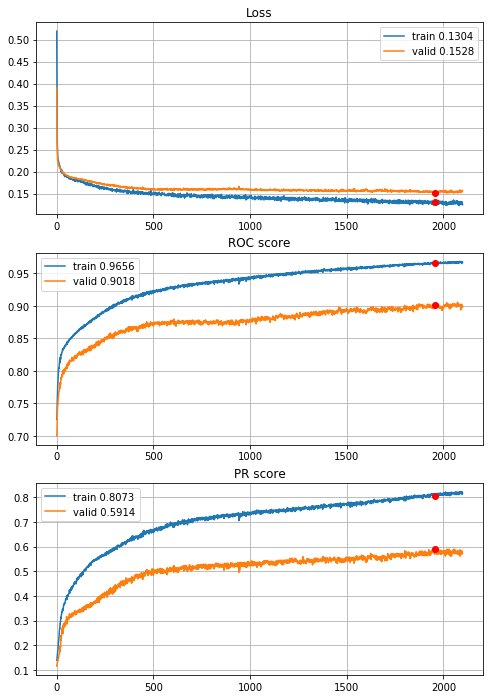


Fold 2------------------------------------------------------------


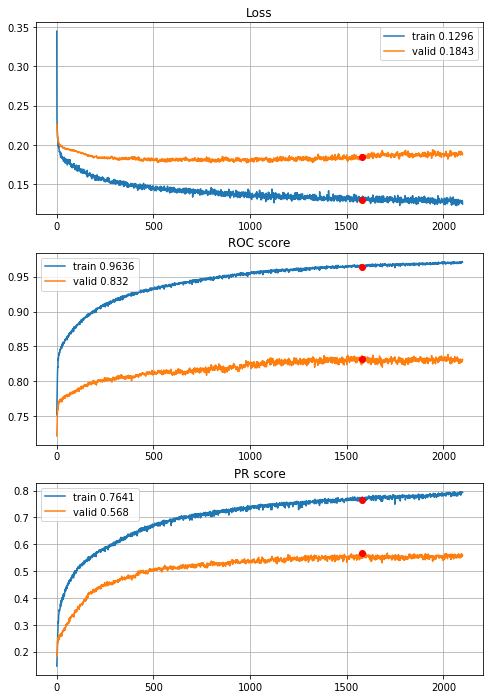


Fold 3------------------------------------------------------------


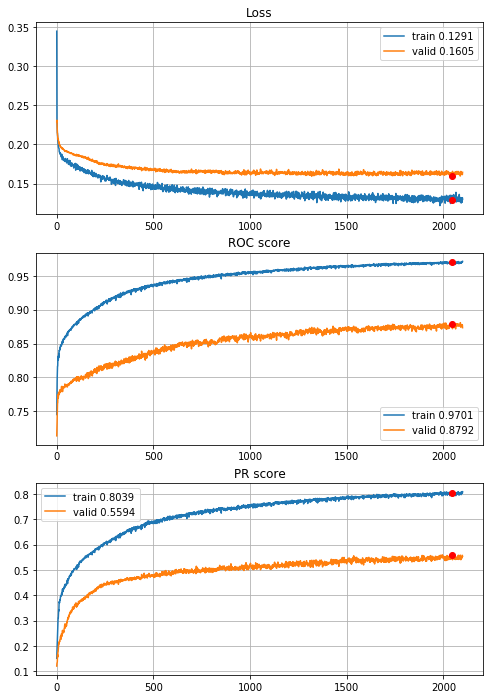


Fold 4------------------------------------------------------------


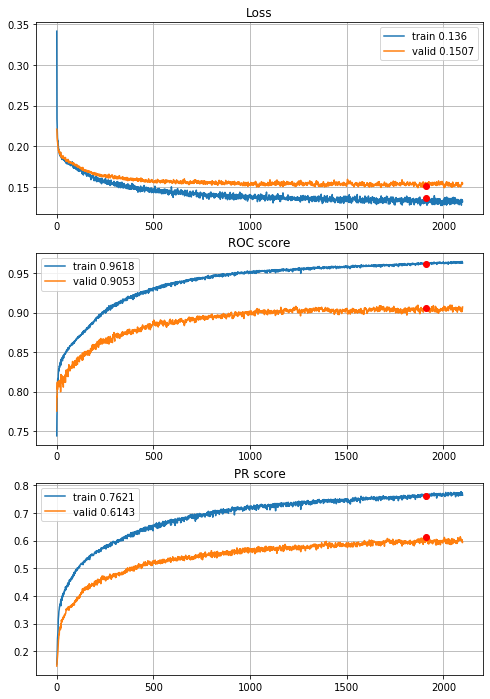


Fold 5------------------------------------------------------------


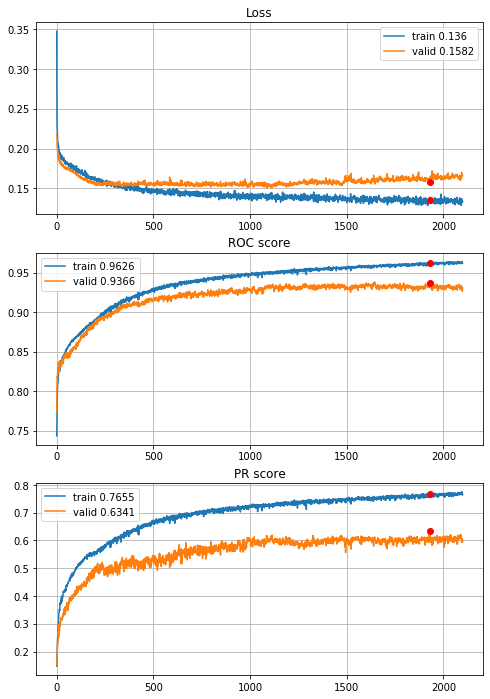


Fold 6------------------------------------------------------------


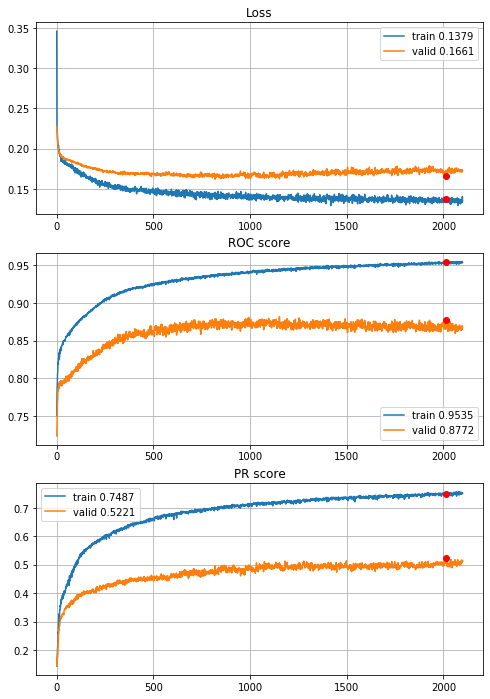

In [38]:
# two layers, L1 regu on two layers, 2100 epochs, THE BEST ONE
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=2100,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\4year\MLP_L1_2100ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

The results are now good enough, but learning curves are still growing, very slow but they're growing. Lets try the last training, for 4000 epochs this time.


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/4000,
cumulative time: 5.33s train loss: 0.5165380782649543, validation loss: 0.38845307663478684
Epoch: 2/4000,
cumulative time: 5.48s train loss: 0.3711513215037988, validation loss: 0.2967756741950916
Epoch: 3/4000,
cumulative time: 5.62s train loss: 0.30229783101187696, validation loss: 0.25735097241044613
Epoch: 4/4000,
cumulative time: 5.77s train loss: 0.2630124520893466, validation loss: 0.23844127228180514
Epoch: 5/4000,
cumulative time: 5.91s train loss: 0.248574578780724, validation loss: 0.22935812455241253
Epoch: 6/4000,
cumulative time: 6.05s train loss: 0.23913114981115247, validation loss: 0.22453464178141483
Epoch: 7/4000,
cumulative time: 6.19s train loss: 0.22991954701344225, validation loss: 0.22209481818891855
Epoch: 8/4000,
cumulative time: 6.33s train loss: 0.22785030481731894, validation loss: 0.21957302169583945
Epoch: 9/4000,
cumulative time: 6.47s train loss: 0.22433380596

Epoch: 77/4000,
cumulative time: 15.65s train loss: 0.18466550815329474, validation loss: 0.18747639387257656
Epoch: 78/4000,
cumulative time: 15.79s train loss: 0.18718341781514128, validation loss: 0.18686669277771548
Epoch: 79/4000,
cumulative time: 15.93s train loss: 0.18253199358402375, validation loss: 0.18611066762568432
Epoch: 80/4000,
cumulative time: 16.07s train loss: 0.18382517555121033, validation loss: 0.18728083965525164
Epoch: 81/4000,
cumulative time: 16.21s train loss: 0.18285483149876308, validation loss: 0.18735446590724814
Epoch: 82/4000,
cumulative time: 16.35s train loss: 0.18345251449297678, validation loss: 0.18720487831318922
Epoch: 83/4000,
cumulative time: 16.49s train loss: 0.1819533223041994, validation loss: 0.1867826454204471
Epoch: 84/4000,
cumulative time: 16.63s train loss: 0.1838674941265695, validation loss: 0.1861643029200617
Epoch: 85/4000,
cumulative time: 16.77s train loss: 0.1829364358218054, validation loss: 0.18701536900701776
Epoch: 86/4000,

Epoch: 153/4000,
cumulative time: 26.21s train loss: 0.16953620715182208, validation loss: 0.1812646021905442
Epoch: 154/4000,
cumulative time: 26.35s train loss: 0.17185792504694, validation loss: 0.180849688243022
Epoch: 155/4000,
cumulative time: 26.49s train loss: 0.1711542806615382, validation loss: 0.179987900927815
Epoch: 156/4000,
cumulative time: 26.63s train loss: 0.17474121572892445, validation loss: 0.17940449239933384
Epoch: 157/4000,
cumulative time: 26.77s train loss: 0.17343616407061735, validation loss: 0.17938087149247414
Epoch: 158/4000,
cumulative time: 26.91s train loss: 0.17478801744332936, validation loss: 0.1800524850355029
Epoch: 159/4000,
cumulative time: 27.05s train loss: 0.17508291135638868, validation loss: 0.17990631225199988
Epoch: 160/4000,
cumulative time: 27.19s train loss: 0.17315183264568262, validation loss: 0.17956613219255002
Epoch: 161/4000,
cumulative time: 27.33s train loss: 0.17147876127050632, validation loss: 0.17899597022832048
Epoch: 162/

Epoch: 229/4000,
cumulative time: 36.85s train loss: 0.16599520780557056, validation loss: 0.17306901027630428
Epoch: 230/4000,
cumulative time: 36.99s train loss: 0.16257997838333585, validation loss: 0.17294402889161795
Epoch: 231/4000,
cumulative time: 37.13s train loss: 0.16212286346495744, validation loss: 0.1729863193608856
Epoch: 232/4000,
cumulative time: 37.27s train loss: 0.16354656174837787, validation loss: 0.17216053574648416
Epoch: 233/4000,
cumulative time: 37.41s train loss: 0.16124971306130817, validation loss: 0.17192510165999422
Epoch: 234/4000,
cumulative time: 37.55s train loss: 0.16290456404822992, validation loss: 0.1726930358423677
Epoch: 235/4000,
cumulative time: 37.69s train loss: 0.163396202817196, validation loss: 0.1726307089106415
Epoch: 236/4000,
cumulative time: 37.83s train loss: 0.16685755015328682, validation loss: 0.17226937449733118
Epoch: 237/4000,
cumulative time: 37.97s train loss: 0.1644215257043136, validation loss: 0.1726229287191992
Epoch: 2

Epoch: 305/4000,
cumulative time: 47.48s train loss: 0.15781405699418674, validation loss: 0.17009236400349761
Epoch: 306/4000,
cumulative time: 47.62s train loss: 0.15689200579706108, validation loss: 0.16794936483696743
Epoch: 307/4000,
cumulative time: 47.76s train loss: 0.15580354764475154, validation loss: 0.16770435211364715
Epoch: 308/4000,
cumulative time: 47.9s train loss: 0.15543789682288625, validation loss: 0.16862410952072715
Epoch: 309/4000,
cumulative time: 48.04s train loss: 0.1535713768502144, validation loss: 0.1678900330893599
Epoch: 310/4000,
cumulative time: 48.18s train loss: 0.16049332421789958, validation loss: 0.16706598996913213
Epoch: 311/4000,
cumulative time: 48.31s train loss: 0.15533753546279766, validation loss: 0.16700547524785572
Epoch: 312/4000,
cumulative time: 48.45s train loss: 0.15975622694782612, validation loss: 0.16893093023193054
Epoch: 313/4000,
cumulative time: 48.59s train loss: 0.15684546885780365, validation loss: 0.16838808750278533
Epoc

Epoch: 381/4000,
cumulative time: 58.09s train loss: 0.15207806397414605, validation loss: 0.16357358990882512
Epoch: 382/4000,
cumulative time: 58.23s train loss: 0.15379885024739012, validation loss: 0.1631792223498154
Epoch: 383/4000,
cumulative time: 58.37s train loss: 0.15303892897241336, validation loss: 0.16291471026518298
Epoch: 384/4000,
cumulative time: 58.5s train loss: 0.1548868633657552, validation loss: 0.16264586106013731
Epoch: 385/4000,
cumulative time: 58.64s train loss: 0.15016384348100786, validation loss: 0.16435598052018674
Epoch: 386/4000,
cumulative time: 58.78s train loss: 0.15414738699329106, validation loss: 0.16469538798130962
Epoch: 387/4000,
cumulative time: 58.93s train loss: 0.15518561801078548, validation loss: 0.164466484721783
Epoch: 388/4000,
cumulative time: 59.06s train loss: 0.15352591364889887, validation loss: 0.1656575466273511
Epoch: 389/4000,
cumulative time: 59.2s train loss: 0.15295064542455244, validation loss: 0.16357968905858233
Epoch: 3

Epoch: 457/4000,
cumulative time: 68.5s train loss: 0.14962668696005696, validation loss: 0.16179261353041868
Epoch: 458/4000,
cumulative time: 68.64s train loss: 0.1504354852958286, validation loss: 0.16367800057015508
Epoch: 459/4000,
cumulative time: 68.79s train loss: 0.15085056308470743, validation loss: 0.16278129375816772
Epoch: 460/4000,
cumulative time: 68.92s train loss: 0.15116999587408125, validation loss: 0.16066938018904323
Epoch: 461/4000,
cumulative time: 69.06s train loss: 0.15337797993497043, validation loss: 0.1601047387956518
Epoch: 462/4000,
cumulative time: 69.2s train loss: 0.14997394291026284, validation loss: 0.16044435845377333
Epoch: 463/4000,
cumulative time: 69.34s train loss: 0.15225344901998572, validation loss: 0.1603188232104741
Epoch: 464/4000,
cumulative time: 69.48s train loss: 0.15026488362825585, validation loss: 0.16028001148778617
Epoch: 465/4000,
cumulative time: 69.62s train loss: 0.1528464083988628, validation loss: 0.16044502378199846
Epoch: 

Epoch: 533/4000,
cumulative time: 79.15s train loss: 0.1490431847189032, validation loss: 0.1612367635888255
Epoch: 534/4000,
cumulative time: 79.3s train loss: 0.14833990562502733, validation loss: 0.15982340866607253
Epoch: 535/4000,
cumulative time: 79.44s train loss: 0.15017001538247127, validation loss: 0.16053057773897159
Epoch: 536/4000,
cumulative time: 79.59s train loss: 0.1501267203335929, validation loss: 0.15987714645284792
Epoch: 537/4000,
cumulative time: 79.73s train loss: 0.15074907985367372, validation loss: 0.15877624291234313
Epoch: 538/4000,
cumulative time: 79.88s train loss: 0.15060246770004965, validation loss: 0.16099732857605809
Epoch: 539/4000,
cumulative time: 80.02s train loss: 0.14634210887566323, validation loss: 0.1606250084566372
Epoch: 540/4000,
cumulative time: 80.16s train loss: 0.1456857768956475, validation loss: 0.15962766791542343
Epoch: 541/4000,
cumulative time: 80.31s train loss: 0.14862905040507127, validation loss: 0.16016396876092343
Epoch: 

Epoch: 609/4000,
cumulative time: 89.87s train loss: 0.1468495995965021, validation loss: 0.1622363808834285
Epoch: 610/4000,
cumulative time: 90.01s train loss: 0.14752780807922536, validation loss: 0.16108024963276008
Epoch: 611/4000,
cumulative time: 90.15s train loss: 0.1503457825112924, validation loss: 0.1607591523918836
Epoch: 612/4000,
cumulative time: 90.29s train loss: 0.14466807358225636, validation loss: 0.15998564231468757
Epoch: 613/4000,
cumulative time: 90.43s train loss: 0.1451755472478304, validation loss: 0.15967198580483177
Epoch: 614/4000,
cumulative time: 90.57s train loss: 0.14749694105740482, validation loss: 0.16097182510173427
Epoch: 615/4000,
cumulative time: 90.71s train loss: 0.1444138202262756, validation loss: 0.16039293359298135
Epoch: 616/4000,
cumulative time: 90.85s train loss: 0.14842626651114604, validation loss: 0.16107953675065909
Epoch: 617/4000,
cumulative time: 90.99s train loss: 0.1471590801746761, validation loss: 0.16086793910531952
Epoch: 6

Epoch: 685/4000,
cumulative time: 100.55s train loss: 0.14875608305791152, validation loss: 0.15959244856954513
Epoch: 686/4000,
cumulative time: 100.69s train loss: 0.1469976395839374, validation loss: 0.1600268036025653
Epoch: 687/4000,
cumulative time: 100.83s train loss: 0.14661103218335247, validation loss: 0.15938863135909775
Epoch: 688/4000,
cumulative time: 100.97s train loss: 0.1493419610896358, validation loss: 0.15872563273627552
Epoch: 689/4000,
cumulative time: 101.11s train loss: 0.14321674132572765, validation loss: 0.16006372400373728
Epoch: 690/4000,
cumulative time: 101.25s train loss: 0.1446700573665609, validation loss: 0.16054193613641193
Epoch: 691/4000,
cumulative time: 101.39s train loss: 0.14776429149405793, validation loss: 0.1607482647757858
Epoch: 692/4000,
cumulative time: 101.55s train loss: 0.14621064380008128, validation loss: 0.15943784667895392
Epoch: 693/4000,
cumulative time: 101.68s train loss: 0.1424946509799856, validation loss: 0.1606164662975125

Epoch: 759/4000,
cumulative time: 110.97s train loss: 0.14727732173090943, validation loss: 0.1594635653426811
Epoch: 760/4000,
cumulative time: 111.11s train loss: 0.14769688730390523, validation loss: 0.15997222576155964
Epoch: 761/4000,
cumulative time: 111.25s train loss: 0.14426880593656535, validation loss: 0.15817078821224123
Epoch: 762/4000,
cumulative time: 111.39s train loss: 0.14644785695783485, validation loss: 0.16020620094423313
Epoch: 763/4000,
cumulative time: 111.53s train loss: 0.14223376397425483, validation loss: 0.16087858636538296
Epoch: 764/4000,
cumulative time: 111.68s train loss: 0.14718604505865707, validation loss: 0.15961041767593953
Epoch: 765/4000,
cumulative time: 111.81s train loss: 0.1475621728254699, validation loss: 0.1591572704426361
Epoch: 766/4000,
cumulative time: 111.96s train loss: 0.14426748647963206, validation loss: 0.15919847088536898
Epoch: 767/4000,
cumulative time: 112.1s train loss: 0.14711625717786292, validation loss: 0.15958159802883

Epoch: 833/4000,
cumulative time: 121.36s train loss: 0.14390353958718413, validation loss: 0.16040584781772024
Epoch: 834/4000,
cumulative time: 121.5s train loss: 0.1477091215752815, validation loss: 0.1600518371780524
Epoch: 835/4000,
cumulative time: 121.64s train loss: 0.14528194052004512, validation loss: 0.16051249387639163
Epoch: 836/4000,
cumulative time: 121.78s train loss: 0.14422509987193882, validation loss: 0.15923300072033442
Epoch: 837/4000,
cumulative time: 121.92s train loss: 0.1435081252654989, validation loss: 0.16025871247398032
Epoch: 838/4000,
cumulative time: 122.05s train loss: 0.14591315239728772, validation loss: 0.16170341233926375
Epoch: 839/4000,
cumulative time: 122.18s train loss: 0.14244974094597632, validation loss: 0.16116013806478113
Epoch: 840/4000,
cumulative time: 122.32s train loss: 0.14518085871529518, validation loss: 0.16053017164429
Epoch: 841/4000,
cumulative time: 122.46s train loss: 0.14484569518625875, validation loss: 0.15992697652421733

Epoch: 907/4000,
cumulative time: 131.6s train loss: 0.14731849047154832, validation loss: 0.16105415341884932
Epoch: 908/4000,
cumulative time: 131.74s train loss: 0.14336140343827317, validation loss: 0.16101393150260776
Epoch: 909/4000,
cumulative time: 131.88s train loss: 0.14348471468083948, validation loss: 0.15917724089974689
Epoch: 910/4000,
cumulative time: 132.02s train loss: 0.14190242782764792, validation loss: 0.16038082582638977
Epoch: 911/4000,
cumulative time: 132.16s train loss: 0.1409609365346369, validation loss: 0.1602693669056714
Epoch: 912/4000,
cumulative time: 132.3s train loss: 0.14210985986109767, validation loss: 0.1599122379773973
Epoch: 913/4000,
cumulative time: 132.43s train loss: 0.1421999322230446, validation loss: 0.16048927760351425
Epoch: 914/4000,
cumulative time: 132.57s train loss: 0.14433682361907113, validation loss: 0.1601583758144658
Epoch: 915/4000,
cumulative time: 132.71s train loss: 0.14164368910140437, validation loss: 0.1608619283988737


Epoch: 981/4000,
cumulative time: 142.02s train loss: 0.1422629687079256, validation loss: 0.16054996368307253
Epoch: 982/4000,
cumulative time: 142.16s train loss: 0.13697898965245223, validation loss: 0.1596582080329495
Epoch: 983/4000,
cumulative time: 142.3s train loss: 0.14378266805717216, validation loss: 0.15890454430414594
Epoch: 984/4000,
cumulative time: 142.44s train loss: 0.1378661729887495, validation loss: 0.16099907327988588
Epoch: 985/4000,
cumulative time: 142.58s train loss: 0.1417249624879812, validation loss: 0.15986354454307025
Epoch: 986/4000,
cumulative time: 142.72s train loss: 0.14485353072535742, validation loss: 0.15937279612130256
Epoch: 987/4000,
cumulative time: 142.86s train loss: 0.14374360826917132, validation loss: 0.15898963665986565
Epoch: 988/4000,
cumulative time: 143.0s train loss: 0.14031009302994185, validation loss: 0.1583727215872564
Epoch: 989/4000,
cumulative time: 143.14s train loss: 0.13903017811265123, validation loss: 0.1590309340869431


Epoch: 1055/4000,
cumulative time: 152.42s train loss: 0.14234109382189117, validation loss: 0.1619479990557313
Epoch: 1056/4000,
cumulative time: 152.57s train loss: 0.1456430364731432, validation loss: 0.15936680818756394
Epoch: 1057/4000,
cumulative time: 152.7s train loss: 0.13652501309963497, validation loss: 0.16125646823924605
Epoch: 1058/4000,
cumulative time: 152.84s train loss: 0.13627939784817422, validation loss: 0.15881393845792202
Epoch: 1059/4000,
cumulative time: 152.97s train loss: 0.13935483452508482, validation loss: 0.1599974108643074
Epoch: 1060/4000,
cumulative time: 153.11s train loss: 0.13935187290965836, validation loss: 0.15706496686250518
Epoch: 1061/4000,
cumulative time: 153.25s train loss: 0.14050639125484382, validation loss: 0.15840858737370692
Epoch: 1062/4000,
cumulative time: 153.39s train loss: 0.13999550462775637, validation loss: 0.1575955165292715
Epoch: 1063/4000,
cumulative time: 153.53s train loss: 0.14093519950593247, validation loss: 0.159003

Epoch: 1129/4000,
cumulative time: 162.83s train loss: 0.1343695583248372, validation loss: 0.1593553117540436
Epoch: 1130/4000,
cumulative time: 162.96s train loss: 0.13714335580604628, validation loss: 0.15869129929435424
Epoch: 1131/4000,
cumulative time: 163.1s train loss: 0.1399053947957712, validation loss: 0.158697954980673
Epoch: 1132/4000,
cumulative time: 163.24s train loss: 0.13956373519855575, validation loss: 0.16036368917656074
Epoch: 1133/4000,
cumulative time: 163.41s train loss: 0.13925327068613544, validation loss: 0.15762532732168616
Epoch: 1134/4000,
cumulative time: 163.54s train loss: 0.14147900417903683, validation loss: 0.1568997701042927
Epoch: 1135/4000,
cumulative time: 163.67s train loss: 0.14079522865353983, validation loss: 0.15675443480865253
Epoch: 1136/4000,
cumulative time: 163.8s train loss: 0.137747478614171, validation loss: 0.15786725255280956
Epoch: 1137/4000,
cumulative time: 163.95s train loss: 0.13998449815889477, validation loss: 0.15788558979

Epoch: 1204/4000,
cumulative time: 173.58s train loss: 0.14092976998385073, validation loss: 0.1565671218869798
Epoch: 1205/4000,
cumulative time: 173.72s train loss: 0.13779786784147577, validation loss: 0.15813838535827224
Epoch: 1206/4000,
cumulative time: 173.86s train loss: 0.13899514100097204, validation loss: 0.15696719683417665
Epoch: 1207/4000,
cumulative time: 174.0s train loss: 0.13934842691720384, validation loss: 0.1568760240540527
Epoch: 1208/4000,
cumulative time: 174.14s train loss: 0.14064111732972281, validation loss: 0.1579898298091025
Epoch: 1209/4000,
cumulative time: 174.28s train loss: 0.1345138112409034, validation loss: 0.15775115522216826
Epoch: 1210/4000,
cumulative time: 174.42s train loss: 0.13891280997388777, validation loss: 0.15833599070166957
Epoch: 1211/4000,
cumulative time: 174.57s train loss: 0.13894350993345922, validation loss: 0.1571788363833262
Epoch: 1212/4000,
cumulative time: 174.71s train loss: 0.13833568425678872, validation loss: 0.1564287

Epoch: 1278/4000,
cumulative time: 183.97s train loss: 0.13822570383288987, validation loss: 0.15664184486038268
Epoch: 1279/4000,
cumulative time: 184.11s train loss: 0.14044157661072454, validation loss: 0.1573669054197405
Epoch: 1280/4000,
cumulative time: 184.25s train loss: 0.13984812536060884, validation loss: 0.15638529763406764
Epoch: 1281/4000,
cumulative time: 184.38s train loss: 0.14014176836451148, validation loss: 0.15646427206395838
Epoch: 1282/4000,
cumulative time: 184.52s train loss: 0.13657329121411016, validation loss: 0.15666911763711558
Epoch: 1283/4000,
cumulative time: 184.65s train loss: 0.14280783180383316, validation loss: 0.15752323816794778
Epoch: 1284/4000,
cumulative time: 184.79s train loss: 0.13918379509354034, validation loss: 0.15739011038234235
Epoch: 1285/4000,
cumulative time: 184.93s train loss: 0.13765673036798054, validation loss: 0.15728036686017288
Epoch: 1286/4000,
cumulative time: 185.06s train loss: 0.13745473608137168, validation loss: 0.15

Epoch: 1352/4000,
cumulative time: 194.03s train loss: 0.13587876088865508, validation loss: 0.1566566263862497
Epoch: 1353/4000,
cumulative time: 194.17s train loss: 0.13843422573519942, validation loss: 0.1577155055279144
Epoch: 1354/4000,
cumulative time: 194.31s train loss: 0.13698061071939988, validation loss: 0.1569408388000674
Epoch: 1355/4000,
cumulative time: 194.45s train loss: 0.13413626431655806, validation loss: 0.15905231956603008
Epoch: 1356/4000,
cumulative time: 194.58s train loss: 0.1353775611588404, validation loss: 0.15736909343564973
Epoch: 1357/4000,
cumulative time: 194.71s train loss: 0.1372493549919609, validation loss: 0.15573673344859468
Epoch: 1358/4000,
cumulative time: 194.86s train loss: 0.13686124315244633, validation loss: 0.15571801526721762
Epoch: 1359/4000,
cumulative time: 195.0s train loss: 0.13801930846204294, validation loss: 0.15517389896047448
Epoch: 1360/4000,
cumulative time: 195.14s train loss: 0.13379815837537562, validation loss: 0.1559266

Epoch: 1426/4000,
cumulative time: 204.37s train loss: 0.13502025738892204, validation loss: 0.15861501032962047
Epoch: 1427/4000,
cumulative time: 204.51s train loss: 0.14043298837730447, validation loss: 0.15675161268696483
Epoch: 1428/4000,
cumulative time: 204.65s train loss: 0.13759580509637953, validation loss: 0.15477227708204333
Epoch: 1429/4000,
cumulative time: 204.79s train loss: 0.1391079584371243, validation loss: 0.15532541759895419
Epoch: 1430/4000,
cumulative time: 204.93s train loss: 0.13838969911539342, validation loss: 0.15569919633816667
Epoch: 1431/4000,
cumulative time: 205.08s train loss: 0.13478051401988275, validation loss: 0.1566040739974982
Epoch: 1432/4000,
cumulative time: 205.22s train loss: 0.1348270913645631, validation loss: 0.15523886281953855
Epoch: 1433/4000,
cumulative time: 205.37s train loss: 0.13990473908684356, validation loss: 0.15572164275152817
Epoch: 1434/4000,
cumulative time: 205.51s train loss: 0.13808157337806895, validation loss: 0.1570

Epoch: 1500/4000,
cumulative time: 214.87s train loss: 0.1318481631407568, validation loss: 0.15595109562958237
Epoch: 1501/4000,
cumulative time: 215.01s train loss: 0.13598275328914686, validation loss: 0.15563874795698163
Epoch: 1502/4000,
cumulative time: 215.15s train loss: 0.13344266875131439, validation loss: 0.15492031261213302
Epoch: 1503/4000,
cumulative time: 215.29s train loss: 0.13132065615966668, validation loss: 0.15534794391459392
Epoch: 1504/4000,
cumulative time: 215.45s train loss: 0.13258561184729994, validation loss: 0.15714470952891266
Epoch: 1505/4000,
cumulative time: 215.58s train loss: 0.134955366288838, validation loss: 0.1561025245872138
Epoch: 1506/4000,
cumulative time: 215.72s train loss: 0.13260517929809126, validation loss: 0.1572190775523955
Epoch: 1507/4000,
cumulative time: 215.86s train loss: 0.1297927993723503, validation loss: 0.15642495905768716
Epoch: 1508/4000,
cumulative time: 216.0s train loss: 0.13739219892338317, validation loss: 0.15599334

Epoch: 1574/4000,
cumulative time: 225.34s train loss: 0.13458135307249153, validation loss: 0.15660717310428296
Epoch: 1575/4000,
cumulative time: 225.48s train loss: 0.138017302258015, validation loss: 0.1547091222685807
Epoch: 1576/4000,
cumulative time: 225.62s train loss: 0.13147990232561585, validation loss: 0.1570139709401082
Epoch: 1577/4000,
cumulative time: 225.76s train loss: 0.13214192449656914, validation loss: 0.1578498415856884
Epoch: 1578/4000,
cumulative time: 225.9s train loss: 0.13506499464616908, validation loss: 0.15437409356794363
Epoch: 1579/4000,
cumulative time: 226.04s train loss: 0.13500816341229296, validation loss: 0.15638361145964766
Epoch: 1580/4000,
cumulative time: 226.18s train loss: 0.13312329165003337, validation loss: 0.15528066347779831
Epoch: 1581/4000,
cumulative time: 226.31s train loss: 0.13278123070364767, validation loss: 0.15513687719286015
Epoch: 1582/4000,
cumulative time: 226.46s train loss: 0.13054150819624216, validation loss: 0.1559185

Epoch: 1648/4000,
cumulative time: 235.76s train loss: 0.13821358059068864, validation loss: 0.15668828272145974
Epoch: 1649/4000,
cumulative time: 235.9s train loss: 0.13268119484758437, validation loss: 0.15693547380384415
Epoch: 1650/4000,
cumulative time: 236.04s train loss: 0.1329549633095379, validation loss: 0.1561232312266075
Epoch: 1651/4000,
cumulative time: 236.18s train loss: 0.13454435857061825, validation loss: 0.15699231817334425
Epoch: 1652/4000,
cumulative time: 236.32s train loss: 0.13180309042373115, validation loss: 0.15563923391336645
Epoch: 1653/4000,
cumulative time: 236.46s train loss: 0.13306427294578407, validation loss: 0.15474352262878677
Epoch: 1654/4000,
cumulative time: 236.6s train loss: 0.136883773096337, validation loss: 0.1553473080539476
Epoch: 1655/4000,
cumulative time: 236.74s train loss: 0.13078959709119362, validation loss: 0.15704731225277632
Epoch: 1656/4000,
cumulative time: 236.88s train loss: 0.13574933322065616, validation loss: 0.15604608

Epoch: 1722/4000,
cumulative time: 246.2s train loss: 0.12958463893227465, validation loss: 0.155206147457078
Epoch: 1723/4000,
cumulative time: 246.34s train loss: 0.13233044660843865, validation loss: 0.15432831358958296
Epoch: 1724/4000,
cumulative time: 246.48s train loss: 0.13511120251693307, validation loss: 0.15598132944658874
Epoch: 1725/4000,
cumulative time: 246.62s train loss: 0.13477137768226377, validation loss: 0.15418716221337744
Epoch: 1726/4000,
cumulative time: 246.75s train loss: 0.13140530681335746, validation loss: 0.15671077530914784
Epoch: 1727/4000,
cumulative time: 246.89s train loss: 0.13312463312488834, validation loss: 0.15397130217659302
Epoch: 1728/4000,
cumulative time: 247.03s train loss: 0.12960735515792932, validation loss: 0.15686258087359456
Epoch: 1729/4000,
cumulative time: 247.17s train loss: 0.13318002634597673, validation loss: 0.15518862038465323
Epoch: 1730/4000,
cumulative time: 247.31s train loss: 0.13333477907823343, validation loss: 0.1561

Epoch: 1796/4000,
cumulative time: 256.56s train loss: 0.1286969470286603, validation loss: 0.15521044276497492
Epoch: 1797/4000,
cumulative time: 256.71s train loss: 0.13138977950711545, validation loss: 0.15356247605840878
Epoch: 1798/4000,
cumulative time: 256.85s train loss: 0.1312050084688351, validation loss: 0.15602912298873461
Epoch: 1799/4000,
cumulative time: 256.99s train loss: 0.1303132327490877, validation loss: 0.15418113589570828
Epoch: 1800/4000,
cumulative time: 257.13s train loss: 0.1321205671886308, validation loss: 0.152574963284399
Epoch: 1801/4000,
cumulative time: 257.27s train loss: 0.13122539046401469, validation loss: 0.15208019159982772
Epoch: 1802/4000,
cumulative time: 257.41s train loss: 0.12867735567777014, validation loss: 0.15321100510814062
Epoch: 1803/4000,
cumulative time: 257.55s train loss: 0.13072841140744343, validation loss: 0.15407583630758537
Epoch: 1804/4000,
cumulative time: 257.69s train loss: 0.13132727123826365, validation loss: 0.1542719

Epoch: 1870/4000,
cumulative time: 266.96s train loss: 0.13005309405134302, validation loss: 0.15307550361523262
Epoch: 1871/4000,
cumulative time: 267.09s train loss: 0.1300954168375029, validation loss: 0.15306898318560777
Epoch: 1872/4000,
cumulative time: 267.23s train loss: 0.12981050270471944, validation loss: 0.1538339015413418
Epoch: 1873/4000,
cumulative time: 267.37s train loss: 0.12637803195307953, validation loss: 0.15337906416741418
Epoch: 1874/4000,
cumulative time: 267.51s train loss: 0.13003871225943833, validation loss: 0.15458303181755048
Epoch: 1875/4000,
cumulative time: 267.65s train loss: 0.1339274438471718, validation loss: 0.15394527341858558
Epoch: 1876/4000,
cumulative time: 267.79s train loss: 0.1305749174417989, validation loss: 0.1549108687349531
Epoch: 1877/4000,
cumulative time: 267.93s train loss: 0.13192544777281648, validation loss: 0.15268657966646879
Epoch: 1878/4000,
cumulative time: 268.07s train loss: 0.13135926514137478, validation loss: 0.155324

Epoch: 1944/4000,
cumulative time: 277.42s train loss: 0.12839003643506752, validation loss: 0.15396978313051332
Epoch: 1945/4000,
cumulative time: 277.56s train loss: 0.1304593087145715, validation loss: 0.15332763692284215
Epoch: 1946/4000,
cumulative time: 277.7s train loss: 0.13351246823768403, validation loss: 0.15349839373134772
Epoch: 1947/4000,
cumulative time: 277.84s train loss: 0.13024386675196611, validation loss: 0.15290376367497557
Epoch: 1948/4000,
cumulative time: 277.98s train loss: 0.1323412332785774, validation loss: 0.15237596430203962
Epoch: 1949/4000,
cumulative time: 278.12s train loss: 0.12733240723386702, validation loss: 0.15257617057262432
Epoch: 1950/4000,
cumulative time: 278.26s train loss: 0.12436052170307779, validation loss: 0.15343689716657544
Epoch: 1951/4000,
cumulative time: 278.4s train loss: 0.1296281652007849, validation loss: 0.15456160818783907
Epoch: 1952/4000,
cumulative time: 278.54s train loss: 0.12788510341240375, validation loss: 0.153836

Epoch: 2018/4000,
cumulative time: 287.79s train loss: 0.12896019597903724, validation loss: 0.15360495842704164
Epoch: 2019/4000,
cumulative time: 287.93s train loss: 0.12358733728968381, validation loss: 0.1511145785116192
Epoch: 2020/4000,
cumulative time: 288.07s train loss: 0.12723472536860247, validation loss: 0.15485528125659068
Epoch: 2021/4000,
cumulative time: 288.21s train loss: 0.12855635664369858, validation loss: 0.1537514867386581
Epoch: 2022/4000,
cumulative time: 288.35s train loss: 0.12894184128450434, validation loss: 0.15456434120687196
Epoch: 2023/4000,
cumulative time: 288.49s train loss: 0.12880786485999446, validation loss: 0.15301833986992572
Epoch: 2024/4000,
cumulative time: 288.63s train loss: 0.12489210016011834, validation loss: 0.15345367162385062
Epoch: 2025/4000,
cumulative time: 288.77s train loss: 0.12821730710976978, validation loss: 0.15331065578676553
Epoch: 2026/4000,
cumulative time: 288.9s train loss: 0.1257139765295381, validation loss: 0.15374

Epoch: 2092/4000,
cumulative time: 298.17s train loss: 0.12669433275092837, validation loss: 0.15434065265384478
Epoch: 2093/4000,
cumulative time: 298.31s train loss: 0.12604918183276134, validation loss: 0.15594761651782782
Epoch: 2094/4000,
cumulative time: 298.45s train loss: 0.1300559852033322, validation loss: 0.15405524921222477
Epoch: 2095/4000,
cumulative time: 298.59s train loss: 0.12879412121544184, validation loss: 0.1546354117423519
Epoch: 2096/4000,
cumulative time: 298.73s train loss: 0.13198661176333323, validation loss: 0.15385708996963957
Epoch: 2097/4000,
cumulative time: 298.88s train loss: 0.1311373113794449, validation loss: 0.1534691594688157
Epoch: 2098/4000,
cumulative time: 299.02s train loss: 0.12959715879638822, validation loss: 0.15589298978397195
Epoch: 2099/4000,
cumulative time: 299.16s train loss: 0.1258289874904847, validation loss: 0.15499055511372037
Epoch: 2100/4000,
cumulative time: 299.3s train loss: 0.12502648047448406, validation loss: 0.1561479

Epoch: 2166/4000,
cumulative time: 308.22s train loss: 0.12926450467728212, validation loss: 0.15119896004441807
Epoch: 2167/4000,
cumulative time: 308.36s train loss: 0.12730402810935118, validation loss: 0.15530521399801162
Epoch: 2168/4000,
cumulative time: 308.5s train loss: 0.1292097187530892, validation loss: 0.15175751504888332
Epoch: 2169/4000,
cumulative time: 308.64s train loss: 0.12403622403361403, validation loss: 0.1530025793813864
Epoch: 2170/4000,
cumulative time: 308.78s train loss: 0.1259871430813771, validation loss: 0.1529897593920372
Epoch: 2171/4000,
cumulative time: 308.91s train loss: 0.12804091514885857, validation loss: 0.1526725651192941
Epoch: 2172/4000,
cumulative time: 309.05s train loss: 0.12784200188482261, validation loss: 0.15140764351358538
Epoch: 2173/4000,
cumulative time: 309.19s train loss: 0.12950845105246564, validation loss: 0.15269648878650652
Epoch: 2174/4000,
cumulative time: 309.33s train loss: 0.1272309728734876, validation loss: 0.15297345

Epoch: 2240/4000,
cumulative time: 318.51s train loss: 0.12713042919689022, validation loss: 0.153838390016572
Epoch: 2241/4000,
cumulative time: 318.65s train loss: 0.12632570931482232, validation loss: 0.1526310049489374
Epoch: 2242/4000,
cumulative time: 318.8s train loss: 0.1302313151201516, validation loss: 0.15220884063805423
Epoch: 2243/4000,
cumulative time: 318.94s train loss: 0.1274814492924311, validation loss: 0.15102770245951647
Epoch: 2244/4000,
cumulative time: 319.07s train loss: 0.13018785520574305, validation loss: 0.15279442842839283
Epoch: 2245/4000,
cumulative time: 319.21s train loss: 0.12543726166075847, validation loss: 0.15316557521070243
Epoch: 2246/4000,
cumulative time: 319.35s train loss: 0.12925952642315922, validation loss: 0.153286886618931
Epoch: 2247/4000,
cumulative time: 319.49s train loss: 0.12693402070481594, validation loss: 0.15273180840330272
Epoch: 2248/4000,
cumulative time: 319.63s train loss: 0.12474864934171949, validation loss: 0.153484723

Epoch: 2314/4000,
cumulative time: 328.89s train loss: 0.13389253022762307, validation loss: 0.1540429558353898
Epoch: 2315/4000,
cumulative time: 329.03s train loss: 0.12771717112764552, validation loss: 0.15167814215240713
Epoch: 2316/4000,
cumulative time: 329.17s train loss: 0.1259890832783139, validation loss: 0.15311098512619672
Epoch: 2317/4000,
cumulative time: 329.31s train loss: 0.12886682515790154, validation loss: 0.15084480263490593
Epoch: 2318/4000,
cumulative time: 329.45s train loss: 0.13001789621187948, validation loss: 0.15175334557414136
Epoch: 2319/4000,
cumulative time: 329.59s train loss: 0.12830534250855072, validation loss: 0.15130429705281578
Epoch: 2320/4000,
cumulative time: 329.73s train loss: 0.12286622347326674, validation loss: 0.15218569216596747
Epoch: 2321/4000,
cumulative time: 329.89s train loss: 0.12887963026977114, validation loss: 0.15255723025337867
Epoch: 2322/4000,
cumulative time: 330.02s train loss: 0.1243679107136514, validation loss: 0.1517

Epoch: 2388/4000,
cumulative time: 339.44s train loss: 0.12386202058816628, validation loss: 0.1517706931732884
Epoch: 2389/4000,
cumulative time: 339.57s train loss: 0.1235926422085925, validation loss: 0.1535274392999379
Epoch: 2390/4000,
cumulative time: 339.7s train loss: 0.12424907461468276, validation loss: 0.15232726511620923
Epoch: 2391/4000,
cumulative time: 339.84s train loss: 0.12568427815710703, validation loss: 0.15185402343880164
Epoch: 2392/4000,
cumulative time: 339.98s train loss: 0.12590192692324137, validation loss: 0.15436100087415774
Epoch: 2393/4000,
cumulative time: 340.12s train loss: 0.12715731026665905, validation loss: 0.15429432783466038
Epoch: 2394/4000,
cumulative time: 340.26s train loss: 0.1277814276428163, validation loss: 0.15424477004169038
Epoch: 2395/4000,
cumulative time: 340.39s train loss: 0.1299213827230634, validation loss: 0.15463733882056846
Epoch: 2396/4000,
cumulative time: 340.54s train loss: 0.12766308306198784, validation loss: 0.1531667

Epoch: 2462/4000,
cumulative time: 349.84s train loss: 0.12568323160165923, validation loss: 0.15219844607896266
Epoch: 2463/4000,
cumulative time: 349.98s train loss: 0.12916425989650826, validation loss: 0.15168291973450948
Epoch: 2464/4000,
cumulative time: 350.12s train loss: 0.12205652986546231, validation loss: 0.15363692402474485
Epoch: 2465/4000,
cumulative time: 350.25s train loss: 0.1274423607096561, validation loss: 0.151792238690238
Epoch: 2466/4000,
cumulative time: 350.4s train loss: 0.13057948862006258, validation loss: 0.15243665471297693
Epoch: 2467/4000,
cumulative time: 350.54s train loss: 0.12830532259298544, validation loss: 0.15219149320120712
Epoch: 2468/4000,
cumulative time: 350.68s train loss: 0.12813195957059384, validation loss: 0.15060867554805488
Epoch: 2469/4000,
cumulative time: 350.82s train loss: 0.1287630830626226, validation loss: 0.1520138131143935
Epoch: 2470/4000,
cumulative time: 350.96s train loss: 0.12955019809533963, validation loss: 0.1536076

Epoch: 2536/4000,
cumulative time: 360.26s train loss: 0.1280392869966046, validation loss: 0.15250469205572623
Epoch: 2537/4000,
cumulative time: 360.4s train loss: 0.13166026028445676, validation loss: 0.15330237666508875
Epoch: 2538/4000,
cumulative time: 360.54s train loss: 0.12416939536013429, validation loss: 0.15418798369441086
Epoch: 2539/4000,
cumulative time: 360.68s train loss: 0.12590965718319092, validation loss: 0.15312980693607123
Epoch: 2540/4000,
cumulative time: 360.85s train loss: 0.12280183636949804, validation loss: 0.15232018232751332
Epoch: 2541/4000,
cumulative time: 360.99s train loss: 0.12383002881886572, validation loss: 0.1534330971168774
Epoch: 2542/4000,
cumulative time: 361.13s train loss: 0.12777120645885878, validation loss: 0.1514386382534684
Epoch: 2543/4000,
cumulative time: 361.28s train loss: 0.12936649683076062, validation loss: 0.150575773500114
Epoch: 2544/4000,
cumulative time: 361.42s train loss: 0.12441947833302235, validation loss: 0.1512836

Epoch: 2610/4000,
cumulative time: 370.74s train loss: 0.12602531553597277, validation loss: 0.15200498007324134
Epoch: 2611/4000,
cumulative time: 370.88s train loss: 0.1283461106204214, validation loss: 0.151660225752911
Epoch: 2612/4000,
cumulative time: 371.02s train loss: 0.12400854756490226, validation loss: 0.15137737382829716
Epoch: 2613/4000,
cumulative time: 371.16s train loss: 0.12345620127752206, validation loss: 0.1524127547009775
Epoch: 2614/4000,
cumulative time: 371.3s train loss: 0.1300195151480605, validation loss: 0.1500868571096736
Epoch: 2615/4000,
cumulative time: 371.44s train loss: 0.1271254713778338, validation loss: 0.15212267062102475
Epoch: 2616/4000,
cumulative time: 371.58s train loss: 0.12818282746244286, validation loss: 0.15147298532858278
Epoch: 2617/4000,
cumulative time: 371.72s train loss: 0.12755668278969748, validation loss: 0.1522662222405694
Epoch: 2618/4000,
cumulative time: 371.86s train loss: 0.13404863625744554, validation loss: 0.1519713013

Epoch: 2684/4000,
cumulative time: 381.22s train loss: 0.1228899920459958, validation loss: 0.1509180771424058
Epoch: 2685/4000,
cumulative time: 381.37s train loss: 0.13133070468862001, validation loss: 0.1506664562764989
Epoch: 2686/4000,
cumulative time: 381.52s train loss: 0.12704696443454944, validation loss: 0.15132082761388965
Epoch: 2687/4000,
cumulative time: 381.66s train loss: 0.12470918648167136, validation loss: 0.15134100431362085
Epoch: 2688/4000,
cumulative time: 381.8s train loss: 0.12613322359655496, validation loss: 0.15391411609475997
Epoch: 2689/4000,
cumulative time: 381.95s train loss: 0.12559160601231506, validation loss: 0.15272671963139567
Epoch: 2690/4000,
cumulative time: 382.09s train loss: 0.1267511871502962, validation loss: 0.15187169035289302
Epoch: 2691/4000,
cumulative time: 382.24s train loss: 0.12435537056058106, validation loss: 0.15159779896616044
Epoch: 2692/4000,
cumulative time: 382.39s train loss: 0.1289220057913901, validation loss: 0.1509054

Epoch: 2757/4000,
cumulative time: 391.58s train loss: 0.12706256623239232, validation loss: 0.15062024840454896
Epoch: 2758/4000,
cumulative time: 391.72s train loss: 0.12513448277278572, validation loss: 0.15103635233506774
Epoch: 2759/4000,
cumulative time: 391.87s train loss: 0.12708652309690852, validation loss: 0.14987243020144997
Epoch: 2760/4000,
cumulative time: 392.01s train loss: 0.12947786496613536, validation loss: 0.15110294868785398
Epoch: 2761/4000,
cumulative time: 392.15s train loss: 0.13223314137342237, validation loss: 0.15314007376512756
Epoch: 2762/4000,
cumulative time: 392.29s train loss: 0.12265558112232591, validation loss: 0.15335884343368655
Epoch: 2763/4000,
cumulative time: 392.43s train loss: 0.12281465822513464, validation loss: 0.15371285781639624
Epoch: 2764/4000,
cumulative time: 392.57s train loss: 0.12949062208705292, validation loss: 0.15180607111661754
Epoch: 2765/4000,
cumulative time: 392.72s train loss: 0.11909822986010844, validation loss: 0.1

Epoch: 2831/4000,
cumulative time: 402.02s train loss: 0.12153048256604171, validation loss: 0.15140405952565275
Epoch: 2832/4000,
cumulative time: 402.16s train loss: 0.12689382277797423, validation loss: 0.14986913554355188
Epoch: 2833/4000,
cumulative time: 402.3s train loss: 0.1314231728246844, validation loss: 0.14929736629280613
Epoch: 2834/4000,
cumulative time: 402.45s train loss: 0.12130990331396653, validation loss: 0.14950085326349596
Epoch: 2835/4000,
cumulative time: 402.59s train loss: 0.12315542393227161, validation loss: 0.14981491491452134
Epoch: 2836/4000,
cumulative time: 402.74s train loss: 0.12181358139423686, validation loss: 0.14948499730203005
Epoch: 2837/4000,
cumulative time: 402.88s train loss: 0.12345908784328974, validation loss: 0.15102867342891785
Epoch: 2838/4000,
cumulative time: 403.02s train loss: 0.12282956501155236, validation loss: 0.1511176574424954
Epoch: 2839/4000,
cumulative time: 403.16s train loss: 0.12405943935279153, validation loss: 0.1522

Epoch: 2905/4000,
cumulative time: 412.5s train loss: 0.1231372599159845, validation loss: 0.14821662738097616
Epoch: 2906/4000,
cumulative time: 412.64s train loss: 0.12724433471916094, validation loss: 0.15085511990880543
Epoch: 2907/4000,
cumulative time: 412.79s train loss: 0.12328870444536112, validation loss: 0.15110244180492352
Epoch: 2908/4000,
cumulative time: 412.94s train loss: 0.12424935386686742, validation loss: 0.15075176227977277
Epoch: 2909/4000,
cumulative time: 413.09s train loss: 0.12074235128448069, validation loss: 0.1509476448501187
Epoch: 2910/4000,
cumulative time: 413.22s train loss: 0.1259982103065121, validation loss: 0.1511782439611979
Epoch: 2911/4000,
cumulative time: 413.37s train loss: 0.1217009140107282, validation loss: 0.15025530921877284
Epoch: 2912/4000,
cumulative time: 413.52s train loss: 0.12402329122185723, validation loss: 0.150927861565388
Epoch: 2913/4000,
cumulative time: 413.66s train loss: 0.12561610263552764, validation loss: 0.150080009

Epoch: 2979/4000,
cumulative time: 422.95s train loss: 0.12386649938552138, validation loss: 0.14916359612412644
Epoch: 2980/4000,
cumulative time: 423.09s train loss: 0.12375067467161409, validation loss: 0.1490139912654138
Epoch: 2981/4000,
cumulative time: 423.24s train loss: 0.12246341711734858, validation loss: 0.14955769580712197
Epoch: 2982/4000,
cumulative time: 423.37s train loss: 0.126818321104451, validation loss: 0.14923634729554167
Epoch: 2983/4000,
cumulative time: 423.52s train loss: 0.12088130134746715, validation loss: 0.14901899057963497
Epoch: 2984/4000,
cumulative time: 423.66s train loss: 0.12602465491715006, validation loss: 0.1487068407303464
Epoch: 2985/4000,
cumulative time: 423.79s train loss: 0.1208377326178515, validation loss: 0.1516167614494886
Epoch: 2986/4000,
cumulative time: 423.94s train loss: 0.12281926894535343, validation loss: 0.1480400984063288
Epoch: 2987/4000,
cumulative time: 424.07s train loss: 0.12389538793676347, validation loss: 0.14724849

Epoch: 3053/4000,
cumulative time: 433.11s train loss: 0.12544326653244156, validation loss: 0.1515589087714623
Epoch: 3054/4000,
cumulative time: 433.24s train loss: 0.12290551290920543, validation loss: 0.1524039202397011
Epoch: 3055/4000,
cumulative time: 433.37s train loss: 0.12126942771982469, validation loss: 0.1492967776005734
Epoch: 3056/4000,
cumulative time: 433.5s train loss: 0.12029542562813196, validation loss: 0.14942635662747208
Epoch: 3057/4000,
cumulative time: 433.64s train loss: 0.12224939861236565, validation loss: 0.14829769984161553
Epoch: 3058/4000,
cumulative time: 433.78s train loss: 0.1282947494621889, validation loss: 0.14849921276855013
Epoch: 3059/4000,
cumulative time: 433.91s train loss: 0.12298306728820133, validation loss: 0.14829167310805286
Epoch: 3060/4000,
cumulative time: 434.04s train loss: 0.12629371504745154, validation loss: 0.1493146745950856
Epoch: 3061/4000,
cumulative time: 434.17s train loss: 0.12224157823417876, validation loss: 0.1504491

Epoch: 3127/4000,
cumulative time: 443.54s train loss: 0.1272242500541987, validation loss: 0.14857329451526566
Epoch: 3128/4000,
cumulative time: 443.69s train loss: 0.12141315923932948, validation loss: 0.15064941140727334
Epoch: 3129/4000,
cumulative time: 443.83s train loss: 0.12566744887940845, validation loss: 0.14925041871869377
Epoch: 3130/4000,
cumulative time: 443.97s train loss: 0.12407329481388817, validation loss: 0.1501181007364804
Epoch: 3131/4000,
cumulative time: 444.14s train loss: 0.12290038333818404, validation loss: 0.15310186827320724
Epoch: 3132/4000,
cumulative time: 444.27s train loss: 0.12319625969293835, validation loss: 0.1531408760237645
Epoch: 3133/4000,
cumulative time: 444.41s train loss: 0.11968703862636303, validation loss: 0.1523761140034262
Epoch: 3134/4000,
cumulative time: 444.56s train loss: 0.1275018520402629, validation loss: 0.15088692763940748
Epoch: 3135/4000,
cumulative time: 444.71s train loss: 0.12641200033614766, validation loss: 0.150498

Epoch: 3201/4000,
cumulative time: 453.97s train loss: 0.12570514808668032, validation loss: 0.15070036925005215
Epoch: 3202/4000,
cumulative time: 454.13s train loss: 0.12642345526441476, validation loss: 0.15146881660447792
Epoch: 3203/4000,
cumulative time: 454.28s train loss: 0.12947285588083418, validation loss: 0.15033179104652755
Epoch: 3204/4000,
cumulative time: 454.41s train loss: 0.12667422970658213, validation loss: 0.15055396731935283
Epoch: 3205/4000,
cumulative time: 454.55s train loss: 0.12577027697118673, validation loss: 0.14992167864063308
Epoch: 3206/4000,
cumulative time: 454.7s train loss: 0.12004073202938763, validation loss: 0.1497914020284006
Epoch: 3207/4000,
cumulative time: 454.84s train loss: 0.1278020066841899, validation loss: 0.1515136282812421
Epoch: 3208/4000,
cumulative time: 454.98s train loss: 0.12861584634477624, validation loss: 0.1494318173197843
Epoch: 3209/4000,
cumulative time: 455.12s train loss: 0.12101201162231272, validation loss: 0.147737

Epoch: 3275/4000,
cumulative time: 464.45s train loss: 0.1202754091132033, validation loss: 0.14986088435774841
Epoch: 3276/4000,
cumulative time: 464.59s train loss: 0.1255867591625693, validation loss: 0.15014806089553806
Epoch: 3277/4000,
cumulative time: 464.74s train loss: 0.12559461240427996, validation loss: 0.14888156258670387
Epoch: 3278/4000,
cumulative time: 464.87s train loss: 0.122876579235429, validation loss: 0.1496621249807863
Epoch: 3279/4000,
cumulative time: 465.02s train loss: 0.12276703025524223, validation loss: 0.15066596419329217
Epoch: 3280/4000,
cumulative time: 465.17s train loss: 0.12071986153902417, validation loss: 0.15045635251060807
Epoch: 3281/4000,
cumulative time: 465.31s train loss: 0.1230632534358931, validation loss: 0.14917562465792694
Epoch: 3282/4000,
cumulative time: 465.45s train loss: 0.12786961516412843, validation loss: 0.14942536177969531
Epoch: 3283/4000,
cumulative time: 465.58s train loss: 0.1263504032825362, validation loss: 0.15127555

Epoch: 3349/4000,
cumulative time: 474.92s train loss: 0.1233914071212311, validation loss: 0.14909548253084706
Epoch: 3350/4000,
cumulative time: 475.07s train loss: 0.12248306608721198, validation loss: 0.14975696818369275
Epoch: 3351/4000,
cumulative time: 475.2s train loss: 0.12214978927692892, validation loss: 0.14998576730753468
Epoch: 3352/4000,
cumulative time: 475.34s train loss: 0.12459925056339917, validation loss: 0.14993570306781526
Epoch: 3353/4000,
cumulative time: 475.48s train loss: 0.12081030960484322, validation loss: 0.15016637224174018
Epoch: 3354/4000,
cumulative time: 475.63s train loss: 0.12410744697354753, validation loss: 0.14950459848625308
Epoch: 3355/4000,
cumulative time: 475.76s train loss: 0.12127334126639752, validation loss: 0.15052338633267875
Epoch: 3356/4000,
cumulative time: 475.89s train loss: 0.12071056684688897, validation loss: 0.14805446531676855
Epoch: 3357/4000,
cumulative time: 476.03s train loss: 0.12429722822136212, validation loss: 0.149

Epoch: 3422/4000,
cumulative time: 485.24s train loss: 0.1282291814814743, validation loss: 0.14970357094271966
Epoch: 3423/4000,
cumulative time: 485.38s train loss: 0.12557776865258816, validation loss: 0.1483269517136886
Epoch: 3424/4000,
cumulative time: 485.53s train loss: 0.12201178032282375, validation loss: 0.14859771228429003
Epoch: 3425/4000,
cumulative time: 485.67s train loss: 0.11631971668798528, validation loss: 0.15081138189671559
Epoch: 3426/4000,
cumulative time: 485.81s train loss: 0.12404526291402666, validation loss: 0.15020554035475986
Epoch: 3427/4000,
cumulative time: 485.95s train loss: 0.12626257226283033, validation loss: 0.14939968643990237
Epoch: 3428/4000,
cumulative time: 486.09s train loss: 0.12138764336390666, validation loss: 0.1489445834317282
Epoch: 3429/4000,
cumulative time: 486.23s train loss: 0.12435512548487826, validation loss: 0.14815991963757552
Epoch: 3430/4000,
cumulative time: 486.38s train loss: 0.11703759059665088, validation loss: 0.1486

Epoch: 3496/4000,
cumulative time: 495.67s train loss: 0.12302080971249342, validation loss: 0.14831517004820666
Epoch: 3497/4000,
cumulative time: 495.81s train loss: 0.1247542188906806, validation loss: 0.14723459463325628
Epoch: 3498/4000,
cumulative time: 495.95s train loss: 0.12087994306289288, validation loss: 0.14936781588908846
Epoch: 3499/4000,
cumulative time: 496.09s train loss: 0.12134422497915406, validation loss: 0.14839299691624183
Epoch: 3500/4000,
cumulative time: 496.23s train loss: 0.12542890347301935, validation loss: 0.1487548049917182
Epoch: 3501/4000,
cumulative time: 496.37s train loss: 0.11929471045428103, validation loss: 0.1490570919155831
Epoch: 3502/4000,
cumulative time: 496.51s train loss: 0.12434232223793676, validation loss: 0.14901769314394914
Epoch: 3503/4000,
cumulative time: 496.65s train loss: 0.12305504064152128, validation loss: 0.14960853874155905
Epoch: 3504/4000,
cumulative time: 496.8s train loss: 0.12243032719557931, validation loss: 0.14836

Epoch: 3570/4000,
cumulative time: 506.13s train loss: 0.120692015792066, validation loss: 0.14849405712907698
Epoch: 3571/4000,
cumulative time: 506.27s train loss: 0.12182965433501781, validation loss: 0.14911696533916596
Epoch: 3572/4000,
cumulative time: 506.41s train loss: 0.12466984649380206, validation loss: 0.14888944102031507
Epoch: 3573/4000,
cumulative time: 506.55s train loss: 0.121945067434533, validation loss: 0.14965873593534232
Epoch: 3574/4000,
cumulative time: 506.69s train loss: 0.1186964335240932, validation loss: 0.14800736556619587
Epoch: 3575/4000,
cumulative time: 506.83s train loss: 0.12181277644134227, validation loss: 0.1480378881248996
Epoch: 3576/4000,
cumulative time: 506.98s train loss: 0.12551548868218868, validation loss: 0.14760237999153916
Epoch: 3577/4000,
cumulative time: 507.12s train loss: 0.12415106433740383, validation loss: 0.14746650883013737
Epoch: 3578/4000,
cumulative time: 507.26s train loss: 0.12207413842437638, validation loss: 0.1475254

Epoch: 3644/4000,
cumulative time: 516.53s train loss: 0.1265536724595726, validation loss: 0.14935203350020396
Epoch: 3645/4000,
cumulative time: 516.67s train loss: 0.11948020695771473, validation loss: 0.14902443075115135
Epoch: 3646/4000,
cumulative time: 516.81s train loss: 0.11855050416651366, validation loss: 0.1482658143186342
Epoch: 3647/4000,
cumulative time: 516.95s train loss: 0.12025346422404859, validation loss: 0.14804770932910066
Epoch: 3648/4000,
cumulative time: 517.09s train loss: 0.12186944632037985, validation loss: 0.14679838375139592
Epoch: 3649/4000,
cumulative time: 517.23s train loss: 0.12165577933506795, validation loss: 0.14769256693153174
Epoch: 3650/4000,
cumulative time: 517.38s train loss: 0.1256927572486025, validation loss: 0.1483103011724006
Epoch: 3651/4000,
cumulative time: 517.52s train loss: 0.12382597651880022, validation loss: 0.15065292626558477
Epoch: 3652/4000,
cumulative time: 517.66s train loss: 0.12495422586402954, validation loss: 0.14751

Epoch: 3718/4000,
cumulative time: 526.94s train loss: 0.12133080298904175, validation loss: 0.14808211406126082
Epoch: 3719/4000,
cumulative time: 527.08s train loss: 0.12470229841432892, validation loss: 0.14719191893499023
Epoch: 3720/4000,
cumulative time: 527.23s train loss: 0.12067630121781946, validation loss: 0.14954666605687125
Epoch: 3721/4000,
cumulative time: 527.37s train loss: 0.1205245335282608, validation loss: 0.1479991547626407
Epoch: 3722/4000,
cumulative time: 527.51s train loss: 0.12332064641763124, validation loss: 0.1483703829079278
Epoch: 3723/4000,
cumulative time: 527.65s train loss: 0.12307019183092834, validation loss: 0.14824565839329246
Epoch: 3724/4000,
cumulative time: 527.79s train loss: 0.12278587287097832, validation loss: 0.14799472952351592
Epoch: 3725/4000,
cumulative time: 527.93s train loss: 0.12249259161036784, validation loss: 0.14809519940083168
Epoch: 3726/4000,
cumulative time: 528.07s train loss: 0.12634358667806206, validation loss: 0.1501

Epoch: 3791/4000,
cumulative time: 537.31s train loss: 0.11852073226234137, validation loss: 0.14809487641385172
Epoch: 3792/4000,
cumulative time: 537.44s train loss: 0.12093658932694847, validation loss: 0.14833545882617477
Epoch: 3793/4000,
cumulative time: 537.58s train loss: 0.1254078333000875, validation loss: 0.1466476231042506
Epoch: 3794/4000,
cumulative time: 537.71s train loss: 0.12239583985618491, validation loss: 0.14861904749097754
Epoch: 3795/4000,
cumulative time: 537.85s train loss: 0.12279260063567507, validation loss: 0.1490310793165612
Epoch: 3796/4000,
cumulative time: 537.98s train loss: 0.12201614581311283, validation loss: 0.14944747591440657
Epoch: 3797/4000,
cumulative time: 538.12s train loss: 0.12363797399335509, validation loss: 0.14925373141217022
Epoch: 3798/4000,
cumulative time: 538.25s train loss: 0.12397652155418219, validation loss: 0.1485042365697714
Epoch: 3799/4000,
cumulative time: 538.39s train loss: 0.12415831558884254, validation loss: 0.14686

Epoch: 3865/4000,
cumulative time: 547.45s train loss: 0.1250097866699122, validation loss: 0.1495278391244056
Epoch: 3866/4000,
cumulative time: 547.58s train loss: 0.12117152302609012, validation loss: 0.14877290983156252
Epoch: 3867/4000,
cumulative time: 547.71s train loss: 0.11851273053866648, validation loss: 0.148026177769944
Epoch: 3868/4000,
cumulative time: 547.84s train loss: 0.12200338939128967, validation loss: 0.14937155786584722
Epoch: 3869/4000,
cumulative time: 547.98s train loss: 0.12243250725088466, validation loss: 0.1476678332558613
Epoch: 3870/4000,
cumulative time: 548.12s train loss: 0.12102520079065957, validation loss: 0.1496239479217828
Epoch: 3871/4000,
cumulative time: 548.26s train loss: 0.12488764536026857, validation loss: 0.14829114604921387
Epoch: 3872/4000,
cumulative time: 548.4s train loss: 0.12479633048032684, validation loss: 0.14604790418467772
Epoch: 3873/4000,
cumulative time: 548.54s train loss: 0.11961596168452869, validation loss: 0.14546272

Epoch: 3939/4000,
cumulative time: 557.75s train loss: 0.12105058329835601, validation loss: 0.1483729002810888
Epoch: 3940/4000,
cumulative time: 557.89s train loss: 0.12394483608258253, validation loss: 0.14926122273004647
Epoch: 3941/4000,
cumulative time: 558.03s train loss: 0.1271327740000263, validation loss: 0.14818618658085597
Epoch: 3942/4000,
cumulative time: 558.17s train loss: 0.12207144686434, validation loss: 0.14883633356584505
Epoch: 3943/4000,
cumulative time: 558.31s train loss: 0.11585787745720519, validation loss: 0.14745441567053838
Epoch: 3944/4000,
cumulative time: 558.45s train loss: 0.12371341106913711, validation loss: 0.14836969023216656
Epoch: 3945/4000,
cumulative time: 558.6s train loss: 0.11962609592813506, validation loss: 0.1485730350281285
Epoch: 3946/4000,
cumulative time: 558.73s train loss: 0.12380724686920748, validation loss: 0.14774119021171936
Epoch: 3947/4000,
cumulative time: 558.86s train loss: 0.11825630078519639, validation loss: 0.14752612

Epoch: 11/4000,
cumulative time: 6.95s train loss: 0.1997944362909028, validation loss: 0.20311217637919016
Epoch: 12/4000,
cumulative time: 7.09s train loss: 0.1957682210824705, validation loss: 0.2023331120133481
Epoch: 13/4000,
cumulative time: 7.23s train loss: 0.19531146240188918, validation loss: 0.20182988343797142
Epoch: 14/4000,
cumulative time: 7.37s train loss: 0.1917073683308172, validation loss: 0.20141623297502104
Epoch: 15/4000,
cumulative time: 7.5s train loss: 0.1911093014779832, validation loss: 0.2003523671075225
Epoch: 16/4000,
cumulative time: 7.65s train loss: 0.19217427033511458, validation loss: 0.2010443189908567
Epoch: 17/4000,
cumulative time: 7.79s train loss: 0.19105254653874235, validation loss: 0.19985004730010372
Epoch: 18/4000,
cumulative time: 7.93s train loss: 0.18922393300155682, validation loss: 0.20025189720991926
Epoch: 19/4000,
cumulative time: 8.08s train loss: 0.18759972888767826, validation loss: 0.198622776668359
Epoch: 20/4000,
cumulative ti

Epoch: 87/4000,
cumulative time: 17.75s train loss: 0.17305047231117937, validation loss: 0.1926597034428053
Epoch: 88/4000,
cumulative time: 17.89s train loss: 0.17620966987828704, validation loss: 0.19393998397662576
Epoch: 89/4000,
cumulative time: 18.03s train loss: 0.1722097924895139, validation loss: 0.19293790468356495
Epoch: 90/4000,
cumulative time: 18.17s train loss: 0.17371663626729347, validation loss: 0.19354768873397146
Epoch: 91/4000,
cumulative time: 18.32s train loss: 0.1763131284984048, validation loss: 0.19279008879598264
Epoch: 92/4000,
cumulative time: 18.46s train loss: 0.1711733892842078, validation loss: 0.1927723874945962
Epoch: 93/4000,
cumulative time: 18.6s train loss: 0.17170425351132299, validation loss: 0.19256739079992816
Epoch: 94/4000,
cumulative time: 18.75s train loss: 0.17338362394399706, validation loss: 0.19205926045258082
Epoch: 95/4000,
cumulative time: 18.89s train loss: 0.1688009054442769, validation loss: 0.19228123322159682
Epoch: 96/4000,
c

Epoch: 163/4000,
cumulative time: 28.52s train loss: 0.16362252804063473, validation loss: 0.187181006003757
Epoch: 164/4000,
cumulative time: 28.67s train loss: 0.16100907242746196, validation loss: 0.1873355218145294
Epoch: 165/4000,
cumulative time: 28.82s train loss: 0.16226735058474342, validation loss: 0.1870321710248477
Epoch: 166/4000,
cumulative time: 28.96s train loss: 0.16284589061746152, validation loss: 0.1868403915181462
Epoch: 167/4000,
cumulative time: 29.11s train loss: 0.1621317908981589, validation loss: 0.1870260769672504
Epoch: 168/4000,
cumulative time: 29.26s train loss: 0.16262350439513945, validation loss: 0.1863044267146258
Epoch: 169/4000,
cumulative time: 29.41s train loss: 0.162585012402665, validation loss: 0.18604573914800232
Epoch: 170/4000,
cumulative time: 29.55s train loss: 0.16382355605705257, validation loss: 0.18677642392698318
Epoch: 171/4000,
cumulative time: 29.7s train loss: 0.164010355629795, validation loss: 0.18649798894391081
Epoch: 172/400

Epoch: 239/4000,
cumulative time: 39.43s train loss: 0.15858169764089564, validation loss: 0.18347796406203828
Epoch: 240/4000,
cumulative time: 39.57s train loss: 0.157831975150446, validation loss: 0.18378815482959526
Epoch: 241/4000,
cumulative time: 39.71s train loss: 0.1561803018833301, validation loss: 0.18392371140303784
Epoch: 242/4000,
cumulative time: 39.86s train loss: 0.15571810451025342, validation loss: 0.18433090987620993
Epoch: 243/4000,
cumulative time: 40.01s train loss: 0.1563035372381361, validation loss: 0.1832118034565668
Epoch: 244/4000,
cumulative time: 40.15s train loss: 0.1578379075760642, validation loss: 0.1832544141740033
Epoch: 245/4000,
cumulative time: 40.29s train loss: 0.15443038524219943, validation loss: 0.18325352272141784
Epoch: 246/4000,
cumulative time: 40.43s train loss: 0.15549454157714152, validation loss: 0.18343141915402175
Epoch: 247/4000,
cumulative time: 40.57s train loss: 0.15407331593879542, validation loss: 0.1830727854620607
Epoch: 24

Epoch: 315/4000,
cumulative time: 50.24s train loss: 0.15148134116830675, validation loss: 0.1821026726289214
Epoch: 316/4000,
cumulative time: 50.39s train loss: 0.15170218216273826, validation loss: 0.18124140319246432
Epoch: 317/4000,
cumulative time: 50.53s train loss: 0.15256329343061786, validation loss: 0.18298855694765295
Epoch: 318/4000,
cumulative time: 50.67s train loss: 0.15328357554693142, validation loss: 0.18338224700594372
Epoch: 319/4000,
cumulative time: 50.82s train loss: 0.15328442113861862, validation loss: 0.18308176703806878
Epoch: 320/4000,
cumulative time: 50.97s train loss: 0.15208256086779764, validation loss: 0.18246838030480786
Epoch: 321/4000,
cumulative time: 51.11s train loss: 0.15349660735984727, validation loss: 0.18269703417022345
Epoch: 322/4000,
cumulative time: 51.26s train loss: 0.1493315360684267, validation loss: 0.18042465544339342
Epoch: 323/4000,
cumulative time: 51.4s train loss: 0.15430185961598322, validation loss: 0.18126997844632423
Epoc

Epoch: 391/4000,
cumulative time: 60.91s train loss: 0.15097386256341272, validation loss: 0.18392403817363465
Epoch: 392/4000,
cumulative time: 61.05s train loss: 0.15021686538106233, validation loss: 0.18425194890706859
Epoch: 393/4000,
cumulative time: 61.19s train loss: 0.1473363727893278, validation loss: 0.18178883744714372
Epoch: 394/4000,
cumulative time: 61.32s train loss: 0.15088183173777117, validation loss: 0.18289912650786427
Epoch: 395/4000,
cumulative time: 61.47s train loss: 0.14728972595831882, validation loss: 0.18431127534949754
Epoch: 396/4000,
cumulative time: 61.61s train loss: 0.1490399951540643, validation loss: 0.18482959691442707
Epoch: 397/4000,
cumulative time: 61.73s train loss: 0.1478744318451817, validation loss: 0.1832991126567186
Epoch: 398/4000,
cumulative time: 61.86s train loss: 0.1498980232209158, validation loss: 0.1823568288731364
Epoch: 399/4000,
cumulative time: 62.0s train loss: 0.14898756203048483, validation loss: 0.1826339022410492
Epoch: 40

Epoch: 467/4000,
cumulative time: 71.69s train loss: 0.14752001698588896, validation loss: 0.1809762378912381
Epoch: 468/4000,
cumulative time: 71.84s train loss: 0.14670351326433137, validation loss: 0.18191050219243687
Epoch: 469/4000,
cumulative time: 71.98s train loss: 0.14784382350654543, validation loss: 0.1819215800138945
Epoch: 470/4000,
cumulative time: 72.13s train loss: 0.1464917453521606, validation loss: 0.18007230752580744
Epoch: 471/4000,
cumulative time: 72.25s train loss: 0.14886668752653145, validation loss: 0.18282326334710833
Epoch: 472/4000,
cumulative time: 72.39s train loss: 0.14796278900595594, validation loss: 0.1815281801985753
Epoch: 473/4000,
cumulative time: 72.54s train loss: 0.14761642938200498, validation loss: 0.1828488784837755
Epoch: 474/4000,
cumulative time: 72.68s train loss: 0.1480690276190125, validation loss: 0.18160558258131948
Epoch: 475/4000,
cumulative time: 72.8s train loss: 0.14735419376943898, validation loss: 0.18312826466609053
Epoch: 4

Epoch: 543/4000,
cumulative time: 82.4s train loss: 0.14541884269715005, validation loss: 0.17968817902228068
Epoch: 544/4000,
cumulative time: 82.55s train loss: 0.1439370489118048, validation loss: 0.17949566674159448
Epoch: 545/4000,
cumulative time: 82.69s train loss: 0.1421300809905004, validation loss: 0.18245875114198443
Epoch: 546/4000,
cumulative time: 82.83s train loss: 0.14599326858075035, validation loss: 0.18046174534654194
Epoch: 547/4000,
cumulative time: 82.98s train loss: 0.1422275990627206, validation loss: 0.18032199486207606
Epoch: 548/4000,
cumulative time: 83.12s train loss: 0.14250132868891593, validation loss: 0.18094713290059056
Epoch: 549/4000,
cumulative time: 83.26s train loss: 0.14471250992249554, validation loss: 0.18199372093761917
Epoch: 550/4000,
cumulative time: 83.4s train loss: 0.1424652932877114, validation loss: 0.1795225052240351
Epoch: 551/4000,
cumulative time: 83.53s train loss: 0.14420245852852556, validation loss: 0.18076209319214012
Epoch: 5

Epoch: 619/4000,
cumulative time: 93.2s train loss: 0.14093522932854788, validation loss: 0.18116434805039405
Epoch: 620/4000,
cumulative time: 93.34s train loss: 0.1407610954566887, validation loss: 0.1825784462661951
Epoch: 621/4000,
cumulative time: 93.49s train loss: 0.1432118875631662, validation loss: 0.18186957471787807
Epoch: 622/4000,
cumulative time: 93.64s train loss: 0.13893750401262722, validation loss: 0.18189236250882898
Epoch: 623/4000,
cumulative time: 93.8s train loss: 0.14376849140837458, validation loss: 0.18181898040662745
Epoch: 624/4000,
cumulative time: 93.94s train loss: 0.1402778969840459, validation loss: 0.18138139068552878
Epoch: 625/4000,
cumulative time: 94.08s train loss: 0.14142633799829293, validation loss: 0.18094060121140892
Epoch: 626/4000,
cumulative time: 94.22s train loss: 0.1414520515885646, validation loss: 0.18093862540264208
Epoch: 627/4000,
cumulative time: 94.37s train loss: 0.1440458059317001, validation loss: 0.18252259926012052
Epoch: 62

Epoch: 695/4000,
cumulative time: 103.99s train loss: 0.14074040147770528, validation loss: 0.1814469105638234
Epoch: 696/4000,
cumulative time: 104.13s train loss: 0.14059133053101913, validation loss: 0.18093663994717388
Epoch: 697/4000,
cumulative time: 104.28s train loss: 0.14060299953233477, validation loss: 0.1805374196104812
Epoch: 698/4000,
cumulative time: 104.42s train loss: 0.1421427697554103, validation loss: 0.1804023998845914
Epoch: 699/4000,
cumulative time: 104.56s train loss: 0.14032357195109418, validation loss: 0.18181831429733397
Epoch: 700/4000,
cumulative time: 104.71s train loss: 0.1435984581298989, validation loss: 0.18042855821879564
Epoch: 701/4000,
cumulative time: 104.85s train loss: 0.1391161180485761, validation loss: 0.18200054055699855
Epoch: 702/4000,
cumulative time: 104.99s train loss: 0.14023967094371384, validation loss: 0.17978926674495188
Epoch: 703/4000,
cumulative time: 105.13s train loss: 0.14208074995465844, validation loss: 0.1807613587850125

Epoch: 769/4000,
cumulative time: 114.47s train loss: 0.14110260071740494, validation loss: 0.1820568840182339
Epoch: 770/4000,
cumulative time: 114.61s train loss: 0.140604597903574, validation loss: 0.17959383306574708
Epoch: 771/4000,
cumulative time: 114.75s train loss: 0.14132201223124702, validation loss: 0.18011190264991062
Epoch: 772/4000,
cumulative time: 114.9s train loss: 0.14288846502999072, validation loss: 0.18073823755902446
Epoch: 773/4000,
cumulative time: 115.04s train loss: 0.13887043794469678, validation loss: 0.181609433025142
Epoch: 774/4000,
cumulative time: 115.18s train loss: 0.14050332966892104, validation loss: 0.18185238874916157
Epoch: 775/4000,
cumulative time: 115.33s train loss: 0.14068541561657835, validation loss: 0.1810160871770124
Epoch: 776/4000,
cumulative time: 115.47s train loss: 0.1428705393521253, validation loss: 0.1848612378210012
Epoch: 777/4000,
cumulative time: 115.61s train loss: 0.13803717761067008, validation loss: 0.1795400743625698
Ep

Epoch: 843/4000,
cumulative time: 125.04s train loss: 0.13973872125936143, validation loss: 0.1818344708686787
Epoch: 844/4000,
cumulative time: 125.19s train loss: 0.1402165949350723, validation loss: 0.178693504977421
Epoch: 845/4000,
cumulative time: 125.33s train loss: 0.1375264114865519, validation loss: 0.18027443467170873
Epoch: 846/4000,
cumulative time: 125.47s train loss: 0.13632984189706002, validation loss: 0.1806672746385337
Epoch: 847/4000,
cumulative time: 125.61s train loss: 0.13732204937235173, validation loss: 0.18126468664736387
Epoch: 848/4000,
cumulative time: 125.76s train loss: 0.14040903957520326, validation loss: 0.1800206965577286
Epoch: 849/4000,
cumulative time: 125.9s train loss: 0.13852899823549347, validation loss: 0.18081546613884428
Epoch: 850/4000,
cumulative time: 126.04s train loss: 0.14316208613928635, validation loss: 0.18084694646993732
Epoch: 851/4000,
cumulative time: 126.19s train loss: 0.13506437768269572, validation loss: 0.1822602791271703
E

Epoch: 917/4000,
cumulative time: 135.6s train loss: 0.13365677447567742, validation loss: 0.17793335630181212
Epoch: 918/4000,
cumulative time: 135.74s train loss: 0.1379597010797398, validation loss: 0.1783975183436301
Epoch: 919/4000,
cumulative time: 135.88s train loss: 0.13522594510478056, validation loss: 0.179633927150516
Epoch: 920/4000,
cumulative time: 136.02s train loss: 0.13649436893266537, validation loss: 0.17943438893682379
Epoch: 921/4000,
cumulative time: 136.17s train loss: 0.13725682182929244, validation loss: 0.17949175313267277
Epoch: 922/4000,
cumulative time: 136.31s train loss: 0.13779124267927945, validation loss: 0.1798936470054785
Epoch: 923/4000,
cumulative time: 136.45s train loss: 0.13555767306385516, validation loss: 0.18061148175948163
Epoch: 924/4000,
cumulative time: 136.6s train loss: 0.13841609195043195, validation loss: 0.1813992100499616
Epoch: 925/4000,
cumulative time: 136.74s train loss: 0.13571041574249892, validation loss: 0.18203689787889354


Epoch: 991/4000,
cumulative time: 146.18s train loss: 0.1439685389799301, validation loss: 0.1780064465380429
Epoch: 992/4000,
cumulative time: 146.31s train loss: 0.13414618508068657, validation loss: 0.17949648021921322
Epoch: 993/4000,
cumulative time: 146.46s train loss: 0.13750363344329913, validation loss: 0.17901665193438937
Epoch: 994/4000,
cumulative time: 146.6s train loss: 0.142458538353711, validation loss: 0.18106855465247568
Epoch: 995/4000,
cumulative time: 146.74s train loss: 0.1329838659126785, validation loss: 0.1799447316247805
Epoch: 996/4000,
cumulative time: 146.88s train loss: 0.13642430259618743, validation loss: 0.17985811966507512
Epoch: 997/4000,
cumulative time: 147.02s train loss: 0.1348921309050107, validation loss: 0.18020173885978105
Epoch: 998/4000,
cumulative time: 147.16s train loss: 0.138177770941163, validation loss: 0.17975242778790734
Epoch: 999/4000,
cumulative time: 147.3s train loss: 0.13711622194212625, validation loss: 0.1800360363040188
Epoc

Epoch: 1065/4000,
cumulative time: 156.67s train loss: 0.1358040086331459, validation loss: 0.18041782080112792
Epoch: 1066/4000,
cumulative time: 156.81s train loss: 0.1316805049831822, validation loss: 0.17972345890602828
Epoch: 1067/4000,
cumulative time: 156.95s train loss: 0.13887080962344928, validation loss: 0.1827227488170277
Epoch: 1068/4000,
cumulative time: 157.1s train loss: 0.13944977457567503, validation loss: 0.18185176510158407
Epoch: 1069/4000,
cumulative time: 157.25s train loss: 0.13724767995168025, validation loss: 0.1800306111655323
Epoch: 1070/4000,
cumulative time: 157.4s train loss: 0.13630103648630196, validation loss: 0.18319637173694198
Epoch: 1071/4000,
cumulative time: 157.54s train loss: 0.13677181295180993, validation loss: 0.1814980566947942
Epoch: 1072/4000,
cumulative time: 157.69s train loss: 0.13401764498352112, validation loss: 0.18088621570594948
Epoch: 1073/4000,
cumulative time: 157.85s train loss: 0.1374207416197495, validation loss: 0.180666145

Epoch: 1139/4000,
cumulative time: 167.31s train loss: 0.1338118783724774, validation loss: 0.18153928439376954
Epoch: 1140/4000,
cumulative time: 167.45s train loss: 0.13721281349715786, validation loss: 0.17896615667680724
Epoch: 1141/4000,
cumulative time: 167.59s train loss: 0.13769965677698545, validation loss: 0.18343077048182568
Epoch: 1142/4000,
cumulative time: 167.73s train loss: 0.13546653047262866, validation loss: 0.17953685467708996
Epoch: 1143/4000,
cumulative time: 167.87s train loss: 0.13312219365382089, validation loss: 0.18485857172025313
Epoch: 1144/4000,
cumulative time: 168.01s train loss: 0.133638516145572, validation loss: 0.18116890282006878
Epoch: 1145/4000,
cumulative time: 168.15s train loss: 0.13603699755217324, validation loss: 0.18114404920983104
Epoch: 1146/4000,
cumulative time: 168.29s train loss: 0.13466555898445723, validation loss: 0.18215339891029264
Epoch: 1147/4000,
cumulative time: 168.44s train loss: 0.13652629987771092, validation loss: 0.1797

Epoch: 1213/4000,
cumulative time: 177.78s train loss: 0.13202867826494324, validation loss: 0.18212990365907236
Epoch: 1214/4000,
cumulative time: 177.92s train loss: 0.13363083696009823, validation loss: 0.18322290239730118
Epoch: 1215/4000,
cumulative time: 178.07s train loss: 0.13028734320112362, validation loss: 0.18430947490579178
Epoch: 1216/4000,
cumulative time: 178.21s train loss: 0.12876388636569505, validation loss: 0.18270467709651037
Epoch: 1217/4000,
cumulative time: 178.35s train loss: 0.13212254809842972, validation loss: 0.1845519151196259
Epoch: 1218/4000,
cumulative time: 178.5s train loss: 0.13277790114338353, validation loss: 0.18385499323749316
Epoch: 1219/4000,
cumulative time: 178.64s train loss: 0.13291365861584245, validation loss: 0.1831269463545778
Epoch: 1220/4000,
cumulative time: 178.78s train loss: 0.13492138493447445, validation loss: 0.18191699814520537
Epoch: 1221/4000,
cumulative time: 178.92s train loss: 0.13309083102786148, validation loss: 0.1840

Epoch: 1287/4000,
cumulative time: 188.31s train loss: 0.13454446278539872, validation loss: 0.18541480443605848
Epoch: 1288/4000,
cumulative time: 188.45s train loss: 0.13310712550140347, validation loss: 0.18541380396864704
Epoch: 1289/4000,
cumulative time: 188.6s train loss: 0.13515383875408177, validation loss: 0.18304456873379085
Epoch: 1290/4000,
cumulative time: 188.74s train loss: 0.13376934309713884, validation loss: 0.18265101875554468
Epoch: 1291/4000,
cumulative time: 188.88s train loss: 0.13509638490005424, validation loss: 0.18374012204722695
Epoch: 1292/4000,
cumulative time: 189.03s train loss: 0.13184950293433548, validation loss: 0.18090623516749166
Epoch: 1293/4000,
cumulative time: 189.17s train loss: 0.1348712906357087, validation loss: 0.1814060532484759
Epoch: 1294/4000,
cumulative time: 189.31s train loss: 0.13332168144051781, validation loss: 0.18541858685592796
Epoch: 1295/4000,
cumulative time: 189.45s train loss: 0.13239000409326096, validation loss: 0.1841

Epoch: 1361/4000,
cumulative time: 198.81s train loss: 0.14056042525483528, validation loss: 0.18367180707018094
Epoch: 1362/4000,
cumulative time: 198.95s train loss: 0.13150003480599554, validation loss: 0.1817467545594708
Epoch: 1363/4000,
cumulative time: 199.09s train loss: 0.13050146203071597, validation loss: 0.18502886977789756
Epoch: 1364/4000,
cumulative time: 199.23s train loss: 0.1354568623839372, validation loss: 0.18241330402046746
Epoch: 1365/4000,
cumulative time: 199.38s train loss: 0.1337807803278672, validation loss: 0.18435300650281758
Epoch: 1366/4000,
cumulative time: 199.52s train loss: 0.13201561905408155, validation loss: 0.18370922974902323
Epoch: 1367/4000,
cumulative time: 199.67s train loss: 0.13506331918988163, validation loss: 0.18296823687623195
Epoch: 1368/4000,
cumulative time: 199.8s train loss: 0.1331231804625728, validation loss: 0.18168552424771353
Epoch: 1369/4000,
cumulative time: 199.94s train loss: 0.13167930989097903, validation loss: 0.181171

Epoch: 1435/4000,
cumulative time: 209.34s train loss: 0.1286705823420634, validation loss: 0.18543075400400194
Epoch: 1436/4000,
cumulative time: 209.47s train loss: 0.1347897290558447, validation loss: 0.18315171394585913
Epoch: 1437/4000,
cumulative time: 209.62s train loss: 0.13265566882159524, validation loss: 0.18429371306813436
Epoch: 1438/4000,
cumulative time: 209.77s train loss: 0.1316217237660626, validation loss: 0.18324402269861015
Epoch: 1439/4000,
cumulative time: 209.9s train loss: 0.13071946971636936, validation loss: 0.18483131329184735
Epoch: 1440/4000,
cumulative time: 210.03s train loss: 0.13526997286341877, validation loss: 0.18780238532833374
Epoch: 1441/4000,
cumulative time: 210.16s train loss: 0.13555156159600623, validation loss: 0.18170614042519062
Epoch: 1442/4000,
cumulative time: 210.31s train loss: 0.13547021078751714, validation loss: 0.18054213870882257
Epoch: 1443/4000,
cumulative time: 210.45s train loss: 0.13370638486821304, validation loss: 0.18395

Epoch: 1509/4000,
cumulative time: 219.74s train loss: 0.13566144237714098, validation loss: 0.1824522000072439
Epoch: 1510/4000,
cumulative time: 219.87s train loss: 0.13106474032985505, validation loss: 0.18397534967807785
Epoch: 1511/4000,
cumulative time: 220.0s train loss: 0.13299296327553214, validation loss: 0.18185787816348734
Epoch: 1512/4000,
cumulative time: 220.12s train loss: 0.1338399050083307, validation loss: 0.18197889190859498
Epoch: 1513/4000,
cumulative time: 220.25s train loss: 0.13203243645833684, validation loss: 0.18456698063484578
Epoch: 1514/4000,
cumulative time: 220.38s train loss: 0.13073663207144662, validation loss: 0.1826845265067784
Epoch: 1515/4000,
cumulative time: 220.51s train loss: 0.13501173845310555, validation loss: 0.1849894542285096
Epoch: 1516/4000,
cumulative time: 220.64s train loss: 0.12873697095405628, validation loss: 0.18384759976617976
Epoch: 1517/4000,
cumulative time: 220.78s train loss: 0.1310970965870781, validation loss: 0.1820372

Epoch: 1583/4000,
cumulative time: 230.19s train loss: 0.13500345456621293, validation loss: 0.18601705406781685
Epoch: 1584/4000,
cumulative time: 230.33s train loss: 0.12817515743317762, validation loss: 0.18506110663962574
Epoch: 1585/4000,
cumulative time: 230.48s train loss: 0.12845054358735034, validation loss: 0.1852452419317848
Epoch: 1586/4000,
cumulative time: 230.62s train loss: 0.13337925944011086, validation loss: 0.18636730269682983
Epoch: 1587/4000,
cumulative time: 230.76s train loss: 0.1343241249562836, validation loss: 0.18764632945364232
Epoch: 1588/4000,
cumulative time: 230.91s train loss: 0.13283424374478625, validation loss: 0.18471823858415456
Epoch: 1589/4000,
cumulative time: 231.05s train loss: 0.12969139591518936, validation loss: 0.1833945634953013
Epoch: 1590/4000,
cumulative time: 231.19s train loss: 0.1308555685690942, validation loss: 0.18267347762542488
Epoch: 1591/4000,
cumulative time: 231.33s train loss: 0.13254693386731023, validation loss: 0.18460

Epoch: 1657/4000,
cumulative time: 240.74s train loss: 0.12778620345584707, validation loss: 0.1848596520696553
Epoch: 1658/4000,
cumulative time: 240.88s train loss: 0.1349295382723405, validation loss: 0.18722394348164656
Epoch: 1659/4000,
cumulative time: 241.02s train loss: 0.1316860688003811, validation loss: 0.18922070041045272
Epoch: 1660/4000,
cumulative time: 241.17s train loss: 0.12920458415650257, validation loss: 0.1849646781469138
Epoch: 1661/4000,
cumulative time: 241.31s train loss: 0.12997907178125637, validation loss: 0.18722163624630403
Epoch: 1662/4000,
cumulative time: 241.45s train loss: 0.1306039881522789, validation loss: 0.1857349168461062
Epoch: 1663/4000,
cumulative time: 241.59s train loss: 0.1273011207584625, validation loss: 0.18820090753193044
Epoch: 1664/4000,
cumulative time: 241.74s train loss: 0.1330728737872546, validation loss: 0.18949989242120371
Epoch: 1665/4000,
cumulative time: 241.88s train loss: 0.129796284476548, validation loss: 0.18765217954

Epoch: 1731/4000,
cumulative time: 251.26s train loss: 0.13331660560540115, validation loss: 0.1852570163597048
Epoch: 1732/4000,
cumulative time: 251.4s train loss: 0.13156417896888667, validation loss: 0.18391964050520837
Epoch: 1733/4000,
cumulative time: 251.55s train loss: 0.13172638916716042, validation loss: 0.18936702875842684
Epoch: 1734/4000,
cumulative time: 251.69s train loss: 0.1336562733234282, validation loss: 0.1872269774554456
Epoch: 1735/4000,
cumulative time: 251.83s train loss: 0.1311645219164649, validation loss: 0.18775107277908482
Epoch: 1736/4000,
cumulative time: 251.98s train loss: 0.1297087469181962, validation loss: 0.18741216216872872
Epoch: 1737/4000,
cumulative time: 252.12s train loss: 0.1289752411871568, validation loss: 0.18772023127568344
Epoch: 1738/4000,
cumulative time: 252.26s train loss: 0.13031713672243053, validation loss: 0.18711207169022506
Epoch: 1739/4000,
cumulative time: 252.4s train loss: 0.12855397705224625, validation loss: 0.186592240

Epoch: 1805/4000,
cumulative time: 261.78s train loss: 0.1327612294693596, validation loss: 0.193349213473159
Epoch: 1806/4000,
cumulative time: 261.92s train loss: 0.13236132892611954, validation loss: 0.18764764018777766
Epoch: 1807/4000,
cumulative time: 262.06s train loss: 0.13026307792335964, validation loss: 0.18815029254772778
Epoch: 1808/4000,
cumulative time: 262.2s train loss: 0.12996172556131327, validation loss: 0.18789832864065736
Epoch: 1809/4000,
cumulative time: 262.35s train loss: 0.12763313434781648, validation loss: 0.1889863867614446
Epoch: 1810/4000,
cumulative time: 262.52s train loss: 0.12852339212464714, validation loss: 0.18869820291935951
Epoch: 1811/4000,
cumulative time: 262.65s train loss: 0.13250390359357936, validation loss: 0.18848253997553766
Epoch: 1812/4000,
cumulative time: 262.78s train loss: 0.13264313155317703, validation loss: 0.18805422693227244
Epoch: 1813/4000,
cumulative time: 262.92s train loss: 0.1298617093935335, validation loss: 0.1867241

Epoch: 1879/4000,
cumulative time: 272.33s train loss: 0.1299720016561411, validation loss: 0.18837860270249268
Epoch: 1880/4000,
cumulative time: 272.47s train loss: 0.13060834487497067, validation loss: 0.1876396609760613
Epoch: 1881/4000,
cumulative time: 272.61s train loss: 0.12836976676172804, validation loss: 0.18661304918314991
Epoch: 1882/4000,
cumulative time: 272.75s train loss: 0.1294448655055554, validation loss: 0.1850353303695715
Epoch: 1883/4000,
cumulative time: 272.89s train loss: 0.12918061243141118, validation loss: 0.18581608694536172
Epoch: 1884/4000,
cumulative time: 273.04s train loss: 0.13097775700419276, validation loss: 0.18512294529204956
Epoch: 1885/4000,
cumulative time: 273.18s train loss: 0.1313973910782913, validation loss: 0.18739405885044616
Epoch: 1886/4000,
cumulative time: 273.32s train loss: 0.1290369515772592, validation loss: 0.1860979973072905
Epoch: 1887/4000,
cumulative time: 273.46s train loss: 0.1337718252779011, validation loss: 0.185203139

Epoch: 1953/4000,
cumulative time: 282.82s train loss: 0.12981322342784823, validation loss: 0.18971821118001633
Epoch: 1954/4000,
cumulative time: 282.96s train loss: 0.12916044049532166, validation loss: 0.19276675875086294
Epoch: 1955/4000,
cumulative time: 283.1s train loss: 0.12948256958923887, validation loss: 0.1908293985606376
Epoch: 1956/4000,
cumulative time: 283.24s train loss: 0.12427621067430705, validation loss: 0.19045561158470428
Epoch: 1957/4000,
cumulative time: 283.38s train loss: 0.1280846412295008, validation loss: 0.18808466859461095
Epoch: 1958/4000,
cumulative time: 283.53s train loss: 0.1282920936493138, validation loss: 0.18796335695307623
Epoch: 1959/4000,
cumulative time: 283.67s train loss: 0.12646320408856238, validation loss: 0.19050921202517432
Epoch: 1960/4000,
cumulative time: 283.8s train loss: 0.13101248976832983, validation loss: 0.19139697352504145
Epoch: 1961/4000,
cumulative time: 283.94s train loss: 0.13053822742951884, validation loss: 0.185993

Epoch: 2027/4000,
cumulative time: 293.38s train loss: 0.13008344925287615, validation loss: 0.1883817823607553
Epoch: 2028/4000,
cumulative time: 293.52s train loss: 0.1284472585530059, validation loss: 0.1850419148569451
Epoch: 2029/4000,
cumulative time: 293.67s train loss: 0.129514648187279, validation loss: 0.18613914523585626
Epoch: 2030/4000,
cumulative time: 293.81s train loss: 0.12843790277787975, validation loss: 0.1881850697277678
Epoch: 2031/4000,
cumulative time: 293.95s train loss: 0.12947224443807567, validation loss: 0.1860384628065108
Epoch: 2032/4000,
cumulative time: 294.09s train loss: 0.13060629820565542, validation loss: 0.18674576640575413
Epoch: 2033/4000,
cumulative time: 294.24s train loss: 0.12896507808992652, validation loss: 0.18767089958171443
Epoch: 2034/4000,
cumulative time: 294.38s train loss: 0.1299047202854054, validation loss: 0.18913011494301224
Epoch: 2035/4000,
cumulative time: 294.52s train loss: 0.13019918415091206, validation loss: 0.189161966

Epoch: 2101/4000,
cumulative time: 303.91s train loss: 0.12829131317994225, validation loss: 0.18957578391343902
Epoch: 2102/4000,
cumulative time: 304.05s train loss: 0.12488016333361501, validation loss: 0.1883585562383017
Epoch: 2103/4000,
cumulative time: 304.19s train loss: 0.12871645802631212, validation loss: 0.18851520910280914
Epoch: 2104/4000,
cumulative time: 304.33s train loss: 0.12938671294778858, validation loss: 0.1886919336894323
Epoch: 2105/4000,
cumulative time: 304.47s train loss: 0.130276493271568, validation loss: 0.18981610720379974
Epoch: 2106/4000,
cumulative time: 304.61s train loss: 0.128716559366587, validation loss: 0.18679731228142227
Epoch: 2107/4000,
cumulative time: 304.75s train loss: 0.12939503479885434, validation loss: 0.1856826370045634
Epoch: 2108/4000,
cumulative time: 304.89s train loss: 0.12704329807922624, validation loss: 0.19131073800985143
Epoch: 2109/4000,
cumulative time: 305.03s train loss: 0.12717753638611426, validation loss: 0.18795745

Epoch: 2175/4000,
cumulative time: 314.41s train loss: 0.1310395210713501, validation loss: 0.18889784763222897
Epoch: 2176/4000,
cumulative time: 314.55s train loss: 0.1270042349317167, validation loss: 0.18789408443694702
Epoch: 2177/4000,
cumulative time: 314.68s train loss: 0.12664579586195032, validation loss: 0.19079952005872602
Epoch: 2178/4000,
cumulative time: 314.82s train loss: 0.12984439843879253, validation loss: 0.18885549301391885
Epoch: 2179/4000,
cumulative time: 314.95s train loss: 0.12537114731597102, validation loss: 0.18750409004921975
Epoch: 2180/4000,
cumulative time: 315.09s train loss: 0.1307268503834697, validation loss: 0.19045428253096575
Epoch: 2181/4000,
cumulative time: 315.23s train loss: 0.13245231858410889, validation loss: 0.19146024049789098
Epoch: 2182/4000,
cumulative time: 315.38s train loss: 0.1241037375605043, validation loss: 0.19026254378183105
Epoch: 2183/4000,
cumulative time: 315.52s train loss: 0.12455469938498596, validation loss: 0.18939

Epoch: 2249/4000,
cumulative time: 324.95s train loss: 0.12543555490249478, validation loss: 0.18899381807907006
Epoch: 2250/4000,
cumulative time: 325.08s train loss: 0.13194342278604626, validation loss: 0.18658629004508157
Epoch: 2251/4000,
cumulative time: 325.22s train loss: 0.12758539930588703, validation loss: 0.1897068418374753
Epoch: 2252/4000,
cumulative time: 325.36s train loss: 0.1258216558685586, validation loss: 0.18628548909361628
Epoch: 2253/4000,
cumulative time: 325.5s train loss: 0.1300854967288388, validation loss: 0.18824997084269807
Epoch: 2254/4000,
cumulative time: 325.64s train loss: 0.12781158520255542, validation loss: 0.18998689718235098
Epoch: 2255/4000,
cumulative time: 325.78s train loss: 0.12726356302800595, validation loss: 0.18682312334452136
Epoch: 2256/4000,
cumulative time: 325.94s train loss: 0.1340029021829314, validation loss: 0.187388710708055
Epoch: 2257/4000,
cumulative time: 326.07s train loss: 0.12697282737296267, validation loss: 0.18768829

Epoch: 2323/4000,
cumulative time: 335.48s train loss: 0.12897558022155012, validation loss: 0.1889294164066334
Epoch: 2324/4000,
cumulative time: 335.62s train loss: 0.12466502435384647, validation loss: 0.1900614230982944
Epoch: 2325/4000,
cumulative time: 335.77s train loss: 0.12629880892813214, validation loss: 0.19010035550111487
Epoch: 2326/4000,
cumulative time: 335.91s train loss: 0.12513295427242774, validation loss: 0.19083638245796491
Epoch: 2327/4000,
cumulative time: 336.06s train loss: 0.12309668433815586, validation loss: 0.18981768056963316
Epoch: 2328/4000,
cumulative time: 336.2s train loss: 0.12513566293440284, validation loss: 0.1879917567302939
Epoch: 2329/4000,
cumulative time: 336.34s train loss: 0.12338665501145694, validation loss: 0.1882990450579914
Epoch: 2330/4000,
cumulative time: 336.48s train loss: 0.1273530457479808, validation loss: 0.189633695125945
Epoch: 2331/4000,
cumulative time: 336.62s train loss: 0.12636842118302466, validation loss: 0.191324738

Epoch: 2397/4000,
cumulative time: 345.65s train loss: 0.13154650053909134, validation loss: 0.18918320167381153
Epoch: 2398/4000,
cumulative time: 345.79s train loss: 0.1254494442884399, validation loss: 0.18624050767142566
Epoch: 2399/4000,
cumulative time: 345.93s train loss: 0.12521294799058652, validation loss: 0.19070964857905473
Epoch: 2400/4000,
cumulative time: 346.08s train loss: 0.1250767967717355, validation loss: 0.19272606195520592
Epoch: 2401/4000,
cumulative time: 346.22s train loss: 0.12602417037676322, validation loss: 0.1892553560227825
Epoch: 2402/4000,
cumulative time: 346.36s train loss: 0.12613984831534888, validation loss: 0.18727774482405535
Epoch: 2403/4000,
cumulative time: 346.5s train loss: 0.1330972610240117, validation loss: 0.1896264948270368
Epoch: 2404/4000,
cumulative time: 346.64s train loss: 0.12610271384138738, validation loss: 0.1893356829486062
Epoch: 2405/4000,
cumulative time: 346.78s train loss: 0.12914617235952286, validation loss: 0.19009190

Epoch: 2471/4000,
cumulative time: 356.18s train loss: 0.12405238322376896, validation loss: 0.18746469043058306
Epoch: 2472/4000,
cumulative time: 356.33s train loss: 0.1262133680542759, validation loss: 0.1862462310968734
Epoch: 2473/4000,
cumulative time: 356.48s train loss: 0.12608550216210695, validation loss: 0.1853863707229424
Epoch: 2474/4000,
cumulative time: 356.62s train loss: 0.12484678221620689, validation loss: 0.18642600923979502
Epoch: 2475/4000,
cumulative time: 356.76s train loss: 0.1260223632695385, validation loss: 0.18811742483129137
Epoch: 2476/4000,
cumulative time: 356.91s train loss: 0.12623005382991626, validation loss: 0.1891481316996481
Epoch: 2477/4000,
cumulative time: 357.05s train loss: 0.12641791591044588, validation loss: 0.1881844406025681
Epoch: 2478/4000,
cumulative time: 357.2s train loss: 0.12680935792104434, validation loss: 0.1891431159779196
Epoch: 2479/4000,
cumulative time: 357.34s train loss: 0.12571529362943765, validation loss: 0.189241394

Epoch: 2545/4000,
cumulative time: 366.71s train loss: 0.12159319618701869, validation loss: 0.18867860176049583
Epoch: 2546/4000,
cumulative time: 366.86s train loss: 0.12687898908293932, validation loss: 0.19025053939014328
Epoch: 2547/4000,
cumulative time: 367.0s train loss: 0.12368030972848808, validation loss: 0.1911125344746043
Epoch: 2548/4000,
cumulative time: 367.14s train loss: 0.12278716985136778, validation loss: 0.18871576246698346
Epoch: 2549/4000,
cumulative time: 367.29s train loss: 0.12677115555758797, validation loss: 0.18752809557645317
Epoch: 2550/4000,
cumulative time: 367.42s train loss: 0.123847731590133, validation loss: 0.19097896801260883
Epoch: 2551/4000,
cumulative time: 367.56s train loss: 0.12732218858146316, validation loss: 0.18719439463115534
Epoch: 2552/4000,
cumulative time: 367.69s train loss: 0.13025323909633932, validation loss: 0.1885067247224552
Epoch: 2553/4000,
cumulative time: 367.84s train loss: 0.13273618964575526, validation loss: 0.189674

Epoch: 2619/4000,
cumulative time: 377.2s train loss: 0.12354664196480072, validation loss: 0.18816088619809965
Epoch: 2620/4000,
cumulative time: 377.34s train loss: 0.12851802588633388, validation loss: 0.18923512806163667
Epoch: 2621/4000,
cumulative time: 377.48s train loss: 0.12700157773384327, validation loss: 0.18714133728678492
Epoch: 2622/4000,
cumulative time: 377.63s train loss: 0.12700129165305893, validation loss: 0.18935616255070256
Epoch: 2623/4000,
cumulative time: 377.77s train loss: 0.12305438442628293, validation loss: 0.1884658586682715
Epoch: 2624/4000,
cumulative time: 377.91s train loss: 0.12153186422208179, validation loss: 0.18622962167832705
Epoch: 2625/4000,
cumulative time: 378.05s train loss: 0.12538870636601548, validation loss: 0.18639450007510722
Epoch: 2626/4000,
cumulative time: 378.2s train loss: 0.12641633936434468, validation loss: 0.19181172514221473
Epoch: 2627/4000,
cumulative time: 378.34s train loss: 0.1291029287179257, validation loss: 0.18750

Epoch: 2693/4000,
cumulative time: 387.73s train loss: 0.11969894408392319, validation loss: 0.1919285234918474
Epoch: 2694/4000,
cumulative time: 387.86s train loss: 0.12661271973537291, validation loss: 0.19140437664812807
Epoch: 2695/4000,
cumulative time: 388.01s train loss: 0.12204956936930403, validation loss: 0.1896905813079614
Epoch: 2696/4000,
cumulative time: 388.14s train loss: 0.1255992287375468, validation loss: 0.19213448051005663
Epoch: 2697/4000,
cumulative time: 388.29s train loss: 0.12196289070775491, validation loss: 0.18964098692143183
Epoch: 2698/4000,
cumulative time: 388.43s train loss: 0.12332937435730104, validation loss: 0.19038958273386777
Epoch: 2699/4000,
cumulative time: 388.57s train loss: 0.12211579429783484, validation loss: 0.19227535005245508
Epoch: 2700/4000,
cumulative time: 388.71s train loss: 0.12586128327756588, validation loss: 0.19019163796048005
Epoch: 2701/4000,
cumulative time: 388.85s train loss: 0.12578115877396695, validation loss: 0.1907

Epoch: 2767/4000,
cumulative time: 398.26s train loss: 0.12842371756035642, validation loss: 0.18876798779096954
Epoch: 2768/4000,
cumulative time: 398.4s train loss: 0.11937827660255595, validation loss: 0.1919466755406803
Epoch: 2769/4000,
cumulative time: 398.54s train loss: 0.12067440272302925, validation loss: 0.18858190018295673
Epoch: 2770/4000,
cumulative time: 398.69s train loss: 0.12788472748429383, validation loss: 0.18787257510273533
Epoch: 2771/4000,
cumulative time: 398.83s train loss: 0.12217631969658244, validation loss: 0.19086302525742352
Epoch: 2772/4000,
cumulative time: 398.97s train loss: 0.12481987008493407, validation loss: 0.18892914075543882
Epoch: 2773/4000,
cumulative time: 399.11s train loss: 0.12466274250877597, validation loss: 0.18906048822252827
Epoch: 2774/4000,
cumulative time: 399.25s train loss: 0.1290542105818808, validation loss: 0.1897717548459464
Epoch: 2775/4000,
cumulative time: 399.39s train loss: 0.1254572596623692, validation loss: 0.189051

Epoch: 2841/4000,
cumulative time: 408.72s train loss: 0.12758899921376066, validation loss: 0.19087859756428016
Epoch: 2842/4000,
cumulative time: 408.86s train loss: 0.12113263233572784, validation loss: 0.1894240428834971
Epoch: 2843/4000,
cumulative time: 409.0s train loss: 0.12103291529308267, validation loss: 0.18929392704962061
Epoch: 2844/4000,
cumulative time: 409.15s train loss: 0.12354176565162593, validation loss: 0.1939276603917186
Epoch: 2845/4000,
cumulative time: 409.28s train loss: 0.1290213145162435, validation loss: 0.19271932193379243
Epoch: 2846/4000,
cumulative time: 409.42s train loss: 0.12704784202832187, validation loss: 0.1922640453052813
Epoch: 2847/4000,
cumulative time: 409.57s train loss: 0.12303222673848103, validation loss: 0.19037888392836486
Epoch: 2848/4000,
cumulative time: 409.7s train loss: 0.12206710155038146, validation loss: 0.1901036893138681
Epoch: 2849/4000,
cumulative time: 409.84s train loss: 0.12226917515629955, validation loss: 0.19232557

Epoch: 2915/4000,
cumulative time: 419.17s train loss: 0.12513198676842135, validation loss: 0.19071969762190902
Epoch: 2916/4000,
cumulative time: 419.31s train loss: 0.12592839819687224, validation loss: 0.18987726177728606
Epoch: 2917/4000,
cumulative time: 419.45s train loss: 0.1261123635902662, validation loss: 0.1903971462549199
Epoch: 2918/4000,
cumulative time: 419.6s train loss: 0.12524074747657218, validation loss: 0.18872737117654373
Epoch: 2919/4000,
cumulative time: 419.74s train loss: 0.12343408464249028, validation loss: 0.19095571501937506
Epoch: 2920/4000,
cumulative time: 419.88s train loss: 0.12444291498000139, validation loss: 0.19037075224601954
Epoch: 2921/4000,
cumulative time: 420.02s train loss: 0.12192258731912693, validation loss: 0.18991310410632659
Epoch: 2922/4000,
cumulative time: 420.16s train loss: 0.12496368882280433, validation loss: 0.1886134638398419
Epoch: 2923/4000,
cumulative time: 420.3s train loss: 0.12629268804330943, validation loss: 0.189697

Epoch: 2989/4000,
cumulative time: 429.73s train loss: 0.1292277167400417, validation loss: 0.18937136112649558
Epoch: 2990/4000,
cumulative time: 429.87s train loss: 0.12498572785125739, validation loss: 0.1894784613967023
Epoch: 2991/4000,
cumulative time: 430.01s train loss: 0.12749288264110564, validation loss: 0.1873505899366917
Epoch: 2992/4000,
cumulative time: 430.16s train loss: 0.12154654503055348, validation loss: 0.18985226830509425
Epoch: 2993/4000,
cumulative time: 430.3s train loss: 0.11892824591699712, validation loss: 0.18799341726639873
Epoch: 2994/4000,
cumulative time: 430.44s train loss: 0.12641444676873406, validation loss: 0.18966860526512072
Epoch: 2995/4000,
cumulative time: 430.59s train loss: 0.12509508989015716, validation loss: 0.19043040766023794
Epoch: 2996/4000,
cumulative time: 430.73s train loss: 0.12395550297827125, validation loss: 0.1892703756578444
Epoch: 2997/4000,
cumulative time: 430.87s train loss: 0.11863945507555165, validation loss: 0.190576

Epoch: 3063/4000,
cumulative time: 440.18s train loss: 0.119783310230553, validation loss: 0.19044757455364225
Epoch: 3064/4000,
cumulative time: 440.33s train loss: 0.12324832551598337, validation loss: 0.19023853107789815
Epoch: 3065/4000,
cumulative time: 440.45s train loss: 0.12334990587040333, validation loss: 0.19284957149265736
Epoch: 3066/4000,
cumulative time: 440.59s train loss: 0.12444322938476193, validation loss: 0.1920433407326066
Epoch: 3067/4000,
cumulative time: 440.74s train loss: 0.12824113809062368, validation loss: 0.19122274279330684
Epoch: 3068/4000,
cumulative time: 440.88s train loss: 0.12181101907026892, validation loss: 0.1905330184357681
Epoch: 3069/4000,
cumulative time: 441.02s train loss: 0.12633159853052284, validation loss: 0.18990142248860015
Epoch: 3070/4000,
cumulative time: 441.16s train loss: 0.12756685043865112, validation loss: 0.18925968143731417
Epoch: 3071/4000,
cumulative time: 441.3s train loss: 0.12395155632161452, validation loss: 0.189629

Epoch: 3137/4000,
cumulative time: 450.71s train loss: 0.12310577755311716, validation loss: 0.19270799878586548
Epoch: 3138/4000,
cumulative time: 450.84s train loss: 0.12207549258540992, validation loss: 0.18999790521484397
Epoch: 3139/4000,
cumulative time: 450.98s train loss: 0.12192973028602092, validation loss: 0.1913364511046627
Epoch: 3140/4000,
cumulative time: 451.13s train loss: 0.12567818842003362, validation loss: 0.19234783575699554
Epoch: 3141/4000,
cumulative time: 451.27s train loss: 0.12291275487253099, validation loss: 0.18978110918936233
Epoch: 3142/4000,
cumulative time: 451.41s train loss: 0.12411704666463065, validation loss: 0.19452272721745678
Epoch: 3143/4000,
cumulative time: 451.55s train loss: 0.12238070998459052, validation loss: 0.19372210689675168
Epoch: 3144/4000,
cumulative time: 451.7s train loss: 0.11922346393183436, validation loss: 0.19225799892328482
Epoch: 3145/4000,
cumulative time: 451.84s train loss: 0.12467852748152217, validation loss: 0.192

Epoch: 3211/4000,
cumulative time: 461.0s train loss: 0.12095522094199854, validation loss: 0.19529931190429373
Epoch: 3212/4000,
cumulative time: 461.13s train loss: 0.1288942566371558, validation loss: 0.19076917223109932
Epoch: 3213/4000,
cumulative time: 461.27s train loss: 0.12233366772489848, validation loss: 0.18786833817209006
Epoch: 3214/4000,
cumulative time: 461.41s train loss: 0.1318241222722888, validation loss: 0.20044940900770153
Epoch: 3215/4000,
cumulative time: 461.55s train loss: 0.12372823807559416, validation loss: 0.19216474364755753
Epoch: 3216/4000,
cumulative time: 461.69s train loss: 0.12325777167417074, validation loss: 0.1942160631611771
Epoch: 3217/4000,
cumulative time: 461.82s train loss: 0.1252478861575813, validation loss: 0.1931854731335455
Epoch: 3218/4000,
cumulative time: 461.96s train loss: 0.12160167222340068, validation loss: 0.19457573667320774
Epoch: 3219/4000,
cumulative time: 462.11s train loss: 0.12400433325351916, validation loss: 0.1936918

Epoch: 3285/4000,
cumulative time: 471.69s train loss: 0.12318484185827407, validation loss: 0.19375960918370358
Epoch: 3286/4000,
cumulative time: 471.83s train loss: 0.12322416988442546, validation loss: 0.1945529731308789
Epoch: 3287/4000,
cumulative time: 471.98s train loss: 0.12275628229707426, validation loss: 0.1937724779898249
Epoch: 3288/4000,
cumulative time: 472.12s train loss: 0.1215233660855914, validation loss: 0.18908312470430902
Epoch: 3289/4000,
cumulative time: 472.26s train loss: 0.12025271725235755, validation loss: 0.19222160888274079
Epoch: 3290/4000,
cumulative time: 472.4s train loss: 0.12465169381725193, validation loss: 0.19063586817256767
Epoch: 3291/4000,
cumulative time: 472.54s train loss: 0.12474185486272003, validation loss: 0.18957621621448545
Epoch: 3292/4000,
cumulative time: 472.68s train loss: 0.12703743740159323, validation loss: 0.1929359827735864
Epoch: 3293/4000,
cumulative time: 472.82s train loss: 0.1267991468612722, validation loss: 0.1933149

Epoch: 3359/4000,
cumulative time: 482.16s train loss: 0.12854485668928897, validation loss: 0.19476675456725798
Epoch: 3360/4000,
cumulative time: 482.31s train loss: 0.1216759292319281, validation loss: 0.19546016338145028
Epoch: 3361/4000,
cumulative time: 482.45s train loss: 0.11757381422130382, validation loss: 0.1944715812944327
Epoch: 3362/4000,
cumulative time: 482.59s train loss: 0.1256469568128841, validation loss: 0.19167334174038683
Epoch: 3363/4000,
cumulative time: 482.74s train loss: 0.12367710269948012, validation loss: 0.19327513366389876
Epoch: 3364/4000,
cumulative time: 482.88s train loss: 0.12006440712031204, validation loss: 0.19404214816364485
Epoch: 3365/4000,
cumulative time: 483.02s train loss: 0.12295935570942061, validation loss: 0.19311244986631823
Epoch: 3366/4000,
cumulative time: 483.17s train loss: 0.11913537016526791, validation loss: 0.19444022593934818
Epoch: 3367/4000,
cumulative time: 483.32s train loss: 0.12142525994004921, validation loss: 0.1984

Epoch: 3433/4000,
cumulative time: 492.89s train loss: 0.12461627979426622, validation loss: 0.19297269343254597
Epoch: 3434/4000,
cumulative time: 493.03s train loss: 0.12822363220523558, validation loss: 0.19057956743171378
Epoch: 3435/4000,
cumulative time: 493.16s train loss: 0.12031256953990217, validation loss: 0.1910204666256499
Epoch: 3436/4000,
cumulative time: 493.3s train loss: 0.118606620686476, validation loss: 0.19245716540423113
Epoch: 3437/4000,
cumulative time: 493.45s train loss: 0.1281553908297773, validation loss: 0.19535472799394307
Epoch: 3438/4000,
cumulative time: 493.59s train loss: 0.12416678339640679, validation loss: 0.1924909481219567
Epoch: 3439/4000,
cumulative time: 493.73s train loss: 0.12262911372567561, validation loss: 0.19505650968556504
Epoch: 3440/4000,
cumulative time: 493.87s train loss: 0.11907161089188231, validation loss: 0.1955223505983067
Epoch: 3441/4000,
cumulative time: 494.01s train loss: 0.12442193600286601, validation loss: 0.19158594

Epoch: 3507/4000,
cumulative time: 503.33s train loss: 0.12135828556610878, validation loss: 0.1924026934791374
Epoch: 3508/4000,
cumulative time: 503.47s train loss: 0.1231492033235127, validation loss: 0.19003423463636876
Epoch: 3509/4000,
cumulative time: 503.62s train loss: 0.11576630015712042, validation loss: 0.19162075426949376
Epoch: 3510/4000,
cumulative time: 503.76s train loss: 0.1239214042683851, validation loss: 0.19135633627316675
Epoch: 3511/4000,
cumulative time: 503.9s train loss: 0.1216066855945867, validation loss: 0.19392950347972776
Epoch: 3512/4000,
cumulative time: 504.04s train loss: 0.12237268334920995, validation loss: 0.19086867769694474
Epoch: 3513/4000,
cumulative time: 504.18s train loss: 0.12430401437413736, validation loss: 0.19235590688625592
Epoch: 3514/4000,
cumulative time: 504.32s train loss: 0.1195724859172165, validation loss: 0.1942832180488426
Epoch: 3515/4000,
cumulative time: 504.47s train loss: 0.1211803848529875, validation loss: 0.196158090

Epoch: 3581/4000,
cumulative time: 513.76s train loss: 0.12077537725889989, validation loss: 0.19347597167676936
Epoch: 3582/4000,
cumulative time: 513.89s train loss: 0.11865419193028787, validation loss: 0.19497628192499109
Epoch: 3583/4000,
cumulative time: 514.02s train loss: 0.12371040899349658, validation loss: 0.19363626123103583
Epoch: 3584/4000,
cumulative time: 514.16s train loss: 0.11921562734561607, validation loss: 0.19103370405545925
Epoch: 3585/4000,
cumulative time: 514.3s train loss: 0.12445139423181166, validation loss: 0.19349831510068935
Epoch: 3586/4000,
cumulative time: 514.44s train loss: 0.12353641704489908, validation loss: 0.19362577823370472
Epoch: 3587/4000,
cumulative time: 514.58s train loss: 0.1202695087424322, validation loss: 0.19489422779329948
Epoch: 3588/4000,
cumulative time: 514.72s train loss: 0.12487893505827309, validation loss: 0.19498872527709374
Epoch: 3589/4000,
cumulative time: 514.86s train loss: 0.12234854025772088, validation loss: 0.192

Epoch: 3655/4000,
cumulative time: 524.18s train loss: 0.11886905654544452, validation loss: 0.20061642163825572
Epoch: 3656/4000,
cumulative time: 524.31s train loss: 0.1266086834535991, validation loss: 0.1975671292832305
Epoch: 3657/4000,
cumulative time: 524.45s train loss: 0.121437616422052, validation loss: 0.19963058963204988
Epoch: 3658/4000,
cumulative time: 524.59s train loss: 0.11962462873703515, validation loss: 0.19570113813860876
Epoch: 3659/4000,
cumulative time: 524.73s train loss: 0.12674025894855098, validation loss: 0.19741435730392387
Epoch: 3660/4000,
cumulative time: 524.87s train loss: 0.12208363864620067, validation loss: 0.19781427315662636
Epoch: 3661/4000,
cumulative time: 525.01s train loss: 0.12348996985759005, validation loss: 0.19985639087353702
Epoch: 3662/4000,
cumulative time: 525.16s train loss: 0.12296515820291992, validation loss: 0.19934231131112518
Epoch: 3663/4000,
cumulative time: 525.3s train loss: 0.12513237484595957, validation loss: 0.195404

Epoch: 3729/4000,
cumulative time: 534.72s train loss: 0.12059724794496036, validation loss: 0.19481362925349166
Epoch: 3730/4000,
cumulative time: 534.87s train loss: 0.12551052505324195, validation loss: 0.19265999299093037
Epoch: 3731/4000,
cumulative time: 535.01s train loss: 0.11898536835158535, validation loss: 0.19649784784279686
Epoch: 3732/4000,
cumulative time: 535.15s train loss: 0.12310809046882351, validation loss: 0.19796935752429792
Epoch: 3733/4000,
cumulative time: 535.29s train loss: 0.11912408747802748, validation loss: 0.1950392191297672
Epoch: 3734/4000,
cumulative time: 535.43s train loss: 0.1198347395307018, validation loss: 0.19630197307299074
Epoch: 3735/4000,
cumulative time: 535.57s train loss: 0.12431044933801773, validation loss: 0.1926380734386048
Epoch: 3736/4000,
cumulative time: 535.72s train loss: 0.1233101425123981, validation loss: 0.19550400462643153
Epoch: 3737/4000,
cumulative time: 535.87s train loss: 0.1238808606703194, validation loss: 0.194850

Epoch: 3803/4000,
cumulative time: 545.25s train loss: 0.11943860295421824, validation loss: 0.19466074691024096
Epoch: 3804/4000,
cumulative time: 545.4s train loss: 0.12238754148515259, validation loss: 0.19766201527245278
Epoch: 3805/4000,
cumulative time: 545.54s train loss: 0.12323813758923412, validation loss: 0.19820156917635318
Epoch: 3806/4000,
cumulative time: 545.68s train loss: 0.11977620198399368, validation loss: 0.19416276744894628
Epoch: 3807/4000,
cumulative time: 545.83s train loss: 0.12087674656494525, validation loss: 0.19648438736218185
Epoch: 3808/4000,
cumulative time: 545.97s train loss: 0.12355951304824869, validation loss: 0.1979428926156929
Epoch: 3809/4000,
cumulative time: 546.11s train loss: 0.12097041217155423, validation loss: 0.19711804742955935
Epoch: 3810/4000,
cumulative time: 546.25s train loss: 0.12477188463734132, validation loss: 0.19494423661774077
Epoch: 3811/4000,
cumulative time: 546.39s train loss: 0.11715131664444961, validation loss: 0.198

Epoch: 3877/4000,
cumulative time: 555.81s train loss: 0.11705941288149456, validation loss: 0.1983109626886064
Epoch: 3878/4000,
cumulative time: 555.95s train loss: 0.11803151541605772, validation loss: 0.19630182676975869
Epoch: 3879/4000,
cumulative time: 556.09s train loss: 0.11592829283862092, validation loss: 0.19816973821657544
Epoch: 3880/4000,
cumulative time: 556.23s train loss: 0.12062574769014496, validation loss: 0.1969720302003837
Epoch: 3881/4000,
cumulative time: 556.37s train loss: 0.12022525242559108, validation loss: 0.19981721748576997
Epoch: 3882/4000,
cumulative time: 556.51s train loss: 0.1185175558250541, validation loss: 0.20060554536286465
Epoch: 3883/4000,
cumulative time: 556.65s train loss: 0.12005448244977805, validation loss: 0.19923944033839575
Epoch: 3884/4000,
cumulative time: 556.79s train loss: 0.12090136594466645, validation loss: 0.19905280720992832
Epoch: 3885/4000,
cumulative time: 556.93s train loss: 0.11791149066994759, validation loss: 0.1986

Epoch: 3951/4000,
cumulative time: 566.21s train loss: 0.12029857019320928, validation loss: 0.19787727013341905
Epoch: 3952/4000,
cumulative time: 566.36s train loss: 0.12174860077455943, validation loss: 0.20072695973010352
Epoch: 3953/4000,
cumulative time: 566.5s train loss: 0.12243304480575953, validation loss: 0.1984066894522648
Epoch: 3954/4000,
cumulative time: 566.64s train loss: 0.12327188980399986, validation loss: 0.19847608668573702
Epoch: 3955/4000,
cumulative time: 566.78s train loss: 0.12175349087582352, validation loss: 0.19794857896575319
Epoch: 3956/4000,
cumulative time: 566.92s train loss: 0.11977559095419803, validation loss: 0.19678961828990077
Epoch: 3957/4000,
cumulative time: 567.06s train loss: 0.12070081895084127, validation loss: 0.1955028378168201
Epoch: 3958/4000,
cumulative time: 567.2s train loss: 0.12403198381210889, validation loss: 0.19903687555583827
Epoch: 3959/4000,
cumulative time: 567.35s train loss: 0.12910639618546377, validation loss: 0.19785

Epoch: 23/4000,
cumulative time: 8.94s train loss: 0.18549047919436953, validation loss: 0.1967811129424262
Epoch: 24/4000,
cumulative time: 9.08s train loss: 0.18500271503881166, validation loss: 0.19632846809837426
Epoch: 25/4000,
cumulative time: 9.21s train loss: 0.1859060842485498, validation loss: 0.19588121941212977
Epoch: 26/4000,
cumulative time: 9.36s train loss: 0.1835664310617504, validation loss: 0.1950208047687642
Epoch: 27/4000,
cumulative time: 9.49s train loss: 0.18752190253154372, validation loss: 0.19556588578621817
Epoch: 28/4000,
cumulative time: 9.63s train loss: 0.1854196791831989, validation loss: 0.19509876025948417
Epoch: 29/4000,
cumulative time: 9.77s train loss: 0.18255935250763086, validation loss: 0.19442934661068992
Epoch: 30/4000,
cumulative time: 9.9s train loss: 0.1805090400482026, validation loss: 0.19413518055593829
Epoch: 31/4000,
cumulative time: 10.04s train loss: 0.18244691479844097, validation loss: 0.19558400429983056
Epoch: 32/4000,
cumulativ

Epoch: 99/4000,
cumulative time: 18.6s train loss: 0.16728123431551217, validation loss: 0.18576163341594928
Epoch: 100/4000,
cumulative time: 18.72s train loss: 0.17308203404205916, validation loss: 0.18557497813354307
Epoch: 101/4000,
cumulative time: 18.84s train loss: 0.17327186714461595, validation loss: 0.1859759667481266
Epoch: 102/4000,
cumulative time: 18.97s train loss: 0.17029439122698278, validation loss: 0.18601279151407207
Epoch: 103/4000,
cumulative time: 19.1s train loss: 0.17001007946800928, validation loss: 0.18737846987234483
Epoch: 104/4000,
cumulative time: 19.22s train loss: 0.17513322971541048, validation loss: 0.18642167173899138
Epoch: 105/4000,
cumulative time: 19.36s train loss: 0.1718463547812907, validation loss: 0.1871801190854255
Epoch: 106/4000,
cumulative time: 19.49s train loss: 0.17257392491491358, validation loss: 0.18536559472569322
Epoch: 107/4000,
cumulative time: 19.61s train loss: 0.1742356788551192, validation loss: 0.18617310424172367
Epoch: 1

Epoch: 175/4000,
cumulative time: 29.21s train loss: 0.16326443533611348, validation loss: 0.18095604659465805
Epoch: 176/4000,
cumulative time: 29.35s train loss: 0.16243829076619365, validation loss: 0.18020960362976793
Epoch: 177/4000,
cumulative time: 29.5s train loss: 0.16353105167496454, validation loss: 0.17965039172652955
Epoch: 178/4000,
cumulative time: 29.64s train loss: 0.1619438815876653, validation loss: 0.1804321937065209
Epoch: 179/4000,
cumulative time: 29.78s train loss: 0.1642037227954784, validation loss: 0.17956366266743354
Epoch: 180/4000,
cumulative time: 29.92s train loss: 0.16143582123478215, validation loss: 0.1788927423073533
Epoch: 181/4000,
cumulative time: 30.06s train loss: 0.16370343861650677, validation loss: 0.1804362145043945
Epoch: 182/4000,
cumulative time: 30.21s train loss: 0.16698628124019585, validation loss: 0.18019000074139577
Epoch: 183/4000,
cumulative time: 30.35s train loss: 0.16453956277391882, validation loss: 0.1794189332576736
Epoch: 1

Epoch: 251/4000,
cumulative time: 40.08s train loss: 0.15341419591763097, validation loss: 0.17379128732106733
Epoch: 252/4000,
cumulative time: 40.22s train loss: 0.15617422679071122, validation loss: 0.17469759540057977
Epoch: 253/4000,
cumulative time: 40.36s train loss: 0.1569660388224459, validation loss: 0.17410682216844564
Epoch: 254/4000,
cumulative time: 40.51s train loss: 0.15647690927569977, validation loss: 0.17402931252574336
Epoch: 255/4000,
cumulative time: 40.65s train loss: 0.155366625106661, validation loss: 0.17410718163233213
Epoch: 256/4000,
cumulative time: 40.79s train loss: 0.1535451943005331, validation loss: 0.17456330458390787
Epoch: 257/4000,
cumulative time: 40.93s train loss: 0.15651194100668592, validation loss: 0.1733766202621512
Epoch: 258/4000,
cumulative time: 41.08s train loss: 0.15599445882998483, validation loss: 0.17298434118862618
Epoch: 259/4000,
cumulative time: 41.22s train loss: 0.15761971394956947, validation loss: 0.17530287641948222
Epoch:

Epoch: 327/4000,
cumulative time: 50.9s train loss: 0.1533994707658767, validation loss: 0.17256810758047317
Epoch: 328/4000,
cumulative time: 51.05s train loss: 0.14915398244399652, validation loss: 0.17305343567188944
Epoch: 329/4000,
cumulative time: 51.19s train loss: 0.1518688290645653, validation loss: 0.17337974174603707
Epoch: 330/4000,
cumulative time: 51.33s train loss: 0.15392320993468397, validation loss: 0.17302841068815422
Epoch: 331/4000,
cumulative time: 51.48s train loss: 0.1515505159768132, validation loss: 0.17268075611901332
Epoch: 332/4000,
cumulative time: 51.63s train loss: 0.151997911991775, validation loss: 0.1726408330577827
Epoch: 333/4000,
cumulative time: 51.77s train loss: 0.15116052421670542, validation loss: 0.17174985293752892
Epoch: 334/4000,
cumulative time: 51.9s train loss: 0.15140665245936058, validation loss: 0.17232038223719093
Epoch: 335/4000,
cumulative time: 52.05s train loss: 0.15163232124332315, validation loss: 0.1707859928101565
Epoch: 336

Epoch: 403/4000,
cumulative time: 61.78s train loss: 0.14741583426024987, validation loss: 0.1701903180900766
Epoch: 404/4000,
cumulative time: 61.92s train loss: 0.15017976578267705, validation loss: 0.16886372551819026
Epoch: 405/4000,
cumulative time: 62.06s train loss: 0.14663850444750906, validation loss: 0.17047206332198286
Epoch: 406/4000,
cumulative time: 62.2s train loss: 0.14792567689997063, validation loss: 0.1712363336141455
Epoch: 407/4000,
cumulative time: 62.34s train loss: 0.14806189696592026, validation loss: 0.17126547899718508
Epoch: 408/4000,
cumulative time: 62.49s train loss: 0.1478768397311854, validation loss: 0.17036143380456267
Epoch: 409/4000,
cumulative time: 62.63s train loss: 0.15037005148948773, validation loss: 0.16962638449677
Epoch: 410/4000,
cumulative time: 62.76s train loss: 0.14801582106164995, validation loss: 0.16974123125582669
Epoch: 411/4000,
cumulative time: 62.9s train loss: 0.14967924381826841, validation loss: 0.1697455825774827
Epoch: 412

Epoch: 479/4000,
cumulative time: 72.57s train loss: 0.1445353602122728, validation loss: 0.16822483122267634
Epoch: 480/4000,
cumulative time: 72.71s train loss: 0.1480107930145552, validation loss: 0.16858347369912047
Epoch: 481/4000,
cumulative time: 72.85s train loss: 0.1501724883725269, validation loss: 0.16758520256060983
Epoch: 482/4000,
cumulative time: 72.99s train loss: 0.14893951600722652, validation loss: 0.16705535221375764
Epoch: 483/4000,
cumulative time: 73.14s train loss: 0.14766254222970981, validation loss: 0.16842409185279056
Epoch: 484/4000,
cumulative time: 73.28s train loss: 0.14503504596848457, validation loss: 0.16937437404005443
Epoch: 485/4000,
cumulative time: 73.43s train loss: 0.14442760670735436, validation loss: 0.16869136661676584
Epoch: 486/4000,
cumulative time: 73.57s train loss: 0.14484587978979035, validation loss: 0.16940503319442637
Epoch: 487/4000,
cumulative time: 73.72s train loss: 0.149302043823314, validation loss: 0.1693163736183843
Epoch: 

Epoch: 554/4000,
cumulative time: 83.22s train loss: 0.14369397885294843, validation loss: 0.16634304024192895
Epoch: 555/4000,
cumulative time: 83.36s train loss: 0.14381814412503774, validation loss: 0.1659685182806746
Epoch: 556/4000,
cumulative time: 83.51s train loss: 0.14241458189255304, validation loss: 0.16881906706269215
Epoch: 557/4000,
cumulative time: 83.66s train loss: 0.1444409996388833, validation loss: 0.16748846895926822
Epoch: 558/4000,
cumulative time: 83.81s train loss: 0.14331176074940358, validation loss: 0.16657616720465757
Epoch: 559/4000,
cumulative time: 83.96s train loss: 0.1450682257487406, validation loss: 0.16439741719044984
Epoch: 560/4000,
cumulative time: 84.1s train loss: 0.14609763494295888, validation loss: 0.1670956606967178
Epoch: 561/4000,
cumulative time: 84.24s train loss: 0.14810445301014544, validation loss: 0.16656173160077764
Epoch: 562/4000,
cumulative time: 84.39s train loss: 0.14546213704186078, validation loss: 0.16601815755834703
Epoch:

Epoch: 630/4000,
cumulative time: 94.1s train loss: 0.14002831620139483, validation loss: 0.16484653364443472
Epoch: 631/4000,
cumulative time: 94.24s train loss: 0.14392900454134347, validation loss: 0.16612428965375406
Epoch: 632/4000,
cumulative time: 94.39s train loss: 0.14220840302585794, validation loss: 0.165037353705029
Epoch: 633/4000,
cumulative time: 94.53s train loss: 0.141559264081693, validation loss: 0.1637561568664482
Epoch: 634/4000,
cumulative time: 94.66s train loss: 0.14265765470517164, validation loss: 0.16444591211169005
Epoch: 635/4000,
cumulative time: 94.81s train loss: 0.1420455064619982, validation loss: 0.1650446179856079
Epoch: 636/4000,
cumulative time: 94.94s train loss: 0.14270783513764115, validation loss: 0.1638675309043096
Epoch: 637/4000,
cumulative time: 95.08s train loss: 0.14295953282677767, validation loss: 0.16491067276632324
Epoch: 638/4000,
cumulative time: 95.22s train loss: 0.14048812520121678, validation loss: 0.16429378513254383
Epoch: 639

Epoch: 704/4000,
cumulative time: 104.56s train loss: 0.1395711564466136, validation loss: 0.1640682783436824
Epoch: 705/4000,
cumulative time: 104.69s train loss: 0.14230639949272525, validation loss: 0.16510465226869667
Epoch: 706/4000,
cumulative time: 104.82s train loss: 0.13963944447977283, validation loss: 0.16588231657458619
Epoch: 707/4000,
cumulative time: 104.96s train loss: 0.14401261217462974, validation loss: 0.16426094348045983
Epoch: 708/4000,
cumulative time: 105.11s train loss: 0.14296096536146594, validation loss: 0.16662053080178021
Epoch: 709/4000,
cumulative time: 105.25s train loss: 0.13822075709179055, validation loss: 0.1643268351168597
Epoch: 710/4000,
cumulative time: 105.39s train loss: 0.14255164434795206, validation loss: 0.16561644031857048
Epoch: 711/4000,
cumulative time: 105.53s train loss: 0.13943722036461828, validation loss: 0.16605951868814217
Epoch: 712/4000,
cumulative time: 105.68s train loss: 0.13974533021961427, validation loss: 0.1659314906804

Epoch: 778/4000,
cumulative time: 114.98s train loss: 0.13912419396047127, validation loss: 0.16432792983994832
Epoch: 779/4000,
cumulative time: 115.12s train loss: 0.14064499817613066, validation loss: 0.1647395321895185
Epoch: 780/4000,
cumulative time: 115.26s train loss: 0.13745473080823162, validation loss: 0.16498134953177163
Epoch: 781/4000,
cumulative time: 115.41s train loss: 0.13788065045816314, validation loss: 0.16660886435909608
Epoch: 782/4000,
cumulative time: 115.55s train loss: 0.14392394411065476, validation loss: 0.16524245733505533
Epoch: 783/4000,
cumulative time: 115.7s train loss: 0.14362440771576365, validation loss: 0.16538156049644323
Epoch: 784/4000,
cumulative time: 115.84s train loss: 0.14056500944498043, validation loss: 0.16736250892636564
Epoch: 785/4000,
cumulative time: 115.98s train loss: 0.13938824751774687, validation loss: 0.16700966637949297
Epoch: 786/4000,
cumulative time: 116.13s train loss: 0.14137836889976801, validation loss: 0.166728140749

Epoch: 852/4000,
cumulative time: 125.43s train loss: 0.1388181791929106, validation loss: 0.16675560467498005
Epoch: 853/4000,
cumulative time: 125.57s train loss: 0.1406129744118474, validation loss: 0.16649618341129113
Epoch: 854/4000,
cumulative time: 125.7s train loss: 0.13705168465583864, validation loss: 0.16478534716379895
Epoch: 855/4000,
cumulative time: 125.83s train loss: 0.13924627062975833, validation loss: 0.16467387563440572
Epoch: 856/4000,
cumulative time: 125.97s train loss: 0.13802835615571216, validation loss: 0.16438260729252846
Epoch: 857/4000,
cumulative time: 126.1s train loss: 0.1394015369498241, validation loss: 0.16208885564456754
Epoch: 858/4000,
cumulative time: 126.23s train loss: 0.13865304678824622, validation loss: 0.1637118697633055
Epoch: 859/4000,
cumulative time: 126.36s train loss: 0.1436461098984251, validation loss: 0.16506769906265384
Epoch: 860/4000,
cumulative time: 126.49s train loss: 0.14083992428169512, validation loss: 0.16290419545199614

Epoch: 926/4000,
cumulative time: 135.79s train loss: 0.1412561248141187, validation loss: 0.1658713061278819
Epoch: 927/4000,
cumulative time: 135.93s train loss: 0.13671582833543292, validation loss: 0.16505397865364874
Epoch: 928/4000,
cumulative time: 136.07s train loss: 0.1397125246993823, validation loss: 0.16388217819800094
Epoch: 929/4000,
cumulative time: 136.22s train loss: 0.1387029872385598, validation loss: 0.163490114963079
Epoch: 930/4000,
cumulative time: 136.36s train loss: 0.1357585771416962, validation loss: 0.16304653361591862
Epoch: 931/4000,
cumulative time: 136.51s train loss: 0.1418283583681833, validation loss: 0.1646355621420339
Epoch: 932/4000,
cumulative time: 136.65s train loss: 0.13213342227509475, validation loss: 0.1657675925041235
Epoch: 933/4000,
cumulative time: 136.79s train loss: 0.13490902925404577, validation loss: 0.16588924419441703
Epoch: 934/4000,
cumulative time: 136.92s train loss: 0.14007178943512405, validation loss: 0.16618999037473198
Ep

Epoch: 1000/4000,
cumulative time: 146.32s train loss: 0.13967003345481385, validation loss: 0.16431576348308644
Epoch: 1001/4000,
cumulative time: 146.47s train loss: 0.13924311040760498, validation loss: 0.16228593833151117
Epoch: 1002/4000,
cumulative time: 146.61s train loss: 0.13716911955862268, validation loss: 0.16384364901918225
Epoch: 1003/4000,
cumulative time: 146.76s train loss: 0.13957664596803926, validation loss: 0.16168895968374872
Epoch: 1004/4000,
cumulative time: 146.9s train loss: 0.13707563015017835, validation loss: 0.16131835632213856
Epoch: 1005/4000,
cumulative time: 147.05s train loss: 0.13537273455137747, validation loss: 0.16389365173708914
Epoch: 1006/4000,
cumulative time: 147.19s train loss: 0.13913430812718286, validation loss: 0.1637545153042181
Epoch: 1007/4000,
cumulative time: 147.34s train loss: 0.13835644705141661, validation loss: 0.16271576041912367
Epoch: 1008/4000,
cumulative time: 147.48s train loss: 0.14088204210028246, validation loss: 0.163

Epoch: 1074/4000,
cumulative time: 156.79s train loss: 0.1354566216549983, validation loss: 0.16435766021275375
Epoch: 1075/4000,
cumulative time: 156.94s train loss: 0.13722367553048248, validation loss: 0.16482600853749893
Epoch: 1076/4000,
cumulative time: 157.08s train loss: 0.1342161340514954, validation loss: 0.1644637067659604
Epoch: 1077/4000,
cumulative time: 157.22s train loss: 0.13768357334370088, validation loss: 0.16432333761449572
Epoch: 1078/4000,
cumulative time: 157.36s train loss: 0.1338398734364574, validation loss: 0.16470927756769144
Epoch: 1079/4000,
cumulative time: 157.5s train loss: 0.13598635930318884, validation loss: 0.1647026775908194
Epoch: 1080/4000,
cumulative time: 157.65s train loss: 0.13497050813331146, validation loss: 0.16417468582147476
Epoch: 1081/4000,
cumulative time: 157.79s train loss: 0.1376487290856787, validation loss: 0.16595032060527737
Epoch: 1082/4000,
cumulative time: 157.93s train loss: 0.1336802357076446, validation loss: 0.165220094

Epoch: 1148/4000,
cumulative time: 167.39s train loss: 0.13620514412001272, validation loss: 0.16318877794005743
Epoch: 1149/4000,
cumulative time: 167.54s train loss: 0.13467533042040278, validation loss: 0.16298866627003727
Epoch: 1150/4000,
cumulative time: 167.68s train loss: 0.13630021026023934, validation loss: 0.1647162941583084
Epoch: 1151/4000,
cumulative time: 167.82s train loss: 0.13726466726732403, validation loss: 0.1653612576998197
Epoch: 1152/4000,
cumulative time: 167.97s train loss: 0.13331890431701138, validation loss: 0.16530214283562097
Epoch: 1153/4000,
cumulative time: 168.11s train loss: 0.13924093443626898, validation loss: 0.16237455092172706
Epoch: 1154/4000,
cumulative time: 168.25s train loss: 0.1345230154018384, validation loss: 0.1644848180291927
Epoch: 1155/4000,
cumulative time: 168.38s train loss: 0.13558773532860874, validation loss: 0.16323767467531888
Epoch: 1156/4000,
cumulative time: 168.52s train loss: 0.13449875255923627, validation loss: 0.16406

Epoch: 1222/4000,
cumulative time: 177.95s train loss: 0.13387489608226055, validation loss: 0.1618423253054356
Epoch: 1223/4000,
cumulative time: 178.1s train loss: 0.1361194783873703, validation loss: 0.16374191745273753
Epoch: 1224/4000,
cumulative time: 178.24s train loss: 0.13692840341852486, validation loss: 0.16479984147967408
Epoch: 1225/4000,
cumulative time: 178.38s train loss: 0.13274866151993142, validation loss: 0.1643734019556526
Epoch: 1226/4000,
cumulative time: 178.53s train loss: 0.14015428843865776, validation loss: 0.16244582383506065
Epoch: 1227/4000,
cumulative time: 178.67s train loss: 0.1339630120727228, validation loss: 0.16382998992911482
Epoch: 1228/4000,
cumulative time: 178.82s train loss: 0.13302529835699364, validation loss: 0.16269132139895381
Epoch: 1229/4000,
cumulative time: 178.96s train loss: 0.13299202132854931, validation loss: 0.1647561356435429
Epoch: 1230/4000,
cumulative time: 179.1s train loss: 0.13037033464511505, validation loss: 0.16457943

Epoch: 1296/4000,
cumulative time: 188.6s train loss: 0.1323344924319883, validation loss: 0.16405777741728225
Epoch: 1297/4000,
cumulative time: 188.75s train loss: 0.1357415139940979, validation loss: 0.16196263973570096
Epoch: 1298/4000,
cumulative time: 188.89s train loss: 0.1337535652786952, validation loss: 0.1625063634896619
Epoch: 1299/4000,
cumulative time: 189.03s train loss: 0.1357274379844515, validation loss: 0.16580951235138533
Epoch: 1300/4000,
cumulative time: 189.17s train loss: 0.1392241793193951, validation loss: 0.1635446288883483
Epoch: 1301/4000,
cumulative time: 189.31s train loss: 0.1377320038242235, validation loss: 0.16128901582416666
Epoch: 1302/4000,
cumulative time: 189.46s train loss: 0.13110610186428656, validation loss: 0.16319631085743136
Epoch: 1303/4000,
cumulative time: 189.6s train loss: 0.13678141826507295, validation loss: 0.1622736256206985
Epoch: 1304/4000,
cumulative time: 189.74s train loss: 0.1332473294322682, validation loss: 0.1620730118657

Epoch: 1370/4000,
cumulative time: 199.16s train loss: 0.1345964519982521, validation loss: 0.16359758707761277
Epoch: 1371/4000,
cumulative time: 199.3s train loss: 0.12847731530820578, validation loss: 0.1629804589254991
Epoch: 1372/4000,
cumulative time: 199.44s train loss: 0.13398837261120078, validation loss: 0.16285173110080625
Epoch: 1373/4000,
cumulative time: 199.59s train loss: 0.13165607536040388, validation loss: 0.1647331813937389
Epoch: 1374/4000,
cumulative time: 199.73s train loss: 0.13220623050944838, validation loss: 0.16600956939733946
Epoch: 1375/4000,
cumulative time: 199.87s train loss: 0.13636418522199753, validation loss: 0.16610713511035913
Epoch: 1376/4000,
cumulative time: 200.02s train loss: 0.13347646393552554, validation loss: 0.16777202957661644
Epoch: 1377/4000,
cumulative time: 200.16s train loss: 0.13333363984559904, validation loss: 0.16538409195926582
Epoch: 1378/4000,
cumulative time: 200.3s train loss: 0.13647832211000985, validation loss: 0.163428

Epoch: 1444/4000,
cumulative time: 209.79s train loss: 0.13366385461742508, validation loss: 0.1626173888160064
Epoch: 1445/4000,
cumulative time: 209.94s train loss: 0.13154773443153991, validation loss: 0.16465775966847163
Epoch: 1446/4000,
cumulative time: 210.09s train loss: 0.13788847123003453, validation loss: 0.1624015420066653
Epoch: 1447/4000,
cumulative time: 210.23s train loss: 0.12954560494887216, validation loss: 0.16542655523737082
Epoch: 1448/4000,
cumulative time: 210.38s train loss: 0.13332155682922758, validation loss: 0.16505302565896324
Epoch: 1449/4000,
cumulative time: 210.54s train loss: 0.1350367836259487, validation loss: 0.16172261241952768
Epoch: 1450/4000,
cumulative time: 210.7s train loss: 0.13537574561986776, validation loss: 0.16277943524152264
Epoch: 1451/4000,
cumulative time: 210.88s train loss: 0.1314073627058482, validation loss: 0.1653569766844593
Epoch: 1452/4000,
cumulative time: 211.04s train loss: 0.13244402744246328, validation loss: 0.1639009

Epoch: 1519/4000,
cumulative time: 220.66s train loss: 0.13327603502777152, validation loss: 0.1626770478211105
Epoch: 1520/4000,
cumulative time: 220.8s train loss: 0.13345347246758607, validation loss: 0.16114018724596038
Epoch: 1521/4000,
cumulative time: 220.94s train loss: 0.12810407189217798, validation loss: 0.16278142800048714
Epoch: 1522/4000,
cumulative time: 221.08s train loss: 0.13179911178325285, validation loss: 0.16341753986678698
Epoch: 1523/4000,
cumulative time: 221.22s train loss: 0.1316029581247778, validation loss: 0.16023172486834658
Epoch: 1524/4000,
cumulative time: 221.36s train loss: 0.12873268520517114, validation loss: 0.16379647488452853
Epoch: 1525/4000,
cumulative time: 221.5s train loss: 0.1344740406788777, validation loss: 0.16240199931711466
Epoch: 1526/4000,
cumulative time: 221.64s train loss: 0.13449809623238632, validation loss: 0.16433916774998725
Epoch: 1527/4000,
cumulative time: 221.78s train loss: 0.13008783031805454, validation loss: 0.162833

Epoch: 1593/4000,
cumulative time: 231.18s train loss: 0.1336602564791024, validation loss: 0.1634733672041403
Epoch: 1594/4000,
cumulative time: 231.33s train loss: 0.1371722931467706, validation loss: 0.1646024889894048
Epoch: 1595/4000,
cumulative time: 231.47s train loss: 0.12974188752582996, validation loss: 0.16344244585425127
Epoch: 1596/4000,
cumulative time: 231.61s train loss: 0.1327304335096203, validation loss: 0.16561234133271152
Epoch: 1597/4000,
cumulative time: 231.74s train loss: 0.12942971434455858, validation loss: 0.1648775917421481
Epoch: 1598/4000,
cumulative time: 231.88s train loss: 0.13311873219403003, validation loss: 0.16201420314990395
Epoch: 1599/4000,
cumulative time: 232.0s train loss: 0.13359949201138455, validation loss: 0.1622758888829071
Epoch: 1600/4000,
cumulative time: 232.14s train loss: 0.12921967625467812, validation loss: 0.16302170059241106
Epoch: 1601/4000,
cumulative time: 232.3s train loss: 0.12870358349305155, validation loss: 0.1611817646

Epoch: 1667/4000,
cumulative time: 241.61s train loss: 0.13090403035869558, validation loss: 0.16307982310419428
Epoch: 1668/4000,
cumulative time: 241.75s train loss: 0.1304942780354035, validation loss: 0.16398726142004608
Epoch: 1669/4000,
cumulative time: 241.89s train loss: 0.1320343483323121, validation loss: 0.1643230856743047
Epoch: 1670/4000,
cumulative time: 242.04s train loss: 0.1318012474323673, validation loss: 0.16410226298279304
Epoch: 1671/4000,
cumulative time: 242.18s train loss: 0.13119532850974427, validation loss: 0.16305200333616374
Epoch: 1672/4000,
cumulative time: 242.32s train loss: 0.1290682294829233, validation loss: 0.16558491106419598
Epoch: 1673/4000,
cumulative time: 242.46s train loss: 0.13258949964609487, validation loss: 0.16302714373604468
Epoch: 1674/4000,
cumulative time: 242.6s train loss: 0.13235956836092558, validation loss: 0.16426388817916038
Epoch: 1675/4000,
cumulative time: 242.74s train loss: 0.133594233441723, validation loss: 0.164173519

Epoch: 1741/4000,
cumulative time: 251.94s train loss: 0.1248702283795955, validation loss: 0.16433692357830648
Epoch: 1742/4000,
cumulative time: 252.07s train loss: 0.13232432093344965, validation loss: 0.1617347602437677
Epoch: 1743/4000,
cumulative time: 252.21s train loss: 0.13103570038561566, validation loss: 0.16305625402172705
Epoch: 1744/4000,
cumulative time: 252.34s train loss: 0.13383716877119167, validation loss: 0.16081920901149857
Epoch: 1745/4000,
cumulative time: 252.48s train loss: 0.13135816052355137, validation loss: 0.16051134567548014
Epoch: 1746/4000,
cumulative time: 252.63s train loss: 0.13050269684852606, validation loss: 0.16163658936507366
Epoch: 1747/4000,
cumulative time: 252.77s train loss: 0.13153214389733522, validation loss: 0.1614934254394574
Epoch: 1748/4000,
cumulative time: 252.91s train loss: 0.1320385404898103, validation loss: 0.1614714586933589
Epoch: 1749/4000,
cumulative time: 253.04s train loss: 0.1330272830828941, validation loss: 0.1638393

Epoch: 1814/4000,
cumulative time: 262.39s train loss: 0.13613240961931583, validation loss: 0.16045780419045522
Epoch: 1815/4000,
cumulative time: 262.53s train loss: 0.13412602291669862, validation loss: 0.1633273371634149
Epoch: 1816/4000,
cumulative time: 262.68s train loss: 0.13213400507832068, validation loss: 0.16265367976737882
Epoch: 1817/4000,
cumulative time: 262.84s train loss: 0.12963403191457534, validation loss: 0.1629329120995156
Epoch: 1818/4000,
cumulative time: 263.02s train loss: 0.128294838023952, validation loss: 0.164159490217799
Epoch: 1819/4000,
cumulative time: 263.2s train loss: 0.13132055802061499, validation loss: 0.16492187235329409
Epoch: 1820/4000,
cumulative time: 263.35s train loss: 0.12829987061059428, validation loss: 0.16558985587607605
Epoch: 1821/4000,
cumulative time: 263.51s train loss: 0.12836035129165319, validation loss: 0.16446803971729448
Epoch: 1822/4000,
cumulative time: 263.64s train loss: 0.13504367466520326, validation loss: 0.16394256

Epoch: 1888/4000,
cumulative time: 272.95s train loss: 0.1341615163898835, validation loss: 0.16491584842954873
Epoch: 1889/4000,
cumulative time: 273.1s train loss: 0.1313318253764823, validation loss: 0.16406258179915853
Epoch: 1890/4000,
cumulative time: 273.25s train loss: 0.13286179353637884, validation loss: 0.1632560647674123
Epoch: 1891/4000,
cumulative time: 273.39s train loss: 0.13036539320962462, validation loss: 0.16084003203007702
Epoch: 1892/4000,
cumulative time: 273.53s train loss: 0.13280107255456364, validation loss: 0.1663778570231489
Epoch: 1893/4000,
cumulative time: 273.66s train loss: 0.1309242735019614, validation loss: 0.1656491321982617
Epoch: 1894/4000,
cumulative time: 273.8s train loss: 0.1353838854709958, validation loss: 0.16450793524840154
Epoch: 1895/4000,
cumulative time: 273.95s train loss: 0.1271422906967351, validation loss: 0.1632689256259095
Epoch: 1896/4000,
cumulative time: 274.09s train loss: 0.1328876425013561, validation loss: 0.1636967905996

Epoch: 1962/4000,
cumulative time: 283.46s train loss: 0.12743399689060522, validation loss: 0.1639878360226172
Epoch: 1963/4000,
cumulative time: 283.59s train loss: 0.12862006479289054, validation loss: 0.16340233634084644
Epoch: 1964/4000,
cumulative time: 283.74s train loss: 0.13215133212948144, validation loss: 0.1646508915112731
Epoch: 1965/4000,
cumulative time: 283.88s train loss: 0.12952913740431923, validation loss: 0.16661415187739612
Epoch: 1966/4000,
cumulative time: 284.02s train loss: 0.12946102482558564, validation loss: 0.16332117254592837
Epoch: 1967/4000,
cumulative time: 284.15s train loss: 0.13203143524357333, validation loss: 0.16146874096094954
Epoch: 1968/4000,
cumulative time: 284.28s train loss: 0.1276017063245711, validation loss: 0.16525009352589562
Epoch: 1969/4000,
cumulative time: 284.42s train loss: 0.12948086257020994, validation loss: 0.1618140406698658
Epoch: 1970/4000,
cumulative time: 284.55s train loss: 0.13060729248731026, validation loss: 0.16168

Epoch: 2036/4000,
cumulative time: 294.05s train loss: 0.13543272081746824, validation loss: 0.16186665074609427
Epoch: 2037/4000,
cumulative time: 294.19s train loss: 0.12867700372585789, validation loss: 0.16390941701347606
Epoch: 2038/4000,
cumulative time: 294.34s train loss: 0.12477287530379547, validation loss: 0.16342853254165027
Epoch: 2039/4000,
cumulative time: 294.48s train loss: 0.13110144119585435, validation loss: 0.16053821168804427
Epoch: 2040/4000,
cumulative time: 294.63s train loss: 0.13186674562438735, validation loss: 0.16364108873030375
Epoch: 2041/4000,
cumulative time: 294.78s train loss: 0.1319092265144447, validation loss: 0.16256883748540105
Epoch: 2042/4000,
cumulative time: 294.91s train loss: 0.1283837303774941, validation loss: 0.16243528035565086
Epoch: 2043/4000,
cumulative time: 295.05s train loss: 0.13067005410532723, validation loss: 0.1630790843352564
Epoch: 2044/4000,
cumulative time: 295.18s train loss: 0.1290986027706064, validation loss: 0.16045

Epoch: 2110/4000,
cumulative time: 304.59s train loss: 0.13203530520277842, validation loss: 0.16345278758471965
Epoch: 2111/4000,
cumulative time: 304.73s train loss: 0.13026922989505263, validation loss: 0.16243996452400683
Epoch: 2112/4000,
cumulative time: 304.87s train loss: 0.13036428634434974, validation loss: 0.16462581217735295
Epoch: 2113/4000,
cumulative time: 305.02s train loss: 0.1334214645978071, validation loss: 0.16238952461069664
Epoch: 2114/4000,
cumulative time: 305.16s train loss: 0.13080063133814931, validation loss: 0.163195092796549
Epoch: 2115/4000,
cumulative time: 305.3s train loss: 0.12963195261510602, validation loss: 0.1652044431338755
Epoch: 2116/4000,
cumulative time: 305.45s train loss: 0.13187515171683323, validation loss: 0.1630455120292304
Epoch: 2117/4000,
cumulative time: 305.59s train loss: 0.12891066253761593, validation loss: 0.16584876478935603
Epoch: 2118/4000,
cumulative time: 305.75s train loss: 0.13273130101370548, validation loss: 0.1659005

Epoch: 2184/4000,
cumulative time: 315.15s train loss: 0.1336391260866474, validation loss: 0.1640869590439222
Epoch: 2185/4000,
cumulative time: 315.29s train loss: 0.12727679414708884, validation loss: 0.1637415950135198
Epoch: 2186/4000,
cumulative time: 315.43s train loss: 0.13238576033671254, validation loss: 0.16222742534641346
Epoch: 2187/4000,
cumulative time: 315.58s train loss: 0.12914268193551115, validation loss: 0.16476290182567438
Epoch: 2188/4000,
cumulative time: 315.72s train loss: 0.12874322215453587, validation loss: 0.16261878349977418
Epoch: 2189/4000,
cumulative time: 315.87s train loss: 0.12944617837841985, validation loss: 0.16243222454236916
Epoch: 2190/4000,
cumulative time: 316.02s train loss: 0.1314410368635303, validation loss: 0.16428838974566098
Epoch: 2191/4000,
cumulative time: 316.16s train loss: 0.12817515199059087, validation loss: 0.16543940691577894
Epoch: 2192/4000,
cumulative time: 316.3s train loss: 0.13259982668653783, validation loss: 0.164437

Epoch: 2258/4000,
cumulative time: 325.76s train loss: 0.13011365481777248, validation loss: 0.16435415397662545
Epoch: 2259/4000,
cumulative time: 325.9s train loss: 0.12771887870879098, validation loss: 0.16467888418957843
Epoch: 2260/4000,
cumulative time: 326.05s train loss: 0.12985681875247518, validation loss: 0.164477082541234
Epoch: 2261/4000,
cumulative time: 326.19s train loss: 0.13188545700925158, validation loss: 0.16139420857836878
Epoch: 2262/4000,
cumulative time: 326.33s train loss: 0.12907702846843996, validation loss: 0.16470953082656925
Epoch: 2263/4000,
cumulative time: 326.47s train loss: 0.1307212105334154, validation loss: 0.16136487218861356
Epoch: 2264/4000,
cumulative time: 326.62s train loss: 0.12659163944535826, validation loss: 0.16050963217381153
Epoch: 2265/4000,
cumulative time: 326.77s train loss: 0.1262004701931795, validation loss: 0.1629483970940884
Epoch: 2266/4000,
cumulative time: 326.91s train loss: 0.12860381867253096, validation loss: 0.1653206

Epoch: 2332/4000,
cumulative time: 336.32s train loss: 0.1307197062811815, validation loss: 0.1641599465443051
Epoch: 2333/4000,
cumulative time: 336.46s train loss: 0.1320237208152197, validation loss: 0.16444193010349675
Epoch: 2334/4000,
cumulative time: 336.62s train loss: 0.12977932914878437, validation loss: 0.16578038146375718
Epoch: 2335/4000,
cumulative time: 336.76s train loss: 0.12696026565146093, validation loss: 0.16073424614068194
Epoch: 2336/4000,
cumulative time: 336.91s train loss: 0.12768596337392094, validation loss: 0.1639126520971606
Epoch: 2337/4000,
cumulative time: 337.05s train loss: 0.1293558284141104, validation loss: 0.16495010750767647
Epoch: 2338/4000,
cumulative time: 337.19s train loss: 0.12691615135934653, validation loss: 0.1651169519245097
Epoch: 2339/4000,
cumulative time: 337.34s train loss: 0.13325612299752043, validation loss: 0.16240130924829582
Epoch: 2340/4000,
cumulative time: 337.48s train loss: 0.1268279825684876, validation loss: 0.16102154

Epoch: 2406/4000,
cumulative time: 346.87s train loss: 0.12306277364407185, validation loss: 0.1646392471413778
Epoch: 2407/4000,
cumulative time: 347.02s train loss: 0.12750671976137498, validation loss: 0.16261223435320765
Epoch: 2408/4000,
cumulative time: 347.16s train loss: 0.13366181706271768, validation loss: 0.16380727110548518
Epoch: 2409/4000,
cumulative time: 347.3s train loss: 0.13390636417102086, validation loss: 0.16518721883194717
Epoch: 2410/4000,
cumulative time: 347.44s train loss: 0.12990890814687225, validation loss: 0.16253221215562322
Epoch: 2411/4000,
cumulative time: 347.57s train loss: 0.12761663116568459, validation loss: 0.16303194360395448
Epoch: 2412/4000,
cumulative time: 347.71s train loss: 0.12875987264366642, validation loss: 0.16548189710523906
Epoch: 2413/4000,
cumulative time: 347.86s train loss: 0.12698698613245255, validation loss: 0.16501497317529032
Epoch: 2414/4000,
cumulative time: 348.01s train loss: 0.12755745045924957, validation loss: 0.164

Epoch: 2480/4000,
cumulative time: 357.5s train loss: 0.12919047884982987, validation loss: 0.16311841385554424
Epoch: 2481/4000,
cumulative time: 357.65s train loss: 0.1304544546953034, validation loss: 0.16495588651070228
Epoch: 2482/4000,
cumulative time: 357.8s train loss: 0.13163270627901955, validation loss: 0.16421374258660718
Epoch: 2483/4000,
cumulative time: 357.95s train loss: 0.1316274210149109, validation loss: 0.16277569630788735
Epoch: 2484/4000,
cumulative time: 358.1s train loss: 0.13460689748801116, validation loss: 0.16434466280930704
Epoch: 2485/4000,
cumulative time: 358.25s train loss: 0.12950023076083927, validation loss: 0.16506873272039843
Epoch: 2486/4000,
cumulative time: 358.39s train loss: 0.13040965518720238, validation loss: 0.16508793092406956
Epoch: 2487/4000,
cumulative time: 358.53s train loss: 0.1313408621180111, validation loss: 0.16513835857359221
Epoch: 2488/4000,
cumulative time: 358.66s train loss: 0.13000895002691717, validation loss: 0.1636217

Epoch: 2554/4000,
cumulative time: 367.88s train loss: 0.1294073815229607, validation loss: 0.16249099169928172
Epoch: 2555/4000,
cumulative time: 368.02s train loss: 0.13065764676091068, validation loss: 0.1654836017311309
Epoch: 2556/4000,
cumulative time: 368.17s train loss: 0.1253687378501561, validation loss: 0.16507093803139264
Epoch: 2557/4000,
cumulative time: 368.31s train loss: 0.12769320727725875, validation loss: 0.1651866987824359
Epoch: 2558/4000,
cumulative time: 368.45s train loss: 0.1355887576886943, validation loss: 0.16658633461487057
Epoch: 2559/4000,
cumulative time: 368.59s train loss: 0.1301945310781555, validation loss: 0.16804011847755387
Epoch: 2560/4000,
cumulative time: 368.73s train loss: 0.13268769531528907, validation loss: 0.1654162252330715
Epoch: 2561/4000,
cumulative time: 368.87s train loss: 0.12782993132126003, validation loss: 0.1650877026492353
Epoch: 2562/4000,
cumulative time: 369.01s train loss: 0.1273749596710087, validation loss: 0.1635355610

Epoch: 2628/4000,
cumulative time: 378.23s train loss: 0.13184451432265754, validation loss: 0.16448752940147404
Epoch: 2629/4000,
cumulative time: 378.37s train loss: 0.1279164818364756, validation loss: 0.16468399533858666
Epoch: 2630/4000,
cumulative time: 378.52s train loss: 0.1295319188076226, validation loss: 0.16478927735774349
Epoch: 2631/4000,
cumulative time: 378.66s train loss: 0.12727106013236994, validation loss: 0.1652780480637203
Epoch: 2632/4000,
cumulative time: 378.85s train loss: 0.13065985328946925, validation loss: 0.16210925631818518
Epoch: 2633/4000,
cumulative time: 378.97s train loss: 0.13048731191605065, validation loss: 0.16291736408185603
Epoch: 2634/4000,
cumulative time: 379.11s train loss: 0.1283159036654535, validation loss: 0.16324421947021886
Epoch: 2635/4000,
cumulative time: 379.25s train loss: 0.1249704037613007, validation loss: 0.1646886696167914
Epoch: 2636/4000,
cumulative time: 379.38s train loss: 0.12886574000209453, validation loss: 0.1669364

Epoch: 2702/4000,
cumulative time: 388.63s train loss: 0.13180505855400362, validation loss: 0.16444090528095393
Epoch: 2703/4000,
cumulative time: 388.77s train loss: 0.13603603925916652, validation loss: 0.1652019718437474
Epoch: 2704/4000,
cumulative time: 388.91s train loss: 0.1282809044337315, validation loss: 0.1658634047896948
Epoch: 2705/4000,
cumulative time: 389.05s train loss: 0.1263802674844157, validation loss: 0.16552624378259528
Epoch: 2706/4000,
cumulative time: 389.19s train loss: 0.13055394230308737, validation loss: 0.16316772713354447
Epoch: 2707/4000,
cumulative time: 389.33s train loss: 0.12878712943151246, validation loss: 0.1630347529343799
Epoch: 2708/4000,
cumulative time: 389.46s train loss: 0.12547774205216916, validation loss: 0.1643224137425017
Epoch: 2709/4000,
cumulative time: 389.6s train loss: 0.12594653169449355, validation loss: 0.16682717273071399
Epoch: 2710/4000,
cumulative time: 389.74s train loss: 0.12699534297476472, validation loss: 0.16699255

Epoch: 2776/4000,
cumulative time: 399.19s train loss: 0.1342365800660653, validation loss: 0.16339397569389227
Epoch: 2777/4000,
cumulative time: 399.34s train loss: 0.13104847382820548, validation loss: 0.16365983581120988
Epoch: 2778/4000,
cumulative time: 399.49s train loss: 0.129458327281139, validation loss: 0.16097818226778565
Epoch: 2779/4000,
cumulative time: 399.64s train loss: 0.13086530892324272, validation loss: 0.160214929555532
Epoch: 2780/4000,
cumulative time: 399.78s train loss: 0.12647714914535121, validation loss: 0.16432000082962525
Epoch: 2781/4000,
cumulative time: 399.93s train loss: 0.12691493937929596, validation loss: 0.16639354525779362
Epoch: 2782/4000,
cumulative time: 400.07s train loss: 0.13129590951737274, validation loss: 0.16327151015066144
Epoch: 2783/4000,
cumulative time: 400.19s train loss: 0.12458871326195062, validation loss: 0.1633275247922635
Epoch: 2784/4000,
cumulative time: 400.33s train loss: 0.12539169910889822, validation loss: 0.1683147

Epoch: 2850/4000,
cumulative time: 409.82s train loss: 0.12652734750771447, validation loss: 0.16543771463482457
Epoch: 2851/4000,
cumulative time: 409.97s train loss: 0.12853958057733025, validation loss: 0.16689609103741657
Epoch: 2852/4000,
cumulative time: 410.1s train loss: 0.1254121924731609, validation loss: 0.16621619920449812
Epoch: 2853/4000,
cumulative time: 410.25s train loss: 0.1298653373524423, validation loss: 0.16446656471535492
Epoch: 2854/4000,
cumulative time: 410.39s train loss: 0.12710843820809248, validation loss: 0.16589744571644566
Epoch: 2855/4000,
cumulative time: 410.53s train loss: 0.1286873189862054, validation loss: 0.16248226543118793
Epoch: 2856/4000,
cumulative time: 410.68s train loss: 0.13181517658856395, validation loss: 0.16298287037767628
Epoch: 2857/4000,
cumulative time: 410.82s train loss: 0.126991790962466, validation loss: 0.16632344118789233
Epoch: 2858/4000,
cumulative time: 410.97s train loss: 0.132231077054257, validation loss: 0.166724215

Epoch: 2924/4000,
cumulative time: 420.43s train loss: 0.13204046730959138, validation loss: 0.16498730398100847
Epoch: 2925/4000,
cumulative time: 420.64s train loss: 0.1235255409444562, validation loss: 0.1647592320520915
Epoch: 2926/4000,
cumulative time: 420.77s train loss: 0.1260486522824664, validation loss: 0.16515340579456825
Epoch: 2927/4000,
cumulative time: 420.9s train loss: 0.1316923142843183, validation loss: 0.164538343953713
Epoch: 2928/4000,
cumulative time: 421.05s train loss: 0.13069342724937322, validation loss: 0.16534422191938955
Epoch: 2929/4000,
cumulative time: 421.2s train loss: 0.12857024389786242, validation loss: 0.16792463028893492
Epoch: 2930/4000,
cumulative time: 421.34s train loss: 0.1240400938000355, validation loss: 0.16750325653080717
Epoch: 2931/4000,
cumulative time: 421.47s train loss: 0.13106605168480193, validation loss: 0.1650545412764572
Epoch: 2932/4000,
cumulative time: 421.6s train loss: 0.12944810719198968, validation loss: 0.163292137435

Epoch: 2999/4000,
cumulative time: 431.15s train loss: 0.1244462106783254, validation loss: 0.1659867913139524
Epoch: 3000/4000,
cumulative time: 431.29s train loss: 0.12753163244416468, validation loss: 0.16484489260967936
Epoch: 3001/4000,
cumulative time: 431.43s train loss: 0.12958490077609605, validation loss: 0.16434624019206343
Epoch: 3002/4000,
cumulative time: 431.58s train loss: 0.12908928541726092, validation loss: 0.16589957927058877
Epoch: 3003/4000,
cumulative time: 431.72s train loss: 0.1299246793447196, validation loss: 0.16603459868202247
Epoch: 3004/4000,
cumulative time: 431.86s train loss: 0.12856592453867055, validation loss: 0.16359439111835214
Epoch: 3005/4000,
cumulative time: 432.0s train loss: 0.12884657471117947, validation loss: 0.1682613068713551
Epoch: 3006/4000,
cumulative time: 432.15s train loss: 0.12462216484786931, validation loss: 0.16883196277509668
Epoch: 3007/4000,
cumulative time: 432.29s train loss: 0.12707377896149152, validation loss: 0.166692

Epoch: 3073/4000,
cumulative time: 441.66s train loss: 0.12832252493342017, validation loss: 0.1664464588551557
Epoch: 3074/4000,
cumulative time: 441.8s train loss: 0.12721392525511932, validation loss: 0.16269850758284107
Epoch: 3075/4000,
cumulative time: 441.94s train loss: 0.12734960654658387, validation loss: 0.16515193534717015
Epoch: 3076/4000,
cumulative time: 442.1s train loss: 0.1255796996588183, validation loss: 0.1671009287998902
Epoch: 3077/4000,
cumulative time: 442.25s train loss: 0.12802836493552583, validation loss: 0.16384367906495453
Epoch: 3078/4000,
cumulative time: 442.39s train loss: 0.1289770541955904, validation loss: 0.16360717492496343
Epoch: 3079/4000,
cumulative time: 442.52s train loss: 0.1264036319105823, validation loss: 0.1644260775300416
Epoch: 3080/4000,
cumulative time: 442.66s train loss: 0.13096977234795845, validation loss: 0.16591844956756369
Epoch: 3081/4000,
cumulative time: 442.8s train loss: 0.1280403945142999, validation loss: 0.16471907120

Epoch: 3147/4000,
cumulative time: 452.09s train loss: 0.12809711681729877, validation loss: 0.16735689446502514
Epoch: 3148/4000,
cumulative time: 452.22s train loss: 0.13193643044000034, validation loss: 0.16496619034413987
Epoch: 3149/4000,
cumulative time: 452.36s train loss: 0.12981733302321338, validation loss: 0.16507016422596005
Epoch: 3150/4000,
cumulative time: 452.5s train loss: 0.13003259204732906, validation loss: 0.1647987709189857
Epoch: 3151/4000,
cumulative time: 452.64s train loss: 0.12715617882958652, validation loss: 0.16412051855868592
Epoch: 3152/4000,
cumulative time: 452.78s train loss: 0.1291661725375595, validation loss: 0.1645525869278781
Epoch: 3153/4000,
cumulative time: 452.92s train loss: 0.128485995970223, validation loss: 0.16774257384570299
Epoch: 3154/4000,
cumulative time: 453.06s train loss: 0.12208530123468707, validation loss: 0.16387913115905856
Epoch: 3155/4000,
cumulative time: 453.2s train loss: 0.12897967543728456, validation loss: 0.16553848

Epoch: 3221/4000,
cumulative time: 462.58s train loss: 0.1262631955800468, validation loss: 0.16598276115340227
Epoch: 3222/4000,
cumulative time: 462.72s train loss: 0.12205990663133881, validation loss: 0.16535451725236894
Epoch: 3223/4000,
cumulative time: 462.86s train loss: 0.12344032512622845, validation loss: 0.16426018624990632
Epoch: 3224/4000,
cumulative time: 462.99s train loss: 0.12740371077258433, validation loss: 0.16432844907796001
Epoch: 3225/4000,
cumulative time: 463.15s train loss: 0.12727208734045686, validation loss: 0.16542829300287712
Epoch: 3226/4000,
cumulative time: 463.28s train loss: 0.1265098906177827, validation loss: 0.16665122767059554
Epoch: 3227/4000,
cumulative time: 463.41s train loss: 0.13093424459885597, validation loss: 0.1667153908838781
Epoch: 3228/4000,
cumulative time: 463.56s train loss: 0.13208336427647493, validation loss: 0.16469738997108194
Epoch: 3229/4000,
cumulative time: 463.69s train loss: 0.1287231984883486, validation loss: 0.16401

Epoch: 3295/4000,
cumulative time: 473.08s train loss: 0.12836147652413626, validation loss: 0.16792264598985365
Epoch: 3296/4000,
cumulative time: 473.22s train loss: 0.12969517798940347, validation loss: 0.1657151445858003
Epoch: 3297/4000,
cumulative time: 473.36s train loss: 0.12873518493127453, validation loss: 0.16721144464650553
Epoch: 3298/4000,
cumulative time: 473.51s train loss: 0.12434497254227286, validation loss: 0.16603500404635443
Epoch: 3299/4000,
cumulative time: 473.65s train loss: 0.13115852071883227, validation loss: 0.16668311854947418
Epoch: 3300/4000,
cumulative time: 473.8s train loss: 0.1219670822270378, validation loss: 0.16697393255301932
Epoch: 3301/4000,
cumulative time: 473.94s train loss: 0.12847511346936308, validation loss: 0.16962374300474695
Epoch: 3302/4000,
cumulative time: 474.08s train loss: 0.1357337142813032, validation loss: 0.16820482030216735
Epoch: 3303/4000,
cumulative time: 474.23s train loss: 0.1279614150796066, validation loss: 0.164436

Epoch: 3369/4000,
cumulative time: 483.59s train loss: 0.1270197572377597, validation loss: 0.16696577243775718
Epoch: 3370/4000,
cumulative time: 483.73s train loss: 0.13088083595755834, validation loss: 0.16540653964059543
Epoch: 3371/4000,
cumulative time: 483.88s train loss: 0.12652562164966472, validation loss: 0.16715754462067492
Epoch: 3372/4000,
cumulative time: 484.02s train loss: 0.12641665574868888, validation loss: 0.167205102077303
Epoch: 3373/4000,
cumulative time: 484.16s train loss: 0.12475040408484735, validation loss: 0.16471551596063427
Epoch: 3374/4000,
cumulative time: 484.29s train loss: 0.12931599625568047, validation loss: 0.1665747360034083
Epoch: 3375/4000,
cumulative time: 484.42s train loss: 0.13024199500032624, validation loss: 0.16668983587933042
Epoch: 3376/4000,
cumulative time: 484.55s train loss: 0.13173251652545506, validation loss: 0.16405725734748347
Epoch: 3377/4000,
cumulative time: 484.68s train loss: 0.1214163014179482, validation loss: 0.164350

Epoch: 3443/4000,
cumulative time: 493.84s train loss: 0.12884693928128868, validation loss: 0.16836331047274938
Epoch: 3444/4000,
cumulative time: 493.98s train loss: 0.1279034963968127, validation loss: 0.1659420425284063
Epoch: 3445/4000,
cumulative time: 494.13s train loss: 0.12541282154446187, validation loss: 0.16514740578977327
Epoch: 3446/4000,
cumulative time: 494.26s train loss: 0.1256742752194567, validation loss: 0.1659966817999308
Epoch: 3447/4000,
cumulative time: 494.41s train loss: 0.12528587661832713, validation loss: 0.16468597649310704
Epoch: 3448/4000,
cumulative time: 494.55s train loss: 0.12613349908032664, validation loss: 0.16411724039451697
Epoch: 3449/4000,
cumulative time: 494.7s train loss: 0.12730509690898778, validation loss: 0.16587654215653305
Epoch: 3450/4000,
cumulative time: 494.84s train loss: 0.1299879985387004, validation loss: 0.1650892724140393
Epoch: 3451/4000,
cumulative time: 494.98s train loss: 0.13149633812884876, validation loss: 0.16446876

Epoch: 3517/4000,
cumulative time: 504.32s train loss: 0.12345645884053187, validation loss: 0.17054263365926023
Epoch: 3518/4000,
cumulative time: 504.47s train loss: 0.1271028729947341, validation loss: 0.16842130643117176
Epoch: 3519/4000,
cumulative time: 504.61s train loss: 0.13171505390071714, validation loss: 0.16640007063756596
Epoch: 3520/4000,
cumulative time: 504.75s train loss: 0.12547896395550426, validation loss: 0.1652757952901439
Epoch: 3521/4000,
cumulative time: 504.89s train loss: 0.12931630539034492, validation loss: 0.16566207644848535
Epoch: 3522/4000,
cumulative time: 505.03s train loss: 0.12816356173835072, validation loss: 0.16641656563467036
Epoch: 3523/4000,
cumulative time: 505.17s train loss: 0.12720475884731014, validation loss: 0.16520170403873946
Epoch: 3524/4000,
cumulative time: 505.31s train loss: 0.12966418953214956, validation loss: 0.16416644065091202
Epoch: 3525/4000,
cumulative time: 505.44s train loss: 0.12401362742412388, validation loss: 0.165

Epoch: 3591/4000,
cumulative time: 514.76s train loss: 0.12419880123614421, validation loss: 0.16518541681596094
Epoch: 3592/4000,
cumulative time: 514.9s train loss: 0.12783089113928683, validation loss: 0.16322763024786852
Epoch: 3593/4000,
cumulative time: 515.05s train loss: 0.1315349589647218, validation loss: 0.16332368960463328
Epoch: 3594/4000,
cumulative time: 515.19s train loss: 0.1269005843731569, validation loss: 0.16372270076716328
Epoch: 3595/4000,
cumulative time: 515.32s train loss: 0.12549396145170072, validation loss: 0.16513332828037425
Epoch: 3596/4000,
cumulative time: 515.46s train loss: 0.1251260593795296, validation loss: 0.164346610783638
Epoch: 3597/4000,
cumulative time: 515.59s train loss: 0.12741518275307226, validation loss: 0.1654139294195857
Epoch: 3598/4000,
cumulative time: 515.73s train loss: 0.12665177620952434, validation loss: 0.16464721721358003
Epoch: 3599/4000,
cumulative time: 515.87s train loss: 0.12983235068863783, validation loss: 0.16610447

Epoch: 3665/4000,
cumulative time: 525.26s train loss: 0.12782419239258744, validation loss: 0.1662950959637345
Epoch: 3666/4000,
cumulative time: 525.41s train loss: 0.12744088493055208, validation loss: 0.1655390480897149
Epoch: 3667/4000,
cumulative time: 525.55s train loss: 0.12483768600599651, validation loss: 0.16411709884870126
Epoch: 3668/4000,
cumulative time: 525.69s train loss: 0.12646044508164542, validation loss: 0.16413526395253375
Epoch: 3669/4000,
cumulative time: 525.83s train loss: 0.1298126388834816, validation loss: 0.1627813985734833
Epoch: 3670/4000,
cumulative time: 525.98s train loss: 0.1284300973059273, validation loss: 0.16559473966318705
Epoch: 3671/4000,
cumulative time: 526.12s train loss: 0.1330637287256683, validation loss: 0.163190570836817
Epoch: 3672/4000,
cumulative time: 526.26s train loss: 0.13242362581480593, validation loss: 0.1632569970485708
Epoch: 3673/4000,
cumulative time: 526.4s train loss: 0.13038090678865638, validation loss: 0.16362808180

Epoch: 3739/4000,
cumulative time: 535.82s train loss: 0.12487300129331588, validation loss: 0.16726052460823032
Epoch: 3740/4000,
cumulative time: 535.96s train loss: 0.13365966992775652, validation loss: 0.16600397976788636
Epoch: 3741/4000,
cumulative time: 536.1s train loss: 0.12539213404605293, validation loss: 0.1654085421172675
Epoch: 3742/4000,
cumulative time: 536.24s train loss: 0.13021908596971776, validation loss: 0.16495369304760205
Epoch: 3743/4000,
cumulative time: 536.38s train loss: 0.13040309516355614, validation loss: 0.16531588124977317
Epoch: 3744/4000,
cumulative time: 536.53s train loss: 0.12395779755010634, validation loss: 0.16533266221933254
Epoch: 3745/4000,
cumulative time: 536.67s train loss: 0.12854676305979842, validation loss: 0.1653194734947141
Epoch: 3746/4000,
cumulative time: 536.82s train loss: 0.12387317574902482, validation loss: 0.16560591517905138
Epoch: 3747/4000,
cumulative time: 536.96s train loss: 0.13189891629691153, validation loss: 0.1649

Epoch: 3813/4000,
cumulative time: 546.17s train loss: 0.1292427624321497, validation loss: 0.16708333828848507
Epoch: 3814/4000,
cumulative time: 546.32s train loss: 0.12783660955679413, validation loss: 0.16343879926926916
Epoch: 3815/4000,
cumulative time: 546.46s train loss: 0.12645720520331882, validation loss: 0.16528192204103087
Epoch: 3816/4000,
cumulative time: 546.61s train loss: 0.1227434334537565, validation loss: 0.16433717461570418
Epoch: 3817/4000,
cumulative time: 546.76s train loss: 0.12359836634974478, validation loss: 0.16692588510279593
Epoch: 3818/4000,
cumulative time: 546.9s train loss: 0.12505174505845348, validation loss: 0.17033269333953027
Epoch: 3819/4000,
cumulative time: 547.04s train loss: 0.13080305486600924, validation loss: 0.1655386055992768
Epoch: 3820/4000,
cumulative time: 547.17s train loss: 0.12749773995088617, validation loss: 0.16600032343476545
Epoch: 3821/4000,
cumulative time: 547.31s train loss: 0.13094360381466288, validation loss: 0.16926

Epoch: 3887/4000,
cumulative time: 556.61s train loss: 0.1277477896767125, validation loss: 0.16677976301772973
Epoch: 3888/4000,
cumulative time: 556.76s train loss: 0.1286625310496545, validation loss: 0.16477152913139337
Epoch: 3889/4000,
cumulative time: 556.9s train loss: 0.12940374734424268, validation loss: 0.16580315201034182
Epoch: 3890/4000,
cumulative time: 557.04s train loss: 0.12305961953417476, validation loss: 0.16683145016533246
Epoch: 3891/4000,
cumulative time: 557.19s train loss: 0.12313813730276818, validation loss: 0.1655656649110429
Epoch: 3892/4000,
cumulative time: 557.33s train loss: 0.12639322197621547, validation loss: 0.16565172515246557
Epoch: 3893/4000,
cumulative time: 557.47s train loss: 0.12604872023870164, validation loss: 0.16758425184826692
Epoch: 3894/4000,
cumulative time: 557.6s train loss: 0.12588217700374366, validation loss: 0.1667182950481742
Epoch: 3895/4000,
cumulative time: 557.73s train loss: 0.12437764982688204, validation loss: 0.1687207

Epoch: 3961/4000,
cumulative time: 567.09s train loss: 0.1255237749819208, validation loss: 0.16768300049438048
Epoch: 3962/4000,
cumulative time: 567.22s train loss: 0.1221695379727578, validation loss: 0.16606092653849078
Epoch: 3963/4000,
cumulative time: 567.37s train loss: 0.12461026865407068, validation loss: 0.16718727677877945
Epoch: 3964/4000,
cumulative time: 567.51s train loss: 0.125574108314144, validation loss: 0.16665500455198035
Epoch: 3965/4000,
cumulative time: 567.66s train loss: 0.1305977302226354, validation loss: 0.16592324286232682
Epoch: 3966/4000,
cumulative time: 567.82s train loss: 0.12384186728512349, validation loss: 0.16756408809195417
Epoch: 3967/4000,
cumulative time: 567.96s train loss: 0.12482559972447886, validation loss: 0.17240077029936487
Epoch: 3968/4000,
cumulative time: 568.1s train loss: 0.1309255031673749, validation loss: 0.16723819446247234
Epoch: 3969/4000,
cumulative time: 568.23s train loss: 0.12815465449872887, validation loss: 0.17015525

Epoch: 33/4000,
cumulative time: 10.39s train loss: 0.18606569683634583, validation loss: 0.18626364256103806
Epoch: 34/4000,
cumulative time: 10.52s train loss: 0.18491295869086138, validation loss: 0.18582119834796354
Epoch: 35/4000,
cumulative time: 10.64s train loss: 0.18397666166706336, validation loss: 0.18812443938808754
Epoch: 36/4000,
cumulative time: 10.77s train loss: 0.18320834350556717, validation loss: 0.18569899291063832
Epoch: 37/4000,
cumulative time: 10.89s train loss: 0.18471976412133237, validation loss: 0.18496579697661208
Epoch: 38/4000,
cumulative time: 11.02s train loss: 0.18319812670895957, validation loss: 0.1859601680075254
Epoch: 39/4000,
cumulative time: 11.15s train loss: 0.18579506732236295, validation loss: 0.18602646814267434
Epoch: 40/4000,
cumulative time: 11.27s train loss: 0.18439106000317193, validation loss: 0.18610489204110053
Epoch: 41/4000,
cumulative time: 11.41s train loss: 0.18255421630688135, validation loss: 0.18499222475911095
Epoch: 42/4

Epoch: 109/4000,
cumulative time: 20.04s train loss: 0.17306824503348534, validation loss: 0.17437462872838877
Epoch: 110/4000,
cumulative time: 20.17s train loss: 0.17340192027886167, validation loss: 0.17584083167933703
Epoch: 111/4000,
cumulative time: 20.3s train loss: 0.17200933834536594, validation loss: 0.17406292839915352
Epoch: 112/4000,
cumulative time: 20.42s train loss: 0.17055718620840055, validation loss: 0.17545973813355253
Epoch: 113/4000,
cumulative time: 20.55s train loss: 0.16939981650075583, validation loss: 0.1746100334081624
Epoch: 114/4000,
cumulative time: 20.67s train loss: 0.1711018508507935, validation loss: 0.17492884071892503
Epoch: 115/4000,
cumulative time: 20.8s train loss: 0.17053530811167666, validation loss: 0.17430791894824754
Epoch: 116/4000,
cumulative time: 20.92s train loss: 0.17021591427068725, validation loss: 0.1742213033875127
Epoch: 117/4000,
cumulative time: 21.06s train loss: 0.17213514914357433, validation loss: 0.1740110718510117
Epoch: 

Epoch: 185/4000,
cumulative time: 29.89s train loss: 0.16294731057690257, validation loss: 0.1656112697272174
Epoch: 186/4000,
cumulative time: 30.04s train loss: 0.1626368110387377, validation loss: 0.16734339503750176
Epoch: 187/4000,
cumulative time: 30.18s train loss: 0.1622969841301222, validation loss: 0.16765005937273442
Epoch: 188/4000,
cumulative time: 30.31s train loss: 0.1651577858570631, validation loss: 0.16591850921278345
Epoch: 189/4000,
cumulative time: 30.46s train loss: 0.16231235667371172, validation loss: 0.16605230713474906
Epoch: 190/4000,
cumulative time: 30.63s train loss: 0.16172365834509078, validation loss: 0.16595098244405426
Epoch: 191/4000,
cumulative time: 30.77s train loss: 0.16173424524672753, validation loss: 0.16569331465853243
Epoch: 192/4000,
cumulative time: 30.91s train loss: 0.16177388968258938, validation loss: 0.16662268745323036
Epoch: 193/4000,
cumulative time: 31.05s train loss: 0.16123529729179314, validation loss: 0.16656402713023863
Epoch

Epoch: 260/4000,
cumulative time: 40.4s train loss: 0.1542815754625626, validation loss: 0.16320707290411157
Epoch: 261/4000,
cumulative time: 40.55s train loss: 0.1538158081300444, validation loss: 0.16256905898421373
Epoch: 262/4000,
cumulative time: 40.69s train loss: 0.15697829491490162, validation loss: 0.16482689220983207
Epoch: 263/4000,
cumulative time: 40.83s train loss: 0.15336672890077538, validation loss: 0.16241521476035706
Epoch: 264/4000,
cumulative time: 40.98s train loss: 0.15622082599401313, validation loss: 0.1638658540824224
Epoch: 265/4000,
cumulative time: 41.12s train loss: 0.1557070379497147, validation loss: 0.16389044364590966
Epoch: 266/4000,
cumulative time: 41.26s train loss: 0.15629527263975462, validation loss: 0.16138912738383912
Epoch: 267/4000,
cumulative time: 41.4s train loss: 0.15882057093573934, validation loss: 0.16407958605282968
Epoch: 268/4000,
cumulative time: 41.54s train loss: 0.15338166894744532, validation loss: 0.16111991447482163
Epoch: 

Epoch: 336/4000,
cumulative time: 51.31s train loss: 0.1507950655757837, validation loss: 0.1603071174709224
Epoch: 337/4000,
cumulative time: 51.46s train loss: 0.15065332027980388, validation loss: 0.16085002216820493
Epoch: 338/4000,
cumulative time: 51.6s train loss: 0.15598954280033497, validation loss: 0.1616761443402347
Epoch: 339/4000,
cumulative time: 51.74s train loss: 0.15397760091215296, validation loss: 0.1606210165177177
Epoch: 340/4000,
cumulative time: 51.89s train loss: 0.15152427960599651, validation loss: 0.16228314494705265
Epoch: 341/4000,
cumulative time: 52.04s train loss: 0.1516353708391178, validation loss: 0.15980027095649907
Epoch: 342/4000,
cumulative time: 52.17s train loss: 0.15033015695134316, validation loss: 0.16266853974496856
Epoch: 343/4000,
cumulative time: 52.32s train loss: 0.14891357312617406, validation loss: 0.16099899871321743
Epoch: 344/4000,
cumulative time: 52.46s train loss: 0.14978323427976256, validation loss: 0.1607893661749939
Epoch: 3

Epoch: 412/4000,
cumulative time: 62.3s train loss: 0.1504105431262729, validation loss: 0.1592373575297564
Epoch: 413/4000,
cumulative time: 62.44s train loss: 0.14750595794526203, validation loss: 0.15874503321636282
Epoch: 414/4000,
cumulative time: 62.59s train loss: 0.1477703743091838, validation loss: 0.1610934262964659
Epoch: 415/4000,
cumulative time: 62.73s train loss: 0.14600278865117297, validation loss: 0.16081237967441162
Epoch: 416/4000,
cumulative time: 62.87s train loss: 0.15021783732213653, validation loss: 0.15962979001727862
Epoch: 417/4000,
cumulative time: 63.01s train loss: 0.1475749025690804, validation loss: 0.15814263269639972
Epoch: 418/4000,
cumulative time: 63.16s train loss: 0.148796594990756, validation loss: 0.1605087236797347
Epoch: 419/4000,
cumulative time: 63.3s train loss: 0.15017623792109594, validation loss: 0.1571135763471998
Epoch: 420/4000,
cumulative time: 63.44s train loss: 0.14645974015395713, validation loss: 0.16033726765275244
Epoch: 421/4

Epoch: 488/4000,
cumulative time: 73.25s train loss: 0.14795261404948745, validation loss: 0.1575799707432358
Epoch: 489/4000,
cumulative time: 73.39s train loss: 0.14899672978169162, validation loss: 0.1568721739246863
Epoch: 490/4000,
cumulative time: 73.54s train loss: 0.14770209853097657, validation loss: 0.15888787248128122
Epoch: 491/4000,
cumulative time: 73.69s train loss: 0.14308442448126463, validation loss: 0.15913309287748992
Epoch: 492/4000,
cumulative time: 73.84s train loss: 0.14351018108797872, validation loss: 0.1575035059468287
Epoch: 493/4000,
cumulative time: 73.99s train loss: 0.14539526864007596, validation loss: 0.1590061479782555
Epoch: 494/4000,
cumulative time: 74.14s train loss: 0.14619508664078434, validation loss: 0.15837326475436223
Epoch: 495/4000,
cumulative time: 74.29s train loss: 0.14653456246805796, validation loss: 0.15737878932402685
Epoch: 496/4000,
cumulative time: 74.43s train loss: 0.14644731667862265, validation loss: 0.15582104656183451
Epoch

Epoch: 564/4000,
cumulative time: 84.3s train loss: 0.14206210988350887, validation loss: 0.15470595407274973
Epoch: 565/4000,
cumulative time: 84.44s train loss: 0.14367634715695285, validation loss: 0.15880642632508132
Epoch: 566/4000,
cumulative time: 84.59s train loss: 0.1465258419180897, validation loss: 0.15572290037301545
Epoch: 567/4000,
cumulative time: 84.73s train loss: 0.14395090911842312, validation loss: 0.15725686201804182
Epoch: 568/4000,
cumulative time: 84.87s train loss: 0.14592864924371365, validation loss: 0.1569142498030315
Epoch: 569/4000,
cumulative time: 85.02s train loss: 0.14335064575569223, validation loss: 0.15829958768220398
Epoch: 570/4000,
cumulative time: 85.16s train loss: 0.1433576477754186, validation loss: 0.15643935232157608
Epoch: 571/4000,
cumulative time: 85.3s train loss: 0.14531907763108398, validation loss: 0.15753692938325517
Epoch: 572/4000,
cumulative time: 85.45s train loss: 0.14469610986642384, validation loss: 0.15768298896256558
Epoch:

Epoch: 640/4000,
cumulative time: 95.02s train loss: 0.1432297509932216, validation loss: 0.1573066352032901
Epoch: 641/4000,
cumulative time: 95.16s train loss: 0.14103211402633317, validation loss: 0.1555483390312766
Epoch: 642/4000,
cumulative time: 95.3s train loss: 0.14461413262269648, validation loss: 0.15711853603995357
Epoch: 643/4000,
cumulative time: 95.45s train loss: 0.14517364990771278, validation loss: 0.15671762069363915
Epoch: 644/4000,
cumulative time: 95.59s train loss: 0.14666576042870774, validation loss: 0.15435280828876832
Epoch: 645/4000,
cumulative time: 95.74s train loss: 0.14167927023331314, validation loss: 0.15730656538389426
Epoch: 646/4000,
cumulative time: 95.88s train loss: 0.14478009583051304, validation loss: 0.15514807541042547
Epoch: 647/4000,
cumulative time: 96.03s train loss: 0.14233958436449884, validation loss: 0.1541597036539575
Epoch: 648/4000,
cumulative time: 96.18s train loss: 0.1431181960687575, validation loss: 0.153848220289281
Epoch: 64

Epoch: 714/4000,
cumulative time: 105.55s train loss: 0.14227293691813872, validation loss: 0.15848936919576867
Epoch: 715/4000,
cumulative time: 105.69s train loss: 0.1428023604213193, validation loss: 0.15720749425798797
Epoch: 716/4000,
cumulative time: 105.84s train loss: 0.1417472314880457, validation loss: 0.15794747095070702
Epoch: 717/4000,
cumulative time: 105.97s train loss: 0.14095744332135024, validation loss: 0.1574628119001265
Epoch: 718/4000,
cumulative time: 106.11s train loss: 0.1430187757079679, validation loss: 0.15886046123228728
Epoch: 719/4000,
cumulative time: 106.24s train loss: 0.14152525670559582, validation loss: 0.15668887219476083
Epoch: 720/4000,
cumulative time: 106.38s train loss: 0.1421857811292413, validation loss: 0.15786431588795496
Epoch: 721/4000,
cumulative time: 106.52s train loss: 0.14367046432137637, validation loss: 0.15593591847737848
Epoch: 722/4000,
cumulative time: 106.66s train loss: 0.1429062689802034, validation loss: 0.1564572641766745

Epoch: 788/4000,
cumulative time: 116.08s train loss: 0.1349436112065804, validation loss: 0.15645350451936846
Epoch: 789/4000,
cumulative time: 116.22s train loss: 0.13909525584049515, validation loss: 0.15515639663878714
Epoch: 790/4000,
cumulative time: 116.36s train loss: 0.14221931969203855, validation loss: 0.15495050306463015
Epoch: 791/4000,
cumulative time: 116.51s train loss: 0.13767121245202585, validation loss: 0.15441106221276615
Epoch: 792/4000,
cumulative time: 116.65s train loss: 0.1371417454487375, validation loss: 0.15594423678434163
Epoch: 793/4000,
cumulative time: 116.8s train loss: 0.14215242452985435, validation loss: 0.15637163604863896
Epoch: 794/4000,
cumulative time: 116.94s train loss: 0.13947878731814195, validation loss: 0.15500637601840406
Epoch: 795/4000,
cumulative time: 117.08s train loss: 0.1394946352448951, validation loss: 0.15652552741047798
Epoch: 796/4000,
cumulative time: 117.22s train loss: 0.13909265810115679, validation loss: 0.15588022120312

Epoch: 862/4000,
cumulative time: 126.68s train loss: 0.13863673404185856, validation loss: 0.15443945300262585
Epoch: 863/4000,
cumulative time: 126.82s train loss: 0.13867564532252888, validation loss: 0.1549336439679479
Epoch: 864/4000,
cumulative time: 126.96s train loss: 0.14115026791268143, validation loss: 0.15578734170749448
Epoch: 865/4000,
cumulative time: 127.11s train loss: 0.1391561903738284, validation loss: 0.15576347553502792
Epoch: 866/4000,
cumulative time: 127.25s train loss: 0.13824412995985155, validation loss: 0.1556129836971213
Epoch: 867/4000,
cumulative time: 127.39s train loss: 0.14194832435688207, validation loss: 0.15414210220759544
Epoch: 868/4000,
cumulative time: 127.54s train loss: 0.1391167720660809, validation loss: 0.1528657910530059
Epoch: 869/4000,
cumulative time: 127.68s train loss: 0.14164690590352855, validation loss: 0.15335014737366495
Epoch: 870/4000,
cumulative time: 127.83s train loss: 0.1386130836221676, validation loss: 0.1541577632874352

Epoch: 936/4000,
cumulative time: 137.2s train loss: 0.1400274578798991, validation loss: 0.15483893075713176
Epoch: 937/4000,
cumulative time: 137.34s train loss: 0.13938106508601122, validation loss: 0.15627291075342606
Epoch: 938/4000,
cumulative time: 137.49s train loss: 0.1354618364363913, validation loss: 0.15569142681794396
Epoch: 939/4000,
cumulative time: 137.63s train loss: 0.13639407452024915, validation loss: 0.15579015664741083
Epoch: 940/4000,
cumulative time: 137.77s train loss: 0.13568343249536838, validation loss: 0.1554618099865417
Epoch: 941/4000,
cumulative time: 137.92s train loss: 0.1406512052088623, validation loss: 0.15613683482024684
Epoch: 942/4000,
cumulative time: 138.06s train loss: 0.14117691794444084, validation loss: 0.15396851497981887
Epoch: 943/4000,
cumulative time: 138.2s train loss: 0.1393325645073256, validation loss: 0.15475334685582381
Epoch: 944/4000,
cumulative time: 138.35s train loss: 0.1370592565541694, validation loss: 0.1563022853648119
E

Epoch: 1010/4000,
cumulative time: 147.84s train loss: 0.13852013460657633, validation loss: 0.15388905890463483
Epoch: 1011/4000,
cumulative time: 147.98s train loss: 0.13733633313072843, validation loss: 0.15356138831421662
Epoch: 1012/4000,
cumulative time: 148.12s train loss: 0.13793069313555636, validation loss: 0.15496844911429247
Epoch: 1013/4000,
cumulative time: 148.27s train loss: 0.13457930549912242, validation loss: 0.1543486447988358
Epoch: 1014/4000,
cumulative time: 148.42s train loss: 0.13824845192162263, validation loss: 0.153554466608189
Epoch: 1015/4000,
cumulative time: 148.56s train loss: 0.13715041274273085, validation loss: 0.15313649577214816
Epoch: 1016/4000,
cumulative time: 148.71s train loss: 0.13806997420400458, validation loss: 0.15197181126509823
Epoch: 1017/4000,
cumulative time: 148.86s train loss: 0.1351667516127312, validation loss: 0.15359080027487101
Epoch: 1018/4000,
cumulative time: 149.01s train loss: 0.1381125987818013, validation loss: 0.153200

Epoch: 1084/4000,
cumulative time: 158.11s train loss: 0.1392013707818281, validation loss: 0.15292501812731027
Epoch: 1085/4000,
cumulative time: 158.25s train loss: 0.14110518626064106, validation loss: 0.15272069527146928
Epoch: 1086/4000,
cumulative time: 158.39s train loss: 0.14371353075928994, validation loss: 0.15367399478664684
Epoch: 1087/4000,
cumulative time: 158.51s train loss: 0.1395957631168193, validation loss: 0.15215023756635845
Epoch: 1088/4000,
cumulative time: 158.65s train loss: 0.13537477185749544, validation loss: 0.15355548412723555
Epoch: 1089/4000,
cumulative time: 158.8s train loss: 0.13694087368549418, validation loss: 0.15276344094128735
Epoch: 1090/4000,
cumulative time: 158.94s train loss: 0.13598095011267922, validation loss: 0.15398357893797393
Epoch: 1091/4000,
cumulative time: 159.07s train loss: 0.1337687511884369, validation loss: 0.1543933727389862
Epoch: 1092/4000,
cumulative time: 159.2s train loss: 0.13544097255616588, validation loss: 0.1532319

Epoch: 1158/4000,
cumulative time: 168.59s train loss: 0.1321929123272416, validation loss: 0.15471636465895816
Epoch: 1159/4000,
cumulative time: 168.74s train loss: 0.13505352357785222, validation loss: 0.15119242653950613
Epoch: 1160/4000,
cumulative time: 168.88s train loss: 0.13602032765581742, validation loss: 0.1514842511643513
Epoch: 1161/4000,
cumulative time: 169.02s train loss: 0.13524634054915613, validation loss: 0.15193401341985244
Epoch: 1162/4000,
cumulative time: 169.17s train loss: 0.1374831240191441, validation loss: 0.15637013201530164
Epoch: 1163/4000,
cumulative time: 169.31s train loss: 0.13870763518327137, validation loss: 0.1541355999657051
Epoch: 1164/4000,
cumulative time: 169.46s train loss: 0.13722957349044335, validation loss: 0.15420912374559106
Epoch: 1165/4000,
cumulative time: 169.61s train loss: 0.13895787926748177, validation loss: 0.1557419918847782
Epoch: 1166/4000,
cumulative time: 169.76s train loss: 0.1363039854825168, validation loss: 0.1537468

Epoch: 1232/4000,
cumulative time: 179.23s train loss: 0.1343304352865514, validation loss: 0.1523353451668932
Epoch: 1233/4000,
cumulative time: 179.38s train loss: 0.13389746444285866, validation loss: 0.1513973276293789
Epoch: 1234/4000,
cumulative time: 179.52s train loss: 0.13382885061446936, validation loss: 0.15100762936799522
Epoch: 1235/4000,
cumulative time: 179.67s train loss: 0.13457256557992414, validation loss: 0.1524270728605795
Epoch: 1236/4000,
cumulative time: 179.81s train loss: 0.1360939620188272, validation loss: 0.1506055279237385
Epoch: 1237/4000,
cumulative time: 179.96s train loss: 0.13429621778439715, validation loss: 0.15424957494089764
Epoch: 1238/4000,
cumulative time: 180.1s train loss: 0.1359100772962573, validation loss: 0.1512907153088029
Epoch: 1239/4000,
cumulative time: 180.24s train loss: 0.13702711772240103, validation loss: 0.1514218942477153
Epoch: 1240/4000,
cumulative time: 180.38s train loss: 0.1335673554808441, validation loss: 0.153213800764

Epoch: 1306/4000,
cumulative time: 189.88s train loss: 0.1361562332419224, validation loss: 0.15564406591665997
Epoch: 1307/4000,
cumulative time: 190.02s train loss: 0.13071753226913616, validation loss: 0.155544523339924
Epoch: 1308/4000,
cumulative time: 190.17s train loss: 0.13491543827127667, validation loss: 0.15623122966963066
Epoch: 1309/4000,
cumulative time: 190.31s train loss: 0.13612546521754806, validation loss: 0.15427522915127004
Epoch: 1310/4000,
cumulative time: 190.46s train loss: 0.13446700092428926, validation loss: 0.15762399542769906
Epoch: 1311/4000,
cumulative time: 190.6s train loss: 0.13732079986848642, validation loss: 0.15355377507867093
Epoch: 1312/4000,
cumulative time: 190.74s train loss: 0.13343054880165492, validation loss: 0.15425461867457754
Epoch: 1313/4000,
cumulative time: 190.88s train loss: 0.13580545168976263, validation loss: 0.15423506541954896
Epoch: 1314/4000,
cumulative time: 191.03s train loss: 0.1351202628977955, validation loss: 0.156504

Epoch: 1380/4000,
cumulative time: 200.56s train loss: 0.13521660302439584, validation loss: 0.1564840477510242
Epoch: 1381/4000,
cumulative time: 200.71s train loss: 0.1354810364577875, validation loss: 0.15574690372948746
Epoch: 1382/4000,
cumulative time: 200.85s train loss: 0.13622451780294667, validation loss: 0.1535250071342337
Epoch: 1383/4000,
cumulative time: 200.99s train loss: 0.13544300889430702, validation loss: 0.15390112746565257
Epoch: 1384/4000,
cumulative time: 201.14s train loss: 0.1328473087006006, validation loss: 0.15321304611075565
Epoch: 1385/4000,
cumulative time: 201.28s train loss: 0.13592408557187693, validation loss: 0.1506416957604796
Epoch: 1386/4000,
cumulative time: 201.43s train loss: 0.13940073863883345, validation loss: 0.15310442436504235
Epoch: 1387/4000,
cumulative time: 201.57s train loss: 0.13563841743282867, validation loss: 0.15013423667544812
Epoch: 1388/4000,
cumulative time: 201.72s train loss: 0.1355797184490953, validation loss: 0.1514146

Epoch: 1454/4000,
cumulative time: 211.25s train loss: 0.1311758968801049, validation loss: 0.15199719736615033
Epoch: 1455/4000,
cumulative time: 211.4s train loss: 0.13374737314002222, validation loss: 0.15291893599875692
Epoch: 1456/4000,
cumulative time: 211.54s train loss: 0.13750486456067787, validation loss: 0.15506183208455188
Epoch: 1457/4000,
cumulative time: 211.69s train loss: 0.13399287945147384, validation loss: 0.15482120172274688
Epoch: 1458/4000,
cumulative time: 211.83s train loss: 0.13167425383140585, validation loss: 0.15514705577133625
Epoch: 1459/4000,
cumulative time: 211.96s train loss: 0.13661707154204114, validation loss: 0.1554178809068737
Epoch: 1460/4000,
cumulative time: 212.11s train loss: 0.13612832812470377, validation loss: 0.15390347702069865
Epoch: 1461/4000,
cumulative time: 212.25s train loss: 0.13553068633444315, validation loss: 0.15658615021335584
Epoch: 1462/4000,
cumulative time: 212.39s train loss: 0.13508725818132455, validation loss: 0.1553

Epoch: 1528/4000,
cumulative time: 221.87s train loss: 0.13426734486182088, validation loss: 0.1535262255704346
Epoch: 1529/4000,
cumulative time: 222.01s train loss: 0.13394981470193912, validation loss: 0.1555443711533199
Epoch: 1530/4000,
cumulative time: 222.15s train loss: 0.1336653146278415, validation loss: 0.1544662433022784
Epoch: 1531/4000,
cumulative time: 222.31s train loss: 0.13208820310337707, validation loss: 0.15332509192826393
Epoch: 1532/4000,
cumulative time: 222.44s train loss: 0.1374888941858699, validation loss: 0.15348487226146676
Epoch: 1533/4000,
cumulative time: 222.59s train loss: 0.13539314725597726, validation loss: 0.15200375935469784
Epoch: 1534/4000,
cumulative time: 222.75s train loss: 0.1350613271199389, validation loss: 0.15195519213898803
Epoch: 1535/4000,
cumulative time: 222.88s train loss: 0.13564664088204823, validation loss: 0.15286693570360674
Epoch: 1536/4000,
cumulative time: 223.02s train loss: 0.13507702858591217, validation loss: 0.1529537

Epoch: 1602/4000,
cumulative time: 232.53s train loss: 0.13704662698297074, validation loss: 0.15239948734204894
Epoch: 1603/4000,
cumulative time: 232.67s train loss: 0.13505753590270672, validation loss: 0.1522260365476407
Epoch: 1604/4000,
cumulative time: 232.81s train loss: 0.13470006291237707, validation loss: 0.1530080373348875
Epoch: 1605/4000,
cumulative time: 232.96s train loss: 0.13411405291517375, validation loss: 0.1527401146087783
Epoch: 1606/4000,
cumulative time: 233.1s train loss: 0.13600518708676, validation loss: 0.1552824494970989
Epoch: 1607/4000,
cumulative time: 233.25s train loss: 0.13208668315652508, validation loss: 0.15303484409783794
Epoch: 1608/4000,
cumulative time: 233.39s train loss: 0.1321268966785491, validation loss: 0.15426175797407607
Epoch: 1609/4000,
cumulative time: 233.53s train loss: 0.133422081312691, validation loss: 0.15178555911540012
Epoch: 1610/4000,
cumulative time: 233.68s train loss: 0.13197032514724683, validation loss: 0.151795625615

Epoch: 1676/4000,
cumulative time: 243.12s train loss: 0.13394881314320897, validation loss: 0.15148684882525282
Epoch: 1677/4000,
cumulative time: 243.27s train loss: 0.13330340346474423, validation loss: 0.15217965512636
Epoch: 1678/4000,
cumulative time: 243.41s train loss: 0.1307059037665913, validation loss: 0.14947935846527066
Epoch: 1679/4000,
cumulative time: 243.56s train loss: 0.1390477051900353, validation loss: 0.1508832217033742
Epoch: 1680/4000,
cumulative time: 243.7s train loss: 0.13169788888826953, validation loss: 0.15137972232839378
Epoch: 1681/4000,
cumulative time: 243.85s train loss: 0.1356875258441454, validation loss: 0.15354719753976254
Epoch: 1682/4000,
cumulative time: 243.99s train loss: 0.13727824050736787, validation loss: 0.15313470534031856
Epoch: 1683/4000,
cumulative time: 244.13s train loss: 0.13116709480497665, validation loss: 0.15355355792138103
Epoch: 1684/4000,
cumulative time: 244.28s train loss: 0.13498869923062762, validation loss: 0.152223062

Epoch: 1750/4000,
cumulative time: 253.69s train loss: 0.1308662366671441, validation loss: 0.15646295463495144
Epoch: 1751/4000,
cumulative time: 253.83s train loss: 0.12796831503358277, validation loss: 0.15463087197020398
Epoch: 1752/4000,
cumulative time: 254.02s train loss: 0.1313990952613713, validation loss: 0.15567565678414072
Epoch: 1753/4000,
cumulative time: 254.19s train loss: 0.13297511977930573, validation loss: 0.15674906523760035
Epoch: 1754/4000,
cumulative time: 254.32s train loss: 0.13279711576357503, validation loss: 0.15663946607106394
Epoch: 1755/4000,
cumulative time: 254.46s train loss: 0.1348512087204501, validation loss: 0.15478407269517444
Epoch: 1756/4000,
cumulative time: 254.6s train loss: 0.13702974782504032, validation loss: 0.1515240993444574
Epoch: 1757/4000,
cumulative time: 254.74s train loss: 0.1331499704512007, validation loss: 0.15475315886180038
Epoch: 1758/4000,
cumulative time: 254.89s train loss: 0.13191471067344104, validation loss: 0.1547802

Epoch: 1824/4000,
cumulative time: 264.3s train loss: 0.13564751275217568, validation loss: 0.15292768443093321
Epoch: 1825/4000,
cumulative time: 264.44s train loss: 0.1337784719040198, validation loss: 0.15370114925688347
Epoch: 1826/4000,
cumulative time: 264.58s train loss: 0.12789545228610194, validation loss: 0.1538169643986866
Epoch: 1827/4000,
cumulative time: 264.72s train loss: 0.13064224142989622, validation loss: 0.15378609871766938
Epoch: 1828/4000,
cumulative time: 264.86s train loss: 0.13699108541385202, validation loss: 0.15596929855943945
Epoch: 1829/4000,
cumulative time: 265.01s train loss: 0.13648267335460212, validation loss: 0.15317603599830418
Epoch: 1830/4000,
cumulative time: 265.15s train loss: 0.1320288784453935, validation loss: 0.1551769037405758
Epoch: 1831/4000,
cumulative time: 265.29s train loss: 0.13013387144212582, validation loss: 0.15379752057437754
Epoch: 1832/4000,
cumulative time: 265.44s train loss: 0.13197620446807307, validation loss: 0.153685

Epoch: 1898/4000,
cumulative time: 274.7s train loss: 0.13182932157924288, validation loss: 0.15495238723480595
Epoch: 1899/4000,
cumulative time: 274.84s train loss: 0.12971026604926897, validation loss: 0.155253054293911
Epoch: 1900/4000,
cumulative time: 274.98s train loss: 0.13013020120271948, validation loss: 0.15198930308800965
Epoch: 1901/4000,
cumulative time: 275.13s train loss: 0.1323119032101704, validation loss: 0.15141677233619377
Epoch: 1902/4000,
cumulative time: 275.28s train loss: 0.13280515977180607, validation loss: 0.15289663618279606
Epoch: 1903/4000,
cumulative time: 275.42s train loss: 0.13195541053178378, validation loss: 0.15264429725133455
Epoch: 1904/4000,
cumulative time: 275.56s train loss: 0.13040379575251657, validation loss: 0.15263900042107675
Epoch: 1905/4000,
cumulative time: 275.7s train loss: 0.13237356798461813, validation loss: 0.15199322512638333
Epoch: 1906/4000,
cumulative time: 275.84s train loss: 0.13486261310287445, validation loss: 0.154351

Epoch: 1972/4000,
cumulative time: 285.22s train loss: 0.1288573748010893, validation loss: 0.1541195965649077
Epoch: 1973/4000,
cumulative time: 285.36s train loss: 0.13564404648192552, validation loss: 0.15528031984829757
Epoch: 1974/4000,
cumulative time: 285.51s train loss: 0.1349020040688277, validation loss: 0.1538062892838998
Epoch: 1975/4000,
cumulative time: 285.65s train loss: 0.13396848312040188, validation loss: 0.1562714127759044
Epoch: 1976/4000,
cumulative time: 285.79s train loss: 0.13012157272317665, validation loss: 0.15754953239790187
Epoch: 1977/4000,
cumulative time: 285.93s train loss: 0.1292135378904666, validation loss: 0.1549198262499984
Epoch: 1978/4000,
cumulative time: 286.07s train loss: 0.13258351111536243, validation loss: 0.15256702827912272
Epoch: 1979/4000,
cumulative time: 286.22s train loss: 0.131778709549849, validation loss: 0.1532680956764721
Epoch: 1980/4000,
cumulative time: 286.36s train loss: 0.13515917454779872, validation loss: 0.15484989679

Epoch: 2045/4000,
cumulative time: 295.72s train loss: 0.13260004391109165, validation loss: 0.14957124558819485
Epoch: 2046/4000,
cumulative time: 295.85s train loss: 0.1327631078568155, validation loss: 0.15181485300286438
Epoch: 2047/4000,
cumulative time: 295.99s train loss: 0.13243058520093628, validation loss: 0.15331347454072994
Epoch: 2048/4000,
cumulative time: 296.14s train loss: 0.13138759181250445, validation loss: 0.15337618771582903
Epoch: 2049/4000,
cumulative time: 296.28s train loss: 0.13213165703236074, validation loss: 0.15607726378169817
Epoch: 2050/4000,
cumulative time: 296.42s train loss: 0.12963225197665426, validation loss: 0.15356280282900558
Epoch: 2051/4000,
cumulative time: 296.57s train loss: 0.13714565499657166, validation loss: 0.1540649168604162
Epoch: 2052/4000,
cumulative time: 296.71s train loss: 0.1350791837305265, validation loss: 0.1532759231580529
Epoch: 2053/4000,
cumulative time: 296.85s train loss: 0.13255090345710366, validation loss: 0.15104

Epoch: 2119/4000,
cumulative time: 306.32s train loss: 0.13122175799498323, validation loss: 0.15188001310281643
Epoch: 2120/4000,
cumulative time: 306.46s train loss: 0.1314019025443572, validation loss: 0.15168313279372644
Epoch: 2121/4000,
cumulative time: 306.6s train loss: 0.12812103202025443, validation loss: 0.1520797123687457
Epoch: 2122/4000,
cumulative time: 306.75s train loss: 0.13350260096594405, validation loss: 0.15566864685796408
Epoch: 2123/4000,
cumulative time: 306.89s train loss: 0.13324352001524517, validation loss: 0.15346966350135388
Epoch: 2124/4000,
cumulative time: 307.03s train loss: 0.1318197284620821, validation loss: 0.154622883598686
Epoch: 2125/4000,
cumulative time: 307.18s train loss: 0.13248852913432918, validation loss: 0.15176751317013842
Epoch: 2126/4000,
cumulative time: 307.32s train loss: 0.12673824611783888, validation loss: 0.15211830840498675
Epoch: 2127/4000,
cumulative time: 307.47s train loss: 0.13178262656449818, validation loss: 0.1503394

Epoch: 2193/4000,
cumulative time: 317.01s train loss: 0.12883151768745169, validation loss: 0.15118854416317482
Epoch: 2194/4000,
cumulative time: 317.15s train loss: 0.1286082067976494, validation loss: 0.15324898598711859
Epoch: 2195/4000,
cumulative time: 317.3s train loss: 0.13372017049089727, validation loss: 0.15239309254270414
Epoch: 2196/4000,
cumulative time: 317.45s train loss: 0.13152279122805507, validation loss: 0.15232453772695476
Epoch: 2197/4000,
cumulative time: 317.6s train loss: 0.1369820881199158, validation loss: 0.15047115178802858
Epoch: 2198/4000,
cumulative time: 317.75s train loss: 0.13285244035165608, validation loss: 0.15067368201084735
Epoch: 2199/4000,
cumulative time: 317.89s train loss: 0.12849517938459373, validation loss: 0.1492571450257642
Epoch: 2200/4000,
cumulative time: 318.04s train loss: 0.13298751132865377, validation loss: 0.15082401450066601
Epoch: 2201/4000,
cumulative time: 318.19s train loss: 0.13380336392243194, validation loss: 0.149747

Epoch: 2267/4000,
cumulative time: 327.64s train loss: 0.13399754742234762, validation loss: 0.14901980040550555
Epoch: 2268/4000,
cumulative time: 327.79s train loss: 0.13146445089901693, validation loss: 0.15073497898729582
Epoch: 2269/4000,
cumulative time: 327.93s train loss: 0.13396480003957542, validation loss: 0.15168159639169929
Epoch: 2270/4000,
cumulative time: 328.08s train loss: 0.12933256577770894, validation loss: 0.15034860558173865
Epoch: 2271/4000,
cumulative time: 328.23s train loss: 0.13185599301607492, validation loss: 0.15155740408892532
Epoch: 2272/4000,
cumulative time: 328.38s train loss: 0.13158636836351043, validation loss: 0.14929907230839104
Epoch: 2273/4000,
cumulative time: 328.53s train loss: 0.1319652461930937, validation loss: 0.1482018979229515
Epoch: 2274/4000,
cumulative time: 328.67s train loss: 0.1349259369662781, validation loss: 0.15163555412652785
Epoch: 2275/4000,
cumulative time: 328.82s train loss: 0.13203588143918457, validation loss: 0.1525

Epoch: 2341/4000,
cumulative time: 338.28s train loss: 0.12926863969167832, validation loss: 0.15435227607690696
Epoch: 2342/4000,
cumulative time: 338.42s train loss: 0.13193592555992417, validation loss: 0.15022269085080062
Epoch: 2343/4000,
cumulative time: 338.57s train loss: 0.13099504834877831, validation loss: 0.15079513056250637
Epoch: 2344/4000,
cumulative time: 338.71s train loss: 0.12845861120549013, validation loss: 0.15079257344615304
Epoch: 2345/4000,
cumulative time: 338.85s train loss: 0.13184131482641687, validation loss: 0.1497922239456151
Epoch: 2346/4000,
cumulative time: 338.98s train loss: 0.13115125867150937, validation loss: 0.15053558243100054
Epoch: 2347/4000,
cumulative time: 339.12s train loss: 0.1307570662308369, validation loss: 0.14995457342565263
Epoch: 2348/4000,
cumulative time: 339.27s train loss: 0.13007289079900303, validation loss: 0.15114255531496382
Epoch: 2349/4000,
cumulative time: 339.41s train loss: 0.13273673293848023, validation loss: 0.148

Epoch: 2415/4000,
cumulative time: 348.83s train loss: 0.13134821789369877, validation loss: 0.15003390455018753
Epoch: 2416/4000,
cumulative time: 348.97s train loss: 0.13343289849540768, validation loss: 0.15259288954361513
Epoch: 2417/4000,
cumulative time: 349.12s train loss: 0.1303678411652018, validation loss: 0.1515343886621961
Epoch: 2418/4000,
cumulative time: 349.26s train loss: 0.13329466656773742, validation loss: 0.15103937143813678
Epoch: 2419/4000,
cumulative time: 349.4s train loss: 0.13031207337157694, validation loss: 0.15163734799708697
Epoch: 2420/4000,
cumulative time: 349.54s train loss: 0.13441231458806932, validation loss: 0.15224222694837455
Epoch: 2421/4000,
cumulative time: 349.69s train loss: 0.12829299952850573, validation loss: 0.15301982156673688
Epoch: 2422/4000,
cumulative time: 349.83s train loss: 0.1339499753018775, validation loss: 0.15435037104104798
Epoch: 2423/4000,
cumulative time: 349.98s train loss: 0.13166438389316365, validation loss: 0.15004

Epoch: 2489/4000,
cumulative time: 359.44s train loss: 0.13259620760988186, validation loss: 0.1483925329819271
Epoch: 2490/4000,
cumulative time: 359.58s train loss: 0.12770826106019198, validation loss: 0.14891753445643807
Epoch: 2491/4000,
cumulative time: 359.72s train loss: 0.12915887065606207, validation loss: 0.14957912914439722
Epoch: 2492/4000,
cumulative time: 359.87s train loss: 0.1291414180114291, validation loss: 0.15081693885316647
Epoch: 2493/4000,
cumulative time: 360.01s train loss: 0.13596516238515616, validation loss: 0.14840603459035562
Epoch: 2494/4000,
cumulative time: 360.15s train loss: 0.12960465327686532, validation loss: 0.14946098496834384
Epoch: 2495/4000,
cumulative time: 360.3s train loss: 0.1289248332324428, validation loss: 0.14923812642723952
Epoch: 2496/4000,
cumulative time: 360.44s train loss: 0.13384960570688326, validation loss: 0.1512562052947149
Epoch: 2497/4000,
cumulative time: 360.58s train loss: 0.1282794798407148, validation loss: 0.1501997

Epoch: 2563/4000,
cumulative time: 370.05s train loss: 0.1276062587267223, validation loss: 0.14774634178355084
Epoch: 2564/4000,
cumulative time: 370.2s train loss: 0.13065436764299487, validation loss: 0.15119814400043188
Epoch: 2565/4000,
cumulative time: 370.34s train loss: 0.13395303506244355, validation loss: 0.14938795022854115
Epoch: 2566/4000,
cumulative time: 370.49s train loss: 0.12878169705420348, validation loss: 0.15035033486707428
Epoch: 2567/4000,
cumulative time: 370.64s train loss: 0.13090479470323707, validation loss: 0.150100253486893
Epoch: 2568/4000,
cumulative time: 370.78s train loss: 0.13503395063171234, validation loss: 0.15001903237981648
Epoch: 2569/4000,
cumulative time: 370.92s train loss: 0.1303241017033452, validation loss: 0.15065926665388216
Epoch: 2570/4000,
cumulative time: 371.06s train loss: 0.13304083570117572, validation loss: 0.1504271943261625
Epoch: 2571/4000,
cumulative time: 371.21s train loss: 0.13188242983723894, validation loss: 0.1534359

Epoch: 2637/4000,
cumulative time: 380.6s train loss: 0.12942313836451433, validation loss: 0.14871520851849698
Epoch: 2638/4000,
cumulative time: 380.74s train loss: 0.12871910299054123, validation loss: 0.149447634806026
Epoch: 2639/4000,
cumulative time: 380.88s train loss: 0.13857867528855533, validation loss: 0.151118192190293
Epoch: 2640/4000,
cumulative time: 381.02s train loss: 0.1307746950076822, validation loss: 0.1509647667103677
Epoch: 2641/4000,
cumulative time: 381.17s train loss: 0.1288717711826574, validation loss: 0.15110634123288993
Epoch: 2642/4000,
cumulative time: 381.31s train loss: 0.12805462391276168, validation loss: 0.15100498603995435
Epoch: 2643/4000,
cumulative time: 381.45s train loss: 0.13289423488627397, validation loss: 0.1492540572089675
Epoch: 2644/4000,
cumulative time: 381.6s train loss: 0.13413772709189783, validation loss: 0.14856089545075304
Epoch: 2645/4000,
cumulative time: 381.74s train loss: 0.13264561195424188, validation loss: 0.14878355789

Epoch: 2711/4000,
cumulative time: 391.09s train loss: 0.13027946995760234, validation loss: 0.152565958408209
Epoch: 2712/4000,
cumulative time: 391.22s train loss: 0.12773932008234826, validation loss: 0.15042500331784853
Epoch: 2713/4000,
cumulative time: 391.35s train loss: 0.12293769357908362, validation loss: 0.14938138134224713
Epoch: 2714/4000,
cumulative time: 391.47s train loss: 0.13323033604799817, validation loss: 0.14847211537716581
Epoch: 2715/4000,
cumulative time: 391.61s train loss: 0.12957410149587753, validation loss: 0.14840644619309065
Epoch: 2716/4000,
cumulative time: 391.75s train loss: 0.12670276357751606, validation loss: 0.15169103184957095
Epoch: 2717/4000,
cumulative time: 391.87s train loss: 0.12660018020123953, validation loss: 0.14904328896692612
Epoch: 2718/4000,
cumulative time: 392.0s train loss: 0.13683104530295445, validation loss: 0.14941329402003342
Epoch: 2719/4000,
cumulative time: 392.14s train loss: 0.12775522818499457, validation loss: 0.1487

Epoch: 2785/4000,
cumulative time: 401.44s train loss: 0.1310484457791996, validation loss: 0.1467994418251344
Epoch: 2786/4000,
cumulative time: 401.58s train loss: 0.1257471430107665, validation loss: 0.14671426945555527
Epoch: 2787/4000,
cumulative time: 401.72s train loss: 0.12498210526188047, validation loss: 0.14727137747510427
Epoch: 2788/4000,
cumulative time: 401.87s train loss: 0.124056919126684, validation loss: 0.14977753835928692
Epoch: 2789/4000,
cumulative time: 402.0s train loss: 0.13118256381040014, validation loss: 0.14785021219917346
Epoch: 2790/4000,
cumulative time: 402.14s train loss: 0.1328170908888695, validation loss: 0.15144459826147744
Epoch: 2791/4000,
cumulative time: 402.28s train loss: 0.13322020637945212, validation loss: 0.15013887214368504
Epoch: 2792/4000,
cumulative time: 402.42s train loss: 0.13163518205530617, validation loss: 0.14824791628946002
Epoch: 2793/4000,
cumulative time: 402.56s train loss: 0.13255638397959163, validation loss: 0.14806486

Epoch: 2859/4000,
cumulative time: 411.99s train loss: 0.12592916451186553, validation loss: 0.15108696109101105
Epoch: 2860/4000,
cumulative time: 412.14s train loss: 0.1293247253469789, validation loss: 0.14965691486940325
Epoch: 2861/4000,
cumulative time: 412.28s train loss: 0.12900357043955804, validation loss: 0.14957460084482468
Epoch: 2862/4000,
cumulative time: 412.42s train loss: 0.1308057159652149, validation loss: 0.14888170870734851
Epoch: 2863/4000,
cumulative time: 412.56s train loss: 0.12853520088294507, validation loss: 0.1490151948004535
Epoch: 2864/4000,
cumulative time: 412.71s train loss: 0.1295160160734935, validation loss: 0.14988361758549576
Epoch: 2865/4000,
cumulative time: 412.85s train loss: 0.1298040293910986, validation loss: 0.14930924842193713
Epoch: 2866/4000,
cumulative time: 412.99s train loss: 0.1321568532684397, validation loss: 0.14895640559103962
Epoch: 2867/4000,
cumulative time: 413.13s train loss: 0.1291560368227095, validation loss: 0.14788385

Epoch: 2933/4000,
cumulative time: 422.6s train loss: 0.1280117702349385, validation loss: 0.14917310445466117
Epoch: 2934/4000,
cumulative time: 422.75s train loss: 0.1285418892660015, validation loss: 0.1494531616659859
Epoch: 2935/4000,
cumulative time: 422.89s train loss: 0.1297689472512476, validation loss: 0.14834739795300814
Epoch: 2936/4000,
cumulative time: 423.03s train loss: 0.1302737838415023, validation loss: 0.1527749599243525
Epoch: 2937/4000,
cumulative time: 423.18s train loss: 0.1345532802537938, validation loss: 0.1492223557239491
Epoch: 2938/4000,
cumulative time: 423.32s train loss: 0.12673113133591396, validation loss: 0.1480610103043997
Epoch: 2939/4000,
cumulative time: 423.46s train loss: 0.12482340370871692, validation loss: 0.1498043411763206
Epoch: 2940/4000,
cumulative time: 423.61s train loss: 0.13120701384592265, validation loss: 0.15178239248170586
Epoch: 2941/4000,
cumulative time: 423.75s train loss: 0.1289802396308007, validation loss: 0.1483067165859

Epoch: 3007/4000,
cumulative time: 433.17s train loss: 0.13185862912950538, validation loss: 0.1494252845756532
Epoch: 3008/4000,
cumulative time: 433.32s train loss: 0.13000942185372988, validation loss: 0.14890413434632058
Epoch: 3009/4000,
cumulative time: 433.46s train loss: 0.13172389642185434, validation loss: 0.1493207148096852
Epoch: 3010/4000,
cumulative time: 433.6s train loss: 0.1292774105581782, validation loss: 0.15174901730921742
Epoch: 3011/4000,
cumulative time: 433.74s train loss: 0.12870908490922817, validation loss: 0.151280548608652
Epoch: 3012/4000,
cumulative time: 433.89s train loss: 0.13704012209544728, validation loss: 0.15109482733184096
Epoch: 3013/4000,
cumulative time: 434.03s train loss: 0.12843463977464745, validation loss: 0.15297722836754774
Epoch: 3014/4000,
cumulative time: 434.17s train loss: 0.1289951890680635, validation loss: 0.15154269401559706
Epoch: 3015/4000,
cumulative time: 434.32s train loss: 0.12838503947687233, validation loss: 0.15248373

Epoch: 3081/4000,
cumulative time: 443.73s train loss: 0.1296415434838007, validation loss: 0.14831429008848412
Epoch: 3082/4000,
cumulative time: 443.87s train loss: 0.13140162544729078, validation loss: 0.15148266221772577
Epoch: 3083/4000,
cumulative time: 444.01s train loss: 0.1274910242747387, validation loss: 0.15141410775700745
Epoch: 3084/4000,
cumulative time: 444.15s train loss: 0.1323787276674304, validation loss: 0.1538397890215751
Epoch: 3085/4000,
cumulative time: 444.29s train loss: 0.1280087920320013, validation loss: 0.15167006664612084
Epoch: 3086/4000,
cumulative time: 444.44s train loss: 0.12982960676450456, validation loss: 0.14945502598485305
Epoch: 3087/4000,
cumulative time: 444.58s train loss: 0.13317726490592724, validation loss: 0.15153444386445558
Epoch: 3088/4000,
cumulative time: 444.72s train loss: 0.12998876591298913, validation loss: 0.15014578639406018
Epoch: 3089/4000,
cumulative time: 444.87s train loss: 0.1273649228470666, validation loss: 0.1494030

Epoch: 3155/4000,
cumulative time: 454.31s train loss: 0.1293249465783886, validation loss: 0.15410513835062048
Epoch: 3156/4000,
cumulative time: 454.45s train loss: 0.13051371164767048, validation loss: 0.15092361615457203
Epoch: 3157/4000,
cumulative time: 454.59s train loss: 0.12677515595420805, validation loss: 0.1493425769230555
Epoch: 3158/4000,
cumulative time: 454.73s train loss: 0.1266957275324908, validation loss: 0.14834424376568883
Epoch: 3159/4000,
cumulative time: 454.88s train loss: 0.12963686299720967, validation loss: 0.15048950762469562
Epoch: 3160/4000,
cumulative time: 455.02s train loss: 0.12877109095537417, validation loss: 0.15373942066285787
Epoch: 3161/4000,
cumulative time: 455.16s train loss: 0.12647073088566646, validation loss: 0.15127665631173823
Epoch: 3162/4000,
cumulative time: 455.3s train loss: 0.1302878124649285, validation loss: 0.15365705168961344
Epoch: 3163/4000,
cumulative time: 455.45s train loss: 0.13185888441563887, validation loss: 0.150645

Epoch: 3229/4000,
cumulative time: 464.88s train loss: 0.127377770543829, validation loss: 0.1507864258498704
Epoch: 3230/4000,
cumulative time: 465.03s train loss: 0.1304829092225765, validation loss: 0.14984647988502148
Epoch: 3231/4000,
cumulative time: 465.18s train loss: 0.12508064291505777, validation loss: 0.150555289313045
Epoch: 3232/4000,
cumulative time: 465.33s train loss: 0.13065376514945615, validation loss: 0.15105490517340361
Epoch: 3233/4000,
cumulative time: 465.46s train loss: 0.13081898851451798, validation loss: 0.1503096984875616
Epoch: 3234/4000,
cumulative time: 465.6s train loss: 0.12910109176576323, validation loss: 0.1496284360318382
Epoch: 3235/4000,
cumulative time: 465.75s train loss: 0.13000930224568258, validation loss: 0.1494816541671753
Epoch: 3236/4000,
cumulative time: 465.89s train loss: 0.12842606648398927, validation loss: 0.15118351477275016
Epoch: 3237/4000,
cumulative time: 466.03s train loss: 0.12664183188723427, validation loss: 0.14993803784

Epoch: 3303/4000,
cumulative time: 475.39s train loss: 0.1293318081714632, validation loss: 0.1502397469694392
Epoch: 3304/4000,
cumulative time: 475.53s train loss: 0.1305088810922014, validation loss: 0.15105224293742234
Epoch: 3305/4000,
cumulative time: 475.67s train loss: 0.13477342872370918, validation loss: 0.1492788304959616
Epoch: 3306/4000,
cumulative time: 475.81s train loss: 0.13207214310446666, validation loss: 0.14886219326820074
Epoch: 3307/4000,
cumulative time: 475.95s train loss: 0.1332250111719235, validation loss: 0.14734508959390097
Epoch: 3308/4000,
cumulative time: 476.1s train loss: 0.12900865842511766, validation loss: 0.14915502323959862
Epoch: 3309/4000,
cumulative time: 476.24s train loss: 0.1290677403187729, validation loss: 0.15318346140212635
Epoch: 3310/4000,
cumulative time: 476.38s train loss: 0.12816112883410305, validation loss: 0.15173739515412332
Epoch: 3311/4000,
cumulative time: 476.52s train loss: 0.12969097431866297, validation loss: 0.14745790

Epoch: 3377/4000,
cumulative time: 485.87s train loss: 0.12928029600985932, validation loss: 0.1494959998771883
Epoch: 3378/4000,
cumulative time: 486.01s train loss: 0.12500810386349456, validation loss: 0.14838143937680248
Epoch: 3379/4000,
cumulative time: 486.15s train loss: 0.1275951200813343, validation loss: 0.1516357794393886
Epoch: 3380/4000,
cumulative time: 486.29s train loss: 0.1261554416601362, validation loss: 0.14912379774980758
Epoch: 3381/4000,
cumulative time: 486.44s train loss: 0.1255555128906722, validation loss: 0.14816950119580438
Epoch: 3382/4000,
cumulative time: 486.58s train loss: 0.12973144882408455, validation loss: 0.1489148463944824
Epoch: 3383/4000,
cumulative time: 486.71s train loss: 0.12780059746820563, validation loss: 0.14994619855716815
Epoch: 3384/4000,
cumulative time: 486.85s train loss: 0.12322497074421884, validation loss: 0.14762819649168551
Epoch: 3385/4000,
cumulative time: 486.99s train loss: 0.13171483004034726, validation loss: 0.1496850

Epoch: 3451/4000,
cumulative time: 496.31s train loss: 0.12927061753418795, validation loss: 0.15125514513136498
Epoch: 3452/4000,
cumulative time: 496.45s train loss: 0.1306557469734554, validation loss: 0.14963447487703224
Epoch: 3453/4000,
cumulative time: 496.59s train loss: 0.12534623585786478, validation loss: 0.14955373338650002
Epoch: 3454/4000,
cumulative time: 496.73s train loss: 0.1255928844651815, validation loss: 0.14908860372271646
Epoch: 3455/4000,
cumulative time: 496.87s train loss: 0.12979338513226854, validation loss: 0.14843559978241982
Epoch: 3456/4000,
cumulative time: 497.01s train loss: 0.13093552910817283, validation loss: 0.151288117384164
Epoch: 3457/4000,
cumulative time: 497.16s train loss: 0.12600573800767, validation loss: 0.15262952502728158
Epoch: 3458/4000,
cumulative time: 497.3s train loss: 0.12186459074362282, validation loss: 0.1511055701155497
Epoch: 3459/4000,
cumulative time: 497.45s train loss: 0.1318915591555039, validation loss: 0.14843504900

Epoch: 3525/4000,
cumulative time: 506.79s train loss: 0.12673919513490825, validation loss: 0.14929639636821046
Epoch: 3526/4000,
cumulative time: 506.93s train loss: 0.12751723954183405, validation loss: 0.14981015514483495
Epoch: 3527/4000,
cumulative time: 507.07s train loss: 0.1327021562966277, validation loss: 0.14914316361943744
Epoch: 3528/4000,
cumulative time: 507.21s train loss: 0.1269842087410783, validation loss: 0.1486832161311636
Epoch: 3529/4000,
cumulative time: 507.35s train loss: 0.1293097243644424, validation loss: 0.15060830378994963
Epoch: 3530/4000,
cumulative time: 507.49s train loss: 0.1261194457816084, validation loss: 0.15021757372712666
Epoch: 3531/4000,
cumulative time: 507.64s train loss: 0.12592081290920992, validation loss: 0.14775042291641885
Epoch: 3532/4000,
cumulative time: 507.78s train loss: 0.1180751476404892, validation loss: 0.15280880577674602
Epoch: 3533/4000,
cumulative time: 507.92s train loss: 0.13046460583183042, validation loss: 0.1514152

Epoch: 3599/4000,
cumulative time: 516.96s train loss: 0.13207016011057507, validation loss: 0.1495699726192216
Epoch: 3600/4000,
cumulative time: 517.1s train loss: 0.12878405956299546, validation loss: 0.15130643175320208
Epoch: 3601/4000,
cumulative time: 517.24s train loss: 0.12232903944817743, validation loss: 0.14920254775948716
Epoch: 3602/4000,
cumulative time: 517.38s train loss: 0.12623724077786247, validation loss: 0.150646922872779
Epoch: 3603/4000,
cumulative time: 517.53s train loss: 0.12839702338317135, validation loss: 0.1507609901560497
Epoch: 3604/4000,
cumulative time: 517.67s train loss: 0.12396867878671143, validation loss: 0.15147607773035218
Epoch: 3605/4000,
cumulative time: 517.81s train loss: 0.1291855976551702, validation loss: 0.15052638743060068
Epoch: 3606/4000,
cumulative time: 517.95s train loss: 0.12900342762238906, validation loss: 0.15146005596937656
Epoch: 3607/4000,
cumulative time: 518.09s train loss: 0.12610886672626606, validation loss: 0.1530796

Epoch: 3673/4000,
cumulative time: 527.45s train loss: 0.1306097093357242, validation loss: 0.14826368303668994
Epoch: 3674/4000,
cumulative time: 527.59s train loss: 0.12660304979595846, validation loss: 0.1517909080845065
Epoch: 3675/4000,
cumulative time: 527.73s train loss: 0.1263815875714471, validation loss: 0.1510196506185869
Epoch: 3676/4000,
cumulative time: 527.88s train loss: 0.13052373939860537, validation loss: 0.15076448914954418
Epoch: 3677/4000,
cumulative time: 528.02s train loss: 0.1259256835362818, validation loss: 0.14995639966490157
Epoch: 3678/4000,
cumulative time: 528.16s train loss: 0.11924539479445684, validation loss: 0.1518381455161281
Epoch: 3679/4000,
cumulative time: 528.3s train loss: 0.12977194113967108, validation loss: 0.15235103718515478
Epoch: 3680/4000,
cumulative time: 528.44s train loss: 0.12688294826647445, validation loss: 0.1508357155740951
Epoch: 3681/4000,
cumulative time: 528.59s train loss: 0.12428197116024987, validation loss: 0.150367882

Epoch: 3747/4000,
cumulative time: 537.93s train loss: 0.12534483608320593, validation loss: 0.1513855424034425
Epoch: 3748/4000,
cumulative time: 538.07s train loss: 0.12269878466492466, validation loss: 0.14829857520622164
Epoch: 3749/4000,
cumulative time: 538.22s train loss: 0.12601661131376468, validation loss: 0.15055567837637895
Epoch: 3750/4000,
cumulative time: 538.37s train loss: 0.12678942924747671, validation loss: 0.14974741992737828
Epoch: 3751/4000,
cumulative time: 538.51s train loss: 0.12949629413299074, validation loss: 0.1493694426718823
Epoch: 3752/4000,
cumulative time: 538.65s train loss: 0.12869159355972698, validation loss: 0.14939080770117966
Epoch: 3753/4000,
cumulative time: 538.8s train loss: 0.12741970904014197, validation loss: 0.1511181702392291
Epoch: 3754/4000,
cumulative time: 538.94s train loss: 0.12717538577495957, validation loss: 0.15063075887621302
Epoch: 3755/4000,
cumulative time: 539.08s train loss: 0.12524015314285492, validation loss: 0.14950

Epoch: 3821/4000,
cumulative time: 548.44s train loss: 0.1225145796434879, validation loss: 0.15104943306937843
Epoch: 3822/4000,
cumulative time: 548.59s train loss: 0.1279483390133663, validation loss: 0.1496792778707508
Epoch: 3823/4000,
cumulative time: 548.73s train loss: 0.12485813391593405, validation loss: 0.15344396771177132
Epoch: 3824/4000,
cumulative time: 548.88s train loss: 0.12336698323224426, validation loss: 0.14893562280255324
Epoch: 3825/4000,
cumulative time: 549.01s train loss: 0.12535107325715328, validation loss: 0.14968243495918115
Epoch: 3826/4000,
cumulative time: 549.15s train loss: 0.13221035231309156, validation loss: 0.15002168568930227
Epoch: 3827/4000,
cumulative time: 549.28s train loss: 0.12576580399183912, validation loss: 0.14685267528520302
Epoch: 3828/4000,
cumulative time: 549.41s train loss: 0.13032924702377585, validation loss: 0.14881085277293474
Epoch: 3829/4000,
cumulative time: 549.55s train loss: 0.12546992663765383, validation loss: 0.1475

Epoch: 3895/4000,
cumulative time: 558.88s train loss: 0.1292363641194844, validation loss: 0.1529057202106272
Epoch: 3896/4000,
cumulative time: 559.01s train loss: 0.12543618958887312, validation loss: 0.15018778252228335
Epoch: 3897/4000,
cumulative time: 559.15s train loss: 0.12706541023153092, validation loss: 0.1526450567236557
Epoch: 3898/4000,
cumulative time: 559.29s train loss: 0.12942908275387974, validation loss: 0.14969655470713375
Epoch: 3899/4000,
cumulative time: 559.44s train loss: 0.12468004955609682, validation loss: 0.15061469920806286
Epoch: 3900/4000,
cumulative time: 559.58s train loss: 0.12719448307717057, validation loss: 0.15028957459616613
Epoch: 3901/4000,
cumulative time: 559.72s train loss: 0.12865946335451944, validation loss: 0.1530839067746215
Epoch: 3902/4000,
cumulative time: 559.86s train loss: 0.12327491164909597, validation loss: 0.1516388352323828
Epoch: 3903/4000,
cumulative time: 560.0s train loss: 0.1235530157127709, validation loss: 0.15152089

Epoch: 3969/4000,
cumulative time: 569.4s train loss: 0.12252984462699335, validation loss: 0.15175324844778437
Epoch: 3970/4000,
cumulative time: 569.54s train loss: 0.1272765723180498, validation loss: 0.1496029902754226
Epoch: 3971/4000,
cumulative time: 569.68s train loss: 0.12604498815227233, validation loss: 0.15089562734103348
Epoch: 3972/4000,
cumulative time: 569.82s train loss: 0.12936946035170124, validation loss: 0.14970501141535172
Epoch: 3973/4000,
cumulative time: 569.97s train loss: 0.12489302710143094, validation loss: 0.15146179248720226
Epoch: 3974/4000,
cumulative time: 570.11s train loss: 0.12587138703396059, validation loss: 0.15009609925819953
Epoch: 3975/4000,
cumulative time: 570.26s train loss: 0.12824854571293634, validation loss: 0.15130069308170582
Epoch: 3976/4000,
cumulative time: 570.41s train loss: 0.1312394961907528, validation loss: 0.14820151931781847
Epoch: 3977/4000,
cumulative time: 570.56s train loss: 0.12533837890862023, validation loss: 0.14924

Epoch: 41/4000,
cumulative time: 11.72s train loss: 0.18321616061372695, validation loss: 0.17535940852087264
Epoch: 42/4000,
cumulative time: 11.87s train loss: 0.18525222756276982, validation loss: 0.17736060312398447
Epoch: 43/4000,
cumulative time: 12.02s train loss: 0.18119667360482003, validation loss: 0.17677418315118276
Epoch: 44/4000,
cumulative time: 12.17s train loss: 0.18383286988326147, validation loss: 0.17565457752273908
Epoch: 45/4000,
cumulative time: 12.32s train loss: 0.18337174648244525, validation loss: 0.17481411920418857
Epoch: 46/4000,
cumulative time: 12.47s train loss: 0.1839417954643048, validation loss: 0.1756798734822455
Epoch: 47/4000,
cumulative time: 12.61s train loss: 0.18231254713792427, validation loss: 0.17690870314024448
Epoch: 48/4000,
cumulative time: 12.76s train loss: 0.18019166720669902, validation loss: 0.1739982998135629
Epoch: 49/4000,
cumulative time: 12.91s train loss: 0.18246000223592215, validation loss: 0.17639266147356916
Epoch: 50/400

Epoch: 117/4000,
cumulative time: 22.61s train loss: 0.1733275940093924, validation loss: 0.1648849725560856
Epoch: 118/4000,
cumulative time: 22.75s train loss: 0.17178462724726898, validation loss: 0.1660206525584008
Epoch: 119/4000,
cumulative time: 22.89s train loss: 0.1726947999183973, validation loss: 0.16507515835014935
Epoch: 120/4000,
cumulative time: 23.04s train loss: 0.1715612821504149, validation loss: 0.16465900249637117
Epoch: 121/4000,
cumulative time: 23.18s train loss: 0.1689955283134916, validation loss: 0.165378836605302
Epoch: 122/4000,
cumulative time: 23.32s train loss: 0.17035282611205751, validation loss: 0.16412697180252958
Epoch: 123/4000,
cumulative time: 23.46s train loss: 0.1697939807074327, validation loss: 0.16515450997719647
Epoch: 124/4000,
cumulative time: 23.61s train loss: 0.17213838654600716, validation loss: 0.1627801547298964
Epoch: 125/4000,
cumulative time: 23.76s train loss: 0.1679432692862479, validation loss: 0.1644022822258258
Epoch: 126/40

Epoch: 193/4000,
cumulative time: 33.45s train loss: 0.16065285344098842, validation loss: 0.15864909592538828
Epoch: 194/4000,
cumulative time: 33.6s train loss: 0.16335975451796664, validation loss: 0.15706711970980225
Epoch: 195/4000,
cumulative time: 33.73s train loss: 0.1638296266534814, validation loss: 0.15529047817560243
Epoch: 196/4000,
cumulative time: 33.87s train loss: 0.16042054920560783, validation loss: 0.15709341534639248
Epoch: 197/4000,
cumulative time: 34.02s train loss: 0.16003051555810865, validation loss: 0.15470466764811275
Epoch: 198/4000,
cumulative time: 34.16s train loss: 0.1633516457702859, validation loss: 0.15451027126094627
Epoch: 199/4000,
cumulative time: 34.31s train loss: 0.1644942513352548, validation loss: 0.15648848124924408
Epoch: 200/4000,
cumulative time: 34.46s train loss: 0.16396393032018136, validation loss: 0.15519501179537917
Epoch: 201/4000,
cumulative time: 34.61s train loss: 0.16187957945139775, validation loss: 0.15689150540396693
Epoch

Epoch: 269/4000,
cumulative time: 44.29s train loss: 0.15592659936207376, validation loss: 0.15512626421224193
Epoch: 270/4000,
cumulative time: 44.43s train loss: 0.1544172646993191, validation loss: 0.15727927089143515
Epoch: 271/4000,
cumulative time: 44.58s train loss: 0.1544574999203804, validation loss: 0.15559105307107401
Epoch: 272/4000,
cumulative time: 44.74s train loss: 0.1582169458757039, validation loss: 0.1550314415459412
Epoch: 273/4000,
cumulative time: 44.89s train loss: 0.15908805849050905, validation loss: 0.15414707858003776
Epoch: 274/4000,
cumulative time: 45.03s train loss: 0.15655349090914517, validation loss: 0.15675422985725895
Epoch: 275/4000,
cumulative time: 45.18s train loss: 0.15605540215474004, validation loss: 0.15610788311880355
Epoch: 276/4000,
cumulative time: 45.33s train loss: 0.15786705834056558, validation loss: 0.15683110795245184
Epoch: 277/4000,
cumulative time: 45.47s train loss: 0.155155662919977, validation loss: 0.15435147817355735
Epoch: 

Epoch: 345/4000,
cumulative time: 55.31s train loss: 0.15035715079937365, validation loss: 0.1543640393246097
Epoch: 346/4000,
cumulative time: 55.46s train loss: 0.1504226921974379, validation loss: 0.15589700135775417
Epoch: 347/4000,
cumulative time: 55.63s train loss: 0.15321656738758932, validation loss: 0.1554098742981048
Epoch: 348/4000,
cumulative time: 55.78s train loss: 0.1507872254841338, validation loss: 0.15807059246853847
Epoch: 349/4000,
cumulative time: 55.95s train loss: 0.15181622948205353, validation loss: 0.15377451886476223
Epoch: 350/4000,
cumulative time: 56.14s train loss: 0.15357295803985435, validation loss: 0.15390377285654278
Epoch: 351/4000,
cumulative time: 56.32s train loss: 0.15047351370539216, validation loss: 0.1550455483168932
Epoch: 352/4000,
cumulative time: 56.52s train loss: 0.15464235540511886, validation loss: 0.1543706263078006
Epoch: 353/4000,
cumulative time: 56.72s train loss: 0.14874175134924503, validation loss: 0.1560016051746844
Epoch: 3

Epoch: 421/4000,
cumulative time: 66.13s train loss: 0.1497889234702669, validation loss: 0.15909946139404493
Epoch: 422/4000,
cumulative time: 66.27s train loss: 0.15514016158124005, validation loss: 0.1585828201890966
Epoch: 423/4000,
cumulative time: 66.42s train loss: 0.1528470669883204, validation loss: 0.15418945823362154
Epoch: 424/4000,
cumulative time: 66.57s train loss: 0.14921098378180547, validation loss: 0.15756908497628463
Epoch: 425/4000,
cumulative time: 66.72s train loss: 0.14849058391165174, validation loss: 0.15749843061295127
Epoch: 426/4000,
cumulative time: 66.85s train loss: 0.14992360058920315, validation loss: 0.15756102699065727
Epoch: 427/4000,
cumulative time: 66.98s train loss: 0.14636020935982597, validation loss: 0.1561187676253046
Epoch: 428/4000,
cumulative time: 67.12s train loss: 0.14794334538548795, validation loss: 0.15717887279529338
Epoch: 429/4000,
cumulative time: 67.26s train loss: 0.15060260640518144, validation loss: 0.1564911325292139
Epoch:

Epoch: 497/4000,
cumulative time: 76.92s train loss: 0.14869886026606127, validation loss: 0.1540334560789107
Epoch: 498/4000,
cumulative time: 77.06s train loss: 0.14866110020822365, validation loss: 0.15472559137548997
Epoch: 499/4000,
cumulative time: 77.2s train loss: 0.14564918668043833, validation loss: 0.1546415521151688
Epoch: 500/4000,
cumulative time: 77.35s train loss: 0.14729730863213408, validation loss: 0.1545342373933227
Epoch: 501/4000,
cumulative time: 77.49s train loss: 0.14753934968879734, validation loss: 0.15531631602781346
Epoch: 502/4000,
cumulative time: 77.64s train loss: 0.1449521367147987, validation loss: 0.15432119501465347
Epoch: 503/4000,
cumulative time: 77.78s train loss: 0.14777700473962266, validation loss: 0.15497156275228194
Epoch: 504/4000,
cumulative time: 77.94s train loss: 0.14820816029626105, validation loss: 0.15531483919890116
Epoch: 505/4000,
cumulative time: 78.14s train loss: 0.14493286580634598, validation loss: 0.1572756341859008
Epoch: 

Epoch: 573/4000,
cumulative time: 88.01s train loss: 0.14664296532751817, validation loss: 0.1558089257606206
Epoch: 574/4000,
cumulative time: 88.14s train loss: 0.1453680482475911, validation loss: 0.15811894432075665
Epoch: 575/4000,
cumulative time: 88.28s train loss: 0.14806938901835798, validation loss: 0.15438281383355243
Epoch: 576/4000,
cumulative time: 88.42s train loss: 0.1482616307575069, validation loss: 0.15459148992837612
Epoch: 577/4000,
cumulative time: 88.54s train loss: 0.1431490945668327, validation loss: 0.1562705301966427
Epoch: 578/4000,
cumulative time: 88.67s train loss: 0.1479134385703306, validation loss: 0.1572640165280581
Epoch: 579/4000,
cumulative time: 88.82s train loss: 0.14418160677167197, validation loss: 0.1563536676727946
Epoch: 580/4000,
cumulative time: 88.97s train loss: 0.14516595558695544, validation loss: 0.15614829134267097
Epoch: 581/4000,
cumulative time: 89.09s train loss: 0.1437818515510146, validation loss: 0.15510588173807804
Epoch: 582

Epoch: 648/4000,
cumulative time: 98.4s train loss: 0.14204415922866798, validation loss: 0.15737578538766675
Epoch: 649/4000,
cumulative time: 98.53s train loss: 0.14434752475535234, validation loss: 0.1599124345410747
Epoch: 650/4000,
cumulative time: 98.66s train loss: 0.14484019454138472, validation loss: 0.15524883783480778
Epoch: 651/4000,
cumulative time: 98.8s train loss: 0.142468641355861, validation loss: 0.15393907643793714
Epoch: 652/4000,
cumulative time: 98.93s train loss: 0.14497358254552667, validation loss: 0.1544785007672024
Epoch: 653/4000,
cumulative time: 99.05s train loss: 0.1422966008433719, validation loss: 0.1541980672881454
Epoch: 654/4000,
cumulative time: 99.18s train loss: 0.14092555104436308, validation loss: 0.15427547507495581
Epoch: 655/4000,
cumulative time: 99.31s train loss: 0.14540626564365455, validation loss: 0.1546282293401882
Epoch: 656/4000,
cumulative time: 99.44s train loss: 0.14521110285690342, validation loss: 0.15396083817291975
Epoch: 657

Epoch: 722/4000,
cumulative time: 108.19s train loss: 0.14296731746639885, validation loss: 0.15480618329074142
Epoch: 723/4000,
cumulative time: 108.33s train loss: 0.14103694093537422, validation loss: 0.15705334754503392
Epoch: 724/4000,
cumulative time: 108.47s train loss: 0.13995283262800093, validation loss: 0.15822341223057024
Epoch: 725/4000,
cumulative time: 108.6s train loss: 0.14281768178311632, validation loss: 0.1561346226739786
Epoch: 726/4000,
cumulative time: 108.74s train loss: 0.14398789394663114, validation loss: 0.15553062176712526
Epoch: 727/4000,
cumulative time: 108.87s train loss: 0.14700634834561538, validation loss: 0.15557569340480445
Epoch: 728/4000,
cumulative time: 109.0s train loss: 0.14094122677984647, validation loss: 0.15420867442800498
Epoch: 729/4000,
cumulative time: 109.13s train loss: 0.14476813527720947, validation loss: 0.1523155978086534
Epoch: 730/4000,
cumulative time: 109.27s train loss: 0.14072279049152578, validation loss: 0.15356015179519

Epoch: 796/4000,
cumulative time: 118.03s train loss: 0.14113273242111105, validation loss: 0.15404717056765868
Epoch: 797/4000,
cumulative time: 118.17s train loss: 0.13872243351787977, validation loss: 0.15373120490431136
Epoch: 798/4000,
cumulative time: 118.29s train loss: 0.14137610866970227, validation loss: 0.15182964653994796
Epoch: 799/4000,
cumulative time: 118.42s train loss: 0.14073777484478253, validation loss: 0.15369118835360868
Epoch: 800/4000,
cumulative time: 118.56s train loss: 0.1447612741548154, validation loss: 0.15788215506385392
Epoch: 801/4000,
cumulative time: 118.69s train loss: 0.14333721865496085, validation loss: 0.15554127315368899
Epoch: 802/4000,
cumulative time: 118.83s train loss: 0.14240455985767259, validation loss: 0.1543807346038825
Epoch: 803/4000,
cumulative time: 118.97s train loss: 0.14107294252227529, validation loss: 0.15644852886083016
Epoch: 804/4000,
cumulative time: 119.12s train loss: 0.14235339395312313, validation loss: 0.157420188848

Epoch: 870/4000,
cumulative time: 127.98s train loss: 0.1404877110974851, validation loss: 0.15443345152186763
Epoch: 871/4000,
cumulative time: 128.1s train loss: 0.14068966037705377, validation loss: 0.1534648251590352
Epoch: 872/4000,
cumulative time: 128.23s train loss: 0.13716287633367613, validation loss: 0.1530119871025352
Epoch: 873/4000,
cumulative time: 128.37s train loss: 0.13964387990558655, validation loss: 0.15417893889692563
Epoch: 874/4000,
cumulative time: 128.51s train loss: 0.13996349846688555, validation loss: 0.15515351018358317
Epoch: 875/4000,
cumulative time: 128.65s train loss: 0.14268029762801263, validation loss: 0.15303710311123395
Epoch: 876/4000,
cumulative time: 128.78s train loss: 0.13879193450387137, validation loss: 0.1580725174691599
Epoch: 877/4000,
cumulative time: 128.91s train loss: 0.139950169968644, validation loss: 0.15531184972956655
Epoch: 878/4000,
cumulative time: 129.05s train loss: 0.13918700217713717, validation loss: 0.1573815569078565


Epoch: 944/4000,
cumulative time: 138.01s train loss: 0.14086808571652845, validation loss: 0.15419615790938163
Epoch: 945/4000,
cumulative time: 138.15s train loss: 0.14179805518901037, validation loss: 0.15356670158638616
Epoch: 946/4000,
cumulative time: 138.3s train loss: 0.13840481988103626, validation loss: 0.1532919529409272
Epoch: 947/4000,
cumulative time: 138.44s train loss: 0.13760211841002398, validation loss: 0.15306509531811083
Epoch: 948/4000,
cumulative time: 138.58s train loss: 0.13838197125531815, validation loss: 0.15424398024254338
Epoch: 949/4000,
cumulative time: 138.72s train loss: 0.13595198819003917, validation loss: 0.15514350599261656
Epoch: 950/4000,
cumulative time: 138.87s train loss: 0.14120762291605826, validation loss: 0.15347924694540716
Epoch: 951/4000,
cumulative time: 139.0s train loss: 0.1421718750420901, validation loss: 0.15911030551109068
Epoch: 952/4000,
cumulative time: 139.13s train loss: 0.14289421447773903, validation loss: 0.15551174572118

Epoch: 1018/4000,
cumulative time: 148.07s train loss: 0.13926803001277716, validation loss: 0.15198720262794468
Epoch: 1019/4000,
cumulative time: 148.2s train loss: 0.1366547986252278, validation loss: 0.1541861877129578
Epoch: 1020/4000,
cumulative time: 148.33s train loss: 0.13843911394785302, validation loss: 0.15424810667656746
Epoch: 1021/4000,
cumulative time: 148.46s train loss: 0.14088711192048192, validation loss: 0.15205355654457933
Epoch: 1022/4000,
cumulative time: 148.59s train loss: 0.14215833879195658, validation loss: 0.15225250934750573
Epoch: 1023/4000,
cumulative time: 148.73s train loss: 0.14037360254805006, validation loss: 0.1538528130473493
Epoch: 1024/4000,
cumulative time: 148.87s train loss: 0.13800892829367473, validation loss: 0.15334620767295848
Epoch: 1025/4000,
cumulative time: 149.01s train loss: 0.13855366090267962, validation loss: 0.1541486184343655
Epoch: 1026/4000,
cumulative time: 149.16s train loss: 0.14251310057118372, validation loss: 0.156329

Epoch: 1091/4000,
cumulative time: 158.47s train loss: 0.13977562696804863, validation loss: 0.15352808743999505
Epoch: 1092/4000,
cumulative time: 158.61s train loss: 0.13629299462904793, validation loss: 0.1542934775149465
Epoch: 1093/4000,
cumulative time: 158.74s train loss: 0.13906245750490748, validation loss: 0.15601926211683886
Epoch: 1094/4000,
cumulative time: 158.89s train loss: 0.13876670099437757, validation loss: 0.15465922038545402
Epoch: 1095/4000,
cumulative time: 159.04s train loss: 0.1420948142895966, validation loss: 0.1551715455725992
Epoch: 1096/4000,
cumulative time: 159.17s train loss: 0.1359791098901097, validation loss: 0.15431149429781235
Epoch: 1097/4000,
cumulative time: 159.31s train loss: 0.13923964779296472, validation loss: 0.1524735143464008
Epoch: 1098/4000,
cumulative time: 159.46s train loss: 0.13946979181244482, validation loss: 0.15464830628979434
Epoch: 1099/4000,
cumulative time: 159.6s train loss: 0.14249801747744378, validation loss: 0.1543641

Epoch: 1165/4000,
cumulative time: 168.98s train loss: 0.13985892123905921, validation loss: 0.15600437620192847
Epoch: 1166/4000,
cumulative time: 169.12s train loss: 0.1373063955346451, validation loss: 0.15568747393766605
Epoch: 1167/4000,
cumulative time: 169.28s train loss: 0.1371407524148948, validation loss: 0.15802593224704753
Epoch: 1168/4000,
cumulative time: 169.43s train loss: 0.14025950331589884, validation loss: 0.15724786886645922
Epoch: 1169/4000,
cumulative time: 169.57s train loss: 0.14554537228696163, validation loss: 0.15384727264741785
Epoch: 1170/4000,
cumulative time: 169.7s train loss: 0.13953659079830955, validation loss: 0.15506840160253588
Epoch: 1171/4000,
cumulative time: 169.82s train loss: 0.13489520136664634, validation loss: 0.1547573639196661
Epoch: 1172/4000,
cumulative time: 169.95s train loss: 0.14099853969948095, validation loss: 0.15340401943803483
Epoch: 1173/4000,
cumulative time: 170.08s train loss: 0.13955948487013448, validation loss: 0.15486

Epoch: 1239/4000,
cumulative time: 179.29s train loss: 0.1383100543455231, validation loss: 0.1563434743345271
Epoch: 1240/4000,
cumulative time: 179.43s train loss: 0.1384440536259761, validation loss: 0.15553417211088888
Epoch: 1241/4000,
cumulative time: 179.58s train loss: 0.13654365503352972, validation loss: 0.15633843984322912
Epoch: 1242/4000,
cumulative time: 179.73s train loss: 0.1364239655325518, validation loss: 0.15446054095996173
Epoch: 1243/4000,
cumulative time: 179.87s train loss: 0.1389867409450978, validation loss: 0.15448648708920712
Epoch: 1244/4000,
cumulative time: 180.01s train loss: 0.1392488292558423, validation loss: 0.15574057240861314
Epoch: 1245/4000,
cumulative time: 180.15s train loss: 0.13826365692415205, validation loss: 0.15710901872988292
Epoch: 1246/4000,
cumulative time: 180.29s train loss: 0.13981319073595772, validation loss: 0.15542450878129668
Epoch: 1247/4000,
cumulative time: 180.43s train loss: 0.14006953417629914, validation loss: 0.1555833

Epoch: 1313/4000,
cumulative time: 189.64s train loss: 0.13749327278271933, validation loss: 0.158517375354952
Epoch: 1314/4000,
cumulative time: 189.79s train loss: 0.142310001236064, validation loss: 0.15670864584497926
Epoch: 1315/4000,
cumulative time: 189.94s train loss: 0.1373882121193448, validation loss: 0.16009068960065087
Epoch: 1316/4000,
cumulative time: 190.08s train loss: 0.14059130938963108, validation loss: 0.15686335244117056
Epoch: 1317/4000,
cumulative time: 190.22s train loss: 0.1397192316223139, validation loss: 0.15785509703188566
Epoch: 1318/4000,
cumulative time: 190.36s train loss: 0.13783634815178405, validation loss: 0.15828405478994592
Epoch: 1319/4000,
cumulative time: 190.51s train loss: 0.13804041110344378, validation loss: 0.15698919187449628
Epoch: 1320/4000,
cumulative time: 190.65s train loss: 0.13984283373725634, validation loss: 0.15846016882266595
Epoch: 1321/4000,
cumulative time: 190.78s train loss: 0.13891749427103983, validation loss: 0.1584726

Epoch: 1387/4000,
cumulative time: 200.08s train loss: 0.13603609935471825, validation loss: 0.15758032807496652
Epoch: 1388/4000,
cumulative time: 200.22s train loss: 0.1381450748833988, validation loss: 0.15636441433340392
Epoch: 1389/4000,
cumulative time: 200.36s train loss: 0.13768698767736587, validation loss: 0.15733372438343735
Epoch: 1390/4000,
cumulative time: 200.5s train loss: 0.13941743695390185, validation loss: 0.15618013641327538
Epoch: 1391/4000,
cumulative time: 200.63s train loss: 0.1346616080185005, validation loss: 0.15575847520977665
Epoch: 1392/4000,
cumulative time: 200.78s train loss: 0.13292823803929657, validation loss: 0.16143008866613828
Epoch: 1393/4000,
cumulative time: 200.92s train loss: 0.13802305617509714, validation loss: 0.16339665935539743
Epoch: 1394/4000,
cumulative time: 201.07s train loss: 0.13813403244728875, validation loss: 0.15640472323311447
Epoch: 1395/4000,
cumulative time: 201.2s train loss: 0.1406667827971458, validation loss: 0.156772

Epoch: 1461/4000,
cumulative time: 210.5s train loss: 0.13887318749029456, validation loss: 0.15716171610785765
Epoch: 1462/4000,
cumulative time: 210.64s train loss: 0.13717552178086864, validation loss: 0.15803559893889388
Epoch: 1463/4000,
cumulative time: 210.78s train loss: 0.13877558244355753, validation loss: 0.15471632271111824
Epoch: 1464/4000,
cumulative time: 210.92s train loss: 0.13765933023956411, validation loss: 0.15699169942119465
Epoch: 1465/4000,
cumulative time: 211.05s train loss: 0.13800782024503275, validation loss: 0.1570758900176277
Epoch: 1466/4000,
cumulative time: 211.18s train loss: 0.1357557495431021, validation loss: 0.15430176532154838
Epoch: 1467/4000,
cumulative time: 211.31s train loss: 0.14187863613590435, validation loss: 0.15593552586371306
Epoch: 1468/4000,
cumulative time: 211.43s train loss: 0.13761491218098887, validation loss: 0.15576770760585892
Epoch: 1469/4000,
cumulative time: 211.57s train loss: 0.13746497535181265, validation loss: 0.1543

Epoch: 1535/4000,
cumulative time: 220.78s train loss: 0.13728130977673858, validation loss: 0.15927547030658423
Epoch: 1536/4000,
cumulative time: 220.92s train loss: 0.1388183174947021, validation loss: 0.16000323736537705
Epoch: 1537/4000,
cumulative time: 221.06s train loss: 0.14005132906000922, validation loss: 0.1616541474793685
Epoch: 1538/4000,
cumulative time: 221.2s train loss: 0.13888547931897224, validation loss: 0.15963282769073908
Epoch: 1539/4000,
cumulative time: 221.34s train loss: 0.13989545899384487, validation loss: 0.16057922984460718
Epoch: 1540/4000,
cumulative time: 221.49s train loss: 0.1412642157569625, validation loss: 0.16142724674672132
Epoch: 1541/4000,
cumulative time: 221.63s train loss: 0.13654054938724228, validation loss: 0.15784904867288851
Epoch: 1542/4000,
cumulative time: 221.77s train loss: 0.13587322797877857, validation loss: 0.1565609428046997
Epoch: 1543/4000,
cumulative time: 221.91s train loss: 0.13575431470777474, validation loss: 0.157471

Epoch: 1609/4000,
cumulative time: 231.25s train loss: 0.13611344112111723, validation loss: 0.158180341347849
Epoch: 1610/4000,
cumulative time: 231.4s train loss: 0.13544146211976124, validation loss: 0.1589230046955214
Epoch: 1611/4000,
cumulative time: 231.54s train loss: 0.13735067077419338, validation loss: 0.15926860212995506
Epoch: 1612/4000,
cumulative time: 231.68s train loss: 0.13773766189229256, validation loss: 0.15802833175017658
Epoch: 1613/4000,
cumulative time: 231.82s train loss: 0.13725400729863732, validation loss: 0.16081987892858665
Epoch: 1614/4000,
cumulative time: 231.99s train loss: 0.13349649974211952, validation loss: 0.15791001558628653
Epoch: 1615/4000,
cumulative time: 232.12s train loss: 0.13020359820530045, validation loss: 0.1582218372143744
Epoch: 1616/4000,
cumulative time: 232.26s train loss: 0.13681579387111667, validation loss: 0.15760858108261624
Epoch: 1617/4000,
cumulative time: 232.4s train loss: 0.13641586595403601, validation loss: 0.1576786

Epoch: 1683/4000,
cumulative time: 241.52s train loss: 0.13539375969227038, validation loss: 0.16112700678225433
Epoch: 1684/4000,
cumulative time: 241.69s train loss: 0.1330924624037444, validation loss: 0.15936155273129896
Epoch: 1685/4000,
cumulative time: 241.82s train loss: 0.13472367979358874, validation loss: 0.16027743205915354
Epoch: 1686/4000,
cumulative time: 241.94s train loss: 0.13516175721149104, validation loss: 0.16078826843961383
Epoch: 1687/4000,
cumulative time: 242.08s train loss: 0.1361471998560078, validation loss: 0.15918807353448802
Epoch: 1688/4000,
cumulative time: 242.22s train loss: 0.1364437344145184, validation loss: 0.16092773399008717
Epoch: 1689/4000,
cumulative time: 242.35s train loss: 0.13531538415781358, validation loss: 0.16167253290356343
Epoch: 1690/4000,
cumulative time: 242.49s train loss: 0.1355660625252556, validation loss: 0.1610954842182531
Epoch: 1691/4000,
cumulative time: 242.63s train loss: 0.13540469862374604, validation loss: 0.159657

Epoch: 1757/4000,
cumulative time: 251.95s train loss: 0.13664597129015038, validation loss: 0.16213649673747757
Epoch: 1758/4000,
cumulative time: 252.1s train loss: 0.13812248106875452, validation loss: 0.1654543920701791
Epoch: 1759/4000,
cumulative time: 252.24s train loss: 0.13960508131148183, validation loss: 0.16557655580930553
Epoch: 1760/4000,
cumulative time: 252.38s train loss: 0.1364059307001742, validation loss: 0.16267755570788475
Epoch: 1761/4000,
cumulative time: 252.52s train loss: 0.13610225739586523, validation loss: 0.16249788580944494
Epoch: 1762/4000,
cumulative time: 252.66s train loss: 0.13658257039600663, validation loss: 0.16249900919255833
Epoch: 1763/4000,
cumulative time: 252.81s train loss: 0.13482448440613246, validation loss: 0.16005193404548823
Epoch: 1764/4000,
cumulative time: 252.95s train loss: 0.13392322340448568, validation loss: 0.1591009930263423
Epoch: 1765/4000,
cumulative time: 253.09s train loss: 0.13351078085552634, validation loss: 0.16323

Epoch: 1831/4000,
cumulative time: 262.42s train loss: 0.13624484543861062, validation loss: 0.15982687674280083
Epoch: 1832/4000,
cumulative time: 262.56s train loss: 0.13337092382188132, validation loss: 0.15898499746454184
Epoch: 1833/4000,
cumulative time: 262.7s train loss: 0.1332533798385452, validation loss: 0.15983828577423614
Epoch: 1834/4000,
cumulative time: 262.84s train loss: 0.13398446850397489, validation loss: 0.16211801128873057
Epoch: 1835/4000,
cumulative time: 262.98s train loss: 0.13587761308170027, validation loss: 0.16129235038153159
Epoch: 1836/4000,
cumulative time: 263.13s train loss: 0.13421274364919833, validation loss: 0.16012050619485918
Epoch: 1837/4000,
cumulative time: 263.27s train loss: 0.13495042974490487, validation loss: 0.16264706588164987
Epoch: 1838/4000,
cumulative time: 263.41s train loss: 0.13677406897220543, validation loss: 0.16318765591210826
Epoch: 1839/4000,
cumulative time: 263.55s train loss: 0.13388498406248545, validation loss: 0.160

Epoch: 1905/4000,
cumulative time: 273.02s train loss: 0.13751114832850128, validation loss: 0.16011082334317045
Epoch: 1906/4000,
cumulative time: 273.15s train loss: 0.13643512886407133, validation loss: 0.16387079065356008
Epoch: 1907/4000,
cumulative time: 273.29s train loss: 0.13047368972397902, validation loss: 0.15937150389524507
Epoch: 1908/4000,
cumulative time: 273.44s train loss: 0.131356714396841, validation loss: 0.15850351201700255
Epoch: 1909/4000,
cumulative time: 273.58s train loss: 0.13798891800843294, validation loss: 0.15986085005043638
Epoch: 1910/4000,
cumulative time: 273.73s train loss: 0.13354999908653933, validation loss: 0.16173252846020444
Epoch: 1911/4000,
cumulative time: 273.87s train loss: 0.13736075597301872, validation loss: 0.1634060155285639
Epoch: 1912/4000,
cumulative time: 274.02s train loss: 0.13545594082775977, validation loss: 0.16298942007022918
Epoch: 1913/4000,
cumulative time: 274.16s train loss: 0.1345589422075025, validation loss: 0.16129

Epoch: 1979/4000,
cumulative time: 283.26s train loss: 0.13078300364737547, validation loss: 0.16426726547387055
Epoch: 1980/4000,
cumulative time: 283.41s train loss: 0.1331145153817171, validation loss: 0.1644190031964058
Epoch: 1981/4000,
cumulative time: 283.55s train loss: 0.1352581417812988, validation loss: 0.16457626852904744
Epoch: 1982/4000,
cumulative time: 283.69s train loss: 0.13716405385817057, validation loss: 0.1640056172329983
Epoch: 1983/4000,
cumulative time: 283.83s train loss: 0.1350508198722353, validation loss: 0.16377270733303206
Epoch: 1984/4000,
cumulative time: 283.98s train loss: 0.13442973703681643, validation loss: 0.16554035476792087
Epoch: 1985/4000,
cumulative time: 284.12s train loss: 0.13475773036723432, validation loss: 0.1633808079508085
Epoch: 1986/4000,
cumulative time: 284.25s train loss: 0.12997912343039555, validation loss: 0.16209142909915636
Epoch: 1987/4000,
cumulative time: 284.39s train loss: 0.13488698398292648, validation loss: 0.1626663

Epoch: 2053/4000,
cumulative time: 293.62s train loss: 0.13434830167349063, validation loss: 0.16606644570462062
Epoch: 2054/4000,
cumulative time: 293.77s train loss: 0.13266238742071754, validation loss: 0.16473612919124986
Epoch: 2055/4000,
cumulative time: 293.91s train loss: 0.13563308492911602, validation loss: 0.16433747858824133
Epoch: 2056/4000,
cumulative time: 294.05s train loss: 0.13088461803170914, validation loss: 0.16412936437276143
Epoch: 2057/4000,
cumulative time: 294.19s train loss: 0.13172610047474212, validation loss: 0.16262248830428241
Epoch: 2058/4000,
cumulative time: 294.33s train loss: 0.13738570102614256, validation loss: 0.16276037622984163
Epoch: 2059/4000,
cumulative time: 294.48s train loss: 0.1336422805087986, validation loss: 0.16503374263319398
Epoch: 2060/4000,
cumulative time: 294.62s train loss: 0.13277557862553266, validation loss: 0.16474666592616802
Epoch: 2061/4000,
cumulative time: 294.76s train loss: 0.12943624389359895, validation loss: 0.16

Epoch: 2127/4000,
cumulative time: 303.74s train loss: 0.13678542406486918, validation loss: 0.16209447487417294
Epoch: 2128/4000,
cumulative time: 303.89s train loss: 0.13611102856143756, validation loss: 0.16508021230025252
Epoch: 2129/4000,
cumulative time: 304.02s train loss: 0.13747605022391982, validation loss: 0.16515345084772773
Epoch: 2130/4000,
cumulative time: 304.15s train loss: 0.13657026732652924, validation loss: 0.1660524880467871
Epoch: 2131/4000,
cumulative time: 304.29s train loss: 0.13407350380647287, validation loss: 0.1656457066170526
Epoch: 2132/4000,
cumulative time: 304.43s train loss: 0.13399401117189258, validation loss: 0.16685352717051713
Epoch: 2133/4000,
cumulative time: 304.56s train loss: 0.13264877759812962, validation loss: 0.16981443843984473
Epoch: 2134/4000,
cumulative time: 304.7s train loss: 0.13748719388809794, validation loss: 0.16926260749309524
Epoch: 2135/4000,
cumulative time: 304.84s train loss: 0.13319554308141238, validation loss: 0.1650

Epoch: 2201/4000,
cumulative time: 314.2s train loss: 0.13252005321308483, validation loss: 0.16285455289832254
Epoch: 2202/4000,
cumulative time: 314.32s train loss: 0.1313456307349966, validation loss: 0.16511887400246122
Epoch: 2203/4000,
cumulative time: 314.45s train loss: 0.13374817296497377, validation loss: 0.16323933470232935
Epoch: 2204/4000,
cumulative time: 314.58s train loss: 0.13274499008022167, validation loss: 0.16363084240123751
Epoch: 2205/4000,
cumulative time: 314.73s train loss: 0.1345308077742786, validation loss: 0.16633993695802196
Epoch: 2206/4000,
cumulative time: 314.88s train loss: 0.1323755280498196, validation loss: 0.16707920039463434
Epoch: 2207/4000,
cumulative time: 315.02s train loss: 0.13284677975204387, validation loss: 0.16769712488357313
Epoch: 2208/4000,
cumulative time: 315.15s train loss: 0.13039730344787404, validation loss: 0.16923871847524305
Epoch: 2209/4000,
cumulative time: 315.29s train loss: 0.13384292423643968, validation loss: 0.16740

Epoch: 2275/4000,
cumulative time: 324.5s train loss: 0.13223252213135978, validation loss: 0.1645138477475182
Epoch: 2276/4000,
cumulative time: 324.63s train loss: 0.13220828903477824, validation loss: 0.16407170618709166
Epoch: 2277/4000,
cumulative time: 324.77s train loss: 0.1375718527942214, validation loss: 0.16324717737226785
Epoch: 2278/4000,
cumulative time: 324.9s train loss: 0.13250877948433226, validation loss: 0.16272516776008242
Epoch: 2279/4000,
cumulative time: 325.05s train loss: 0.13232915812376927, validation loss: 0.16138231819267168
Epoch: 2280/4000,
cumulative time: 325.2s train loss: 0.13083412532323327, validation loss: 0.16254826133679953
Epoch: 2281/4000,
cumulative time: 325.34s train loss: 0.13252559105392894, validation loss: 0.16235905546664542
Epoch: 2282/4000,
cumulative time: 325.49s train loss: 0.1309607209382104, validation loss: 0.1620074069629898
Epoch: 2283/4000,
cumulative time: 325.63s train loss: 0.13569875760916986, validation loss: 0.16658129

Epoch: 2349/4000,
cumulative time: 334.98s train loss: 0.13154423885323382, validation loss: 0.16649175524630402
Epoch: 2350/4000,
cumulative time: 335.12s train loss: 0.13531343501531934, validation loss: 0.16517071146771758
Epoch: 2351/4000,
cumulative time: 335.27s train loss: 0.12712548603963164, validation loss: 0.1640633355308456
Epoch: 2352/4000,
cumulative time: 335.41s train loss: 0.1261983339275053, validation loss: 0.16817684474652406
Epoch: 2353/4000,
cumulative time: 335.56s train loss: 0.1320777705653463, validation loss: 0.16857708967227378
Epoch: 2354/4000,
cumulative time: 335.7s train loss: 0.1330967065827487, validation loss: 0.1679795756124021
Epoch: 2355/4000,
cumulative time: 335.85s train loss: 0.1314562426388978, validation loss: 0.1706989891928613
Epoch: 2356/4000,
cumulative time: 335.99s train loss: 0.13181141054375434, validation loss: 0.16656875096728432
Epoch: 2357/4000,
cumulative time: 336.13s train loss: 0.13235828078358003, validation loss: 0.165691438

Epoch: 2423/4000,
cumulative time: 345.46s train loss: 0.13182289097336383, validation loss: 0.16368982501388896
Epoch: 2424/4000,
cumulative time: 345.61s train loss: 0.13175345607272354, validation loss: 0.16405503717771344
Epoch: 2425/4000,
cumulative time: 345.75s train loss: 0.1298663565657692, validation loss: 0.16048159386343464
Epoch: 2426/4000,
cumulative time: 345.89s train loss: 0.13518240382744726, validation loss: 0.16127119939114481
Epoch: 2427/4000,
cumulative time: 346.03s train loss: 0.13013486736626537, validation loss: 0.16445549105469148
Epoch: 2428/4000,
cumulative time: 346.18s train loss: 0.12651970074156985, validation loss: 0.16553131042286875
Epoch: 2429/4000,
cumulative time: 346.33s train loss: 0.13393119341553816, validation loss: 0.16407789551838217
Epoch: 2430/4000,
cumulative time: 346.47s train loss: 0.13324222226539922, validation loss: 0.16044568830761013
Epoch: 2431/4000,
cumulative time: 346.61s train loss: 0.1330718495913483, validation loss: 0.161

Epoch: 2497/4000,
cumulative time: 355.98s train loss: 0.13281770176933935, validation loss: 0.16396873983318538
Epoch: 2498/4000,
cumulative time: 356.12s train loss: 0.13385046714377105, validation loss: 0.16275976641910603
Epoch: 2499/4000,
cumulative time: 356.26s train loss: 0.12927662097688658, validation loss: 0.16463414397933177
Epoch: 2500/4000,
cumulative time: 356.4s train loss: 0.13243869500547192, validation loss: 0.16586245798406873
Epoch: 2501/4000,
cumulative time: 356.54s train loss: 0.13159127476623114, validation loss: 0.16512313271981818
Epoch: 2502/4000,
cumulative time: 356.68s train loss: 0.13168420190547547, validation loss: 0.1635454313611302
Epoch: 2503/4000,
cumulative time: 356.83s train loss: 0.13262138764672224, validation loss: 0.16233254053530966
Epoch: 2504/4000,
cumulative time: 356.97s train loss: 0.1306300221197713, validation loss: 0.16502463133442305
Epoch: 2505/4000,
cumulative time: 357.11s train loss: 0.12993038600931564, validation loss: 0.1646

Epoch: 2571/4000,
cumulative time: 366.43s train loss: 0.13129576550054003, validation loss: 0.1622586464280978
Epoch: 2572/4000,
cumulative time: 366.56s train loss: 0.13492617311568886, validation loss: 0.1639525238881319
Epoch: 2573/4000,
cumulative time: 366.69s train loss: 0.13033657213815028, validation loss: 0.1620570145222569
Epoch: 2574/4000,
cumulative time: 366.81s train loss: 0.1293792428351403, validation loss: 0.16763577628525467
Epoch: 2575/4000,
cumulative time: 366.94s train loss: 0.13557881906766583, validation loss: 0.1623168011939493
Epoch: 2576/4000,
cumulative time: 367.07s train loss: 0.12987834930395573, validation loss: 0.1648929753323017
Epoch: 2577/4000,
cumulative time: 367.21s train loss: 0.1324247626794709, validation loss: 0.1654630576841513
Epoch: 2578/4000,
cumulative time: 367.35s train loss: 0.13071593054020392, validation loss: 0.1632531089784339
Epoch: 2579/4000,
cumulative time: 367.5s train loss: 0.13183455005864367, validation loss: 0.16507906936

Epoch: 2645/4000,
cumulative time: 376.73s train loss: 0.12584803684783008, validation loss: 0.1636039807945896
Epoch: 2646/4000,
cumulative time: 376.86s train loss: 0.1288438585418437, validation loss: 0.16327857108385752
Epoch: 2647/4000,
cumulative time: 376.99s train loss: 0.1312154254293747, validation loss: 0.1633169696607934
Epoch: 2648/4000,
cumulative time: 377.14s train loss: 0.1286497482023565, validation loss: 0.1631877407208288
Epoch: 2649/4000,
cumulative time: 377.28s train loss: 0.13254741897242456, validation loss: 0.1628688251249472
Epoch: 2650/4000,
cumulative time: 377.42s train loss: 0.13160611312909454, validation loss: 0.16529516720438847
Epoch: 2651/4000,
cumulative time: 377.56s train loss: 0.1315065717450414, validation loss: 0.1646810001934744
Epoch: 2652/4000,
cumulative time: 377.7s train loss: 0.1317844991785249, validation loss: 0.16175379862942876
Epoch: 2653/4000,
cumulative time: 377.85s train loss: 0.13255541573008744, validation loss: 0.163842410356

Epoch: 2719/4000,
cumulative time: 387.19s train loss: 0.1351754910156358, validation loss: 0.16458512413282486
Epoch: 2720/4000,
cumulative time: 387.33s train loss: 0.13068256553968574, validation loss: 0.1591940255536208
Epoch: 2721/4000,
cumulative time: 387.48s train loss: 0.12915533795254813, validation loss: 0.16154485241553115
Epoch: 2722/4000,
cumulative time: 387.63s train loss: 0.13050277144211894, validation loss: 0.16338234938863838
Epoch: 2723/4000,
cumulative time: 387.77s train loss: 0.12936788367631, validation loss: 0.16193618121929973
Epoch: 2724/4000,
cumulative time: 387.92s train loss: 0.12795317841162154, validation loss: 0.16646225529162045
Epoch: 2725/4000,
cumulative time: 388.06s train loss: 0.1277093587398594, validation loss: 0.15769676545416628
Epoch: 2726/4000,
cumulative time: 388.21s train loss: 0.133716357466085, validation loss: 0.15958934777723346
Epoch: 2727/4000,
cumulative time: 388.36s train loss: 0.13152473180885538, validation loss: 0.162393694

Epoch: 2793/4000,
cumulative time: 397.75s train loss: 0.12774987835924026, validation loss: 0.1580794221982969
Epoch: 2794/4000,
cumulative time: 397.89s train loss: 0.13029899238963857, validation loss: 0.16070974551202166
Epoch: 2795/4000,
cumulative time: 398.03s train loss: 0.1295453880310935, validation loss: 0.16999590344097698
Epoch: 2796/4000,
cumulative time: 398.18s train loss: 0.12598558717807004, validation loss: 0.1605201126748762
Epoch: 2797/4000,
cumulative time: 398.32s train loss: 0.1318072014810895, validation loss: 0.15915416934266077
Epoch: 2798/4000,
cumulative time: 398.46s train loss: 0.13125365295433206, validation loss: 0.1576277880602052
Epoch: 2799/4000,
cumulative time: 398.61s train loss: 0.12994556160022816, validation loss: 0.15955384089852548
Epoch: 2800/4000,
cumulative time: 398.75s train loss: 0.13475784704024235, validation loss: 0.16056235954774498
Epoch: 2801/4000,
cumulative time: 398.89s train loss: 0.12733541985807337, validation loss: 0.163470

Epoch: 2867/4000,
cumulative time: 408.31s train loss: 0.1288258945163591, validation loss: 0.16474261830182751
Epoch: 2868/4000,
cumulative time: 408.45s train loss: 0.1315833416103927, validation loss: 0.16053546124648008
Epoch: 2869/4000,
cumulative time: 408.59s train loss: 0.12806169726035693, validation loss: 0.16278776177268586
Epoch: 2870/4000,
cumulative time: 408.73s train loss: 0.13348556920066312, validation loss: 0.1636186299962309
Epoch: 2871/4000,
cumulative time: 408.87s train loss: 0.13152770022608032, validation loss: 0.16434651680229795
Epoch: 2872/4000,
cumulative time: 409.01s train loss: 0.13289083679427832, validation loss: 0.16748030883658485
Epoch: 2873/4000,
cumulative time: 409.15s train loss: 0.13154764094822158, validation loss: 0.16363719004213972
Epoch: 2874/4000,
cumulative time: 409.29s train loss: 0.12665357456536463, validation loss: 0.1645746060649608
Epoch: 2875/4000,
cumulative time: 409.44s train loss: 0.13102058113059578, validation loss: 0.16321

Epoch: 2941/4000,
cumulative time: 418.45s train loss: 0.13033245637412294, validation loss: 0.16535003435587364
Epoch: 2942/4000,
cumulative time: 418.57s train loss: 0.13381270088726138, validation loss: 0.1612714859035262
Epoch: 2943/4000,
cumulative time: 418.7s train loss: 0.1309544094422252, validation loss: 0.16361286486080298
Epoch: 2944/4000,
cumulative time: 418.83s train loss: 0.1302524844594381, validation loss: 0.16438177839043355
Epoch: 2945/4000,
cumulative time: 418.96s train loss: 0.12630042724903828, validation loss: 0.16684700150743167
Epoch: 2946/4000,
cumulative time: 419.1s train loss: 0.1325412269271829, validation loss: 0.16372492597806357
Epoch: 2947/4000,
cumulative time: 419.25s train loss: 0.12910083538298708, validation loss: 0.1618048544232137
Epoch: 2948/4000,
cumulative time: 419.39s train loss: 0.12616997984012748, validation loss: 0.16531446375135506
Epoch: 2949/4000,
cumulative time: 419.54s train loss: 0.13260814354172654, validation loss: 0.16491624

Epoch: 3015/4000,
cumulative time: 428.73s train loss: 0.12685323418534009, validation loss: 0.1636683177964239
Epoch: 3016/4000,
cumulative time: 428.87s train loss: 0.1271095983115936, validation loss: 0.16088231975765904
Epoch: 3017/4000,
cumulative time: 429.01s train loss: 0.12850453160613906, validation loss: 0.16057442656492343
Epoch: 3018/4000,
cumulative time: 429.15s train loss: 0.13159168024257248, validation loss: 0.16126921293845944
Epoch: 3019/4000,
cumulative time: 429.29s train loss: 0.126908177033083, validation loss: 0.16234146473721198
Epoch: 3020/4000,
cumulative time: 429.43s train loss: 0.1291484980578159, validation loss: 0.16287244787333122
Epoch: 3021/4000,
cumulative time: 429.58s train loss: 0.13281515617459233, validation loss: 0.16247888639244462
Epoch: 3022/4000,
cumulative time: 429.72s train loss: 0.12965933475968042, validation loss: 0.1615198069944856
Epoch: 3023/4000,
cumulative time: 429.86s train loss: 0.13037004645240202, validation loss: 0.1625558

Epoch: 3089/4000,
cumulative time: 439.21s train loss: 0.1310171098194708, validation loss: 0.1619121753268086
Epoch: 3090/4000,
cumulative time: 439.35s train loss: 0.13083245354442816, validation loss: 0.15881169261537714
Epoch: 3091/4000,
cumulative time: 439.49s train loss: 0.13256945073896764, validation loss: 0.1581116553588849
Epoch: 3092/4000,
cumulative time: 439.63s train loss: 0.13007857966437644, validation loss: 0.1558316544571267
Epoch: 3093/4000,
cumulative time: 439.78s train loss: 0.13030329592371753, validation loss: 0.15616741002986476
Epoch: 3094/4000,
cumulative time: 439.92s train loss: 0.1308585677766657, validation loss: 0.1570789149635007
Epoch: 3095/4000,
cumulative time: 440.06s train loss: 0.1306841287068, validation loss: 0.1602924619306498
Epoch: 3096/4000,
cumulative time: 440.2s train loss: 0.12896193005956205, validation loss: 0.15978587427930221
Epoch: 3097/4000,
cumulative time: 440.34s train loss: 0.12966473328359507, validation loss: 0.1589996326785

Epoch: 3163/4000,
cumulative time: 449.62s train loss: 0.13553363423031595, validation loss: 0.16130973405790913
Epoch: 3164/4000,
cumulative time: 449.76s train loss: 0.13161974253380482, validation loss: 0.1588962661148092
Epoch: 3165/4000,
cumulative time: 449.9s train loss: 0.12718659228683818, validation loss: 0.16111554869270456
Epoch: 3166/4000,
cumulative time: 450.04s train loss: 0.12867349955559687, validation loss: 0.16216526497206182
Epoch: 3167/4000,
cumulative time: 450.18s train loss: 0.1335724102970302, validation loss: 0.1619145400639451
Epoch: 3168/4000,
cumulative time: 450.32s train loss: 0.13190284829124127, validation loss: 0.16255821492675215
Epoch: 3169/4000,
cumulative time: 450.47s train loss: 0.12601233066378206, validation loss: 0.1592765630245696
Epoch: 3170/4000,
cumulative time: 450.61s train loss: 0.13028579853142333, validation loss: 0.15987835426583927
Epoch: 3171/4000,
cumulative time: 450.75s train loss: 0.13345938407225547, validation loss: 0.164098

Epoch: 3237/4000,
cumulative time: 460.17s train loss: 0.130754280425527, validation loss: 0.1613940164670145
Epoch: 3238/4000,
cumulative time: 460.31s train loss: 0.13171069057402657, validation loss: 0.15904351674040593
Epoch: 3239/4000,
cumulative time: 460.45s train loss: 0.12817583049491274, validation loss: 0.16048547816373995
Epoch: 3240/4000,
cumulative time: 460.6s train loss: 0.12885259184377645, validation loss: 0.16183866071197578
Epoch: 3241/4000,
cumulative time: 460.74s train loss: 0.13043985680183945, validation loss: 0.15965729282930372
Epoch: 3242/4000,
cumulative time: 460.88s train loss: 0.12750828281361487, validation loss: 0.15802106649008368
Epoch: 3243/4000,
cumulative time: 461.02s train loss: 0.12591419763424816, validation loss: 0.1586190907726171
Epoch: 3244/4000,
cumulative time: 461.17s train loss: 0.12912911081317333, validation loss: 0.15772339755450998
Epoch: 3245/4000,
cumulative time: 461.31s train loss: 0.12827054090181078, validation loss: 0.161733

Epoch: 3311/4000,
cumulative time: 470.76s train loss: 0.12469132052032451, validation loss: 0.1603814451282778
Epoch: 3312/4000,
cumulative time: 470.89s train loss: 0.12874042902401525, validation loss: 0.16294828238985845
Epoch: 3313/4000,
cumulative time: 471.02s train loss: 0.12509863166653903, validation loss: 0.16262016267761872
Epoch: 3314/4000,
cumulative time: 471.21s train loss: 0.12185922619726404, validation loss: 0.16061928407454035
Epoch: 3315/4000,
cumulative time: 471.37s train loss: 0.1318822236151347, validation loss: 0.1582458543131884
Epoch: 3316/4000,
cumulative time: 471.53s train loss: 0.1286554069690455, validation loss: 0.15867052702309326
Epoch: 3317/4000,
cumulative time: 471.67s train loss: 0.13047588533216636, validation loss: 0.1568806241761274
Epoch: 3318/4000,
cumulative time: 471.81s train loss: 0.12589449954091333, validation loss: 0.1580402319819466
Epoch: 3319/4000,
cumulative time: 471.94s train loss: 0.13063849737027697, validation loss: 0.1627293

Epoch: 3384/4000,
cumulative time: 481.13s train loss: 0.13089722232012513, validation loss: 0.17203433180293856
Epoch: 3385/4000,
cumulative time: 481.27s train loss: 0.13038714209567423, validation loss: 0.1679952358598605
Epoch: 3386/4000,
cumulative time: 481.42s train loss: 0.1311420872340827, validation loss: 0.17070067105484918
Epoch: 3387/4000,
cumulative time: 481.56s train loss: 0.13123708083203026, validation loss: 0.16467850379219498
Epoch: 3388/4000,
cumulative time: 481.71s train loss: 0.12997374835186729, validation loss: 0.16651111383407252
Epoch: 3389/4000,
cumulative time: 481.85s train loss: 0.12841382984696909, validation loss: 0.1671027642058092
Epoch: 3390/4000,
cumulative time: 482.0s train loss: 0.12810684572945882, validation loss: 0.16630872645560013
Epoch: 3391/4000,
cumulative time: 482.14s train loss: 0.12874874520097293, validation loss: 0.1645816175789859
Epoch: 3392/4000,
cumulative time: 482.29s train loss: 0.1296319082939352, validation loss: 0.1652375

Epoch: 3458/4000,
cumulative time: 491.84s train loss: 0.12714368916950583, validation loss: 0.16280786063755565
Epoch: 3459/4000,
cumulative time: 491.99s train loss: 0.13153663698040063, validation loss: 0.16182723016115236
Epoch: 3460/4000,
cumulative time: 492.14s train loss: 0.13396736968324918, validation loss: 0.16104433923066475
Epoch: 3461/4000,
cumulative time: 492.28s train loss: 0.1382449896020048, validation loss: 0.163120841399363
Epoch: 3462/4000,
cumulative time: 492.42s train loss: 0.1293917587615371, validation loss: 0.16551240690925464
Epoch: 3463/4000,
cumulative time: 492.56s train loss: 0.12515145559310265, validation loss: 0.16448962248922694
Epoch: 3464/4000,
cumulative time: 492.71s train loss: 0.13108760437650163, validation loss: 0.16285332357282534
Epoch: 3465/4000,
cumulative time: 492.84s train loss: 0.12925644030222316, validation loss: 0.16430770698173494
Epoch: 3466/4000,
cumulative time: 492.99s train loss: 0.12858204953250738, validation loss: 0.16450

Epoch: 3532/4000,
cumulative time: 502.32s train loss: 0.12995167684686534, validation loss: 0.16373793881295162
Epoch: 3533/4000,
cumulative time: 502.45s train loss: 0.12867016943216258, validation loss: 0.16435877651950645
Epoch: 3534/4000,
cumulative time: 502.61s train loss: 0.13163250630360282, validation loss: 0.16268110896488627
Epoch: 3535/4000,
cumulative time: 502.75s train loss: 0.1264764494780037, validation loss: 0.16453375092806544
Epoch: 3536/4000,
cumulative time: 502.9s train loss: 0.12946356456596933, validation loss: 0.1627435435919086
Epoch: 3537/4000,
cumulative time: 503.03s train loss: 0.12504181315745014, validation loss: 0.1651056197342496
Epoch: 3538/4000,
cumulative time: 503.17s train loss: 0.1266121407970786, validation loss: 0.16707902998544216
Epoch: 3539/4000,
cumulative time: 503.31s train loss: 0.12969624143588906, validation loss: 0.16184776318982771
Epoch: 3540/4000,
cumulative time: 503.45s train loss: 0.130076455339903, validation loss: 0.16178789

Epoch: 3606/4000,
cumulative time: 512.8s train loss: 0.1344457981552044, validation loss: 0.16168715955044982
Epoch: 3607/4000,
cumulative time: 512.95s train loss: 0.13184225450478868, validation loss: 0.15827474285333293
Epoch: 3608/4000,
cumulative time: 513.08s train loss: 0.1254150737888608, validation loss: 0.15489734538731847
Epoch: 3609/4000,
cumulative time: 513.23s train loss: 0.12730295934424227, validation loss: 0.15628839862768917
Epoch: 3610/4000,
cumulative time: 513.38s train loss: 0.12959519875172956, validation loss: 0.1600767299634397
Epoch: 3611/4000,
cumulative time: 513.53s train loss: 0.1289116876719272, validation loss: 0.1594456981573183
Epoch: 3612/4000,
cumulative time: 513.66s train loss: 0.1302445615035094, validation loss: 0.15783603348304856
Epoch: 3613/4000,
cumulative time: 513.81s train loss: 0.12816887409152353, validation loss: 0.1561241659668226
Epoch: 3614/4000,
cumulative time: 513.95s train loss: 0.1319853469124774, validation loss: 0.1598156072

Epoch: 3680/4000,
cumulative time: 523.32s train loss: 0.12612520326699955, validation loss: 0.1625289901360179
Epoch: 3681/4000,
cumulative time: 523.46s train loss: 0.12557792690154448, validation loss: 0.16031585842858218
Epoch: 3682/4000,
cumulative time: 523.6s train loss: 0.12806751015180143, validation loss: 0.1603864685553621
Epoch: 3683/4000,
cumulative time: 523.74s train loss: 0.12982207801890983, validation loss: 0.16285376474058272
Epoch: 3684/4000,
cumulative time: 523.88s train loss: 0.12890859340847122, validation loss: 0.16241982108240882
Epoch: 3685/4000,
cumulative time: 524.03s train loss: 0.1273607264774038, validation loss: 0.16017693716636797
Epoch: 3686/4000,
cumulative time: 524.17s train loss: 0.13129699885569238, validation loss: 0.1617839897523459
Epoch: 3687/4000,
cumulative time: 524.31s train loss: 0.1315841974167068, validation loss: 0.1614464057827678
Epoch: 3688/4000,
cumulative time: 524.45s train loss: 0.13006399075798933, validation loss: 0.16005653

Epoch: 3754/4000,
cumulative time: 533.82s train loss: 0.12689199832253856, validation loss: 0.16574309573430132
Epoch: 3755/4000,
cumulative time: 533.96s train loss: 0.13017128883558682, validation loss: 0.16304308956626
Epoch: 3756/4000,
cumulative time: 534.1s train loss: 0.1293820634399072, validation loss: 0.16736061071180192
Epoch: 3757/4000,
cumulative time: 534.24s train loss: 0.12826585493908793, validation loss: 0.16796756158164153
Epoch: 3758/4000,
cumulative time: 534.39s train loss: 0.12676608634296976, validation loss: 0.16631508204446502
Epoch: 3759/4000,
cumulative time: 534.54s train loss: 0.12665595393222076, validation loss: 0.16433103659700307
Epoch: 3760/4000,
cumulative time: 534.68s train loss: 0.12637601915568372, validation loss: 0.16270574266522392
Epoch: 3761/4000,
cumulative time: 534.82s train loss: 0.12978266883836267, validation loss: 0.16365807396879964
Epoch: 3762/4000,
cumulative time: 534.97s train loss: 0.12947900427712333, validation loss: 0.163626

Epoch: 3828/4000,
cumulative time: 543.95s train loss: 0.12897543784044277, validation loss: 0.1588583941741438
Epoch: 3829/4000,
cumulative time: 544.08s train loss: 0.12906099904596416, validation loss: 0.1601577765772713
Epoch: 3830/4000,
cumulative time: 544.22s train loss: 0.12769595193747665, validation loss: 0.16232192152933464
Epoch: 3831/4000,
cumulative time: 544.37s train loss: 0.12624213193423542, validation loss: 0.16679954071014064
Epoch: 3832/4000,
cumulative time: 544.51s train loss: 0.1313637492666934, validation loss: 0.16475847431481372
Epoch: 3833/4000,
cumulative time: 544.64s train loss: 0.12537883989480456, validation loss: 0.1647124611226999
Epoch: 3834/4000,
cumulative time: 544.77s train loss: 0.12893489316868756, validation loss: 0.16093756217885083
Epoch: 3835/4000,
cumulative time: 544.91s train loss: 0.12819641257772194, validation loss: 0.16065673493559418
Epoch: 3836/4000,
cumulative time: 545.05s train loss: 0.12853468792444026, validation loss: 0.16508

Epoch: 3902/4000,
cumulative time: 554.36s train loss: 0.12994526832898134, validation loss: 0.16092759089630695
Epoch: 3903/4000,
cumulative time: 554.5s train loss: 0.12937065336877615, validation loss: 0.16381500277678387
Epoch: 3904/4000,
cumulative time: 554.64s train loss: 0.1266130604588453, validation loss: 0.16185204942560977
Epoch: 3905/4000,
cumulative time: 554.78s train loss: 0.1288226449655162, validation loss: 0.16235779660274288
Epoch: 3906/4000,
cumulative time: 554.93s train loss: 0.12833479120881014, validation loss: 0.1629987968289235
Epoch: 3907/4000,
cumulative time: 555.07s train loss: 0.12712704372431977, validation loss: 0.1681094533619179
Epoch: 3908/4000,
cumulative time: 555.22s train loss: 0.12258758989400138, validation loss: 0.16797009327674756
Epoch: 3909/4000,
cumulative time: 555.36s train loss: 0.13070828197138437, validation loss: 0.16437706617227368
Epoch: 3910/4000,
cumulative time: 555.51s train loss: 0.1275010238034338, validation loss: 0.1665463

Epoch: 3976/4000,
cumulative time: 564.9s train loss: 0.13334571525113645, validation loss: 0.1678286093294783
Epoch: 3977/4000,
cumulative time: 565.04s train loss: 0.12669413581019784, validation loss: 0.16881987763117054
Epoch: 3978/4000,
cumulative time: 565.18s train loss: 0.13119168196701342, validation loss: 0.17143302317454964
Epoch: 3979/4000,
cumulative time: 565.32s train loss: 0.1270552765464406, validation loss: 0.16111053414744317
Epoch: 3980/4000,
cumulative time: 565.47s train loss: 0.13004649351584302, validation loss: 0.15762554726256336
Epoch: 3981/4000,
cumulative time: 565.61s train loss: 0.1284784523745865, validation loss: 0.1638460374191119
Epoch: 3982/4000,
cumulative time: 565.75s train loss: 0.126841804718757, validation loss: 0.16260897028145738
Epoch: 3983/4000,
cumulative time: 565.89s train loss: 0.1288578317344416, validation loss: 0.1607769091362362
Epoch: 3984/4000,
cumulative time: 566.04s train loss: 0.1260852044009987, validation loss: 0.16048937814

Epoch: 49/4000,
cumulative time: 13.18s train loss: 0.18050313301076037, validation loss: 0.18615059560667266
Epoch: 50/4000,
cumulative time: 13.33s train loss: 0.18055162871000813, validation loss: 0.1868549529513806
Epoch: 51/4000,
cumulative time: 13.47s train loss: 0.18066238501557597, validation loss: 0.18627611486804582
Epoch: 52/4000,
cumulative time: 13.61s train loss: 0.18094352355190352, validation loss: 0.18743040455297164
Epoch: 53/4000,
cumulative time: 13.76s train loss: 0.17929800277604258, validation loss: 0.18662348393685813
Epoch: 54/4000,
cumulative time: 13.9s train loss: 0.18246700722634923, validation loss: 0.18648539404372103
Epoch: 55/4000,
cumulative time: 14.04s train loss: 0.1821137908278013, validation loss: 0.18628691051571505
Epoch: 56/4000,
cumulative time: 14.18s train loss: 0.1790034026353902, validation loss: 0.18578195886569712
Epoch: 57/4000,
cumulative time: 14.32s train loss: 0.17933872761712094, validation loss: 0.18594030347685722
Epoch: 58/4000

Epoch: 125/4000,
cumulative time: 24.11s train loss: 0.16677918643863113, validation loss: 0.18023580162499192
Epoch: 126/4000,
cumulative time: 24.25s train loss: 0.16869412981022416, validation loss: 0.1793394582472965
Epoch: 127/4000,
cumulative time: 24.4s train loss: 0.16489387780817505, validation loss: 0.17977312889345984
Epoch: 128/4000,
cumulative time: 24.54s train loss: 0.17021839340138278, validation loss: 0.18102272159397115
Epoch: 129/4000,
cumulative time: 24.67s train loss: 0.17034611832309912, validation loss: 0.17904640998112734
Epoch: 130/4000,
cumulative time: 24.81s train loss: 0.16967609655598995, validation loss: 0.1794332620314746
Epoch: 131/4000,
cumulative time: 24.96s train loss: 0.16734604750940482, validation loss: 0.17818634800755034
Epoch: 132/4000,
cumulative time: 25.1s train loss: 0.16636893700824518, validation loss: 0.17997287382303206
Epoch: 133/4000,
cumulative time: 25.24s train loss: 0.16922163298203405, validation loss: 0.17937750765185914
Epoch

Epoch: 201/4000,
cumulative time: 35.07s train loss: 0.16308365910149672, validation loss: 0.17614770493893922
Epoch: 202/4000,
cumulative time: 35.22s train loss: 0.15863786423315085, validation loss: 0.17490795360274147
Epoch: 203/4000,
cumulative time: 35.36s train loss: 0.1596231248700476, validation loss: 0.17546253093094527
Epoch: 204/4000,
cumulative time: 35.5s train loss: 0.15663468478803477, validation loss: 0.17557397498990274
Epoch: 205/4000,
cumulative time: 35.64s train loss: 0.16196044788478767, validation loss: 0.17365421413644458
Epoch: 206/4000,
cumulative time: 35.79s train loss: 0.1566112297110276, validation loss: 0.17352738848580326
Epoch: 207/4000,
cumulative time: 35.93s train loss: 0.16004635660436353, validation loss: 0.1754082826851824
Epoch: 208/4000,
cumulative time: 36.07s train loss: 0.15950840781595, validation loss: 0.1747231347846725
Epoch: 209/4000,
cumulative time: 36.21s train loss: 0.15787608764887115, validation loss: 0.17488229232117006
Epoch: 21

Epoch: 277/4000,
cumulative time: 45.72s train loss: 0.15342413567103982, validation loss: 0.17029265762999532
Epoch: 278/4000,
cumulative time: 45.85s train loss: 0.15315069388273558, validation loss: 0.1717145846755693
Epoch: 279/4000,
cumulative time: 45.98s train loss: 0.15189463693510602, validation loss: 0.1715300502179429
Epoch: 280/4000,
cumulative time: 46.11s train loss: 0.1536023270517328, validation loss: 0.17082691196687216
Epoch: 281/4000,
cumulative time: 46.24s train loss: 0.15516140355377545, validation loss: 0.1710406695302241
Epoch: 282/4000,
cumulative time: 46.38s train loss: 0.1529939256929072, validation loss: 0.17049829284241805
Epoch: 283/4000,
cumulative time: 46.51s train loss: 0.15285746445412665, validation loss: 0.17099534947557085
Epoch: 284/4000,
cumulative time: 46.64s train loss: 0.15400907362776775, validation loss: 0.1702788344074335
Epoch: 285/4000,
cumulative time: 46.78s train loss: 0.15335868159004676, validation loss: 0.17037018081959976
Epoch: 

Epoch: 353/4000,
cumulative time: 55.9s train loss: 0.15315376306541084, validation loss: 0.17062751559048323
Epoch: 354/4000,
cumulative time: 56.03s train loss: 0.1511096709340908, validation loss: 0.16917060246584525
Epoch: 355/4000,
cumulative time: 56.16s train loss: 0.15221532943916216, validation loss: 0.1691127909951379
Epoch: 356/4000,
cumulative time: 56.31s train loss: 0.14705161535037045, validation loss: 0.16946019875824614
Epoch: 357/4000,
cumulative time: 56.45s train loss: 0.15135714694784552, validation loss: 0.16855606913810206
Epoch: 358/4000,
cumulative time: 56.59s train loss: 0.15025594318184132, validation loss: 0.1686972905894391
Epoch: 359/4000,
cumulative time: 56.73s train loss: 0.15148188385195333, validation loss: 0.16771276195708673
Epoch: 360/4000,
cumulative time: 56.86s train loss: 0.15349491628207476, validation loss: 0.17031318923757902
Epoch: 361/4000,
cumulative time: 56.99s train loss: 0.14778467464972944, validation loss: 0.16835933537996434
Epoch

Epoch: 429/4000,
cumulative time: 66.2s train loss: 0.1468608285481017, validation loss: 0.16832650958354856
Epoch: 430/4000,
cumulative time: 66.34s train loss: 0.14917883202677068, validation loss: 0.16845496287138
Epoch: 431/4000,
cumulative time: 66.48s train loss: 0.150373844304051, validation loss: 0.16906873498122113
Epoch: 432/4000,
cumulative time: 66.62s train loss: 0.14997231362545801, validation loss: 0.16937761804550805
Epoch: 433/4000,
cumulative time: 66.76s train loss: 0.14801171040953764, validation loss: 0.16895696510654704
Epoch: 434/4000,
cumulative time: 66.91s train loss: 0.14933787608896595, validation loss: 0.16904077583502683
Epoch: 435/4000,
cumulative time: 67.05s train loss: 0.15131902543539769, validation loss: 0.1683282331038236
Epoch: 436/4000,
cumulative time: 67.18s train loss: 0.15084206021932606, validation loss: 0.1695034428415896
Epoch: 437/4000,
cumulative time: 67.32s train loss: 0.15311400605718684, validation loss: 0.16875364990747593
Epoch: 438

Epoch: 505/4000,
cumulative time: 76.91s train loss: 0.14496465195335595, validation loss: 0.16861067590499118
Epoch: 506/4000,
cumulative time: 77.04s train loss: 0.14770655613798397, validation loss: 0.16934361371747156
Epoch: 507/4000,
cumulative time: 77.18s train loss: 0.1454937393738521, validation loss: 0.1680712263614995
Epoch: 508/4000,
cumulative time: 77.32s train loss: 0.14460094462398415, validation loss: 0.16812181974220666
Epoch: 509/4000,
cumulative time: 77.47s train loss: 0.1429255218803071, validation loss: 0.1676999256217837
Epoch: 510/4000,
cumulative time: 77.61s train loss: 0.14615195656848629, validation loss: 0.16634587003603293
Epoch: 511/4000,
cumulative time: 77.75s train loss: 0.14384407121566387, validation loss: 0.1684458304084939
Epoch: 512/4000,
cumulative time: 77.88s train loss: 0.14670898284852374, validation loss: 0.16803600300072974
Epoch: 513/4000,
cumulative time: 78.03s train loss: 0.15044116842599023, validation loss: 0.16699069210554013
Epoch:

Epoch: 581/4000,
cumulative time: 87.53s train loss: 0.14263846073705452, validation loss: 0.16919526271014512
Epoch: 582/4000,
cumulative time: 87.65s train loss: 0.1426562101281936, validation loss: 0.169033545503337
Epoch: 583/4000,
cumulative time: 87.78s train loss: 0.14376911603945078, validation loss: 0.17098324266782575
Epoch: 584/4000,
cumulative time: 87.91s train loss: 0.14396689354375103, validation loss: 0.16802727473691634
Epoch: 585/4000,
cumulative time: 88.05s train loss: 0.14641827510057062, validation loss: 0.16814150977930517
Epoch: 586/4000,
cumulative time: 88.17s train loss: 0.14460274720998695, validation loss: 0.16808217487802948
Epoch: 587/4000,
cumulative time: 88.3s train loss: 0.14600687452098904, validation loss: 0.1678958914016833
Epoch: 588/4000,
cumulative time: 88.43s train loss: 0.144137555564914, validation loss: 0.16773628201893956
Epoch: 589/4000,
cumulative time: 88.56s train loss: 0.14473029249398472, validation loss: 0.16794637460718362
Epoch: 5

Epoch: 657/4000,
cumulative time: 97.97s train loss: 0.14336104541489436, validation loss: 0.1672986233226285
Epoch: 658/4000,
cumulative time: 98.11s train loss: 0.13997201281264912, validation loss: 0.1670597459339316
Epoch: 659/4000,
cumulative time: 98.25s train loss: 0.1407466638642556, validation loss: 0.16532760424087742
Epoch: 660/4000,
cumulative time: 98.39s train loss: 0.14202247550893649, validation loss: 0.16591915900359686
Epoch: 661/4000,
cumulative time: 98.53s train loss: 0.14355369996328174, validation loss: 0.16760955314464077
Epoch: 662/4000,
cumulative time: 98.67s train loss: 0.14793534281060977, validation loss: 0.1667260519287242
Epoch: 663/4000,
cumulative time: 98.81s train loss: 0.13928628172360213, validation loss: 0.1659345550701144
Epoch: 664/4000,
cumulative time: 98.95s train loss: 0.13894167350511796, validation loss: 0.16610424202290802
Epoch: 665/4000,
cumulative time: 99.1s train loss: 0.14158349402841336, validation loss: 0.16709973843773315
Epoch: 

Epoch: 731/4000,
cumulative time: 108.41s train loss: 0.146054232334779, validation loss: 0.1662256002263737
Epoch: 732/4000,
cumulative time: 108.55s train loss: 0.14299727824348185, validation loss: 0.16712647481575324
Epoch: 733/4000,
cumulative time: 108.69s train loss: 0.14381089092339824, validation loss: 0.16685441489602953
Epoch: 734/4000,
cumulative time: 108.84s train loss: 0.14202985280722963, validation loss: 0.16479528467970259
Epoch: 735/4000,
cumulative time: 108.98s train loss: 0.14180226556445455, validation loss: 0.16660841404173615
Epoch: 736/4000,
cumulative time: 109.12s train loss: 0.14161843319336248, validation loss: 0.16664359269902232
Epoch: 737/4000,
cumulative time: 109.27s train loss: 0.1453293217082299, validation loss: 0.1674331905122349
Epoch: 738/4000,
cumulative time: 109.41s train loss: 0.14199498845446928, validation loss: 0.1677953415938554
Epoch: 739/4000,
cumulative time: 109.55s train loss: 0.14122385714479066, validation loss: 0.1682114132784043

Epoch: 805/4000,
cumulative time: 119.01s train loss: 0.1413356694971132, validation loss: 0.1650485189920875
Epoch: 806/4000,
cumulative time: 119.18s train loss: 0.14054497567356478, validation loss: 0.16401500995867258
Epoch: 807/4000,
cumulative time: 119.3s train loss: 0.14233750987530144, validation loss: 0.16870960613524882
Epoch: 808/4000,
cumulative time: 119.43s train loss: 0.14163615134562932, validation loss: 0.16525262468354904
Epoch: 809/4000,
cumulative time: 119.58s train loss: 0.1442681600203766, validation loss: 0.16561394300545268
Epoch: 810/4000,
cumulative time: 119.72s train loss: 0.1411121217533946, validation loss: 0.16765651462107328
Epoch: 811/4000,
cumulative time: 119.86s train loss: 0.14125886980914926, validation loss: 0.16722879796326973
Epoch: 812/4000,
cumulative time: 120.0s train loss: 0.14273239927435363, validation loss: 0.16847750057316607
Epoch: 813/4000,
cumulative time: 120.15s train loss: 0.14442598169632986, validation loss: 0.1679208393155391

Epoch: 879/4000,
cumulative time: 129.58s train loss: 0.13911635758383667, validation loss: 0.16616429475818734
Epoch: 880/4000,
cumulative time: 129.72s train loss: 0.142473722887195, validation loss: 0.16757036349672713
Epoch: 881/4000,
cumulative time: 129.86s train loss: 0.13810007528184806, validation loss: 0.1681816251872346
Epoch: 882/4000,
cumulative time: 130.01s train loss: 0.1440432899873014, validation loss: 0.1661781432355782
Epoch: 883/4000,
cumulative time: 130.15s train loss: 0.1397488142519962, validation loss: 0.1666477546095848
Epoch: 884/4000,
cumulative time: 130.29s train loss: 0.13696769719095273, validation loss: 0.16710460618422532
Epoch: 885/4000,
cumulative time: 130.43s train loss: 0.1389515241080477, validation loss: 0.1664301867340501
Epoch: 886/4000,
cumulative time: 130.57s train loss: 0.14357748376469337, validation loss: 0.16707473165007963
Epoch: 887/4000,
cumulative time: 130.71s train loss: 0.14183517061742043, validation loss: 0.16802065452048173
E

Epoch: 953/4000,
cumulative time: 140.15s train loss: 0.14692056419689023, validation loss: 0.16954125821265603
Epoch: 954/4000,
cumulative time: 140.3s train loss: 0.14004143464433796, validation loss: 0.16765679985447215
Epoch: 955/4000,
cumulative time: 140.44s train loss: 0.14169265433115183, validation loss: 0.16703429550176097
Epoch: 956/4000,
cumulative time: 140.56s train loss: 0.1375605240261308, validation loss: 0.16688194956214292
Epoch: 957/4000,
cumulative time: 140.7s train loss: 0.13968512856793106, validation loss: 0.16821714198313228
Epoch: 958/4000,
cumulative time: 140.87s train loss: 0.13993920879093585, validation loss: 0.16843849331221725
Epoch: 959/4000,
cumulative time: 141.0s train loss: 0.1384271553419287, validation loss: 0.1676787863351019
Epoch: 960/4000,
cumulative time: 141.14s train loss: 0.1392085523058484, validation loss: 0.16702290348282303
Epoch: 961/4000,
cumulative time: 141.28s train loss: 0.14094879392997112, validation loss: 0.16899936869537474

Epoch: 1027/4000,
cumulative time: 150.61s train loss: 0.13743887542420288, validation loss: 0.16827855370837272
Epoch: 1028/4000,
cumulative time: 150.75s train loss: 0.14294971895357492, validation loss: 0.17010190009015133
Epoch: 1029/4000,
cumulative time: 150.89s train loss: 0.13692768107620848, validation loss: 0.16808655283512797
Epoch: 1030/4000,
cumulative time: 151.03s train loss: 0.14182228681657763, validation loss: 0.16841408592072754
Epoch: 1031/4000,
cumulative time: 151.17s train loss: 0.13881010159419968, validation loss: 0.1672379386481862
Epoch: 1032/4000,
cumulative time: 151.31s train loss: 0.13937053720269976, validation loss: 0.1660556926592494
Epoch: 1033/4000,
cumulative time: 151.45s train loss: 0.13510257011778604, validation loss: 0.1683585218658889
Epoch: 1034/4000,
cumulative time: 151.59s train loss: 0.139940449775223, validation loss: 0.16487449649163097
Epoch: 1035/4000,
cumulative time: 151.73s train loss: 0.14444016049411107, validation loss: 0.167193

Epoch: 1101/4000,
cumulative time: 161.15s train loss: 0.14085147612421794, validation loss: 0.1677049504801103
Epoch: 1102/4000,
cumulative time: 161.29s train loss: 0.13560775076576828, validation loss: 0.16849696215962845
Epoch: 1103/4000,
cumulative time: 161.43s train loss: 0.13743695127929934, validation loss: 0.17065727255974544
Epoch: 1104/4000,
cumulative time: 161.57s train loss: 0.13875517771581355, validation loss: 0.16495282580563417
Epoch: 1105/4000,
cumulative time: 161.71s train loss: 0.13696025329599387, validation loss: 0.1676898312422495
Epoch: 1106/4000,
cumulative time: 161.85s train loss: 0.13933080205519344, validation loss: 0.16788886209356038
Epoch: 1107/4000,
cumulative time: 161.98s train loss: 0.1389416220206321, validation loss: 0.16725750971961087
Epoch: 1108/4000,
cumulative time: 162.13s train loss: 0.14039188702357425, validation loss: 0.16709567279598045
Epoch: 1109/4000,
cumulative time: 162.27s train loss: 0.1366515678469262, validation loss: 0.16846

Epoch: 1175/4000,
cumulative time: 171.56s train loss: 0.13947862105277695, validation loss: 0.16810354801549574
Epoch: 1176/4000,
cumulative time: 171.69s train loss: 0.1391020277373022, validation loss: 0.1700930349955117
Epoch: 1177/4000,
cumulative time: 171.83s train loss: 0.1405003084364897, validation loss: 0.16870986978835567
Epoch: 1178/4000,
cumulative time: 171.97s train loss: 0.1347851599779686, validation loss: 0.16843477752293162
Epoch: 1179/4000,
cumulative time: 172.12s train loss: 0.1379772102549542, validation loss: 0.16923554554297424
Epoch: 1180/4000,
cumulative time: 172.26s train loss: 0.1368504396146711, validation loss: 0.1664726133648641
Epoch: 1181/4000,
cumulative time: 172.4s train loss: 0.13618354976160985, validation loss: 0.16613702583621567
Epoch: 1182/4000,
cumulative time: 172.55s train loss: 0.14042468130393745, validation loss: 0.16366451097606638
Epoch: 1183/4000,
cumulative time: 172.69s train loss: 0.1409799607170336, validation loss: 0.1669949867

Epoch: 1249/4000,
cumulative time: 181.98s train loss: 0.14203761211212942, validation loss: 0.1718132402088077
Epoch: 1250/4000,
cumulative time: 182.12s train loss: 0.13356721130339733, validation loss: 0.16853746812415057
Epoch: 1251/4000,
cumulative time: 182.26s train loss: 0.13810518110061393, validation loss: 0.17219788778055592
Epoch: 1252/4000,
cumulative time: 182.4s train loss: 0.13565084027138605, validation loss: 0.16781480391116493
Epoch: 1253/4000,
cumulative time: 182.54s train loss: 0.1392987840981395, validation loss: 0.1666284493432058
Epoch: 1254/4000,
cumulative time: 182.68s train loss: 0.1386283630249547, validation loss: 0.16733127123897018
Epoch: 1255/4000,
cumulative time: 182.82s train loss: 0.1396937661404541, validation loss: 0.16465861839559487
Epoch: 1256/4000,
cumulative time: 182.96s train loss: 0.14002688375579636, validation loss: 0.17059234422136718
Epoch: 1257/4000,
cumulative time: 183.09s train loss: 0.1397501282771331, validation loss: 0.16876917

Epoch: 1323/4000,
cumulative time: 192.37s train loss: 0.1385969555711532, validation loss: 0.171208158521139
Epoch: 1324/4000,
cumulative time: 192.51s train loss: 0.1411102788242834, validation loss: 0.16842689943735867
Epoch: 1325/4000,
cumulative time: 192.66s train loss: 0.14081395789777987, validation loss: 0.16995311380244732
Epoch: 1326/4000,
cumulative time: 192.8s train loss: 0.13797906712955574, validation loss: 0.1666056458160728
Epoch: 1327/4000,
cumulative time: 192.94s train loss: 0.13931003295915903, validation loss: 0.173666106623265
Epoch: 1328/4000,
cumulative time: 193.08s train loss: 0.1393006800274184, validation loss: 0.17335998021289503
Epoch: 1329/4000,
cumulative time: 193.22s train loss: 0.1418578682025014, validation loss: 0.1737989365080072
Epoch: 1330/4000,
cumulative time: 193.36s train loss: 0.14083964833969448, validation loss: 0.1700155233776537
Epoch: 1331/4000,
cumulative time: 193.5s train loss: 0.13574228791645798, validation loss: 0.17183533463150

Epoch: 1397/4000,
cumulative time: 202.94s train loss: 0.13932725943600624, validation loss: 0.16973790966928493
Epoch: 1398/4000,
cumulative time: 203.07s train loss: 0.14099284300828163, validation loss: 0.17508032609396473
Epoch: 1399/4000,
cumulative time: 203.21s train loss: 0.13819814203733127, validation loss: 0.16904508074801364
Epoch: 1400/4000,
cumulative time: 203.35s train loss: 0.1435865679439279, validation loss: 0.1661305531290961
Epoch: 1401/4000,
cumulative time: 203.48s train loss: 0.13813025371246607, validation loss: 0.17188023526109855
Epoch: 1402/4000,
cumulative time: 203.62s train loss: 0.13785919852449288, validation loss: 0.16884864590635743
Epoch: 1403/4000,
cumulative time: 203.76s train loss: 0.13773687730070552, validation loss: 0.1667894921405114
Epoch: 1404/4000,
cumulative time: 203.9s train loss: 0.13995693517292895, validation loss: 0.16909096680317653
Epoch: 1405/4000,
cumulative time: 204.03s train loss: 0.14153736437344214, validation loss: 0.17123

Epoch: 1471/4000,
cumulative time: 213.25s train loss: 0.13884089212491296, validation loss: 0.1700959884503232
Epoch: 1472/4000,
cumulative time: 213.39s train loss: 0.13660943339536197, validation loss: 0.1704987604424804
Epoch: 1473/4000,
cumulative time: 213.54s train loss: 0.13539213088213228, validation loss: 0.17045474706131367
Epoch: 1474/4000,
cumulative time: 213.68s train loss: 0.1359308404089124, validation loss: 0.17030840298054328
Epoch: 1475/4000,
cumulative time: 213.82s train loss: 0.1347707293152582, validation loss: 0.16911797816243418
Epoch: 1476/4000,
cumulative time: 213.97s train loss: 0.1350698279407614, validation loss: 0.16880274965993716
Epoch: 1477/4000,
cumulative time: 214.11s train loss: 0.14077874102623633, validation loss: 0.16865288454034347
Epoch: 1478/4000,
cumulative time: 214.24s train loss: 0.1434352454629956, validation loss: 0.16900766070434767
Epoch: 1479/4000,
cumulative time: 214.39s train loss: 0.13668160577566404, validation loss: 0.1698080

Epoch: 1545/4000,
cumulative time: 223.69s train loss: 0.14088388216278003, validation loss: 0.17217060347019164
Epoch: 1546/4000,
cumulative time: 223.83s train loss: 0.13484199602595148, validation loss: 0.17109063101237088
Epoch: 1547/4000,
cumulative time: 223.97s train loss: 0.13597850577219964, validation loss: 0.16846118093917414
Epoch: 1548/4000,
cumulative time: 224.11s train loss: 0.13726971204918129, validation loss: 0.17268400332745804
Epoch: 1549/4000,
cumulative time: 224.25s train loss: 0.138866903643836, validation loss: 0.17249707410705836
Epoch: 1550/4000,
cumulative time: 224.39s train loss: 0.1408364463106512, validation loss: 0.16757409004570678
Epoch: 1551/4000,
cumulative time: 224.54s train loss: 0.13554401330503763, validation loss: 0.17283894430226787
Epoch: 1552/4000,
cumulative time: 224.69s train loss: 0.13598375376476246, validation loss: 0.17463462832269616
Epoch: 1553/4000,
cumulative time: 224.83s train loss: 0.13482959262320612, validation loss: 0.1707

Epoch: 1619/4000,
cumulative time: 234.13s train loss: 0.13676858720956026, validation loss: 0.1744759704014261
Epoch: 1620/4000,
cumulative time: 234.27s train loss: 0.1400214960465861, validation loss: 0.17199278365039045
Epoch: 1621/4000,
cumulative time: 234.41s train loss: 0.13546198498546946, validation loss: 0.16909170635958135
Epoch: 1622/4000,
cumulative time: 234.55s train loss: 0.13653566345799723, validation loss: 0.17015378481685628
Epoch: 1623/4000,
cumulative time: 234.68s train loss: 0.13858260094413374, validation loss: 0.1720230396664435
Epoch: 1624/4000,
cumulative time: 234.82s train loss: 0.13795955243169417, validation loss: 0.16851339507492752
Epoch: 1625/4000,
cumulative time: 234.97s train loss: 0.13745485681407396, validation loss: 0.17176857306457022
Epoch: 1626/4000,
cumulative time: 235.11s train loss: 0.1361391693759458, validation loss: 0.16963318091809587
Epoch: 1627/4000,
cumulative time: 235.26s train loss: 0.13708767015486956, validation loss: 0.17021

Epoch: 1693/4000,
cumulative time: 244.66s train loss: 0.13562452527521937, validation loss: 0.1713402848233969
Epoch: 1694/4000,
cumulative time: 244.8s train loss: 0.13379670168051988, validation loss: 0.17351476052314124
Epoch: 1695/4000,
cumulative time: 244.93s train loss: 0.13821395545434978, validation loss: 0.17156493753113602
Epoch: 1696/4000,
cumulative time: 245.08s train loss: 0.13656650881094287, validation loss: 0.16986160118345994
Epoch: 1697/4000,
cumulative time: 245.22s train loss: 0.13935535319133263, validation loss: 0.1703519596837522
Epoch: 1698/4000,
cumulative time: 245.36s train loss: 0.135152801810429, validation loss: 0.17284869680774959
Epoch: 1699/4000,
cumulative time: 245.5s train loss: 0.1381228706598574, validation loss: 0.1714722083967778
Epoch: 1700/4000,
cumulative time: 245.65s train loss: 0.13576963244204882, validation loss: 0.17250261181706628
Epoch: 1701/4000,
cumulative time: 245.79s train loss: 0.13584350273297177, validation loss: 0.172806233

Epoch: 1767/4000,
cumulative time: 255.32s train loss: 0.13406661306842674, validation loss: 0.16900415407945416
Epoch: 1768/4000,
cumulative time: 255.46s train loss: 0.1371203662182381, validation loss: 0.1747781268907178
Epoch: 1769/4000,
cumulative time: 255.61s train loss: 0.13867606357762627, validation loss: 0.17281973922285138
Epoch: 1770/4000,
cumulative time: 255.74s train loss: 0.13357916261903405, validation loss: 0.17173987066713275
Epoch: 1771/4000,
cumulative time: 255.88s train loss: 0.1370903976050597, validation loss: 0.17228965028836227
Epoch: 1772/4000,
cumulative time: 256.03s train loss: 0.13389818163787487, validation loss: 0.1733076796341657
Epoch: 1773/4000,
cumulative time: 256.18s train loss: 0.13853452879781297, validation loss: 0.1724254257916105
Epoch: 1774/4000,
cumulative time: 256.32s train loss: 0.13808502119505262, validation loss: 0.1719058733788758
Epoch: 1775/4000,
cumulative time: 256.46s train loss: 0.1398590292988552, validation loss: 0.17436624

Epoch: 1841/4000,
cumulative time: 265.82s train loss: 0.13708785019433511, validation loss: 0.17409280100862726
Epoch: 1842/4000,
cumulative time: 265.96s train loss: 0.13720287447328597, validation loss: 0.1718519979463611
Epoch: 1843/4000,
cumulative time: 266.1s train loss: 0.13924583391953982, validation loss: 0.17478835801987297
Epoch: 1844/4000,
cumulative time: 266.25s train loss: 0.13710927619337063, validation loss: 0.17592291706508123
Epoch: 1845/4000,
cumulative time: 266.39s train loss: 0.13690714557778927, validation loss: 0.17437032884245673
Epoch: 1846/4000,
cumulative time: 266.53s train loss: 0.13270723794572753, validation loss: 0.17455010382047467
Epoch: 1847/4000,
cumulative time: 266.67s train loss: 0.14048134906253978, validation loss: 0.1718097206925826
Epoch: 1848/4000,
cumulative time: 266.82s train loss: 0.13506876086625463, validation loss: 0.17274038321072138
Epoch: 1849/4000,
cumulative time: 266.96s train loss: 0.13878816547793435, validation loss: 0.1727

Epoch: 1915/4000,
cumulative time: 276.36s train loss: 0.1345482310929492, validation loss: 0.1733347326517105
Epoch: 1916/4000,
cumulative time: 276.51s train loss: 0.13446719472322913, validation loss: 0.17203425894153865
Epoch: 1917/4000,
cumulative time: 276.65s train loss: 0.135544619056313, validation loss: 0.17479028357878043
Epoch: 1918/4000,
cumulative time: 276.79s train loss: 0.13465925181702526, validation loss: 0.17383384509697272
Epoch: 1919/4000,
cumulative time: 276.93s train loss: 0.13415490618799378, validation loss: 0.17474870968417186
Epoch: 1920/4000,
cumulative time: 277.07s train loss: 0.13574575916468318, validation loss: 0.1743061622904172
Epoch: 1921/4000,
cumulative time: 277.21s train loss: 0.13660681948739395, validation loss: 0.1703787638275435
Epoch: 1922/4000,
cumulative time: 277.35s train loss: 0.13938088409099444, validation loss: 0.17044849393315795
Epoch: 1923/4000,
cumulative time: 277.49s train loss: 0.13381998264281514, validation loss: 0.1757498

Epoch: 1989/4000,
cumulative time: 286.87s train loss: 0.13685340824088565, validation loss: 0.1722128175665962
Epoch: 1990/4000,
cumulative time: 287.01s train loss: 0.13663791602351633, validation loss: 0.17125307742191595
Epoch: 1991/4000,
cumulative time: 287.15s train loss: 0.13451018800638406, validation loss: 0.17153877336582632
Epoch: 1992/4000,
cumulative time: 287.29s train loss: 0.13280627032039863, validation loss: 0.17142184766907784
Epoch: 1993/4000,
cumulative time: 287.44s train loss: 0.13870794357922667, validation loss: 0.1706308426908966
Epoch: 1994/4000,
cumulative time: 287.58s train loss: 0.13624422282207765, validation loss: 0.1709323148027428
Epoch: 1995/4000,
cumulative time: 287.73s train loss: 0.13628853964852677, validation loss: 0.17205152538800433
Epoch: 1996/4000,
cumulative time: 287.87s train loss: 0.13740677812414687, validation loss: 0.1705821420621807
Epoch: 1997/4000,
cumulative time: 288.01s train loss: 0.13663780902084247, validation loss: 0.17379

Epoch: 2063/4000,
cumulative time: 297.43s train loss: 0.1378185324115204, validation loss: 0.17274417066362963
Epoch: 2064/4000,
cumulative time: 297.57s train loss: 0.13443311138488434, validation loss: 0.17277053457352382
Epoch: 2065/4000,
cumulative time: 297.71s train loss: 0.13462597254688055, validation loss: 0.17169680178409052
Epoch: 2066/4000,
cumulative time: 297.85s train loss: 0.13471018059142664, validation loss: 0.1732135409798869
Epoch: 2067/4000,
cumulative time: 297.99s train loss: 0.13359796488759046, validation loss: 0.17452177322121992
Epoch: 2068/4000,
cumulative time: 298.12s train loss: 0.13404812661155832, validation loss: 0.17441464430710926
Epoch: 2069/4000,
cumulative time: 298.26s train loss: 0.135315474713209, validation loss: 0.17600150211468055
Epoch: 2070/4000,
cumulative time: 298.4s train loss: 0.13578618519730493, validation loss: 0.17577317125628364
Epoch: 2071/4000,
cumulative time: 298.54s train loss: 0.13404201906304278, validation loss: 0.173686

Epoch: 2137/4000,
cumulative time: 307.74s train loss: 0.1349173924867429, validation loss: 0.1755990551667902
Epoch: 2138/4000,
cumulative time: 307.89s train loss: 0.13755968657032078, validation loss: 0.17805175014266525
Epoch: 2139/4000,
cumulative time: 308.03s train loss: 0.13448319182992954, validation loss: 0.17636199677185402
Epoch: 2140/4000,
cumulative time: 308.18s train loss: 0.1333302957571897, validation loss: 0.17137325449519325
Epoch: 2141/4000,
cumulative time: 308.33s train loss: 0.13405066372497992, validation loss: 0.1718191170724926
Epoch: 2142/4000,
cumulative time: 308.47s train loss: 0.13773959131874874, validation loss: 0.17122967029624803
Epoch: 2143/4000,
cumulative time: 308.61s train loss: 0.1388218234554907, validation loss: 0.1771209962686336
Epoch: 2144/4000,
cumulative time: 308.76s train loss: 0.13321245888203448, validation loss: 0.1767928233466616
Epoch: 2145/4000,
cumulative time: 308.9s train loss: 0.1383778825584872, validation loss: 0.1726039373

Epoch: 2211/4000,
cumulative time: 318.27s train loss: 0.13577082700629706, validation loss: 0.1732808275995852
Epoch: 2212/4000,
cumulative time: 318.41s train loss: 0.13661519676032993, validation loss: 0.17358527501045196
Epoch: 2213/4000,
cumulative time: 318.55s train loss: 0.1352323803721982, validation loss: 0.17463491682460588
Epoch: 2214/4000,
cumulative time: 318.7s train loss: 0.13384515650708367, validation loss: 0.17356333187311807
Epoch: 2215/4000,
cumulative time: 318.84s train loss: 0.13610233514811154, validation loss: 0.17411149536799994
Epoch: 2216/4000,
cumulative time: 318.98s train loss: 0.13765539687070064, validation loss: 0.17388374792863628
Epoch: 2217/4000,
cumulative time: 319.13s train loss: 0.13671205174137305, validation loss: 0.17380727466185672
Epoch: 2218/4000,
cumulative time: 319.27s train loss: 0.13916381131776473, validation loss: 0.1764748519748368
Epoch: 2219/4000,
cumulative time: 319.41s train loss: 0.1320897452776728, validation loss: 0.172568

Epoch: 2285/4000,
cumulative time: 328.57s train loss: 0.13110120205334458, validation loss: 0.17740068075117688
Epoch: 2286/4000,
cumulative time: 328.71s train loss: 0.13394366037952743, validation loss: 0.17737180449332463
Epoch: 2287/4000,
cumulative time: 328.84s train loss: 0.1356358351449691, validation loss: 0.17458949126404702
Epoch: 2288/4000,
cumulative time: 328.98s train loss: 0.13590039083153854, validation loss: 0.18017770946837902
Epoch: 2289/4000,
cumulative time: 329.11s train loss: 0.1329746769217689, validation loss: 0.17529617714865656
Epoch: 2290/4000,
cumulative time: 329.25s train loss: 0.13618332604331843, validation loss: 0.17586334319709107
Epoch: 2291/4000,
cumulative time: 329.38s train loss: 0.13020868267872104, validation loss: 0.1736794928195366
Epoch: 2292/4000,
cumulative time: 329.51s train loss: 0.13709436624649757, validation loss: 0.17667923295205556
Epoch: 2293/4000,
cumulative time: 329.64s train loss: 0.135232246549869, validation loss: 0.176977

Epoch: 2359/4000,
cumulative time: 338.84s train loss: 0.13465346552204333, validation loss: 0.17605118894041072
Epoch: 2360/4000,
cumulative time: 338.98s train loss: 0.13580568157712683, validation loss: 0.17651112655771525
Epoch: 2361/4000,
cumulative time: 339.12s train loss: 0.13728786472734347, validation loss: 0.1727481546332141
Epoch: 2362/4000,
cumulative time: 339.26s train loss: 0.1321691916788845, validation loss: 0.17464010023615992
Epoch: 2363/4000,
cumulative time: 339.4s train loss: 0.12946354763984097, validation loss: 0.1743720797085957
Epoch: 2364/4000,
cumulative time: 339.55s train loss: 0.1334866941206498, validation loss: 0.1755499806488567
Epoch: 2365/4000,
cumulative time: 339.69s train loss: 0.1339451387455618, validation loss: 0.17555163796656137
Epoch: 2366/4000,
cumulative time: 339.84s train loss: 0.1334208426388358, validation loss: 0.1757381927090055
Epoch: 2367/4000,
cumulative time: 339.99s train loss: 0.13835176785348677, validation loss: 0.1735263998

Epoch: 2432/4000,
cumulative time: 349.35s train loss: 0.1342586686587152, validation loss: 0.17846816475693472
Epoch: 2433/4000,
cumulative time: 349.49s train loss: 0.13543102045366967, validation loss: 0.1787897283033714
Epoch: 2434/4000,
cumulative time: 349.64s train loss: 0.13413791749261172, validation loss: 0.17947365508011318
Epoch: 2435/4000,
cumulative time: 349.78s train loss: 0.13439983748354034, validation loss: 0.1782125098991134
Epoch: 2436/4000,
cumulative time: 349.93s train loss: 0.131644683835261, validation loss: 0.18148836249876413
Epoch: 2437/4000,
cumulative time: 350.07s train loss: 0.13369521958660133, validation loss: 0.17791106949791272
Epoch: 2438/4000,
cumulative time: 350.22s train loss: 0.13341878293678652, validation loss: 0.17834152271133677
Epoch: 2439/4000,
cumulative time: 350.38s train loss: 0.13231769242691188, validation loss: 0.1822167817675775
Epoch: 2440/4000,
cumulative time: 350.52s train loss: 0.1331814368070795, validation loss: 0.18027528

Epoch: 2506/4000,
cumulative time: 360.02s train loss: 0.13656355084725585, validation loss: 0.17648900125673098
Epoch: 2507/4000,
cumulative time: 360.18s train loss: 0.13625792332586056, validation loss: 0.1754033011498503
Epoch: 2508/4000,
cumulative time: 360.32s train loss: 0.13523819529875497, validation loss: 0.17580115441892713
Epoch: 2509/4000,
cumulative time: 360.47s train loss: 0.13670482504950565, validation loss: 0.1740649714456917
Epoch: 2510/4000,
cumulative time: 360.62s train loss: 0.1370127212483444, validation loss: 0.17490972895225973
Epoch: 2511/4000,
cumulative time: 360.77s train loss: 0.13625647982253747, validation loss: 0.17643134312181447
Epoch: 2512/4000,
cumulative time: 360.91s train loss: 0.13322675025419278, validation loss: 0.17267964114447706
Epoch: 2513/4000,
cumulative time: 361.03s train loss: 0.1408172380848745, validation loss: 0.17512506557176807
Epoch: 2514/4000,
cumulative time: 361.17s train loss: 0.136052336990184, validation loss: 0.1752017

Epoch: 2580/4000,
cumulative time: 370.54s train loss: 0.13402231357391103, validation loss: 0.1813261949277054
Epoch: 2581/4000,
cumulative time: 370.68s train loss: 0.1376263901027232, validation loss: 0.17773881185119744
Epoch: 2582/4000,
cumulative time: 370.82s train loss: 0.13150797636615424, validation loss: 0.18008076974091802
Epoch: 2583/4000,
cumulative time: 370.97s train loss: 0.13408043755173749, validation loss: 0.1775554084404288
Epoch: 2584/4000,
cumulative time: 371.11s train loss: 0.13488492934329513, validation loss: 0.1783944550059147
Epoch: 2585/4000,
cumulative time: 371.24s train loss: 0.13832257146498672, validation loss: 0.17651042667006928
Epoch: 2586/4000,
cumulative time: 371.39s train loss: 0.1356299738206927, validation loss: 0.1757442722203621
Epoch: 2587/4000,
cumulative time: 371.53s train loss: 0.13303968591376134, validation loss: 0.18204278902884075
Epoch: 2588/4000,
cumulative time: 371.67s train loss: 0.1347174743933031, validation loss: 0.17802583

Epoch: 2654/4000,
cumulative time: 381.2s train loss: 0.13659024096757563, validation loss: 0.17532276250523507
Epoch: 2655/4000,
cumulative time: 381.34s train loss: 0.13561546320830165, validation loss: 0.17469582237729583
Epoch: 2656/4000,
cumulative time: 381.48s train loss: 0.13715106484425418, validation loss: 0.18199896688600978
Epoch: 2657/4000,
cumulative time: 381.62s train loss: 0.133455853341127, validation loss: 0.18345975950969337
Epoch: 2658/4000,
cumulative time: 381.77s train loss: 0.13291662566623527, validation loss: 0.18326292408259753
Epoch: 2659/4000,
cumulative time: 381.91s train loss: 0.138011238797444, validation loss: 0.18195792994073692
Epoch: 2660/4000,
cumulative time: 382.05s train loss: 0.1323014683554797, validation loss: 0.17889724048590466
Epoch: 2661/4000,
cumulative time: 382.2s train loss: 0.13636800259035203, validation loss: 0.1796791735600061
Epoch: 2662/4000,
cumulative time: 382.34s train loss: 0.13158699762774123, validation loss: 0.178121590

Epoch: 2728/4000,
cumulative time: 391.74s train loss: 0.13837999578216367, validation loss: 0.18003480248051704
Epoch: 2729/4000,
cumulative time: 391.88s train loss: 0.13723504807280623, validation loss: 0.1770275059772772
Epoch: 2730/4000,
cumulative time: 392.03s train loss: 0.1335857448823474, validation loss: 0.1772515342573379
Epoch: 2731/4000,
cumulative time: 392.18s train loss: 0.13390873344757134, validation loss: 0.1766438921482102
Epoch: 2732/4000,
cumulative time: 392.32s train loss: 0.13812957341480425, validation loss: 0.17741994933308958
Epoch: 2733/4000,
cumulative time: 392.46s train loss: 0.1319604253169141, validation loss: 0.17750392689773106
Epoch: 2734/4000,
cumulative time: 392.6s train loss: 0.1313030473210226, validation loss: 0.17673437957136767
Epoch: 2735/4000,
cumulative time: 392.75s train loss: 0.1359735254466144, validation loss: 0.17549174664699413
Epoch: 2736/4000,
cumulative time: 392.9s train loss: 0.14018418486706896, validation loss: 0.1741315336

Epoch: 2802/4000,
cumulative time: 402.23s train loss: 0.1326932502131349, validation loss: 0.1808836297297023
Epoch: 2803/4000,
cumulative time: 402.37s train loss: 0.13430656536942864, validation loss: 0.17838119073930814
Epoch: 2804/4000,
cumulative time: 402.52s train loss: 0.13474878206573151, validation loss: 0.17594638903313176
Epoch: 2805/4000,
cumulative time: 402.66s train loss: 0.13558453079597102, validation loss: 0.17716851639650175
Epoch: 2806/4000,
cumulative time: 402.8s train loss: 0.1322745192727005, validation loss: 0.17949016656148012
Epoch: 2807/4000,
cumulative time: 402.95s train loss: 0.13494624393081095, validation loss: 0.1742463209120714
Epoch: 2808/4000,
cumulative time: 403.09s train loss: 0.1328454673480981, validation loss: 0.17835638454889408
Epoch: 2809/4000,
cumulative time: 403.26s train loss: 0.1337440245376985, validation loss: 0.1774921623700646
Epoch: 2810/4000,
cumulative time: 403.39s train loss: 0.13222496544288914, validation loss: 0.176526947

Epoch: 2876/4000,
cumulative time: 412.75s train loss: 0.133239055563714, validation loss: 0.18003751231961418
Epoch: 2877/4000,
cumulative time: 412.89s train loss: 0.13500399882489236, validation loss: 0.17999566145423973
Epoch: 2878/4000,
cumulative time: 413.04s train loss: 0.13291280063920227, validation loss: 0.17947759503645858
Epoch: 2879/4000,
cumulative time: 413.18s train loss: 0.13567942192611612, validation loss: 0.18015229838014624
Epoch: 2880/4000,
cumulative time: 413.32s train loss: 0.1312163470390056, validation loss: 0.18140084322856623
Epoch: 2881/4000,
cumulative time: 413.46s train loss: 0.13473560483537794, validation loss: 0.18160191795481648
Epoch: 2882/4000,
cumulative time: 413.6s train loss: 0.13841343345424903, validation loss: 0.1793034462618568
Epoch: 2883/4000,
cumulative time: 413.75s train loss: 0.13242798905072972, validation loss: 0.17976568736724696
Epoch: 2884/4000,
cumulative time: 413.89s train loss: 0.1364906355190803, validation loss: 0.1786528

Epoch: 2950/4000,
cumulative time: 423.19s train loss: 0.13305585581427826, validation loss: 0.18013008373309872
Epoch: 2951/4000,
cumulative time: 423.33s train loss: 0.13499581196785687, validation loss: 0.17893912864478473
Epoch: 2952/4000,
cumulative time: 423.48s train loss: 0.13182431559052019, validation loss: 0.18086712722151416
Epoch: 2953/4000,
cumulative time: 423.62s train loss: 0.13524724636632698, validation loss: 0.17718375835577863
Epoch: 2954/4000,
cumulative time: 423.76s train loss: 0.1336633288007319, validation loss: 0.17629716451957375
Epoch: 2955/4000,
cumulative time: 423.91s train loss: 0.1336887807510225, validation loss: 0.17960945630512057
Epoch: 2956/4000,
cumulative time: 424.05s train loss: 0.13195188770228936, validation loss: 0.18026231771350232
Epoch: 2957/4000,
cumulative time: 424.19s train loss: 0.13321619525283965, validation loss: 0.1787066366472751
Epoch: 2958/4000,
cumulative time: 424.34s train loss: 0.13706613848420074, validation loss: 0.1765

Epoch: 3024/4000,
cumulative time: 433.79s train loss: 0.13796028334339006, validation loss: 0.17531403907313334
Epoch: 3025/4000,
cumulative time: 433.93s train loss: 0.12994472758767392, validation loss: 0.18002147733028318
Epoch: 3026/4000,
cumulative time: 434.08s train loss: 0.1325706541822302, validation loss: 0.17990532277877713
Epoch: 3027/4000,
cumulative time: 434.22s train loss: 0.131213189159522, validation loss: 0.1781446548427483
Epoch: 3028/4000,
cumulative time: 434.36s train loss: 0.13134883540785974, validation loss: 0.18022183556241625
Epoch: 3029/4000,
cumulative time: 434.5s train loss: 0.13424849963477103, validation loss: 0.18461406695826502
Epoch: 3030/4000,
cumulative time: 434.64s train loss: 0.13595106550299588, validation loss: 0.18202099029472155
Epoch: 3031/4000,
cumulative time: 434.78s train loss: 0.13423042458508463, validation loss: 0.18591926246881485
Epoch: 3032/4000,
cumulative time: 434.92s train loss: 0.1366563586635852, validation loss: 0.1818676

Epoch: 3098/4000,
cumulative time: 444.45s train loss: 0.12928402714820858, validation loss: 0.18184310315577795
Epoch: 3099/4000,
cumulative time: 444.59s train loss: 0.13161115983626875, validation loss: 0.1816844393065255
Epoch: 3100/4000,
cumulative time: 444.72s train loss: 0.1317371508889793, validation loss: 0.18131688657427353
Epoch: 3101/4000,
cumulative time: 444.86s train loss: 0.13165731088122382, validation loss: 0.17909371320980447
Epoch: 3102/4000,
cumulative time: 445.01s train loss: 0.1314402796827208, validation loss: 0.1795337952531326
Epoch: 3103/4000,
cumulative time: 445.14s train loss: 0.13575799489690069, validation loss: 0.18045075189027865
Epoch: 3104/4000,
cumulative time: 445.29s train loss: 0.13059150308679002, validation loss: 0.17966592510811966
Epoch: 3105/4000,
cumulative time: 445.42s train loss: 0.12866483283003952, validation loss: 0.1803291738439321
Epoch: 3106/4000,
cumulative time: 445.55s train loss: 0.1320203541613677, validation loss: 0.1796079

Epoch: 3172/4000,
cumulative time: 454.75s train loss: 0.1325774232031116, validation loss: 0.18424908382366398
Epoch: 3173/4000,
cumulative time: 454.88s train loss: 0.13237947121481686, validation loss: 0.18135171925664273
Epoch: 3174/4000,
cumulative time: 455.01s train loss: 0.1336884143800842, validation loss: 0.18081236756546296
Epoch: 3175/4000,
cumulative time: 455.14s train loss: 0.13425281322064092, validation loss: 0.18026473791381645
Epoch: 3176/4000,
cumulative time: 455.28s train loss: 0.13471122994239815, validation loss: 0.1821004110680289
Epoch: 3177/4000,
cumulative time: 455.42s train loss: 0.13129984275569778, validation loss: 0.17831849932102156
Epoch: 3178/4000,
cumulative time: 455.56s train loss: 0.13126545419514762, validation loss: 0.18240808257046448
Epoch: 3179/4000,
cumulative time: 455.7s train loss: 0.1347223612680739, validation loss: 0.17833590401940513
Epoch: 3180/4000,
cumulative time: 455.84s train loss: 0.13513565161884286, validation loss: 0.178188

Epoch: 3246/4000,
cumulative time: 465.13s train loss: 0.13089794186927978, validation loss: 0.1785906498454897
Epoch: 3247/4000,
cumulative time: 465.27s train loss: 0.132244402920109, validation loss: 0.17924773343902192
Epoch: 3248/4000,
cumulative time: 465.41s train loss: 0.13277290334969694, validation loss: 0.18079244375878523
Epoch: 3249/4000,
cumulative time: 465.56s train loss: 0.13523782494686917, validation loss: 0.1776916672975556
Epoch: 3250/4000,
cumulative time: 465.7s train loss: 0.131165345751301, validation loss: 0.17972813786213016
Epoch: 3251/4000,
cumulative time: 465.83s train loss: 0.13748513402575566, validation loss: 0.17765325216490177
Epoch: 3252/4000,
cumulative time: 465.97s train loss: 0.1365741940219288, validation loss: 0.18041554109601948
Epoch: 3253/4000,
cumulative time: 466.11s train loss: 0.13428687105210974, validation loss: 0.17950111836682223
Epoch: 3254/4000,
cumulative time: 466.25s train loss: 0.13412109521990703, validation loss: 0.178696674

Epoch: 3320/4000,
cumulative time: 475.62s train loss: 0.1359694334607336, validation loss: 0.17953538139444605
Epoch: 3321/4000,
cumulative time: 475.76s train loss: 0.13349074551385212, validation loss: 0.1850566922075417
Epoch: 3322/4000,
cumulative time: 475.91s train loss: 0.13228434099448533, validation loss: 0.1786017539715572
Epoch: 3323/4000,
cumulative time: 476.05s train loss: 0.13019793036886873, validation loss: 0.18089640989128186
Epoch: 3324/4000,
cumulative time: 476.19s train loss: 0.13434229288980656, validation loss: 0.17977810466322003
Epoch: 3325/4000,
cumulative time: 476.33s train loss: 0.13229455069226898, validation loss: 0.17467787163458987
Epoch: 3326/4000,
cumulative time: 476.48s train loss: 0.133868429992421, validation loss: 0.1783223315383173
Epoch: 3327/4000,
cumulative time: 476.62s train loss: 0.13328032997438852, validation loss: 0.17953212821110068
Epoch: 3328/4000,
cumulative time: 476.76s train loss: 0.1329945738352267, validation loss: 0.17672553

Epoch: 3394/4000,
cumulative time: 486.2s train loss: 0.13396289088603003, validation loss: 0.18077693179209162
Epoch: 3395/4000,
cumulative time: 486.34s train loss: 0.13508986697931955, validation loss: 0.17856651055309364
Epoch: 3396/4000,
cumulative time: 486.48s train loss: 0.13056453557437475, validation loss: 0.18273718190209418
Epoch: 3397/4000,
cumulative time: 486.6s train loss: 0.1349945904845311, validation loss: 0.18200477446132524
Epoch: 3398/4000,
cumulative time: 486.74s train loss: 0.12965217872050008, validation loss: 0.18207077146063708
Epoch: 3399/4000,
cumulative time: 486.88s train loss: 0.1334013480222368, validation loss: 0.1809536731454267
Epoch: 3400/4000,
cumulative time: 487.02s train loss: 0.13609382766248224, validation loss: 0.17968517367294115
Epoch: 3401/4000,
cumulative time: 487.16s train loss: 0.12956003632907773, validation loss: 0.17995539837458477
Epoch: 3402/4000,
cumulative time: 487.32s train loss: 0.1302243244584674, validation loss: 0.1813768

Epoch: 3468/4000,
cumulative time: 496.59s train loss: 0.13726965396630544, validation loss: 0.18133953782128379
Epoch: 3469/4000,
cumulative time: 496.73s train loss: 0.1369278335675987, validation loss: 0.18248471130467242
Epoch: 3470/4000,
cumulative time: 496.87s train loss: 0.1362147168144746, validation loss: 0.17309983708065926
Epoch: 3471/4000,
cumulative time: 497.01s train loss: 0.13758312776879547, validation loss: 0.176186207367224
Epoch: 3472/4000,
cumulative time: 497.15s train loss: 0.13284952380980541, validation loss: 0.17767578505527745
Epoch: 3473/4000,
cumulative time: 497.29s train loss: 0.1360851269832169, validation loss: 0.17776206454480376
Epoch: 3474/4000,
cumulative time: 497.44s train loss: 0.13344899919249265, validation loss: 0.17458963026711335
Epoch: 3475/4000,
cumulative time: 497.58s train loss: 0.1295538434154133, validation loss: 0.17768817758365288
Epoch: 3476/4000,
cumulative time: 497.73s train loss: 0.13264973126230092, validation loss: 0.1799082

Epoch: 3542/4000,
cumulative time: 507.13s train loss: 0.1326186198371915, validation loss: 0.17916288791219284
Epoch: 3543/4000,
cumulative time: 507.27s train loss: 0.1335897021247216, validation loss: 0.17475556295963984
Epoch: 3544/4000,
cumulative time: 507.41s train loss: 0.13577856876418676, validation loss: 0.17881641299425743
Epoch: 3545/4000,
cumulative time: 507.55s train loss: 0.1304350964205587, validation loss: 0.1790340155241275
Epoch: 3546/4000,
cumulative time: 507.69s train loss: 0.13091252965970301, validation loss: 0.1766317176762004
Epoch: 3547/4000,
cumulative time: 507.84s train loss: 0.12897701838818706, validation loss: 0.17861426883562384
Epoch: 3548/4000,
cumulative time: 507.98s train loss: 0.13744424814703288, validation loss: 0.18037450861703472
Epoch: 3549/4000,
cumulative time: 508.12s train loss: 0.1301357738921228, validation loss: 0.1779305720321164
Epoch: 3550/4000,
cumulative time: 508.27s train loss: 0.13456053537375462, validation loss: 0.17854724

Epoch: 3616/4000,
cumulative time: 517.67s train loss: 0.1288868382427038, validation loss: 0.17782724496454244
Epoch: 3617/4000,
cumulative time: 517.82s train loss: 0.13345760738473053, validation loss: 0.17645372988336416
Epoch: 3618/4000,
cumulative time: 517.96s train loss: 0.12952198344840787, validation loss: 0.1786175922818015
Epoch: 3619/4000,
cumulative time: 518.1s train loss: 0.12908324398189652, validation loss: 0.17912704907662214
Epoch: 3620/4000,
cumulative time: 518.24s train loss: 0.12950956092209986, validation loss: 0.17740579205247947
Epoch: 3621/4000,
cumulative time: 518.38s train loss: 0.13259544446536853, validation loss: 0.17728163618645162
Epoch: 3622/4000,
cumulative time: 518.53s train loss: 0.13349598796920514, validation loss: 0.17320537485933435
Epoch: 3623/4000,
cumulative time: 518.67s train loss: 0.13044085255205176, validation loss: 0.17958143852874434
Epoch: 3624/4000,
cumulative time: 518.81s train loss: 0.13438261471980928, validation loss: 0.1810

Epoch: 3690/4000,
cumulative time: 528.26s train loss: 0.13205549870627833, validation loss: 0.18043352204707402
Epoch: 3691/4000,
cumulative time: 528.4s train loss: 0.12799170982977273, validation loss: 0.17863653474347793
Epoch: 3692/4000,
cumulative time: 528.54s train loss: 0.13162513066302328, validation loss: 0.17705591002666982
Epoch: 3693/4000,
cumulative time: 528.68s train loss: 0.13085054222104792, validation loss: 0.17889114745387588
Epoch: 3694/4000,
cumulative time: 528.82s train loss: 0.13043758399532965, validation loss: 0.17483784741536798
Epoch: 3695/4000,
cumulative time: 528.96s train loss: 0.13264546240832098, validation loss: 0.1752382342472713
Epoch: 3696/4000,
cumulative time: 529.11s train loss: 0.13454189259672542, validation loss: 0.17586833027468066
Epoch: 3697/4000,
cumulative time: 529.25s train loss: 0.13799667235845314, validation loss: 0.18067996788577098
Epoch: 3698/4000,
cumulative time: 529.39s train loss: 0.13081532026070916, validation loss: 0.179

Epoch: 3764/4000,
cumulative time: 538.73s train loss: 0.12891767350530703, validation loss: 0.17620506334532185
Epoch: 3765/4000,
cumulative time: 538.88s train loss: 0.12938798019512351, validation loss: 0.1773574093828734
Epoch: 3766/4000,
cumulative time: 539.02s train loss: 0.13291783358552747, validation loss: 0.17855796711240218
Epoch: 3767/4000,
cumulative time: 539.16s train loss: 0.13386384838855214, validation loss: 0.1760669368489237
Epoch: 3768/4000,
cumulative time: 539.31s train loss: 0.12750729352178983, validation loss: 0.178081427652602
Epoch: 3769/4000,
cumulative time: 539.45s train loss: 0.12778694917953093, validation loss: 0.17827933312112043
Epoch: 3770/4000,
cumulative time: 539.59s train loss: 0.13056742079344968, validation loss: 0.1742347007876196
Epoch: 3771/4000,
cumulative time: 539.74s train loss: 0.1342500469896918, validation loss: 0.17767520748302137
Epoch: 3772/4000,
cumulative time: 539.88s train loss: 0.13401035111080978, validation loss: 0.1753178

Epoch: 3838/4000,
cumulative time: 549.15s train loss: 0.13375566158979352, validation loss: 0.17848109620387287
Epoch: 3839/4000,
cumulative time: 549.29s train loss: 0.127356653805814, validation loss: 0.17806168062972763
Epoch: 3840/4000,
cumulative time: 549.43s train loss: 0.12932336140294157, validation loss: 0.17967635145466723
Epoch: 3841/4000,
cumulative time: 549.58s train loss: 0.13065061611498752, validation loss: 0.17842334318063566
Epoch: 3842/4000,
cumulative time: 549.72s train loss: 0.13338942666718642, validation loss: 0.182132644167713
Epoch: 3843/4000,
cumulative time: 549.86s train loss: 0.1297375214243539, validation loss: 0.18084299148184727
Epoch: 3844/4000,
cumulative time: 550.0s train loss: 0.13238830389231768, validation loss: 0.1822562864715137
Epoch: 3845/4000,
cumulative time: 550.15s train loss: 0.13207174691296547, validation loss: 0.18025748563641097
Epoch: 3846/4000,
cumulative time: 550.3s train loss: 0.1326199574700368, validation loss: 0.1827790131

Epoch: 3912/4000,
cumulative time: 559.56s train loss: 0.1264519142453642, validation loss: 0.1791480832431232
Epoch: 3913/4000,
cumulative time: 559.71s train loss: 0.12940426744228484, validation loss: 0.17710122924896937
Epoch: 3914/4000,
cumulative time: 559.85s train loss: 0.13010010755497126, validation loss: 0.17781276471039906
Epoch: 3915/4000,
cumulative time: 559.99s train loss: 0.13175382146567172, validation loss: 0.17947637645035414
Epoch: 3916/4000,
cumulative time: 560.14s train loss: 0.13316827981625248, validation loss: 0.1780201177181275
Epoch: 3917/4000,
cumulative time: 560.28s train loss: 0.13581170176393262, validation loss: 0.18139267560571676
Epoch: 3918/4000,
cumulative time: 560.42s train loss: 0.13174366759042985, validation loss: 0.18012721093538997
Epoch: 3919/4000,
cumulative time: 560.55s train loss: 0.13264115705420637, validation loss: 0.1807117153172272
Epoch: 3920/4000,
cumulative time: 560.69s train loss: 0.13068578167654135, validation loss: 0.17878

Epoch: 3986/4000,
cumulative time: 569.76s train loss: 0.12680046384330343, validation loss: 0.17412524378023617
Epoch: 3987/4000,
cumulative time: 569.88s train loss: 0.13336080417629487, validation loss: 0.17645070984025743
Epoch: 3988/4000,
cumulative time: 570.02s train loss: 0.13276252833505472, validation loss: 0.17472343069656018
Epoch: 3989/4000,
cumulative time: 570.16s train loss: 0.13223522865824192, validation loss: 0.17606228037815977
Epoch: 3990/4000,
cumulative time: 570.3s train loss: 0.13183998428325702, validation loss: 0.17644066538164335
Epoch: 3991/4000,
cumulative time: 570.44s train loss: 0.1292466845968028, validation loss: 0.17330327617862243
Epoch: 3992/4000,
cumulative time: 570.58s train loss: 0.12900603272442854, validation loss: 0.1764020023700002
Epoch: 3993/4000,
cumulative time: 570.72s train loss: 0.1268307168892948, validation loss: 0.17823813815045422
Epoch: 3994/4000,
cumulative time: 570.86s train loss: 0.1304534945012048, validation loss: 0.176100

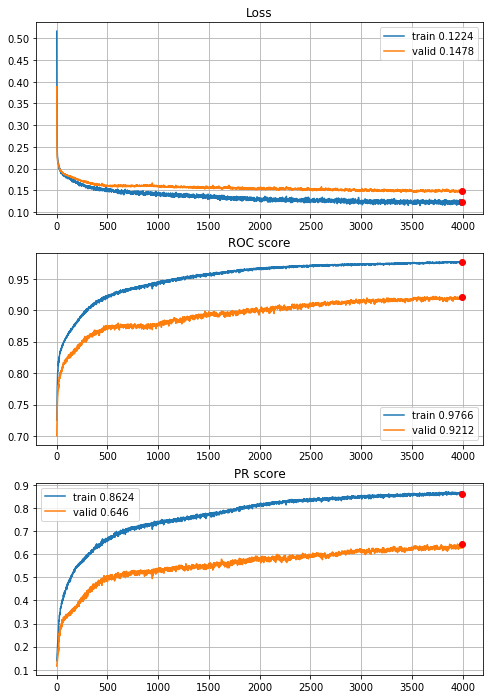


Fold 2------------------------------------------------------------


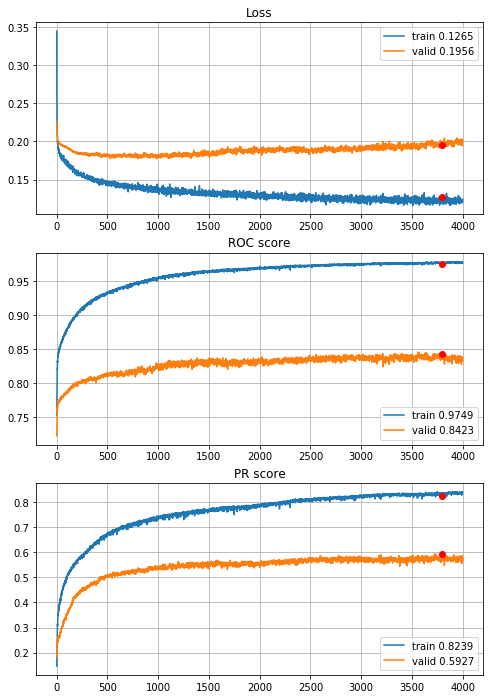


Fold 3------------------------------------------------------------


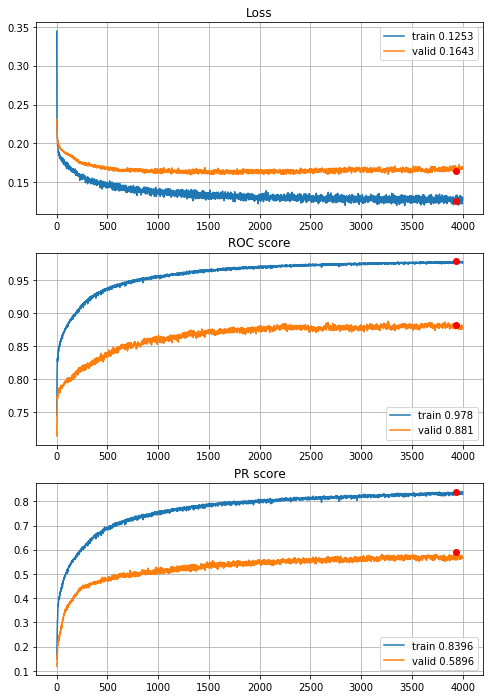


Fold 4------------------------------------------------------------


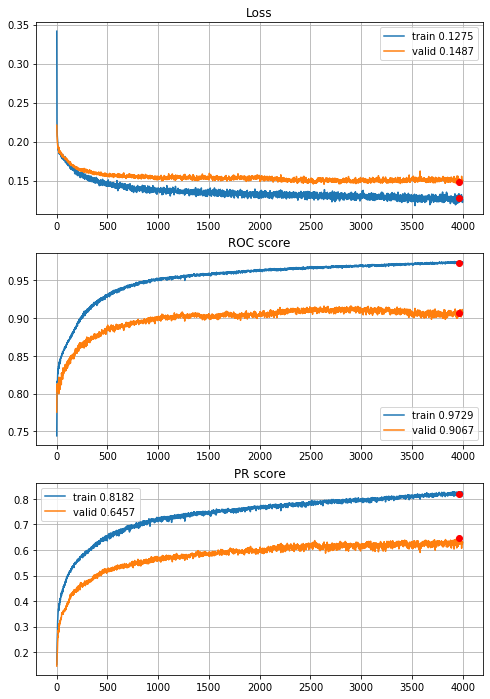


Fold 5------------------------------------------------------------


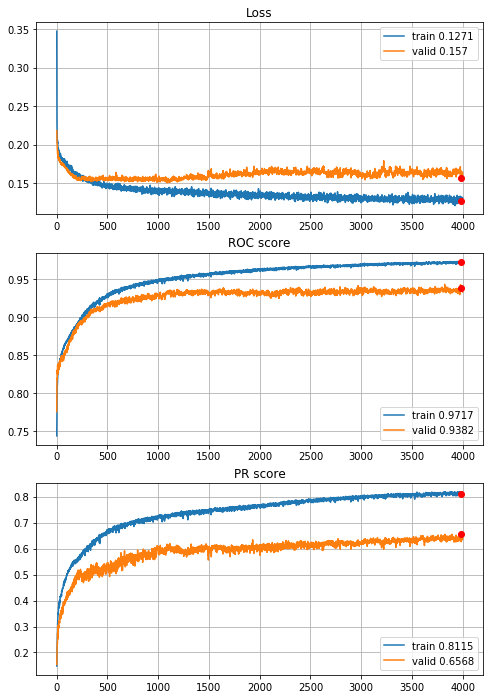


Fold 6------------------------------------------------------------


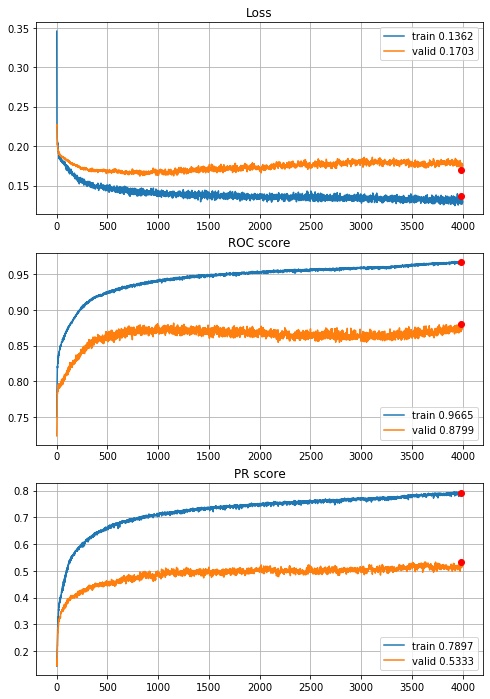

In [41]:
# two layers, L1 regu on two layers, 4000 epochs, THE BEST ONE
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=4000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\4year\MLP_L1_4000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

This model doesn't stop, looks like sky is the limit. Now overfitting is simillar to the MLP for one year forecast horizon, the differences are:
 - more epoch needed to achive similar overfitting level,
 - results are slightly worse, but not too much, 0.61 PR AUC vs 0.633 PR AUC.
 - folds results are more similar (less variance)
 
To sum up, the best Multilayer Percepton specification:
 - 2 layers $l^{[1]},l^{[2]}$,
 - units: $u^{[1]}=60, u^{[2]}=60$,
 - activations: $a^{[1]}:tanh,a^{[2]}:\sigma$,
 - dropout: $d^{[1]}=0.4,d^{[2]}=0.4$,
 - regularization: $L_1^{[1]}=0.00005,L_1^{[2]}=0.00005$,
 - optimizer: Adam with default setings,
 - 3972 epochs,
 - 394 batch size.
 
 ##### Convolutional Neural Network
 - functions for Monte Carlo Energy objective quasi-minimization (Tadaaki Hosaka 2019):
 
 $$E=\sum_{(i,j)\in \xi}|\phi[R(i),R(j)]|*d(i,j) $$
 where:<br>
 $d(i,j)=(x(i)-x(j))^2+(y(i)-y(j))^2$ - distance measure, <br>
 $i,j$ - pixels indices, <br>
 $x(i), y(i)$ - $xy-$coordinates of pixel $i$, <br>
 $\xi$ - set of all pixels combinations (sample space), <br>
 $R(i)$ - financial ratio for pixel $i$,<br>
 $\phi(\cdot)$ - correlation coefficient, <br>

when randomly swapped ratio for pair of pixels can reduce energy, they're swapped. Simulation ends when there is no reduction after $\alpha N$ steps, where $N$ is number of features.<br>
The idea of image with correlated features close to each other is based on correlation matrix (below) and the fact that pixels are dependent from their neighbours on the real pictures - when we have image of black cat sitting on the white pillow, then: $$P(pixel_{i}=black|pixel_{j}=black) > P(pixel_{i}=black|pixel_{j}=white)$$ where $d(i,j)=\varepsilon$

In [36]:
# raw imputed data
X_train = train_test_imp_sets["train_set_imp"][features]
Y_train = train_test_imp_sets["train_set_imp"][target]

# normalization
sclr=scaler(images=False)
sclr.fit(X=X_train ,q=None, power_transform=False)
X_train_norm=pd.DataFrame(sclr.transform(X=X_train),columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995)
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=False)
X_train_clip_norm=pd.DataFrame(sclr.transform(X=X_train), columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995) and power transform
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=True)
X_train_clip_norm_pt=pd.DataFrame(sclr.transform(X=X_train), columns=features)

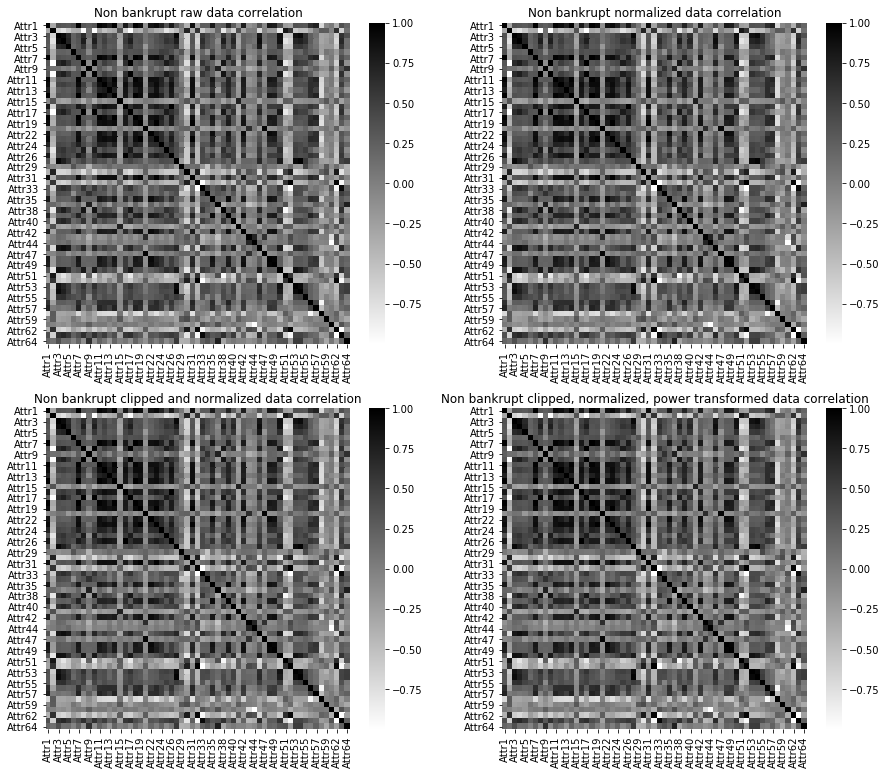

In [37]:
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(15,13))

sns.heatmap(X_train[Y_train==0].corr(method="spearman"),cmap="binary",annot=False, cbar=True, ax=ax[0,0])
ax[0,0].set_title("Non bankrupt raw data correlation")
sns.heatmap(X_train_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[0,1])
ax[0,1].set_title("Non bankrupt normalized data correlation")
sns.heatmap(X_train_clip_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,0])
ax[1,0].set_title("Non bankrupt clipped and normalized data correlation")
sns.heatmap(X_train_clip_norm_pt[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,1])
ax[1,1].set_title("Non bankrupt clipped, normalized, power transformed data correlation")

plt.show()

Analytical differences between correlation matrix variants presented above

In [38]:
corrs=[X_train[Y_train==0].corr(method="spearman"),
       X_train_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm_pt[Y_train==0].corr(method="spearman")]

print(np.sum(np.sum(np.abs(corrs[0]-corrs[1])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[2]-corrs[3])))/2)

0.0
0.0
0.0
0.0
0.0
0.0


Correlation matrix is robust to applied transformations.

In [36]:
def distance(x1, x2, y1, y2):
    '''
    function computes distance between two points (Tadaaki Hosaka 2019)
    arguments:
    x1, y2 - xy-coordinates of the first point
    x2, y2 - xy-coordinates of the second point
    
    return distance (scalar)
    '''
    d = (x1-x2)**2+(y1-y2)**2
    return d

def image_energy_v3(image, cor_matrix):
    '''
    function computes Energy for given image (Tadaaki Hosaka 2019).
    
    Energy = sum |c[R(i), R(j)]|d(i,j)
    d(i,j) = (x(i)-x(j))^2+(y(i)-y(j))^2
    where:
    i, j - indices of pixels,
    x(i), x(j) - xy coordinates of pixel,
    R(i) - feature for i,
    c[R(i), R(j)] - correlation coefficient between R(i) and R(j)
    
    arguments:
    image - dictionary (attributes names, xy coordinates) 
    corr_matrix - correlation matrix computed for analyzed data 
    
    return calculated Energy (scalar)
    ----
    188 times faster than first version
    '''
    # absolute value of correlation matrix - could be performed outside for loop
    cor_matrix = abs(cor_matrix)
    # energy inicjation
    E = 0
    # extracting features names
    for feature1 in image.keys():
        for feature2 in image.keys():
            # looking for correlation between features in previously computed (given) correlation matrix
            cor = cor_matrix.loc[feature1, feature2]
            # computing distance 
            d = distance(image[feature1][0], image[feature2][0], image[feature1][1], image[feature2][1])
            # computing energy
            E += cor*d
    
    # because of double counting returned energy is a half of computed
    # note: when feature1 = feature2 <=> distance = 0
    return E/2

def image_dict_to_matrix(image_dict):
    '''
    function converts dictionary to matrix draft of image, arguments:
    image_dict - dictionary to convert, keys: attribute, value: tuple of xy-coordinates,
    
    return matrix image draft 
    '''
    from math import ceil
    shape = ceil(len(image_dict)**(1/2))
    
#     matrix = np.zeros((shape,shape))+128
#     matrix = matrix.astype(object)
    matrix = np.zeros((shape,shape), dtype=object)+128
    for cords in list(image_dict.values()):
        matrix[cords[0], cords[1]] = list(image_dict.keys())[list(image_dict.values()).index(cords)]
    
    return matrix

def map_image(draft, example):
    '''
    function converts draft to image for concrete example, arguments:
    draft - matrix with order of features in image xy-coordinate system, matrix element must match example indices
    example - pandas.Series contains single observation - example indices must match draft values
    
    return numpy.array() - matrix with values for given example with draft order
    '''
    draft_tmp = draft.copy()
    
    for i in range(draft_tmp.shape[0]):
        for j in range(draft_tmp.shape[1]):
            attr = draft_tmp[i,j]
            draft_tmp[i,j] = example[attr] if attr != 128 else 128
    
    #draft_tmp=draft_tmp.astype(np.float)
    draft_tmp=draft_tmp.astype(np.uint8)
    
    return draft_tmp

def image_draft_inicialization(features, random_state):
    '''
    function inicializes draft in dictionary form, keys=feature names, values=position in the image space
    (xy-coordinates in the integers space), arguments:
    
    features - list of the features in dataset for which draft is inicialized,
    random_state - random seed
    
    return draft_dict (python dictionary inicialized draft)
    ----------
    Note: generated draft is for square-shaped image => range(x)=range(y)=ceil(len(features)**(1/2)), but image space
          is created like grid iterating all columns for all rows, thus if len(features) is not a perfect square then
          some potential coordinates are excluded from image space, and as conversion process progress this coordinates
          becomes placeholders, and are not consider while Monte Carlo quasi optimization. When len(features)**(1/2) - its
          ceil = 1 then there is only one placeholder - just right bottom one coordinate, when difference is in range
          [1, range(x)] then the last row of image contains placeholders, if difference is equal to range(x)+1 then 
          placeholders are the last row and new right bottom corner, if difference is in range [range(x)+1, 2*range(x)]
          then two last rows are placeholders etc. It is the best currently found solution for computing non-biased energy
          which is as low as possible.
    '''
    # seeds
    random.seed(random_state)
    np.random.seed(random_state)
    
    from math import ceil
    shape = ceil(len(features)**(1/2))

    # keys
    ks = features.copy()
    # values
    vs = []
    for i in range(shape):
        for j in range(shape):
            vs.append((i,j))
            
    # dictionary
    draft_dict = dict(zip(ks,vs))
    
    return draft_dict

def MC_Energy_optimization(corr_matrix, draft, alpha, n_eval, random_state):
    '''
    function performes Monte Carlo quasi optimization for Energy objective (Tadaaki Hosaka 2019), arguments:
    corr_matrix - correlation matrix (pandas DataFrame),
    draft - initial draft for image to optimize,
    alpha - parameter that impact on simulation duration (3 in Hosakas' article),
    n_eval - number of iteration per which current state is printed,
    random_state - random seed
    
    return ordered draft
    '''
    random.seed(random_state)
    np.random.seed(random_state)
    
    start = time.time()
    initial_energy = image_energy_v3(draft, corr_matrix)
    print("initial image energy:", round(initial_energy, 4))

    energy = initial_energy
    stop_criterion = 0
    i = 0
    while stop_criterion < alpha*len(features):
        draft_tmp = draft.copy()
        # coordinates pair sampling
        xy1, xy2 = random.sample(list(draft_tmp.values()), 2)
        # feature name under coordinates
        ft1 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy1)]
        ft2 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy2)]
        # coordinates swap
        draft_tmp[ft1] = xy2
        draft_tmp[ft2] = xy1
        # new energy
        energy_new = image_energy_v3(draft_tmp, corr_matrix)
        # saving changes
        if energy_new < energy:
            energy = energy_new
            draft = draft_tmp.copy()
            stop_criterion = 0
        else:
            stop_criterion += 1
        i += 1
        # evaluation
        if i%n_eval == 0:
            print("iteration: {}\ncurrent energy: {}".format(i, round(energy, 4)))
    
    stop = time.time()
    print("MC simulation time: {}s\nenergy after MC quasi optimization: {}".format(round(stop-start), round(energy, 4)))
    
    return draft

 - CNN definitions

In [37]:
def define_CNN(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model

def define_CNN_Adam(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

 - 6-fold Cross Validation CNN

In [38]:
def CNN_6FoldCrossValidation(datasets, model_definition, features, target, n_epochs, batch_size, alpha, random_state,
                             normalize="power", q=None, drafts=None, instruction=None, info=None):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    alpha - Monte Carlo duration parameter,
    random_state - random seed,
    info - same arguent as for network_training(),
    *args and **kwargs - arguments for create_MLP() function
    
    returns CNNhistories - list of every CNN model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]
    
    CVstart=time.time()
    # history of CV
    CNNhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        
        if drafts is None and instruction is None:
            # ----- current fold train and validation sets ------
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- Monte Carlo energy optimization -----
            # correlation matrix for non bankrupt observations
            corr_matrix = X_train[Y_train==0].corr(method="spearman")
            # draft inicialization
            draft = image_draft_inicialization(features, random_state)
            # quasi optimization
            draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=alpha, n_eval=99999,
                                           random_state=random_state)
            # transform draft dictionary to matrix
            draft = image_dict_to_matrix(draft)
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
        
        elif drafts is not None and instruction is None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()    
            
        elif drafts is not None and instruction is not None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = generate_features(data=training_sets[fold][features], instruction=instruction)
            Y_train = training_sets[fold][target].copy()
            X_valid = generate_features(data=validation_sets[fold][features].copy(), instruction=instruction)
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
            
        else:
            raise "valid options are: drafts=None and instruction=None, drafts!=None and instruction=None, drafts!=None and instruction!=None"
            
        # ----- standarization for CNN (images) -----
        if normalize==True:
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        elif normalize=="power":
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        else:
            pass
            
        # ----- vector to image conversion -----
        # training set
        X_train_CNN = np.array([map_image(draft, X_train.iloc[i,:])/255 for i in range(X_train.shape[0])])
        X_train_CNN = X_train_CNN.reshape(X_train_CNN.shape+(1,))
        Y_train_CNN = Y_train.values
        # validation set
        X_valid_CNN = np.array([map_image(draft, X_valid.iloc[i,:])/255 for i in range(X_valid.shape[0])])
        X_valid_CNN = X_valid_CNN.reshape(X_valid_CNN.shape+(1,))
        Y_valid_CNN = Y_valid.values
        
        # ----- CNN training -----
        modelCNN = model_definition(input_shape=X_train_CNN.shape[1:], random_state=random_state)
        modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN, Y_train=Y_train_CNN,
                                                X_val=X_valid_CNN, Y_val=Y_valid_CNN, n_epochs=n_epochs,
                                                batch_size=batch_size, random_state=random_state, info=info)
        # ----- MLP history saving -----
        CNNhistories.append(historyCNN.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return CNNhistories


----------
Fold: 1
----------
initial image energy: 12196.4678
MC simulation time: 93s
energy after MC quasi optimization: 7820.3031
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 2.33s train loss: 0.2215055211126423, validation loss: 0.21083295595856894
Epoch: 2/100,
cumulative time: 3.67s train loss: 0.21788882840504425, validation loss: 0.20511581161908343
Epoch: 3/100,
cumulative time: 5.03s train loss: 0.21156073192289995, validation loss: 0.20598538673354136
Epoch: 4/100,
cumulative time: 6.43s train loss: 0.21002857961561153, validation loss: 0.2027884417747948
Epoch: 5/100,
cumulative time: 7.8s train loss: 0.20676512746326803, validation loss: 0.19715408938242676
Epoch: 6/100,
cumulative time: 9.17s train loss: 0.19920858364777005, validation loss: 0.21776867288160356
Epoch: 7/100,
cumulative time: 10.53s train loss: 0.19940665631321525, validation loss: 0.19476296719724098
Epoch: 8/100,
cumulative time: 11.89s train loss: 0.19601696072775127, 

Epoch: 76/100,
cumulative time: 106.69s train loss: 0.161373241889644, validation loss: 0.18015674753729546
Epoch: 77/100,
cumulative time: 108.05s train loss: 0.1629158196950274, validation loss: 0.17792602305391195
Epoch: 78/100,
cumulative time: 109.45s train loss: 0.16194397092360688, validation loss: 0.1855083330197753
Epoch: 79/100,
cumulative time: 110.82s train loss: 0.15893410899005825, validation loss: 0.19645610080437242
Epoch: 80/100,
cumulative time: 112.24s train loss: 0.16300258555261962, validation loss: 0.17997379735913546
Epoch: 81/100,
cumulative time: 113.6s train loss: 0.15897210570815537, validation loss: 0.18336092042143934
Epoch: 82/100,
cumulative time: 114.95s train loss: 0.1617616162213418, validation loss: 0.1789088864323231
Epoch: 83/100,
cumulative time: 116.37s train loss: 0.15915607993205497, validation loss: 0.18442228674848035
Epoch: 84/100,
cumulative time: 117.78s train loss: 0.15671346764887253, validation loss: 0.18024134795182087
Epoch: 85/100,
cu

Epoch: 48/100,
cumulative time: 66.01s train loss: 0.17491411190948256, validation loss: 0.196499819188316
Epoch: 49/100,
cumulative time: 67.41s train loss: 0.17594105975676277, validation loss: 0.19224850293768758
Epoch: 50/100,
cumulative time: 68.8s train loss: 0.17415950349001277, validation loss: 0.18668563790756315
Epoch: 51/100,
cumulative time: 70.21s train loss: 0.17341113606769448, validation loss: 0.19259932805600824
Epoch: 52/100,
cumulative time: 71.62s train loss: 0.1749331643316607, validation loss: 0.19697703339965916
Epoch: 53/100,
cumulative time: 72.99s train loss: 0.1727844688660375, validation loss: 0.18559385921331878
Epoch: 54/100,
cumulative time: 74.41s train loss: 0.17146619132424543, validation loss: 0.19274845061008422
Epoch: 55/100,
cumulative time: 75.81s train loss: 0.17331002725497036, validation loss: 0.18635297052871622
Epoch: 56/100,
cumulative time: 77.2s train loss: 0.17113431554983216, validation loss: 0.19812212551711286
Epoch: 57/100,
cumulative

Epoch: 20/100,
cumulative time: 29.1s train loss: 0.192230492288453, validation loss: 0.20006697346476002
Epoch: 21/100,
cumulative time: 30.47s train loss: 0.18893644643685448, validation loss: 0.22052568856593782
Epoch: 22/100,
cumulative time: 31.83s train loss: 0.1889335696401444, validation loss: 0.19577319148124037
Epoch: 23/100,
cumulative time: 33.23s train loss: 0.190120555739482, validation loss: 0.19255981325007687
Epoch: 24/100,
cumulative time: 34.6s train loss: 0.1879999004603731, validation loss: 0.2059062725735652
Epoch: 25/100,
cumulative time: 35.99s train loss: 0.18458735229744017, validation loss: 0.19609582956710422
Epoch: 26/100,
cumulative time: 37.36s train loss: 0.1881923748734016, validation loss: 0.1983927291031189
Epoch: 27/100,
cumulative time: 38.72s train loss: 0.18657701953699685, validation loss: 0.19889401511078061
Epoch: 28/100,
cumulative time: 40.08s train loss: 0.18391186670818366, validation loss: 0.19794029771388996
Epoch: 29/100,
cumulative time

Epoch: 96/100,
cumulative time: 134.97s train loss: 0.1577713274670024, validation loss: 0.20011421005445082
Epoch: 97/100,
cumulative time: 136.42s train loss: 0.15530836443785473, validation loss: 0.202151824516695
Epoch: 98/100,
cumulative time: 137.87s train loss: 0.15568770694299208, validation loss: 0.19890049336271434
Epoch: 99/100,
cumulative time: 139.27s train loss: 0.1596533442150746, validation loss: 0.20375886911474336
Epoch: 100/100,
cumulative time: 140.72s train loss: 0.15448457826130335, validation loss: 0.20147859415202987

Early stopping results:
best results in epoch: 9, 
best valid PR: 0.16107988817016763, 
valid ROC: 0.6909986565158979        
overfitting PR: -0.03307474984891692, 
overfitting ROC: 0.012380204451659216

----------
Fold: 4
----------
initial image energy: 12250.0195
MC simulation time: 92s
energy after MC quasi optimization: 7847.4119
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 2.21s train loss: 0.2192975184856733

Epoch: 69/100,
cumulative time: 98.49s train loss: 0.16557526042354898, validation loss: 0.18192182134372836
Epoch: 70/100,
cumulative time: 99.89s train loss: 0.1648284260370776, validation loss: 0.18229286212390422
Epoch: 71/100,
cumulative time: 101.26s train loss: 0.1654574855985522, validation loss: 0.186931009333989
Epoch: 72/100,
cumulative time: 102.66s train loss: 0.16182710762433358, validation loss: 0.2153847534957591
Epoch: 73/100,
cumulative time: 104.05s train loss: 0.16548067926102367, validation loss: 0.18926417043494723
Epoch: 74/100,
cumulative time: 105.43s train loss: 0.1637781207829848, validation loss: 0.18604701403414334
Epoch: 75/100,
cumulative time: 106.82s train loss: 0.1637835653340737, validation loss: 0.1892863480695013
Epoch: 76/100,
cumulative time: 108.2s train loss: 0.16539062676898272, validation loss: 0.18165723551407081
Epoch: 77/100,
cumulative time: 109.59s train loss: 0.16297382386011924, validation loss: 0.18327184581407646
Epoch: 78/100,
cumula

Epoch: 41/100,
cumulative time: 59.96s train loss: 0.18052956536980366, validation loss: 0.17465057171251858
Epoch: 42/100,
cumulative time: 61.41s train loss: 0.18158278694632007, validation loss: 0.17450540021508526
Epoch: 43/100,
cumulative time: 62.88s train loss: 0.17819066745409648, validation loss: 0.1793060916442962
Epoch: 44/100,
cumulative time: 64.32s train loss: 0.1800691263064385, validation loss: 0.17443620070449664
Epoch: 45/100,
cumulative time: 65.71s train loss: 0.18043308499754124, validation loss: 0.17392553228692073
Epoch: 46/100,
cumulative time: 67.17s train loss: 0.17712522242502318, validation loss: 0.18217363986072488
Epoch: 47/100,
cumulative time: 68.68s train loss: 0.17478469379189424, validation loss: 0.1723137842212126
Epoch: 48/100,
cumulative time: 70.1s train loss: 0.1763600547735078, validation loss: 0.1716226309700298
Epoch: 49/100,
cumulative time: 71.55s train loss: 0.1792201151612797, validation loss: 0.1721758301844389
Epoch: 50/100,
cumulative t

Epoch: 14/100,
cumulative time: 21.02s train loss: 0.19220476729028366, validation loss: 0.21023632703749945
Epoch: 15/100,
cumulative time: 22.41s train loss: 0.19315899551434196, validation loss: 0.19478241396859816
Epoch: 16/100,
cumulative time: 23.82s train loss: 0.19245443149816757, validation loss: 0.19797304404610183
Epoch: 17/100,
cumulative time: 25.21s train loss: 0.19039807566045935, validation loss: 0.19788581585607998
Epoch: 18/100,
cumulative time: 26.61s train loss: 0.19128504097218219, validation loss: 0.2016067064953435
Epoch: 19/100,
cumulative time: 28.01s train loss: 0.18877530821106014, validation loss: 0.2003183641778026
Epoch: 20/100,
cumulative time: 29.39s train loss: 0.19036980205436677, validation loss: 0.19884173862372173
Epoch: 21/100,
cumulative time: 30.8s train loss: 0.18937763073816408, validation loss: 0.1905529643802292
Epoch: 22/100,
cumulative time: 32.2s train loss: 0.1906453053262044, validation loss: 0.18751859648675945
Epoch: 23/100,
cumulative

Epoch: 90/100,
cumulative time: 129.59s train loss: 0.1651501565530474, validation loss: 0.18031580648727574
Epoch: 91/100,
cumulative time: 131.03s train loss: 0.16457047172637418, validation loss: 0.19540310900770028
Epoch: 92/100,
cumulative time: 132.58s train loss: 0.16172823328362507, validation loss: 0.22478635383805398
Epoch: 93/100,
cumulative time: 134.08s train loss: 0.16365770797989856, validation loss: 0.18842904318418424
Epoch: 94/100,
cumulative time: 135.54s train loss: 0.1646850164634762, validation loss: 0.17501523694891372
Epoch: 95/100,
cumulative time: 137.13s train loss: 0.16328818778748866, validation loss: 0.17547710406357975
Epoch: 96/100,
cumulative time: 138.75s train loss: 0.16216937857751038, validation loss: 0.1768420990302712
Epoch: 97/100,
cumulative time: 140.24s train loss: 0.16209022463999348, validation loss: 0.18406730494398513
Epoch: 98/100,
cumulative time: 141.65s train loss: 0.15793164489559489, validation loss: 0.176700858942332
Epoch: 99/100,


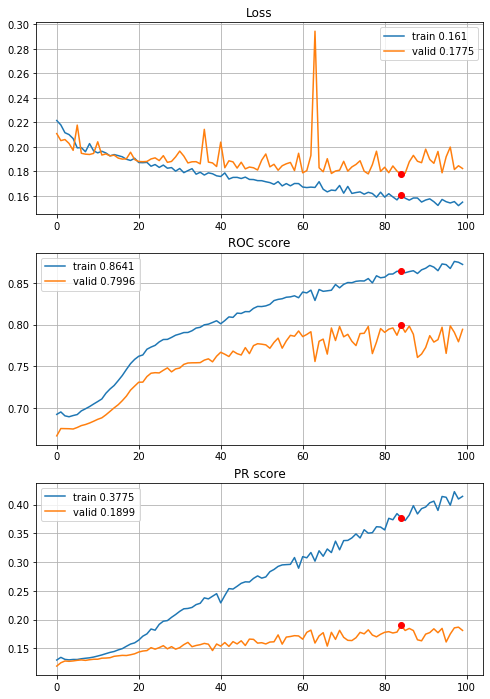


Fold 2------------------------------------------------------------


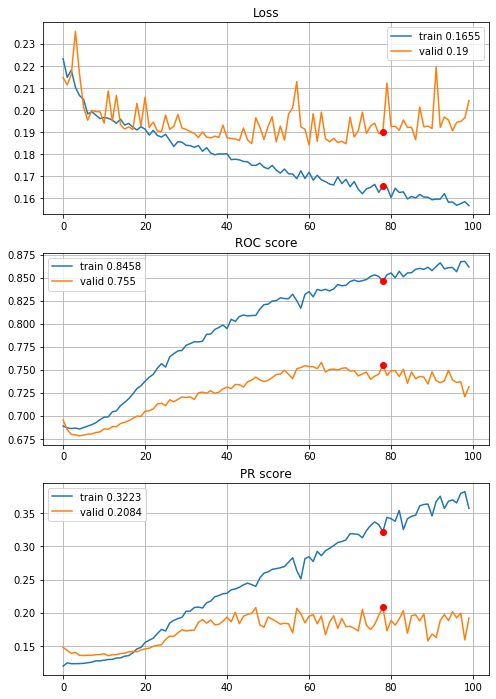


Fold 3------------------------------------------------------------


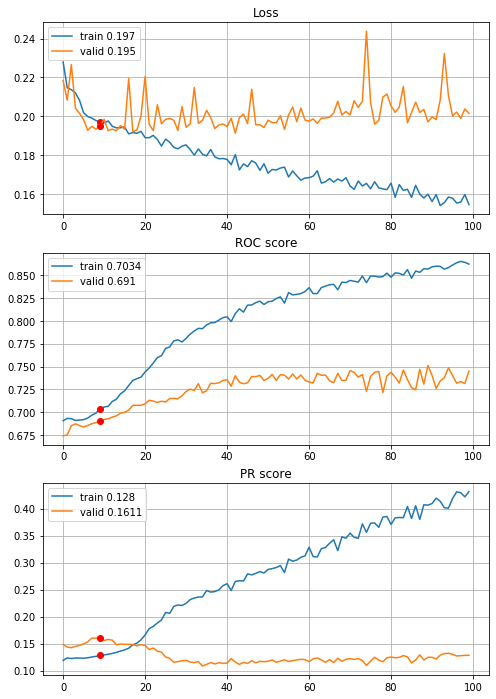


Fold 4------------------------------------------------------------


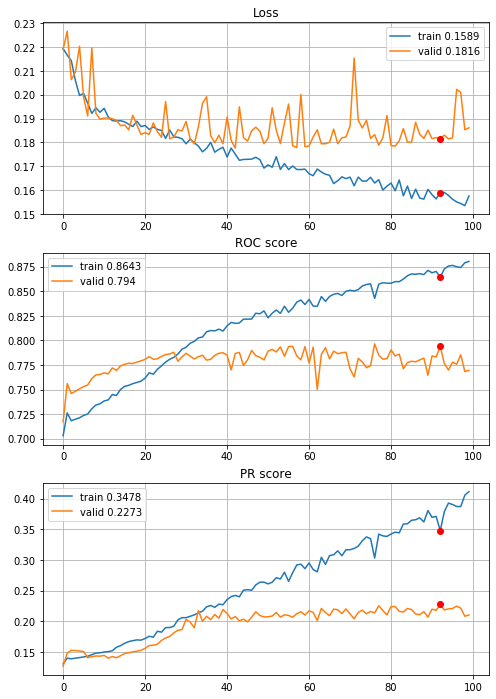


Fold 5------------------------------------------------------------


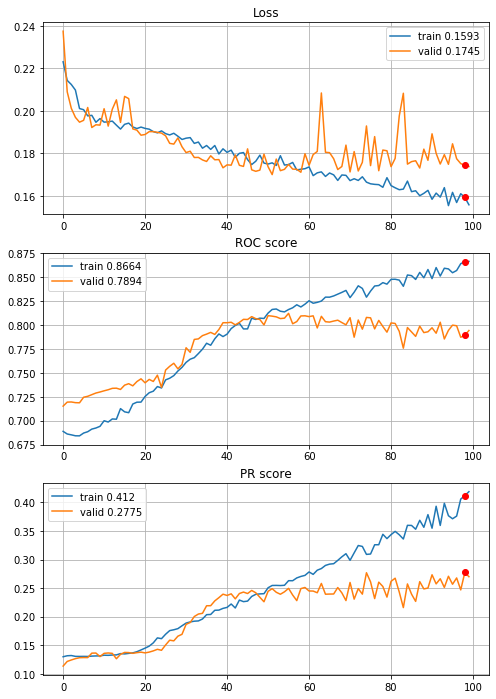


Fold 6------------------------------------------------------------


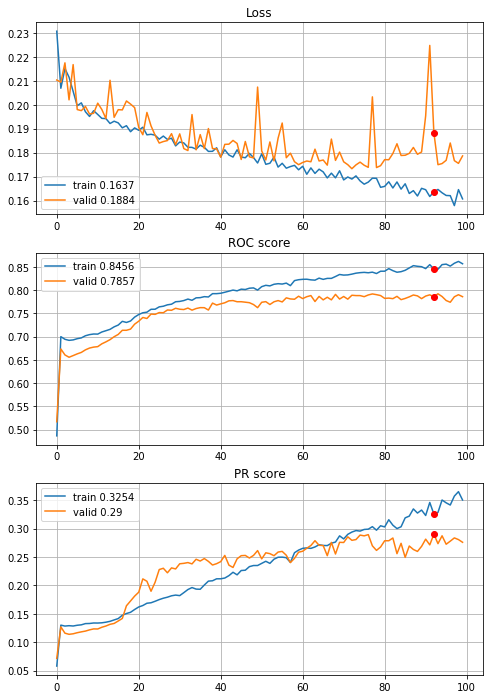

In [44]:
# first CNN only normalization applied
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=None, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])


----------
Fold: 1
----------
initial image energy: 12196.4678
MC simulation time: 93s
energy after MC quasi optimization: 7820.3031
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 2.23s train loss: 0.22016446080947139, validation loss: 0.2178960143809744
Epoch: 2/100,
cumulative time: 3.66s train loss: 0.21775254740728664, validation loss: 0.1980268433537915
Epoch: 3/100,
cumulative time: 5.1s train loss: 0.20236859920197606, validation loss: 0.19899380855247065
Epoch: 4/100,
cumulative time: 6.53s train loss: 0.19926236164224062, validation loss: 0.19243354855994127
Epoch: 5/100,
cumulative time: 8.0s train loss: 0.19757795893949529, validation loss: 0.19058537533934056
Epoch: 6/100,
cumulative time: 9.41s train loss: 0.19109741436327962, validation loss: 0.22832207093642956
Epoch: 7/100,
cumulative time: 10.83s train loss: 0.19206655017973762, validation loss: 0.18993489067922895
Epoch: 8/100,
cumulative time: 12.25s train loss: 0.1894312158833728, va

Epoch: 76/100,
cumulative time: 109.53s train loss: 0.11740287629948087, validation loss: 0.18366525654406513
Epoch: 77/100,
cumulative time: 110.96s train loss: 0.12048602049497335, validation loss: 0.18341343192075532
Epoch: 78/100,
cumulative time: 112.4s train loss: 0.11403029681623883, validation loss: 0.19310700601262248
Epoch: 79/100,
cumulative time: 113.81s train loss: 0.11001873937812517, validation loss: 0.20183369182582775
Epoch: 80/100,
cumulative time: 115.24s train loss: 0.10899124033855642, validation loss: 0.19696612716978953
Epoch: 81/100,
cumulative time: 116.64s train loss: 0.11360216910055283, validation loss: 0.21523259552747234
Epoch: 82/100,
cumulative time: 118.06s train loss: 0.11351040458319607, validation loss: 0.19333836843035837
Epoch: 83/100,
cumulative time: 119.45s train loss: 0.10654423163142691, validation loss: 0.2128475623482989
Epoch: 84/100,
cumulative time: 120.89s train loss: 0.10600197651369864, validation loss: 0.20262509900911718
Epoch: 85/10

Epoch: 48/100,
cumulative time: 70.01s train loss: 0.13898886674864164, validation loss: 0.21294075001089488
Epoch: 49/100,
cumulative time: 71.48s train loss: 0.14130719650466259, validation loss: 0.19867279576841385
Epoch: 50/100,
cumulative time: 72.91s train loss: 0.13948851932171466, validation loss: 0.19860455988214648
Epoch: 51/100,
cumulative time: 74.31s train loss: 0.13743547325918073, validation loss: 0.1930324983604917
Epoch: 52/100,
cumulative time: 75.75s train loss: 0.13678307803688883, validation loss: 0.22015598643548315
Epoch: 53/100,
cumulative time: 77.15s train loss: 0.13098429954134766, validation loss: 0.20331624482991015
Epoch: 54/100,
cumulative time: 78.55s train loss: 0.1307806291277672, validation loss: 0.2220438707840532
Epoch: 55/100,
cumulative time: 79.95s train loss: 0.1361847289285039, validation loss: 0.2056903934969717
Epoch: 56/100,
cumulative time: 81.41s train loss: 0.12171722945101365, validation loss: 0.20215239763827939
Epoch: 57/100,
cumulativ

Epoch: 20/100,
cumulative time: 29.55s train loss: 0.17887329117090717, validation loss: 0.20138687522253915
Epoch: 21/100,
cumulative time: 30.97s train loss: 0.17252073515205055, validation loss: 0.24339933290702295
Epoch: 22/100,
cumulative time: 32.37s train loss: 0.17397964463179724, validation loss: 0.19006050874620495
Epoch: 23/100,
cumulative time: 33.78s train loss: 0.17435889429638923, validation loss: 0.19092037225962497
Epoch: 24/100,
cumulative time: 35.19s train loss: 0.1701075123978395, validation loss: 0.22684140725554536
Epoch: 25/100,
cumulative time: 36.6s train loss: 0.16823123871517104, validation loss: 0.19550644088513677
Epoch: 26/100,
cumulative time: 38.0s train loss: 0.17129444595653096, validation loss: 0.1949466781359777
Epoch: 27/100,
cumulative time: 39.4s train loss: 0.16738294011019206, validation loss: 0.20350137014142342
Epoch: 28/100,
cumulative time: 40.81s train loss: 0.16396574507807737, validation loss: 0.19125469235882134
Epoch: 29/100,
cumulativ

Epoch: 96/100,
cumulative time: 138.98s train loss: 0.07819766116630524, validation loss: 0.28503670795504293
Epoch: 97/100,
cumulative time: 140.4s train loss: 0.07987614108210735, validation loss: 0.2699396980100947
Epoch: 98/100,
cumulative time: 141.81s train loss: 0.08751135795646965, validation loss: 0.2589837455522292
Epoch: 99/100,
cumulative time: 143.24s train loss: 0.07338919287950031, validation loss: 0.36866870800437695
Epoch: 100/100,
cumulative time: 144.65s train loss: 0.08037581654773102, validation loss: 0.2762295494199692

Early stopping results:
best results in epoch: 51, 
best valid PR: 0.1717044621617554, 
valid ROC: 0.7678478131064337        
overfitting PR: 0.39521569404932044, 
overfitting ROC: 0.15125666361623202

----------
Fold: 4
----------
initial image energy: 12250.0195
MC simulation time: 89s
energy after MC quasi optimization: 7847.4119
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 2.38s train loss: 0.21905571002937801,

Epoch: 69/100,
cumulative time: 98.39s train loss: 0.1148957441870773, validation loss: 0.18391760031409293
Epoch: 70/100,
cumulative time: 99.8s train loss: 0.11980453528891008, validation loss: 0.18383919604381305
Epoch: 71/100,
cumulative time: 101.21s train loss: 0.11367582382354492, validation loss: 0.2610729327406341
Epoch: 72/100,
cumulative time: 102.62s train loss: 0.11155980142767156, validation loss: 0.22170309586497372
Epoch: 73/100,
cumulative time: 104.02s train loss: 0.11187189020724805, validation loss: 0.19869774529283107
Epoch: 74/100,
cumulative time: 105.44s train loss: 0.11712645820691932, validation loss: 0.19095479611274416
Epoch: 75/100,
cumulative time: 106.85s train loss: 0.11247314368953631, validation loss: 0.19095351287830112
Epoch: 76/100,
cumulative time: 108.25s train loss: 0.11447512826789842, validation loss: 0.22550717135162238
Epoch: 77/100,
cumulative time: 109.67s train loss: 0.10512007786518836, validation loss: 0.2158850206251125
Epoch: 78/100,
c

Epoch: 42/100,
cumulative time: 59.6s train loss: 0.15675964636610484, validation loss: 0.17243796753461094
Epoch: 43/100,
cumulative time: 61.01s train loss: 0.15668780645375874, validation loss: 0.1802895577264092
Epoch: 44/100,
cumulative time: 62.42s train loss: 0.1569645670293333, validation loss: 0.1641001048464866
Epoch: 45/100,
cumulative time: 63.81s train loss: 0.15839945097618244, validation loss: 0.16453768850915762
Epoch: 46/100,
cumulative time: 65.21s train loss: 0.15471423330893314, validation loss: 0.1735499370487899
Epoch: 47/100,
cumulative time: 66.6s train loss: 0.1474411231962749, validation loss: 0.16893431980782048
Epoch: 48/100,
cumulative time: 68.0s train loss: 0.15295337177082605, validation loss: 0.16536420522821046
Epoch: 49/100,
cumulative time: 69.4s train loss: 0.15382601021665243, validation loss: 0.16325061638365
Epoch: 50/100,
cumulative time: 70.79s train loss: 0.14913492709446965, validation loss: 0.17158064974994686
Epoch: 51/100,
cumulative time:

Epoch: 14/100,
cumulative time: 20.56s train loss: 0.18463725354400726, validation loss: 0.1980204579372172
Epoch: 15/100,
cumulative time: 21.97s train loss: 0.18572551780633936, validation loss: 0.18742488509384098
Epoch: 16/100,
cumulative time: 23.39s train loss: 0.18356403363929466, validation loss: 0.19123046256459703
Epoch: 17/100,
cumulative time: 24.82s train loss: 0.18202974159100088, validation loss: 0.18655235939519607
Epoch: 18/100,
cumulative time: 26.22s train loss: 0.18208623328499804, validation loss: 0.19297099101283569
Epoch: 19/100,
cumulative time: 27.65s train loss: 0.17816530958767615, validation loss: 0.19895821511339426
Epoch: 20/100,
cumulative time: 29.06s train loss: 0.18038572408340076, validation loss: 0.18468696569227067
Epoch: 21/100,
cumulative time: 30.46s train loss: 0.17923017360740756, validation loss: 0.17638652211395206
Epoch: 22/100,
cumulative time: 31.89s train loss: 0.17878449843356423, validation loss: 0.17371139673348668
Epoch: 23/100,
cumul

Epoch: 90/100,
cumulative time: 129.15s train loss: 0.09231667523323062, validation loss: 0.18665019532396618
Epoch: 91/100,
cumulative time: 130.56s train loss: 0.10128957193957597, validation loss: 0.20653103298078765
Epoch: 92/100,
cumulative time: 131.98s train loss: 0.08434787002637625, validation loss: 0.19063686530742724
Epoch: 93/100,
cumulative time: 133.39s train loss: 0.0956396196374349, validation loss: 0.21150011193687324
Epoch: 94/100,
cumulative time: 134.8s train loss: 0.08631661917389348, validation loss: 0.1910970482457561
Epoch: 95/100,
cumulative time: 136.22s train loss: 0.09366327044117814, validation loss: 0.19382169745273747
Epoch: 96/100,
cumulative time: 137.63s train loss: 0.0869519318086714, validation loss: 0.20820730084132108
Epoch: 97/100,
cumulative time: 139.04s train loss: 0.0887281954560372, validation loss: 0.23071988229449503
Epoch: 98/100,
cumulative time: 140.45s train loss: 0.08497358244500876, validation loss: 0.19447621912251375
Epoch: 99/100,


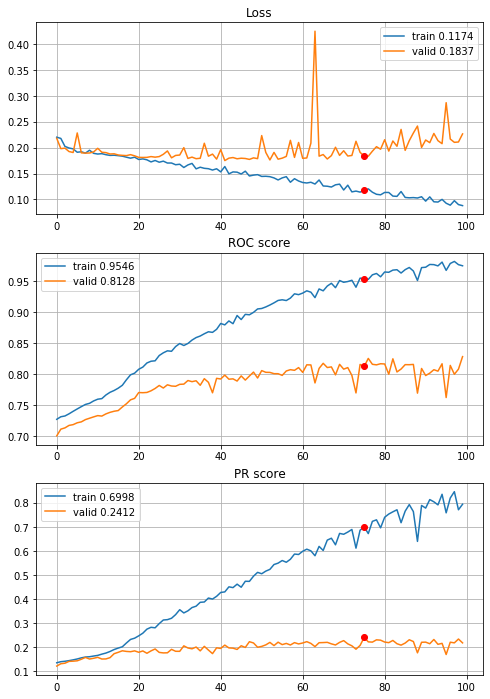


Fold 2------------------------------------------------------------


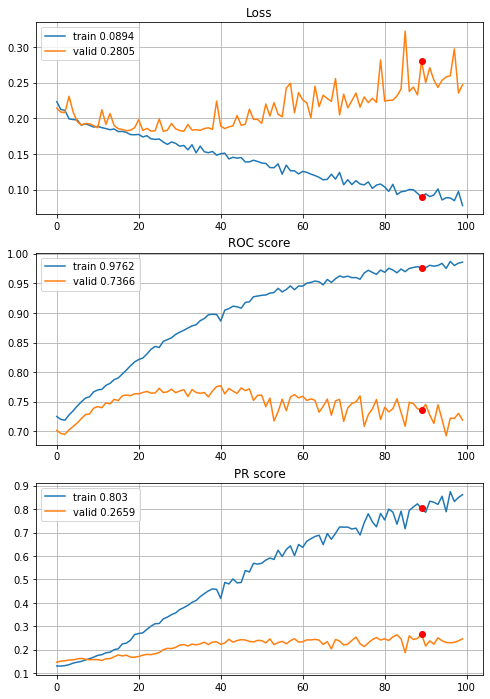


Fold 3------------------------------------------------------------


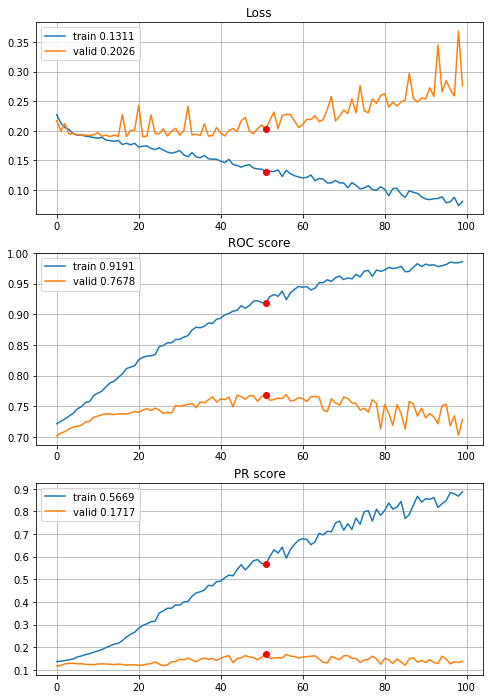


Fold 4------------------------------------------------------------


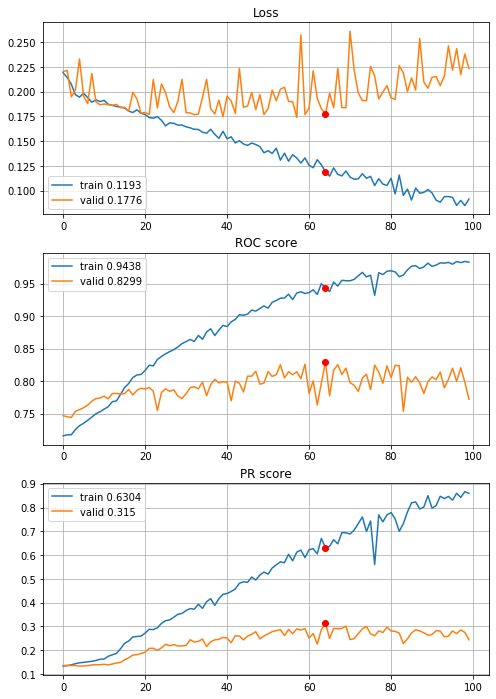


Fold 5------------------------------------------------------------


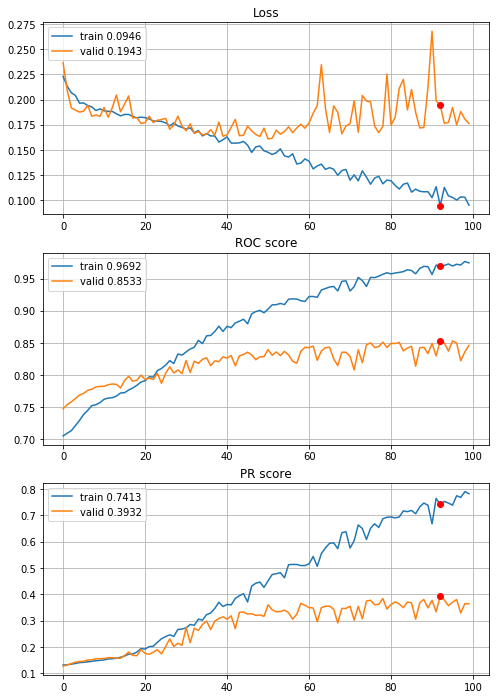


Fold 6------------------------------------------------------------


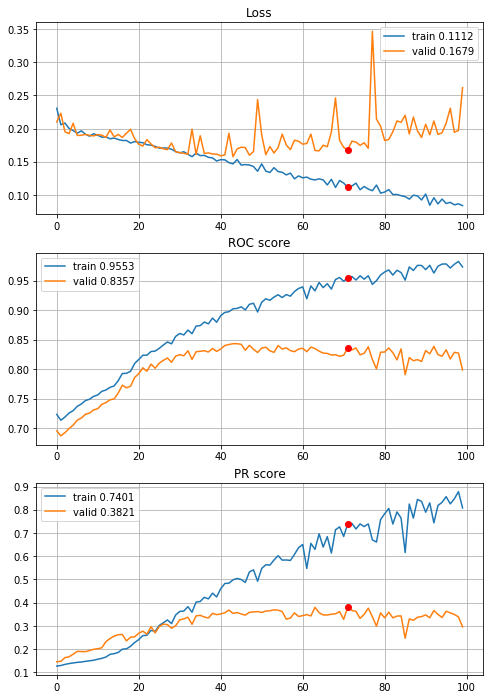

In [45]:
# first CNN with quantile clipping (Q_0.005, Q_0.995) and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Huge improvement, +0.06 on PR, much bigger overfitting, but seems like architecture is not appropriate. Lets try with power transform added.


----------
Fold: 1
----------
initial image energy: 12196.4678
MC simulation time: 95s
energy after MC quasi optimization: 7820.3031
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 2.23s train loss: 0.2192551200248298, validation loss: 0.2054394385171959
Epoch: 2/100,
cumulative time: 3.64s train loss: 0.21340466184275492, validation loss: 0.19485348862722018
Epoch: 3/100,
cumulative time: 5.08s train loss: 0.2018301288868578, validation loss: 0.19412168962887308
Epoch: 4/100,
cumulative time: 6.54s train loss: 0.19886984869413638, validation loss: 0.1916614705259253
Epoch: 5/100,
cumulative time: 8.01s train loss: 0.19773847914255072, validation loss: 0.19036991282577334
Epoch: 6/100,
cumulative time: 9.42s train loss: 0.18892027795249852, validation loss: 0.2338978355538691
Epoch: 7/100,
cumulative time: 10.85s train loss: 0.19371787776345376, validation loss: 0.1895327887785037
Epoch: 8/100,
cumulative time: 12.26s train loss: 0.1880824053793208, vali

Epoch: 76/100,
cumulative time: 111.72s train loss: 0.09563125241469188, validation loss: 0.17043812322405588
Epoch: 77/100,
cumulative time: 113.15s train loss: 0.09868745219475338, validation loss: 0.2024973900627327
Epoch: 78/100,
cumulative time: 114.57s train loss: 0.09889183976045343, validation loss: 0.1899504582946036
Epoch: 79/100,
cumulative time: 116.05s train loss: 0.08865375922294999, validation loss: 0.2113260561974378
Epoch: 80/100,
cumulative time: 117.55s train loss: 0.10201663635828409, validation loss: 0.17828478891886848
Epoch: 81/100,
cumulative time: 119.0s train loss: 0.0947985505637268, validation loss: 0.1772171512317138
Epoch: 82/100,
cumulative time: 120.5s train loss: 0.1028003115838577, validation loss: 0.17164622504870206
Epoch: 83/100,
cumulative time: 121.99s train loss: 0.08872960299156057, validation loss: 0.1731959292379831
Epoch: 84/100,
cumulative time: 123.51s train loss: 0.08956208805833024, validation loss: 0.18405003289814462
Epoch: 85/100,
cumu

Epoch: 49/100,
cumulative time: 73.64s train loss: 0.1395339447983146, validation loss: 0.1845536666856971
Epoch: 50/100,
cumulative time: 75.12s train loss: 0.13532154962580778, validation loss: 0.19450326929334233
Epoch: 51/100,
cumulative time: 76.59s train loss: 0.1345484336993114, validation loss: 0.1853460112524487
Epoch: 52/100,
cumulative time: 78.06s train loss: 0.12713138751424855, validation loss: 0.19777996107743173
Epoch: 53/100,
cumulative time: 79.58s train loss: 0.14089307275233048, validation loss: 0.18499254325241196
Epoch: 54/100,
cumulative time: 81.04s train loss: 0.1259350693186898, validation loss: 0.1911682609171994
Epoch: 55/100,
cumulative time: 82.57s train loss: 0.13367597220700686, validation loss: 0.18505098924821864
Epoch: 56/100,
cumulative time: 84.14s train loss: 0.12210287960571148, validation loss: 0.19212618383970123
Epoch: 57/100,
cumulative time: 85.73s train loss: 0.12982906789971554, validation loss: 0.22526062492451107
Epoch: 58/100,
cumulative

Epoch: 21/100,
cumulative time: 30.67s train loss: 0.17090743399033279, validation loss: 0.2512698838546862
Epoch: 22/100,
cumulative time: 32.09s train loss: 0.1721047361272404, validation loss: 0.19084328146229154
Epoch: 23/100,
cumulative time: 33.51s train loss: 0.16932262194533285, validation loss: 0.19075717186140642
Epoch: 24/100,
cumulative time: 34.94s train loss: 0.16863604928132836, validation loss: 0.22338596018826257
Epoch: 25/100,
cumulative time: 36.4s train loss: 0.1618243597187107, validation loss: 0.20367675352210168
Epoch: 26/100,
cumulative time: 37.82s train loss: 0.17058787470444758, validation loss: 0.19723615122336446
Epoch: 27/100,
cumulative time: 39.25s train loss: 0.16573424704081677, validation loss: 0.20837340270117727
Epoch: 28/100,
cumulative time: 40.68s train loss: 0.15998854323253633, validation loss: 0.2091295496288654
Epoch: 29/100,
cumulative time: 42.12s train loss: 0.16173551170439254, validation loss: 0.2140015098332872
Epoch: 30/100,
cumulative

Epoch: 97/100,
cumulative time: 142.97s train loss: 0.07424306431837227, validation loss: 0.25990491032275803
Epoch: 98/100,
cumulative time: 144.49s train loss: 0.07838917254232734, validation loss: 0.23422089407766977
Epoch: 99/100,
cumulative time: 146.02s train loss: 0.07474395619553376, validation loss: 0.2787889942090636
Epoch: 100/100,
cumulative time: 147.72s train loss: 0.06817099476471822, validation loss: 0.2907677787432791

Early stopping results:
best results in epoch: 71, 
best valid PR: 0.2780537426474306, 
valid ROC: 0.7803030303030303        
overfitting PR: 0.48924397256874946, 
overfitting ROC: 0.17691715498021598

----------
Fold: 4
----------
initial image energy: 12250.0195
MC simulation time: 97s
energy after MC quasi optimization: 7847.4119
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 2.33s train loss: 0.21917750975886954, validation loss: 0.21993990572152938
Epoch: 2/100,
cumulative time: 3.83s train loss: 0.2120590260338348, v

Epoch: 70/100,
cumulative time: 108.91s train loss: 0.10792769617387746, validation loss: 0.1720794895277127
Epoch: 71/100,
cumulative time: 110.4s train loss: 0.10843862975900251, validation loss: 0.16841900428798914
Epoch: 72/100,
cumulative time: 111.9s train loss: 0.09385928687052686, validation loss: 0.18778218055071677
Epoch: 73/100,
cumulative time: 113.4s train loss: 0.10279441950988594, validation loss: 0.2012078148256442
Epoch: 74/100,
cumulative time: 114.9s train loss: 0.10472212333587799, validation loss: 0.2073763996524986
Epoch: 75/100,
cumulative time: 116.4s train loss: 0.09713823221148027, validation loss: 0.18126111524781863
Epoch: 76/100,
cumulative time: 117.89s train loss: 0.1001140909574101, validation loss: 0.18246594790579754
Epoch: 77/100,
cumulative time: 119.37s train loss: 0.099361130430225, validation loss: 0.19014926807583393
Epoch: 78/100,
cumulative time: 120.87s train loss: 0.09920847704592216, validation loss: 0.1748739938658058
Epoch: 79/100,
cumulat

Epoch: 42/100,
cumulative time: 65.71s train loss: 0.13177140992061764, validation loss: 0.16250945623629098
Epoch: 43/100,
cumulative time: 67.42s train loss: 0.13269108723167305, validation loss: 0.19902785662409395
Epoch: 44/100,
cumulative time: 69.27s train loss: 0.12956390924922195, validation loss: 0.18499181823607036
Epoch: 45/100,
cumulative time: 71.13s train loss: 0.13939791847799532, validation loss: 0.1572393547002561
Epoch: 46/100,
cumulative time: 72.93s train loss: 0.13147697928270288, validation loss: 0.16825542391889425
Epoch: 47/100,
cumulative time: 74.65s train loss: 0.12030009389702791, validation loss: 0.16020200036121
Epoch: 48/100,
cumulative time: 76.43s train loss: 0.1259230985356929, validation loss: 0.16822937766359028
Epoch: 49/100,
cumulative time: 78.23s train loss: 0.13033195043262702, validation loss: 0.16197861964517457
Epoch: 50/100,
cumulative time: 79.97s train loss: 0.12640913933199022, validation loss: 0.17693334836157532
Epoch: 51/100,
cumulativ

Epoch: 14/100,
cumulative time: 20.57s train loss: 0.18177276496290512, validation loss: 0.1941386709339937
Epoch: 15/100,
cumulative time: 21.99s train loss: 0.18217169064095076, validation loss: 0.18581969337664767
Epoch: 16/100,
cumulative time: 23.42s train loss: 0.17994744102582172, validation loss: 0.18535448162123683
Epoch: 17/100,
cumulative time: 24.84s train loss: 0.17840800767922713, validation loss: 0.18196014475270253
Epoch: 18/100,
cumulative time: 26.26s train loss: 0.17780807111939834, validation loss: 0.19611754694735323
Epoch: 19/100,
cumulative time: 27.69s train loss: 0.17412810598161227, validation loss: 0.1989068325598818
Epoch: 20/100,
cumulative time: 29.1s train loss: 0.1753213462827642, validation loss: 0.17539032376104868
Epoch: 21/100,
cumulative time: 30.52s train loss: 0.17631472862266767, validation loss: 0.17665738677377596
Epoch: 22/100,
cumulative time: 31.93s train loss: 0.17511669555699255, validation loss: 0.17203289022725024
Epoch: 23/100,
cumulati

Epoch: 90/100,
cumulative time: 132.21s train loss: 0.08895629468477434, validation loss: 0.19125291652348125
Epoch: 91/100,
cumulative time: 133.64s train loss: 0.09986585375704764, validation loss: 0.18585985068647998
Epoch: 92/100,
cumulative time: 135.05s train loss: 0.07962874872183878, validation loss: 0.2192337078927973
Epoch: 93/100,
cumulative time: 136.46s train loss: 0.09069671116420322, validation loss: 0.1953323119058596
Epoch: 94/100,
cumulative time: 137.88s train loss: 0.0930338876660759, validation loss: 0.20138121745485701
Epoch: 95/100,
cumulative time: 139.3s train loss: 0.09244535543219326, validation loss: 0.19097143431937663
Epoch: 96/100,
cumulative time: 140.7s train loss: 0.08633682073432798, validation loss: 0.2208193540370107
Epoch: 97/100,
cumulative time: 142.13s train loss: 0.08231082999843431, validation loss: 0.21772439710856784
Epoch: 98/100,
cumulative time: 143.55s train loss: 0.08297040815361673, validation loss: 0.21662430211455036
Epoch: 99/100,
c

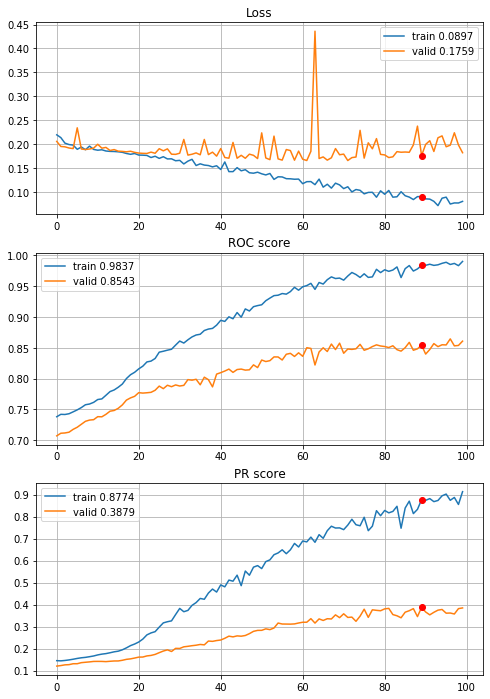


Fold 2------------------------------------------------------------


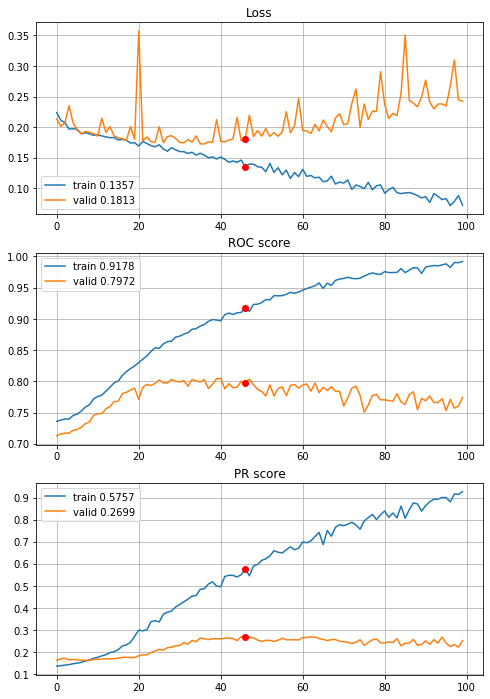


Fold 3------------------------------------------------------------


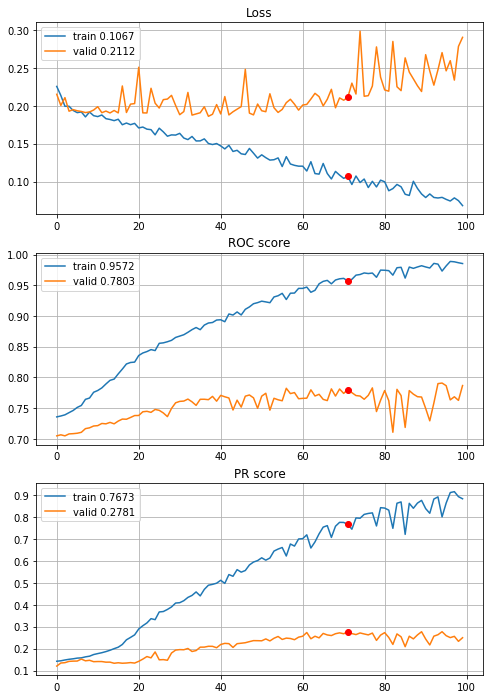


Fold 4------------------------------------------------------------


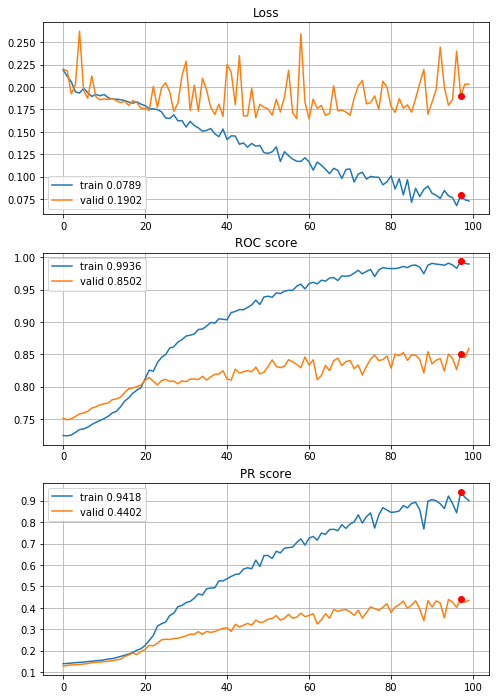


Fold 5------------------------------------------------------------


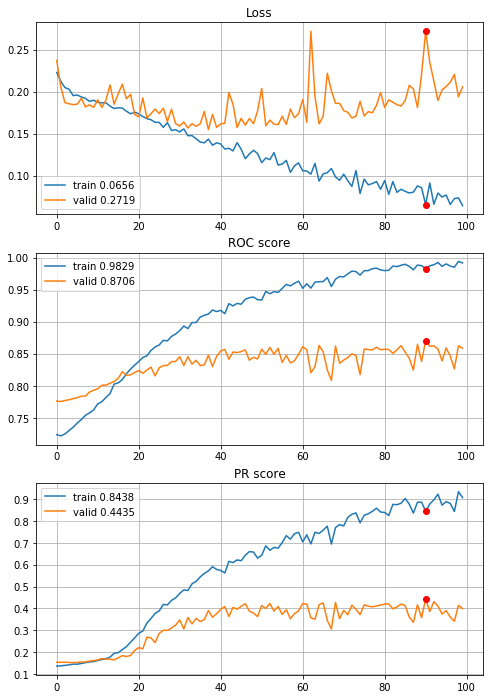


Fold 6------------------------------------------------------------


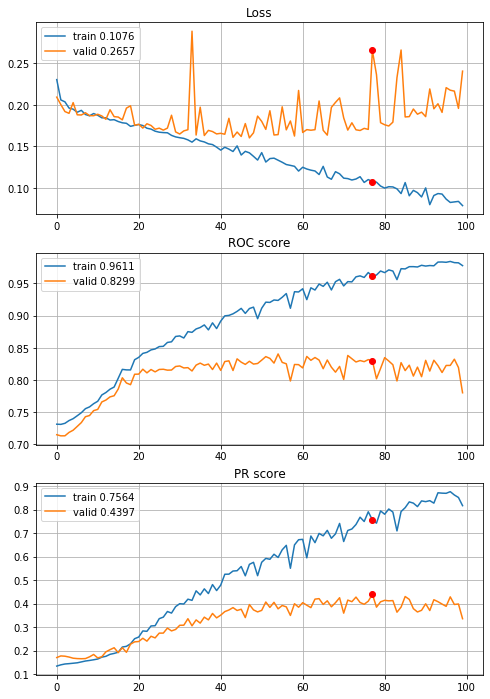

In [46]:
# first CNN with quantile clipping (Q_0.005, Q_0.995), power transform and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Another improvement PR +0.08 and similar overfitting, learning curves are very ugly. The most complex preprocessing pipeline tends to be the best one. Lets find the best architecture :)

But first, lets create and save images drafts for folds and see some results.

In [45]:
# drafts computation

# CV sets
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
# drafts lists initialization
drafts_ini=[]
drafts_opti=[]

# CV loop
for fold in range(len(train_folds)):
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    # ----- Monte Carlo energy optimization -----
    # correlation matrix for non bankrupt observations
    corr_matrix_fold=X_train_fold[Y_train_fold==0].corr(method="spearman")
    # draft inicialization
    draft_fold_ini=image_draft_inicialization(features, random_state)
    # quasi optimization
    draft_fold_opti=MC_Energy_optimization(corr_matrix=corr_matrix_fold, draft=draft_fold_ini, alpha=3, n_eval=100,
                                           random_state=random_state)
    # transform draft dictionary to matrix
    draft_fold_ini=image_dict_to_matrix(draft_fold_ini)
    draft_fold_opti=image_dict_to_matrix(draft_fold_opti)
    
    drafts_ini.append(draft_fold_ini)
    drafts_opti.append(draft_fold_opti)
    
drafts=dict(zip(["initial_drafts", "optimized_drafts"], [drafts_ini, drafts_opti]))

# saving drafts
with open(r"data\4year_data\drafts_8x8.p", "wb") as fp:
    pickle.dump(drafts, fp)

initial image energy: 12196.4678
iteration: 100
current energy: 10793.8113
iteration: 200
current energy: 10108.4904
iteration: 300
current energy: 9396.628
iteration: 400
current energy: 9128.0517
iteration: 500
current energy: 8937.9495
iteration: 600
current energy: 8772.8506
iteration: 700
current energy: 8643.9335
iteration: 800
current energy: 8563.0885
iteration: 900
current energy: 8394.6057
iteration: 1000
current energy: 8328.5911
iteration: 1100
current energy: 8267.3411
iteration: 1200
current energy: 8252.1855
iteration: 1300
current energy: 8246.4645
iteration: 1400
current energy: 8220.1226
iteration: 1500
current energy: 8131.7607
iteration: 1600
current energy: 8112.7578
iteration: 1700
current energy: 8110.852
iteration: 1800
current energy: 8095.5976
iteration: 1900
current energy: 8075.862
iteration: 2000
current energy: 7982.481
iteration: 2100
current energy: 7887.9659
iteration: 2200
current energy: 7868.2448
iteration: 2300
current energy: 7857.3924
iteration: 2

In [39]:
# loading 8x8 drafts
with open(r"data\4year_data\drafts_8x8.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

			 Normalization only

			----- FOLD 1 -----


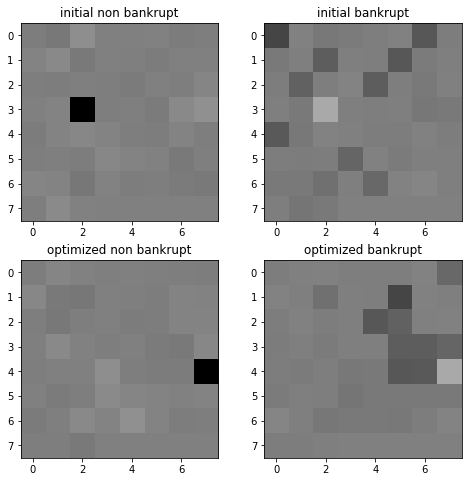


			----- FOLD 2 -----


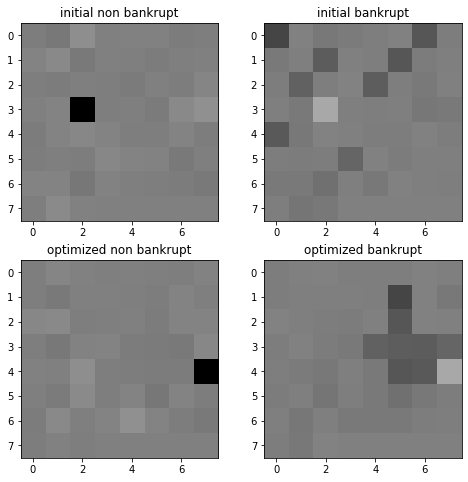


			----- FOLD 3 -----


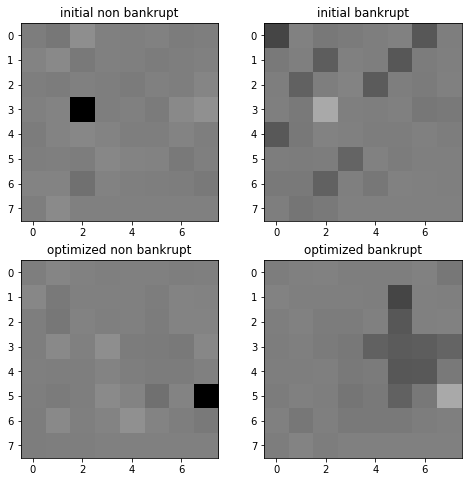


			----- FOLD 4 -----


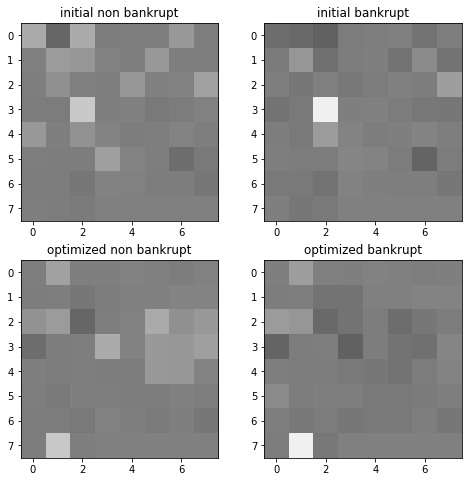


			----- FOLD 5 -----


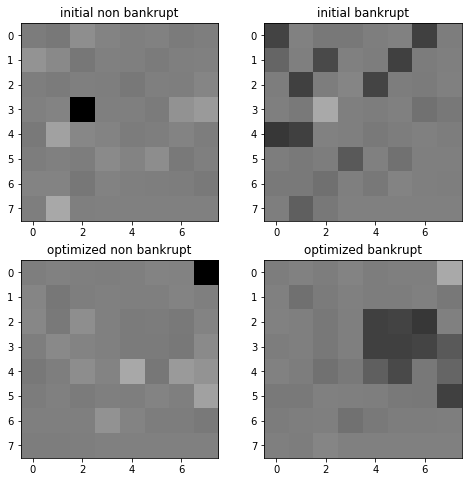


			----- FOLD 6 -----


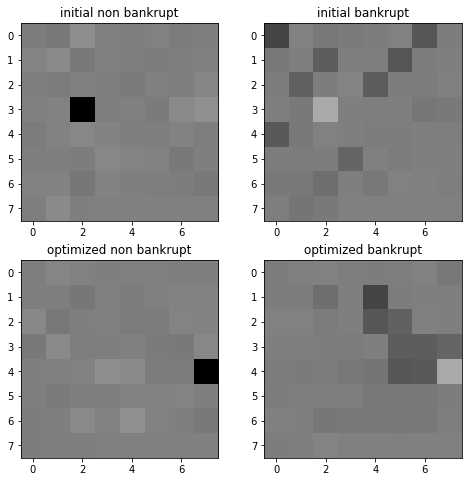

In [43]:
# printing images with normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t----- FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization and quantile clipping

			-----FOLD 1 -----


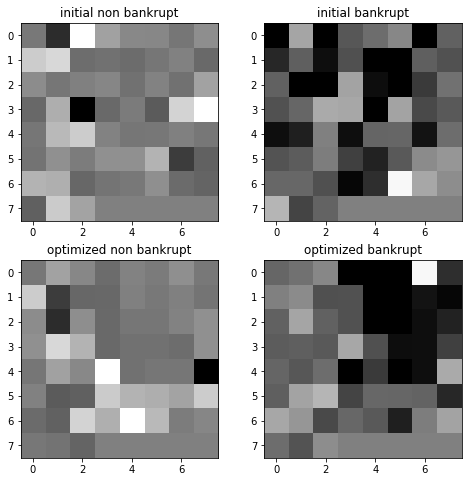


			-----FOLD 2 -----


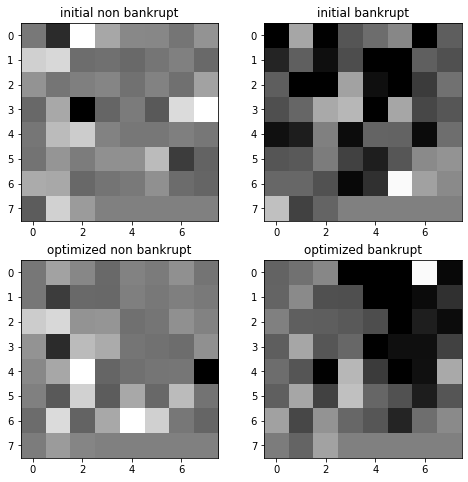


			-----FOLD 3 -----


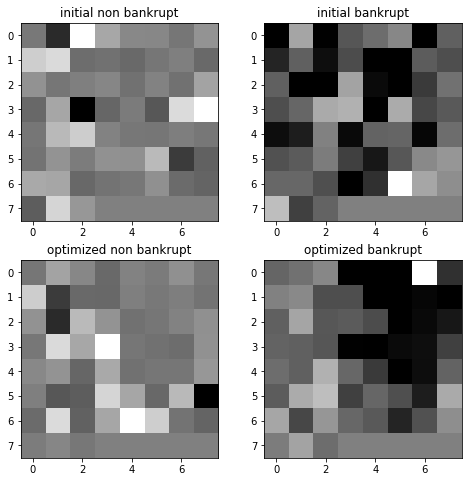


			-----FOLD 4 -----


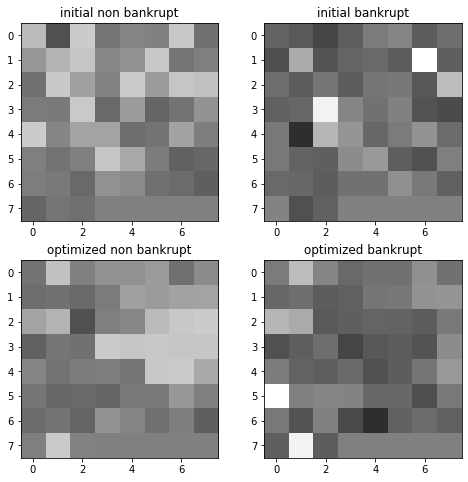


			-----FOLD 5 -----


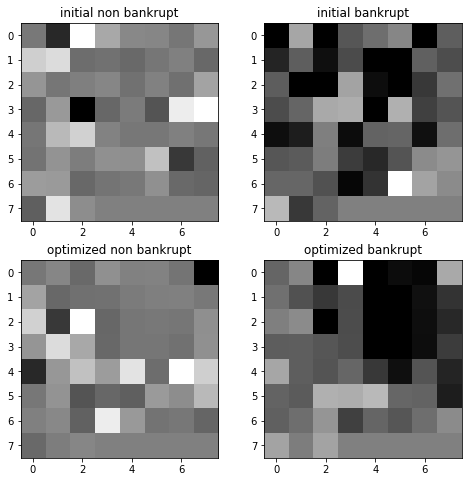


			-----FOLD 6 -----


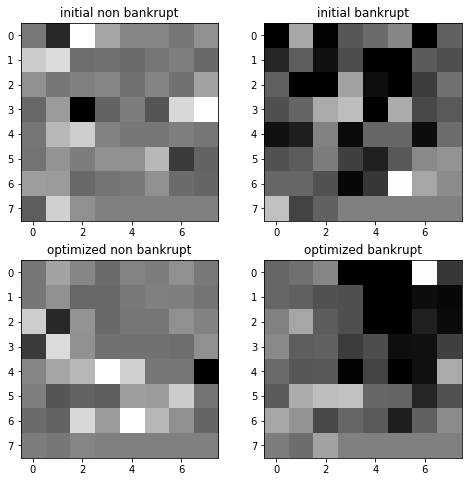

In [44]:
# printing images for normalization with quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t\t Normalization and quantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


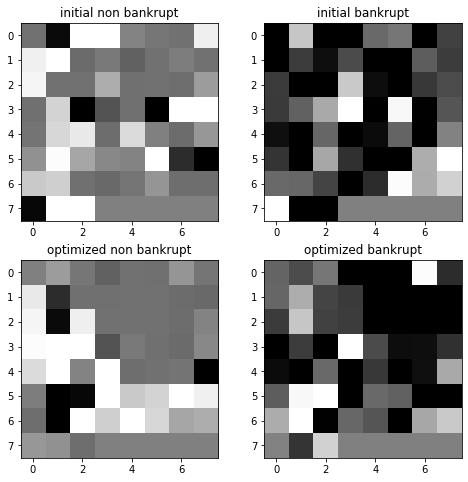


			-----FOLD 2 -----


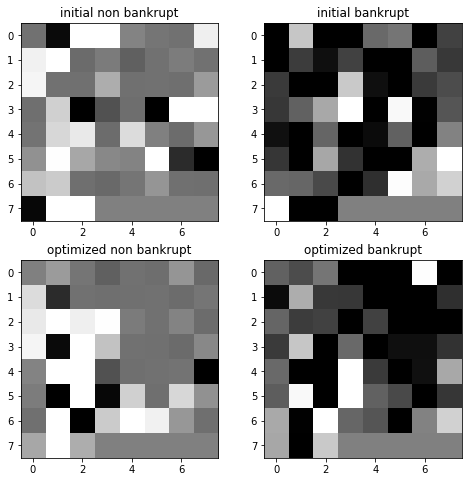


			-----FOLD 3 -----


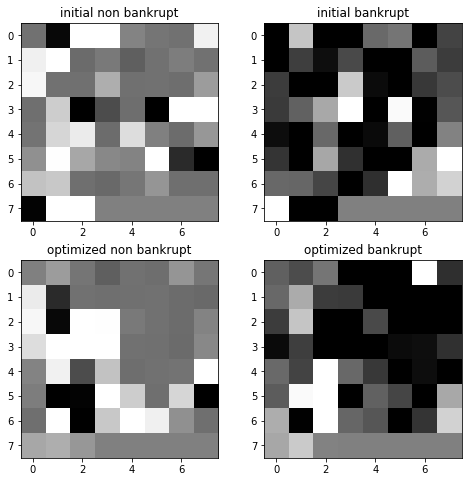


			-----FOLD 4 -----


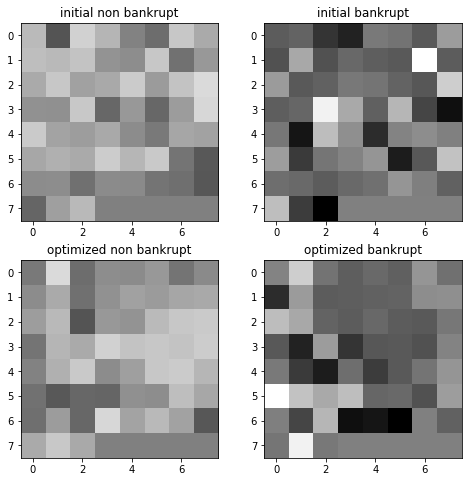


			-----FOLD 5 -----


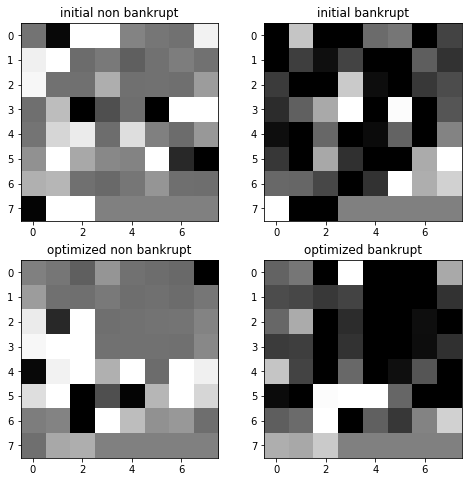


			-----FOLD 6 -----


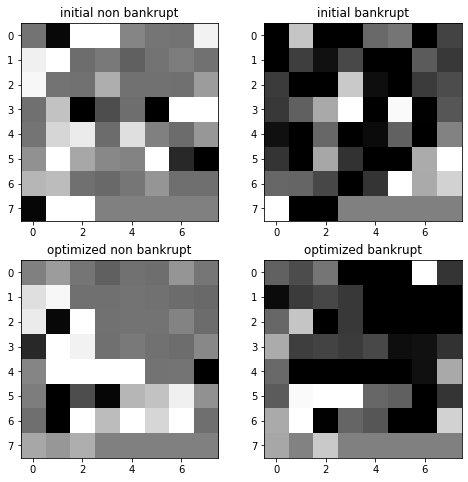

In [45]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

The same conclusions as for one year horizon forecast

Lets start experiments with model architecture, first define inception module.

In [40]:
def inception_module(prev_layer, f1, f2_in, f2_out, f3_in, f3_out, f4_out, random_state=random_state):
    
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    
    conv1x1 = layers.Conv2D(filters=f1, kernel_size=(1,1), strides=(1,1), padding="same",
                             activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_out, kernel_size=(3,3), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv3x3)
    conv5x5 = layers.Conv2D(filters=f3_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv5x5 = layers.Conv2D(filters=f3_out, kernel_size=(5,5), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv5x5)
    max_pool = layers.MaxPooling2D(pool_size=(3,3), strides=(1,1), padding="same")(prev_layer)
    max_pool = layers.Conv2D(filters=f4_out, kernel_size=(1,1), strides=(1,1), padding="valid",
                             activation=activations.relu, use_bias=True)(max_pool)
    inception = layers.concatenate([conv1x1, conv3x3, conv5x5, max_pool], axis=-1)
    
    return inception

def define_deep_CNN_2inc_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 3.58s train loss: 0.27387063889319707, validation loss: 0.2118576974934506
Epoch: 2/100,
cumulative time: 4.91s train loss: 0.20499309652486095, validation loss: 0.2029197107597303
Epoch: 3/100,
cumulative time: 6.25s train loss: 0.20094468757199702, validation loss: 0.20122308867816782
Epoch: 4/100,
cumulative time: 7.6s train loss: 0.19925625667322985, validation loss: 0.19781274761854994
Epoch: 5/100,
cumulative time: 8.94s train loss: 0.19652610624557326, validation loss: 0.19542297466301123
Epoch: 6/100,
cumulative time: 10.23s train loss: 0.19366037543042713, validation loss: 0.19456383864882854
Epoch: 7/100,
cumulative time: 11.53s train loss: 0.19301354046188063, validation loss: 0.19229654744622496
Epoch: 8/100,
cumulative time: 12.84s train loss: 0.19060505949946008, validation loss: 0.19150942105513352
Epoch: 9/100,
cumulative time: 14.13s train loss: 0.1893644817137

Epoch: 77/100,
cumulative time: 104.36s train loss: 0.16270011999489226, validation loss: 0.17770143843289538
Epoch: 78/100,
cumulative time: 105.65s train loss: 0.1619340801464672, validation loss: 0.17552669034919582
Epoch: 79/100,
cumulative time: 106.99s train loss: 0.16224133365447785, validation loss: 0.1791643377081564
Epoch: 80/100,
cumulative time: 108.23s train loss: 0.16211922609820673, validation loss: 0.17508533343398872
Epoch: 81/100,
cumulative time: 109.63s train loss: 0.16124435497875778, validation loss: 0.17587058927795365
Epoch: 82/100,
cumulative time: 110.89s train loss: 0.16043381033363546, validation loss: 0.17709747257080105
Epoch: 83/100,
cumulative time: 112.21s train loss: 0.1595453640797897, validation loss: 0.1775759677443884
Epoch: 84/100,
cumulative time: 113.52s train loss: 0.1607816561165678, validation loss: 0.1833385528756941
Epoch: 85/100,
cumulative time: 114.78s train loss: 0.1593651999598317, validation loss: 0.17979605737350846
Epoch: 86/100,
cu

Epoch: 50/100,
cumulative time: 69.17s train loss: 0.16818867482972474, validation loss: 0.18196045766078023
Epoch: 51/100,
cumulative time: 70.49s train loss: 0.16746180716318085, validation loss: 0.181741543048251
Epoch: 52/100,
cumulative time: 71.84s train loss: 0.1669393640666506, validation loss: 0.18212100886787339
Epoch: 53/100,
cumulative time: 73.27s train loss: 0.1657801133121503, validation loss: 0.1819502076601966
Epoch: 54/100,
cumulative time: 74.58s train loss: 0.16488967341768243, validation loss: 0.18157633216994568
Epoch: 55/100,
cumulative time: 75.87s train loss: 0.16477271678271418, validation loss: 0.18619089445303377
Epoch: 56/100,
cumulative time: 77.16s train loss: 0.16544589665927015, validation loss: 0.18137503885508718
Epoch: 57/100,
cumulative time: 78.43s train loss: 0.1665381973305694, validation loss: 0.1851354701592859
Epoch: 58/100,
cumulative time: 79.69s train loss: 0.16344845286936652, validation loss: 0.1818545175357446
Epoch: 59/100,
cumulative t

Epoch: 23/100,
cumulative time: 32.26s train loss: 0.18335231998003132, validation loss: 0.19169713346790992
Epoch: 24/100,
cumulative time: 33.57s train loss: 0.18252318058922393, validation loss: 0.19187826540009192
Epoch: 25/100,
cumulative time: 34.85s train loss: 0.182434496972682, validation loss: 0.19299612077139444
Epoch: 26/100,
cumulative time: 36.13s train loss: 0.1816482156470477, validation loss: 0.19278038942830103
Epoch: 27/100,
cumulative time: 37.42s train loss: 0.18270713381695516, validation loss: 0.19252807609965153
Epoch: 28/100,
cumulative time: 38.7s train loss: 0.18103929230494087, validation loss: 0.19188163867201263
Epoch: 29/100,
cumulative time: 39.98s train loss: 0.18094785825426632, validation loss: 0.1913463783515725
Epoch: 30/100,
cumulative time: 41.3s train loss: 0.18161524257144632, validation loss: 0.19354596675213215
Epoch: 31/100,
cumulative time: 42.61s train loss: 0.1818117562117798, validation loss: 0.19134794037669917
Epoch: 32/100,
cumulative 

Epoch: 99/100,
cumulative time: 133.43s train loss: 0.1540665791670438, validation loss: 0.189170678125262
Epoch: 100/100,
cumulative time: 134.72s train loss: 0.15370463732598053, validation loss: 0.188106383299081

Early stopping results:
best results in epoch: 98, 
best valid PR: 0.14825153489594867, 
valid ROC: 0.7711785341095685        
overfitting PR: 0.24837266790212598, 
overfitting ROC: 0.09577993244404259

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/100,
cumulative time: 3.53s train loss: 0.27706881860215543, validation loss: 0.21747270252852313
Epoch: 2/100,
cumulative time: 4.76s train loss: 0.20565593183491124, validation loss: 0.20338460394239002
Epoch: 3/100,
cumulative time: 6.02s train loss: 0.20176722687465787, validation loss: 0.19916743498582107
Epoch: 4/100,
cumulative time: 7.25s train loss: 0.19894443090939642, validation loss: 0.19603646714481227
Epoch: 5/100,
cumulative time: 8.5s train loss: 0.19630894752633551, valid

Epoch: 73/100,
cumulative time: 94.01s train loss: 0.16236050869550656, validation loss: 0.17901225328201983
Epoch: 74/100,
cumulative time: 95.33s train loss: 0.16278694027632243, validation loss: 0.1735893769013468
Epoch: 75/100,
cumulative time: 96.62s train loss: 0.16053900027062415, validation loss: 0.17288266958185733
Epoch: 76/100,
cumulative time: 97.88s train loss: 0.15975225586649605, validation loss: 0.17304369867091443
Epoch: 77/100,
cumulative time: 99.19s train loss: 0.15844017426527343, validation loss: 0.1727077092663458
Epoch: 78/100,
cumulative time: 100.51s train loss: 0.15891330121494712, validation loss: 0.17481999118527725
Epoch: 79/100,
cumulative time: 101.76s train loss: 0.15947213978788824, validation loss: 0.17266473346538816
Epoch: 80/100,
cumulative time: 103.03s train loss: 0.15724894335617995, validation loss: 0.1724003491006472
Epoch: 81/100,
cumulative time: 104.28s train loss: 0.15645122688999785, validation loss: 0.17392044218727487
Epoch: 82/100,
cum

Epoch: 46/100,
cumulative time: 60.91s train loss: 0.1816826875246493, validation loss: 0.17556674138970207
Epoch: 47/100,
cumulative time: 62.17s train loss: 0.17988471205961082, validation loss: 0.17539979038348966
Epoch: 48/100,
cumulative time: 63.48s train loss: 0.17975894651884997, validation loss: 0.17854715546730104
Epoch: 49/100,
cumulative time: 64.76s train loss: 0.17980250226402725, validation loss: 0.17640411342197282
Epoch: 50/100,
cumulative time: 66.06s train loss: 0.17898089877352086, validation loss: 0.1747495918166735
Epoch: 51/100,
cumulative time: 67.34s train loss: 0.1789840110100822, validation loss: 0.1761466088915391
Epoch: 52/100,
cumulative time: 68.63s train loss: 0.178648350703528, validation loss: 0.17511917007148103
Epoch: 53/100,
cumulative time: 69.98s train loss: 0.1790022675499872, validation loss: 0.1742814024884954
Epoch: 54/100,
cumulative time: 71.25s train loss: 0.18073630153175144, validation loss: 0.1751397399876358
Epoch: 55/100,
cumulative ti

Epoch: 19/100,
cumulative time: 26.31s train loss: 0.18410607676928728, validation loss: 0.1925923990578028
Epoch: 20/100,
cumulative time: 27.57s train loss: 0.18464570167050381, validation loss: 0.18561545944181385
Epoch: 21/100,
cumulative time: 28.83s train loss: 0.18573355360244745, validation loss: 0.18722310857162164
Epoch: 22/100,
cumulative time: 30.09s train loss: 0.18522444784373435, validation loss: 0.18432953925321147
Epoch: 23/100,
cumulative time: 31.35s train loss: 0.1823580937707606, validation loss: 0.1840929216235795
Epoch: 24/100,
cumulative time: 32.61s train loss: 0.18217651889718306, validation loss: 0.18340495301852108
Epoch: 25/100,
cumulative time: 33.87s train loss: 0.1817370799445184, validation loss: 0.18688617031564506
Epoch: 26/100,
cumulative time: 35.14s train loss: 0.18310910080253168, validation loss: 0.1818438928564173
Epoch: 27/100,
cumulative time: 36.46s train loss: 0.1807008324503444, validation loss: 0.18176848861599487
Epoch: 28/100,
cumulative

Epoch: 95/100,
cumulative time: 124.58s train loss: 0.15957075681269559, validation loss: 0.17414827354516255
Epoch: 96/100,
cumulative time: 125.85s train loss: 0.15414695515985194, validation loss: 0.1701863194924934
Epoch: 97/100,
cumulative time: 127.13s train loss: 0.15489477617564673, validation loss: 0.1699186643478981
Epoch: 98/100,
cumulative time: 128.4s train loss: 0.1535213890775616, validation loss: 0.17056918982670158
Epoch: 99/100,
cumulative time: 129.66s train loss: 0.15403542623394584, validation loss: 0.16870011860245904
Epoch: 100/100,
cumulative time: 130.95s train loss: 0.1530449544657874, validation loss: 0.1704639784118785

Early stopping results:
best results in epoch: 98, 
best valid PR: 0.3009477860028527, 
valid ROC: 0.8095362581343889        
overfitting PR: 0.08862872171547254, 
overfitting ROC: 0.053305485145423215

Cross validation time: 837s
ROC: 		0.7989672284988233
PR: 		0.24266746891075422
overfittingROC: 0.06602912977878928
overfittingPR:  0.1525917

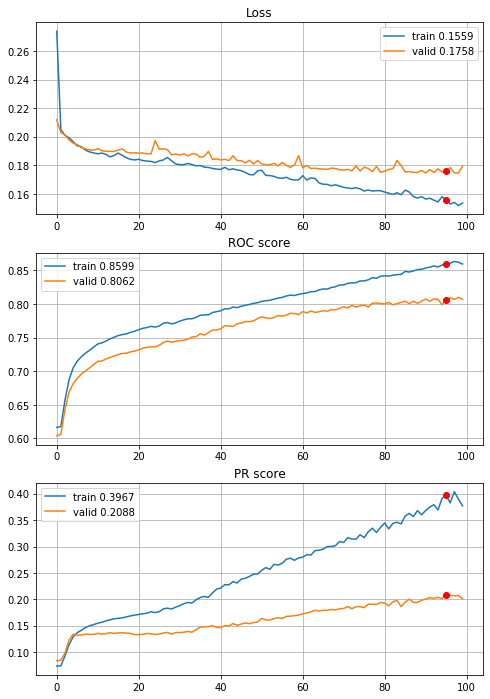


Fold 2------------------------------------------------------------


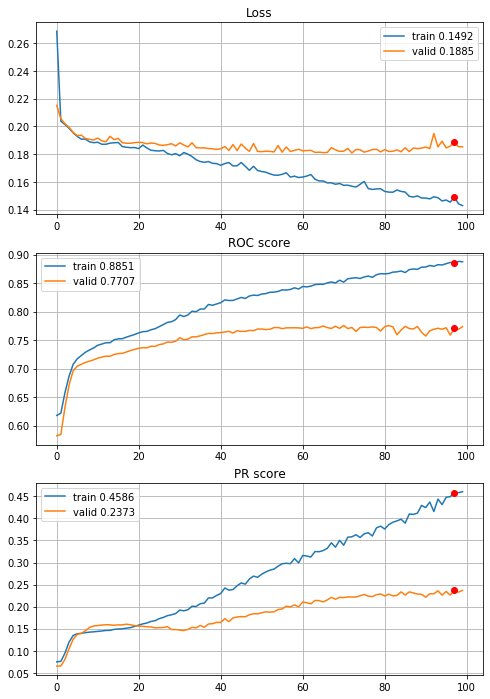


Fold 3------------------------------------------------------------


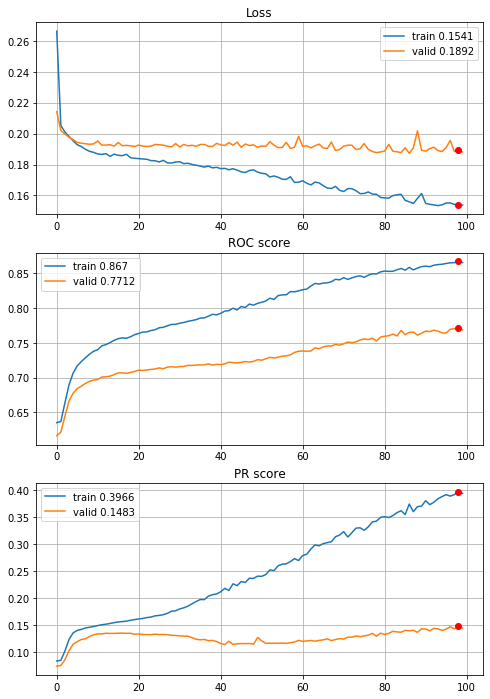


Fold 4------------------------------------------------------------


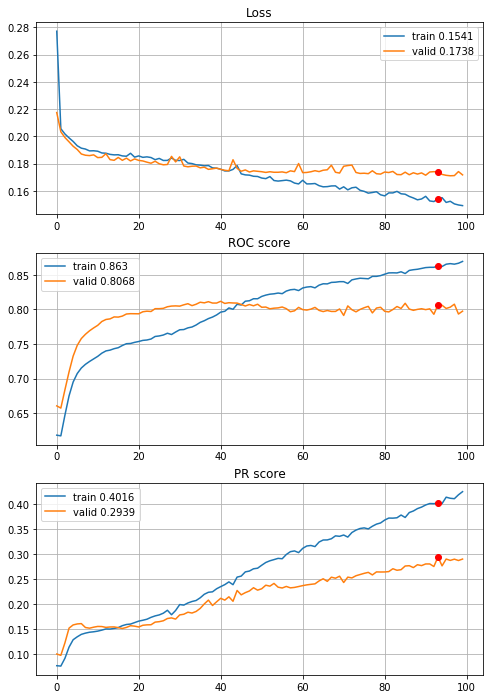


Fold 5------------------------------------------------------------


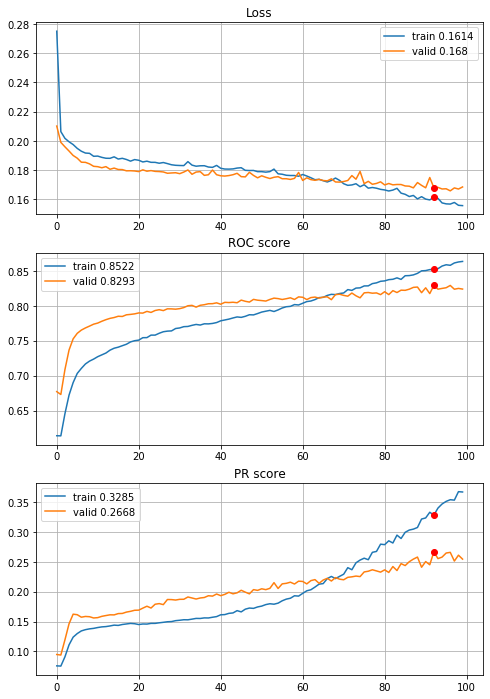


Fold 6------------------------------------------------------------


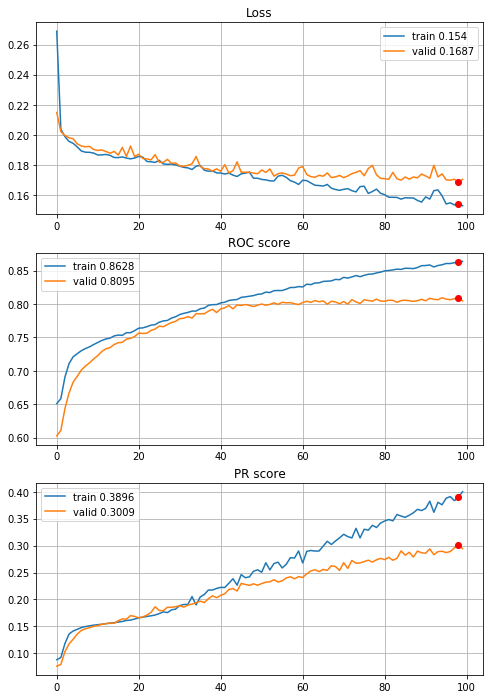

In [52]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Very nice learning curves, much lower overfitting, worse results, but training looks more stable. Early stopping was not used, so more epochs are needed.


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 3.66s train loss: 0.27387063889319707, validation loss: 0.21189110095684344
Epoch: 2/400,
cumulative time: 4.91s train loss: 0.20499888116253603, validation loss: 0.20292761142843024
Epoch: 3/400,
cumulative time: 6.17s train loss: 0.200947066037187, validation loss: 0.20122859771556803
Epoch: 4/400,
cumulative time: 7.47s train loss: 0.19926422494894214, validation loss: 0.19782248901176647
Epoch: 5/400,
cumulative time: 8.74s train loss: 0.19653452895495477, validation loss: 0.19542961021399644
Epoch: 6/400,
cumulative time: 10.0s train loss: 0.19367529922442103, validation loss: 0.19455968062637452
Epoch: 7/400,
cumulative time: 11.29s train loss: 0.19301851024366962, validation loss: 0.19232030734267666
Epoch: 8/400,
cumulative time: 12.61s train loss: 0.19063588551721375, validation loss: 0.19161425814935348
Epoch: 9/400,
cumulative time: 13.96s train loss: 0.1893771570092

Epoch: 76/400,
cumulative time: 109.6s train loss: 0.1623420633043854, validation loss: 0.17864975099907673
Epoch: 77/400,
cumulative time: 110.91s train loss: 0.1630472047938064, validation loss: 0.17702342018008313
Epoch: 78/400,
cumulative time: 112.23s train loss: 0.16242357091091641, validation loss: 0.1750689382716212
Epoch: 79/400,
cumulative time: 113.6s train loss: 0.1627450585040607, validation loss: 0.17900060005663526
Epoch: 80/400,
cumulative time: 114.97s train loss: 0.16270330609977204, validation loss: 0.17493728237382566
Epoch: 81/400,
cumulative time: 116.34s train loss: 0.16173154951343252, validation loss: 0.1754542545265207
Epoch: 82/400,
cumulative time: 117.68s train loss: 0.160828256853007, validation loss: 0.17667842026954608
Epoch: 83/400,
cumulative time: 119.0s train loss: 0.16000503914266617, validation loss: 0.17756628446468617
Epoch: 84/400,
cumulative time: 120.39s train loss: 0.16143243076503236, validation loss: 0.18304938028222287
Epoch: 85/400,
cumul

Epoch: 151/400,
cumulative time: 213.12s train loss: 0.13136557539655844, validation loss: 0.17473354612060596
Epoch: 152/400,
cumulative time: 214.45s train loss: 0.1311005675247218, validation loss: 0.17946997758602107
Epoch: 153/400,
cumulative time: 215.79s train loss: 0.13237229912730406, validation loss: 0.17590091748250594
Epoch: 154/400,
cumulative time: 217.12s train loss: 0.1323122505789051, validation loss: 0.17721695542700686
Epoch: 155/400,
cumulative time: 218.45s train loss: 0.13097815685675318, validation loss: 0.17574067027330237
Epoch: 156/400,
cumulative time: 219.77s train loss: 0.13108083794288408, validation loss: 0.17703592060089435
Epoch: 157/400,
cumulative time: 221.09s train loss: 0.12871032771944238, validation loss: 0.1827090199481394
Epoch: 158/400,
cumulative time: 222.42s train loss: 0.12855300990336763, validation loss: 0.18093407661270494
Epoch: 159/400,
cumulative time: 223.73s train loss: 0.1309668186346322, validation loss: 0.1762526984661919
Epoch:

Epoch: 226/400,
cumulative time: 311.63s train loss: 0.10333963944426386, validation loss: 0.19031438398839992
Epoch: 227/400,
cumulative time: 312.88s train loss: 0.09995549394067132, validation loss: 0.19205459004928663
Epoch: 228/400,
cumulative time: 314.17s train loss: 0.09994660633758581, validation loss: 0.19006875758880332
Epoch: 229/400,
cumulative time: 315.42s train loss: 0.10270878350549638, validation loss: 0.2224121933652074
Epoch: 230/400,
cumulative time: 316.69s train loss: 0.10716856419471926, validation loss: 0.19147473645705282
Epoch: 231/400,
cumulative time: 317.96s train loss: 0.10056497706256347, validation loss: 0.19862767177588928
Epoch: 232/400,
cumulative time: 319.23s train loss: 0.10021949240038087, validation loss: 0.19716468783078994
Epoch: 233/400,
cumulative time: 320.48s train loss: 0.10018900880696874, validation loss: 0.19487181624398903
Epoch: 234/400,
cumulative time: 321.75s train loss: 0.09987015297237378, validation loss: 0.1923649517085132
Epo

Epoch: 301/400,
cumulative time: 407.17s train loss: 0.07208289680478684, validation loss: 0.23293304006163973
Epoch: 302/400,
cumulative time: 408.43s train loss: 0.07055557212772932, validation loss: 0.22925917858003028
Epoch: 303/400,
cumulative time: 409.68s train loss: 0.0725158295381967, validation loss: 0.23420706392348908
Epoch: 304/400,
cumulative time: 410.97s train loss: 0.07045319238983284, validation loss: 0.23806784261928438
Epoch: 305/400,
cumulative time: 412.24s train loss: 0.07003608803745107, validation loss: 0.2293417886802337
Epoch: 306/400,
cumulative time: 413.49s train loss: 0.07049124426130182, validation loss: 0.24977570699136056
Epoch: 307/400,
cumulative time: 414.75s train loss: 0.06888617986710961, validation loss: 0.23378978285195473
Epoch: 308/400,
cumulative time: 416.02s train loss: 0.0701733710926397, validation loss: 0.23577867990005902
Epoch: 309/400,
cumulative time: 417.28s train loss: 0.06916866475143209, validation loss: 0.24173372290100348
Epoc

Epoch: 376/400,
cumulative time: 502.4s train loss: 0.04213058440278276, validation loss: 0.29823759004443257
Epoch: 377/400,
cumulative time: 503.65s train loss: 0.04319449361953004, validation loss: 0.29369567492894366
Epoch: 378/400,
cumulative time: 504.93s train loss: 0.043604858668099204, validation loss: 0.300112423592883
Epoch: 379/400,
cumulative time: 506.19s train loss: 0.04689748492586537, validation loss: 0.3083241517199717
Epoch: 380/400,
cumulative time: 507.45s train loss: 0.04454404351126591, validation loss: 0.2992751322854044
Epoch: 381/400,
cumulative time: 508.7s train loss: 0.043612050077464846, validation loss: 0.29930574034573354
Epoch: 382/400,
cumulative time: 509.97s train loss: 0.04450753673476824, validation loss: 0.3097789888888334
Epoch: 383/400,
cumulative time: 511.23s train loss: 0.04774610284347065, validation loss: 0.31607603203122353
Epoch: 384/400,
cumulative time: 512.49s train loss: 0.04652410993195515, validation loss: 0.30632527494122175
Epoch:

Epoch: 49/400,
cumulative time: 65.67s train loss: 0.17268930728877416, validation loss: 0.1894909664024862
Epoch: 50/400,
cumulative time: 67.01s train loss: 0.16993693893552883, validation loss: 0.18390121239435925
Epoch: 51/400,
cumulative time: 68.29s train loss: 0.16916248748408957, validation loss: 0.1837751281107259
Epoch: 52/400,
cumulative time: 69.58s train loss: 0.16865191832194937, validation loss: 0.18426036590252545
Epoch: 53/400,
cumulative time: 70.88s train loss: 0.16762792344932967, validation loss: 0.18425279572717668
Epoch: 54/400,
cumulative time: 72.19s train loss: 0.16666016144971993, validation loss: 0.18395994875486243
Epoch: 55/400,
cumulative time: 73.48s train loss: 0.16675528491872965, validation loss: 0.18866408741579646
Epoch: 56/400,
cumulative time: 74.77s train loss: 0.1672906960759844, validation loss: 0.18401464467920195
Epoch: 57/400,
cumulative time: 76.06s train loss: 0.16837639708326116, validation loss: 0.18794511714056286
Epoch: 58/400,
cumulat

Epoch: 124/400,
cumulative time: 162.83s train loss: 0.13477734631468, validation loss: 0.20886350435777293
Epoch: 125/400,
cumulative time: 164.14s train loss: 0.1340913760133243, validation loss: 0.19612958950197884
Epoch: 126/400,
cumulative time: 165.43s train loss: 0.12830370362433557, validation loss: 0.20044385759987907
Epoch: 127/400,
cumulative time: 166.72s train loss: 0.13164863216240594, validation loss: 0.19324037483389317
Epoch: 128/400,
cumulative time: 168.05s train loss: 0.12879777755819127, validation loss: 0.1956467489915449
Epoch: 129/400,
cumulative time: 169.35s train loss: 0.1274426699549175, validation loss: 0.19497797220762772
Epoch: 130/400,
cumulative time: 170.65s train loss: 0.126746160452687, validation loss: 0.19431832610262423
Epoch: 131/400,
cumulative time: 171.93s train loss: 0.1313600935377754, validation loss: 0.19808369443845067
Epoch: 132/400,
cumulative time: 173.22s train loss: 0.12859385900770662, validation loss: 0.19319140047869607
Epoch: 133

Epoch: 199/400,
cumulative time: 261.62s train loss: 0.08654712777152043, validation loss: 0.23188022936461652
Epoch: 200/400,
cumulative time: 262.91s train loss: 0.08633236809053166, validation loss: 0.23193061432926082
Epoch: 201/400,
cumulative time: 264.24s train loss: 0.08420905382573467, validation loss: 0.2381764981538118
Epoch: 202/400,
cumulative time: 265.51s train loss: 0.08543086473071719, validation loss: 0.23311073510033326
Epoch: 203/400,
cumulative time: 266.83s train loss: 0.08289531770655785, validation loss: 0.23683640016959265
Epoch: 204/400,
cumulative time: 268.15s train loss: 0.08307047999596767, validation loss: 0.24072035006960693
Epoch: 205/400,
cumulative time: 269.45s train loss: 0.08848777318092518, validation loss: 0.23781947597830858
Epoch: 206/400,
cumulative time: 270.72s train loss: 0.08362147669128675, validation loss: 0.24196888860429203
Epoch: 207/400,
cumulative time: 272.0s train loss: 0.08169044634188032, validation loss: 0.2420104406495091
Epoc

Epoch: 274/400,
cumulative time: 359.46s train loss: 0.05534544002544274, validation loss: 0.29567201602937737
Epoch: 275/400,
cumulative time: 360.79s train loss: 0.05593818436177245, validation loss: 0.3062172601261944
Epoch: 276/400,
cumulative time: 362.09s train loss: 0.057478774021882284, validation loss: 0.2970970245832647
Epoch: 277/400,
cumulative time: 363.36s train loss: 0.06363589840876574, validation loss: 0.3145570628106635
Epoch: 278/400,
cumulative time: 364.65s train loss: 0.05642249696002366, validation loss: 0.32230046070944784
Epoch: 279/400,
cumulative time: 365.92s train loss: 0.056217269406045274, validation loss: 0.31385441522074037
Epoch: 280/400,
cumulative time: 367.19s train loss: 0.054278000085291836, validation loss: 0.3018825799023886
Epoch: 281/400,
cumulative time: 368.5s train loss: 0.05181714339123692, validation loss: 0.31519937095307754
Epoch: 282/400,
cumulative time: 369.78s train loss: 0.051137868489501394, validation loss: 0.3065898052135887
Epo

Epoch: 349/400,
cumulative time: 455.93s train loss: 0.031907004006303384, validation loss: 0.37249238248419975
Epoch: 350/400,
cumulative time: 457.2s train loss: 0.03026265974432924, validation loss: 0.39403886603124294
Epoch: 351/400,
cumulative time: 458.49s train loss: 0.03427173855219731, validation loss: 0.3851365384356029
Epoch: 352/400,
cumulative time: 459.77s train loss: 0.03257354618439911, validation loss: 0.37867190843540605
Epoch: 353/400,
cumulative time: 461.04s train loss: 0.03420603360758033, validation loss: 0.39495132223451274
Epoch: 354/400,
cumulative time: 462.33s train loss: 0.03308418403991834, validation loss: 0.3768358300379785
Epoch: 355/400,
cumulative time: 463.62s train loss: 0.03203114818608616, validation loss: 0.39137309430569023
Epoch: 356/400,
cumulative time: 464.91s train loss: 0.030811318669310386, validation loss: 0.39071849909585055
Epoch: 357/400,
cumulative time: 466.17s train loss: 0.030946221167099146, validation loss: 0.37875983334058316
E

Epoch: 22/400,
cumulative time: 30.81s train loss: 0.18363629220235936, validation loss: 0.1919435839859136
Epoch: 23/400,
cumulative time: 32.06s train loss: 0.1833757314920815, validation loss: 0.19170398638920366
Epoch: 24/400,
cumulative time: 33.34s train loss: 0.18250841648908528, validation loss: 0.19191081274156266
Epoch: 25/400,
cumulative time: 34.61s train loss: 0.1824767278517752, validation loss: 0.193161579684549
Epoch: 26/400,
cumulative time: 35.9s train loss: 0.18165910192849638, validation loss: 0.1928757462394408
Epoch: 27/400,
cumulative time: 37.17s train loss: 0.18269356398309397, validation loss: 0.19250522863304964
Epoch: 28/400,
cumulative time: 38.44s train loss: 0.1810254000637685, validation loss: 0.19188218919333347
Epoch: 29/400,
cumulative time: 39.69s train loss: 0.18093980022660558, validation loss: 0.19138110575625653
Epoch: 30/400,
cumulative time: 40.95s train loss: 0.18161192638225002, validation loss: 0.193698145231071
Epoch: 31/400,
cumulative tim

Epoch: 98/400,
cumulative time: 128.22s train loss: 0.15365849219005892, validation loss: 0.18855551642938242
Epoch: 99/400,
cumulative time: 129.66s train loss: 0.15385566239467063, validation loss: 0.1900114323449346
Epoch: 100/400,
cumulative time: 131.32s train loss: 0.15404225890535467, validation loss: 0.1894031249701855
Epoch: 101/400,
cumulative time: 132.96s train loss: 0.15256653369552642, validation loss: 0.19068772852461383
Epoch: 102/400,
cumulative time: 134.64s train loss: 0.15117110389910196, validation loss: 0.1891242852111184
Epoch: 103/400,
cumulative time: 136.26s train loss: 0.15186858926606117, validation loss: 0.1901523178434437
Epoch: 104/400,
cumulative time: 137.96s train loss: 0.15086378840303188, validation loss: 0.19043256859742028
Epoch: 105/400,
cumulative time: 139.45s train loss: 0.15151265577896242, validation loss: 0.18724525306523454
Epoch: 106/400,
cumulative time: 141.06s train loss: 0.15068466480439355, validation loss: 0.19146586431176424
Epoch: 

Epoch: 173/400,
cumulative time: 232.31s train loss: 0.12847488387418707, validation loss: 0.19137532008879035
Epoch: 174/400,
cumulative time: 233.64s train loss: 0.12722408653206613, validation loss: 0.18810857587967542
Epoch: 175/400,
cumulative time: 234.96s train loss: 0.1273319486695545, validation loss: 0.18729902554361735
Epoch: 176/400,
cumulative time: 236.29s train loss: 0.1292814264962041, validation loss: 0.19503742008082633
Epoch: 177/400,
cumulative time: 237.62s train loss: 0.12601282107465586, validation loss: 0.18617957417578662
Epoch: 178/400,
cumulative time: 238.95s train loss: 0.1282607676908039, validation loss: 0.18832758474788186
Epoch: 179/400,
cumulative time: 240.29s train loss: 0.12575026606930612, validation loss: 0.18668673622153745
Epoch: 180/400,
cumulative time: 241.62s train loss: 0.12750541433706183, validation loss: 0.18614914339768635
Epoch: 181/400,
cumulative time: 242.96s train loss: 0.12463343126417002, validation loss: 0.18815600176178898
Epoc

Epoch: 248/400,
cumulative time: 333.33s train loss: 0.10046879138914713, validation loss: 0.19765398936907883
Epoch: 249/400,
cumulative time: 334.66s train loss: 0.10079128102703931, validation loss: 0.19801262841693718
Epoch: 250/400,
cumulative time: 335.99s train loss: 0.10070139722677662, validation loss: 0.20806393652160285
Epoch: 251/400,
cumulative time: 337.32s train loss: 0.10391166559052081, validation loss: 0.21066105246056985
Epoch: 252/400,
cumulative time: 338.66s train loss: 0.10061830553224524, validation loss: 0.19824551166605187
Epoch: 253/400,
cumulative time: 340.01s train loss: 0.10064255435034444, validation loss: 0.2151457365675797
Epoch: 254/400,
cumulative time: 341.33s train loss: 0.10322981025000351, validation loss: 0.2026200262846145
Epoch: 255/400,
cumulative time: 342.8s train loss: 0.09797239049317384, validation loss: 0.20346745367842195
Epoch: 256/400,
cumulative time: 344.23s train loss: 0.09659160813843053, validation loss: 0.20899664458975328
Epoc

Epoch: 323/400,
cumulative time: 431.92s train loss: 0.07773462494643235, validation loss: 0.22416651520784248
Epoch: 324/400,
cumulative time: 433.23s train loss: 0.07484363214989603, validation loss: 0.25378487550782214
Epoch: 325/400,
cumulative time: 434.51s train loss: 0.08144265466654932, validation loss: 0.22963879419233296
Epoch: 326/400,
cumulative time: 435.8s train loss: 0.0756465369942288, validation loss: 0.22216389991135074
Epoch: 327/400,
cumulative time: 437.09s train loss: 0.07497337625804494, validation loss: 0.2247971035413307
Epoch: 328/400,
cumulative time: 438.37s train loss: 0.07270406081361373, validation loss: 0.22399697965549886
Epoch: 329/400,
cumulative time: 439.65s train loss: 0.0744179834589011, validation loss: 0.22947446585026138
Epoch: 330/400,
cumulative time: 440.91s train loss: 0.07525564309848308, validation loss: 0.23479470738429775
Epoch: 331/400,
cumulative time: 442.22s train loss: 0.07539861150371042, validation loss: 0.22994124858942544
Epoch

Epoch: 398/400,
cumulative time: 528.62s train loss: 0.06201279269746729, validation loss: 0.26528336258872665
Epoch: 399/400,
cumulative time: 529.92s train loss: 0.053627999879173244, validation loss: 0.26955726763031934
Epoch: 400/400,
cumulative time: 531.18s train loss: 0.05376963249970713, validation loss: 0.2610754527105938

Early stopping results:
best results in epoch: 389, 
best valid PR: 0.26171122026805826, 
valid ROC: 0.7860594864905209        
overfitting PR: 0.6479403143847807, 
overfitting ROC: 0.20422129828583657

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 3.37s train loss: 0.26878145250656554, validation loss: 0.2131523573536545
Epoch: 2/400,
cumulative time: 4.81s train loss: 0.20459925786754538, validation loss: 0.20237067770884912
Epoch: 3/400,
cumulative time: 6.08s train loss: 0.20140616030584607, validation loss: 0.1986859294936477
Epoch: 4/400,
cumulative time: 7.37s train loss: 0.198620495375894

Epoch: 72/400,
cumulative time: 95.81s train loss: 0.16019637294922312, validation loss: 0.1786126017753083
Epoch: 73/400,
cumulative time: 97.08s train loss: 0.16206660456412594, validation loss: 0.17871351210416947
Epoch: 74/400,
cumulative time: 98.34s train loss: 0.16204421086652587, validation loss: 0.17325519591346739
Epoch: 75/400,
cumulative time: 99.61s train loss: 0.15967213747312406, validation loss: 0.1727918595319057
Epoch: 76/400,
cumulative time: 100.88s train loss: 0.1590671543892862, validation loss: 0.17269714992211901
Epoch: 77/400,
cumulative time: 102.14s train loss: 0.15774611118345352, validation loss: 0.1725925432937822
Epoch: 78/400,
cumulative time: 103.44s train loss: 0.15811167539067056, validation loss: 0.1742125565377606
Epoch: 79/400,
cumulative time: 104.71s train loss: 0.15872790249137872, validation loss: 0.17225901948870082
Epoch: 80/400,
cumulative time: 105.99s train loss: 0.1565448220088179, validation loss: 0.1724500416228364
Epoch: 81/400,
cumula

Epoch: 147/400,
cumulative time: 193.31s train loss: 0.13070929935931283, validation loss: 0.17114157898641916
Epoch: 148/400,
cumulative time: 194.68s train loss: 0.13172971632270222, validation loss: 0.17355555895439534
Epoch: 149/400,
cumulative time: 196.09s train loss: 0.13299262296064956, validation loss: 0.17100240877487774
Epoch: 150/400,
cumulative time: 197.42s train loss: 0.13012578696049024, validation loss: 0.17698916260322964
Epoch: 151/400,
cumulative time: 198.73s train loss: 0.13236078277512336, validation loss: 0.16904523220088224
Epoch: 152/400,
cumulative time: 200.06s train loss: 0.1305107029899904, validation loss: 0.1718233043823703
Epoch: 153/400,
cumulative time: 201.35s train loss: 0.13223713468980938, validation loss: 0.18241290021827222
Epoch: 154/400,
cumulative time: 202.64s train loss: 0.13084475071467871, validation loss: 0.17067118998365877
Epoch: 155/400,
cumulative time: 204.0s train loss: 0.12859450262605568, validation loss: 0.17090576986539438
Epoc

Epoch: 222/400,
cumulative time: 291.13s train loss: 0.10627805995211426, validation loss: 0.17642355882204497
Epoch: 223/400,
cumulative time: 292.43s train loss: 0.10667459507834663, validation loss: 0.18218972866148914
Epoch: 224/400,
cumulative time: 293.76s train loss: 0.10693289231989407, validation loss: 0.176527158754711
Epoch: 225/400,
cumulative time: 295.13s train loss: 0.10569131101722469, validation loss: 0.1771484433367108
Epoch: 226/400,
cumulative time: 296.6s train loss: 0.10349000872691289, validation loss: 0.17596167124112988
Epoch: 227/400,
cumulative time: 297.87s train loss: 0.10328599164369207, validation loss: 0.1764373344434533
Epoch: 228/400,
cumulative time: 299.14s train loss: 0.10468197471700506, validation loss: 0.17872561337876433
Epoch: 229/400,
cumulative time: 300.42s train loss: 0.1027467178743184, validation loss: 0.179926272159616
Epoch: 230/400,
cumulative time: 301.76s train loss: 0.10142018234357998, validation loss: 0.1804798970302
Epoch: 231/40

Epoch: 297/400,
cumulative time: 389.01s train loss: 0.08620964574822772, validation loss: 0.19455787523252124
Epoch: 298/400,
cumulative time: 390.3s train loss: 0.08458114100966907, validation loss: 0.19033662410842228
Epoch: 299/400,
cumulative time: 391.59s train loss: 0.08139752223326727, validation loss: 0.18963715547684346
Epoch: 300/400,
cumulative time: 392.87s train loss: 0.08171440115680198, validation loss: 0.19970296252293193
Epoch: 301/400,
cumulative time: 394.22s train loss: 0.08092565901692128, validation loss: 0.1950874011519817
Epoch: 302/400,
cumulative time: 395.5s train loss: 0.08118693732170648, validation loss: 0.19539576464562777
Epoch: 303/400,
cumulative time: 396.78s train loss: 0.08290422681770304, validation loss: 0.20706611114995993
Epoch: 304/400,
cumulative time: 398.04s train loss: 0.08461136875280191, validation loss: 0.1946867510950265
Epoch: 305/400,
cumulative time: 399.33s train loss: 0.08823775383678685, validation loss: 0.1968284836527115
Epoch:

Epoch: 372/400,
cumulative time: 489.26s train loss: 0.06191148759801528, validation loss: 0.21134702060967583
Epoch: 373/400,
cumulative time: 490.76s train loss: 0.06163238732992231, validation loss: 0.2076990171161292
Epoch: 374/400,
cumulative time: 492.02s train loss: 0.06251974363475084, validation loss: 0.2113918808141154
Epoch: 375/400,
cumulative time: 493.47s train loss: 0.06269730377526825, validation loss: 0.22367115189949618
Epoch: 376/400,
cumulative time: 494.75s train loss: 0.06483502936845383, validation loss: 0.21520272238145807
Epoch: 377/400,
cumulative time: 495.99s train loss: 0.06294485421078368, validation loss: 0.21555160217296518
Epoch: 378/400,
cumulative time: 497.24s train loss: 0.06240388946451706, validation loss: 0.21966463797063224
Epoch: 379/400,
cumulative time: 498.54s train loss: 0.06320951721804369, validation loss: 0.2135951923544996
Epoch: 380/400,
cumulative time: 499.8s train loss: 0.060607124019039275, validation loss: 0.2197737015068653
Epoch

Epoch: 45/400,
cumulative time: 61.04s train loss: 0.17907517197012318, validation loss: 0.17560683866856208
Epoch: 46/400,
cumulative time: 62.32s train loss: 0.17924000346761254, validation loss: 0.1765975314281292
Epoch: 47/400,
cumulative time: 63.63s train loss: 0.17800173456405244, validation loss: 0.17548254763641538
Epoch: 48/400,
cumulative time: 64.93s train loss: 0.1772719803499565, validation loss: 0.17665116243287718
Epoch: 49/400,
cumulative time: 66.22s train loss: 0.1776417405922818, validation loss: 0.1762957882125956
Epoch: 50/400,
cumulative time: 67.5s train loss: 0.17596918405368436, validation loss: 0.1747526861422718
Epoch: 51/400,
cumulative time: 68.78s train loss: 0.1757059555525094, validation loss: 0.17630700093036777
Epoch: 52/400,
cumulative time: 70.06s train loss: 0.17544633670951482, validation loss: 0.17393029129959905
Epoch: 53/400,
cumulative time: 71.35s train loss: 0.17713749476694268, validation loss: 0.17423984635753267
Epoch: 54/400,
cumulative 

Epoch: 121/400,
cumulative time: 162.9s train loss: 0.13852991914064147, validation loss: 0.1631685544911782
Epoch: 122/400,
cumulative time: 164.22s train loss: 0.13774913516147205, validation loss: 0.17170570307596503
Epoch: 123/400,
cumulative time: 165.53s train loss: 0.14188223798233765, validation loss: 0.16393470313471084
Epoch: 124/400,
cumulative time: 166.87s train loss: 0.13880710092764795, validation loss: 0.16284000924318948
Epoch: 125/400,
cumulative time: 168.24s train loss: 0.13406706794138698, validation loss: 0.16170191681596174
Epoch: 126/400,
cumulative time: 169.62s train loss: 0.13366865048343254, validation loss: 0.1614946597116195
Epoch: 127/400,
cumulative time: 170.95s train loss: 0.1334659739281812, validation loss: 0.16123376878064724
Epoch: 128/400,
cumulative time: 172.31s train loss: 0.13381613494954142, validation loss: 0.16599937948608917
Epoch: 129/400,
cumulative time: 173.67s train loss: 0.1327172029735054, validation loss: 0.16161516142313748
Epoch:

Epoch: 196/400,
cumulative time: 261.6s train loss: 0.09997689630328992, validation loss: 0.16773063313896064
Epoch: 197/400,
cumulative time: 262.98s train loss: 0.09994047855012816, validation loss: 0.17262528924022774
Epoch: 198/400,
cumulative time: 264.42s train loss: 0.09806461397087717, validation loss: 0.17234995189739508
Epoch: 199/400,
cumulative time: 265.75s train loss: 0.09685245471497214, validation loss: 0.17125121450269903
Epoch: 200/400,
cumulative time: 267.05s train loss: 0.09854526488284919, validation loss: 0.17106009311263504
Epoch: 201/400,
cumulative time: 268.36s train loss: 0.09639874710813003, validation loss: 0.1746403190030714
Epoch: 202/400,
cumulative time: 269.63s train loss: 0.09822249164386837, validation loss: 0.1724269851250447
Epoch: 203/400,
cumulative time: 270.94s train loss: 0.09521272471113727, validation loss: 0.17257945221272736
Epoch: 204/400,
cumulative time: 272.25s train loss: 0.09534769260359031, validation loss: 0.17588620202499125
Epoc

Epoch: 271/400,
cumulative time: 360.79s train loss: 0.062237206610094166, validation loss: 0.20911964657399246
Epoch: 272/400,
cumulative time: 362.07s train loss: 0.06157540902292482, validation loss: 0.21153498851067365
Epoch: 273/400,
cumulative time: 363.36s train loss: 0.06094629237984261, validation loss: 0.2153157431236405
Epoch: 274/400,
cumulative time: 364.64s train loss: 0.06139720848727005, validation loss: 0.21622536566910366
Epoch: 275/400,
cumulative time: 365.99s train loss: 0.05983121405519983, validation loss: 0.21001094649736174
Epoch: 276/400,
cumulative time: 367.35s train loss: 0.06098360533893011, validation loss: 0.22218482273476
Epoch: 277/400,
cumulative time: 368.64s train loss: 0.06535904305076028, validation loss: 0.23354847678452811
Epoch: 278/400,
cumulative time: 369.96s train loss: 0.06293135047697489, validation loss: 0.21634835000746255
Epoch: 279/400,
cumulative time: 371.3s train loss: 0.059139499735505134, validation loss: 0.22332831839612136
Epoc

Epoch: 346/400,
cumulative time: 461.1s train loss: 0.03645082551545681, validation loss: 0.2815374915744368
Epoch: 347/400,
cumulative time: 462.4s train loss: 0.03382172985590816, validation loss: 0.2897607656728669
Epoch: 348/400,
cumulative time: 463.68s train loss: 0.035804782041717796, validation loss: 0.29238944876258965
Epoch: 349/400,
cumulative time: 464.99s train loss: 0.03360798124585114, validation loss: 0.28068653522541476
Epoch: 350/400,
cumulative time: 466.38s train loss: 0.033506652789722015, validation loss: 0.2895318550902751
Epoch: 351/400,
cumulative time: 467.72s train loss: 0.03366001452063667, validation loss: 0.2949025506706913
Epoch: 352/400,
cumulative time: 469.01s train loss: 0.0314117488045497, validation loss: 0.2971842507616051
Epoch: 353/400,
cumulative time: 470.31s train loss: 0.03417099820787781, validation loss: 0.29100838120854194
Epoch: 354/400,
cumulative time: 471.58s train loss: 0.0331753636405992, validation loss: 0.29444102813015194
Epoch: 3

Epoch: 18/400,
cumulative time: 26.06s train loss: 0.18435088103568112, validation loss: 0.1857130523842102
Epoch: 19/400,
cumulative time: 27.37s train loss: 0.18397889942466433, validation loss: 0.19240352623063148
Epoch: 20/400,
cumulative time: 28.7s train loss: 0.18432216802185852, validation loss: 0.18556405242522342
Epoch: 21/400,
cumulative time: 30.07s train loss: 0.18528905036516308, validation loss: 0.18622748066521472
Epoch: 22/400,
cumulative time: 31.38s train loss: 0.18484309591628886, validation loss: 0.18406158133488584
Epoch: 23/400,
cumulative time: 32.72s train loss: 0.18210026119837705, validation loss: 0.1833901906573805
Epoch: 24/400,
cumulative time: 34.04s train loss: 0.18211967034837584, validation loss: 0.18301531849099115
Epoch: 25/400,
cumulative time: 35.4s train loss: 0.1816835187513519, validation loss: 0.18648258984413718
Epoch: 26/400,
cumulative time: 36.73s train loss: 0.18309868114121858, validation loss: 0.18198966592225457
Epoch: 27/400,
cumulativ

Epoch: 94/400,
cumulative time: 128.23s train loss: 0.1637299349105436, validation loss: 0.17238986457644756
Epoch: 95/400,
cumulative time: 129.57s train loss: 0.1599935188134706, validation loss: 0.17398824873672195
Epoch: 96/400,
cumulative time: 130.91s train loss: 0.15442957428805448, validation loss: 0.17042142451215506
Epoch: 97/400,
cumulative time: 132.25s train loss: 0.1552665147885745, validation loss: 0.17041019723834394
Epoch: 98/400,
cumulative time: 133.6s train loss: 0.1539604922204658, validation loss: 0.17060370905685165
Epoch: 99/400,
cumulative time: 134.97s train loss: 0.15417479157391004, validation loss: 0.16958183176023758
Epoch: 100/400,
cumulative time: 136.32s train loss: 0.1532644169194084, validation loss: 0.17056615744039863
Epoch: 101/400,
cumulative time: 137.63s train loss: 0.15246877263752592, validation loss: 0.170076765221536
Epoch: 102/400,
cumulative time: 138.97s train loss: 0.15277303378696275, validation loss: 0.1698500265339415
Epoch: 103/400,


Epoch: 169/400,
cumulative time: 229.51s train loss: 0.12560720362929803, validation loss: 0.17312941478935834
Epoch: 170/400,
cumulative time: 230.82s train loss: 0.12851145101228245, validation loss: 0.1779019406283584
Epoch: 171/400,
cumulative time: 232.17s train loss: 0.13255445527273976, validation loss: 0.17137940250316822
Epoch: 172/400,
cumulative time: 233.5s train loss: 0.12488347810971062, validation loss: 0.16942594309999767
Epoch: 173/400,
cumulative time: 234.8s train loss: 0.12412947731818963, validation loss: 0.17062880874329756
Epoch: 174/400,
cumulative time: 236.1s train loss: 0.12389245909721892, validation loss: 0.17284332830915658
Epoch: 175/400,
cumulative time: 237.39s train loss: 0.12609721558911155, validation loss: 0.17096902190502072
Epoch: 176/400,
cumulative time: 238.7s train loss: 0.1269352719053821, validation loss: 0.17220720325974742
Epoch: 177/400,
cumulative time: 240.0s train loss: 0.12370813871614132, validation loss: 0.17287404839284415
Epoch: 1

Epoch: 244/400,
cumulative time: 330.09s train loss: 0.10367066888361845, validation loss: 0.20807038103446
Epoch: 245/400,
cumulative time: 331.4s train loss: 0.10410720948231343, validation loss: 0.20189477338859105
Epoch: 246/400,
cumulative time: 332.69s train loss: 0.10262580887335383, validation loss: 0.1920960391858943
Epoch: 247/400,
cumulative time: 334.0s train loss: 0.09409315609383298, validation loss: 0.18743524081213273
Epoch: 248/400,
cumulative time: 335.31s train loss: 0.09447312371172255, validation loss: 0.1875500169250231
Epoch: 249/400,
cumulative time: 336.64s train loss: 0.09186162619216445, validation loss: 0.19255749532085023
Epoch: 250/400,
cumulative time: 337.95s train loss: 0.09178126153428602, validation loss: 0.19975088573281707
Epoch: 251/400,
cumulative time: 339.26s train loss: 0.09809256797100464, validation loss: 0.1908170315322824
Epoch: 252/400,
cumulative time: 340.56s train loss: 0.09250352419567881, validation loss: 0.1906626406823582
Epoch: 253

Epoch: 319/400,
cumulative time: 429.05s train loss: 0.06310339645464338, validation loss: 0.22859559557337203
Epoch: 320/400,
cumulative time: 430.42s train loss: 0.0664182624572681, validation loss: 0.22747032551414637
Epoch: 321/400,
cumulative time: 431.8s train loss: 0.06355582849550709, validation loss: 0.23187486358413253
Epoch: 322/400,
cumulative time: 433.16s train loss: 0.06252933782576087, validation loss: 0.2276589263849752
Epoch: 323/400,
cumulative time: 434.72s train loss: 0.06374958517589892, validation loss: 0.24485860659413505
Epoch: 324/400,
cumulative time: 436.12s train loss: 0.06354993211373297, validation loss: 0.23439827675065814
Epoch: 325/400,
cumulative time: 437.47s train loss: 0.06505927068134669, validation loss: 0.23581592750809174
Epoch: 326/400,
cumulative time: 438.82s train loss: 0.06133038121780831, validation loss: 0.23483355087545327
Epoch: 327/400,
cumulative time: 440.15s train loss: 0.06526830616916382, validation loss: 0.23278180954404357
Epoc

Epoch: 393/400,
cumulative time: 528.71s train loss: 0.04061825153994129, validation loss: 0.28032645039077675
Epoch: 394/400,
cumulative time: 530.01s train loss: 0.03905745051001769, validation loss: 0.30268768284073966
Epoch: 395/400,
cumulative time: 531.31s train loss: 0.038835996536189014, validation loss: 0.2857532062306391
Epoch: 396/400,
cumulative time: 532.61s train loss: 0.03999156156080026, validation loss: 0.2921268254396701
Epoch: 397/400,
cumulative time: 533.92s train loss: 0.03883323139431917, validation loss: 0.2887356876920939
Epoch: 398/400,
cumulative time: 535.22s train loss: 0.04103744370722839, validation loss: 0.29975180311651256
Epoch: 399/400,
cumulative time: 536.53s train loss: 0.040014957503389265, validation loss: 0.28437839042425805
Epoch: 400/400,
cumulative time: 537.84s train loss: 0.03928218244002779, validation loss: 0.2910499738209579

Early stopping results:
best results in epoch: 324, 
best valid PR: 0.3784743700024568, 
valid ROC: 0.80548423539

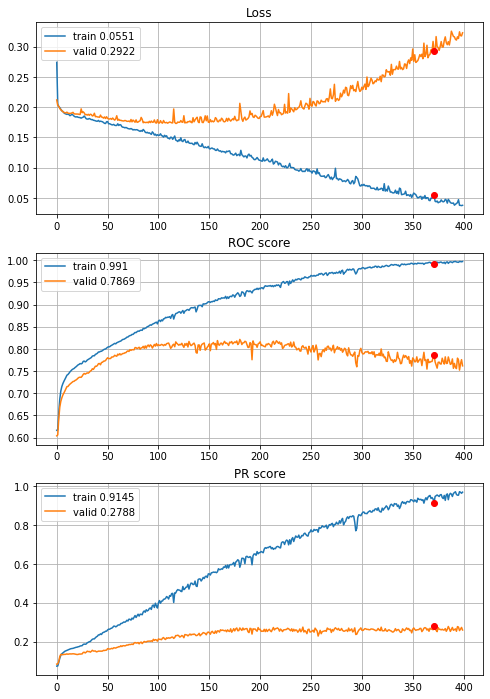


Fold 2------------------------------------------------------------


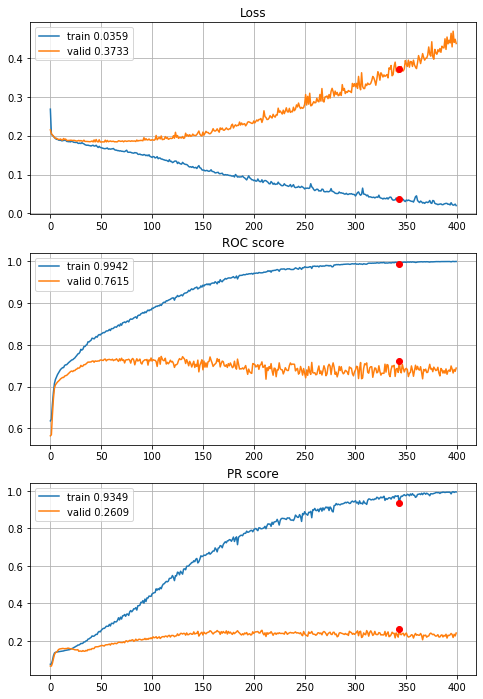


Fold 3------------------------------------------------------------


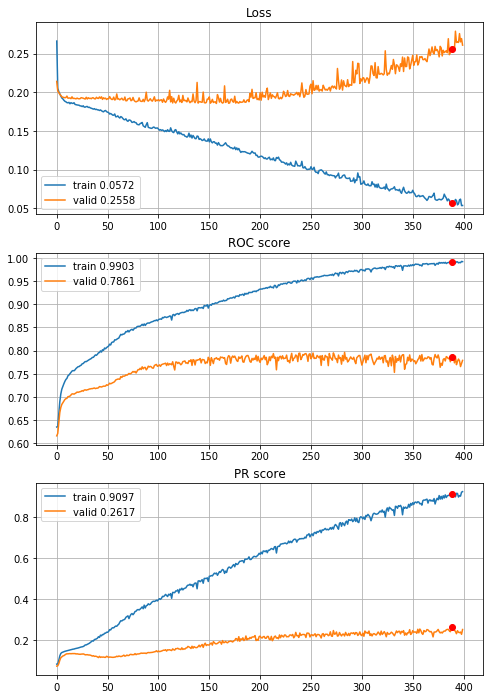


Fold 4------------------------------------------------------------


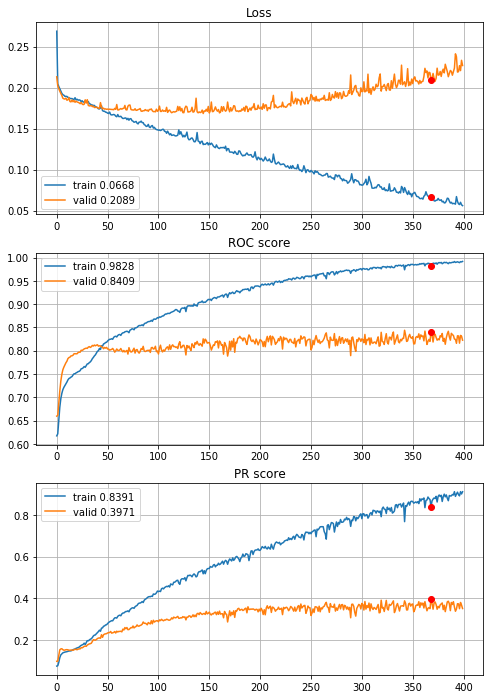


Fold 5------------------------------------------------------------


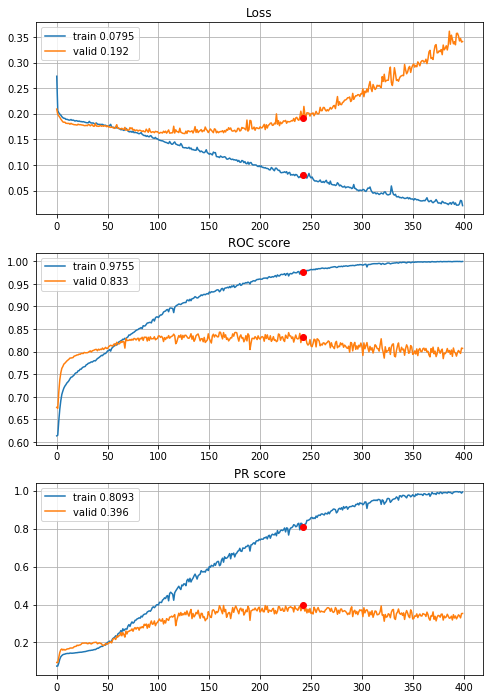


Fold 6------------------------------------------------------------


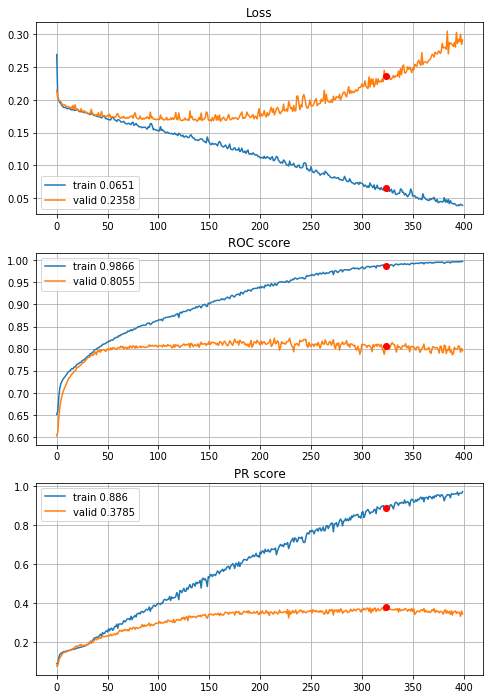

In [53]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Results are better, but by looking at learning curves it can be observed that results are not growing after approx 250-th epoch (except 4th fold, where it is more than 350), so for computation power saving further experiments will be performed on 250 epochs. First lets add one more dense layer.

In [41]:
def define_deep_CNN_2inc_2dense_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu)(dense)                  # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/250,
cumulative time: 4.03s train loss: 0.3202513510202267, validation loss: 0.219010388865367
Epoch: 2/250,
cumulative time: 5.43s train loss: 0.20716084101358226, validation loss: 0.202859007506812
Epoch: 3/250,
cumulative time: 6.81s train loss: 0.201815204831084, validation loss: 0.2014096360006975
Epoch: 4/250,
cumulative time: 8.22s train loss: 0.2000058492031504, validation loss: 0.1985553593721578
Epoch: 5/250,
cumulative time: 9.58s train loss: 0.19726358923310724, validation loss: 0.1961379508894264
Epoch: 6/250,
cumulative time: 10.91s train loss: 0.19462732517977396, validation loss: 0.19392565517623542
Epoch: 7/250,
cumulative time: 12.28s train loss: 0.19285103183553734, validation loss: 0.1920432601253381
Epoch: 8/250,
cumulative time: 13.64s train loss: 0.19007506113269584, validation loss: 0.1914137479518854
Epoch: 9/250,
cumulative time: 15.09s train loss: 0.1893352225603467, valid

Epoch: 77/250,
cumulative time: 108.96s train loss: 0.1469532068883238, validation loss: 0.17935737276702124
Epoch: 78/250,
cumulative time: 110.29s train loss: 0.14680013984510754, validation loss: 0.18187252245970206
Epoch: 79/250,
cumulative time: 111.67s train loss: 0.14384017506672417, validation loss: 0.18089470587838175
Epoch: 80/250,
cumulative time: 113.08s train loss: 0.14397148000200455, validation loss: 0.1777876971468299
Epoch: 81/250,
cumulative time: 114.51s train loss: 0.1415803182495236, validation loss: 0.18448380781039647
Epoch: 82/250,
cumulative time: 115.85s train loss: 0.14099805475896635, validation loss: 0.18317931572988458
Epoch: 83/250,
cumulative time: 117.23s train loss: 0.13858950499307715, validation loss: 0.17952558418534253
Epoch: 84/250,
cumulative time: 118.62s train loss: 0.13885493144894204, validation loss: 0.1830216817420871
Epoch: 85/250,
cumulative time: 120.01s train loss: 0.1460612717009883, validation loss: 0.18048644240329345
Epoch: 86/250,


Epoch: 152/250,
cumulative time: 212.84s train loss: 0.07677350869729768, validation loss: 0.21064198311288962
Epoch: 153/250,
cumulative time: 214.2s train loss: 0.07417441862132428, validation loss: 0.2154949673022276
Epoch: 154/250,
cumulative time: 215.56s train loss: 0.07538873733538917, validation loss: 0.21308561091401937
Epoch: 155/250,
cumulative time: 216.89s train loss: 0.07376951990027884, validation loss: 0.2202534070118014
Epoch: 156/250,
cumulative time: 218.26s train loss: 0.07828131653637356, validation loss: 0.20979282656561524
Epoch: 157/250,
cumulative time: 219.61s train loss: 0.07130892041791091, validation loss: 0.2322933192943699
Epoch: 158/250,
cumulative time: 220.96s train loss: 0.0706422721415892, validation loss: 0.22602996238240422
Epoch: 159/250,
cumulative time: 222.34s train loss: 0.06927838654186458, validation loss: 0.22971196461486687
Epoch: 160/250,
cumulative time: 223.74s train loss: 0.06713392896912297, validation loss: 0.2221399685247485
Epoch: 

Epoch: 227/250,
cumulative time: 316.18s train loss: 0.02269417244571156, validation loss: 0.36012033382754005
Epoch: 228/250,
cumulative time: 317.53s train loss: 0.022964264900730138, validation loss: 0.38891526263453186
Epoch: 229/250,
cumulative time: 318.92s train loss: 0.026356531590949802, validation loss: 0.4312179357604643
Epoch: 230/250,
cumulative time: 320.31s train loss: 0.033929056143884063, validation loss: 0.36408206305185736
Epoch: 231/250,
cumulative time: 321.74s train loss: 0.030445843861450637, validation loss: 0.39690020652025065
Epoch: 232/250,
cumulative time: 323.15s train loss: 0.026089646384230586, validation loss: 0.388202763135292
Epoch: 233/250,
cumulative time: 324.53s train loss: 0.02219901371726455, validation loss: 0.3751867719253283
Epoch: 234/250,
cumulative time: 325.92s train loss: 0.02296186463145612, validation loss: 0.37439852890065933
Epoch: 235/250,
cumulative time: 327.3s train loss: 0.02471053668292881, validation loss: 0.4108471588832006
Ep

Epoch: 50/250,
cumulative time: 73.43s train loss: 0.1696959435980375, validation loss: 0.18040356923521092
Epoch: 51/250,
cumulative time: 74.87s train loss: 0.16728494522009205, validation loss: 0.1807027075508162
Epoch: 52/250,
cumulative time: 76.29s train loss: 0.16678265868058958, validation loss: 0.18233922318668896
Epoch: 53/250,
cumulative time: 77.69s train loss: 0.16750165682738052, validation loss: 0.17999697328019582
Epoch: 54/250,
cumulative time: 79.14s train loss: 0.16657761761282733, validation loss: 0.18116305540255578
Epoch: 55/250,
cumulative time: 80.54s train loss: 0.1647565708378104, validation loss: 0.18176108359316728
Epoch: 56/250,
cumulative time: 82.11s train loss: 0.16466153400374192, validation loss: 0.18113207891126973
Epoch: 57/250,
cumulative time: 83.5s train loss: 0.1654738830347956, validation loss: 0.17867648371268974
Epoch: 58/250,
cumulative time: 84.91s train loss: 0.1631598556537273, validation loss: 0.17885922267779433
Epoch: 59/250,
cumulative

Epoch: 125/250,
cumulative time: 179.16s train loss: 0.09962128892482082, validation loss: 0.20033381525312985
Epoch: 126/250,
cumulative time: 180.52s train loss: 0.09799232771720351, validation loss: 0.19841736957806158
Epoch: 127/250,
cumulative time: 181.94s train loss: 0.0974400057581048, validation loss: 0.20454616371955572
Epoch: 128/250,
cumulative time: 183.43s train loss: 0.0968921153004449, validation loss: 0.1985767674007896
Epoch: 129/250,
cumulative time: 185.0s train loss: 0.0954611570984389, validation loss: 0.20076085153366124
Epoch: 130/250,
cumulative time: 186.52s train loss: 0.09495688872276138, validation loss: 0.2022879657350161
Epoch: 131/250,
cumulative time: 188.04s train loss: 0.09727374087635088, validation loss: 0.2005215532078558
Epoch: 132/250,
cumulative time: 189.67s train loss: 0.09789734915402139, validation loss: 0.21139869333287337
Epoch: 133/250,
cumulative time: 191.11s train loss: 0.09245571795555221, validation loss: 0.21240749332351372
Epoch: 1

Epoch: 200/250,
cumulative time: 284.38s train loss: 0.043334920786247094, validation loss: 0.3113186952003092
Epoch: 201/250,
cumulative time: 285.82s train loss: 0.03394735825287253, validation loss: 0.3275527829130626
Epoch: 202/250,
cumulative time: 287.19s train loss: 0.03163643542286016, validation loss: 0.3262731296785678
Epoch: 203/250,
cumulative time: 288.6s train loss: 0.031016535080394026, validation loss: 0.32899810336251256
Epoch: 204/250,
cumulative time: 290.06s train loss: 0.034343568899876886, validation loss: 0.32455987847930645
Epoch: 205/250,
cumulative time: 291.41s train loss: 0.03393401638643384, validation loss: 0.33041275892637473
Epoch: 206/250,
cumulative time: 292.77s train loss: 0.029704217120840686, validation loss: 0.3450068284290189
Epoch: 207/250,
cumulative time: 294.18s train loss: 0.030046188227764337, validation loss: 0.3500190658622895
Epoch: 208/250,
cumulative time: 295.62s train loss: 0.029426629809924228, validation loss: 0.3538517676055472
Ep

Epoch: 22/250,
cumulative time: 32.94s train loss: 0.18218156377577285, validation loss: 0.19283676203251535
Epoch: 23/250,
cumulative time: 34.28s train loss: 0.18169165488997613, validation loss: 0.19625554268785364
Epoch: 24/250,
cumulative time: 35.72s train loss: 0.18267285724589177, validation loss: 0.19302472464075862
Epoch: 25/250,
cumulative time: 37.14s train loss: 0.18201766981832437, validation loss: 0.19282631204800188
Epoch: 26/250,
cumulative time: 38.56s train loss: 0.18063913163365386, validation loss: 0.19313025419772117
Epoch: 27/250,
cumulative time: 40.14s train loss: 0.18063850820584046, validation loss: 0.19245281176472945
Epoch: 28/250,
cumulative time: 41.5s train loss: 0.17984309856035754, validation loss: 0.19276741055747618
Epoch: 29/250,
cumulative time: 42.85s train loss: 0.17881326861786093, validation loss: 0.19233650062423405
Epoch: 30/250,
cumulative time: 44.2s train loss: 0.1788294754884848, validation loss: 0.1973699834616189
Epoch: 31/250,
cumulati

Epoch: 98/250,
cumulative time: 138.42s train loss: 0.13446827126705208, validation loss: 0.19232875244645053
Epoch: 99/250,
cumulative time: 139.8s train loss: 0.1340288585892786, validation loss: 0.19727381450169099
Epoch: 100/250,
cumulative time: 141.19s train loss: 0.1321295632112096, validation loss: 0.1968004995357268
Epoch: 101/250,
cumulative time: 142.56s train loss: 0.1306959465846174, validation loss: 0.20329658741890938
Epoch: 102/250,
cumulative time: 143.9s train loss: 0.13227150676183247, validation loss: 0.2016134012650275
Epoch: 103/250,
cumulative time: 145.31s train loss: 0.1325963110920845, validation loss: 0.20664822632273175
Epoch: 104/250,
cumulative time: 146.74s train loss: 0.13262521949801281, validation loss: 0.2015260285041704
Epoch: 105/250,
cumulative time: 148.1s train loss: 0.12981594326214294, validation loss: 0.19717784117402634
Epoch: 106/250,
cumulative time: 149.5s train loss: 0.13010045533550058, validation loss: 0.21193053297967307
Epoch: 107/250

Epoch: 173/250,
cumulative time: 242.23s train loss: 0.06860163149817201, validation loss: 0.25469407431116875
Epoch: 174/250,
cumulative time: 243.62s train loss: 0.07135249890795962, validation loss: 0.2351078697010479
Epoch: 175/250,
cumulative time: 244.97s train loss: 0.06765266357086894, validation loss: 0.2471699885684183
Epoch: 176/250,
cumulative time: 246.38s train loss: 0.065812883633031, validation loss: 0.24897743815301307
Epoch: 177/250,
cumulative time: 247.79s train loss: 0.0637025707323334, validation loss: 0.2442944310529448
Epoch: 178/250,
cumulative time: 249.15s train loss: 0.06013411356243502, validation loss: 0.2447849681297884
Epoch: 179/250,
cumulative time: 250.52s train loss: 0.06008414713097385, validation loss: 0.25415710334959607
Epoch: 180/250,
cumulative time: 251.92s train loss: 0.0650373366382975, validation loss: 0.26348990784201026
Epoch: 181/250,
cumulative time: 253.34s train loss: 0.06512655433402811, validation loss: 0.24717015689372043
Epoch: 18

Epoch: 248/250,
cumulative time: 346.12s train loss: 0.018381268154851554, validation loss: 0.3819469255683696
Epoch: 249/250,
cumulative time: 347.54s train loss: 0.01843183991427839, validation loss: 0.3925074665947298
Epoch: 250/250,
cumulative time: 348.9s train loss: 0.01809756069004142, validation loss: 0.41487266081705476

Early stopping results:
best results in epoch: 211, 
best valid PR: 0.29904754046017507, 
valid ROC: 0.7556211748022093        
overfitting PR: 0.6442217376175117, 
overfitting ROC: 0.2379194571031814

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/250,
cumulative time: 3.67s train loss: 0.31957363905584263, validation loss: 0.22708618554677826
Epoch: 2/250,
cumulative time: 5.1s train loss: 0.20880124928490856, validation loss: 0.2039961012713028
Epoch: 3/250,
cumulative time: 6.53s train loss: 0.2031109559772191, validation loss: 0.20034190939347543
Epoch: 4/250,
cumulative time: 8.12s train loss: 0.20026036457747248, 

Epoch: 72/250,
cumulative time: 103.93s train loss: 0.15107886626936995, validation loss: 0.17193746553585593
Epoch: 73/250,
cumulative time: 105.3s train loss: 0.1528050708101894, validation loss: 0.17002560958073526
Epoch: 74/250,
cumulative time: 106.67s train loss: 0.15584125243463195, validation loss: 0.17282202587272133
Epoch: 75/250,
cumulative time: 108.03s train loss: 0.15208017145655517, validation loss: 0.17126473951818508
Epoch: 76/250,
cumulative time: 109.38s train loss: 0.15041674026818883, validation loss: 0.16733107607814227
Epoch: 77/250,
cumulative time: 110.76s train loss: 0.1463855029848962, validation loss: 0.16764646277612696
Epoch: 78/250,
cumulative time: 112.12s train loss: 0.14673952046027386, validation loss: 0.16828342941523086
Epoch: 79/250,
cumulative time: 113.49s train loss: 0.14534197165297827, validation loss: 0.1722423219818741
Epoch: 80/250,
cumulative time: 114.89s train loss: 0.14541255162292455, validation loss: 0.16836436418467757
Epoch: 81/250,

Epoch: 147/250,
cumulative time: 207.91s train loss: 0.0996232387680425, validation loss: 0.16656300733392138
Epoch: 148/250,
cumulative time: 209.27s train loss: 0.09774825188881628, validation loss: 0.1711898716261713
Epoch: 149/250,
cumulative time: 210.64s train loss: 0.0976768374152864, validation loss: 0.16510181745718416
Epoch: 150/250,
cumulative time: 212.0s train loss: 0.09620961109380477, validation loss: 0.17145004845176773
Epoch: 151/250,
cumulative time: 213.37s train loss: 0.09476132501471227, validation loss: 0.18730266866958248
Epoch: 152/250,
cumulative time: 214.73s train loss: 0.09709502335414077, validation loss: 0.17126167308440252
Epoch: 153/250,
cumulative time: 216.11s train loss: 0.09657463707038952, validation loss: 0.17459434515323016
Epoch: 154/250,
cumulative time: 217.47s train loss: 0.0950042910231616, validation loss: 0.1757503757982371
Epoch: 155/250,
cumulative time: 218.83s train loss: 0.09444287491359357, validation loss: 0.17107511967562591
Epoch: 

Epoch: 222/250,
cumulative time: 310.52s train loss: 0.0500239367270468, validation loss: 0.2460609279050561
Epoch: 223/250,
cumulative time: 311.92s train loss: 0.0476410749284534, validation loss: 0.24568703954239293
Epoch: 224/250,
cumulative time: 313.28s train loss: 0.044103240289872614, validation loss: 0.23761425850503376
Epoch: 225/250,
cumulative time: 314.66s train loss: 0.044945633598712, validation loss: 0.2554352167331905
Epoch: 226/250,
cumulative time: 316.06s train loss: 0.0441906857486278, validation loss: 0.2370068809972319
Epoch: 227/250,
cumulative time: 317.41s train loss: 0.051440780604671395, validation loss: 0.28061465951477776
Epoch: 228/250,
cumulative time: 318.74s train loss: 0.047747080157120675, validation loss: 0.28016513867026044
Epoch: 229/250,
cumulative time: 320.1s train loss: 0.04824114708176884, validation loss: 0.2453618974325363
Epoch: 230/250,
cumulative time: 321.44s train loss: 0.04555327226154798, validation loss: 0.26441500794936235
Epoch: 2

Epoch: 45/250,
cumulative time: 66.99s train loss: 0.17136248818767097, validation loss: 0.1728894364200431
Epoch: 46/250,
cumulative time: 68.48s train loss: 0.17003034023986013, validation loss: 0.17408963932328392
Epoch: 47/250,
cumulative time: 70.0s train loss: 0.17096540168706886, validation loss: 0.17183585164494994
Epoch: 48/250,
cumulative time: 71.73s train loss: 0.1695512992275112, validation loss: 0.17361732401786123
Epoch: 49/250,
cumulative time: 73.24s train loss: 0.17030768206420158, validation loss: 0.17049466300887697
Epoch: 50/250,
cumulative time: 74.73s train loss: 0.1674289345002707, validation loss: 0.1735284253142835
Epoch: 51/250,
cumulative time: 76.25s train loss: 0.1662848593305983, validation loss: 0.17291893667924632
Epoch: 52/250,
cumulative time: 77.69s train loss: 0.16653579763443188, validation loss: 0.1715819465366956
Epoch: 53/250,
cumulative time: 79.12s train loss: 0.16551892403391452, validation loss: 0.18059612002619604
Epoch: 54/250,
cumulative 

Epoch: 121/250,
cumulative time: 174.63s train loss: 0.09424533004099442, validation loss: 0.1862913186405595
Epoch: 122/250,
cumulative time: 175.98s train loss: 0.1009091666619616, validation loss: 0.18437690521293504
Epoch: 123/250,
cumulative time: 177.33s train loss: 0.09937226125658014, validation loss: 0.17968945814250925
Epoch: 124/250,
cumulative time: 178.7s train loss: 0.09154342537064081, validation loss: 0.18335416155793685
Epoch: 125/250,
cumulative time: 180.06s train loss: 0.0861709160184435, validation loss: 0.1860699618910249
Epoch: 126/250,
cumulative time: 181.4s train loss: 0.08564119867996713, validation loss: 0.18579536319103812
Epoch: 127/250,
cumulative time: 182.77s train loss: 0.0838789861580288, validation loss: 0.1869371917494636
Epoch: 128/250,
cumulative time: 184.25s train loss: 0.09083708918963869, validation loss: 0.18062216622059613
Epoch: 129/250,
cumulative time: 185.83s train loss: 0.08127805044821794, validation loss: 0.19297771789235055
Epoch: 13

Epoch: 196/250,
cumulative time: 290.25s train loss: 0.03193623445063732, validation loss: 0.28988068226004166
Epoch: 197/250,
cumulative time: 291.67s train loss: 0.039550650652299166, validation loss: 0.29417259037007426
Epoch: 198/250,
cumulative time: 293.09s train loss: 0.03673020258347031, validation loss: 0.29419495648519217
Epoch: 199/250,
cumulative time: 294.51s train loss: 0.041459144867169374, validation loss: 0.31697557635138407
Epoch: 200/250,
cumulative time: 295.93s train loss: 0.030460745062220494, validation loss: 0.2793625355660103
Epoch: 201/250,
cumulative time: 297.37s train loss: 0.02644568430117792, validation loss: 0.28367698825997295
Epoch: 202/250,
cumulative time: 298.79s train loss: 0.02628266086324051, validation loss: 0.29478322994725253
Epoch: 203/250,
cumulative time: 300.22s train loss: 0.026203025909280708, validation loss: 0.2875083883468072
Epoch: 204/250,
cumulative time: 301.64s train loss: 0.029460532293748315, validation loss: 0.3174364004862731

Epoch: 18/250,
cumulative time: 27.56s train loss: 0.18338774483496717, validation loss: 0.18360865116119385
Epoch: 19/250,
cumulative time: 28.93s train loss: 0.18355619353861072, validation loss: 0.18742022182213838
Epoch: 20/250,
cumulative time: 30.28s train loss: 0.18320631635353002, validation loss: 0.182971145703942
Epoch: 21/250,
cumulative time: 31.63s train loss: 0.18363574678017422, validation loss: 0.18359384643122026
Epoch: 22/250,
cumulative time: 32.99s train loss: 0.1828305859439286, validation loss: 0.18473402528493216
Epoch: 23/250,
cumulative time: 34.36s train loss: 0.18194262956498367, validation loss: 0.181331895799338
Epoch: 24/250,
cumulative time: 35.73s train loss: 0.1818639663228672, validation loss: 0.18253148054800503
Epoch: 25/250,
cumulative time: 37.13s train loss: 0.18058230635184544, validation loss: 0.18296982804744705
Epoch: 26/250,
cumulative time: 38.51s train loss: 0.18184001815620982, validation loss: 0.18199954993961942
Epoch: 27/250,
cumulative

Epoch: 94/250,
cumulative time: 141.35s train loss: 0.14235083587987102, validation loss: 0.16466020630312225
Epoch: 95/250,
cumulative time: 142.8s train loss: 0.1411053226806207, validation loss: 0.1658828773558627
Epoch: 96/250,
cumulative time: 144.23s train loss: 0.13373188221571491, validation loss: 0.16442178534876747
Epoch: 97/250,
cumulative time: 145.67s train loss: 0.13532616693550856, validation loss: 0.16126611688724982
Epoch: 98/250,
cumulative time: 147.11s train loss: 0.13048445544771703, validation loss: 0.16059914525669342
Epoch: 99/250,
cumulative time: 148.55s train loss: 0.1292688196955131, validation loss: 0.16042911833817042
Epoch: 100/250,
cumulative time: 149.99s train loss: 0.13010849957486254, validation loss: 0.16318839228120746
Epoch: 101/250,
cumulative time: 151.41s train loss: 0.12948584768409824, validation loss: 0.16490258392180018
Epoch: 102/250,
cumulative time: 153.02s train loss: 0.12915211984753802, validation loss: 0.16454123985783606
Epoch: 103/

Epoch: 169/250,
cumulative time: 254.62s train loss: 0.06298444157746298, validation loss: 0.21758577710763635
Epoch: 170/250,
cumulative time: 256.42s train loss: 0.06166891797399047, validation loss: 0.21533907373367278
Epoch: 171/250,
cumulative time: 258.07s train loss: 0.06533110540457605, validation loss: 0.23149440995841325
Epoch: 172/250,
cumulative time: 259.65s train loss: 0.07175278991069198, validation loss: 0.21399204412663014
Epoch: 173/250,
cumulative time: 261.16s train loss: 0.06376543111514811, validation loss: 0.21601186627750502
Epoch: 174/250,
cumulative time: 262.6s train loss: 0.06467438627578205, validation loss: 0.20912385049811502
Epoch: 175/250,
cumulative time: 264.04s train loss: 0.0624860669110855, validation loss: 0.24414397124454826
Epoch: 176/250,
cumulative time: 265.47s train loss: 0.07121883521631588, validation loss: 0.20786822317244247
Epoch: 177/250,
cumulative time: 266.9s train loss: 0.06411836406090225, validation loss: 0.23578801753166911
Epoc

Epoch: 244/250,
cumulative time: 362.3s train loss: 0.024995702756355744, validation loss: 0.3969137071345093
Epoch: 245/250,
cumulative time: 363.67s train loss: 0.021146830376278212, validation loss: 0.404379407497128
Epoch: 246/250,
cumulative time: 365.08s train loss: 0.021156512304312654, validation loss: 0.3669606801680713
Epoch: 247/250,
cumulative time: 366.49s train loss: 0.01850303467073983, validation loss: 0.39022556950188464
Epoch: 248/250,
cumulative time: 367.87s train loss: 0.017231513004727694, validation loss: 0.3870157399684272
Epoch: 249/250,
cumulative time: 369.34s train loss: 0.01891274339139506, validation loss: 0.41625361505906006
Epoch: 250/250,
cumulative time: 370.73s train loss: 0.019219778138157062, validation loss: 0.38692479440561756

Early stopping results:
best results in epoch: 139, 
best valid PR: 0.40979103801993905, 
valid ROC: 0.84129888802786        
overfitting PR: 0.36633462145295176, 
overfitting ROC: 0.11360894535288335

Cross validation time

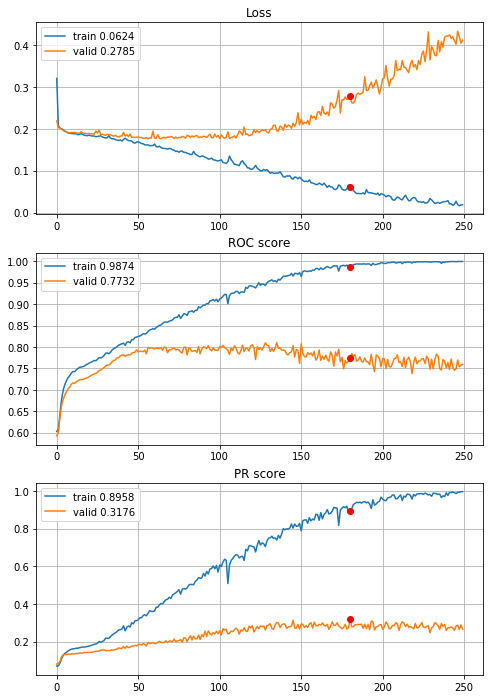


Fold 2------------------------------------------------------------


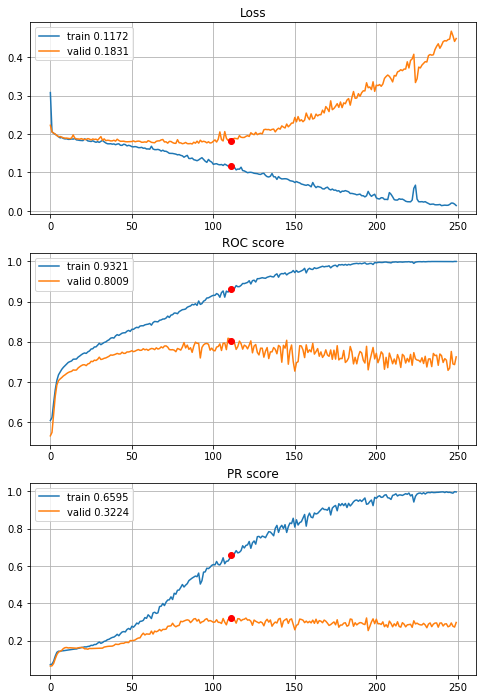


Fold 3------------------------------------------------------------


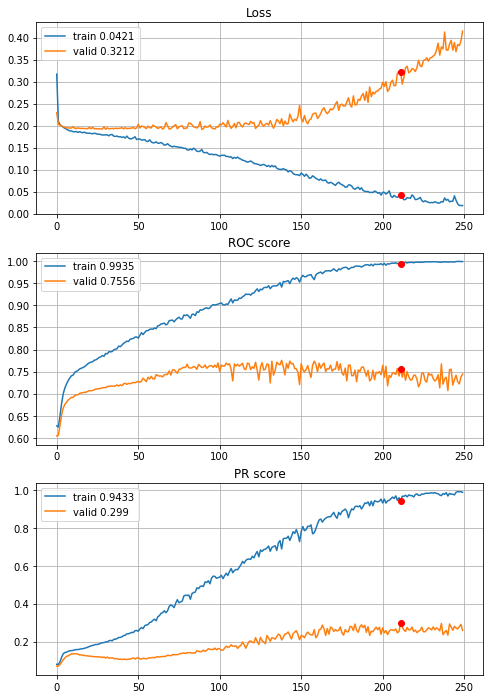


Fold 4------------------------------------------------------------


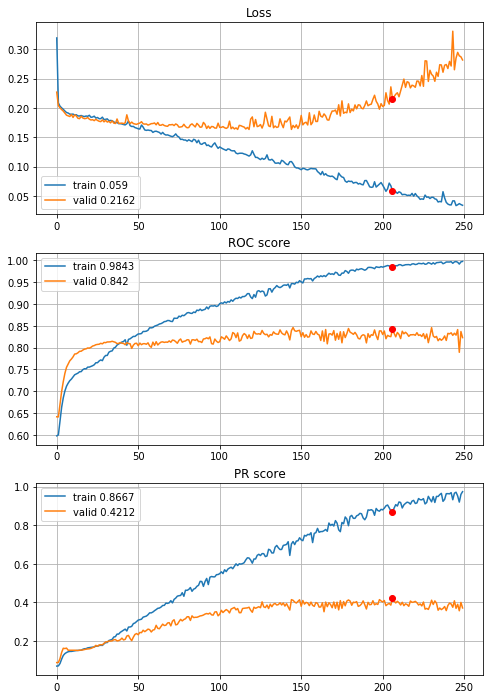


Fold 5------------------------------------------------------------


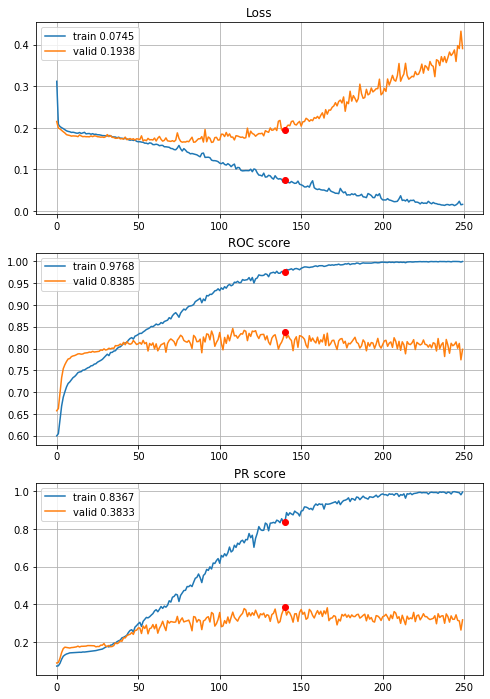


Fold 6------------------------------------------------------------


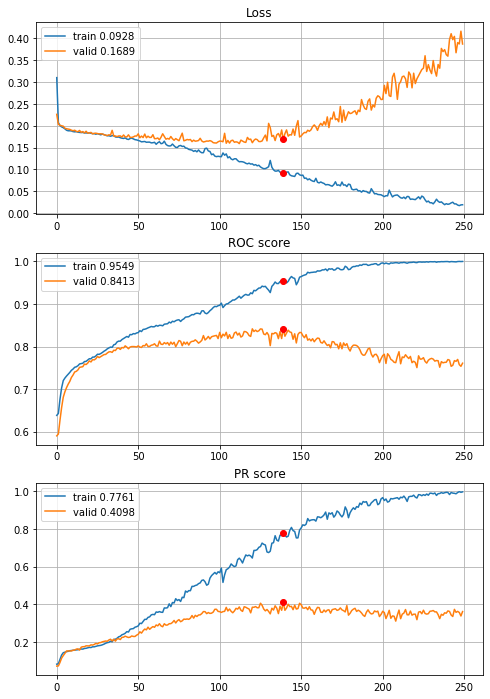

In [55]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std, features=features,
                                        target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Lets try a little dropout on two dense layers, 0.2 for example.

In [48]:
def define_deep_CNN_2inc_2dense_std_drop2_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu)(dense)                  # (128,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/250,
cumulative time: 4.46s train loss: 0.31215290994113626, validation loss: 0.2098495771967691
Epoch: 2/250,
cumulative time: 5.93s train loss: 0.2100686252332263, validation loss: 0.20169020154550824
Epoch: 3/250,
cumulative time: 7.36s train loss: 0.20510007424200652, validation loss: 0.2006634537300502
Epoch: 4/250,
cumulative time: 8.78s train loss: 0.20284066861970992, validation loss: 0.198054970761316
Epoch: 5/250,
cumulative time: 10.21s train loss: 0.19815374027476493, validation loss: 0.19594131376647558
Epoch: 6/250,
cumulative time: 11.63s train loss: 0.19810936520928568, validation loss: 0.19419665168019848
Epoch: 7/250,
cumulative time: 13.05s train loss: 0.19779403235174306, validation loss: 0.19269118103508726
Epoch: 8/250,
cumulative time: 14.49s train loss: 0.19394280021089666, validation loss: 0.19168506201592492
Epoch: 9/250,
cumulative time: 16.02s train loss: 0.19193834828190

Epoch: 76/250,
cumulative time: 116.41s train loss: 0.15160622681809044, validation loss: 0.1782849248146183
Epoch: 77/250,
cumulative time: 117.87s train loss: 0.15235188839206024, validation loss: 0.17346571328041097
Epoch: 78/250,
cumulative time: 119.33s train loss: 0.14959371770563037, validation loss: 0.1719357799396294
Epoch: 79/250,
cumulative time: 120.93s train loss: 0.15083399372096445, validation loss: 0.17558317996150705
Epoch: 80/250,
cumulative time: 122.58s train loss: 0.14888784877045771, validation loss: 0.17185229347058914
Epoch: 81/250,
cumulative time: 124.12s train loss: 0.14880061791465243, validation loss: 0.17532034752886663
Epoch: 82/250,
cumulative time: 125.62s train loss: 0.14698250920704692, validation loss: 0.17236976413762511
Epoch: 83/250,
cumulative time: 127.14s train loss: 0.14363838179460844, validation loss: 0.1765428881628161
Epoch: 84/250,
cumulative time: 128.68s train loss: 0.14615173530516923, validation loss: 0.18084159515762588
Epoch: 85/250

Epoch: 151/250,
cumulative time: 230.8s train loss: 0.09913150901128336, validation loss: 0.18879476333654518
Epoch: 152/250,
cumulative time: 232.23s train loss: 0.09817657215173475, validation loss: 0.18484164997580263
Epoch: 153/250,
cumulative time: 233.67s train loss: 0.0941639123183902, validation loss: 0.18826270676576173
Epoch: 154/250,
cumulative time: 235.11s train loss: 0.09901590717962258, validation loss: 0.1843923332640068
Epoch: 155/250,
cumulative time: 236.54s train loss: 0.09678752715891524, validation loss: 0.18082444256182995
Epoch: 156/250,
cumulative time: 237.98s train loss: 0.09706595442843148, validation loss: 0.18065323312928516
Epoch: 157/250,
cumulative time: 239.59s train loss: 0.09161079596526678, validation loss: 0.19531964815498778
Epoch: 158/250,
cumulative time: 241.04s train loss: 0.08822205327994068, validation loss: 0.19468953737886363
Epoch: 159/250,
cumulative time: 242.54s train loss: 0.09270949696838636, validation loss: 0.18755211232266839
Epoc

Epoch: 226/250,
cumulative time: 341.25s train loss: 0.05070587308844266, validation loss: 0.25483623339741956
Epoch: 227/250,
cumulative time: 342.68s train loss: 0.04790549194682493, validation loss: 0.24260049516688892
Epoch: 228/250,
cumulative time: 344.11s train loss: 0.05330236411871482, validation loss: 0.23988926204757027
Epoch: 229/250,
cumulative time: 345.52s train loss: 0.054831845370536925, validation loss: 0.2414301629168716
Epoch: 230/250,
cumulative time: 346.95s train loss: 0.05428958859182534, validation loss: 0.2363123001899745
Epoch: 231/250,
cumulative time: 348.38s train loss: 0.05160363474547514, validation loss: 0.25844863507518806
Epoch: 232/250,
cumulative time: 349.77s train loss: 0.04749295066006661, validation loss: 0.25302819584079794
Epoch: 233/250,
cumulative time: 351.18s train loss: 0.04876720431411313, validation loss: 0.24951351762142532
Epoch: 234/250,
cumulative time: 352.6s train loss: 0.051712054889646614, validation loss: 0.2525782338042418
Epo

Epoch: 49/250,
cumulative time: 75.96s train loss: 0.17242385147906253, validation loss: 0.18072117128649726
Epoch: 50/250,
cumulative time: 77.56s train loss: 0.17025497170977155, validation loss: 0.18263226267713686
Epoch: 51/250,
cumulative time: 79.12s train loss: 0.16789624020690638, validation loss: 0.18273909995554255
Epoch: 52/250,
cumulative time: 80.67s train loss: 0.16932475188399276, validation loss: 0.1824853315066934
Epoch: 53/250,
cumulative time: 82.22s train loss: 0.16811569047634922, validation loss: 0.18352519919102983
Epoch: 54/250,
cumulative time: 83.72s train loss: 0.16634920957821292, validation loss: 0.18117596876507636
Epoch: 55/250,
cumulative time: 85.27s train loss: 0.1664865383916146, validation loss: 0.18399599303064743
Epoch: 56/250,
cumulative time: 86.76s train loss: 0.16601873767866226, validation loss: 0.18390719364337
Epoch: 57/250,
cumulative time: 88.24s train loss: 0.1682209094587308, validation loss: 0.1827495937813213
Epoch: 58/250,
cumulative 

Epoch: 124/250,
cumulative time: 190.17s train loss: 0.10692033221574565, validation loss: 0.197691735714532
Epoch: 125/250,
cumulative time: 191.62s train loss: 0.10418266661685348, validation loss: 0.20306104757373555
Epoch: 126/250,
cumulative time: 193.06s train loss: 0.10340310001460958, validation loss: 0.20929635256792592
Epoch: 127/250,
cumulative time: 194.51s train loss: 0.10578405765158821, validation loss: 0.21199767656720683
Epoch: 128/250,
cumulative time: 195.98s train loss: 0.1002155808019375, validation loss: 0.2085790430976064
Epoch: 129/250,
cumulative time: 197.45s train loss: 0.09947725878649213, validation loss: 0.20386760769610993
Epoch: 130/250,
cumulative time: 198.92s train loss: 0.09738488299522285, validation loss: 0.21333216538512034
Epoch: 131/250,
cumulative time: 200.4s train loss: 0.10471954706350595, validation loss: 0.2111541420485066
Epoch: 132/250,
cumulative time: 201.96s train loss: 0.10414153750847362, validation loss: 0.21479369939347365
Epoch: 

Epoch: 199/250,
cumulative time: 304.64s train loss: 0.04549360465058981, validation loss: 0.3041705810512467
Epoch: 200/250,
cumulative time: 306.23s train loss: 0.04954739202062018, validation loss: 0.3227115703570429
Epoch: 201/250,
cumulative time: 307.83s train loss: 0.043336974656031535, validation loss: 0.2993154314969818
Epoch: 202/250,
cumulative time: 309.36s train loss: 0.042570305488223395, validation loss: 0.30844535932725914
Epoch: 203/250,
cumulative time: 310.83s train loss: 0.043846729216962976, validation loss: 0.3134493970440877
Epoch: 204/250,
cumulative time: 312.37s train loss: 0.0506614880235801, validation loss: 0.30893904533696226
Epoch: 205/250,
cumulative time: 313.98s train loss: 0.045266549993698564, validation loss: 0.31924999055406367
Epoch: 206/250,
cumulative time: 315.64s train loss: 0.043827511268209635, validation loss: 0.317225106055433
Epoch: 207/250,
cumulative time: 317.18s train loss: 0.03759984067946482, validation loss: 0.3277562926463159
Epoc

Epoch: 22/250,
cumulative time: 37.94s train loss: 0.18558117513531286, validation loss: 0.19123724278460724
Epoch: 23/250,
cumulative time: 39.51s train loss: 0.18634802759521651, validation loss: 0.19329742378243953
Epoch: 24/250,
cumulative time: 41.15s train loss: 0.1844098749301032, validation loss: 0.19126181461682848
Epoch: 25/250,
cumulative time: 42.79s train loss: 0.1846808009453338, validation loss: 0.19247618871452535
Epoch: 26/250,
cumulative time: 44.33s train loss: 0.18400652469803588, validation loss: 0.19248922358896556
Epoch: 27/250,
cumulative time: 45.86s train loss: 0.18534441101734506, validation loss: 0.19261388198667193
Epoch: 28/250,
cumulative time: 47.4s train loss: 0.18300667898654613, validation loss: 0.19181726851619127
Epoch: 29/250,
cumulative time: 48.96s train loss: 0.1829639500295955, validation loss: 0.1912691326998301
Epoch: 30/250,
cumulative time: 50.51s train loss: 0.18219295395714508, validation loss: 0.19517260560622582
Epoch: 31/250,
cumulativ

Epoch: 98/250,
cumulative time: 156.34s train loss: 0.13657491313945236, validation loss: 0.19477238772352023
Epoch: 99/250,
cumulative time: 157.91s train loss: 0.13922882546817478, validation loss: 0.19174992930653795
Epoch: 100/250,
cumulative time: 159.5s train loss: 0.1358490581065518, validation loss: 0.19548034859685529
Epoch: 101/250,
cumulative time: 161.11s train loss: 0.13818801651123708, validation loss: 0.18985260887118405
Epoch: 102/250,
cumulative time: 162.69s train loss: 0.13471355653074576, validation loss: 0.19293876238791127
Epoch: 103/250,
cumulative time: 164.24s train loss: 0.13767153714433056, validation loss: 0.19402597472325242
Epoch: 104/250,
cumulative time: 165.83s train loss: 0.1360417416259133, validation loss: 0.19471849258697463
Epoch: 105/250,
cumulative time: 167.38s train loss: 0.1326147381809351, validation loss: 0.18405890578392659
Epoch: 106/250,
cumulative time: 168.91s train loss: 0.1321591909994599, validation loss: 0.1978727128835987
Epoch: 10

Epoch: 173/250,
cumulative time: 273.5s train loss: 0.07911477418192543, validation loss: 0.23063719274642275
Epoch: 174/250,
cumulative time: 275.03s train loss: 0.0744191697058862, validation loss: 0.24528826656513592
Epoch: 175/250,
cumulative time: 276.55s train loss: 0.07997602169051508, validation loss: 0.2377452244963104
Epoch: 176/250,
cumulative time: 278.08s train loss: 0.07911270752804864, validation loss: 0.24051883617901657
Epoch: 177/250,
cumulative time: 279.61s train loss: 0.07826592184803101, validation loss: 0.2322399756428009
Epoch: 178/250,
cumulative time: 281.14s train loss: 0.07910460078142392, validation loss: 0.2529325116402929
Epoch: 179/250,
cumulative time: 282.66s train loss: 0.07871868125723994, validation loss: 0.2403471955358779
Epoch: 180/250,
cumulative time: 284.18s train loss: 0.07856736237308269, validation loss: 0.2281791380751774
Epoch: 181/250,
cumulative time: 285.7s train loss: 0.07683639437564953, validation loss: 0.24357470019972186
Epoch: 18

Epoch: 248/250,
cumulative time: 390.21s train loss: 0.045300438285308234, validation loss: 0.34357228426806696
Epoch: 249/250,
cumulative time: 391.85s train loss: 0.048088331678792194, validation loss: 0.32396845802553176
Epoch: 250/250,
cumulative time: 393.36s train loss: 0.04385799397887561, validation loss: 0.3481128261436647

Early stopping results:
best results in epoch: 187, 
best valid PR: 0.3214712015033717, 
valid ROC: 0.7765431407672786        
overfitting PR: 0.5294228138745964, 
overfitting ROC: 0.20643184770744505

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/250,
cumulative time: 5.46s train loss: 0.30203719992339245, validation loss: 0.20942063974514552
Epoch: 2/250,
cumulative time: 6.99s train loss: 0.2057306031547725, validation loss: 0.20005973205832578
Epoch: 3/250,
cumulative time: 8.51s train loss: 0.20448372064478695, validation loss: 0.19908823344762672
Epoch: 4/250,
cumulative time: 10.03s train loss: 0.2018427929074

Epoch: 71/250,
cumulative time: 114.63s train loss: 0.14495668636060907, validation loss: 0.17065453949308948
Epoch: 72/250,
cumulative time: 116.21s train loss: 0.14487282491649153, validation loss: 0.16517997387520222
Epoch: 73/250,
cumulative time: 117.77s train loss: 0.143157773725379, validation loss: 0.16790467943968296
Epoch: 74/250,
cumulative time: 119.31s train loss: 0.1472367644117214, validation loss: 0.1642836480419842
Epoch: 75/250,
cumulative time: 120.89s train loss: 0.14212622877347864, validation loss: 0.16502627750657056
Epoch: 76/250,
cumulative time: 122.46s train loss: 0.14046354577641354, validation loss: 0.16699146242511767
Epoch: 77/250,
cumulative time: 123.98s train loss: 0.1382156681585471, validation loss: 0.16275341062216309
Epoch: 78/250,
cumulative time: 125.51s train loss: 0.13801017249172753, validation loss: 0.16575683147181777
Epoch: 79/250,
cumulative time: 127.06s train loss: 0.13794965163963002, validation loss: 0.16603511969518953
Epoch: 80/250,


Epoch: 146/250,
cumulative time: 232.82s train loss: 0.08360214369381934, validation loss: 0.19174414018005478
Epoch: 147/250,
cumulative time: 234.36s train loss: 0.0870235638788606, validation loss: 0.1847433570069955
Epoch: 148/250,
cumulative time: 235.95s train loss: 0.08598362934491167, validation loss: 0.1913687402776831
Epoch: 149/250,
cumulative time: 237.5s train loss: 0.0883446372314896, validation loss: 0.17099688024119994
Epoch: 150/250,
cumulative time: 239.09s train loss: 0.08235443981541173, validation loss: 0.19781394469202418
Epoch: 151/250,
cumulative time: 240.65s train loss: 0.08389255098149284, validation loss: 0.19296363929325905
Epoch: 152/250,
cumulative time: 242.21s train loss: 0.08013976172341258, validation loss: 0.1850167613823938
Epoch: 153/250,
cumulative time: 243.77s train loss: 0.08012893414255483, validation loss: 0.18097784366633635
Epoch: 154/250,
cumulative time: 245.33s train loss: 0.07816287523801915, validation loss: 0.18618833563253132
Epoch: 

Epoch: 221/250,
cumulative time: 351.4s train loss: 0.03821980126022513, validation loss: 0.30603050193549663
Epoch: 222/250,
cumulative time: 353.0s train loss: 0.03893239228413814, validation loss: 0.2643435254764038
Epoch: 223/250,
cumulative time: 354.57s train loss: 0.04128569796433829, validation loss: 0.28145694075351346
Epoch: 224/250,
cumulative time: 356.17s train loss: 0.03605786625442495, validation loss: 0.2835790459764012
Epoch: 225/250,
cumulative time: 357.79s train loss: 0.03659971752262978, validation loss: 0.2736528856442687
Epoch: 226/250,
cumulative time: 359.5s train loss: 0.03431870593827248, validation loss: 0.28971515065395076
Epoch: 227/250,
cumulative time: 361.04s train loss: 0.03599988015163875, validation loss: 0.28571780469240665
Epoch: 228/250,
cumulative time: 362.57s train loss: 0.03414699628474309, validation loss: 0.28012557771028995
Epoch: 229/250,
cumulative time: 364.12s train loss: 0.03559100724011964, validation loss: 0.292586430288481
Epoch: 23

Epoch: 44/250,
cumulative time: 74.09s train loss: 0.1734174674271336, validation loss: 0.1775045303541568
Epoch: 45/250,
cumulative time: 75.72s train loss: 0.17322719033223158, validation loss: 0.1737823331023107
Epoch: 46/250,
cumulative time: 77.38s train loss: 0.17246240567748714, validation loss: 0.17432364512854115
Epoch: 47/250,
cumulative time: 79.07s train loss: 0.1727747029273858, validation loss: 0.17619345538135445
Epoch: 48/250,
cumulative time: 80.63s train loss: 0.17292312683217018, validation loss: 0.17222754978029214
Epoch: 49/250,
cumulative time: 82.22s train loss: 0.1722032870926888, validation loss: 0.1730676046712197
Epoch: 50/250,
cumulative time: 83.83s train loss: 0.17043340554326966, validation loss: 0.1727238194737837
Epoch: 51/250,
cumulative time: 85.38s train loss: 0.16844277550143744, validation loss: 0.1743704146154895
Epoch: 52/250,
cumulative time: 86.98s train loss: 0.1693354077831982, validation loss: 0.17206108269639495
Epoch: 53/250,
cumulative ti

Epoch: 119/250,
cumulative time: 194.59s train loss: 0.11935157175652666, validation loss: 0.17750416180418363
Epoch: 120/250,
cumulative time: 196.15s train loss: 0.11565112633009751, validation loss: 0.178841246043304
Epoch: 121/250,
cumulative time: 197.69s train loss: 0.11647375474819885, validation loss: 0.17603125074010453
Epoch: 122/250,
cumulative time: 199.24s train loss: 0.11536858468833897, validation loss: 0.17518325986426922
Epoch: 123/250,
cumulative time: 200.77s train loss: 0.11445821800993548, validation loss: 0.1711812331582285
Epoch: 124/250,
cumulative time: 202.31s train loss: 0.11841443914936324, validation loss: 0.18117669212558288
Epoch: 125/250,
cumulative time: 203.85s train loss: 0.11265240098331489, validation loss: 0.18252832696288418
Epoch: 126/250,
cumulative time: 205.38s train loss: 0.1116080073039159, validation loss: 0.181413697388419
Epoch: 127/250,
cumulative time: 207.06s train loss: 0.11147700038115638, validation loss: 0.17570528004328625
Epoch: 

Epoch: 194/250,
cumulative time: 313.21s train loss: 0.06750742779752496, validation loss: 0.23430135620793466
Epoch: 195/250,
cumulative time: 314.84s train loss: 0.06087387612592713, validation loss: 0.24266808496265385
Epoch: 196/250,
cumulative time: 316.49s train loss: 0.062271694120117065, validation loss: 0.2373362597514563
Epoch: 197/250,
cumulative time: 318.12s train loss: 0.06346036112321488, validation loss: 0.25153658934932316
Epoch: 198/250,
cumulative time: 319.87s train loss: 0.06318605023442335, validation loss: 0.2609223722396495
Epoch: 199/250,
cumulative time: 321.43s train loss: 0.05801599125797842, validation loss: 0.2586516224111783
Epoch: 200/250,
cumulative time: 323.08s train loss: 0.05858266086587459, validation loss: 0.2537632756726943
Epoch: 201/250,
cumulative time: 324.7s train loss: 0.06038512031837876, validation loss: 0.25549154172395167
Epoch: 202/250,
cumulative time: 326.33s train loss: 0.05614421857533112, validation loss: 0.2684749228022079
Epoch:

Epoch: 17/250,
cumulative time: 31.04s train loss: 0.18512464010954097, validation loss: 0.18814546647367425
Epoch: 18/250,
cumulative time: 32.73s train loss: 0.18456170523705565, validation loss: 0.18307142582917407
Epoch: 19/250,
cumulative time: 34.49s train loss: 0.18493836009489426, validation loss: 0.188857972114385
Epoch: 20/250,
cumulative time: 36.2s train loss: 0.1834383714043237, validation loss: 0.18280427586236506
Epoch: 21/250,
cumulative time: 37.92s train loss: 0.18413301077235109, validation loss: 0.18379227975408777
Epoch: 22/250,
cumulative time: 39.59s train loss: 0.18421016615655167, validation loss: 0.18404924465541295
Epoch: 23/250,
cumulative time: 41.33s train loss: 0.18276965927762792, validation loss: 0.1805763046285112
Epoch: 24/250,
cumulative time: 43.08s train loss: 0.18075259000241498, validation loss: 0.18154108767938223
Epoch: 25/250,
cumulative time: 44.86s train loss: 0.18153634238460614, validation loss: 0.1825499420513574
Epoch: 26/250,
cumulative

Epoch: 93/250,
cumulative time: 153.17s train loss: 0.14651279308283316, validation loss: 0.17239022866013265
Epoch: 94/250,
cumulative time: 154.71s train loss: 0.14229669113093601, validation loss: 0.1668074638341688
Epoch: 95/250,
cumulative time: 156.32s train loss: 0.1438874743030709, validation loss: 0.16583157225184608
Epoch: 96/250,
cumulative time: 157.91s train loss: 0.13489194656265716, validation loss: 0.16636741756174805
Epoch: 97/250,
cumulative time: 159.54s train loss: 0.13693664461366167, validation loss: 0.16453172120313878
Epoch: 98/250,
cumulative time: 161.17s train loss: 0.133475772074722, validation loss: 0.1695932482625548
Epoch: 99/250,
cumulative time: 162.78s train loss: 0.13165490833072555, validation loss: 0.1677891593781739
Epoch: 100/250,
cumulative time: 164.41s train loss: 0.13493479857290233, validation loss: 0.16730108674443062
Epoch: 101/250,
cumulative time: 166.01s train loss: 0.13209218188535934, validation loss: 0.17148615227002215
Epoch: 102/250

Epoch: 168/250,
cumulative time: 270.03s train loss: 0.08397430743441829, validation loss: 0.20920375870586416
Epoch: 169/250,
cumulative time: 271.6s train loss: 0.08796510755536928, validation loss: 0.20141389702094023
Epoch: 170/250,
cumulative time: 273.15s train loss: 0.08014758925353357, validation loss: 0.2006381186339446
Epoch: 171/250,
cumulative time: 274.72s train loss: 0.08340574807461051, validation loss: 0.1866268330641923
Epoch: 172/250,
cumulative time: 276.31s train loss: 0.08054967848827539, validation loss: 0.1929718206664522
Epoch: 173/250,
cumulative time: 277.87s train loss: 0.07870734327377382, validation loss: 0.19052518349983386
Epoch: 174/250,
cumulative time: 279.48s train loss: 0.07432949755742561, validation loss: 0.2065375033329553
Epoch: 175/250,
cumulative time: 281.09s train loss: 0.07755250209427088, validation loss: 0.1995376584193687
Epoch: 176/250,
cumulative time: 282.66s train loss: 0.07627449401761842, validation loss: 0.20206331502270633
Epoch: 

Epoch: 243/250,
cumulative time: 392.74s train loss: 0.03960150698999304, validation loss: 0.3087646725919981
Epoch: 244/250,
cumulative time: 394.43s train loss: 0.04309616587784198, validation loss: 0.2965769125021771
Epoch: 245/250,
cumulative time: 396.06s train loss: 0.04150680859607679, validation loss: 0.276081723823372
Epoch: 246/250,
cumulative time: 397.7s train loss: 0.04130333365592497, validation loss: 0.29175095548421875
Epoch: 247/250,
cumulative time: 399.34s train loss: 0.03819203899244013, validation loss: 0.2944147090861518
Epoch: 248/250,
cumulative time: 400.98s train loss: 0.03797091364663719, validation loss: 0.2855102401785045
Epoch: 249/250,
cumulative time: 402.64s train loss: 0.03570340900054944, validation loss: 0.3009883193375304
Epoch: 250/250,
cumulative time: 404.27s train loss: 0.037300042010395336, validation loss: 0.29464150616031254

Early stopping results:
best results in epoch: 141, 
best valid PR: 0.39873590764830014, 
valid ROC: 0.830870064514924

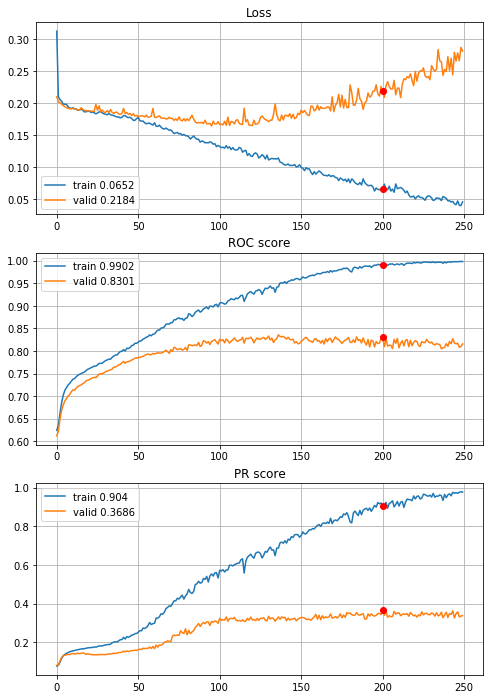


Fold 2------------------------------------------------------------


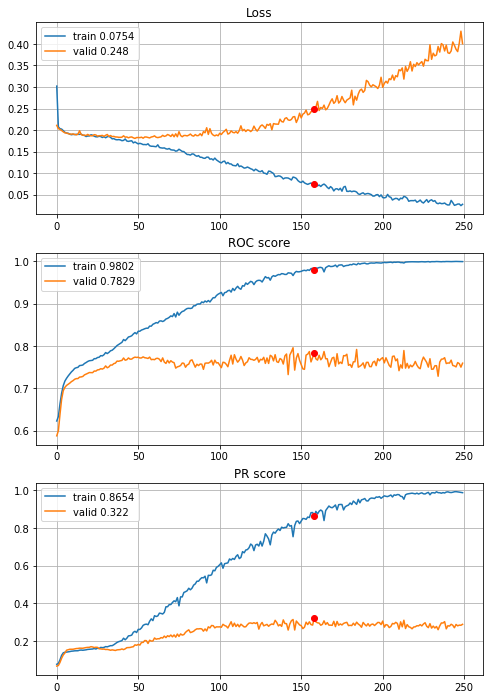


Fold 3------------------------------------------------------------


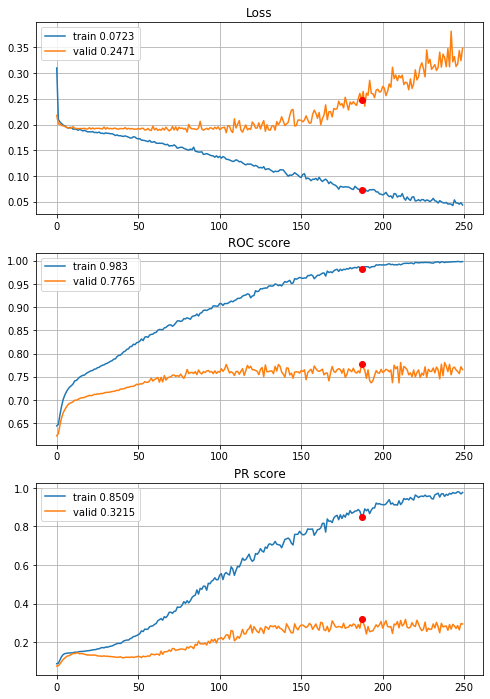


Fold 4------------------------------------------------------------


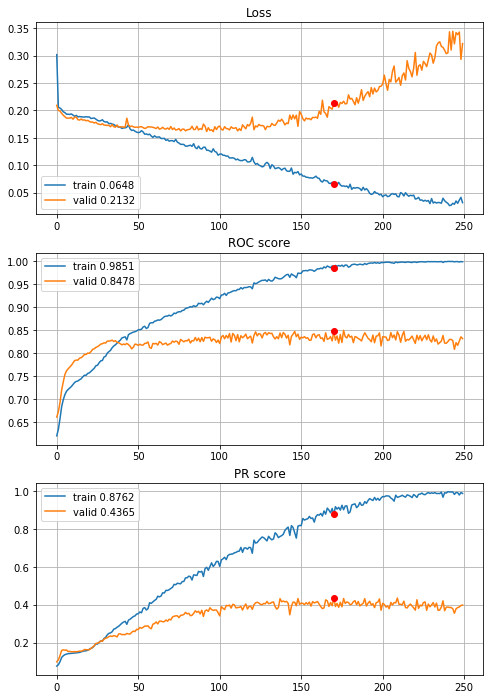


Fold 5------------------------------------------------------------


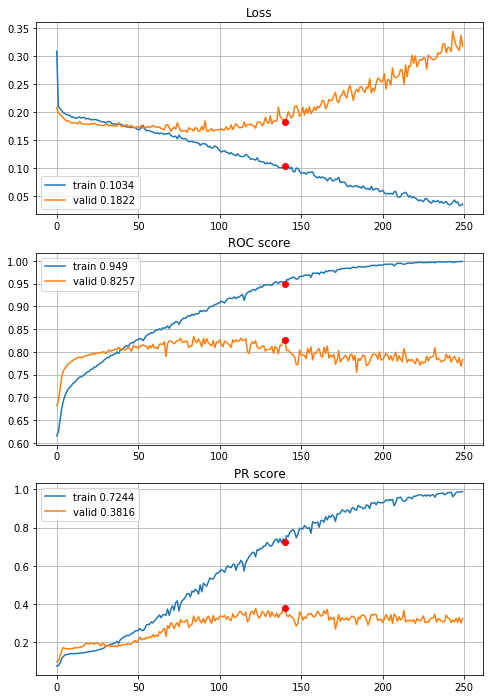


Fold 6------------------------------------------------------------


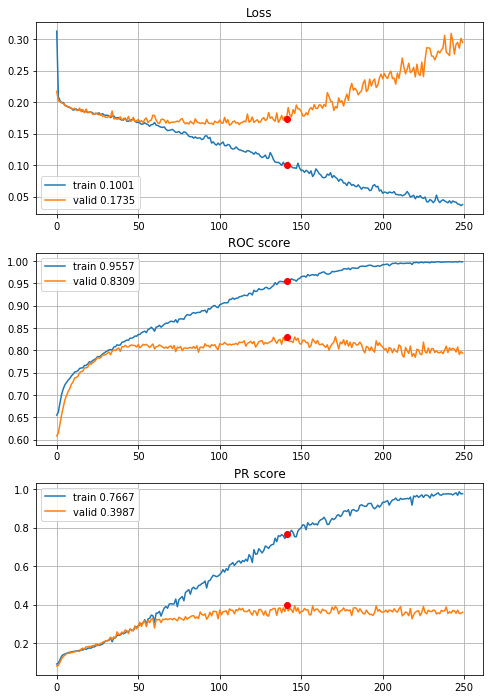

In [57]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_drop2_02, features=features,
                                        target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Lets add some regularization

In [49]:
def define_deep_CNN_2inc_2dense_std_drop2_02_l1_00005(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(dense)                          # (128,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/250,
cumulative time: 5.91s train loss: 0.6577305817545621, validation loss: 0.5112424177568409
Epoch: 2/250,
cumulative time: 7.58s train loss: 0.4755820765752453, validation loss: 0.4278801515485414
Epoch: 3/250,
cumulative time: 9.19s train loss: 0.4027163661558784, validation loss: 0.36870128918538053
Epoch: 4/250,
cumulative time: 10.8s train loss: 0.3514674855734791, validation loss: 0.32785085263586594
Epoch: 5/250,
cumulative time: 12.39s train loss: 0.31750709668307153, validation loss: 0.3065132891506951
Epoch: 6/250,
cumulative time: 13.98s train loss: 0.30269798759817995, validation loss: 0.2928361124210085
Epoch: 7/250,
cumulative time: 15.74s train loss: 0.29242627039180374, validation loss: 0.2831301232476556
Epoch: 8/250,
cumulative time: 17.38s train loss: 0.281503755938661, validation loss: 0.2756363879952648
Epoch: 9/250,
cumulative time: 18.96s train loss: 0.2736755919914292, val

Epoch: 76/250,
cumulative time: 126.3s train loss: 0.18960473624461519, validation loss: 0.19302764880851955
Epoch: 77/250,
cumulative time: 127.92s train loss: 0.18773267383343611, validation loss: 0.19494789961530207
Epoch: 78/250,
cumulative time: 129.51s train loss: 0.18897236032145365, validation loss: 0.1912157755469367
Epoch: 79/250,
cumulative time: 131.12s train loss: 0.18822059119415757, validation loss: 0.19292372168936317
Epoch: 80/250,
cumulative time: 132.69s train loss: 0.19034506935166123, validation loss: 0.19081860928814617
Epoch: 81/250,
cumulative time: 134.28s train loss: 0.1874270395416501, validation loss: 0.19056929142764023
Epoch: 82/250,
cumulative time: 135.86s train loss: 0.18700361132508125, validation loss: 0.1904703369142248
Epoch: 83/250,
cumulative time: 137.45s train loss: 0.18658383343641202, validation loss: 0.19230987714860942
Epoch: 84/250,
cumulative time: 139.15s train loss: 0.18576900180655995, validation loss: 0.1919882035807252
Epoch: 85/250,


Epoch: 151/250,
cumulative time: 249.64s train loss: 0.16534402125353842, validation loss: 0.17960514005468847
Epoch: 152/250,
cumulative time: 251.22s train loss: 0.16737594067985448, validation loss: 0.18503681141718298
Epoch: 153/250,
cumulative time: 252.78s train loss: 0.16683568986774253, validation loss: 0.17976040964714113
Epoch: 154/250,
cumulative time: 254.36s train loss: 0.16761322119824326, validation loss: 0.18021611616755928
Epoch: 155/250,
cumulative time: 255.94s train loss: 0.16376943859797674, validation loss: 0.17961890314857193
Epoch: 156/250,
cumulative time: 257.53s train loss: 0.16468674821943252, validation loss: 0.17893945144259904
Epoch: 157/250,
cumulative time: 259.09s train loss: 0.16424021614104384, validation loss: 0.1786921323968733
Epoch: 158/250,
cumulative time: 260.66s train loss: 0.16514165035494502, validation loss: 0.18547442842495532
Epoch: 159/250,
cumulative time: 262.21s train loss: 0.16409733996604942, validation loss: 0.1808091558571816
Epo

Epoch: 226/250,
cumulative time: 371.81s train loss: 0.14445517501429414, validation loss: 0.1776365684846212
Epoch: 227/250,
cumulative time: 373.45s train loss: 0.14014089577499664, validation loss: 0.17599293615965717
Epoch: 228/250,
cumulative time: 375.16s train loss: 0.14723817937976086, validation loss: 0.1823323468942071
Epoch: 229/250,
cumulative time: 376.88s train loss: 0.14540073281045215, validation loss: 0.17924413276700604
Epoch: 230/250,
cumulative time: 378.54s train loss: 0.14396984373761768, validation loss: 0.17799527010924154
Epoch: 231/250,
cumulative time: 380.23s train loss: 0.14437610202981457, validation loss: 0.18234644459980212
Epoch: 232/250,
cumulative time: 381.89s train loss: 0.14024258091341615, validation loss: 0.17895858952429441
Epoch: 233/250,
cumulative time: 383.53s train loss: 0.14312481350743217, validation loss: 0.17670860889616916
Epoch: 234/250,
cumulative time: 385.14s train loss: 0.15071309501860491, validation loss: 0.19411712145423954
Epo

Epoch: 49/250,
cumulative time: 84.48s train loss: 0.20091648561971057, validation loss: 0.2018253557267361
Epoch: 50/250,
cumulative time: 86.11s train loss: 0.19826872109449578, validation loss: 0.19774135580023913
Epoch: 51/250,
cumulative time: 87.73s train loss: 0.1973428513769004, validation loss: 0.19735664254025265
Epoch: 52/250,
cumulative time: 89.37s train loss: 0.19929730879193866, validation loss: 0.19799593006817964
Epoch: 53/250,
cumulative time: 91.0s train loss: 0.19729778584360216, validation loss: 0.19666342143098703
Epoch: 54/250,
cumulative time: 92.66s train loss: 0.1958297400729104, validation loss: 0.19634916532437277
Epoch: 55/250,
cumulative time: 94.28s train loss: 0.1961355375509796, validation loss: 0.20155111589222396
Epoch: 56/250,
cumulative time: 95.89s train loss: 0.19645132470014032, validation loss: 0.19555101126249833
Epoch: 57/250,
cumulative time: 97.52s train loss: 0.19619189032730022, validation loss: 0.20034739369028193
Epoch: 58/250,
cumulativ

Epoch: 124/250,
cumulative time: 207.54s train loss: 0.182148268930061, validation loss: 0.18975292423130136
Epoch: 125/250,
cumulative time: 209.14s train loss: 0.1829357723944294, validation loss: 0.1883274939613654
Epoch: 126/250,
cumulative time: 210.78s train loss: 0.18137747973272655, validation loss: 0.18810638695082915
Epoch: 127/250,
cumulative time: 212.39s train loss: 0.18179424909866426, validation loss: 0.19014710413103122
Epoch: 128/250,
cumulative time: 214.03s train loss: 0.18203069694187016, validation loss: 0.1905526354594487
Epoch: 129/250,
cumulative time: 215.74s train loss: 0.1813877313034453, validation loss: 0.18858876394284185
Epoch: 130/250,
cumulative time: 217.36s train loss: 0.17903127263047852, validation loss: 0.1876346191899804
Epoch: 131/250,
cumulative time: 218.98s train loss: 0.17977339520808966, validation loss: 0.1891424559650168
Epoch: 132/250,
cumulative time: 220.61s train loss: 0.17976871073290646, validation loss: 0.18711239463663004
Epoch: 13

Epoch: 199/250,
cumulative time: 330.78s train loss: 0.16556976429776146, validation loss: 0.1947808780075337
Epoch: 200/250,
cumulative time: 332.43s train loss: 0.1632215125849246, validation loss: 0.1952423403018019
Epoch: 201/250,
cumulative time: 334.06s train loss: 0.16554739557680473, validation loss: 0.19737746930187294
Epoch: 202/250,
cumulative time: 335.69s train loss: 0.16641791398244707, validation loss: 0.19470404884781134
Epoch: 203/250,
cumulative time: 337.32s train loss: 0.1647228372429009, validation loss: 0.1980176040860891
Epoch: 204/250,
cumulative time: 338.95s train loss: 0.16473676122437864, validation loss: 0.19511213740416333
Epoch: 205/250,
cumulative time: 340.57s train loss: 0.16357800066998718, validation loss: 0.1970226906691383
Epoch: 206/250,
cumulative time: 342.2s train loss: 0.16538191199440666, validation loss: 0.19712963054137947
Epoch: 207/250,
cumulative time: 343.81s train loss: 0.16262305438027433, validation loss: 0.1960477715876737
Epoch: 20

Epoch: 22/250,
cumulative time: 41.37s train loss: 0.2261597911449182, validation loss: 0.22822138759414706
Epoch: 23/250,
cumulative time: 43.04s train loss: 0.22513694163646747, validation loss: 0.22760734434757532
Epoch: 24/250,
cumulative time: 44.67s train loss: 0.22221078550265236, validation loss: 0.22419553483887705
Epoch: 25/250,
cumulative time: 46.32s train loss: 0.2207662193554876, validation loss: 0.223888984620774
Epoch: 26/250,
cumulative time: 47.98s train loss: 0.2182127412205153, validation loss: 0.22223651949810772
Epoch: 27/250,
cumulative time: 49.63s train loss: 0.21856019765353732, validation loss: 0.22102581633038063
Epoch: 28/250,
cumulative time: 51.28s train loss: 0.21506010561909547, validation loss: 0.21863910973761827
Epoch: 29/250,
cumulative time: 52.92s train loss: 0.21506872448482225, validation loss: 0.21700788617458694
Epoch: 30/250,
cumulative time: 54.57s train loss: 0.21267388864132067, validation loss: 0.2182636971048468
Epoch: 31/250,
cumulative

Epoch: 98/250,
cumulative time: 167.56s train loss: 0.18841370784561007, validation loss: 0.19719864126774142
Epoch: 99/250,
cumulative time: 169.22s train loss: 0.18767841240048944, validation loss: 0.19714791576743856
Epoch: 100/250,
cumulative time: 170.87s train loss: 0.1885743908372056, validation loss: 0.20056952663917293
Epoch: 101/250,
cumulative time: 172.51s train loss: 0.1903883593780183, validation loss: 0.1977820866383039
Epoch: 102/250,
cumulative time: 174.15s train loss: 0.1881397691678728, validation loss: 0.19675002734502048
Epoch: 103/250,
cumulative time: 175.8s train loss: 0.187879066936135, validation loss: 0.19923390536343993
Epoch: 104/250,
cumulative time: 177.45s train loss: 0.18774852292196442, validation loss: 0.2045908410018443
Epoch: 105/250,
cumulative time: 179.09s train loss: 0.18871587097652923, validation loss: 0.19826517841944166
Epoch: 106/250,
cumulative time: 180.74s train loss: 0.18794201367414082, validation loss: 0.1968123468616692
Epoch: 107/2

Epoch: 173/250,
cumulative time: 292.09s train loss: 0.16660520235710957, validation loss: 0.20064544243582094
Epoch: 174/250,
cumulative time: 293.73s train loss: 0.16657026069870148, validation loss: 0.19367752711613864
Epoch: 175/250,
cumulative time: 295.38s train loss: 0.16720056157783902, validation loss: 0.1990447295024494
Epoch: 176/250,
cumulative time: 297.02s train loss: 0.1660745124064105, validation loss: 0.19759079611082317
Epoch: 177/250,
cumulative time: 298.68s train loss: 0.16463867146037311, validation loss: 0.19436277188436768
Epoch: 178/250,
cumulative time: 300.32s train loss: 0.16423227082079053, validation loss: 0.1978902092711953
Epoch: 179/250,
cumulative time: 301.97s train loss: 0.16623594225605615, validation loss: 0.19511741659444884
Epoch: 180/250,
cumulative time: 303.62s train loss: 0.16587175247650712, validation loss: 0.19383288402594703
Epoch: 181/250,
cumulative time: 305.27s train loss: 0.1648718091698185, validation loss: 0.1970668762841137
Epoch:

Epoch: 248/250,
cumulative time: 416.34s train loss: 0.14678575490778545, validation loss: 0.19748555818652522
Epoch: 249/250,
cumulative time: 417.98s train loss: 0.14473335567497028, validation loss: 0.19887888925549446
Epoch: 250/250,
cumulative time: 419.64s train loss: 0.1449919371993409, validation loss: 0.20197158849020244

Early stopping results:
best results in epoch: 244, 
best valid PR: 0.25333479526961966, 
valid ROC: 0.789567472757128        
overfitting PR: 0.2663632831802446, 
overfitting ROC: 0.1307556297057434

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/250,
cumulative time: 6.03s train loss: 0.6515586708549191, validation loss: 0.5115199517522075
Epoch: 2/250,
cumulative time: 7.72s train loss: 0.47033691888412044, validation loss: 0.42597595717405445
Epoch: 3/250,
cumulative time: 9.4s train loss: 0.40155357177618267, validation loss: 0.36651064602593486
Epoch: 4/250,
cumulative time: 11.09s train loss: 0.34986709764278767,

Epoch: 71/250,
cumulative time: 127.29s train loss: 0.19499515447307475, validation loss: 0.1883359381014835
Epoch: 72/250,
cumulative time: 128.98s train loss: 0.19259719061344988, validation loss: 0.18850472311814517
Epoch: 73/250,
cumulative time: 130.68s train loss: 0.19455607809521075, validation loss: 0.18878882016715262
Epoch: 74/250,
cumulative time: 132.37s train loss: 0.19424607408812986, validation loss: 0.18724286385828984
Epoch: 75/250,
cumulative time: 134.07s train loss: 0.1954920421228022, validation loss: 0.18966376874786076
Epoch: 76/250,
cumulative time: 135.76s train loss: 0.19236076666729887, validation loss: 0.18773002953980553
Epoch: 77/250,
cumulative time: 137.47s train loss: 0.194230972626757, validation loss: 0.18804929431317371
Epoch: 78/250,
cumulative time: 139.15s train loss: 0.1923549502446738, validation loss: 0.18674306421356188
Epoch: 79/250,
cumulative time: 140.85s train loss: 0.19311087027478246, validation loss: 0.18710683688896704
Epoch: 80/250,


Epoch: 146/250,
cumulative time: 254.98s train loss: 0.1777929776933754, validation loss: 0.1828090324439996
Epoch: 147/250,
cumulative time: 256.66s train loss: 0.1763302510649668, validation loss: 0.18112795912059007
Epoch: 148/250,
cumulative time: 258.35s train loss: 0.1761006220544081, validation loss: 0.18255158577182815
Epoch: 149/250,
cumulative time: 260.03s train loss: 0.17741666825537167, validation loss: 0.18106633261444618
Epoch: 150/250,
cumulative time: 261.72s train loss: 0.17604372900699247, validation loss: 0.18513911239260147
Epoch: 151/250,
cumulative time: 263.38s train loss: 0.18030888768554496, validation loss: 0.18857962064510952
Epoch: 152/250,
cumulative time: 265.07s train loss: 0.17795254830303983, validation loss: 0.1810731239936399
Epoch: 153/250,
cumulative time: 266.75s train loss: 0.17779696474936715, validation loss: 0.18098291186672882
Epoch: 154/250,
cumulative time: 268.44s train loss: 0.1762125727819614, validation loss: 0.18856510335365229
Epoch: 

Epoch: 221/250,
cumulative time: 382.89s train loss: 0.1574997344000632, validation loss: 0.17531635967787632
Epoch: 222/250,
cumulative time: 384.58s train loss: 0.15733065264687363, validation loss: 0.17657373541264895
Epoch: 223/250,
cumulative time: 386.29s train loss: 0.1574376061037193, validation loss: 0.18013354773785972
Epoch: 224/250,
cumulative time: 387.97s train loss: 0.15796534737578924, validation loss: 0.17669854578394076
Epoch: 225/250,
cumulative time: 389.67s train loss: 0.15727134913015345, validation loss: 0.17857358254203187
Epoch: 226/250,
cumulative time: 391.37s train loss: 0.15940669199458654, validation loss: 0.17719050276190185
Epoch: 227/250,
cumulative time: 393.05s train loss: 0.15526880274371913, validation loss: 0.17529395010659612
Epoch: 228/250,
cumulative time: 394.75s train loss: 0.15747965495040595, validation loss: 0.17732013859377174
Epoch: 229/250,
cumulative time: 396.43s train loss: 0.15488345314684282, validation loss: 0.17635049230188962
Epo

Epoch: 44/250,
cumulative time: 81.14s train loss: 0.19974003148656785, validation loss: 0.1939653607658859
Epoch: 45/250,
cumulative time: 82.86s train loss: 0.20154251809148746, validation loss: 0.1917295361734541
Epoch: 46/250,
cumulative time: 84.57s train loss: 0.20090121026749444, validation loss: 0.1919599953399367
Epoch: 47/250,
cumulative time: 86.29s train loss: 0.2001791660245792, validation loss: 0.1906550779370261
Epoch: 48/250,
cumulative time: 87.99s train loss: 0.20004820914975568, validation loss: 0.19196323879895483
Epoch: 49/250,
cumulative time: 89.73s train loss: 0.2003203920070447, validation loss: 0.19199379620824913
Epoch: 50/250,
cumulative time: 91.46s train loss: 0.19750421445548924, validation loss: 0.18963640213662336
Epoch: 51/250,
cumulative time: 93.19s train loss: 0.19737466171887055, validation loss: 0.19209583243735803
Epoch: 52/250,
cumulative time: 94.92s train loss: 0.19812562779273862, validation loss: 0.189052781085065
Epoch: 53/250,
cumulative t

Epoch: 119/250,
cumulative time: 211.32s train loss: 0.186396691591067, validation loss: 0.1822086283556447
Epoch: 120/250,
cumulative time: 213.07s train loss: 0.18709206862947325, validation loss: 0.18146936733488817
Epoch: 121/250,
cumulative time: 214.79s train loss: 0.18784322898453487, validation loss: 0.1805706373961485
Epoch: 122/250,
cumulative time: 216.54s train loss: 0.18624974468678301, validation loss: 0.18257193338400013
Epoch: 123/250,
cumulative time: 218.27s train loss: 0.18559532274526577, validation loss: 0.18106195511301468
Epoch: 124/250,
cumulative time: 220.02s train loss: 0.18584552114273467, validation loss: 0.18212249810104475
Epoch: 125/250,
cumulative time: 221.76s train loss: 0.1835236371513091, validation loss: 0.18165298524929327
Epoch: 126/250,
cumulative time: 223.55s train loss: 0.1852364272187608, validation loss: 0.1809161379527331
Epoch: 127/250,
cumulative time: 225.29s train loss: 0.18413812121323642, validation loss: 0.18180079181610076
Epoch: 1

Epoch: 194/250,
cumulative time: 341.27s train loss: 0.17596643817182914, validation loss: 0.18132809141513762
Epoch: 195/250,
cumulative time: 342.99s train loss: 0.175387890851186, validation loss: 0.18208670114707556
Epoch: 196/250,
cumulative time: 344.74s train loss: 0.1771933886593853, validation loss: 0.18136437068761857
Epoch: 197/250,
cumulative time: 346.44s train loss: 0.17522766245305862, validation loss: 0.18196641858819396
Epoch: 198/250,
cumulative time: 348.17s train loss: 0.1747383828394618, validation loss: 0.1810194263057098
Epoch: 199/250,
cumulative time: 349.9s train loss: 0.17399735497980337, validation loss: 0.18090355114082549
Epoch: 200/250,
cumulative time: 351.63s train loss: 0.17380472732817426, validation loss: 0.18028900301342765
Epoch: 201/250,
cumulative time: 353.35s train loss: 0.17288324037213731, validation loss: 0.18284024389546963
Epoch: 202/250,
cumulative time: 355.09s train loss: 0.17191156148423556, validation loss: 0.18108469083377385
Epoch: 

Epoch: 17/250,
cumulative time: 34.64s train loss: 0.2356747924502379, validation loss: 0.24092529482672584
Epoch: 18/250,
cumulative time: 36.4s train loss: 0.23309193024805427, validation loss: 0.23169301373107556
Epoch: 19/250,
cumulative time: 38.14s train loss: 0.23091066552403186, validation loss: 0.23669333780331572
Epoch: 20/250,
cumulative time: 39.9s train loss: 0.22750685683782323, validation loss: 0.22674932948006596
Epoch: 21/250,
cumulative time: 41.64s train loss: 0.22717693601461017, validation loss: 0.22863564067786657
Epoch: 22/250,
cumulative time: 43.39s train loss: 0.22604613175741467, validation loss: 0.22280219765709922
Epoch: 23/250,
cumulative time: 45.14s train loss: 0.22115974043027248, validation loss: 0.22092812394657316
Epoch: 24/250,
cumulative time: 46.9s train loss: 0.2176471272877099, validation loss: 0.21867340230649435
Epoch: 25/250,
cumulative time: 48.66s train loss: 0.21793120737493948, validation loss: 0.22067905733062396
Epoch: 26/250,
cumulativ

Epoch: 93/250,
cumulative time: 169.05s train loss: 0.187940311916416, validation loss: 0.18219027353567388
Epoch: 94/250,
cumulative time: 170.83s train loss: 0.18372207929528356, validation loss: 0.18224404437584188
Epoch: 95/250,
cumulative time: 172.59s train loss: 0.18443490704420085, validation loss: 0.18328920481802657
Epoch: 96/250,
cumulative time: 174.36s train loss: 0.18160764546760547, validation loss: 0.18164596353386014
Epoch: 97/250,
cumulative time: 176.12s train loss: 0.18277585956071196, validation loss: 0.18185858864956395
Epoch: 98/250,
cumulative time: 177.88s train loss: 0.18196927614850936, validation loss: 0.18117772371632526
Epoch: 99/250,
cumulative time: 179.64s train loss: 0.18252222633602053, validation loss: 0.18338437372316133
Epoch: 100/250,
cumulative time: 181.38s train loss: 0.1807568762005025, validation loss: 0.1808431846082048
Epoch: 101/250,
cumulative time: 183.14s train loss: 0.1797230218401207, validation loss: 0.18096794703675875
Epoch: 102/25

Epoch: 168/250,
cumulative time: 301.44s train loss: 0.16885636707520302, validation loss: 0.17688496242345841
Epoch: 169/250,
cumulative time: 303.19s train loss: 0.16856444470202936, validation loss: 0.17774671754655136
Epoch: 170/250,
cumulative time: 304.95s train loss: 0.17121687784693598, validation loss: 0.17590355625431933
Epoch: 171/250,
cumulative time: 306.71s train loss: 0.171560478015257, validation loss: 0.17811914620672326
Epoch: 172/250,
cumulative time: 308.49s train loss: 0.1696834788659754, validation loss: 0.17757742474368224
Epoch: 173/250,
cumulative time: 310.24s train loss: 0.17154129071481736, validation loss: 0.1799116725411662
Epoch: 174/250,
cumulative time: 312.02s train loss: 0.1683039990921296, validation loss: 0.1751392119911776
Epoch: 175/250,
cumulative time: 313.78s train loss: 0.16961846515649934, validation loss: 0.17657021173258244
Epoch: 176/250,
cumulative time: 315.55s train loss: 0.16943220441150508, validation loss: 0.17552166292063223
Epoch: 

Epoch: 243/250,
cumulative time: 436.86s train loss: 0.15021974438789235, validation loss: 0.17786489550927678
Epoch: 244/250,
cumulative time: 438.78s train loss: 0.15586152799784617, validation loss: 0.18018745974071668
Epoch: 245/250,
cumulative time: 440.76s train loss: 0.15362817491759792, validation loss: 0.18123887643745876
Epoch: 246/250,
cumulative time: 442.76s train loss: 0.15432777583055313, validation loss: 0.18308070949621358
Epoch: 247/250,
cumulative time: 444.56s train loss: 0.15381981510149562, validation loss: 0.17851265982727263
Epoch: 248/250,
cumulative time: 446.29s train loss: 0.1520261770227928, validation loss: 0.17786016745609548
Epoch: 249/250,
cumulative time: 448.12s train loss: 0.15409228869172092, validation loss: 0.18007404608931138
Epoch: 250/250,
cumulative time: 449.94s train loss: 0.15442408931954948, validation loss: 0.17882978197501856

Early stopping results:
best results in epoch: 248, 
best valid PR: 0.36042631047498164, 
valid ROC: 0.828097136

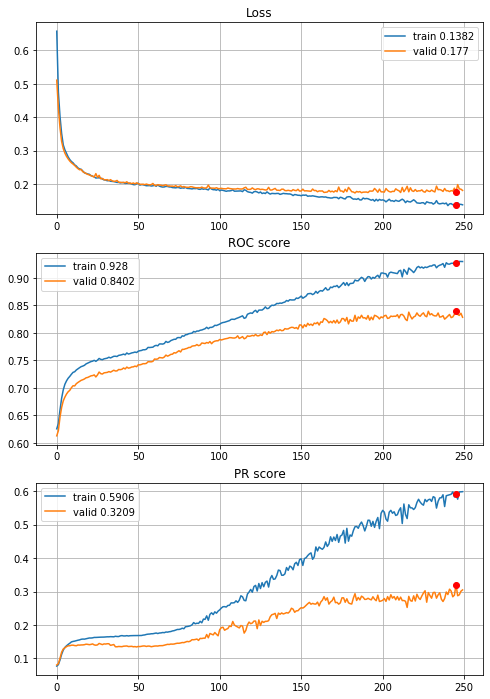


Fold 2------------------------------------------------------------


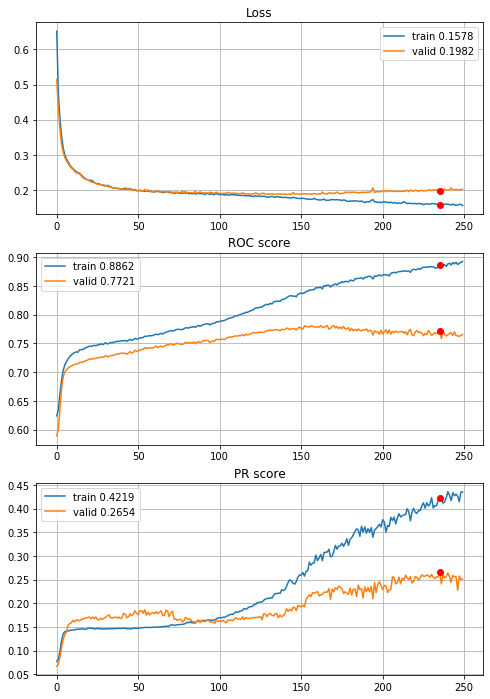


Fold 3------------------------------------------------------------


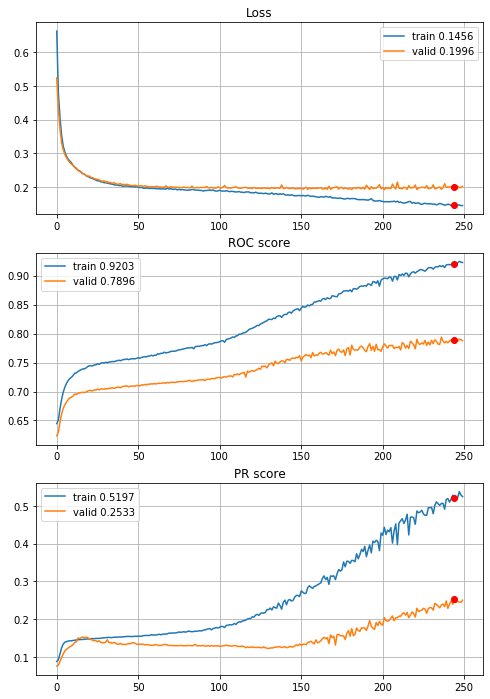


Fold 4------------------------------------------------------------


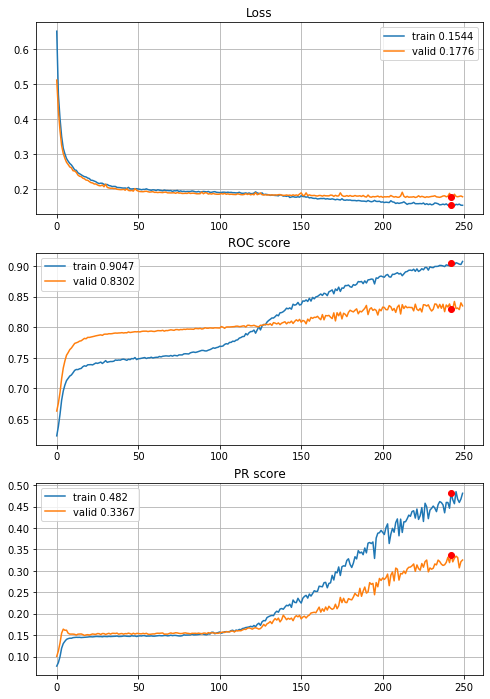


Fold 5------------------------------------------------------------


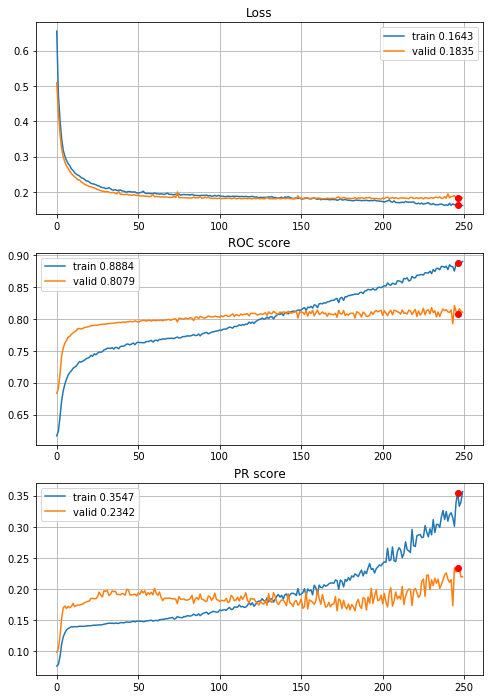


Fold 6------------------------------------------------------------


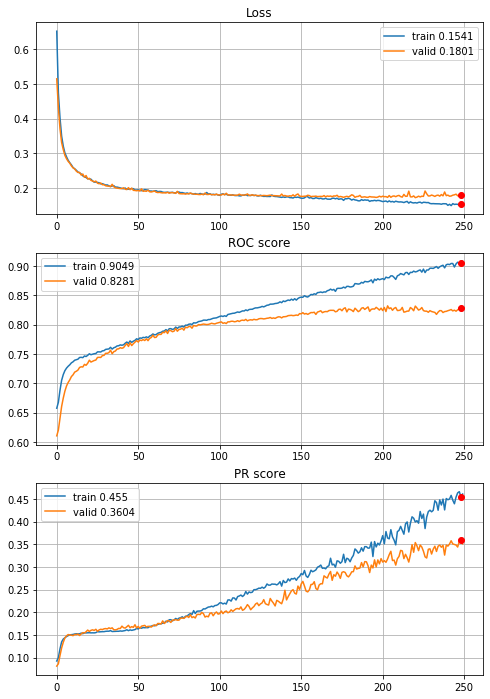

In [61]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_drop2_02_l1_00005, features=features,
                                        target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

More epochs needed, 600 for example


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.19s train loss: 0.6577305817545621, validation loss: 0.5112424177568409
Epoch: 2/600,
cumulative time: 5.55s train loss: 0.4755957069309956, validation loss: 0.42791723490897454
Epoch: 3/600,
cumulative time: 6.91s train loss: 0.4027583346726637, validation loss: 0.368743377814413
Epoch: 4/600,
cumulative time: 8.25s train loss: 0.3515183853588458, validation loss: 0.3278989755149761
Epoch: 5/600,
cumulative time: 9.69s train loss: 0.3175313458786208, validation loss: 0.306577927446268
Epoch: 6/600,
cumulative time: 11.05s train loss: 0.3027283268453444, validation loss: 0.292834676736224
Epoch: 7/600,
cumulative time: 12.39s train loss: 0.2924034152533562, validation loss: 0.28312273730300086
Epoch: 8/600,
cumulative time: 13.73s train loss: 0.2814912949232774, validation loss: 0.2756129609556568
Epoch: 9/600,
cumulative time: 15.08s train loss: 0.27366223913860566, validati

Epoch: 77/600,
cumulative time: 105.08s train loss: 0.18773515945386451, validation loss: 0.19494919286162127
Epoch: 78/600,
cumulative time: 106.37s train loss: 0.18900884976873084, validation loss: 0.19114827907880688
Epoch: 79/600,
cumulative time: 107.7s train loss: 0.18830103835061315, validation loss: 0.19296656329872008
Epoch: 80/600,
cumulative time: 109.0s train loss: 0.1903632857929243, validation loss: 0.19079579879549427
Epoch: 81/600,
cumulative time: 110.31s train loss: 0.18753994495208268, validation loss: 0.1905328779702612
Epoch: 82/600,
cumulative time: 111.61s train loss: 0.18702096687575281, validation loss: 0.19036360653060241
Epoch: 83/600,
cumulative time: 112.9s train loss: 0.18666140670211734, validation loss: 0.19257147491505716
Epoch: 84/600,
cumulative time: 114.21s train loss: 0.1859311793462694, validation loss: 0.19172032191649516
Epoch: 85/600,
cumulative time: 115.52s train loss: 0.18723189861219552, validation loss: 0.19045713848204252
Epoch: 86/600,
c

Epoch: 152/600,
cumulative time: 203.31s train loss: 0.16756407424846106, validation loss: 0.18472025851313967
Epoch: 153/600,
cumulative time: 204.64s train loss: 0.16625858835818152, validation loss: 0.18074684614953418
Epoch: 154/600,
cumulative time: 205.93s train loss: 0.16720653553311318, validation loss: 0.18017955370871205
Epoch: 155/600,
cumulative time: 207.26s train loss: 0.1635044918020285, validation loss: 0.18109997328931252
Epoch: 156/600,
cumulative time: 208.55s train loss: 0.1643577930604374, validation loss: 0.18035264176280422
Epoch: 157/600,
cumulative time: 209.86s train loss: 0.1641768473265818, validation loss: 0.18025400328790353
Epoch: 158/600,
cumulative time: 211.16s train loss: 0.16569518208519957, validation loss: 0.18772860309597258
Epoch: 159/600,
cumulative time: 212.46s train loss: 0.16426472568177533, validation loss: 0.1824035291326054
Epoch: 160/600,
cumulative time: 213.76s train loss: 0.16316735530790866, validation loss: 0.18189752988461494
Epoch

Epoch: 227/600,
cumulative time: 302.2s train loss: 0.13990637269386005, validation loss: 0.1773787975879329
Epoch: 228/600,
cumulative time: 303.5s train loss: 0.14605682404225065, validation loss: 0.1850043832342831
Epoch: 229/600,
cumulative time: 304.8s train loss: 0.1447829754743332, validation loss: 0.18073887515425113
Epoch: 230/600,
cumulative time: 306.09s train loss: 0.1452028069243872, validation loss: 0.17964787702117346
Epoch: 231/600,
cumulative time: 307.43s train loss: 0.14546013329328772, validation loss: 0.1912224585807916
Epoch: 232/600,
cumulative time: 308.72s train loss: 0.14124170851799994, validation loss: 0.17955731579728318
Epoch: 233/600,
cumulative time: 310.02s train loss: 0.14585799254283227, validation loss: 0.17822361536136364
Epoch: 234/600,
cumulative time: 311.33s train loss: 0.14948301732410255, validation loss: 0.18895245306422062
Epoch: 235/600,
cumulative time: 312.64s train loss: 0.14407926283438882, validation loss: 0.1828352410607471
Epoch: 236

Epoch: 302/600,
cumulative time: 400.6s train loss: 0.1308470666915864, validation loss: 0.1864578799782682
Epoch: 303/600,
cumulative time: 401.93s train loss: 0.12966220525066616, validation loss: 0.19651076706840198
Epoch: 304/600,
cumulative time: 403.28s train loss: 0.13111343197945627, validation loss: 0.1891183924155628
Epoch: 305/600,
cumulative time: 404.58s train loss: 0.12663525913479412, validation loss: 0.18642297952129697
Epoch: 306/600,
cumulative time: 405.89s train loss: 0.12671778940580594, validation loss: 0.20343689001726406
Epoch: 307/600,
cumulative time: 407.18s train loss: 0.13323849525460427, validation loss: 0.19124036850857848
Epoch: 308/600,
cumulative time: 408.5s train loss: 0.13137595548091427, validation loss: 0.19044286682136696
Epoch: 309/600,
cumulative time: 409.82s train loss: 0.1301184886221533, validation loss: 0.1881067261678009
Epoch: 310/600,
cumulative time: 411.12s train loss: 0.13164877995440766, validation loss: 0.19288589440696982
Epoch: 3

Epoch: 377/600,
cumulative time: 499.01s train loss: 0.11704204842726249, validation loss: 0.2044667364830383
Epoch: 378/600,
cumulative time: 500.32s train loss: 0.11954132756074995, validation loss: 0.20632252464333387
Epoch: 379/600,
cumulative time: 501.63s train loss: 0.11894603885419035, validation loss: 0.20021527463924
Epoch: 380/600,
cumulative time: 502.94s train loss: 0.11649876383674676, validation loss: 0.20530947196881247
Epoch: 381/600,
cumulative time: 504.23s train loss: 0.11853639486820484, validation loss: 0.2046639969492543
Epoch: 382/600,
cumulative time: 505.57s train loss: 0.11653708723383477, validation loss: 0.21763967567962234
Epoch: 383/600,
cumulative time: 506.91s train loss: 0.12056721001356155, validation loss: 0.22253564790327424
Epoch: 384/600,
cumulative time: 508.2s train loss: 0.11594516864008658, validation loss: 0.21327747680485207
Epoch: 385/600,
cumulative time: 509.51s train loss: 0.12368933619667785, validation loss: 0.20844809041492302
Epoch: 

Epoch: 452/600,
cumulative time: 597.16s train loss: 0.11000749560324904, validation loss: 0.24143870846400706
Epoch: 453/600,
cumulative time: 598.47s train loss: 0.10949058650434626, validation loss: 0.23414475768500237
Epoch: 454/600,
cumulative time: 599.77s train loss: 0.11048214554981495, validation loss: 0.2301314433692993
Epoch: 455/600,
cumulative time: 601.09s train loss: 0.1098284721800665, validation loss: 0.22977237371947182
Epoch: 456/600,
cumulative time: 602.38s train loss: 0.10779122510666453, validation loss: 0.24114500766225702
Epoch: 457/600,
cumulative time: 603.69s train loss: 0.11053818881300641, validation loss: 0.2359741256706077
Epoch: 458/600,
cumulative time: 604.99s train loss: 0.10430243001733572, validation loss: 0.23499484477885488
Epoch: 459/600,
cumulative time: 606.3s train loss: 0.10777643478896465, validation loss: 0.2290584184508327
Epoch: 460/600,
cumulative time: 607.62s train loss: 0.1112675665429157, validation loss: 0.2425633554883844
Epoch: 4

Epoch: 527/600,
cumulative time: 695.43s train loss: 0.10818037532658566, validation loss: 0.2649369542395038
Epoch: 528/600,
cumulative time: 696.74s train loss: 0.09784831031274198, validation loss: 0.274748666837071
Epoch: 529/600,
cumulative time: 698.04s train loss: 0.09864019371196779, validation loss: 0.2786987827719272
Epoch: 530/600,
cumulative time: 699.34s train loss: 0.1019934348150201, validation loss: 0.265828690839674
Epoch: 531/600,
cumulative time: 700.64s train loss: 0.0997161965400699, validation loss: 0.29183566773156877
Epoch: 532/600,
cumulative time: 701.94s train loss: 0.09826057634402503, validation loss: 0.28392131199554327
Epoch: 533/600,
cumulative time: 703.24s train loss: 0.10065709593959876, validation loss: 0.2804058628414179
Epoch: 534/600,
cumulative time: 704.54s train loss: 0.09909761699590536, validation loss: 0.27543450986308415
Epoch: 535/600,
cumulative time: 705.85s train loss: 0.09785442745756197, validation loss: 0.2863953135466397
Epoch: 536/

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.28s train loss: 0.6517832330708996, validation loss: 0.5143134990381172
Epoch: 2/600,
cumulative time: 5.59s train loss: 0.47326261749972803, validation loss: 0.4297840469462925
Epoch: 3/600,
cumulative time: 6.91s train loss: 0.4011765811239749, validation loss: 0.36994015087149756
Epoch: 4/600,
cumulative time: 8.22s train loss: 0.3512166241574771, validation loss: 0.32872525914499273
Epoch: 5/600,
cumulative time: 9.54s train loss: 0.3185160447900827, validation loss: 0.3064300532930152
Epoch: 6/600,
cumulative time: 10.88s train loss: 0.29957314979335226, validation loss: 0.2917240962152825
Epoch: 7/600,
cumulative time: 12.19s train loss: 0.2873795685855144, validation loss: 0.28327891565326774
Epoch: 8/600,
cumulative time: 13.52s train loss: 0.2794850840687703, validation loss: 0.27475796833664806
Epoch: 9/600,
cumulative time: 14.86s train loss: 0.2710277246151246, validation loss: 0.26802106019061

Epoch: 77/600,
cumulative time: 104.96s train loss: 0.1901350032320533, validation loss: 0.19239158371502724
Epoch: 78/600,
cumulative time: 106.28s train loss: 0.18996061307158568, validation loss: 0.196061234203547
Epoch: 79/600,
cumulative time: 107.6s train loss: 0.19183727293845404, validation loss: 0.19262005837090249
Epoch: 80/600,
cumulative time: 108.93s train loss: 0.190499717155838, validation loss: 0.1951756704575842
Epoch: 81/600,
cumulative time: 110.26s train loss: 0.19225737796067768, validation loss: 0.19247594543709245
Epoch: 82/600,
cumulative time: 111.57s train loss: 0.1887670451356396, validation loss: 0.19205584666654316
Epoch: 83/600,
cumulative time: 112.89s train loss: 0.19098628116420255, validation loss: 0.19235141003229247
Epoch: 84/600,
cumulative time: 114.21s train loss: 0.18897276146160588, validation loss: 0.19241347636106956
Epoch: 85/600,
cumulative time: 115.53s train loss: 0.19116106745447692, validation loss: 0.191305623848151
Epoch: 86/600,
cumul

Epoch: 152/600,
cumulative time: 204.54s train loss: 0.17612588080312094, validation loss: 0.18980591698030455
Epoch: 153/600,
cumulative time: 205.85s train loss: 0.17575299372534067, validation loss: 0.18888688694059322
Epoch: 154/600,
cumulative time: 207.18s train loss: 0.17444200712203753, validation loss: 0.1894417200021958
Epoch: 155/600,
cumulative time: 208.5s train loss: 0.174031284235567, validation loss: 0.1897790799179882
Epoch: 156/600,
cumulative time: 209.83s train loss: 0.17428568795771848, validation loss: 0.18863874881790155
Epoch: 157/600,
cumulative time: 211.15s train loss: 0.17327930338210962, validation loss: 0.1885698081543853
Epoch: 158/600,
cumulative time: 212.47s train loss: 0.17419290760143663, validation loss: 0.18984791945851198
Epoch: 159/600,
cumulative time: 213.78s train loss: 0.17646250940872507, validation loss: 0.18924414254395308
Epoch: 160/600,
cumulative time: 215.11s train loss: 0.17295316482871165, validation loss: 0.1891834745709794
Epoch: 1

Epoch: 227/600,
cumulative time: 304.05s train loss: 0.1611056798577195, validation loss: 0.19910715046669042
Epoch: 228/600,
cumulative time: 305.37s train loss: 0.16052874143602056, validation loss: 0.19919011116514732
Epoch: 229/600,
cumulative time: 306.73s train loss: 0.16083094912126963, validation loss: 0.19956898145565297
Epoch: 230/600,
cumulative time: 308.08s train loss: 0.15999081857268077, validation loss: 0.20123160907895976
Epoch: 231/600,
cumulative time: 309.4s train loss: 0.16236611207596827, validation loss: 0.19924752410169033
Epoch: 232/600,
cumulative time: 310.72s train loss: 0.1622782366937015, validation loss: 0.19990840847391592
Epoch: 233/600,
cumulative time: 312.04s train loss: 0.16177584184834665, validation loss: 0.20032184311855075
Epoch: 234/600,
cumulative time: 313.36s train loss: 0.1601399866092697, validation loss: 0.20001544753169428
Epoch: 235/600,
cumulative time: 314.67s train loss: 0.15955093626785746, validation loss: 0.2004819511555749
Epoch:

Epoch: 302/600,
cumulative time: 404.03s train loss: 0.15032857096087263, validation loss: 0.21144366319119484
Epoch: 303/600,
cumulative time: 405.36s train loss: 0.14728242761592328, validation loss: 0.20971129745386993
Epoch: 304/600,
cumulative time: 406.69s train loss: 0.15295808961893742, validation loss: 0.2098537326731432
Epoch: 305/600,
cumulative time: 408.01s train loss: 0.15251318282844356, validation loss: 0.21481683297454296
Epoch: 306/600,
cumulative time: 409.34s train loss: 0.14917879828141428, validation loss: 0.20741629943383477
Epoch: 307/600,
cumulative time: 410.8s train loss: 0.1457153447809457, validation loss: 0.22759202874339787
Epoch: 308/600,
cumulative time: 412.21s train loss: 0.15110712515168176, validation loss: 0.20955885040914224
Epoch: 309/600,
cumulative time: 413.55s train loss: 0.14696028231194538, validation loss: 0.21022234811435514
Epoch: 310/600,
cumulative time: 414.89s train loss: 0.1480740237979559, validation loss: 0.212577713304754
Epoch: 

Epoch: 377/600,
cumulative time: 503.57s train loss: 0.13811599598375893, validation loss: 0.2310172917690303
Epoch: 378/600,
cumulative time: 504.94s train loss: 0.1415324081204721, validation loss: 0.23917741010471458
Epoch: 379/600,
cumulative time: 506.32s train loss: 0.1372781330649833, validation loss: 0.2318412076258351
Epoch: 380/600,
cumulative time: 507.69s train loss: 0.13696355284900022, validation loss: 0.23468622116915946
Epoch: 381/600,
cumulative time: 509.01s train loss: 0.134658479410914, validation loss: 0.2310240890924585
Epoch: 382/600,
cumulative time: 510.34s train loss: 0.13540425848347215, validation loss: 0.24438773864503618
Epoch: 383/600,
cumulative time: 511.66s train loss: 0.14107382820872735, validation loss: 0.2320962870218382
Epoch: 384/600,
cumulative time: 512.97s train loss: 0.14096640829663015, validation loss: 0.23088254500117084
Epoch: 385/600,
cumulative time: 514.3s train loss: 0.1360600194119472, validation loss: 0.24123874115976368
Epoch: 386/

Epoch: 452/600,
cumulative time: 603.62s train loss: 0.12567132952998872, validation loss: 0.26499704855327466
Epoch: 453/600,
cumulative time: 604.94s train loss: 0.13028377375306607, validation loss: 0.2551277525941071
Epoch: 454/600,
cumulative time: 606.27s train loss: 0.1299294911859699, validation loss: 0.2759204444997241
Epoch: 455/600,
cumulative time: 607.58s train loss: 0.12492974038371173, validation loss: 0.25754007585524213
Epoch: 456/600,
cumulative time: 608.9s train loss: 0.12343359370371569, validation loss: 0.26914467352681454
Epoch: 457/600,
cumulative time: 610.21s train loss: 0.12706900737346655, validation loss: 0.2679376503677089
Epoch: 458/600,
cumulative time: 611.55s train loss: 0.12290902218136981, validation loss: 0.25877065537655897
Epoch: 459/600,
cumulative time: 612.85s train loss: 0.12544413812151076, validation loss: 0.26238894862248996
Epoch: 460/600,
cumulative time: 614.17s train loss: 0.12941896886010917, validation loss: 0.2760678520305697
Epoch: 

Epoch: 527/600,
cumulative time: 703.22s train loss: 0.11298455155692892, validation loss: 0.29647458998462306
Epoch: 528/600,
cumulative time: 704.55s train loss: 0.11609735749494506, validation loss: 0.30307871519180285
Epoch: 529/600,
cumulative time: 705.86s train loss: 0.11757573132377448, validation loss: 0.2911987075235991
Epoch: 530/600,
cumulative time: 707.19s train loss: 0.11525065694463427, validation loss: 0.2970080868048762
Epoch: 531/600,
cumulative time: 708.52s train loss: 0.1162021252012506, validation loss: 0.3051606838783494
Epoch: 532/600,
cumulative time: 709.85s train loss: 0.11610902748250124, validation loss: 0.3024708168027026
Epoch: 533/600,
cumulative time: 711.16s train loss: 0.11504452024175185, validation loss: 0.2904863411610105
Epoch: 534/600,
cumulative time: 712.49s train loss: 0.11356553910182182, validation loss: 0.31076975187085126
Epoch: 535/600,
cumulative time: 713.81s train loss: 0.11283531310256197, validation loss: 0.3029362988601825
Epoch: 5

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.4s train loss: 0.6620565290616965, validation loss: 0.5234836047810709
Epoch: 2/600,
cumulative time: 5.74s train loss: 0.47882886303391653, validation loss: 0.4301916870476844
Epoch: 3/600,
cumulative time: 7.08s train loss: 0.4048929982649343, validation loss: 0.37143011574764656
Epoch: 4/600,
cumulative time: 8.43s train loss: 0.3526576132040882, validation loss: 0.3302877134737959
Epoch: 5/600,
cumulative time: 9.77s train loss: 0.3204686130958504, validation loss: 0.309953736581309
Epoch: 6/600,
cumulative time: 11.1s train loss: 0.3036213011608841, validation loss: 0.29632257970926146
Epoch: 7/600,
cumulative time: 12.45s train loss: 0.29135021234945074, validation loss: 0.28643049036993956
Epoch: 8/600,
cumulative time: 13.78s train loss: 0.28229084201425975, validation loss: 0.2786793863797691
Epoch: 9/600,
cumulative time: 15.12s train loss: 0.277156443020701, validation loss: 0.2723995734429668
E

Epoch: 77/600,
cumulative time: 106.21s train loss: 0.19095656259311863, validation loss: 0.19836675481702132
Epoch: 78/600,
cumulative time: 107.53s train loss: 0.19298329395176717, validation loss: 0.19860506117587354
Epoch: 79/600,
cumulative time: 108.87s train loss: 0.19150541408435698, validation loss: 0.19968731290552388
Epoch: 80/600,
cumulative time: 110.19s train loss: 0.19062791246046704, validation loss: 0.1982042863914316
Epoch: 81/600,
cumulative time: 111.53s train loss: 0.19042674235844342, validation loss: 0.19894390218999614
Epoch: 82/600,
cumulative time: 112.87s train loss: 0.19073018877906922, validation loss: 0.1978881914064623
Epoch: 83/600,
cumulative time: 114.2s train loss: 0.19132089272322064, validation loss: 0.19820318174776047
Epoch: 84/600,
cumulative time: 115.56s train loss: 0.19295738713952026, validation loss: 0.20254330709323012
Epoch: 85/600,
cumulative time: 116.94s train loss: 0.19210687148405423, validation loss: 0.19781333130991646
Epoch: 86/600

Epoch: 152/600,
cumulative time: 206.86s train loss: 0.17487017721258358, validation loss: 0.19434890176383227
Epoch: 153/600,
cumulative time: 208.22s train loss: 0.17355791513542868, validation loss: 0.19575627432176254
Epoch: 154/600,
cumulative time: 209.6s train loss: 0.1730890968515424, validation loss: 0.19834745930440575
Epoch: 155/600,
cumulative time: 210.97s train loss: 0.17460847179765973, validation loss: 0.19396648574759962
Epoch: 156/600,
cumulative time: 212.3s train loss: 0.1726580480942849, validation loss: 0.1952534533524854
Epoch: 157/600,
cumulative time: 213.65s train loss: 0.17122353887535255, validation loss: 0.19496512967887747
Epoch: 158/600,
cumulative time: 214.97s train loss: 0.17173772367549725, validation loss: 0.1955804447481793
Epoch: 159/600,
cumulative time: 216.31s train loss: 0.1720253215605794, validation loss: 0.19857801444235101
Epoch: 160/600,
cumulative time: 217.64s train loss: 0.17078810113458207, validation loss: 0.19559601595443962
Epoch: 1

Epoch: 227/600,
cumulative time: 307.25s train loss: 0.14952102803118983, validation loss: 0.1964692110468369
Epoch: 228/600,
cumulative time: 308.6s train loss: 0.149413184283232, validation loss: 0.20702201147279098
Epoch: 229/600,
cumulative time: 309.93s train loss: 0.1507019533150595, validation loss: 0.19467056535027155
Epoch: 230/600,
cumulative time: 311.27s train loss: 0.1494707092581905, validation loss: 0.19687284092013735
Epoch: 231/600,
cumulative time: 312.6s train loss: 0.14932333937047468, validation loss: 0.19798212863094064
Epoch: 232/600,
cumulative time: 313.92s train loss: 0.14850554504154911, validation loss: 0.20447585902666868
Epoch: 233/600,
cumulative time: 315.25s train loss: 0.14995923814893045, validation loss: 0.19805147325895203
Epoch: 234/600,
cumulative time: 316.6s train loss: 0.147271587793304, validation loss: 0.19363671933776916
Epoch: 235/600,
cumulative time: 317.94s train loss: 0.14809219517959296, validation loss: 0.19955038553683266
Epoch: 236/

Epoch: 302/600,
cumulative time: 407.81s train loss: 0.13704579466393024, validation loss: 0.21634885516598404
Epoch: 303/600,
cumulative time: 409.15s train loss: 0.13426114376479625, validation loss: 0.21005443804640606
Epoch: 304/600,
cumulative time: 410.47s train loss: 0.13065597635961335, validation loss: 0.22598381617427926
Epoch: 305/600,
cumulative time: 411.82s train loss: 0.13293114281002644, validation loss: 0.21030012874720128
Epoch: 306/600,
cumulative time: 413.15s train loss: 0.13537088246468415, validation loss: 0.24261463534434366
Epoch: 307/600,
cumulative time: 414.49s train loss: 0.13383449635862996, validation loss: 0.20103616902948318
Epoch: 308/600,
cumulative time: 415.83s train loss: 0.13241896063828038, validation loss: 0.22224516836942826
Epoch: 309/600,
cumulative time: 417.15s train loss: 0.1334903549489705, validation loss: 0.21963508415984978
Epoch: 310/600,
cumulative time: 418.48s train loss: 0.13524995852897462, validation loss: 0.22510356934318906
Ep

Epoch: 377/600,
cumulative time: 508.43s train loss: 0.11809466869434479, validation loss: 0.24044774765867696
Epoch: 378/600,
cumulative time: 509.76s train loss: 0.11472353923735559, validation loss: 0.2266086366527173
Epoch: 379/600,
cumulative time: 511.09s train loss: 0.11887678054195487, validation loss: 0.2373815259209614
Epoch: 380/600,
cumulative time: 512.42s train loss: 0.11995451445863144, validation loss: 0.22766843046599947
Epoch: 381/600,
cumulative time: 513.74s train loss: 0.11811419711050636, validation loss: 0.23162022713822844
Epoch: 382/600,
cumulative time: 515.08s train loss: 0.11974931841615466, validation loss: 0.24415827919383531
Epoch: 383/600,
cumulative time: 516.4s train loss: 0.11837906028502614, validation loss: 0.23492249114080058
Epoch: 384/600,
cumulative time: 517.74s train loss: 0.11742396277480663, validation loss: 0.24907476868330825
Epoch: 385/600,
cumulative time: 519.06s train loss: 0.11736403346106351, validation loss: 0.23052958846903723
Epoc

Epoch: 452/600,
cumulative time: 608.8s train loss: 0.10616892114957412, validation loss: 0.26353109239963873
Epoch: 453/600,
cumulative time: 610.14s train loss: 0.10223829451591755, validation loss: 0.25779510974640585
Epoch: 454/600,
cumulative time: 611.47s train loss: 0.1078390796785132, validation loss: 0.28515061419622034
Epoch: 455/600,
cumulative time: 612.79s train loss: 0.1112170103588855, validation loss: 0.26659943570159095
Epoch: 456/600,
cumulative time: 614.11s train loss: 0.1022394399592293, validation loss: 0.27680343495006055
Epoch: 457/600,
cumulative time: 615.44s train loss: 0.10362622294340085, validation loss: 0.2734264532792641
Epoch: 458/600,
cumulative time: 616.77s train loss: 0.10185588305950749, validation loss: 0.2732337271582926
Epoch: 459/600,
cumulative time: 618.1s train loss: 0.10392418207483267, validation loss: 0.26854187718778344
Epoch: 460/600,
cumulative time: 619.44s train loss: 0.10420833240489812, validation loss: 0.2773778269979076
Epoch: 46

Epoch: 527/600,
cumulative time: 708.96s train loss: 0.09629671580010923, validation loss: 0.29271635918328354
Epoch: 528/600,
cumulative time: 710.3s train loss: 0.0967361440588599, validation loss: 0.35009880525226733
Epoch: 529/600,
cumulative time: 711.64s train loss: 0.09353530918843217, validation loss: 0.3098308937414882
Epoch: 530/600,
cumulative time: 712.96s train loss: 0.09612150991521445, validation loss: 0.3485049776595981
Epoch: 531/600,
cumulative time: 714.29s train loss: 0.09444825782972154, validation loss: 0.35701727315306747
Epoch: 532/600,
cumulative time: 715.62s train loss: 0.09229014489008817, validation loss: 0.3462627813311318
Epoch: 533/600,
cumulative time: 716.95s train loss: 0.09745069850810976, validation loss: 0.31205864296306796
Epoch: 534/600,
cumulative time: 718.28s train loss: 0.09205676360865242, validation loss: 0.390187439036418
Epoch: 535/600,
cumulative time: 719.62s train loss: 0.1029906576177445, validation loss: 0.3183982079332584
Epoch: 536

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 5.3s train loss: 0.6647798060380551, validation loss: 0.5201981634084184
Epoch: 2/600,
cumulative time: 6.79s train loss: 0.47387017701117945, validation loss: 0.42778918029419655
Epoch: 3/600,
cumulative time: 8.25s train loss: 0.4034044621719029, validation loss: 0.3681266481694597
Epoch: 4/600,
cumulative time: 9.7s train loss: 0.3514904700514895, validation loss: 0.3257429354080463
Epoch: 5/600,
cumulative time: 11.16s train loss: 0.3178484432787884, validation loss: 0.30314279596687094
Epoch: 6/600,
cumulative time: 12.61s train loss: 0.30176357074457927, validation loss: 0.28882177507820544
Epoch: 7/600,
cumulative time: 14.03s train loss: 0.2880835450224829, validation loss: 0.27743924063756564
Epoch: 8/600,
cumulative time: 15.48s train loss: 0.2804487582677134, validation loss: 0.2708465302574789
Epoch: 9/600,
cumulative time: 16.97s train loss: 0.2740996296295723, validation loss: 0.263993873898069

Epoch: 77/600,
cumulative time: 117.95s train loss: 0.19421050233362352, validation loss: 0.18793481520400557
Epoch: 78/600,
cumulative time: 119.38s train loss: 0.1920890303073195, validation loss: 0.18667726366799084
Epoch: 79/600,
cumulative time: 120.88s train loss: 0.19302526974765705, validation loss: 0.187043294817757
Epoch: 80/600,
cumulative time: 122.33s train loss: 0.19187791792042458, validation loss: 0.1872345617711747
Epoch: 81/600,
cumulative time: 123.93s train loss: 0.19253449623532473, validation loss: 0.18678315118756564
Epoch: 82/600,
cumulative time: 125.31s train loss: 0.19255943134291106, validation loss: 0.18860223717921604
Epoch: 83/600,
cumulative time: 126.68s train loss: 0.19244567352639677, validation loss: 0.18684046918880054
Epoch: 84/600,
cumulative time: 128.06s train loss: 0.1939954874476733, validation loss: 0.18762875534467263
Epoch: 85/600,
cumulative time: 129.43s train loss: 0.1930103516925279, validation loss: 0.18754327421978756
Epoch: 86/600,
c

Epoch: 152/600,
cumulative time: 222.87s train loss: 0.17826408509027564, validation loss: 0.18159306170057488
Epoch: 153/600,
cumulative time: 224.27s train loss: 0.17828513463129875, validation loss: 0.18114691722182047
Epoch: 154/600,
cumulative time: 225.72s train loss: 0.1767693513865596, validation loss: 0.18877971276813335
Epoch: 155/600,
cumulative time: 227.12s train loss: 0.17796638140224816, validation loss: 0.18090853693535572
Epoch: 156/600,
cumulative time: 228.58s train loss: 0.17432976043404536, validation loss: 0.18248497030822658
Epoch: 157/600,
cumulative time: 230.04s train loss: 0.17504310275307633, validation loss: 0.180978516805245
Epoch: 158/600,
cumulative time: 231.51s train loss: 0.17397991426712192, validation loss: 0.1810901449946338
Epoch: 159/600,
cumulative time: 232.98s train loss: 0.17301224538201324, validation loss: 0.18153110284477453
Epoch: 160/600,
cumulative time: 234.46s train loss: 0.17346066994237166, validation loss: 0.18030175066586657
Epoch

Epoch: 227/600,
cumulative time: 329.09s train loss: 0.15525023158866444, validation loss: 0.17575938724757376
Epoch: 228/600,
cumulative time: 330.51s train loss: 0.15761547956433555, validation loss: 0.17808366291493766
Epoch: 229/600,
cumulative time: 331.91s train loss: 0.1551939143291793, validation loss: 0.17581294946641318
Epoch: 230/600,
cumulative time: 333.31s train loss: 0.1566451957719975, validation loss: 0.1764191949627203
Epoch: 231/600,
cumulative time: 334.71s train loss: 0.15383980821462478, validation loss: 0.17863195564488799
Epoch: 232/600,
cumulative time: 336.11s train loss: 0.1559503524115604, validation loss: 0.18005490378103262
Epoch: 233/600,
cumulative time: 337.52s train loss: 0.16017157039662788, validation loss: 0.1811082238259163
Epoch: 234/600,
cumulative time: 338.96s train loss: 0.15796419968604067, validation loss: 0.17630533031089685
Epoch: 235/600,
cumulative time: 340.38s train loss: 0.15793567484144, validation loss: 0.17643174649786186
Epoch: 23

Epoch: 302/600,
cumulative time: 434.04s train loss: 0.13863202066231892, validation loss: 0.18634824675918032
Epoch: 303/600,
cumulative time: 435.49s train loss: 0.1401637443212581, validation loss: 0.18514899947028163
Epoch: 304/600,
cumulative time: 436.95s train loss: 0.14139199975878508, validation loss: 0.18458713703694354
Epoch: 305/600,
cumulative time: 438.37s train loss: 0.14006707905286278, validation loss: 0.18462223977033096
Epoch: 306/600,
cumulative time: 439.76s train loss: 0.14307333693166008, validation loss: 0.18476429900155739
Epoch: 307/600,
cumulative time: 441.13s train loss: 0.14117890933050894, validation loss: 0.1902960716886858
Epoch: 308/600,
cumulative time: 442.5s train loss: 0.13885654716868012, validation loss: 0.18739978933594031
Epoch: 309/600,
cumulative time: 443.86s train loss: 0.13908154078372797, validation loss: 0.19323976497166492
Epoch: 310/600,
cumulative time: 445.23s train loss: 0.13762790292611032, validation loss: 0.18916915859228256
Epoc

Epoch: 377/600,
cumulative time: 541.56s train loss: 0.125349375516091, validation loss: 0.21281458206165396
Epoch: 378/600,
cumulative time: 542.96s train loss: 0.12103487389882839, validation loss: 0.21617918124281688
Epoch: 379/600,
cumulative time: 544.34s train loss: 0.12407374591950288, validation loss: 0.22039117826905844
Epoch: 380/600,
cumulative time: 545.8s train loss: 0.12247697354767313, validation loss: 0.22215202753035854
Epoch: 381/600,
cumulative time: 547.18s train loss: 0.12514002075697606, validation loss: 0.2170864733162991
Epoch: 382/600,
cumulative time: 548.6s train loss: 0.12336922104552998, validation loss: 0.2283371991146333
Epoch: 383/600,
cumulative time: 550.0s train loss: 0.12250518011053269, validation loss: 0.2070180516996864
Epoch: 384/600,
cumulative time: 551.38s train loss: 0.12256239704766424, validation loss: 0.21409258408721732
Epoch: 385/600,
cumulative time: 552.78s train loss: 0.12205281549990867, validation loss: 0.2148800931206522
Epoch: 386

Epoch: 452/600,
cumulative time: 646.83s train loss: 0.10988232108442073, validation loss: 0.23839987563875925
Epoch: 453/600,
cumulative time: 648.2s train loss: 0.1069003959292533, validation loss: 0.2514370597082389
Epoch: 454/600,
cumulative time: 649.64s train loss: 0.1075782759766252, validation loss: 0.2536199673797258
Epoch: 455/600,
cumulative time: 651.05s train loss: 0.10364933770256991, validation loss: 0.26482872882004577
Epoch: 456/600,
cumulative time: 652.42s train loss: 0.11048637474511018, validation loss: 0.2466734139244925
Epoch: 457/600,
cumulative time: 653.79s train loss: 0.10914274128758905, validation loss: 0.25921716634881503
Epoch: 458/600,
cumulative time: 655.16s train loss: 0.1060568617234986, validation loss: 0.253198165799015
Epoch: 459/600,
cumulative time: 656.53s train loss: 0.1053742694329959, validation loss: 0.2670636105955337
Epoch: 460/600,
cumulative time: 657.9s train loss: 0.10619189353193263, validation loss: 0.24689062098973133
Epoch: 461/60

Epoch: 527/600,
cumulative time: 752.25s train loss: 0.09674322944026413, validation loss: 0.29048106805697194
Epoch: 528/600,
cumulative time: 753.63s train loss: 0.09794701461419088, validation loss: 0.34816056378363264
Epoch: 529/600,
cumulative time: 755.03s train loss: 0.09940878036933586, validation loss: 0.28563136595743216
Epoch: 530/600,
cumulative time: 756.43s train loss: 0.09503091904917514, validation loss: 0.3020444915479669
Epoch: 531/600,
cumulative time: 757.81s train loss: 0.09191547605613264, validation loss: 0.30162173210357307
Epoch: 532/600,
cumulative time: 759.19s train loss: 0.09043908197634165, validation loss: 0.30292271955066835
Epoch: 533/600,
cumulative time: 760.57s train loss: 0.09136270227406114, validation loss: 0.2895895109300795
Epoch: 534/600,
cumulative time: 761.96s train loss: 0.09086305956846684, validation loss: 0.3004943994314513
Epoch: 535/600,
cumulative time: 763.35s train loss: 0.09077271131282928, validation loss: 0.306294590173894
Epoch:

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 4.99s train loss: 0.6690490120668816, validation loss: 0.5169731126819059
Epoch: 2/600,
cumulative time: 6.39s train loss: 0.4793205013202426, validation loss: 0.42637414410101293
Epoch: 3/600,
cumulative time: 7.74s train loss: 0.40532510144907924, validation loss: 0.36606992228966645
Epoch: 4/600,
cumulative time: 9.09s train loss: 0.35323787905876414, validation loss: 0.3241498075648939
Epoch: 5/600,
cumulative time: 10.44s train loss: 0.32001042695541526, validation loss: 0.30224147897812587
Epoch: 6/600,
cumulative time: 11.79s train loss: 0.3035323906178568, validation loss: 0.2868543263189799
Epoch: 7/600,
cumulative time: 13.14s train loss: 0.2914934246587792, validation loss: 0.27560781198236534
Epoch: 8/600,
cumulative time: 14.49s train loss: 0.28187879300341495, validation loss: 0.2687295753640765
Epoch: 9/600,
cumulative time: 15.85s train loss: 0.2763627046000919, validation loss: 0.26073115538

Epoch: 77/600,
cumulative time: 109.0s train loss: 0.19152397456658043, validation loss: 0.18417531452890312
Epoch: 78/600,
cumulative time: 110.35s train loss: 0.1926662539190781, validation loss: 0.18444184435160998
Epoch: 79/600,
cumulative time: 111.71s train loss: 0.19320398368639363, validation loss: 0.18392472570046417
Epoch: 80/600,
cumulative time: 113.06s train loss: 0.1925615669514229, validation loss: 0.18371269184009906
Epoch: 81/600,
cumulative time: 114.51s train loss: 0.19269385577173404, validation loss: 0.18379461704385378
Epoch: 82/600,
cumulative time: 115.89s train loss: 0.19246025846901801, validation loss: 0.18350433960191562
Epoch: 83/600,
cumulative time: 117.26s train loss: 0.19134237053185246, validation loss: 0.18327703028511286
Epoch: 84/600,
cumulative time: 118.62s train loss: 0.19354618172321575, validation loss: 0.18338888623733937
Epoch: 85/600,
cumulative time: 119.96s train loss: 0.19180456494957143, validation loss: 0.18621270027651124
Epoch: 86/600

Epoch: 152/600,
cumulative time: 212.04s train loss: 0.18029208662706653, validation loss: 0.1812797851393593
Epoch: 153/600,
cumulative time: 213.41s train loss: 0.18103153416014445, validation loss: 0.18329058242428856
Epoch: 154/600,
cumulative time: 214.78s train loss: 0.18270140601837428, validation loss: 0.18356628482526915
Epoch: 155/600,
cumulative time: 216.14s train loss: 0.18220026606048634, validation loss: 0.18392889244273833
Epoch: 156/600,
cumulative time: 217.5s train loss: 0.18137109704104643, validation loss: 0.18080635693644959
Epoch: 157/600,
cumulative time: 218.86s train loss: 0.18012966210335038, validation loss: 0.18200982169169497
Epoch: 158/600,
cumulative time: 220.19s train loss: 0.1820706616283632, validation loss: 0.1821510660835118
Epoch: 159/600,
cumulative time: 221.55s train loss: 0.1830278112551031, validation loss: 0.18407387225520708
Epoch: 160/600,
cumulative time: 222.9s train loss: 0.18055676872190696, validation loss: 0.1811772035155699
Epoch: 1

Epoch: 227/600,
cumulative time: 314.69s train loss: 0.16718878079619673, validation loss: 0.1833017017560369
Epoch: 228/600,
cumulative time: 316.02s train loss: 0.167678497439506, validation loss: 0.18183951627980785
Epoch: 229/600,
cumulative time: 317.44s train loss: 0.1687740125228734, validation loss: 0.18103383120139224
Epoch: 230/600,
cumulative time: 318.84s train loss: 0.16469991295182498, validation loss: 0.18179848028869655
Epoch: 231/600,
cumulative time: 320.19s train loss: 0.16421099001854203, validation loss: 0.18382045510922856
Epoch: 232/600,
cumulative time: 321.58s train loss: 0.1661622464811036, validation loss: 0.18038802937038587
Epoch: 233/600,
cumulative time: 322.96s train loss: 0.1634549316757385, validation loss: 0.18332215100120783
Epoch: 234/600,
cumulative time: 324.38s train loss: 0.16264423966196756, validation loss: 0.18297461633461373
Epoch: 235/600,
cumulative time: 325.86s train loss: 0.16289973985363196, validation loss: 0.1817933746514593
Epoch: 2

Epoch: 302/600,
cumulative time: 418.02s train loss: 0.14064378991990892, validation loss: 0.19081168039130905
Epoch: 303/600,
cumulative time: 419.35s train loss: 0.14112472577600826, validation loss: 0.19358495689867627
Epoch: 304/600,
cumulative time: 420.67s train loss: 0.144405963197594, validation loss: 0.1890625573024763
Epoch: 305/600,
cumulative time: 421.99s train loss: 0.14190533502972918, validation loss: 0.18966405144423165
Epoch: 306/600,
cumulative time: 423.34s train loss: 0.14016310106313631, validation loss: 0.20698629764266493
Epoch: 307/600,
cumulative time: 424.68s train loss: 0.1410403119010571, validation loss: 0.18958747090533254
Epoch: 308/600,
cumulative time: 426.06s train loss: 0.13960815564585213, validation loss: 0.19229167943429556
Epoch: 309/600,
cumulative time: 427.44s train loss: 0.1382105913832946, validation loss: 0.18961884972591167
Epoch: 310/600,
cumulative time: 428.77s train loss: 0.1403670314971301, validation loss: 0.1916237539670123
Epoch: 3

Epoch: 377/600,
cumulative time: 520.82s train loss: 0.12135918706671735, validation loss: 0.2246526355274042
Epoch: 378/600,
cumulative time: 522.15s train loss: 0.12132601481142062, validation loss: 0.21340316349300442
Epoch: 379/600,
cumulative time: 523.49s train loss: 0.12080337981894321, validation loss: 0.21765087240398417
Epoch: 380/600,
cumulative time: 524.82s train loss: 0.12255178765679886, validation loss: 0.22522716662701858
Epoch: 381/600,
cumulative time: 526.15s train loss: 0.12200055688757587, validation loss: 0.21582720773827477
Epoch: 382/600,
cumulative time: 527.47s train loss: 0.12309466319032873, validation loss: 0.2197740043460186
Epoch: 383/600,
cumulative time: 528.82s train loss: 0.12060647158556839, validation loss: 0.22483116881642745
Epoch: 384/600,
cumulative time: 530.16s train loss: 0.12226623942373495, validation loss: 0.22602715162555267
Epoch: 385/600,
cumulative time: 531.5s train loss: 0.12217405350769267, validation loss: 0.22185751284175736
Epoc

Epoch: 452/600,
cumulative time: 622.32s train loss: 0.11000518965654578, validation loss: 0.2487249737783089
Epoch: 453/600,
cumulative time: 623.68s train loss: 0.11915105615776998, validation loss: 0.2556265116712378
Epoch: 454/600,
cumulative time: 625.05s train loss: 0.10389936562173052, validation loss: 0.25200887607050204
Epoch: 455/600,
cumulative time: 626.39s train loss: 0.10305480404974068, validation loss: 0.2726069633780448
Epoch: 456/600,
cumulative time: 627.74s train loss: 0.11007877210792244, validation loss: 0.25757226427098384
Epoch: 457/600,
cumulative time: 629.13s train loss: 0.10929073005801063, validation loss: 0.2578815836916178
Epoch: 458/600,
cumulative time: 630.5s train loss: 0.11457926555169434, validation loss: 0.31410028460646194
Epoch: 459/600,
cumulative time: 631.85s train loss: 0.11773029368671067, validation loss: 0.25506849247931784
Epoch: 460/600,
cumulative time: 633.23s train loss: 0.10596057386715817, validation loss: 0.2531360537016749
Epoch: 

Epoch: 527/600,
cumulative time: 724.42s train loss: 0.09604083988937287, validation loss: 0.3512681999956879
Epoch: 528/600,
cumulative time: 725.75s train loss: 0.10921170417430419, validation loss: 0.29178036720941114
Epoch: 529/600,
cumulative time: 727.09s train loss: 0.09887391039675553, validation loss: 0.29067297322467495
Epoch: 530/600,
cumulative time: 728.44s train loss: 0.09690509287311751, validation loss: 0.30321814485239396
Epoch: 531/600,
cumulative time: 729.79s train loss: 0.09922665337096567, validation loss: 0.30652104636872496
Epoch: 532/600,
cumulative time: 731.25s train loss: 0.09853899598016133, validation loss: 0.32984805092905783
Epoch: 533/600,
cumulative time: 732.64s train loss: 0.09639570888635055, validation loss: 0.30725327000143743
Epoch: 534/600,
cumulative time: 733.98s train loss: 0.09900552308702261, validation loss: 0.2775093909221059
Epoch: 535/600,
cumulative time: 735.31s train loss: 0.09943312901419167, validation loss: 0.2997788054822901
Epoc

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 5.46s train loss: 0.6513517712423484, validation loss: 0.5145061333189218
Epoch: 2/600,
cumulative time: 6.87s train loss: 0.474245514858652, validation loss: 0.43222706612676626
Epoch: 3/600,
cumulative time: 8.31s train loss: 0.4021049674137745, validation loss: 0.37072420363854974
Epoch: 4/600,
cumulative time: 9.67s train loss: 0.3497254831274091, validation loss: 0.33130519299156336
Epoch: 5/600,
cumulative time: 11.04s train loss: 0.32123136489138754, validation loss: 0.3112828215071551
Epoch: 6/600,
cumulative time: 12.42s train loss: 0.30179572801769167, validation loss: 0.2946037525052271
Epoch: 7/600,
cumulative time: 13.82s train loss: 0.2904888251329689, validation loss: 0.2849303113667127
Epoch: 8/600,
cumulative time: 15.2s train loss: 0.28056857657409834, validation loss: 0.2773318839657859
Epoch: 9/600,
cumulative time: 16.61s train loss: 0.2732962955008535, validation loss: 0.271995038667069

Epoch: 77/600,
cumulative time: 112.68s train loss: 0.1873884024686933, validation loss: 0.18422876795809665
Epoch: 78/600,
cumulative time: 114.05s train loss: 0.1876752325424961, validation loss: 0.18400932217082797
Epoch: 79/600,
cumulative time: 115.43s train loss: 0.18629560575765722, validation loss: 0.18424720609464176
Epoch: 80/600,
cumulative time: 116.77s train loss: 0.18502786368423818, validation loss: 0.18326055069710318
Epoch: 81/600,
cumulative time: 118.14s train loss: 0.18660876997756673, validation loss: 0.18427028289770236
Epoch: 82/600,
cumulative time: 119.51s train loss: 0.18455043447676697, validation loss: 0.18388129683460136
Epoch: 83/600,
cumulative time: 120.87s train loss: 0.18552207091746117, validation loss: 0.18638023425512806
Epoch: 84/600,
cumulative time: 122.29s train loss: 0.18471923906331747, validation loss: 0.18383668332642367
Epoch: 85/600,
cumulative time: 123.7s train loss: 0.1832900444950608, validation loss: 0.18370284564407385
Epoch: 86/600,

Epoch: 152/600,
cumulative time: 218.41s train loss: 0.17115223115971534, validation loss: 0.17676131782560972
Epoch: 153/600,
cumulative time: 219.82s train loss: 0.17244961046591434, validation loss: 0.17725474779222578
Epoch: 154/600,
cumulative time: 221.23s train loss: 0.17649086229584315, validation loss: 0.17706743581093626
Epoch: 155/600,
cumulative time: 222.62s train loss: 0.17578989512049684, validation loss: 0.18135049009355603
Epoch: 156/600,
cumulative time: 223.99s train loss: 0.17232467845682875, validation loss: 0.1792950505943974
Epoch: 157/600,
cumulative time: 225.35s train loss: 0.17338453757542152, validation loss: 0.17585634651317258
Epoch: 158/600,
cumulative time: 226.71s train loss: 0.17050752188190654, validation loss: 0.1765615877768974
Epoch: 159/600,
cumulative time: 228.06s train loss: 0.17065066109311997, validation loss: 0.17674294950526806
Epoch: 160/600,
cumulative time: 229.42s train loss: 0.17301445354328113, validation loss: 0.17726333325662794
Epo

Epoch: 227/600,
cumulative time: 321.12s train loss: 0.1589704661473859, validation loss: 0.1906765517080837
Epoch: 228/600,
cumulative time: 322.52s train loss: 0.15812310125995305, validation loss: 0.18309899437817306
Epoch: 229/600,
cumulative time: 323.94s train loss: 0.15913897625744863, validation loss: 0.1784109175611257
Epoch: 230/600,
cumulative time: 325.36s train loss: 0.15646559131901897, validation loss: 0.17856435317353267
Epoch: 231/600,
cumulative time: 326.78s train loss: 0.15588396358910403, validation loss: 0.1803348879114159
Epoch: 232/600,
cumulative time: 328.25s train loss: 0.15570221188800787, validation loss: 0.17942011409137165
Epoch: 233/600,
cumulative time: 329.77s train loss: 0.15535587981172833, validation loss: 0.17690639542948647
Epoch: 234/600,
cumulative time: 331.15s train loss: 0.15638379501442634, validation loss: 0.1796518700040004
Epoch: 235/600,
cumulative time: 332.6s train loss: 0.15577295109678327, validation loss: 0.1798918058623735
Epoch: 2

Epoch: 302/600,
cumulative time: 426.4s train loss: 0.14288569224921252, validation loss: 0.19138241792732102
Epoch: 303/600,
cumulative time: 427.83s train loss: 0.1443879226291621, validation loss: 0.18741413715424915
Epoch: 304/600,
cumulative time: 429.2s train loss: 0.14735274585795818, validation loss: 0.1888799998878783
Epoch: 305/600,
cumulative time: 430.57s train loss: 0.14155745244948173, validation loss: 0.1901692135985281
Epoch: 306/600,
cumulative time: 431.93s train loss: 0.14198778106268975, validation loss: 0.1906089385215203
Epoch: 307/600,
cumulative time: 433.29s train loss: 0.14276169560857782, validation loss: 0.19129497923302066
Epoch: 308/600,
cumulative time: 434.67s train loss: 0.14339477114363175, validation loss: 0.19525114345371886
Epoch: 309/600,
cumulative time: 436.03s train loss: 0.14214625192729022, validation loss: 0.19214782764378946
Epoch: 310/600,
cumulative time: 437.38s train loss: 0.14458721921594575, validation loss: 0.1897721614394266
Epoch: 3

Epoch: 377/600,
cumulative time: 531.64s train loss: 0.1274377831515566, validation loss: 0.20923026198424824
Epoch: 378/600,
cumulative time: 533.08s train loss: 0.128431243213271, validation loss: 0.21423202148087991
Epoch: 379/600,
cumulative time: 534.51s train loss: 0.12502089829218607, validation loss: 0.2116287118610634
Epoch: 380/600,
cumulative time: 535.9s train loss: 0.12649710872667094, validation loss: 0.230262909216517
Epoch: 381/600,
cumulative time: 537.26s train loss: 0.13112667287762778, validation loss: 0.2018031557509295
Epoch: 382/600,
cumulative time: 538.63s train loss: 0.12944162139072526, validation loss: 0.2149337467405062
Epoch: 383/600,
cumulative time: 540.01s train loss: 0.1274990021314042, validation loss: 0.20940194057671185
Epoch: 384/600,
cumulative time: 541.43s train loss: 0.12828764572439305, validation loss: 0.19865126315027232
Epoch: 385/600,
cumulative time: 542.82s train loss: 0.1294492149851356, validation loss: 0.22161555964225643
Epoch: 386/6

Epoch: 452/600,
cumulative time: 637.02s train loss: 0.12482417558679004, validation loss: 0.2269200280674147
Epoch: 453/600,
cumulative time: 638.5s train loss: 0.12048876717329544, validation loss: 0.23404534039282993
Epoch: 454/600,
cumulative time: 639.93s train loss: 0.11305300336460987, validation loss: 0.23292229186530333
Epoch: 455/600,
cumulative time: 641.34s train loss: 0.1119051946546225, validation loss: 0.2441175837242311
Epoch: 456/600,
cumulative time: 642.75s train loss: 0.11349342003959781, validation loss: 0.24339695000762185
Epoch: 457/600,
cumulative time: 644.17s train loss: 0.111676525803433, validation loss: 0.2269436871526352
Epoch: 458/600,
cumulative time: 645.58s train loss: 0.11381517375224881, validation loss: 0.23493143828834434
Epoch: 459/600,
cumulative time: 647.0s train loss: 0.11439694607252973, validation loss: 0.2280712920654697
Epoch: 460/600,
cumulative time: 648.46s train loss: 0.1114358811685917, validation loss: 0.23620129766435
Epoch: 461/600

Epoch: 527/600,
cumulative time: 742.91s train loss: 0.10124772484363553, validation loss: 0.2768295378873394
Epoch: 528/600,
cumulative time: 744.27s train loss: 0.10350152258284406, validation loss: 0.2548626014906964
Epoch: 529/600,
cumulative time: 745.64s train loss: 0.10480716217650113, validation loss: 0.2668318700969057
Epoch: 530/600,
cumulative time: 747.0s train loss: 0.1061293815520302, validation loss: 0.2988274378818777
Epoch: 531/600,
cumulative time: 748.37s train loss: 0.1059687712528055, validation loss: 0.2602970796441837
Epoch: 532/600,
cumulative time: 749.72s train loss: 0.10475284414475455, validation loss: 0.2794230108527462
Epoch: 533/600,
cumulative time: 751.08s train loss: 0.10241173356690308, validation loss: 0.2965455421878466
Epoch: 534/600,
cumulative time: 752.47s train loss: 0.10692972441514333, validation loss: 0.25693511412725134
Epoch: 535/600,
cumulative time: 753.82s train loss: 0.10023866130611281, validation loss: 0.2772469482808412
Epoch: 536/6

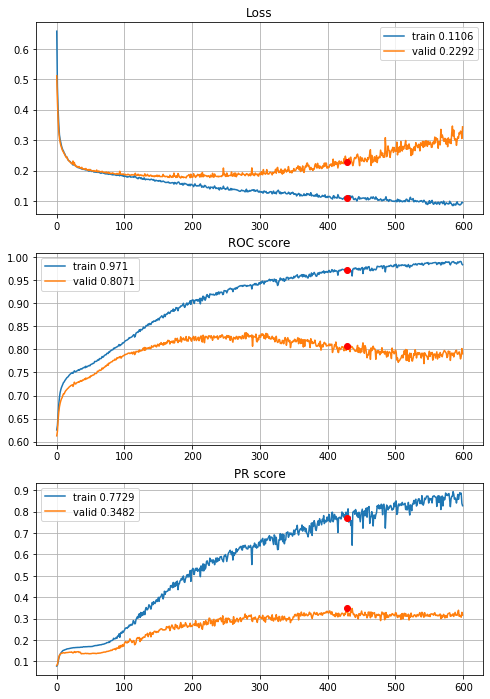


Fold 2------------------------------------------------------------


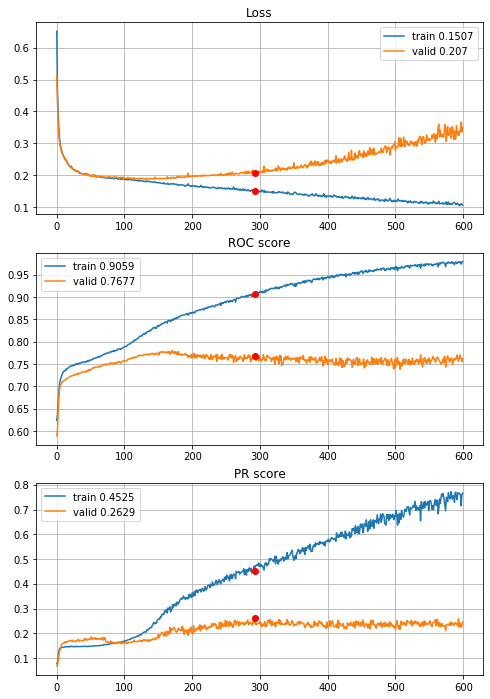


Fold 3------------------------------------------------------------


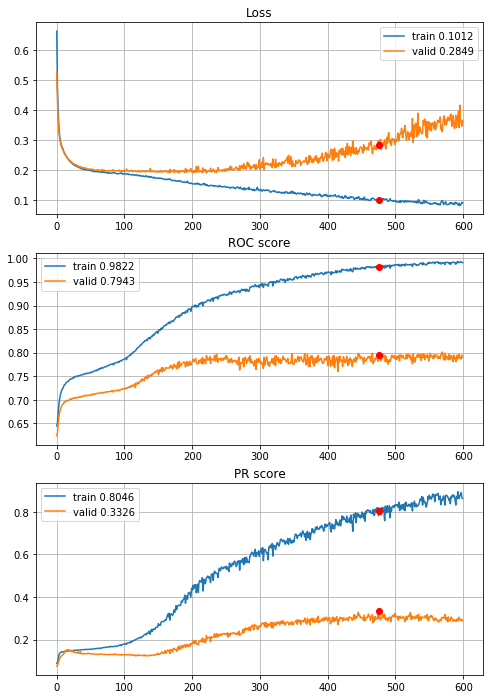


Fold 4------------------------------------------------------------


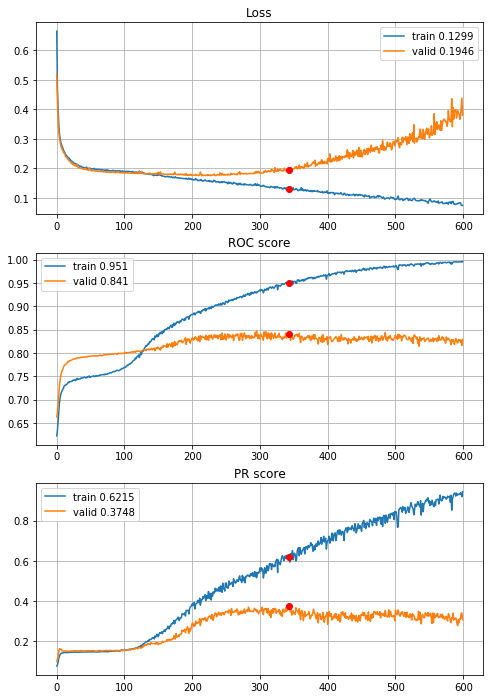


Fold 5------------------------------------------------------------


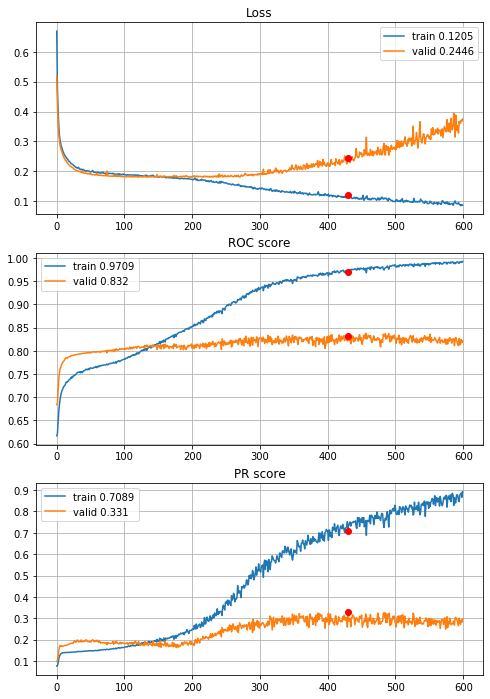


Fold 6------------------------------------------------------------


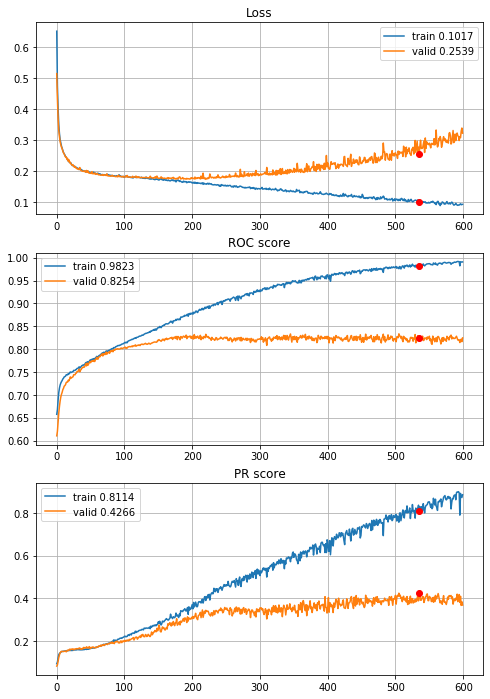

In [50]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_drop2_02_l1_00005, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Something strange takes place in the first epochs, lets try above model but without dropout (dropout seems to cause this waves).

In [50]:
def define_deep_CNN_2inc_2dense_std_l1_00005(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(flat)                           # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(dense)                          # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 3.59s train loss: 0.6628785334262669, validation loss: 0.5185931634140144
Epoch: 2/600,
cumulative time: 5.05s train loss: 0.4703894551388334, validation loss: 0.426306554620326
Epoch: 3/600,
cumulative time: 6.5s train loss: 0.3965114931774191, validation loss: 0.3661918110633237
Epoch: 4/600,
cumulative time: 7.93s train loss: 0.3451986814712481, validation loss: 0.3248395947187916
Epoch: 5/600,
cumulative time: 9.36s train loss: 0.3133915326550824, validation loss: 0.3036159411265462
Epoch: 6/600,
cumulative time: 10.71s train loss: 0.29617932735128427, validation loss: 0.29095418545321755
Epoch: 7/600,
cumulative time: 12.07s train loss: 0.2862557986281669, validation loss: 0.2815123963834803
Epoch: 8/600,
cumulative time: 13.41s train loss: 0.27671600359752135, validation loss: 0.2747651839881141
Epoch: 9/600,
cumulative time: 14.77s train loss: 0.27031037876217334, valida

Epoch: 77/600,
cumulative time: 107.33s train loss: 0.1874697509106443, validation loss: 0.1968948623815956
Epoch: 78/600,
cumulative time: 108.69s train loss: 0.18775194698883046, validation loss: 0.1933806157684229
Epoch: 79/600,
cumulative time: 110.03s train loss: 0.1873603630417799, validation loss: 0.19275003759896697
Epoch: 80/600,
cumulative time: 111.37s train loss: 0.18679945044048019, validation loss: 0.19242039375600561
Epoch: 81/600,
cumulative time: 112.7s train loss: 0.1862008503217001, validation loss: 0.1920001401411911
Epoch: 82/600,
cumulative time: 114.04s train loss: 0.1865963111772989, validation loss: 0.191755996219474
Epoch: 83/600,
cumulative time: 115.39s train loss: 0.1854579606823127, validation loss: 0.19352178172118978
Epoch: 84/600,
cumulative time: 116.73s train loss: 0.18604621619095713, validation loss: 0.1935191123845871
Epoch: 85/600,
cumulative time: 118.07s train loss: 0.18647523060183296, validation loss: 0.1908350140667838
Epoch: 86/600,
cumulati

Epoch: 152/600,
cumulative time: 209.41s train loss: 0.17307740954389758, validation loss: 0.18472746753059657
Epoch: 153/600,
cumulative time: 210.76s train loss: 0.1734514109436212, validation loss: 0.1831102782950424
Epoch: 154/600,
cumulative time: 212.1s train loss: 0.17305429128824196, validation loss: 0.1801047362361821
Epoch: 155/600,
cumulative time: 213.45s train loss: 0.1714931982665154, validation loss: 0.18020722648373586
Epoch: 156/600,
cumulative time: 214.86s train loss: 0.17418203989012632, validation loss: 0.18090983198726152
Epoch: 157/600,
cumulative time: 216.21s train loss: 0.1735557678401527, validation loss: 0.17976522943736584
Epoch: 158/600,
cumulative time: 217.56s train loss: 0.1721964622816662, validation loss: 0.1862252997938186
Epoch: 159/600,
cumulative time: 218.89s train loss: 0.1725411273170748, validation loss: 0.18124247251561582
Epoch: 160/600,
cumulative time: 220.27s train loss: 0.17079124445772684, validation loss: 0.1854248206537544
Epoch: 161/

Epoch: 227/600,
cumulative time: 311.41s train loss: 0.15363658710159528, validation loss: 0.1825643592419634
Epoch: 228/600,
cumulative time: 312.92s train loss: 0.15677589080881785, validation loss: 0.17638338817228988
Epoch: 229/600,
cumulative time: 314.5s train loss: 0.15472329600003765, validation loss: 0.1802000796677224
Epoch: 230/600,
cumulative time: 315.86s train loss: 0.15578217313543874, validation loss: 0.18304356742952047
Epoch: 231/600,
cumulative time: 317.21s train loss: 0.1533985170590915, validation loss: 0.1820961937480755
Epoch: 232/600,
cumulative time: 318.56s train loss: 0.15321886549199876, validation loss: 0.17914575180121228
Epoch: 233/600,
cumulative time: 319.89s train loss: 0.15515478530039534, validation loss: 0.17726573213133542
Epoch: 234/600,
cumulative time: 321.26s train loss: 0.15781248445189747, validation loss: 0.18429444431041356
Epoch: 235/600,
cumulative time: 322.61s train loss: 0.15409760778011652, validation loss: 0.1765131656615567
Epoch: 

Epoch: 302/600,
cumulative time: 414.82s train loss: 0.13653909482277984, validation loss: 0.18552757934537203
Epoch: 303/600,
cumulative time: 416.18s train loss: 0.13841285870589207, validation loss: 0.17877840091980907
Epoch: 304/600,
cumulative time: 417.54s train loss: 0.14036745901825673, validation loss: 0.18408947962940428
Epoch: 305/600,
cumulative time: 418.91s train loss: 0.13817789576654455, validation loss: 0.17545737844490533
Epoch: 306/600,
cumulative time: 420.27s train loss: 0.13466561597739093, validation loss: 0.17843788458507348
Epoch: 307/600,
cumulative time: 421.63s train loss: 0.13589878102284303, validation loss: 0.18383416096274752
Epoch: 308/600,
cumulative time: 422.98s train loss: 0.1359680504130356, validation loss: 0.18987720235015682
Epoch: 309/600,
cumulative time: 424.36s train loss: 0.1362758322760826, validation loss: 0.18071965215926758
Epoch: 310/600,
cumulative time: 425.71s train loss: 0.135472228633648, validation loss: 0.17839506212710685
Epoch

Epoch: 377/600,
cumulative time: 517.17s train loss: 0.11962585058253515, validation loss: 0.18625699997029393
Epoch: 378/600,
cumulative time: 518.52s train loss: 0.11974183707743433, validation loss: 0.18645937911217678
Epoch: 379/600,
cumulative time: 519.89s train loss: 0.11979839415774592, validation loss: 0.1961935997983077
Epoch: 380/600,
cumulative time: 521.26s train loss: 0.12138126630208708, validation loss: 0.19685015722429614
Epoch: 381/600,
cumulative time: 522.62s train loss: 0.12220183319670781, validation loss: 0.1828809752096685
Epoch: 382/600,
cumulative time: 523.99s train loss: 0.11775913872519778, validation loss: 0.18606544976294487
Epoch: 383/600,
cumulative time: 525.53s train loss: 0.12013765590994166, validation loss: 0.19334926236600922
Epoch: 384/600,
cumulative time: 526.93s train loss: 0.12097678704172815, validation loss: 0.1960335710143621
Epoch: 385/600,
cumulative time: 528.3s train loss: 0.12647399430186163, validation loss: 0.19847632436382276
Epoch

Epoch: 452/600,
cumulative time: 619.82s train loss: 0.11010262370515418, validation loss: 0.19118709571106732
Epoch: 453/600,
cumulative time: 621.18s train loss: 0.11082449849950152, validation loss: 0.20820970114110035
Epoch: 454/600,
cumulative time: 622.54s train loss: 0.11452802043064696, validation loss: 0.18876337673365462
Epoch: 455/600,
cumulative time: 623.96s train loss: 0.10861810715114423, validation loss: 0.18414626354218502
Epoch: 456/600,
cumulative time: 625.33s train loss: 0.10560822967111651, validation loss: 0.19603523893004132
Epoch: 457/600,
cumulative time: 626.67s train loss: 0.1051616260476728, validation loss: 0.19298792428066328
Epoch: 458/600,
cumulative time: 628.03s train loss: 0.107493295315889, validation loss: 0.1948874209550386
Epoch: 459/600,
cumulative time: 629.39s train loss: 0.11067187360760693, validation loss: 0.18661828934537708
Epoch: 460/600,
cumulative time: 630.75s train loss: 0.10685622996706315, validation loss: 0.1907546631002848
Epoch:

Epoch: 527/600,
cumulative time: 722.52s train loss: 0.09788878397397412, validation loss: 0.19694194131720383
Epoch: 528/600,
cumulative time: 723.88s train loss: 0.10026979169918798, validation loss: 0.21323929858946167
Epoch: 529/600,
cumulative time: 725.25s train loss: 0.10044773227996727, validation loss: 0.2147819857925197
Epoch: 530/600,
cumulative time: 726.61s train loss: 0.09953486914329822, validation loss: 0.19822185226368044
Epoch: 531/600,
cumulative time: 727.97s train loss: 0.09976923472628385, validation loss: 0.20193949794185007
Epoch: 532/600,
cumulative time: 729.33s train loss: 0.09968710206038098, validation loss: 0.22374265024741544
Epoch: 533/600,
cumulative time: 730.71s train loss: 0.09654895069508077, validation loss: 0.2002181111853329
Epoch: 534/600,
cumulative time: 732.06s train loss: 0.09464680282423156, validation loss: 0.19780229588931236
Epoch: 535/600,
cumulative time: 733.42s train loss: 0.1001285492103528, validation loss: 0.21765804204549652
Epoc

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 3.62s train loss: 0.6569270578860003, validation loss: 0.5246648061754267
Epoch: 2/600,
cumulative time: 5.05s train loss: 0.46894964479984486, validation loss: 0.4289732886423782
Epoch: 3/600,
cumulative time: 6.46s train loss: 0.3963628232065118, validation loss: 0.36692518795161444
Epoch: 4/600,
cumulative time: 7.92s train loss: 0.34410854597337137, validation loss: 0.32540798751248073
Epoch: 5/600,
cumulative time: 9.36s train loss: 0.3116408448874845, validation loss: 0.3029939935595264
Epoch: 6/600,
cumulative time: 10.78s train loss: 0.29454624830832293, validation loss: 0.28881169110029387
Epoch: 7/600,
cumulative time: 12.19s train loss: 0.2826112132135438, validation loss: 0.28185219546416085
Epoch: 8/600,
cumulative time: 13.61s train loss: 0.27666797433223517, validation loss: 0.27435515380741543
Epoch: 9/600,
cumulative time: 15.02s train loss: 0.26822193715547354, validation loss: 0.2669547961

Epoch: 77/600,
cumulative time: 110.98s train loss: 0.18608628297824553, validation loss: 0.19205902635523703
Epoch: 78/600,
cumulative time: 112.4s train loss: 0.18635028636002596, validation loss: 0.1937925830189268
Epoch: 79/600,
cumulative time: 113.82s train loss: 0.18714132539935063, validation loss: 0.19211681048183557
Epoch: 80/600,
cumulative time: 115.21s train loss: 0.18702724819512584, validation loss: 0.193621627474172
Epoch: 81/600,
cumulative time: 116.63s train loss: 0.18686876932533725, validation loss: 0.19223183109453537
Epoch: 82/600,
cumulative time: 118.05s train loss: 0.18579081632323735, validation loss: 0.19181642429288184
Epoch: 83/600,
cumulative time: 119.46s train loss: 0.1864754895204162, validation loss: 0.19477973087171538
Epoch: 84/600,
cumulative time: 120.86s train loss: 0.18551002787209234, validation loss: 0.1933513904222426
Epoch: 85/600,
cumulative time: 122.29s train loss: 0.18663677990022576, validation loss: 0.19206500875049096
Epoch: 86/600,
c

Epoch: 152/600,
cumulative time: 217.12s train loss: 0.17009369583338008, validation loss: 0.1871461269095124
Epoch: 153/600,
cumulative time: 218.54s train loss: 0.16994643158197045, validation loss: 0.1883517367305035
Epoch: 154/600,
cumulative time: 219.95s train loss: 0.16835584331683823, validation loss: 0.18673149204684245
Epoch: 155/600,
cumulative time: 221.35s train loss: 0.16856646770338718, validation loss: 0.18805666593486067
Epoch: 156/600,
cumulative time: 222.76s train loss: 0.16885876146832718, validation loss: 0.187185955867222
Epoch: 157/600,
cumulative time: 224.17s train loss: 0.16879006198109064, validation loss: 0.1868784500576348
Epoch: 158/600,
cumulative time: 225.58s train loss: 0.16912369183707948, validation loss: 0.18710575226904827
Epoch: 159/600,
cumulative time: 226.99s train loss: 0.16975559581167024, validation loss: 0.18722070388399556
Epoch: 160/600,
cumulative time: 228.4s train loss: 0.16833349422531527, validation loss: 0.18673609363497157
Epoch: 

Epoch: 227/600,
cumulative time: 323.71s train loss: 0.152127767062132, validation loss: 0.19499151216955554
Epoch: 228/600,
cumulative time: 325.12s train loss: 0.1528617690629211, validation loss: 0.20103239548539045
Epoch: 229/600,
cumulative time: 326.58s train loss: 0.1529296533817591, validation loss: 0.19455142737124712
Epoch: 230/600,
cumulative time: 328.02s train loss: 0.15035419202615533, validation loss: 0.19498136339340183
Epoch: 231/600,
cumulative time: 329.42s train loss: 0.15065345259432278, validation loss: 0.1944147486866048
Epoch: 232/600,
cumulative time: 330.83s train loss: 0.15148863670823687, validation loss: 0.19746123376024102
Epoch: 233/600,
cumulative time: 332.23s train loss: 0.15045598504122995, validation loss: 0.19829716056159274
Epoch: 234/600,
cumulative time: 333.64s train loss: 0.1493956475504312, validation loss: 0.19555558847520854
Epoch: 235/600,
cumulative time: 335.05s train loss: 0.14949316248839514, validation loss: 0.19598131329125495
Epoch: 

Epoch: 302/600,
cumulative time: 429.78s train loss: 0.13372742814782626, validation loss: 0.20813414493006374
Epoch: 303/600,
cumulative time: 431.19s train loss: 0.13238202167940483, validation loss: 0.2138143507820802
Epoch: 304/600,
cumulative time: 432.6s train loss: 0.13397943150050695, validation loss: 0.21871504628836824
Epoch: 305/600,
cumulative time: 434.0s train loss: 0.13465051202403577, validation loss: 0.21182627446437222
Epoch: 306/600,
cumulative time: 435.41s train loss: 0.13012975678162403, validation loss: 0.2120823191695671
Epoch: 307/600,
cumulative time: 436.82s train loss: 0.12962172308158731, validation loss: 0.21799833562359508
Epoch: 308/600,
cumulative time: 438.23s train loss: 0.13682661007977662, validation loss: 0.2133598704679715
Epoch: 309/600,
cumulative time: 439.63s train loss: 0.1298755767656155, validation loss: 0.2129672135602381
Epoch: 310/600,
cumulative time: 441.03s train loss: 0.13176824705454304, validation loss: 0.21340972075582443
Epoch: 3

Epoch: 377/600,
cumulative time: 538.33s train loss: 0.11602665715494874, validation loss: 0.2322190821962019
Epoch: 378/600,
cumulative time: 539.77s train loss: 0.11833129959982779, validation loss: 0.23232738028544808
Epoch: 379/600,
cumulative time: 541.24s train loss: 0.11524684985927872, validation loss: 0.2358402062062912
Epoch: 380/600,
cumulative time: 542.63s train loss: 0.11661552511491455, validation loss: 0.234560217041398
Epoch: 381/600,
cumulative time: 544.07s train loss: 0.11600689282842476, validation loss: 0.2356072132120009
Epoch: 382/600,
cumulative time: 545.47s train loss: 0.1145685666556435, validation loss: 0.23678697682181696
Epoch: 383/600,
cumulative time: 546.88s train loss: 0.1183843133167238, validation loss: 0.2516456356537107
Epoch: 384/600,
cumulative time: 548.28s train loss: 0.12021228909516844, validation loss: 0.24184165947732672
Epoch: 385/600,
cumulative time: 549.67s train loss: 0.11523250866558057, validation loss: 0.24175896888650786
Epoch: 38

Epoch: 452/600,
cumulative time: 644.77s train loss: 0.10919639676906717, validation loss: 0.25404357108800407
Epoch: 453/600,
cumulative time: 646.18s train loss: 0.1180156331788888, validation loss: 0.26881572195386466
Epoch: 454/600,
cumulative time: 647.63s train loss: 0.1072021746434942, validation loss: 0.25425275031241373
Epoch: 455/600,
cumulative time: 649.03s train loss: 0.10720970586853425, validation loss: 0.25575948631868956
Epoch: 456/600,
cumulative time: 650.43s train loss: 0.10517283977417373, validation loss: 0.25548035070715996
Epoch: 457/600,
cumulative time: 651.84s train loss: 0.10535232069324152, validation loss: 0.2584781360573473
Epoch: 458/600,
cumulative time: 653.25s train loss: 0.10268861943497963, validation loss: 0.2564627878758435
Epoch: 459/600,
cumulative time: 654.84s train loss: 0.10492986439035128, validation loss: 0.25603735004662653
Epoch: 460/600,
cumulative time: 656.3s train loss: 0.1042767007212848, validation loss: 0.2604097926632899
Epoch: 4

Epoch: 527/600,
cumulative time: 750.92s train loss: 0.09474107675963586, validation loss: 0.2785522695744906
Epoch: 528/600,
cumulative time: 752.33s train loss: 0.09272551162813447, validation loss: 0.2807123768564955
Epoch: 529/600,
cumulative time: 753.73s train loss: 0.0956100191285317, validation loss: 0.30134041616509283
Epoch: 530/600,
cumulative time: 755.12s train loss: 0.10875994073391675, validation loss: 0.28850920474026137
Epoch: 531/600,
cumulative time: 756.53s train loss: 0.09541195668264905, validation loss: 0.2833977646370012
Epoch: 532/600,
cumulative time: 757.93s train loss: 0.09714701992828548, validation loss: 0.28326370442822485
Epoch: 533/600,
cumulative time: 759.34s train loss: 0.09352256764747718, validation loss: 0.2806633726482573
Epoch: 534/600,
cumulative time: 760.74s train loss: 0.09287331994188168, validation loss: 0.28286326591906863
Epoch: 535/600,
cumulative time: 762.15s train loss: 0.09621961068412223, validation loss: 0.27850960473003156
Epoch:

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 3.93s train loss: 0.6551959776357232, validation loss: 0.5268129949832628
Epoch: 2/600,
cumulative time: 5.31s train loss: 0.47183110226764025, validation loss: 0.42552483104133865
Epoch: 3/600,
cumulative time: 6.78s train loss: 0.3959075675849351, validation loss: 0.3651264758439515
Epoch: 4/600,
cumulative time: 8.16s train loss: 0.3432574809798911, validation loss: 0.32391978336727645
Epoch: 5/600,
cumulative time: 9.57s train loss: 0.31122670744852815, validation loss: 0.30341211046549316
Epoch: 6/600,
cumulative time: 10.96s train loss: 0.29413991533782946, validation loss: 0.2899846802202514
Epoch: 7/600,
cumulative time: 12.34s train loss: 0.2832840048705105, validation loss: 0.2816424749796694
Epoch: 8/600,
cumulative time: 13.73s train loss: 0.2745599526606057, validation loss: 0.27532148582339694
Epoch: 9/600,
cumulative time: 15.11s train loss: 0.2673685473190672, validation loss: 0.2697667925028

Epoch: 77/600,
cumulative time: 110.09s train loss: 0.1869693558445487, validation loss: 0.19843068450100979
Epoch: 78/600,
cumulative time: 111.49s train loss: 0.18675216415119028, validation loss: 0.19886305693909778
Epoch: 79/600,
cumulative time: 112.87s train loss: 0.1867087048161473, validation loss: 0.19890917207693226
Epoch: 80/600,
cumulative time: 114.27s train loss: 0.18577868747204668, validation loss: 0.19817006056449948
Epoch: 81/600,
cumulative time: 115.65s train loss: 0.18577295094099386, validation loss: 0.19834822211401895
Epoch: 82/600,
cumulative time: 117.03s train loss: 0.1863621229491798, validation loss: 0.19812126593617374
Epoch: 83/600,
cumulative time: 118.42s train loss: 0.18653973389529052, validation loss: 0.19821669964704325
Epoch: 84/600,
cumulative time: 119.81s train loss: 0.18692885484963953, validation loss: 0.201186979949028
Epoch: 85/600,
cumulative time: 121.2s train loss: 0.18647243495283278, validation loss: 0.19785679137325352
Epoch: 86/600,
c

Epoch: 152/600,
cumulative time: 214.75s train loss: 0.17865108112848602, validation loss: 0.1964963210266086
Epoch: 153/600,
cumulative time: 216.14s train loss: 0.17846237991959463, validation loss: 0.19658746099171792
Epoch: 154/600,
cumulative time: 217.52s train loss: 0.177059498386886, validation loss: 0.20138417711827608
Epoch: 155/600,
cumulative time: 218.92s train loss: 0.1798963951669612, validation loss: 0.19656089428048948
Epoch: 156/600,
cumulative time: 220.29s train loss: 0.17748376370150046, validation loss: 0.2001149763027935
Epoch: 157/600,
cumulative time: 221.68s train loss: 0.17685034978857292, validation loss: 0.19782222690754314
Epoch: 158/600,
cumulative time: 223.06s train loss: 0.17701727890942348, validation loss: 0.19743957621577324
Epoch: 159/600,
cumulative time: 224.45s train loss: 0.1764350746298265, validation loss: 0.19882347461640063
Epoch: 160/600,
cumulative time: 225.85s train loss: 0.17637518349434786, validation loss: 0.19676426237663336
Epoch: 

Epoch: 227/600,
cumulative time: 319.36s train loss: 0.16049819980559907, validation loss: 0.1962079888626862
Epoch: 228/600,
cumulative time: 320.74s train loss: 0.15906615194070733, validation loss: 0.20083253603958612
Epoch: 229/600,
cumulative time: 322.15s train loss: 0.16110297743686128, validation loss: 0.1972063340302468
Epoch: 230/600,
cumulative time: 323.55s train loss: 0.1617095288440705, validation loss: 0.19488563858748617
Epoch: 231/600,
cumulative time: 324.93s train loss: 0.16140409718210166, validation loss: 0.19538198594052097
Epoch: 232/600,
cumulative time: 326.31s train loss: 0.16069056117029748, validation loss: 0.20241460241656306
Epoch: 233/600,
cumulative time: 327.71s train loss: 0.16063545332176718, validation loss: 0.1959106831160267
Epoch: 234/600,
cumulative time: 329.07s train loss: 0.15856863196467924, validation loss: 0.19605396756961932
Epoch: 235/600,
cumulative time: 330.47s train loss: 0.15807567472907905, validation loss: 0.1955337539933992
Epoch:

Epoch: 302/600,
cumulative time: 424.06s train loss: 0.14620371376069516, validation loss: 0.20162485539913177
Epoch: 303/600,
cumulative time: 425.49s train loss: 0.14726236044962823, validation loss: 0.1986169741927076
Epoch: 304/600,
cumulative time: 426.93s train loss: 0.14691495161387375, validation loss: 0.2044592651889144
Epoch: 305/600,
cumulative time: 428.32s train loss: 0.14516414365886293, validation loss: 0.20037445335707915
Epoch: 306/600,
cumulative time: 429.7s train loss: 0.1465083402019016, validation loss: 0.21229356200699906
Epoch: 307/600,
cumulative time: 431.09s train loss: 0.1485815498682129, validation loss: 0.2034585618644121
Epoch: 308/600,
cumulative time: 432.47s train loss: 0.14514825191340167, validation loss: 0.19910975613100662
Epoch: 309/600,
cumulative time: 433.87s train loss: 0.14486064606635493, validation loss: 0.2014468638182011
Epoch: 310/600,
cumulative time: 435.25s train loss: 0.14473816602265463, validation loss: 0.20280638828092565
Epoch: 3

Epoch: 377/600,
cumulative time: 528.82s train loss: 0.13596721913807078, validation loss: 0.2030882602792114
Epoch: 378/600,
cumulative time: 530.21s train loss: 0.13627070580380465, validation loss: 0.20304404157534028
Epoch: 379/600,
cumulative time: 531.59s train loss: 0.13613521902190717, validation loss: 0.2052675574977354
Epoch: 380/600,
cumulative time: 532.98s train loss: 0.1366262974611472, validation loss: 0.20478851679354967
Epoch: 381/600,
cumulative time: 534.38s train loss: 0.13580384510796936, validation loss: 0.2063606840725088
Epoch: 382/600,
cumulative time: 535.76s train loss: 0.13721812156757185, validation loss: 0.20425325998284527
Epoch: 383/600,
cumulative time: 537.15s train loss: 0.1355093388544122, validation loss: 0.20615454596309454
Epoch: 384/600,
cumulative time: 538.53s train loss: 0.13958486946697668, validation loss: 0.20804976420876442
Epoch: 385/600,
cumulative time: 539.94s train loss: 0.13760359639771932, validation loss: 0.20315706272406023
Epoch:

Epoch: 452/600,
cumulative time: 633.43s train loss: 0.12660468418628534, validation loss: 0.21783918997436416
Epoch: 453/600,
cumulative time: 634.85s train loss: 0.12736384058199965, validation loss: 0.2130702721212412
Epoch: 454/600,
cumulative time: 636.26s train loss: 0.12830100443311077, validation loss: 0.21588004444877334
Epoch: 455/600,
cumulative time: 637.69s train loss: 0.12631432272632848, validation loss: 0.21354613955772353
Epoch: 456/600,
cumulative time: 639.11s train loss: 0.12687752999484045, validation loss: 0.21627926972546976
Epoch: 457/600,
cumulative time: 640.55s train loss: 0.12737806891812203, validation loss: 0.21391591401307902
Epoch: 458/600,
cumulative time: 641.95s train loss: 0.12626328809285997, validation loss: 0.21263097892049382
Epoch: 459/600,
cumulative time: 643.34s train loss: 0.12654329168322495, validation loss: 0.21363761773557383
Epoch: 460/600,
cumulative time: 644.73s train loss: 0.12620003016653655, validation loss: 0.21777004594905106
Ep

Epoch: 527/600,
cumulative time: 737.87s train loss: 0.12066059430925946, validation loss: 0.2188681458700588
Epoch: 528/600,
cumulative time: 739.27s train loss: 0.11833366578165556, validation loss: 0.2229062574119938
Epoch: 529/600,
cumulative time: 740.65s train loss: 0.11931292584436588, validation loss: 0.2165890411506144
Epoch: 530/600,
cumulative time: 742.02s train loss: 0.11842382419511958, validation loss: 0.22209066757139825
Epoch: 531/600,
cumulative time: 743.41s train loss: 0.12254725404344494, validation loss: 0.22338063587859994
Epoch: 532/600,
cumulative time: 744.84s train loss: 0.11756314136352718, validation loss: 0.2286898562135625
Epoch: 533/600,
cumulative time: 746.23s train loss: 0.11977882540211372, validation loss: 0.2217425906572965
Epoch: 534/600,
cumulative time: 747.62s train loss: 0.11606568052611883, validation loss: 0.2254740416780469
Epoch: 535/600,
cumulative time: 749.0s train loss: 0.120376123413474, validation loss: 0.22193105662859078
Epoch: 536

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.03s train loss: 0.657481305113479, validation loss: 0.5236490013406259
Epoch: 2/600,
cumulative time: 5.5s train loss: 0.4704938512090018, validation loss: 0.4258601835708865
Epoch: 3/600,
cumulative time: 6.96s train loss: 0.39678646382398475, validation loss: 0.36457558591971195
Epoch: 4/600,
cumulative time: 8.42s train loss: 0.34450516569814094, validation loss: 0.32231178340090627
Epoch: 5/600,
cumulative time: 9.87s train loss: 0.3125363835096197, validation loss: 0.3006913759539613
Epoch: 6/600,
cumulative time: 11.34s train loss: 0.295024637689419, validation loss: 0.2864349199201559
Epoch: 7/600,
cumulative time: 12.8s train loss: 0.2839637598403059, validation loss: 0.2757206129492181
Epoch: 8/600,
cumulative time: 14.26s train loss: 0.27693308593790783, validation loss: 0.26924583378740524
Epoch: 9/600,
cumulative time: 15.72s train loss: 0.269241508854908, validation loss: 0.26216409551683456
E

Epoch: 77/600,
cumulative time: 114.47s train loss: 0.1902508924057093, validation loss: 0.18639028738801214
Epoch: 78/600,
cumulative time: 115.9s train loss: 0.1899769862495585, validation loss: 0.1852482166559701
Epoch: 79/600,
cumulative time: 117.32s train loss: 0.19005111660430368, validation loss: 0.18554214060996324
Epoch: 80/600,
cumulative time: 118.77s train loss: 0.18955692028530155, validation loss: 0.18549005342349462
Epoch: 81/600,
cumulative time: 120.2s train loss: 0.18932660168967, validation loss: 0.1849629497795871
Epoch: 82/600,
cumulative time: 121.62s train loss: 0.19021298566379843, validation loss: 0.18577458981837927
Epoch: 83/600,
cumulative time: 123.05s train loss: 0.1894382579331013, validation loss: 0.18477140811327122
Epoch: 84/600,
cumulative time: 124.49s train loss: 0.19018076362457909, validation loss: 0.18608913950525716
Epoch: 85/600,
cumulative time: 125.91s train loss: 0.1893478090027998, validation loss: 0.1855920010111298
Epoch: 86/600,
cumulat

Epoch: 152/600,
cumulative time: 222.52s train loss: 0.17558531670540828, validation loss: 0.18054323100248432
Epoch: 153/600,
cumulative time: 223.95s train loss: 0.17790661776778516, validation loss: 0.18249575272354648
Epoch: 154/600,
cumulative time: 225.38s train loss: 0.1771757814550731, validation loss: 0.18855755220796885
Epoch: 155/600,
cumulative time: 226.85s train loss: 0.17722887584888106, validation loss: 0.18007640017182588
Epoch: 156/600,
cumulative time: 228.33s train loss: 0.17461196508197194, validation loss: 0.18674213841425635
Epoch: 157/600,
cumulative time: 229.77s train loss: 0.1750363540530903, validation loss: 0.18130413385537955
Epoch: 158/600,
cumulative time: 231.2s train loss: 0.17416723729413747, validation loss: 0.18007043088229033
Epoch: 159/600,
cumulative time: 232.65s train loss: 0.1731416522040121, validation loss: 0.18097442910937406
Epoch: 160/600,
cumulative time: 234.08s train loss: 0.1726188302551484, validation loss: 0.18059228575700315
Epoch:

Epoch: 227/600,
cumulative time: 330.69s train loss: 0.1519738246756387, validation loss: 0.17529204867176656
Epoch: 228/600,
cumulative time: 332.15s train loss: 0.15269514886771693, validation loss: 0.1765772596437806
Epoch: 229/600,
cumulative time: 333.57s train loss: 0.1498776918415898, validation loss: 0.1756129405018097
Epoch: 230/600,
cumulative time: 335.0s train loss: 0.15041319980667445, validation loss: 0.17669003395461322
Epoch: 231/600,
cumulative time: 336.44s train loss: 0.15014847607358053, validation loss: 0.18126590921206892
Epoch: 232/600,
cumulative time: 337.86s train loss: 0.15196524350012938, validation loss: 0.1913436364161879
Epoch: 233/600,
cumulative time: 339.28s train loss: 0.15392647347162258, validation loss: 0.18368979098644284
Epoch: 234/600,
cumulative time: 340.73s train loss: 0.1519608786713926, validation loss: 0.1756516073819648
Epoch: 235/600,
cumulative time: 342.15s train loss: 0.14891475426489986, validation loss: 0.17867621672932513
Epoch: 23

Epoch: 302/600,
cumulative time: 438.76s train loss: 0.13376755904683815, validation loss: 0.18141721912271072
Epoch: 303/600,
cumulative time: 440.2s train loss: 0.13377943867747763, validation loss: 0.18081242560204233
Epoch: 304/600,
cumulative time: 441.64s train loss: 0.1342300438704777, validation loss: 0.1795035927798003
Epoch: 305/600,
cumulative time: 443.08s train loss: 0.13350923111616356, validation loss: 0.17985053993431868
Epoch: 306/600,
cumulative time: 444.53s train loss: 0.13355523274901224, validation loss: 0.1835215320751081
Epoch: 307/600,
cumulative time: 445.97s train loss: 0.1359642261668916, validation loss: 0.1875150314271653
Epoch: 308/600,
cumulative time: 447.4s train loss: 0.13481917696071877, validation loss: 0.1785214015462108
Epoch: 309/600,
cumulative time: 448.84s train loss: 0.1337698271464347, validation loss: 0.18902978356838876
Epoch: 310/600,
cumulative time: 450.29s train loss: 0.13402460670537752, validation loss: 0.1859496092922108
Epoch: 311/

Epoch: 377/600,
cumulative time: 547.0s train loss: 0.12187162626407362, validation loss: 0.18577084526510934
Epoch: 378/600,
cumulative time: 548.43s train loss: 0.12168586292372208, validation loss: 0.1947602277267864
Epoch: 379/600,
cumulative time: 549.88s train loss: 0.12227221617220728, validation loss: 0.1914624574539043
Epoch: 380/600,
cumulative time: 551.33s train loss: 0.12274630543797799, validation loss: 0.1960005162016237
Epoch: 381/600,
cumulative time: 552.76s train loss: 0.1261740186149347, validation loss: 0.19130902309820227
Epoch: 382/600,
cumulative time: 554.2s train loss: 0.12197182883537548, validation loss: 0.18523244891465318
Epoch: 383/600,
cumulative time: 555.63s train loss: 0.12372033408308133, validation loss: 0.18618512727761447
Epoch: 384/600,
cumulative time: 557.08s train loss: 0.12182611549187142, validation loss: 0.18719074156432025
Epoch: 385/600,
cumulative time: 558.52s train loss: 0.12169514211453016, validation loss: 0.19313879808128245
Epoch: 

Epoch: 452/600,
cumulative time: 655.22s train loss: 0.11565602693037588, validation loss: 0.21081913581626444
Epoch: 453/600,
cumulative time: 656.65s train loss: 0.11516988980182426, validation loss: 0.2072747518936739
Epoch: 454/600,
cumulative time: 658.08s train loss: 0.11360453344383341, validation loss: 0.20044495688765288
Epoch: 455/600,
cumulative time: 659.58s train loss: 0.10964972933014391, validation loss: 0.20567581860933115
Epoch: 456/600,
cumulative time: 661.02s train loss: 0.1126467357074453, validation loss: 0.19438963359598402
Epoch: 457/600,
cumulative time: 662.47s train loss: 0.11234383425777686, validation loss: 0.1966732616547097
Epoch: 458/600,
cumulative time: 663.92s train loss: 0.11230113403776532, validation loss: 0.19757184230039687
Epoch: 459/600,
cumulative time: 665.35s train loss: 0.11828828132231295, validation loss: 0.20573705482474794
Epoch: 460/600,
cumulative time: 666.81s train loss: 0.11705877805306511, validation loss: 0.20313997470334405
Epoc

Epoch: 527/600,
cumulative time: 763.64s train loss: 0.10641325038394697, validation loss: 0.22014079682676058
Epoch: 528/600,
cumulative time: 765.08s train loss: 0.10148909999290767, validation loss: 0.2147448690287348
Epoch: 529/600,
cumulative time: 766.52s train loss: 0.10259538224537951, validation loss: 0.20985142547837562
Epoch: 530/600,
cumulative time: 767.95s train loss: 0.1018735591342984, validation loss: 0.2185155892956411
Epoch: 531/600,
cumulative time: 769.37s train loss: 0.10290515648682307, validation loss: 0.2196075935461961
Epoch: 532/600,
cumulative time: 770.8s train loss: 0.10267781798645244, validation loss: 0.21684851679491948
Epoch: 533/600,
cumulative time: 772.23s train loss: 0.10327583278364338, validation loss: 0.2159040263816562
Epoch: 534/600,
cumulative time: 773.66s train loss: 0.1030123589876707, validation loss: 0.21350454961547566
Epoch: 535/600,
cumulative time: 775.1s train loss: 0.10410675757220765, validation loss: 0.21313717469339716
Epoch: 53

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 3.65s train loss: 0.675113736657925, validation loss: 0.525067941125797
Epoch: 2/600,
cumulative time: 5.09s train loss: 0.4760089660943983, validation loss: 0.42584851083703523
Epoch: 3/600,
cumulative time: 6.54s train loss: 0.3999363119939184, validation loss: 0.36423967133101065
Epoch: 4/600,
cumulative time: 7.99s train loss: 0.3475646279784719, validation loss: 0.322313365234666
Epoch: 5/600,
cumulative time: 9.43s train loss: 0.3163613077731953, validation loss: 0.30064356599094433
Epoch: 6/600,
cumulative time: 10.88s train loss: 0.29913387456523305, validation loss: 0.28659012211278606
Epoch: 7/600,
cumulative time: 12.34s train loss: 0.28759321660890946, validation loss: 0.27570170115385134
Epoch: 8/600,
cumulative time: 13.78s train loss: 0.2795127020511687, validation loss: 0.26875001853915587
Epoch: 9/600,
cumulative time: 15.24s train loss: 0.27357199805543186, validation loss: 0.26198498559582

Epoch: 77/600,
cumulative time: 114.3s train loss: 0.188651575936179, validation loss: 0.18277150745775134
Epoch: 78/600,
cumulative time: 115.79s train loss: 0.18957460845550744, validation loss: 0.18290798223960628
Epoch: 79/600,
cumulative time: 117.29s train loss: 0.18953289198313794, validation loss: 0.1822931592527787
Epoch: 80/600,
cumulative time: 118.75s train loss: 0.18913377384799238, validation loss: 0.18290264124928768
Epoch: 81/600,
cumulative time: 120.2s train loss: 0.18945669819051014, validation loss: 0.18246682639911324
Epoch: 82/600,
cumulative time: 121.65s train loss: 0.18976360503462406, validation loss: 0.18220423919222337
Epoch: 83/600,
cumulative time: 123.09s train loss: 0.18841189666689742, validation loss: 0.18187216555633726
Epoch: 84/600,
cumulative time: 124.55s train loss: 0.18947134863317402, validation loss: 0.1817963187270658
Epoch: 85/600,
cumulative time: 125.99s train loss: 0.18784569489134553, validation loss: 0.1844629951897369
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 223.03s train loss: 0.17350967860656885, validation loss: 0.1799145686853809
Epoch: 153/600,
cumulative time: 224.46s train loss: 0.1716302268994335, validation loss: 0.18221557889468665
Epoch: 154/600,
cumulative time: 225.92s train loss: 0.17348170465097837, validation loss: 0.18197909151825659
Epoch: 155/600,
cumulative time: 227.37s train loss: 0.17421308671548347, validation loss: 0.18067283587332317
Epoch: 156/600,
cumulative time: 228.9s train loss: 0.17121548322485944, validation loss: 0.1802369112336668
Epoch: 157/600,
cumulative time: 230.45s train loss: 0.17075130695675972, validation loss: 0.1806997280232913
Epoch: 158/600,
cumulative time: 231.95s train loss: 0.17090489861427569, validation loss: 0.18096468506294636
Epoch: 159/600,
cumulative time: 233.43s train loss: 0.17270877928531897, validation loss: 0.18086801487597198
Epoch: 160/600,
cumulative time: 234.91s train loss: 0.17035820058390724, validation loss: 0.18093914081842438
Epoch:

Epoch: 227/600,
cumulative time: 332.37s train loss: 0.15142350867065987, validation loss: 0.17787676596917637
Epoch: 228/600,
cumulative time: 333.82s train loss: 0.15289284138329537, validation loss: 0.17805704620618587
Epoch: 229/600,
cumulative time: 335.25s train loss: 0.1511991593929937, validation loss: 0.17773482461310214
Epoch: 230/600,
cumulative time: 336.69s train loss: 0.14923783310553088, validation loss: 0.1772143033812741
Epoch: 231/600,
cumulative time: 338.13s train loss: 0.1481758626259068, validation loss: 0.1803476117165602
Epoch: 232/600,
cumulative time: 339.57s train loss: 0.1500007648605342, validation loss: 0.17643090026904842
Epoch: 233/600,
cumulative time: 341.01s train loss: 0.14821009148796918, validation loss: 0.17620043422042186
Epoch: 234/600,
cumulative time: 342.48s train loss: 0.1482524060865373, validation loss: 0.17738856647254986
Epoch: 235/600,
cumulative time: 344.07s train loss: 0.14623723722271995, validation loss: 0.17676045843057475
Epoch: 

Epoch: 302/600,
cumulative time: 447.84s train loss: 0.12921322197988142, validation loss: 0.1866005295912966
Epoch: 303/600,
cumulative time: 449.29s train loss: 0.13261334513656975, validation loss: 0.17705622063670562
Epoch: 304/600,
cumulative time: 450.72s train loss: 0.1278274114241657, validation loss: 0.18655550177399405
Epoch: 305/600,
cumulative time: 452.16s train loss: 0.12764397876089628, validation loss: 0.18045768643188867
Epoch: 306/600,
cumulative time: 453.6s train loss: 0.12881444601143238, validation loss: 0.18512695601428236
Epoch: 307/600,
cumulative time: 455.04s train loss: 0.13043420936319822, validation loss: 0.18603255268825822
Epoch: 308/600,
cumulative time: 456.49s train loss: 0.13020897310527452, validation loss: 0.1874632384293086
Epoch: 309/600,
cumulative time: 457.94s train loss: 0.12757424085374622, validation loss: 0.18307234200697178
Epoch: 310/600,
cumulative time: 459.37s train loss: 0.12732454703021023, validation loss: 0.1847618692211949
Epoch:

Epoch: 377/600,
cumulative time: 562.41s train loss: 0.11204954288283075, validation loss: 0.19553746059739946
Epoch: 378/600,
cumulative time: 563.86s train loss: 0.11237744272185372, validation loss: 0.19055440067757703
Epoch: 379/600,
cumulative time: 565.32s train loss: 0.11176480457779174, validation loss: 0.19438747773378356
Epoch: 380/600,
cumulative time: 566.95s train loss: 0.11259077548420703, validation loss: 0.19762640551991295
Epoch: 381/600,
cumulative time: 568.62s train loss: 0.11655686255889358, validation loss: 0.2009323279726083
Epoch: 382/600,
cumulative time: 570.23s train loss: 0.11241147871695313, validation loss: 0.1992406309341215
Epoch: 383/600,
cumulative time: 571.83s train loss: 0.11200292554556154, validation loss: 0.20272629113223312
Epoch: 384/600,
cumulative time: 573.35s train loss: 0.11221599629785955, validation loss: 0.19139096691027
Epoch: 385/600,
cumulative time: 574.86s train loss: 0.11095269525947135, validation loss: 0.1960949303140757
Epoch: 

Epoch: 452/600,
cumulative time: 678.72s train loss: 0.1011861273795691, validation loss: 0.2383335596331134
Epoch: 453/600,
cumulative time: 680.18s train loss: 0.10906642091547775, validation loss: 0.22007101063669865
Epoch: 454/600,
cumulative time: 681.66s train loss: 0.10031619365377786, validation loss: 0.2183850638020266
Epoch: 455/600,
cumulative time: 683.2s train loss: 0.0980372985942626, validation loss: 0.21750871382389797
Epoch: 456/600,
cumulative time: 684.79s train loss: 0.10037048699533108, validation loss: 0.23316313025899413
Epoch: 457/600,
cumulative time: 686.26s train loss: 0.10025713801757313, validation loss: 0.21222854531509674
Epoch: 458/600,
cumulative time: 687.72s train loss: 0.10242129274094092, validation loss: 0.21577226480200115
Epoch: 459/600,
cumulative time: 689.3s train loss: 0.10214954141774955, validation loss: 0.2052211315251826
Epoch: 460/600,
cumulative time: 690.8s train loss: 0.09814584312031212, validation loss: 0.20963324614539133
Epoch: 46

Epoch: 527/600,
cumulative time: 790.81s train loss: 0.09303690833171468, validation loss: 0.24457311360241607
Epoch: 528/600,
cumulative time: 792.32s train loss: 0.09780146987715123, validation loss: 0.23293414539391077
Epoch: 529/600,
cumulative time: 793.82s train loss: 0.09094518561662866, validation loss: 0.23272658876404775
Epoch: 530/600,
cumulative time: 795.34s train loss: 0.09012748885997175, validation loss: 0.23698607093225707
Epoch: 531/600,
cumulative time: 796.8s train loss: 0.08869042645628546, validation loss: 0.23834226696627667
Epoch: 532/600,
cumulative time: 798.27s train loss: 0.08961094281796471, validation loss: 0.23977149610866968
Epoch: 533/600,
cumulative time: 799.71s train loss: 0.09188497355735348, validation loss: 0.2330815028551489
Epoch: 534/600,
cumulative time: 801.16s train loss: 0.09072495507449724, validation loss: 0.23209102530976408
Epoch: 535/600,
cumulative time: 802.61s train loss: 0.08847701800723351, validation loss: 0.2385010648650759
Epoc

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 4.22s train loss: 0.6591094338653654, validation loss: 0.5270724372090696
Epoch: 2/600,
cumulative time: 5.72s train loss: 0.47089629448252307, validation loss: 0.42685057133517407
Epoch: 3/600,
cumulative time: 7.23s train loss: 0.3951558711206082, validation loss: 0.36643298952878334
Epoch: 4/600,
cumulative time: 8.74s train loss: 0.3435183601182011, validation loss: 0.3270781059680907
Epoch: 5/600,
cumulative time: 10.23s train loss: 0.3135270313126459, validation loss: 0.3069567416441863
Epoch: 6/600,
cumulative time: 11.71s train loss: 0.29651460547024516, validation loss: 0.2920018974945396
Epoch: 7/600,
cumulative time: 13.27s train loss: 0.2844814866140063, validation loss: 0.28338272605669923
Epoch: 8/600,
cumulative time: 14.8s train loss: 0.2763479236018294, validation loss: 0.276286285055918
Epoch: 9/600,
cumulative time: 16.27s train loss: 0.27023912230932634, validation loss: 0.270808754199532

Epoch: 77/600,
cumulative time: 117.88s train loss: 0.18565225661661242, validation loss: 0.18399731473799297
Epoch: 78/600,
cumulative time: 119.34s train loss: 0.185183292129006, validation loss: 0.18395679015717
Epoch: 79/600,
cumulative time: 120.78s train loss: 0.18460150114169308, validation loss: 0.18392924852770745
Epoch: 80/600,
cumulative time: 122.23s train loss: 0.18431024935526655, validation loss: 0.18315840723647733
Epoch: 81/600,
cumulative time: 123.7s train loss: 0.18326379267868134, validation loss: 0.18262799620141126
Epoch: 82/600,
cumulative time: 125.14s train loss: 0.18306870859578933, validation loss: 0.1830859975204156
Epoch: 83/600,
cumulative time: 126.57s train loss: 0.1828994393259417, validation loss: 0.18551280321071192
Epoch: 84/600,
cumulative time: 128.02s train loss: 0.18319690109419276, validation loss: 0.18197192592744282
Epoch: 85/600,
cumulative time: 129.47s train loss: 0.18159188776964846, validation loss: 0.18266157310567696
Epoch: 86/600,
cum

Epoch: 152/600,
cumulative time: 228.81s train loss: 0.15893439225820025, validation loss: 0.17384653637941916
Epoch: 153/600,
cumulative time: 230.28s train loss: 0.15972658999523956, validation loss: 0.17615699429034537
Epoch: 154/600,
cumulative time: 231.78s train loss: 0.16143348362207544, validation loss: 0.17765634074522949
Epoch: 155/600,
cumulative time: 233.25s train loss: 0.16230480325020735, validation loss: 0.17987341076460456
Epoch: 156/600,
cumulative time: 234.8s train loss: 0.1604121944913742, validation loss: 0.17318886877811573
Epoch: 157/600,
cumulative time: 236.29s train loss: 0.15735978499858402, validation loss: 0.1734745400356337
Epoch: 158/600,
cumulative time: 237.77s train loss: 0.15794716719010427, validation loss: 0.17420517304044328
Epoch: 159/600,
cumulative time: 239.25s train loss: 0.1566247184576227, validation loss: 0.17336842961792076
Epoch: 160/600,
cumulative time: 240.69s train loss: 0.15883013052756295, validation loss: 0.17956429819401343
Epoch

Epoch: 227/600,
cumulative time: 341.56s train loss: 0.13835243210967524, validation loss: 0.19271003251910535
Epoch: 228/600,
cumulative time: 343.04s train loss: 0.14078427624557988, validation loss: 0.18365451218484208
Epoch: 229/600,
cumulative time: 344.48s train loss: 0.1395895851061787, validation loss: 0.1891299133932558
Epoch: 230/600,
cumulative time: 345.94s train loss: 0.13882772375937055, validation loss: 0.18305626980534043
Epoch: 231/600,
cumulative time: 347.38s train loss: 0.13727877060385635, validation loss: 0.18345341062026063
Epoch: 232/600,
cumulative time: 348.81s train loss: 0.1375948434821401, validation loss: 0.1808191904701719
Epoch: 233/600,
cumulative time: 350.23s train loss: 0.13572463775073912, validation loss: 0.18427692912011445
Epoch: 234/600,
cumulative time: 351.67s train loss: 0.13705059237299336, validation loss: 0.1818196151902955
Epoch: 235/600,
cumulative time: 353.22s train loss: 0.1380298839545198, validation loss: 0.1903559954517219
Epoch: 2

Epoch: 302/600,
cumulative time: 452.67s train loss: 0.11898419458402852, validation loss: 0.19593924243378705
Epoch: 303/600,
cumulative time: 454.12s train loss: 0.11921399385792109, validation loss: 0.20132447665491285
Epoch: 304/600,
cumulative time: 455.54s train loss: 0.12322432342064536, validation loss: 0.19298015088248968
Epoch: 305/600,
cumulative time: 456.98s train loss: 0.12160435645822801, validation loss: 0.1952007413925527
Epoch: 306/600,
cumulative time: 458.43s train loss: 0.11752326393698814, validation loss: 0.19744578369306934
Epoch: 307/600,
cumulative time: 459.86s train loss: 0.11872799211630115, validation loss: 0.1995103930095236
Epoch: 308/600,
cumulative time: 461.29s train loss: 0.11872938230089956, validation loss: 0.19478972824620291
Epoch: 309/600,
cumulative time: 462.73s train loss: 0.11632386332251991, validation loss: 0.19693911680571066
Epoch: 310/600,
cumulative time: 464.18s train loss: 0.1167797843696375, validation loss: 0.19732836475570456
Epoc

Epoch: 377/600,
cumulative time: 563.51s train loss: 0.1025605008821764, validation loss: 0.2152999355089762
Epoch: 378/600,
cumulative time: 564.97s train loss: 0.10253582262963641, validation loss: 0.21410276937712117
Epoch: 379/600,
cumulative time: 566.42s train loss: 0.10122136683213426, validation loss: 0.21869101204810415
Epoch: 380/600,
cumulative time: 567.84s train loss: 0.1015736640680557, validation loss: 0.2329883945735339
Epoch: 381/600,
cumulative time: 569.36s train loss: 0.10769477164198306, validation loss: 0.22110442317798937
Epoch: 382/600,
cumulative time: 570.9s train loss: 0.10799506127891133, validation loss: 0.22311730043358635
Epoch: 383/600,
cumulative time: 572.44s train loss: 0.10377145761498179, validation loss: 0.21489618054771292
Epoch: 384/600,
cumulative time: 573.94s train loss: 0.1022622374338879, validation loss: 0.21974422149258674
Epoch: 385/600,
cumulative time: 575.41s train loss: 0.10739361728320389, validation loss: 0.21989003315121342
Epoch: 

Epoch: 452/600,
cumulative time: 675.25s train loss: 0.08954369933658923, validation loss: 0.2404431730955433
Epoch: 453/600,
cumulative time: 676.88s train loss: 0.09383806561308554, validation loss: 0.2407004970864314
Epoch: 454/600,
cumulative time: 678.42s train loss: 0.09256957356832224, validation loss: 0.2598566019283328
Epoch: 455/600,
cumulative time: 679.95s train loss: 0.09391331475345754, validation loss: 0.24276715383055425
Epoch: 456/600,
cumulative time: 681.41s train loss: 0.09025140364465663, validation loss: 0.2517490379248393
Epoch: 457/600,
cumulative time: 682.87s train loss: 0.09234591608578928, validation loss: 0.24671789000891858
Epoch: 458/600,
cumulative time: 684.31s train loss: 0.08880474641188688, validation loss: 0.2504175162851323
Epoch: 459/600,
cumulative time: 685.78s train loss: 0.09243509855551528, validation loss: 0.2431291298539827
Epoch: 460/600,
cumulative time: 687.23s train loss: 0.08990391272816134, validation loss: 0.2558525404220381
Epoch: 4

Epoch: 527/600,
cumulative time: 788.95s train loss: 0.07978492551473068, validation loss: 0.29154023686449276
Epoch: 528/600,
cumulative time: 790.43s train loss: 0.07990826174215067, validation loss: 0.2694360617680186
Epoch: 529/600,
cumulative time: 791.91s train loss: 0.07899277441686502, validation loss: 0.27533885834571126
Epoch: 530/600,
cumulative time: 793.35s train loss: 0.0785012261217667, validation loss: 0.2942694140755513
Epoch: 531/600,
cumulative time: 794.83s train loss: 0.09761113665636816, validation loss: 0.2697172264799435
Epoch: 532/600,
cumulative time: 796.29s train loss: 0.08689413288474278, validation loss: 0.28149908969853815
Epoch: 533/600,
cumulative time: 797.77s train loss: 0.07996530680103564, validation loss: 0.2874866975547507
Epoch: 534/600,
cumulative time: 799.23s train loss: 0.08066454687924783, validation loss: 0.27625129455116854
Epoch: 535/600,
cumulative time: 800.74s train loss: 0.07826608297676822, validation loss: 0.2679077252055384
Epoch: 

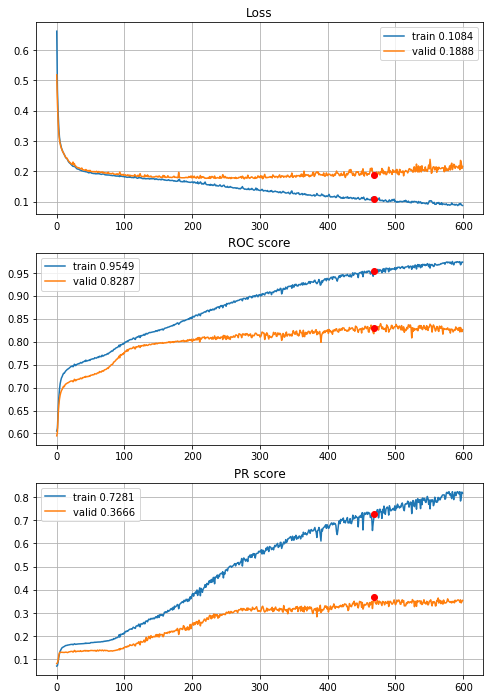


Fold 2------------------------------------------------------------


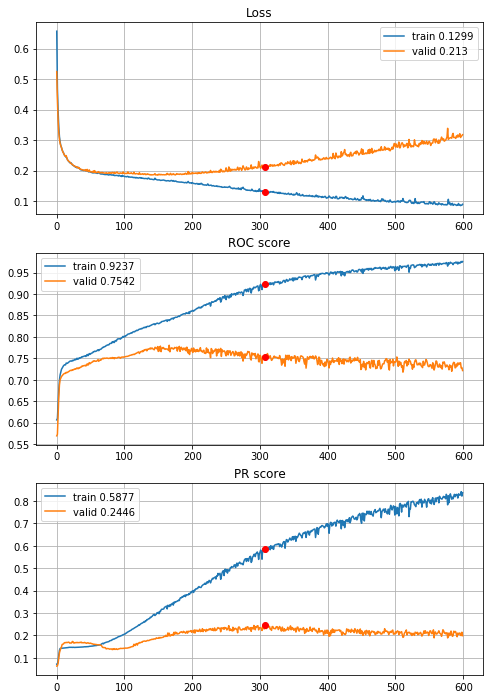


Fold 3------------------------------------------------------------


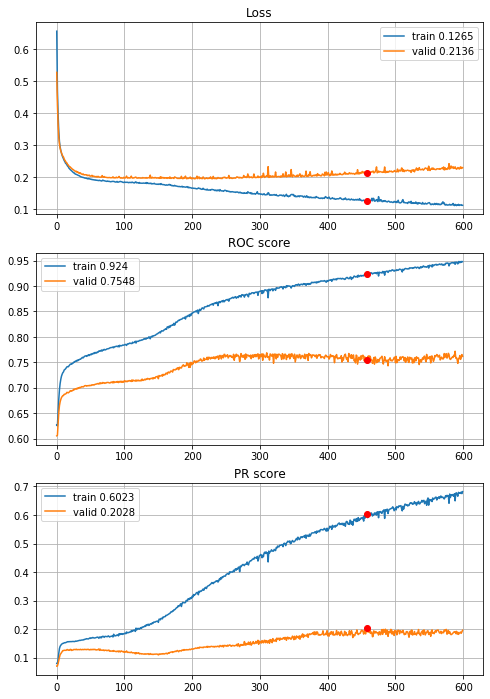


Fold 4------------------------------------------------------------


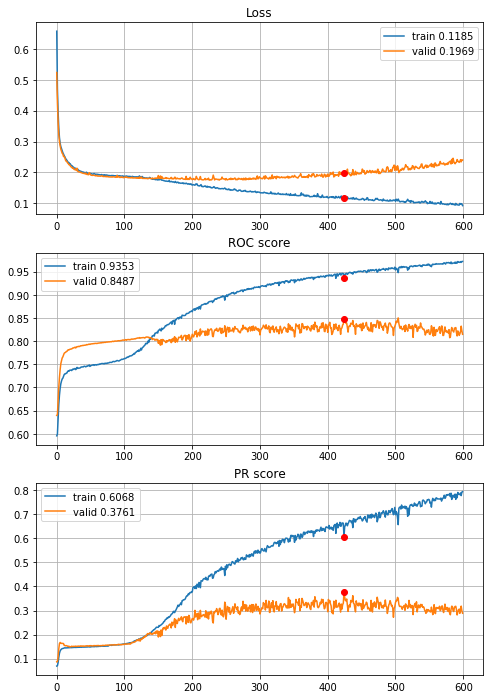


Fold 5------------------------------------------------------------


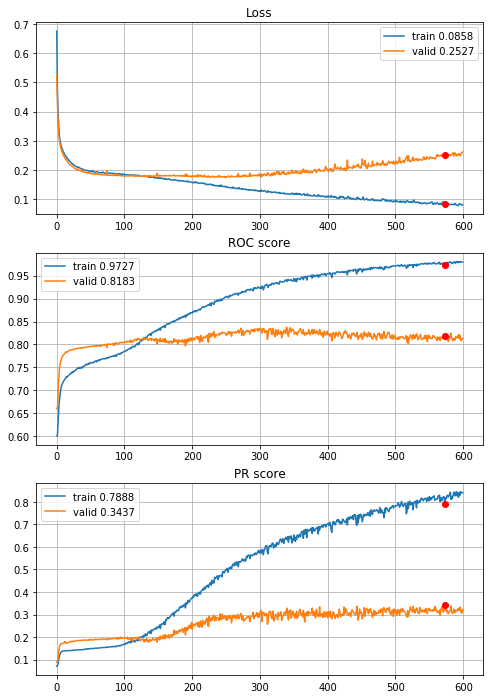


Fold 6------------------------------------------------------------


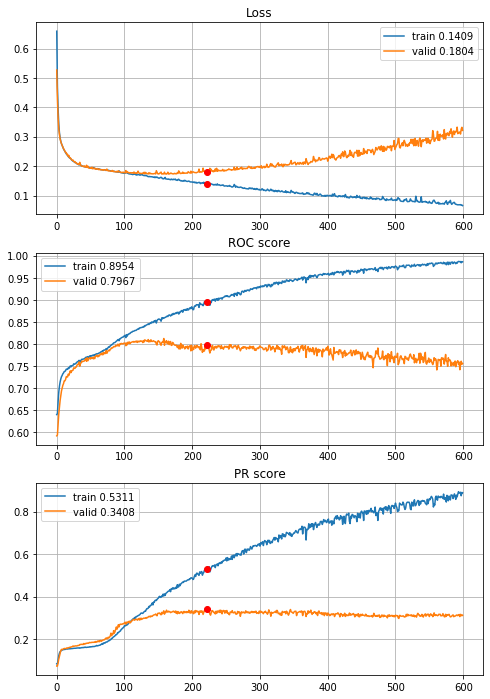

In [52]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_l1_00005, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Lets get back to the one hidden layer model, but this time with L1 regularization

In [51]:
def define_deep_CNN_2inc_std_L1(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(flat)                           # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 3.78s train loss: 0.5290705007435629, validation loss: 0.42929204395630477
Epoch: 2/600,
cumulative time: 5.33s train loss: 0.39271660880660647, validation loss: 0.35916756378541276
Epoch: 3/600,
cumulative time: 6.89s train loss: 0.33530408697184794, validation loss: 0.3130196322787774
Epoch: 4/600,
cumulative time: 8.46s train loss: 0.29707146848025706, validation loss: 0.28241629978683713
Epoch: 5/600,
cumulative time: 9.99s train loss: 0.2750356549156892, validation loss: 0.2691420829158157
Epoch: 6/600,
cumulative time: 11.53s train loss: 0.26411226959996725, validation loss: 0.26063470022056767
Epoch: 7/600,
cumulative time: 13.05s train loss: 0.25728602561073377, validation loss: 0.2537902890824395
Epoch: 8/600,
cumulative time: 14.5s train loss: 0.25026676547222104, validation loss: 0.2485881628147837
Epoch: 9/600,
cumulative time: 15.94s train loss: 0.2451595527878513,

Epoch: 76/600,
cumulative time: 112.18s train loss: 0.18403689357300276, validation loss: 0.1915543787713924
Epoch: 77/600,
cumulative time: 113.59s train loss: 0.184229960842417, validation loss: 0.19084732904979532
Epoch: 78/600,
cumulative time: 115.02s train loss: 0.18391521031324373, validation loss: 0.1892446927711053
Epoch: 79/600,
cumulative time: 116.44s train loss: 0.18396569325572282, validation loss: 0.19295484238412608
Epoch: 80/600,
cumulative time: 117.85s train loss: 0.18523415607968063, validation loss: 0.18917876029598868
Epoch: 81/600,
cumulative time: 119.31s train loss: 0.18374683218789364, validation loss: 0.18857636757656537
Epoch: 82/600,
cumulative time: 120.79s train loss: 0.18372904448731303, validation loss: 0.18948599380688896
Epoch: 83/600,
cumulative time: 122.32s train loss: 0.18230785304269786, validation loss: 0.18932617337546273
Epoch: 84/600,
cumulative time: 123.78s train loss: 0.18324533431614093, validation loss: 0.1931845473951024
Epoch: 85/600,


Epoch: 151/600,
cumulative time: 217.68s train loss: 0.17166997349044696, validation loss: 0.17936605023355853
Epoch: 152/600,
cumulative time: 219.1s train loss: 0.17277366014855217, validation loss: 0.18283766349859998
Epoch: 153/600,
cumulative time: 220.52s train loss: 0.172856028412305, validation loss: 0.18021761324228763
Epoch: 154/600,
cumulative time: 221.93s train loss: 0.17202724859749574, validation loss: 0.17730292103743375
Epoch: 155/600,
cumulative time: 223.35s train loss: 0.17076925465708515, validation loss: 0.17680616338006325
Epoch: 156/600,
cumulative time: 224.76s train loss: 0.17283598584723248, validation loss: 0.1781998154782697
Epoch: 157/600,
cumulative time: 226.16s train loss: 0.1724278735425351, validation loss: 0.1770744498811505
Epoch: 158/600,
cumulative time: 227.55s train loss: 0.17162974828979258, validation loss: 0.1814854444696272
Epoch: 159/600,
cumulative time: 228.96s train loss: 0.17194717913870103, validation loss: 0.17859080642806663
Epoch: 1

Epoch: 226/600,
cumulative time: 323.92s train loss: 0.16065085124177242, validation loss: 0.17264483962398228
Epoch: 227/600,
cumulative time: 325.33s train loss: 0.15925310032619014, validation loss: 0.1780228170003917
Epoch: 228/600,
cumulative time: 326.73s train loss: 0.16186898957111523, validation loss: 0.17414865572287
Epoch: 229/600,
cumulative time: 328.13s train loss: 0.16106661599183722, validation loss: 0.1734287530548967
Epoch: 230/600,
cumulative time: 329.54s train loss: 0.15933544759275997, validation loss: 0.17305913188166971
Epoch: 231/600,
cumulative time: 330.92s train loss: 0.1603566944562624, validation loss: 0.1770430491885983
Epoch: 232/600,
cumulative time: 332.32s train loss: 0.16222461146302142, validation loss: 0.17294581021436467
Epoch: 233/600,
cumulative time: 333.72s train loss: 0.16000619649594866, validation loss: 0.17243158644847598
Epoch: 234/600,
cumulative time: 335.11s train loss: 0.16012975624069342, validation loss: 0.17381734025161877
Epoch: 2

Epoch: 301/600,
cumulative time: 429.65s train loss: 0.14469405040540634, validation loss: 0.17962165665796942
Epoch: 302/600,
cumulative time: 431.05s train loss: 0.1439752505213757, validation loss: 0.168835840657749
Epoch: 303/600,
cumulative time: 432.45s train loss: 0.14373137625843696, validation loss: 0.17027738474314516
Epoch: 304/600,
cumulative time: 433.87s train loss: 0.14287960981252845, validation loss: 0.17172696949106403
Epoch: 305/600,
cumulative time: 435.27s train loss: 0.1426347887343125, validation loss: 0.16883291279766494
Epoch: 306/600,
cumulative time: 436.68s train loss: 0.14165327263315936, validation loss: 0.17291326534796767
Epoch: 307/600,
cumulative time: 438.09s train loss: 0.1439584696851341, validation loss: 0.17057207921599757
Epoch: 308/600,
cumulative time: 439.49s train loss: 0.14448903910749764, validation loss: 0.16955876559363975
Epoch: 309/600,
cumulative time: 440.89s train loss: 0.14538587804112077, validation loss: 0.17141663071612584
Epoch:

Epoch: 376/600,
cumulative time: 535.95s train loss: 0.12897869743975993, validation loss: 0.18024513750274299
Epoch: 377/600,
cumulative time: 537.35s train loss: 0.12627081723583666, validation loss: 0.17757904466680316
Epoch: 378/600,
cumulative time: 538.76s train loss: 0.12456923259221028, validation loss: 0.1779909195889414
Epoch: 379/600,
cumulative time: 540.15s train loss: 0.12555993255418052, validation loss: 0.17884481837751104
Epoch: 380/600,
cumulative time: 541.56s train loss: 0.1250833982844517, validation loss: 0.18069888588479785
Epoch: 381/600,
cumulative time: 542.95s train loss: 0.12800443844153644, validation loss: 0.177382498918706
Epoch: 382/600,
cumulative time: 544.36s train loss: 0.12554717531657814, validation loss: 0.18035795769373358
Epoch: 383/600,
cumulative time: 545.76s train loss: 0.12617329050763076, validation loss: 0.17967825770946164
Epoch: 384/600,
cumulative time: 547.16s train loss: 0.12658510988964528, validation loss: 0.1811251173098936
Epoch:

Epoch: 451/600,
cumulative time: 641.62s train loss: 0.116025288348446, validation loss: 0.19290287578649631
Epoch: 452/600,
cumulative time: 643.02s train loss: 0.11344147030881555, validation loss: 0.19102207801023902
Epoch: 453/600,
cumulative time: 644.43s train loss: 0.11322748735110766, validation loss: 0.19962231785444437
Epoch: 454/600,
cumulative time: 645.83s train loss: 0.11533609816550104, validation loss: 0.19057992400970486
Epoch: 455/600,
cumulative time: 647.24s train loss: 0.11158135701764853, validation loss: 0.19285857004929433
Epoch: 456/600,
cumulative time: 648.62s train loss: 0.11132085905946212, validation loss: 0.19204273122033755
Epoch: 457/600,
cumulative time: 650.02s train loss: 0.10898282714558447, validation loss: 0.19274116627532176
Epoch: 458/600,
cumulative time: 651.42s train loss: 0.1098435259386481, validation loss: 0.1888376637390473
Epoch: 459/600,
cumulative time: 652.83s train loss: 0.11008449312059525, validation loss: 0.19013193137106885
Epoch

Epoch: 526/600,
cumulative time: 747.38s train loss: 0.0979492890969554, validation loss: 0.20517548024045765
Epoch: 527/600,
cumulative time: 748.78s train loss: 0.09931294366983177, validation loss: 0.20597596003986524
Epoch: 528/600,
cumulative time: 750.19s train loss: 0.09879150146845006, validation loss: 0.21182119799682766
Epoch: 529/600,
cumulative time: 751.6s train loss: 0.09659180229489914, validation loss: 0.20523485606263656
Epoch: 530/600,
cumulative time: 752.97s train loss: 0.09527004425542386, validation loss: 0.20736363753321382
Epoch: 531/600,
cumulative time: 754.36s train loss: 0.10039457193791793, validation loss: 0.20693244002480504
Epoch: 532/600,
cumulative time: 755.76s train loss: 0.09975633420680242, validation loss: 0.2141223688812139
Epoch: 533/600,
cumulative time: 757.13s train loss: 0.09710182815112389, validation loss: 0.2051412351809853
Epoch: 534/600,
cumulative time: 758.52s train loss: 0.09396260213571074, validation loss: 0.20629936861415718
Epoch

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 3.99s train loss: 0.5232346439319363, validation loss: 0.4316683607372481
Epoch: 2/600,
cumulative time: 5.39s train loss: 0.39064000578386393, validation loss: 0.3606248710981594
Epoch: 3/600,
cumulative time: 6.79s train loss: 0.33448054503797103, validation loss: 0.3125109448775375
Epoch: 4/600,
cumulative time: 8.19s train loss: 0.2949706431177418, validation loss: 0.28241514047852495
Epoch: 5/600,
cumulative time: 9.59s train loss: 0.27260214306264974, validation loss: 0.2682883306536405
Epoch: 6/600,
cumulative time: 11.0s train loss: 0.2621502674812682, validation loss: 0.25935131981918164
Epoch: 7/600,
cumulative time: 12.38s train loss: 0.2542295506279588, validation loss: 0.25418528639556115
Epoch: 8/600,
cumulative time: 13.8s train loss: 0.24936839803823996, validation loss: 0.2476821310305936
Epoch: 9/600,
cumulative time: 15.2s train loss: 0.24330314264527364, validation loss: 0.243157624954914

Epoch: 77/600,
cumulative time: 110.94s train loss: 0.186904578204743, validation loss: 0.18943659377958272
Epoch: 78/600,
cumulative time: 112.34s train loss: 0.18733081075876654, validation loss: 0.19153454669524894
Epoch: 79/600,
cumulative time: 113.75s train loss: 0.18849734449587904, validation loss: 0.18951904908623965
Epoch: 80/600,
cumulative time: 115.14s train loss: 0.18793622284709605, validation loss: 0.19244175090361323
Epoch: 81/600,
cumulative time: 116.54s train loss: 0.18861115301652157, validation loss: 0.18957480911984584
Epoch: 82/600,
cumulative time: 117.94s train loss: 0.18736154020611862, validation loss: 0.1895983964610538
Epoch: 83/600,
cumulative time: 119.38s train loss: 0.18822689797010372, validation loss: 0.1911536805215054
Epoch: 84/600,
cumulative time: 120.78s train loss: 0.18683101231341107, validation loss: 0.1899362823503045
Epoch: 85/600,
cumulative time: 122.19s train loss: 0.18807385209859043, validation loss: 0.18923919314710033
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 216.43s train loss: 0.17846339365920724, validation loss: 0.1885950500925355
Epoch: 153/600,
cumulative time: 217.83s train loss: 0.17795633637383995, validation loss: 0.18807937264685895
Epoch: 154/600,
cumulative time: 219.23s train loss: 0.17670250496819837, validation loss: 0.1884664914046444
Epoch: 155/600,
cumulative time: 220.66s train loss: 0.17745473562461647, validation loss: 0.1881558480130482
Epoch: 156/600,
cumulative time: 222.13s train loss: 0.17687029316544484, validation loss: 0.18997949812183418
Epoch: 157/600,
cumulative time: 223.62s train loss: 0.17701465075288436, validation loss: 0.18822040396170034
Epoch: 158/600,
cumulative time: 225.08s train loss: 0.177244964490368, validation loss: 0.18867007733770907
Epoch: 159/600,
cumulative time: 226.51s train loss: 0.17913812413724423, validation loss: 0.1878982177492386
Epoch: 160/600,
cumulative time: 227.97s train loss: 0.17731468809709455, validation loss: 0.18791952755598895
Epoch: 

Epoch: 227/600,
cumulative time: 321.82s train loss: 0.16689468691122722, validation loss: 0.18804189202694604
Epoch: 228/600,
cumulative time: 323.21s train loss: 0.1670804498142643, validation loss: 0.19146835859776193
Epoch: 229/600,
cumulative time: 324.61s train loss: 0.1670855426701476, validation loss: 0.18805262202953626
Epoch: 230/600,
cumulative time: 326.01s train loss: 0.16503739321075991, validation loss: 0.18828962003803318
Epoch: 231/600,
cumulative time: 327.42s train loss: 0.16556234423988897, validation loss: 0.18935335664379102
Epoch: 232/600,
cumulative time: 328.82s train loss: 0.16575745534266956, validation loss: 0.1884456615694694
Epoch: 233/600,
cumulative time: 330.21s train loss: 0.16507216092251342, validation loss: 0.1891052264940828
Epoch: 234/600,
cumulative time: 331.61s train loss: 0.1648354261817293, validation loss: 0.1898389930340447
Epoch: 235/600,
cumulative time: 333.01s train loss: 0.16430695592975578, validation loss: 0.1883236959607038
Epoch: 2

Epoch: 302/600,
cumulative time: 427.82s train loss: 0.1546634968923691, validation loss: 0.1925043993007577
Epoch: 303/600,
cumulative time: 429.23s train loss: 0.15181769784344618, validation loss: 0.19697901246456812
Epoch: 304/600,
cumulative time: 430.64s train loss: 0.15550259740098074, validation loss: 0.19509598770013384
Epoch: 305/600,
cumulative time: 432.05s train loss: 0.15753386827673035, validation loss: 0.1932204293912572
Epoch: 306/600,
cumulative time: 433.46s train loss: 0.15236741112019797, validation loss: 0.1940793022462671
Epoch: 307/600,
cumulative time: 434.85s train loss: 0.15051147971826337, validation loss: 0.19895182717325252
Epoch: 308/600,
cumulative time: 436.25s train loss: 0.1547397411471895, validation loss: 0.19470270558268624
Epoch: 309/600,
cumulative time: 437.65s train loss: 0.1507887608078314, validation loss: 0.19413867123156198
Epoch: 310/600,
cumulative time: 439.06s train loss: 0.15232940817518908, validation loss: 0.19396661022149275
Epoch: 

Epoch: 377/600,
cumulative time: 534.07s train loss: 0.13942811498805285, validation loss: 0.20725636689374038
Epoch: 378/600,
cumulative time: 535.5s train loss: 0.13970674745039413, validation loss: 0.2056950984498609
Epoch: 379/600,
cumulative time: 536.93s train loss: 0.13852900695235823, validation loss: 0.2051667721195234
Epoch: 380/600,
cumulative time: 538.36s train loss: 0.13767003565803465, validation loss: 0.20254339014006928
Epoch: 381/600,
cumulative time: 539.77s train loss: 0.136833076061531, validation loss: 0.2030512698354812
Epoch: 382/600,
cumulative time: 541.17s train loss: 0.13711783234205036, validation loss: 0.20613533207719387
Epoch: 383/600,
cumulative time: 542.6s train loss: 0.14102740669005348, validation loss: 0.20344494944571476
Epoch: 384/600,
cumulative time: 544.0s train loss: 0.13917610986987983, validation loss: 0.20789967484422245
Epoch: 385/600,
cumulative time: 545.42s train loss: 0.13738383331651766, validation loss: 0.20614484041787232
Epoch: 38

Epoch: 452/600,
cumulative time: 643.14s train loss: 0.12415184472053005, validation loss: 0.21661276903340734
Epoch: 453/600,
cumulative time: 644.6s train loss: 0.12663975864827398, validation loss: 0.22462400139757693
Epoch: 454/600,
cumulative time: 646.02s train loss: 0.12601994247717704, validation loss: 0.22402691732587418
Epoch: 455/600,
cumulative time: 647.43s train loss: 0.12261908230069027, validation loss: 0.21908697994125384
Epoch: 456/600,
cumulative time: 648.86s train loss: 0.12086172805634601, validation loss: 0.21892228198140717
Epoch: 457/600,
cumulative time: 650.27s train loss: 0.12308022884765406, validation loss: 0.2201510882543982
Epoch: 458/600,
cumulative time: 651.69s train loss: 0.12214566880146359, validation loss: 0.2254672580283868
Epoch: 459/600,
cumulative time: 653.18s train loss: 0.12727725664824632, validation loss: 0.2198030413860687
Epoch: 460/600,
cumulative time: 654.71s train loss: 0.12422701277282182, validation loss: 0.22591862996432796
Epoch

Epoch: 527/600,
cumulative time: 753.25s train loss: 0.10776149490058025, validation loss: 0.24020854791992777
Epoch: 528/600,
cumulative time: 754.73s train loss: 0.10748403578444689, validation loss: 0.2364992555547848
Epoch: 529/600,
cumulative time: 756.16s train loss: 0.10994086057925831, validation loss: 0.24408151707412273
Epoch: 530/600,
cumulative time: 757.59s train loss: 0.11046783722877243, validation loss: 0.23851247647126733
Epoch: 531/600,
cumulative time: 759.01s train loss: 0.1060980892580763, validation loss: 0.2351485283156493
Epoch: 532/600,
cumulative time: 760.4s train loss: 0.10825342028403695, validation loss: 0.2347947625256948
Epoch: 533/600,
cumulative time: 761.86s train loss: 0.1074231796318709, validation loss: 0.24146349953298588
Epoch: 534/600,
cumulative time: 763.26s train loss: 0.1067652087635814, validation loss: 0.24153070937946103
Epoch: 535/600,
cumulative time: 764.69s train loss: 0.1049759778255389, validation loss: 0.23581116032324492
Epoch: 53

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 3.62s train loss: 0.5316647879437402, validation loss: 0.4390037530047947
Epoch: 2/600,
cumulative time: 5.14s train loss: 0.39575504638933445, validation loss: 0.3599419773152444
Epoch: 3/600,
cumulative time: 6.63s train loss: 0.3363355101900076, validation loss: 0.3124171137972053
Epoch: 4/600,
cumulative time: 8.1s train loss: 0.29642220601453684, validation loss: 0.28258119175594787
Epoch: 5/600,
cumulative time: 9.62s train loss: 0.2743876725333792, validation loss: 0.26987719474965166
Epoch: 6/600,
cumulative time: 11.19s train loss: 0.2636868415371722, validation loss: 0.2613260383059006
Epoch: 7/600,
cumulative time: 12.7s train loss: 0.25673755692084965, validation loss: 0.25549751428863154
Epoch: 8/600,
cumulative time: 14.22s train loss: 0.2501628397596511, validation loss: 0.25086635263944823
Epoch: 9/600,
cumulative time: 15.76s train loss: 0.2446297413116415, validation loss: 0.246673642209470

Epoch: 77/600,
cumulative time: 116.67s train loss: 0.18524039213548285, validation loss: 0.19591608023748988
Epoch: 78/600,
cumulative time: 118.16s train loss: 0.18468111145079144, validation loss: 0.19635803877820443
Epoch: 79/600,
cumulative time: 119.7s train loss: 0.18496434818118726, validation loss: 0.1961765308884068
Epoch: 80/600,
cumulative time: 121.23s train loss: 0.18375539174931227, validation loss: 0.19589127988698452
Epoch: 81/600,
cumulative time: 122.78s train loss: 0.183645526638444, validation loss: 0.19571271104582155
Epoch: 82/600,
cumulative time: 124.46s train loss: 0.1847223963506797, validation loss: 0.19576854124371093
Epoch: 83/600,
cumulative time: 125.91s train loss: 0.1848088417085042, validation loss: 0.19568704883203447
Epoch: 84/600,
cumulative time: 127.35s train loss: 0.18488765426460022, validation loss: 0.19679135541635115
Epoch: 85/600,
cumulative time: 128.81s train loss: 0.1853643239404888, validation loss: 0.19518671901433787
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 228.93s train loss: 0.18004583563220836, validation loss: 0.1931867667856145
Epoch: 153/600,
cumulative time: 230.41s train loss: 0.17965080402867598, validation loss: 0.19393127272127436
Epoch: 154/600,
cumulative time: 231.92s train loss: 0.17852896494565407, validation loss: 0.19663780275415288
Epoch: 155/600,
cumulative time: 233.45s train loss: 0.18108311173751246, validation loss: 0.19495631559638446
Epoch: 156/600,
cumulative time: 235.07s train loss: 0.17956164764981333, validation loss: 0.19784414486222887
Epoch: 157/600,
cumulative time: 236.54s train loss: 0.17950353423524387, validation loss: 0.1954874087041377
Epoch: 158/600,
cumulative time: 238.0s train loss: 0.17946688379738776, validation loss: 0.19515705855222198
Epoch: 159/600,
cumulative time: 239.44s train loss: 0.1784123723988359, validation loss: 0.1940443900225518
Epoch: 160/600,
cumulative time: 240.89s train loss: 0.1778821813671397, validation loss: 0.1941896241241933
Epoch: 1

Epoch: 227/600,
cumulative time: 339.95s train loss: 0.17026001353379444, validation loss: 0.1960494821476563
Epoch: 228/600,
cumulative time: 341.43s train loss: 0.17001427338694122, validation loss: 0.19673144233072593
Epoch: 229/600,
cumulative time: 342.97s train loss: 0.17244645902242936, validation loss: 0.1969293815554852
Epoch: 230/600,
cumulative time: 344.43s train loss: 0.1706080397338093, validation loss: 0.19535506271723585
Epoch: 231/600,
cumulative time: 345.96s train loss: 0.16997836575056152, validation loss: 0.19614315796782972
Epoch: 232/600,
cumulative time: 347.44s train loss: 0.17005796172866278, validation loss: 0.19821309682217644
Epoch: 233/600,
cumulative time: 348.9s train loss: 0.1700623483926841, validation loss: 0.19569639470035158
Epoch: 234/600,
cumulative time: 350.38s train loss: 0.17122983242532594, validation loss: 0.19768105667411592
Epoch: 235/600,
cumulative time: 351.86s train loss: 0.16991336526199272, validation loss: 0.19962183794373148
Epoch:

Epoch: 302/600,
cumulative time: 452.31s train loss: 0.1619333082914807, validation loss: 0.20352022849921064
Epoch: 303/600,
cumulative time: 453.76s train loss: 0.16362292041014573, validation loss: 0.2000649932941829
Epoch: 304/600,
cumulative time: 455.2s train loss: 0.1646233788996744, validation loss: 0.20088074308134732
Epoch: 305/600,
cumulative time: 456.66s train loss: 0.16199628489065865, validation loss: 0.1967652955474782
Epoch: 306/600,
cumulative time: 458.1s train loss: 0.16065797594596723, validation loss: 0.20214259431750048
Epoch: 307/600,
cumulative time: 459.6s train loss: 0.1613906787564575, validation loss: 0.19961475723450325
Epoch: 308/600,
cumulative time: 461.11s train loss: 0.16082285973684154, validation loss: 0.19621637601524572
Epoch: 309/600,
cumulative time: 462.54s train loss: 0.16032532973809316, validation loss: 0.19865668177036624
Epoch: 310/600,
cumulative time: 464.01s train loss: 0.1599646869229553, validation loss: 0.1966621648847367
Epoch: 311/

Epoch: 377/600,
cumulative time: 564.33s train loss: 0.15092351343916496, validation loss: 0.19762863915659604
Epoch: 378/600,
cumulative time: 565.79s train loss: 0.15051477934227123, validation loss: 0.19772606424688075
Epoch: 379/600,
cumulative time: 567.27s train loss: 0.1493561796648178, validation loss: 0.19850173629084925
Epoch: 380/600,
cumulative time: 568.76s train loss: 0.14934934165932964, validation loss: 0.2015575479901186
Epoch: 381/600,
cumulative time: 570.22s train loss: 0.14998483249947306, validation loss: 0.19805085340513512
Epoch: 382/600,
cumulative time: 571.67s train loss: 0.14992794994659034, validation loss: 0.20020117020834213
Epoch: 383/600,
cumulative time: 573.15s train loss: 0.14873497168812913, validation loss: 0.19853137993463615
Epoch: 384/600,
cumulative time: 574.6s train loss: 0.14982054661490135, validation loss: 0.198902219107883
Epoch: 385/600,
cumulative time: 576.03s train loss: 0.15008108988739108, validation loss: 0.19804597989363765
Epoch:

Epoch: 452/600,
cumulative time: 675.62s train loss: 0.13764746453352786, validation loss: 0.2089728430227977
Epoch: 453/600,
cumulative time: 677.21s train loss: 0.1396615246868127, validation loss: 0.19965131414472204
Epoch: 454/600,
cumulative time: 678.87s train loss: 0.14096157444050214, validation loss: 0.2120953475012919
Epoch: 455/600,
cumulative time: 680.39s train loss: 0.14057553308009776, validation loss: 0.20035958765841733
Epoch: 456/600,
cumulative time: 681.87s train loss: 0.13810122372684275, validation loss: 0.20066229007007153
Epoch: 457/600,
cumulative time: 683.4s train loss: 0.13713712302147815, validation loss: 0.2048774786836197
Epoch: 458/600,
cumulative time: 684.9s train loss: 0.1387064374773278, validation loss: 0.20635334323708746
Epoch: 459/600,
cumulative time: 686.36s train loss: 0.13643367949938653, validation loss: 0.20171299726886763
Epoch: 460/600,
cumulative time: 687.87s train loss: 0.13684309505197118, validation loss: 0.2045043790376941
Epoch: 46

Epoch: 527/600,
cumulative time: 787.03s train loss: 0.1270384415892835, validation loss: 0.2078628198194861
Epoch: 528/600,
cumulative time: 788.52s train loss: 0.12696771396532802, validation loss: 0.21019763194678834
Epoch: 529/600,
cumulative time: 790.01s train loss: 0.12649163699565685, validation loss: 0.20658290156951317
Epoch: 530/600,
cumulative time: 791.49s train loss: 0.1265743518844054, validation loss: 0.21219937152364288
Epoch: 531/600,
cumulative time: 793.03s train loss: 0.12818689671123482, validation loss: 0.2252880200550944
Epoch: 532/600,
cumulative time: 794.58s train loss: 0.13219360736809163, validation loss: 0.20637659227426072
Epoch: 533/600,
cumulative time: 796.16s train loss: 0.12758873426612255, validation loss: 0.2072709756716325
Epoch: 534/600,
cumulative time: 797.68s train loss: 0.12540886533182422, validation loss: 0.2118271301704008
Epoch: 535/600,
cumulative time: 799.2s train loss: 0.12759485337327714, validation loss: 0.2088453308853509
Epoch: 53

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.12s train loss: 0.5233992316385844, validation loss: 0.42827581176553314
Epoch: 2/600,
cumulative time: 5.61s train loss: 0.3911018527675906, validation loss: 0.35678245300659117
Epoch: 3/600,
cumulative time: 7.06s train loss: 0.3347128963139277, validation loss: 0.3094774069349485
Epoch: 4/600,
cumulative time: 8.6s train loss: 0.2952262771303316, validation loss: 0.27877941798644457
Epoch: 5/600,
cumulative time: 10.21s train loss: 0.2731107791486722, validation loss: 0.26505622306269316
Epoch: 6/600,
cumulative time: 11.81s train loss: 0.2619563394349033, validation loss: 0.25576176324452243
Epoch: 7/600,
cumulative time: 13.32s train loss: 0.2546195402816516, validation loss: 0.24802164062908347
Epoch: 8/600,
cumulative time: 14.88s train loss: 0.24966585739227434, validation loss: 0.24282214999036614
Epoch: 9/600,
cumulative time: 16.45s train loss: 0.24392986648270729, validation loss: 0.23845727261

Epoch: 77/600,
cumulative time: 117.86s train loss: 0.18911248322129331, validation loss: 0.18573984108139982
Epoch: 78/600,
cumulative time: 119.3s train loss: 0.18895693622345855, validation loss: 0.18444322433051322
Epoch: 79/600,
cumulative time: 120.76s train loss: 0.18904722242812833, validation loss: 0.1847713933642662
Epoch: 80/600,
cumulative time: 122.19s train loss: 0.18847420154362368, validation loss: 0.18453458204124962
Epoch: 81/600,
cumulative time: 123.63s train loss: 0.18830412634586616, validation loss: 0.1842951815577897
Epoch: 82/600,
cumulative time: 125.08s train loss: 0.18914691996309782, validation loss: 0.18483560712382938
Epoch: 83/600,
cumulative time: 126.52s train loss: 0.18854811378295167, validation loss: 0.1842371071172134
Epoch: 84/600,
cumulative time: 127.98s train loss: 0.18957290186489795, validation loss: 0.1855200695354489
Epoch: 85/600,
cumulative time: 129.48s train loss: 0.18849155089680836, validation loss: 0.18476335898072158
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 230.22s train loss: 0.18584722722078334, validation loss: 0.18498286301583317
Epoch: 153/600,
cumulative time: 231.75s train loss: 0.18455899207383886, validation loss: 0.18156030717311544
Epoch: 154/600,
cumulative time: 233.2s train loss: 0.1841637596871537, validation loss: 0.19211232994915758
Epoch: 155/600,
cumulative time: 234.72s train loss: 0.18831191688114465, validation loss: 0.18596725768382408
Epoch: 156/600,
cumulative time: 236.22s train loss: 0.1840418789844722, validation loss: 0.18603974929709594
Epoch: 157/600,
cumulative time: 237.74s train loss: 0.1851657001776249, validation loss: 0.18239525788247463
Epoch: 158/600,
cumulative time: 239.36s train loss: 0.1848177259155536, validation loss: 0.18166289473975736
Epoch: 159/600,
cumulative time: 240.82s train loss: 0.18410083269222255, validation loss: 0.1828016540564348
Epoch: 160/600,
cumulative time: 242.33s train loss: 0.18311945321886866, validation loss: 0.1815603642215365
Epoch: 1

Epoch: 227/600,
cumulative time: 344.59s train loss: 0.16841539192651023, validation loss: 0.1838117959123635
Epoch: 228/600,
cumulative time: 346.19s train loss: 0.16876562896532013, validation loss: 0.18328668986598678
Epoch: 229/600,
cumulative time: 347.81s train loss: 0.16739815830916518, validation loss: 0.18279275181465526
Epoch: 230/600,
cumulative time: 349.31s train loss: 0.16732195390475377, validation loss: 0.18440222954206356
Epoch: 231/600,
cumulative time: 351.14s train loss: 0.16770728588526343, validation loss: 0.18322773017065308
Epoch: 232/600,
cumulative time: 352.9s train loss: 0.16800729060642208, validation loss: 0.18651080150803878
Epoch: 233/600,
cumulative time: 354.34s train loss: 0.1706660659533503, validation loss: 0.1836349712272661
Epoch: 234/600,
cumulative time: 355.79s train loss: 0.17061093349750955, validation loss: 0.18379378714392672
Epoch: 235/600,
cumulative time: 357.27s train loss: 0.16731753351171155, validation loss: 0.18242043705113167
Epoch

Epoch: 302/600,
cumulative time: 457.36s train loss: 0.15614323488060078, validation loss: 0.18223490574637427
Epoch: 303/600,
cumulative time: 458.84s train loss: 0.15665775251562258, validation loss: 0.1833168341137261
Epoch: 304/600,
cumulative time: 460.3s train loss: 0.15897261184031058, validation loss: 0.18468605177673536
Epoch: 305/600,
cumulative time: 461.79s train loss: 0.15850956341672556, validation loss: 0.18249510125167684
Epoch: 306/600,
cumulative time: 463.23s train loss: 0.15756225523637943, validation loss: 0.18288464253860887
Epoch: 307/600,
cumulative time: 464.7s train loss: 0.15627121875433186, validation loss: 0.1891457279009264
Epoch: 308/600,
cumulative time: 466.18s train loss: 0.15695454423553887, validation loss: 0.1816276302440707
Epoch: 309/600,
cumulative time: 467.65s train loss: 0.1561150377600813, validation loss: 0.18712578611442068
Epoch: 310/600,
cumulative time: 469.15s train loss: 0.15577995342250808, validation loss: 0.18613511941682895
Epoch: 

Epoch: 377/600,
cumulative time: 569.24s train loss: 0.14720492377160893, validation loss: 0.1828365685422052
Epoch: 378/600,
cumulative time: 570.75s train loss: 0.14749882523547267, validation loss: 0.18821035284952212
Epoch: 379/600,
cumulative time: 572.26s train loss: 0.14889613730445084, validation loss: 0.18292743178595483
Epoch: 380/600,
cumulative time: 573.77s train loss: 0.14744524467885128, validation loss: 0.18682304380741793
Epoch: 381/600,
cumulative time: 575.28s train loss: 0.15336983371183557, validation loss: 0.1825473988194138
Epoch: 382/600,
cumulative time: 576.9s train loss: 0.15070571589275908, validation loss: 0.1898923345858585
Epoch: 383/600,
cumulative time: 578.35s train loss: 0.1500067552073473, validation loss: 0.18624148204912533
Epoch: 384/600,
cumulative time: 579.8s train loss: 0.1477042383147929, validation loss: 0.18321340608710412
Epoch: 385/600,
cumulative time: 581.26s train loss: 0.14739969201273348, validation loss: 0.1824810452673044
Epoch: 38

Epoch: 452/600,
cumulative time: 682.11s train loss: 0.1400096426153157, validation loss: 0.1803909194274692
Epoch: 453/600,
cumulative time: 683.6s train loss: 0.13833256203229202, validation loss: 0.1808526195418356
Epoch: 454/600,
cumulative time: 685.1s train loss: 0.13945616300361255, validation loss: 0.1821700443289895
Epoch: 455/600,
cumulative time: 686.59s train loss: 0.1378169157423701, validation loss: 0.1794231028439968
Epoch: 456/600,
cumulative time: 688.04s train loss: 0.1392980476791359, validation loss: 0.18325663084599175
Epoch: 457/600,
cumulative time: 689.49s train loss: 0.14302382282237988, validation loss: 0.18018817604399603
Epoch: 458/600,
cumulative time: 690.92s train loss: 0.1389233891966475, validation loss: 0.182031773583592
Epoch: 459/600,
cumulative time: 692.41s train loss: 0.13907908146203288, validation loss: 0.1813885166460028
Epoch: 460/600,
cumulative time: 693.9s train loss: 0.13921414930578896, validation loss: 0.18297644106606548
Epoch: 461/600,

Epoch: 527/600,
cumulative time: 793.59s train loss: 0.13339907788303362, validation loss: 0.18307739412037996
Epoch: 528/600,
cumulative time: 795.05s train loss: 0.13335034306714472, validation loss: 0.18455351303839376
Epoch: 529/600,
cumulative time: 796.47s train loss: 0.13285410712456225, validation loss: 0.18478848321085645
Epoch: 530/600,
cumulative time: 797.93s train loss: 0.13239973026867963, validation loss: 0.1838700010145173
Epoch: 531/600,
cumulative time: 799.37s train loss: 0.13400708828093522, validation loss: 0.18428558812123566
Epoch: 532/600,
cumulative time: 800.83s train loss: 0.13015913721628058, validation loss: 0.18301138197629122
Epoch: 533/600,
cumulative time: 802.28s train loss: 0.1307205379965048, validation loss: 0.18302075191571487
Epoch: 534/600,
cumulative time: 803.73s train loss: 0.13042287858986618, validation loss: 0.18163916706998304
Epoch: 535/600,
cumulative time: 805.18s train loss: 0.13064423500558067, validation loss: 0.18496663395728766
Epo

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 3.74s train loss: 0.5386015422690927, validation loss: 0.4322166906146977
Epoch: 2/600,
cumulative time: 5.34s train loss: 0.3966204633039457, validation loss: 0.35713649628435234
Epoch: 3/600,
cumulative time: 6.91s train loss: 0.3381031572348022, validation loss: 0.3096741765575123
Epoch: 4/600,
cumulative time: 8.38s train loss: 0.29877744447886295, validation loss: 0.27916228129688336
Epoch: 5/600,
cumulative time: 9.88s train loss: 0.2774267884454242, validation loss: 0.26611572451260174
Epoch: 6/600,
cumulative time: 11.43s train loss: 0.26689357213546117, validation loss: 0.25594061332924817
Epoch: 7/600,
cumulative time: 12.95s train loss: 0.2584246432161149, validation loss: 0.24763185585714492
Epoch: 8/600,
cumulative time: 14.46s train loss: 0.2522285267272416, validation loss: 0.24237525000234392
Epoch: 9/600,
cumulative time: 16.05s train loss: 0.2478390625213356, validation loss: 0.237656834441

Epoch: 77/600,
cumulative time: 120.66s train loss: 0.18717992236362954, validation loss: 0.18102942981658254
Epoch: 78/600,
cumulative time: 122.13s train loss: 0.1879182303981746, validation loss: 0.18119311848355898
Epoch: 79/600,
cumulative time: 123.57s train loss: 0.18830806111068768, validation loss: 0.18077728316715694
Epoch: 80/600,
cumulative time: 125.02s train loss: 0.18821334502049, validation loss: 0.1812670794429831
Epoch: 81/600,
cumulative time: 126.53s train loss: 0.18841444873829294, validation loss: 0.18088370967625922
Epoch: 82/600,
cumulative time: 127.98s train loss: 0.18861319776015734, validation loss: 0.18088840685114874
Epoch: 83/600,
cumulative time: 129.46s train loss: 0.18738525994690156, validation loss: 0.18041173792989768
Epoch: 84/600,
cumulative time: 130.99s train loss: 0.18880860836190336, validation loss: 0.18060023008721401
Epoch: 85/600,
cumulative time: 132.48s train loss: 0.1872377215411863, validation loss: 0.1831833855616949
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 232.24s train loss: 0.18255659403007535, validation loss: 0.17834334499748267
Epoch: 153/600,
cumulative time: 233.8s train loss: 0.181035625401373, validation loss: 0.18119547654156465
Epoch: 154/600,
cumulative time: 235.29s train loss: 0.1826113418093629, validation loss: 0.1806289956420254
Epoch: 155/600,
cumulative time: 236.77s train loss: 0.18302730267181636, validation loss: 0.17947882754926137
Epoch: 156/600,
cumulative time: 238.24s train loss: 0.18056901851932727, validation loss: 0.17832846137662026
Epoch: 157/600,
cumulative time: 239.86s train loss: 0.1804178192367481, validation loss: 0.17834705656409588
Epoch: 158/600,
cumulative time: 241.44s train loss: 0.1808156600112424, validation loss: 0.1786571227684008
Epoch: 159/600,
cumulative time: 242.94s train loss: 0.18253044903781548, validation loss: 0.17943503287410217
Epoch: 160/600,
cumulative time: 244.43s train loss: 0.18068883466597216, validation loss: 0.17870643988698315
Epoch: 16

Epoch: 227/600,
cumulative time: 344.97s train loss: 0.17078650162062226, validation loss: 0.17438174934413192
Epoch: 228/600,
cumulative time: 346.42s train loss: 0.17234646826820177, validation loss: 0.17418476815363368
Epoch: 229/600,
cumulative time: 347.91s train loss: 0.17050037288547276, validation loss: 0.1730578317426206
Epoch: 230/600,
cumulative time: 349.35s train loss: 0.16957574751642016, validation loss: 0.17374969933598178
Epoch: 231/600,
cumulative time: 350.8s train loss: 0.16864338356896033, validation loss: 0.17646379837872872
Epoch: 232/600,
cumulative time: 352.23s train loss: 0.17044264556787309, validation loss: 0.17239695781339417
Epoch: 233/600,
cumulative time: 353.67s train loss: 0.1683941081466563, validation loss: 0.1727752515218888
Epoch: 234/600,
cumulative time: 355.18s train loss: 0.168365100420979, validation loss: 0.17531674383690313
Epoch: 235/600,
cumulative time: 356.7s train loss: 0.16822444084698987, validation loss: 0.17244686094957737
Epoch: 2

Epoch: 302/600,
cumulative time: 455.07s train loss: 0.1550880580255863, validation loss: 0.16591923421994867
Epoch: 303/600,
cumulative time: 456.54s train loss: 0.1554267390840129, validation loss: 0.16532380734786026
Epoch: 304/600,
cumulative time: 457.98s train loss: 0.15567262381039285, validation loss: 0.16909533795933632
Epoch: 305/600,
cumulative time: 459.46s train loss: 0.1552107888385491, validation loss: 0.16749806819884588
Epoch: 306/600,
cumulative time: 460.93s train loss: 0.16012658961198428, validation loss: 0.17567592796334128
Epoch: 307/600,
cumulative time: 462.39s train loss: 0.15933088574371826, validation loss: 0.17068721926504649
Epoch: 308/600,
cumulative time: 463.85s train loss: 0.15561396366468183, validation loss: 0.1656622563257854
Epoch: 309/600,
cumulative time: 465.33s train loss: 0.15419926488475796, validation loss: 0.165686515416209
Epoch: 310/600,
cumulative time: 466.78s train loss: 0.1538671520609644, validation loss: 0.1671229705255103
Epoch: 31

Epoch: 377/600,
cumulative time: 564.08s train loss: 0.14316684727948606, validation loss: 0.16381073067071328
Epoch: 378/600,
cumulative time: 565.5s train loss: 0.14164585739877358, validation loss: 0.16245777704004372
Epoch: 379/600,
cumulative time: 566.94s train loss: 0.14187605567235897, validation loss: 0.16526329966023443
Epoch: 380/600,
cumulative time: 568.37s train loss: 0.14241304633274576, validation loss: 0.16230818889121593
Epoch: 381/600,
cumulative time: 569.81s train loss: 0.14222642843264574, validation loss: 0.16429494977078582
Epoch: 382/600,
cumulative time: 571.23s train loss: 0.1414418712254281, validation loss: 0.16345176742252276
Epoch: 383/600,
cumulative time: 572.65s train loss: 0.14172446876886038, validation loss: 0.16699309247147484
Epoch: 384/600,
cumulative time: 574.16s train loss: 0.1408195247962941, validation loss: 0.16243280742408794
Epoch: 385/600,
cumulative time: 575.59s train loss: 0.14308296441463733, validation loss: 0.1632077008160973
Epoch

Epoch: 452/600,
cumulative time: 672.09s train loss: 0.1370365119748191, validation loss: 0.20461924843063797
Epoch: 453/600,
cumulative time: 673.55s train loss: 0.13993498987532454, validation loss: 0.17519562979728714
Epoch: 454/600,
cumulative time: 675.0s train loss: 0.13168907165527344, validation loss: 0.17338688068640004
Epoch: 455/600,
cumulative time: 676.41s train loss: 0.12910861483610728, validation loss: 0.1664497834257274
Epoch: 456/600,
cumulative time: 677.85s train loss: 0.13003106544317763, validation loss: 0.16889919685732765
Epoch: 457/600,
cumulative time: 679.29s train loss: 0.12883235835358664, validation loss: 0.171499490473998
Epoch: 458/600,
cumulative time: 680.74s train loss: 0.13517104025142904, validation loss: 0.16629185415905892
Epoch: 459/600,
cumulative time: 682.17s train loss: 0.12928668638054192, validation loss: 0.16514324798814609
Epoch: 460/600,
cumulative time: 683.61s train loss: 0.12973585517870057, validation loss: 0.1662702695631526
Epoch: 

Epoch: 527/600,
cumulative time: 785.98s train loss: 0.1188692436401361, validation loss: 0.17747372360417887
Epoch: 528/600,
cumulative time: 787.45s train loss: 0.12110944625298636, validation loss: 0.17186865383094274
Epoch: 529/600,
cumulative time: 789.0s train loss: 0.11967459162758066, validation loss: 0.182772664469984
Epoch: 530/600,
cumulative time: 790.47s train loss: 0.12115055289573984, validation loss: 0.17340456686244024
Epoch: 531/600,
cumulative time: 791.94s train loss: 0.11960955101728829, validation loss: 0.1713583927185399
Epoch: 532/600,
cumulative time: 793.4s train loss: 0.11891847762455737, validation loss: 0.17484714038040722
Epoch: 533/600,
cumulative time: 794.85s train loss: 0.11909852237166728, validation loss: 0.1756181007185164
Epoch: 534/600,
cumulative time: 796.29s train loss: 0.12088153862510047, validation loss: 0.17785348266119527
Epoch: 535/600,
cumulative time: 797.73s train loss: 0.11787041050457032, validation loss: 0.1777186217319413
Epoch: 53

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 4.24s train loss: 0.5241518008780376, validation loss: 0.43142381834236737
Epoch: 2/600,
cumulative time: 5.73s train loss: 0.39170206207497965, validation loss: 0.35882617715918724
Epoch: 3/600,
cumulative time: 7.18s train loss: 0.33359238568669053, validation loss: 0.3119652703688645
Epoch: 4/600,
cumulative time: 8.61s train loss: 0.2941138123634854, validation loss: 0.2829567416487338
Epoch: 5/600,
cumulative time: 10.05s train loss: 0.2732836797849675, validation loss: 0.27116570640000076
Epoch: 6/600,
cumulative time: 11.51s train loss: 0.26299822515927757, validation loss: 0.2610929469078048
Epoch: 7/600,
cumulative time: 12.94s train loss: 0.25458763282916513, validation loss: 0.2550998295401033
Epoch: 8/600,
cumulative time: 14.39s train loss: 0.24877158207068126, validation loss: 0.24991020430336205
Epoch: 9/600,
cumulative time: 15.85s train loss: 0.2445059735084476, validation loss: 0.2460994892

Epoch: 77/600,
cumulative time: 116.67s train loss: 0.18622772089228, validation loss: 0.1856772442645208
Epoch: 78/600,
cumulative time: 118.36s train loss: 0.1855713920769219, validation loss: 0.1856848354316862
Epoch: 79/600,
cumulative time: 120.02s train loss: 0.18549559593265613, validation loss: 0.18560331255928372
Epoch: 80/600,
cumulative time: 121.7s train loss: 0.18553077242051075, validation loss: 0.18528709436794719
Epoch: 81/600,
cumulative time: 123.24s train loss: 0.18459978729713716, validation loss: 0.18493860541799736
Epoch: 82/600,
cumulative time: 124.79s train loss: 0.18471604453760945, validation loss: 0.1859855482136521
Epoch: 83/600,
cumulative time: 126.31s train loss: 0.18481781005388642, validation loss: 0.188628758372338
Epoch: 84/600,
cumulative time: 127.86s train loss: 0.18527175941401058, validation loss: 0.1854334186955434
Epoch: 85/600,
cumulative time: 129.39s train loss: 0.18391141533640604, validation loss: 0.18601443502818532
Epoch: 86/600,
cumula

Epoch: 152/600,
cumulative time: 228.9s train loss: 0.17457394063683768, validation loss: 0.17739649492567178
Epoch: 153/600,
cumulative time: 230.32s train loss: 0.17517986998757376, validation loss: 0.17983388730225836
Epoch: 154/600,
cumulative time: 231.74s train loss: 0.17784511486843455, validation loss: 0.17873132502918998
Epoch: 155/600,
cumulative time: 233.21s train loss: 0.17698208781563898, validation loss: 0.1822934773539977
Epoch: 156/600,
cumulative time: 234.63s train loss: 0.17513585866130646, validation loss: 0.17697011385041947
Epoch: 157/600,
cumulative time: 236.06s train loss: 0.17430241855595885, validation loss: 0.1766438955791315
Epoch: 158/600,
cumulative time: 237.54s train loss: 0.174217776677415, validation loss: 0.17821765278925364
Epoch: 159/600,
cumulative time: 239.07s train loss: 0.17381793133151557, validation loss: 0.18009925637729163
Epoch: 160/600,
cumulative time: 240.59s train loss: 0.1764300291757211, validation loss: 0.18133284226668953
Epoch: 

Epoch: 227/600,
cumulative time: 337.07s train loss: 0.1583499737968567, validation loss: 0.17558613096741954
Epoch: 228/600,
cumulative time: 338.51s train loss: 0.1595270528066457, validation loss: 0.17028529194947484
Epoch: 229/600,
cumulative time: 339.94s train loss: 0.16005045767013218, validation loss: 0.17199548358244857
Epoch: 230/600,
cumulative time: 341.38s train loss: 0.15905434403503577, validation loss: 0.16977471766907123
Epoch: 231/600,
cumulative time: 342.82s train loss: 0.1567263473981833, validation loss: 0.17098807387196074
Epoch: 232/600,
cumulative time: 344.26s train loss: 0.1562572473473441, validation loss: 0.16962158519581813
Epoch: 233/600,
cumulative time: 345.72s train loss: 0.15595293947757263, validation loss: 0.17200574713279507
Epoch: 234/600,
cumulative time: 347.16s train loss: 0.1568664962097126, validation loss: 0.1696746899094179
Epoch: 235/600,
cumulative time: 348.61s train loss: 0.15635163942047584, validation loss: 0.17308911234546423
Epoch: 

Epoch: 302/600,
cumulative time: 445.82s train loss: 0.13650205478778268, validation loss: 0.16826540444868462
Epoch: 303/600,
cumulative time: 447.3s train loss: 0.13624957572741836, validation loss: 0.1662264410051078
Epoch: 304/600,
cumulative time: 448.89s train loss: 0.13502770958951227, validation loss: 0.1665756523974585
Epoch: 305/600,
cumulative time: 450.41s train loss: 0.13322813653088864, validation loss: 0.16406315544807942
Epoch: 306/600,
cumulative time: 451.88s train loss: 0.13247349872081368, validation loss: 0.17416766361011146
Epoch: 307/600,
cumulative time: 453.33s train loss: 0.13400166895451565, validation loss: 0.1654041311640181
Epoch: 308/600,
cumulative time: 454.79s train loss: 0.1327769390483892, validation loss: 0.16558120631148446
Epoch: 309/600,
cumulative time: 456.23s train loss: 0.13308789280764677, validation loss: 0.16602843579625565
Epoch: 310/600,
cumulative time: 457.72s train loss: 0.1319903853939834, validation loss: 0.16586372775992517
Epoch: 

Epoch: 377/600,
cumulative time: 556.74s train loss: 0.1074254903982927, validation loss: 0.18429637582571695
Epoch: 378/600,
cumulative time: 558.26s train loss: 0.10639223911493108, validation loss: 0.17632979997091136
Epoch: 379/600,
cumulative time: 559.73s train loss: 0.10540342852189195, validation loss: 0.18355203296085795
Epoch: 380/600,
cumulative time: 561.2s train loss: 0.10988903241252328, validation loss: 0.19635739077989023
Epoch: 381/600,
cumulative time: 562.74s train loss: 0.11417924579890336, validation loss: 0.18619953802398506
Epoch: 382/600,
cumulative time: 564.19s train loss: 0.1090860296982241, validation loss: 0.18389730620367975
Epoch: 383/600,
cumulative time: 565.64s train loss: 0.10634941542176185, validation loss: 0.17786949054827808
Epoch: 384/600,
cumulative time: 567.09s train loss: 0.10694123177397549, validation loss: 0.18740663998214685
Epoch: 385/600,
cumulative time: 568.54s train loss: 0.11022682278366325, validation loss: 0.1866187226504331
Epoch

Epoch: 452/600,
cumulative time: 668.18s train loss: 0.0847204057631653, validation loss: 0.23224383438315638
Epoch: 453/600,
cumulative time: 669.62s train loss: 0.08499799216722091, validation loss: 0.23254935589570766
Epoch: 454/600,
cumulative time: 671.07s train loss: 0.08474369821481585, validation loss: 0.23167628630467915
Epoch: 455/600,
cumulative time: 672.51s train loss: 0.08235413746701346, validation loss: 0.22534220939760963
Epoch: 456/600,
cumulative time: 673.97s train loss: 0.08103935700620084, validation loss: 0.23289568287800053
Epoch: 457/600,
cumulative time: 675.43s train loss: 0.0808852072632699, validation loss: 0.23349126674011553
Epoch: 458/600,
cumulative time: 676.88s train loss: 0.08024170425819935, validation loss: 0.23932701895363648
Epoch: 459/600,
cumulative time: 678.34s train loss: 0.08345088709657099, validation loss: 0.2342500018326398
Epoch: 460/600,
cumulative time: 679.82s train loss: 0.07877001275302344, validation loss: 0.2342179810643521
Epoch

Epoch: 527/600,
cumulative time: 779.95s train loss: 0.06318436292545923, validation loss: 0.3075884323191578
Epoch: 528/600,
cumulative time: 781.4s train loss: 0.06515440461073631, validation loss: 0.30471331331807844
Epoch: 529/600,
cumulative time: 782.84s train loss: 0.06582318856086672, validation loss: 0.3028965407845435
Epoch: 530/600,
cumulative time: 784.33s train loss: 0.06604675749268114, validation loss: 0.3104151035646327
Epoch: 531/600,
cumulative time: 785.81s train loss: 0.07130478734702424, validation loss: 0.3067037095531456
Epoch: 532/600,
cumulative time: 787.32s train loss: 0.0624479579451151, validation loss: 0.3078095658354928
Epoch: 533/600,
cumulative time: 788.77s train loss: 0.06075208325624823, validation loss: 0.3032991486203118
Epoch: 534/600,
cumulative time: 790.22s train loss: 0.06650275965515434, validation loss: 0.31348669776637156
Epoch: 535/600,
cumulative time: 791.78s train loss: 0.06303002601002458, validation loss: 0.31067884603784257
Epoch: 53

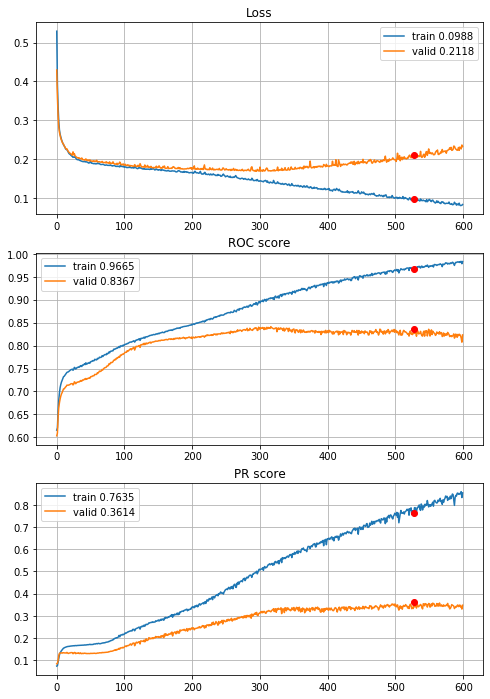


Fold 2------------------------------------------------------------


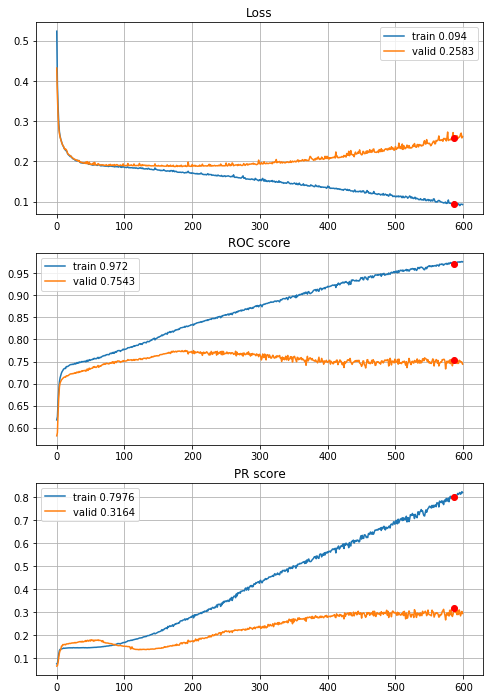


Fold 3------------------------------------------------------------


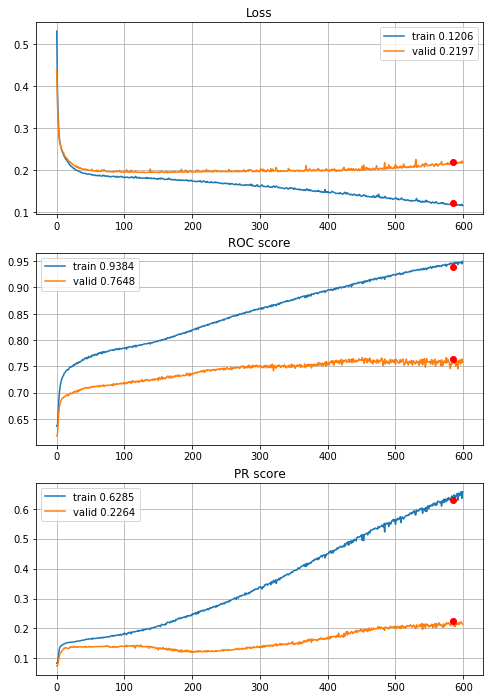


Fold 4------------------------------------------------------------


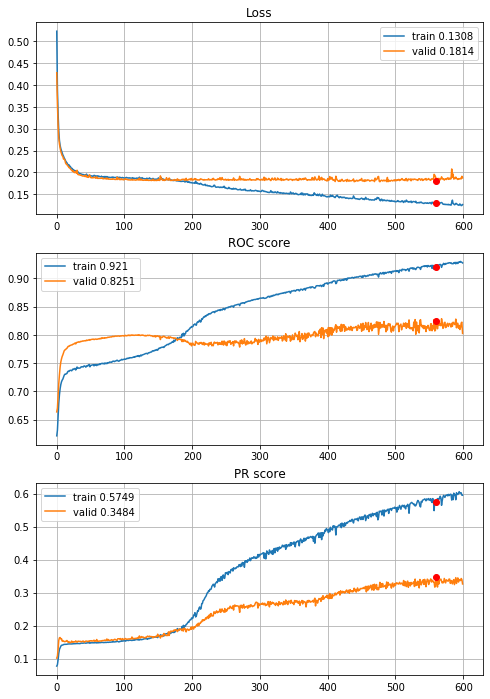


Fold 5------------------------------------------------------------


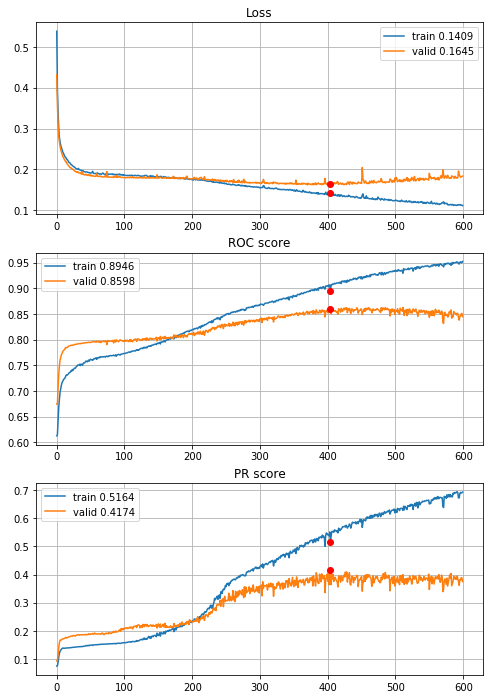


Fold 6------------------------------------------------------------


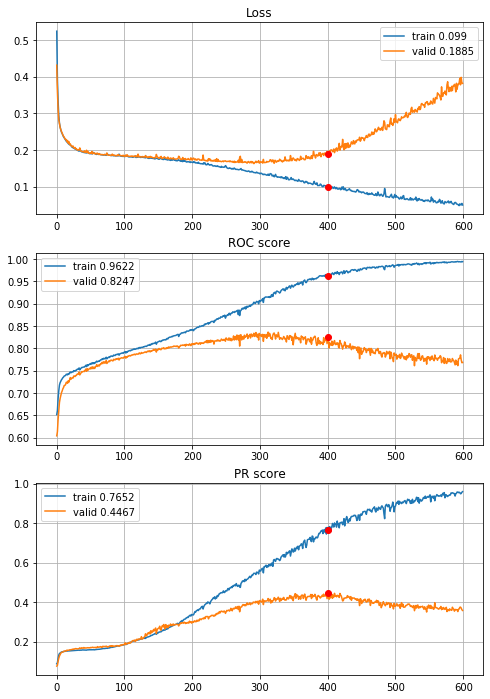

In [54]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L1_600ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets add dropout 0.2

In [52]:
def define_deep_CNN_2inc_std_L1_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 5.36s train loss: 0.5430219918103889, validation loss: 0.4351021788654236
Epoch: 2/600,
cumulative time: 6.9s train loss: 0.39432064114775434, validation loss: 0.35920198567064543
Epoch: 3/600,
cumulative time: 8.42s train loss: 0.3350256303180454, validation loss: 0.31212419512890244
Epoch: 4/600,
cumulative time: 9.96s train loss: 0.2971418418936877, validation loss: 0.2816159208466846
Epoch: 5/600,
cumulative time: 11.5s train loss: 0.2751955295451636, validation loss: 0.2692341657622969
Epoch: 6/600,
cumulative time: 13.04s train loss: 0.2662355845669026, validation loss: 0.2612735828710625
Epoch: 7/600,
cumulative time: 14.58s train loss: 0.2586216246109315, validation loss: 0.25547726611607413
Epoch: 8/600,
cumulative time: 16.1s train loss: 0.25368433650550054, validation loss: 0.2509333632120557
Epoch: 9/600,
cumulative time: 17.65s train loss: 0.24920496972838102, vali

Epoch: 76/600,
cumulative time: 120.44s train loss: 0.18781944035663928, validation loss: 0.19248546296800376
Epoch: 77/600,
cumulative time: 121.96s train loss: 0.18819853560356, validation loss: 0.19517938730828693
Epoch: 78/600,
cumulative time: 123.47s train loss: 0.18818003181522847, validation loss: 0.19289349698143965
Epoch: 79/600,
cumulative time: 124.97s train loss: 0.18817905596876347, validation loss: 0.19256504449088044
Epoch: 80/600,
cumulative time: 126.49s train loss: 0.18794092723277128, validation loss: 0.19208706310811377
Epoch: 81/600,
cumulative time: 128.0s train loss: 0.18643250677089804, validation loss: 0.19167068701077677
Epoch: 82/600,
cumulative time: 129.52s train loss: 0.18857294075717626, validation loss: 0.19160153482989278
Epoch: 83/600,
cumulative time: 131.03s train loss: 0.18668529798163716, validation loss: 0.19281052155426523
Epoch: 84/600,
cumulative time: 132.53s train loss: 0.18723553155709818, validation loss: 0.19361523314143947
Epoch: 85/600,

Epoch: 151/600,
cumulative time: 234.2s train loss: 0.176622770327923, validation loss: 0.18337799125865173
Epoch: 152/600,
cumulative time: 235.83s train loss: 0.17798983911946506, validation loss: 0.1850424876640734
Epoch: 153/600,
cumulative time: 237.4s train loss: 0.17864365329230072, validation loss: 0.1818259800064718
Epoch: 154/600,
cumulative time: 238.93s train loss: 0.17741981876427318, validation loss: 0.18136229916362231
Epoch: 155/600,
cumulative time: 240.47s train loss: 0.17651903634376231, validation loss: 0.1812949016172923
Epoch: 156/600,
cumulative time: 242.02s train loss: 0.17928975323971297, validation loss: 0.18436233878866032
Epoch: 157/600,
cumulative time: 243.54s train loss: 0.1779266849178458, validation loss: 0.1809722403428277
Epoch: 158/600,
cumulative time: 245.07s train loss: 0.17675191775851137, validation loss: 0.1828206583827105
Epoch: 159/600,
cumulative time: 246.6s train loss: 0.17807674079009206, validation loss: 0.1843197026712867
Epoch: 160/60

Epoch: 226/600,
cumulative time: 349.28s train loss: 0.16487114163716549, validation loss: 0.17726538220256913
Epoch: 227/600,
cumulative time: 350.88s train loss: 0.16436689939077456, validation loss: 0.1816925983432201
Epoch: 228/600,
cumulative time: 352.4s train loss: 0.1671840841769685, validation loss: 0.17852877718482071
Epoch: 229/600,
cumulative time: 353.93s train loss: 0.16483915011239575, validation loss: 0.17674814152466026
Epoch: 230/600,
cumulative time: 355.49s train loss: 0.1621259836824749, validation loss: 0.17790050545949526
Epoch: 231/600,
cumulative time: 357.02s train loss: 0.16430005278977616, validation loss: 0.1808222920574892
Epoch: 232/600,
cumulative time: 358.54s train loss: 0.16665128002281362, validation loss: 0.17699221068697774
Epoch: 233/600,
cumulative time: 360.06s train loss: 0.16377195714889586, validation loss: 0.17674267074946565
Epoch: 234/600,
cumulative time: 361.59s train loss: 0.16596277759451153, validation loss: 0.17828474108096773
Epoch:

Epoch: 301/600,
cumulative time: 464.08s train loss: 0.14871185008615528, validation loss: 0.1806890936308446
Epoch: 302/600,
cumulative time: 465.61s train loss: 0.14993686933665515, validation loss: 0.17619097181085505
Epoch: 303/600,
cumulative time: 467.11s train loss: 0.14871327631580364, validation loss: 0.17714278761061622
Epoch: 304/600,
cumulative time: 468.63s train loss: 0.14778269673950678, validation loss: 0.17882728762290687
Epoch: 305/600,
cumulative time: 470.2s train loss: 0.1468030583632426, validation loss: 0.175521432521637
Epoch: 306/600,
cumulative time: 471.76s train loss: 0.1481771027174922, validation loss: 0.18473093077753416
Epoch: 307/600,
cumulative time: 473.26s train loss: 0.14758783424442834, validation loss: 0.1778284902472006
Epoch: 308/600,
cumulative time: 474.81s train loss: 0.15074063506346216, validation loss: 0.1801122374036346
Epoch: 309/600,
cumulative time: 476.32s train loss: 0.1501042143445922, validation loss: 0.1767053842098231
Epoch: 310/

Epoch: 376/600,
cumulative time: 578.57s train loss: 0.14157760433470148, validation loss: 0.18658440160946102
Epoch: 377/600,
cumulative time: 580.09s train loss: 0.13598626364394362, validation loss: 0.18061676767506998
Epoch: 378/600,
cumulative time: 581.63s train loss: 0.13443552607592552, validation loss: 0.1826805509094319
Epoch: 379/600,
cumulative time: 583.14s train loss: 0.13018869116636514, validation loss: 0.18188434592755656
Epoch: 380/600,
cumulative time: 584.65s train loss: 0.13417176356614977, validation loss: 0.18211600708872222
Epoch: 381/600,
cumulative time: 586.17s train loss: 0.1324091311795306, validation loss: 0.18217678457356537
Epoch: 382/600,
cumulative time: 587.7s train loss: 0.13204143557864445, validation loss: 0.1851547111695603
Epoch: 383/600,
cumulative time: 589.24s train loss: 0.12800839776306408, validation loss: 0.18790528038231347
Epoch: 384/600,
cumulative time: 590.83s train loss: 0.1289770871514474, validation loss: 0.1826026621442656
Epoch: 

Epoch: 451/600,
cumulative time: 693.13s train loss: 0.11741166057459067, validation loss: 0.19706546450813583
Epoch: 452/600,
cumulative time: 694.65s train loss: 0.11636080337686044, validation loss: 0.2052985764203062
Epoch: 453/600,
cumulative time: 696.16s train loss: 0.12201163457940194, validation loss: 0.19766563606189172
Epoch: 454/600,
cumulative time: 697.67s train loss: 0.11988247510532292, validation loss: 0.19343941452310068
Epoch: 455/600,
cumulative time: 699.21s train loss: 0.11650213798076568, validation loss: 0.1960313607126454
Epoch: 456/600,
cumulative time: 700.76s train loss: 0.11444190523003617, validation loss: 0.20338715909085686
Epoch: 457/600,
cumulative time: 702.3s train loss: 0.11417416146705639, validation loss: 0.20992553696655109
Epoch: 458/600,
cumulative time: 703.81s train loss: 0.11286342882678212, validation loss: 0.2014819857435538
Epoch: 459/600,
cumulative time: 705.31s train loss: 0.12023757421566943, validation loss: 0.20026085235132823
Epoch

Epoch: 526/600,
cumulative time: 807.41s train loss: 0.10561097784968045, validation loss: 0.22128359318144716
Epoch: 527/600,
cumulative time: 808.94s train loss: 0.10580866493870156, validation loss: 0.23135317374119715
Epoch: 528/600,
cumulative time: 810.47s train loss: 0.10170699607306437, validation loss: 0.23993358504942602
Epoch: 529/600,
cumulative time: 812.01s train loss: 0.10048191765827816, validation loss: 0.2358175290633092
Epoch: 530/600,
cumulative time: 813.52s train loss: 0.09923204508510254, validation loss: 0.24342157469061948
Epoch: 531/600,
cumulative time: 815.05s train loss: 0.09844442506069775, validation loss: 0.23411259424369946
Epoch: 532/600,
cumulative time: 816.58s train loss: 0.0993287665397842, validation loss: 0.24713460414323618
Epoch: 533/600,
cumulative time: 818.1s train loss: 0.10191566468575793, validation loss: 0.2389600796712508
Epoch: 534/600,
cumulative time: 819.62s train loss: 0.10186767646715392, validation loss: 0.23068700248972748
Epoch

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.44s train loss: 0.5480342474447095, validation loss: 0.4438929773253434
Epoch: 2/600,
cumulative time: 5.99s train loss: 0.39505719518395255, validation loss: 0.3636606822133957
Epoch: 3/600,
cumulative time: 7.53s train loss: 0.3368746927676434, validation loss: 0.31273465863777067
Epoch: 4/600,
cumulative time: 9.08s train loss: 0.2964955761137831, validation loss: 0.2819614358464417
Epoch: 5/600,
cumulative time: 10.63s train loss: 0.272939230300548, validation loss: 0.26780979712655384
Epoch: 6/600,
cumulative time: 12.16s train loss: 0.26285684030808953, validation loss: 0.259166393345355
Epoch: 7/600,
cumulative time: 13.69s train loss: 0.25542837754957326, validation loss: 0.25476040733233857
Epoch: 8/600,
cumulative time: 15.23s train loss: 0.2508400523433662, validation loss: 0.24873451179513484
Epoch: 9/600,
cumulative time: 16.77s train loss: 0.2457604102245488, validation loss: 0.24481405916264

Epoch: 77/600,
cumulative time: 121.66s train loss: 0.1897178173397991, validation loss: 0.19029602880093255
Epoch: 78/600,
cumulative time: 123.2s train loss: 0.18880905080690674, validation loss: 0.19312388380422651
Epoch: 79/600,
cumulative time: 124.72s train loss: 0.19088501380620787, validation loss: 0.19047001146231482
Epoch: 80/600,
cumulative time: 126.24s train loss: 0.19003952029256913, validation loss: 0.19301323421233524
Epoch: 81/600,
cumulative time: 127.75s train loss: 0.19034144429668295, validation loss: 0.19051908462773057
Epoch: 82/600,
cumulative time: 129.27s train loss: 0.1896578750151892, validation loss: 0.19000661557754583
Epoch: 83/600,
cumulative time: 130.78s train loss: 0.19052004769503314, validation loss: 0.19253758666181012
Epoch: 84/600,
cumulative time: 132.31s train loss: 0.1895617450532026, validation loss: 0.19208550471444777
Epoch: 85/600,
cumulative time: 133.84s train loss: 0.19285221375960282, validation loss: 0.1903009834725326
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 237.5s train loss: 0.1811676668111008, validation loss: 0.1867018151518599
Epoch: 153/600,
cumulative time: 239.01s train loss: 0.18073986367407863, validation loss: 0.18650603050922682
Epoch: 154/600,
cumulative time: 240.55s train loss: 0.17989393622474548, validation loss: 0.18698307490413735
Epoch: 155/600,
cumulative time: 242.08s train loss: 0.18102020683964576, validation loss: 0.18684851550138915
Epoch: 156/600,
cumulative time: 243.61s train loss: 0.18083452651193221, validation loss: 0.1866425437392468
Epoch: 157/600,
cumulative time: 245.12s train loss: 0.18097906471735511, validation loss: 0.18689634915190217
Epoch: 158/600,
cumulative time: 246.64s train loss: 0.1805771126294029, validation loss: 0.18685973590332444
Epoch: 159/600,
cumulative time: 248.17s train loss: 0.1819661202932206, validation loss: 0.1867164440752293
Epoch: 160/600,
cumulative time: 249.71s train loss: 0.18070563487683203, validation loss: 0.1867013514305638
Epoch: 16

Epoch: 227/600,
cumulative time: 352.68s train loss: 0.17168010212201992, validation loss: 0.18313190758918077
Epoch: 228/600,
cumulative time: 354.22s train loss: 0.1721488987431123, validation loss: 0.1847538061394344
Epoch: 229/600,
cumulative time: 355.72s train loss: 0.17195979217109214, validation loss: 0.1831732516876283
Epoch: 230/600,
cumulative time: 357.25s train loss: 0.17050437356078882, validation loss: 0.18441767254153266
Epoch: 231/600,
cumulative time: 358.76s train loss: 0.17071770277697693, validation loss: 0.18379336540759056
Epoch: 232/600,
cumulative time: 360.28s train loss: 0.170905716773049, validation loss: 0.18472905581787868
Epoch: 233/600,
cumulative time: 361.79s train loss: 0.17064354648167018, validation loss: 0.18524047264726573
Epoch: 234/600,
cumulative time: 363.3s train loss: 0.17026108580455132, validation loss: 0.18357946158185795
Epoch: 235/600,
cumulative time: 364.82s train loss: 0.16972071634120778, validation loss: 0.18433596190747312
Epoch: 

Epoch: 302/600,
cumulative time: 467.5s train loss: 0.16145143721236951, validation loss: 0.18685108499311118
Epoch: 303/600,
cumulative time: 469.04s train loss: 0.16076597624540687, validation loss: 0.18739974156904576
Epoch: 304/600,
cumulative time: 470.63s train loss: 0.1631086607135545, validation loss: 0.18876026783815608
Epoch: 305/600,
cumulative time: 472.16s train loss: 0.16409291159379358, validation loss: 0.18825565064497105
Epoch: 306/600,
cumulative time: 473.7s train loss: 0.16036557928427808, validation loss: 0.18871455550842986
Epoch: 307/600,
cumulative time: 475.25s train loss: 0.1581070230494772, validation loss: 0.19579850067241894
Epoch: 308/600,
cumulative time: 476.79s train loss: 0.16458771621216614, validation loss: 0.18783422435238867
Epoch: 309/600,
cumulative time: 478.42s train loss: 0.16039694449962622, validation loss: 0.18887466335272285
Epoch: 310/600,
cumulative time: 479.99s train loss: 0.15943045387366447, validation loss: 0.18800324484594344
Epoch

Epoch: 377/600,
cumulative time: 582.77s train loss: 0.14943081731044935, validation loss: 0.20117634944643106
Epoch: 378/600,
cumulative time: 584.3s train loss: 0.15032088080398007, validation loss: 0.20051181889497316
Epoch: 379/600,
cumulative time: 585.83s train loss: 0.15036268025153698, validation loss: 0.19954836700261247
Epoch: 380/600,
cumulative time: 587.35s train loss: 0.14835858285167344, validation loss: 0.20168185329421026
Epoch: 381/600,
cumulative time: 588.89s train loss: 0.1473419543355196, validation loss: 0.20123864120979387
Epoch: 382/600,
cumulative time: 590.41s train loss: 0.14862331685810637, validation loss: 0.20780843987279882
Epoch: 383/600,
cumulative time: 591.93s train loss: 0.15184254363741323, validation loss: 0.20083544196889383
Epoch: 384/600,
cumulative time: 593.45s train loss: 0.14784780973255285, validation loss: 0.2004363130273423
Epoch: 385/600,
cumulative time: 594.95s train loss: 0.14591157788657597, validation loss: 0.20252955382863544
Epoc

Epoch: 452/600,
cumulative time: 698.2s train loss: 0.13855834276470325, validation loss: 0.21256920717621108
Epoch: 453/600,
cumulative time: 699.71s train loss: 0.14533306967939388, validation loss: 0.2149557267791808
Epoch: 454/600,
cumulative time: 701.22s train loss: 0.14114783270010325, validation loss: 0.224674715678898
Epoch: 455/600,
cumulative time: 702.71s train loss: 0.13710335338211474, validation loss: 0.21411623752506675
Epoch: 456/600,
cumulative time: 704.24s train loss: 0.1368065748770101, validation loss: 0.21529980332491105
Epoch: 457/600,
cumulative time: 705.76s train loss: 0.13970951743887633, validation loss: 0.21357509738292071
Epoch: 458/600,
cumulative time: 707.26s train loss: 0.13583702349409524, validation loss: 0.21486347827520233
Epoch: 459/600,
cumulative time: 708.77s train loss: 0.13909310780249481, validation loss: 0.22224832835896963
Epoch: 460/600,
cumulative time: 710.35s train loss: 0.1376750150881378, validation loss: 0.2214240178394837
Epoch: 4

Epoch: 527/600,
cumulative time: 812.17s train loss: 0.12876664980257724, validation loss: 0.24407642784574715
Epoch: 528/600,
cumulative time: 813.73s train loss: 0.13078657502591828, validation loss: 0.2360197806070255
Epoch: 529/600,
cumulative time: 815.26s train loss: 0.13349738496494085, validation loss: 0.23491302602261893
Epoch: 530/600,
cumulative time: 816.75s train loss: 0.13057653012367257, validation loss: 0.23691179034781343
Epoch: 531/600,
cumulative time: 818.27s train loss: 0.12790285795825582, validation loss: 0.23868350174412425
Epoch: 532/600,
cumulative time: 819.78s train loss: 0.1262289633908227, validation loss: 0.23597801756177167
Epoch: 533/600,
cumulative time: 821.28s train loss: 0.1257192508090375, validation loss: 0.23323121372739664
Epoch: 534/600,
cumulative time: 822.78s train loss: 0.13094899902835816, validation loss: 0.24609415342687668
Epoch: 535/600,
cumulative time: 824.28s train loss: 0.12894050203680782, validation loss: 0.23718331956068134
Epoc

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.98s train loss: 0.5349956176455658, validation loss: 0.4370326017181106
Epoch: 2/600,
cumulative time: 6.55s train loss: 0.3946463038563225, validation loss: 0.35853234793638356
Epoch: 3/600,
cumulative time: 8.13s train loss: 0.33536088926889873, validation loss: 0.31073368946819424
Epoch: 4/600,
cumulative time: 9.67s train loss: 0.2950800181198198, validation loss: 0.28102232835339885
Epoch: 5/600,
cumulative time: 11.24s train loss: 0.27335555313491666, validation loss: 0.26872743265494103
Epoch: 6/600,
cumulative time: 12.81s train loss: 0.26237937372142833, validation loss: 0.2608136901488671
Epoch: 7/600,
cumulative time: 14.36s train loss: 0.25648921822699605, validation loss: 0.25559465784942154
Epoch: 8/600,
cumulative time: 15.92s train loss: 0.24966266747636626, validation loss: 0.2515356820850165
Epoch: 9/600,
cumulative time: 17.48s train loss: 0.24522528125790732, validation loss: 0.24784776

Epoch: 77/600,
cumulative time: 123.29s train loss: 0.18791886954286127, validation loss: 0.19690773279550045
Epoch: 78/600,
cumulative time: 124.84s train loss: 0.18813951723414546, validation loss: 0.19753135064169206
Epoch: 79/600,
cumulative time: 126.39s train loss: 0.1882363003816232, validation loss: 0.1974399459451295
Epoch: 80/600,
cumulative time: 127.95s train loss: 0.18691125470522427, validation loss: 0.19690076902336293
Epoch: 81/600,
cumulative time: 129.49s train loss: 0.18703767150157513, validation loss: 0.1973655430880268
Epoch: 82/600,
cumulative time: 131.02s train loss: 0.1872158365525294, validation loss: 0.19684829409224716
Epoch: 83/600,
cumulative time: 132.57s train loss: 0.18711154209354763, validation loss: 0.19664936481770243
Epoch: 84/600,
cumulative time: 134.13s train loss: 0.18824837987005394, validation loss: 0.19890574093494715
Epoch: 85/600,
cumulative time: 135.7s train loss: 0.18833959132258418, validation loss: 0.19661281600219202
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 241.51s train loss: 0.1824923789129422, validation loss: 0.19347221046747035
Epoch: 153/600,
cumulative time: 243.21s train loss: 0.18261062382564028, validation loss: 0.1939568104104496
Epoch: 154/600,
cumulative time: 244.83s train loss: 0.18113186604078405, validation loss: 0.19662788572199413
Epoch: 155/600,
cumulative time: 246.45s train loss: 0.1841772712029473, validation loss: 0.19565077167615508
Epoch: 156/600,
cumulative time: 248.05s train loss: 0.18284076710382405, validation loss: 0.1982149359744126
Epoch: 157/600,
cumulative time: 249.68s train loss: 0.18232869056229628, validation loss: 0.19557480542452016
Epoch: 158/600,
cumulative time: 251.32s train loss: 0.18259727865473768, validation loss: 0.19554944478426764
Epoch: 159/600,
cumulative time: 252.97s train loss: 0.18068329254085388, validation loss: 0.1942826056760375
Epoch: 160/600,
cumulative time: 254.61s train loss: 0.18069477211498816, validation loss: 0.1938956864558571
Epoch: 

Epoch: 227/600,
cumulative time: 363.26s train loss: 0.17275847167884656, validation loss: 0.18965908263190576
Epoch: 228/600,
cumulative time: 364.89s train loss: 0.17274633344315093, validation loss: 0.1878637418384208
Epoch: 229/600,
cumulative time: 366.53s train loss: 0.17350042273583308, validation loss: 0.19326831096082095
Epoch: 230/600,
cumulative time: 368.14s train loss: 0.1727509495714583, validation loss: 0.18839412454929053
Epoch: 231/600,
cumulative time: 369.69s train loss: 0.17160238796799673, validation loss: 0.18780883330118908
Epoch: 232/600,
cumulative time: 371.23s train loss: 0.1714781127463208, validation loss: 0.1897814544875091
Epoch: 233/600,
cumulative time: 372.78s train loss: 0.1714609909772743, validation loss: 0.18787149904413722
Epoch: 234/600,
cumulative time: 374.41s train loss: 0.1725992899706168, validation loss: 0.1894226624009721
Epoch: 235/600,
cumulative time: 375.98s train loss: 0.17179976603497962, validation loss: 0.1881051621037815
Epoch: 23

Epoch: 302/600,
cumulative time: 480.88s train loss: 0.1645929903343947, validation loss: 0.19847813828856545
Epoch: 303/600,
cumulative time: 482.46s train loss: 0.16858120652451658, validation loss: 0.18541114661180705
Epoch: 304/600,
cumulative time: 484.03s train loss: 0.167216641174729, validation loss: 0.1869950367326717
Epoch: 305/600,
cumulative time: 485.6s train loss: 0.16520125748967338, validation loss: 0.1862475803772392
Epoch: 306/600,
cumulative time: 487.19s train loss: 0.1638276103367017, validation loss: 0.1959249969442496
Epoch: 307/600,
cumulative time: 488.76s train loss: 0.16618715667211603, validation loss: 0.19155782618394426
Epoch: 308/600,
cumulative time: 490.32s train loss: 0.1644474894333954, validation loss: 0.1855779273563538
Epoch: 309/600,
cumulative time: 491.87s train loss: 0.1631394575621279, validation loss: 0.18737482666522975
Epoch: 310/600,
cumulative time: 493.42s train loss: 0.16274735377803415, validation loss: 0.1896196453749038
Epoch: 311/60

Epoch: 377/600,
cumulative time: 597.75s train loss: 0.155114224213809, validation loss: 0.18751829581612872
Epoch: 378/600,
cumulative time: 599.33s train loss: 0.1553220846125204, validation loss: 0.18716517766370833
Epoch: 379/600,
cumulative time: 600.9s train loss: 0.15345489595861084, validation loss: 0.1917373641584908
Epoch: 380/600,
cumulative time: 602.51s train loss: 0.15361526172370202, validation loss: 0.19156608777722994
Epoch: 381/600,
cumulative time: 604.09s train loss: 0.15434060978025796, validation loss: 0.1888623868449356
Epoch: 382/600,
cumulative time: 605.67s train loss: 0.15417456025610043, validation loss: 0.1918371447074811
Epoch: 383/600,
cumulative time: 607.23s train loss: 0.15215708740511139, validation loss: 0.18989139375352307
Epoch: 384/600,
cumulative time: 608.77s train loss: 0.1536694060527595, validation loss: 0.18852477188496625
Epoch: 385/600,
cumulative time: 610.35s train loss: 0.153504946489401, validation loss: 0.18875964064026787
Epoch: 386/

Epoch: 452/600,
cumulative time: 714.95s train loss: 0.143109213410144, validation loss: 0.2023887564691254
Epoch: 453/600,
cumulative time: 716.58s train loss: 0.14248751411520133, validation loss: 0.1933856907144057
Epoch: 454/600,
cumulative time: 718.15s train loss: 0.1459627171457585, validation loss: 0.21112923688268564
Epoch: 455/600,
cumulative time: 719.73s train loss: 0.14696269396636202, validation loss: 0.19627569917110135
Epoch: 456/600,
cumulative time: 721.31s train loss: 0.1421383411406529, validation loss: 0.1946102283169738
Epoch: 457/600,
cumulative time: 722.92s train loss: 0.1425476042379009, validation loss: 0.19761972035008113
Epoch: 458/600,
cumulative time: 724.45s train loss: 0.1426698410769144, validation loss: 0.1980763567780215
Epoch: 459/600,
cumulative time: 726.01s train loss: 0.14225100464007842, validation loss: 0.19675715788032344
Epoch: 460/600,
cumulative time: 727.56s train loss: 0.14133378724428966, validation loss: 0.20322215165549837
Epoch: 461/

Epoch: 527/600,
cumulative time: 833.46s train loss: 0.13685954984236393, validation loss: 0.20360812386580274
Epoch: 528/600,
cumulative time: 835.12s train loss: 0.1341727546384642, validation loss: 0.2093003491831118
Epoch: 529/600,
cumulative time: 836.78s train loss: 0.13293156802175352, validation loss: 0.20458223238090337
Epoch: 530/600,
cumulative time: 838.39s train loss: 0.13229590815499712, validation loss: 0.21576760959836233
Epoch: 531/600,
cumulative time: 839.97s train loss: 0.13379936234577303, validation loss: 0.20986578824002375
Epoch: 532/600,
cumulative time: 841.54s train loss: 0.1326170481399491, validation loss: 0.20314440232624886
Epoch: 533/600,
cumulative time: 843.13s train loss: 0.12987801812291877, validation loss: 0.20320112737487822
Epoch: 534/600,
cumulative time: 844.66s train loss: 0.12934132166086093, validation loss: 0.21761482207445648
Epoch: 535/600,
cumulative time: 846.22s train loss: 0.13289093536677518, validation loss: 0.2090057740006989
Epoch

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.8s train loss: 0.5379300328540035, validation loss: 0.43529631624504206
Epoch: 2/600,
cumulative time: 6.4s train loss: 0.3940672543471603, validation loss: 0.3587541790581464
Epoch: 3/600,
cumulative time: 8.01s train loss: 0.3354871082529943, validation loss: 0.3092599531839785
Epoch: 4/600,
cumulative time: 9.62s train loss: 0.2964877527383178, validation loss: 0.2789179849089044
Epoch: 5/600,
cumulative time: 11.21s train loss: 0.27448582950785166, validation loss: 0.26598622662587745
Epoch: 6/600,
cumulative time: 12.81s train loss: 0.2637925810678671, validation loss: 0.25769008924313513
Epoch: 7/600,
cumulative time: 14.41s train loss: 0.2576869074267911, validation loss: 0.25054351870830244
Epoch: 8/600,
cumulative time: 16.0s train loss: 0.25237255418769805, validation loss: 0.2457927290459244
Epoch: 9/600,
cumulative time: 17.59s train loss: 0.24862203938295743, validation loss: 0.241489707104927

Epoch: 77/600,
cumulative time: 125.51s train loss: 0.19122877237088315, validation loss: 0.18804110740828142
Epoch: 78/600,
cumulative time: 127.12s train loss: 0.19057314222277502, validation loss: 0.18710039646305787
Epoch: 79/600,
cumulative time: 128.75s train loss: 0.19042049369864936, validation loss: 0.18744421786317378
Epoch: 80/600,
cumulative time: 130.32s train loss: 0.18910655812348298, validation loss: 0.18683214785900143
Epoch: 81/600,
cumulative time: 131.92s train loss: 0.18928992872656683, validation loss: 0.18675586724256965
Epoch: 82/600,
cumulative time: 133.49s train loss: 0.18966918812368896, validation loss: 0.18714728132853953
Epoch: 83/600,
cumulative time: 135.07s train loss: 0.18929239736782924, validation loss: 0.18677860459882115
Epoch: 84/600,
cumulative time: 136.63s train loss: 0.19045182866725807, validation loss: 0.188523904675931
Epoch: 85/600,
cumulative time: 138.21s train loss: 0.18962362243249925, validation loss: 0.18684845413173276
Epoch: 86/60

Epoch: 152/600,
cumulative time: 244.07s train loss: 0.17849261094613733, validation loss: 0.18464164428762875
Epoch: 153/600,
cumulative time: 245.74s train loss: 0.17970704022365258, validation loss: 0.18377362520334428
Epoch: 154/600,
cumulative time: 247.36s train loss: 0.1778852422580267, validation loss: 0.19536606078857138
Epoch: 155/600,
cumulative time: 249.0s train loss: 0.18132280749609372, validation loss: 0.18367820201153817
Epoch: 156/600,
cumulative time: 250.58s train loss: 0.17587721803589965, validation loss: 0.18624348604735913
Epoch: 157/600,
cumulative time: 252.18s train loss: 0.17860524369352734, validation loss: 0.18385150476813397
Epoch: 158/600,
cumulative time: 253.77s train loss: 0.17719792706244294, validation loss: 0.1836317469162386
Epoch: 159/600,
cumulative time: 255.37s train loss: 0.17644950217639296, validation loss: 0.18460231874368888
Epoch: 160/600,
cumulative time: 256.95s train loss: 0.17522807151229347, validation loss: 0.1827858389641169
Epoch

Epoch: 227/600,
cumulative time: 363.93s train loss: 0.16863757643017152, validation loss: 0.17818001931098304
Epoch: 228/600,
cumulative time: 365.55s train loss: 0.16843594443781018, validation loss: 0.1793767486485273
Epoch: 229/600,
cumulative time: 367.16s train loss: 0.16815206865499377, validation loss: 0.17890613291278187
Epoch: 230/600,
cumulative time: 368.8s train loss: 0.16828012882640409, validation loss: 0.17916389941722866
Epoch: 231/600,
cumulative time: 370.37s train loss: 0.16763015463998981, validation loss: 0.17870673218740746
Epoch: 232/600,
cumulative time: 371.96s train loss: 0.1688737029436254, validation loss: 0.18116422281572006
Epoch: 233/600,
cumulative time: 373.55s train loss: 0.1712824798187962, validation loss: 0.17737544187483453
Epoch: 234/600,
cumulative time: 375.15s train loss: 0.17115166338306997, validation loss: 0.17848516324087418
Epoch: 235/600,
cumulative time: 376.73s train loss: 0.16743932091725486, validation loss: 0.17825578517293833
Epoch

Epoch: 302/600,
cumulative time: 483.32s train loss: 0.149967409028079, validation loss: 0.17285668675472657
Epoch: 303/600,
cumulative time: 484.95s train loss: 0.15238041472921218, validation loss: 0.17645794834873155
Epoch: 304/600,
cumulative time: 486.58s train loss: 0.15327507728462436, validation loss: 0.17341074380970392
Epoch: 305/600,
cumulative time: 488.24s train loss: 0.15131269823736965, validation loss: 0.17338374747030585
Epoch: 306/600,
cumulative time: 489.83s train loss: 0.14917992349766296, validation loss: 0.17434931574344958
Epoch: 307/600,
cumulative time: 491.42s train loss: 0.14979973890777182, validation loss: 0.18399840094265765
Epoch: 308/600,
cumulative time: 493.02s train loss: 0.14987347513360158, validation loss: 0.17174593950105085
Epoch: 309/600,
cumulative time: 494.63s train loss: 0.1491932391807849, validation loss: 0.18004441373887073
Epoch: 310/600,
cumulative time: 496.22s train loss: 0.15209237322055008, validation loss: 0.18105383560193322
Epoc

Epoch: 377/600,
cumulative time: 603.06s train loss: 0.13598420716701404, validation loss: 0.17356748359596105
Epoch: 378/600,
cumulative time: 604.68s train loss: 0.13371265684569644, validation loss: 0.1931038105402616
Epoch: 379/600,
cumulative time: 606.3s train loss: 0.13881672334053302, validation loss: 0.17612908067469535
Epoch: 380/600,
cumulative time: 607.93s train loss: 0.1335328466744834, validation loss: 0.18002977788732358
Epoch: 381/600,
cumulative time: 609.56s train loss: 0.1390958628106731, validation loss: 0.17364599112956355
Epoch: 382/600,
cumulative time: 611.16s train loss: 0.13697866284561533, validation loss: 0.18369304368981218
Epoch: 383/600,
cumulative time: 612.76s train loss: 0.13503226974907256, validation loss: 0.17102957450467116
Epoch: 384/600,
cumulative time: 614.33s train loss: 0.13151973027425973, validation loss: 0.17431395867594737
Epoch: 385/600,
cumulative time: 615.91s train loss: 0.13262890201672276, validation loss: 0.17621581278705856
Epoch

Epoch: 452/600,
cumulative time: 722.24s train loss: 0.12083240296581567, validation loss: 0.18775257774564666
Epoch: 453/600,
cumulative time: 723.85s train loss: 0.12015115164893046, validation loss: 0.17785658732492798
Epoch: 454/600,
cumulative time: 725.47s train loss: 0.12261139782381272, validation loss: 0.18395966794557359
Epoch: 455/600,
cumulative time: 727.1s train loss: 0.11852789278269366, validation loss: 0.1888978106684227
Epoch: 456/600,
cumulative time: 728.75s train loss: 0.11922634894924496, validation loss: 0.18220287233773666
Epoch: 457/600,
cumulative time: 730.34s train loss: 0.12120899583332126, validation loss: 0.190745271777847
Epoch: 458/600,
cumulative time: 731.94s train loss: 0.12036473092072733, validation loss: 0.1841528628089949
Epoch: 459/600,
cumulative time: 733.53s train loss: 0.12068420112940688, validation loss: 0.1903895895910393
Epoch: 460/600,
cumulative time: 735.13s train loss: 0.1194870443300608, validation loss: 0.17897121079768186
Epoch: 4

Epoch: 527/600,
cumulative time: 841.7s train loss: 0.10284516284726515, validation loss: 0.20698062238683498
Epoch: 528/600,
cumulative time: 843.35s train loss: 0.10324693025660162, validation loss: 0.2194888357851601
Epoch: 529/600,
cumulative time: 844.98s train loss: 0.10317743130978975, validation loss: 0.2010118288905382
Epoch: 530/600,
cumulative time: 846.59s train loss: 0.10213490819169636, validation loss: 0.22790783999767977
Epoch: 531/600,
cumulative time: 848.22s train loss: 0.10754486113019622, validation loss: 0.22145007628823235
Epoch: 532/600,
cumulative time: 849.83s train loss: 0.10563197743843154, validation loss: 0.21102263021217552
Epoch: 533/600,
cumulative time: 851.44s train loss: 0.10126761555972029, validation loss: 0.20821817370399154
Epoch: 534/600,
cumulative time: 853.02s train loss: 0.10250396593993226, validation loss: 0.21473363975102272
Epoch: 535/600,
cumulative time: 854.6s train loss: 0.10459169381794416, validation loss: 0.20477538314946578
Epoch

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 5.19s train loss: 0.5535466364201378, validation loss: 0.43769753665462824
Epoch: 2/600,
cumulative time: 6.82s train loss: 0.3976844884536365, validation loss: 0.3570602276344715
Epoch: 3/600,
cumulative time: 8.47s train loss: 0.33760245477127354, validation loss: 0.3082756993312602
Epoch: 4/600,
cumulative time: 10.11s train loss: 0.29786614951939366, validation loss: 0.27808452935569616
Epoch: 5/600,
cumulative time: 11.73s train loss: 0.27819944376811745, validation loss: 0.2655155508086207
Epoch: 6/600,
cumulative time: 13.35s train loss: 0.2685875596766703, validation loss: 0.2568544822387215
Epoch: 7/600,
cumulative time: 15.0s train loss: 0.26049654634998126, validation loss: 0.24971857766445715
Epoch: 8/600,
cumulative time: 16.62s train loss: 0.2544155839083956, validation loss: 0.2460814836848659
Epoch: 9/600,
cumulative time: 18.25s train loss: 0.25097696537918907, validation loss: 0.24117861363

Epoch: 77/600,
cumulative time: 129.21s train loss: 0.1907544830501534, validation loss: 0.18340397224195645
Epoch: 78/600,
cumulative time: 130.83s train loss: 0.19052501353343912, validation loss: 0.18346569344035937
Epoch: 79/600,
cumulative time: 132.45s train loss: 0.19093002890660743, validation loss: 0.18285899223602436
Epoch: 80/600,
cumulative time: 134.07s train loss: 0.1914391230126287, validation loss: 0.18317101329402638
Epoch: 81/600,
cumulative time: 135.69s train loss: 0.19115351666828256, validation loss: 0.1833165814993492
Epoch: 82/600,
cumulative time: 137.3s train loss: 0.19091495938501715, validation loss: 0.1834112824186967
Epoch: 83/600,
cumulative time: 138.92s train loss: 0.18920468473664945, validation loss: 0.18281481549021983
Epoch: 84/600,
cumulative time: 140.62s train loss: 0.1903689802504573, validation loss: 0.18288125268282618
Epoch: 85/600,
cumulative time: 142.24s train loss: 0.19010874884272064, validation loss: 0.1841183788160862
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 251.5s train loss: 0.18065739971684994, validation loss: 0.18161643048804202
Epoch: 153/600,
cumulative time: 253.12s train loss: 0.17982336978198785, validation loss: 0.18391579692061655
Epoch: 154/600,
cumulative time: 254.75s train loss: 0.18106380172788059, validation loss: 0.1860276629148452
Epoch: 155/600,
cumulative time: 256.37s train loss: 0.18219604766836353, validation loss: 0.18495025493874537
Epoch: 156/600,
cumulative time: 258.01s train loss: 0.1785609702334165, validation loss: 0.18241768117171867
Epoch: 157/600,
cumulative time: 259.68s train loss: 0.17950176860739464, validation loss: 0.18193217673483597
Epoch: 158/600,
cumulative time: 261.33s train loss: 0.17825921587970653, validation loss: 0.18268413458029645
Epoch: 159/600,
cumulative time: 262.96s train loss: 0.17944173555829296, validation loss: 0.18469351367664597
Epoch: 160/600,
cumulative time: 264.58s train loss: 0.1784283272832762, validation loss: 0.18322304670752232
Epoch

Epoch: 227/600,
cumulative time: 373.9s train loss: 0.16284546115656823, validation loss: 0.17526053290113766
Epoch: 228/600,
cumulative time: 375.52s train loss: 0.1628608494481652, validation loss: 0.18021432714338848
Epoch: 229/600,
cumulative time: 377.15s train loss: 0.16383407624288257, validation loss: 0.1751748590199759
Epoch: 230/600,
cumulative time: 378.76s train loss: 0.1615007382316397, validation loss: 0.1767810736389511
Epoch: 231/600,
cumulative time: 380.37s train loss: 0.1599424984874224, validation loss: 0.1790590448259333
Epoch: 232/600,
cumulative time: 381.99s train loss: 0.16058208988796846, validation loss: 0.17509893131028728
Epoch: 233/600,
cumulative time: 383.61s train loss: 0.16019097338623342, validation loss: 0.1753505337425084
Epoch: 234/600,
cumulative time: 385.24s train loss: 0.15957917939782273, validation loss: 0.17729892693358482
Epoch: 235/600,
cumulative time: 386.87s train loss: 0.16008786114707815, validation loss: 0.17488052135673465
Epoch: 23

Epoch: 302/600,
cumulative time: 496.38s train loss: 0.14746646061012103, validation loss: 0.17782570673431947
Epoch: 303/600,
cumulative time: 498.01s train loss: 0.14694498156345487, validation loss: 0.17403056348701915
Epoch: 304/600,
cumulative time: 499.63s train loss: 0.14786275437868693, validation loss: 0.1791137540535316
Epoch: 305/600,
cumulative time: 501.25s train loss: 0.14793811270800747, validation loss: 0.1741748331799819
Epoch: 306/600,
cumulative time: 502.88s train loss: 0.15365580618097438, validation loss: 0.18965260855021204
Epoch: 307/600,
cumulative time: 504.5s train loss: 0.14979711006758714, validation loss: 0.1827253010276228
Epoch: 308/600,
cumulative time: 506.13s train loss: 0.14872929722898537, validation loss: 0.17537454688256704
Epoch: 309/600,
cumulative time: 507.76s train loss: 0.14476265422878118, validation loss: 0.17293777095524426
Epoch: 310/600,
cumulative time: 509.4s train loss: 0.14575554527472176, validation loss: 0.17640772405047508
Epoch:

Epoch: 377/600,
cumulative time: 619.23s train loss: 0.13773250686560712, validation loss: 0.184177005506179
Epoch: 378/600,
cumulative time: 620.86s train loss: 0.13350392242361972, validation loss: 0.18046649774835935
Epoch: 379/600,
cumulative time: 622.49s train loss: 0.13380728997411875, validation loss: 0.1850066109070661
Epoch: 380/600,
cumulative time: 624.11s train loss: 0.1328720159195607, validation loss: 0.18950000285533858
Epoch: 381/600,
cumulative time: 625.72s train loss: 0.13466473978645857, validation loss: 0.1825826469331736
Epoch: 382/600,
cumulative time: 627.37s train loss: 0.13241137029939942, validation loss: 0.1811101764075113
Epoch: 383/600,
cumulative time: 628.99s train loss: 0.13306362796899476, validation loss: 0.18172294120697624
Epoch: 384/600,
cumulative time: 630.64s train loss: 0.13459818572828583, validation loss: 0.180988047505432
Epoch: 385/600,
cumulative time: 632.27s train loss: 0.13311824385758514, validation loss: 0.18011693857427513
Epoch: 38

Epoch: 452/600,
cumulative time: 742.46s train loss: 0.12297508651329801, validation loss: 0.2202168718914245
Epoch: 453/600,
cumulative time: 744.1s train loss: 0.13672838507378413, validation loss: 0.19612985025147325
Epoch: 454/600,
cumulative time: 745.74s train loss: 0.12418735349725339, validation loss: 0.19271397543944196
Epoch: 455/600,
cumulative time: 747.37s train loss: 0.12213779569548719, validation loss: 0.19463267666604928
Epoch: 456/600,
cumulative time: 749.01s train loss: 0.12094887785719047, validation loss: 0.18972710136334317
Epoch: 457/600,
cumulative time: 750.65s train loss: 0.12194788095405354, validation loss: 0.2011735368448967
Epoch: 458/600,
cumulative time: 752.3s train loss: 0.13084641518781454, validation loss: 0.1960286591252774
Epoch: 459/600,
cumulative time: 753.93s train loss: 0.12371662919549575, validation loss: 0.184880811853045
Epoch: 460/600,
cumulative time: 755.57s train loss: 0.12233276504511927, validation loss: 0.19194535953715972
Epoch: 4

Epoch: 527/600,
cumulative time: 865.9s train loss: 0.11079195544147998, validation loss: 0.21671155641205628
Epoch: 528/600,
cumulative time: 867.57s train loss: 0.11203864228978656, validation loss: 0.2058152295141519
Epoch: 529/600,
cumulative time: 869.29s train loss: 0.1078485522078338, validation loss: 0.2049179691669077
Epoch: 530/600,
cumulative time: 871.01s train loss: 0.1112860674971881, validation loss: 0.21233418689436745
Epoch: 531/600,
cumulative time: 872.71s train loss: 0.11257159954630862, validation loss: 0.20673482138308258
Epoch: 532/600,
cumulative time: 874.34s train loss: 0.11078820473358263, validation loss: 0.20494336133431998
Epoch: 533/600,
cumulative time: 875.97s train loss: 0.10981749112805056, validation loss: 0.20874521960517042
Epoch: 534/600,
cumulative time: 877.6s train loss: 0.1112634710184337, validation loss: 0.2068876460681819
Epoch: 535/600,
cumulative time: 879.34s train loss: 0.10752766415241433, validation loss: 0.20418903262072752
Epoch: 53

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 4.75s train loss: 0.5390509570784429, validation loss: 0.4389175412927726
Epoch: 2/600,
cumulative time: 6.41s train loss: 0.39380273536204774, validation loss: 0.35927386902658426
Epoch: 3/600,
cumulative time: 8.07s train loss: 0.33374274882420996, validation loss: 0.311987220956779
Epoch: 4/600,
cumulative time: 9.72s train loss: 0.29328832894661067, validation loss: 0.28312945564858594
Epoch: 5/600,
cumulative time: 11.38s train loss: 0.2753023619850801, validation loss: 0.27166720895903634
Epoch: 6/600,
cumulative time: 13.04s train loss: 0.2642737393935002, validation loss: 0.26214373670010865
Epoch: 7/600,
cumulative time: 14.69s train loss: 0.25668872760564154, validation loss: 0.2564144455688201
Epoch: 8/600,
cumulative time: 16.34s train loss: 0.25136701586962656, validation loss: 0.25140509346363005
Epoch: 9/600,
cumulative time: 17.99s train loss: 0.2478712801507031, validation loss: 0.2486618066

Epoch: 77/600,
cumulative time: 131.13s train loss: 0.18943503149632923, validation loss: 0.18684732296811138
Epoch: 78/600,
cumulative time: 132.79s train loss: 0.18772788749995575, validation loss: 0.18642003700258947
Epoch: 79/600,
cumulative time: 134.44s train loss: 0.18816740443211755, validation loss: 0.18630417269890576
Epoch: 80/600,
cumulative time: 136.1s train loss: 0.18781579895785042, validation loss: 0.1859421342895531
Epoch: 81/600,
cumulative time: 137.78s train loss: 0.1871264463043031, validation loss: 0.1861417678867439
Epoch: 82/600,
cumulative time: 139.44s train loss: 0.18706257625083259, validation loss: 0.18626737795587456
Epoch: 83/600,
cumulative time: 141.1s train loss: 0.18759604633130408, validation loss: 0.18776173550605124
Epoch: 84/600,
cumulative time: 142.77s train loss: 0.187563557735764, validation loss: 0.18666559364392907
Epoch: 85/600,
cumulative time: 144.44s train loss: 0.18599239515631677, validation loss: 0.18566640295920644
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 255.63s train loss: 0.18103617679709183, validation loss: 0.17985471843536283
Epoch: 153/600,
cumulative time: 257.29s train loss: 0.18060910885175588, validation loss: 0.18025466909363094
Epoch: 154/600,
cumulative time: 258.96s train loss: 0.18521338719509395, validation loss: 0.18277657742558773
Epoch: 155/600,
cumulative time: 260.62s train loss: 0.1826753891306505, validation loss: 0.18022411174524058
Epoch: 156/600,
cumulative time: 262.27s train loss: 0.18071334040064307, validation loss: 0.18035315681624478
Epoch: 157/600,
cumulative time: 263.94s train loss: 0.18164502624381731, validation loss: 0.17970167743981047
Epoch: 158/600,
cumulative time: 265.59s train loss: 0.1799637923313382, validation loss: 0.17977228789141134
Epoch: 159/600,
cumulative time: 267.26s train loss: 0.18076529892766138, validation loss: 0.1806739757918532
Epoch: 160/600,
cumulative time: 268.93s train loss: 0.18265482724475834, validation loss: 0.1803020179799532
Epoch

Epoch: 227/600,
cumulative time: 380.3s train loss: 0.17251857632694031, validation loss: 0.1816656017214141
Epoch: 228/600,
cumulative time: 381.96s train loss: 0.17458642178574224, validation loss: 0.18221103371570155
Epoch: 229/600,
cumulative time: 383.64s train loss: 0.17403436990653637, validation loss: 0.17601575564379912
Epoch: 230/600,
cumulative time: 385.3s train loss: 0.17180745436329078, validation loss: 0.17625146882979031
Epoch: 231/600,
cumulative time: 387.03s train loss: 0.17213365932711458, validation loss: 0.1758012140235719
Epoch: 232/600,
cumulative time: 388.7s train loss: 0.1707884115319139, validation loss: 0.17502793405783598
Epoch: 233/600,
cumulative time: 390.35s train loss: 0.16951305567325461, validation loss: 0.1753591201001682
Epoch: 234/600,
cumulative time: 392.0s train loss: 0.1708205580419185, validation loss: 0.17495708311692246
Epoch: 235/600,
cumulative time: 393.68s train loss: 0.17116434129121386, validation loss: 0.17671083443739757
Epoch: 236

Epoch: 302/600,
cumulative time: 505.28s train loss: 0.1502006079956954, validation loss: 0.16617889925634505
Epoch: 303/600,
cumulative time: 506.92s train loss: 0.14756635429585163, validation loss: 0.1662688649967516
Epoch: 304/600,
cumulative time: 508.58s train loss: 0.14529465313205467, validation loss: 0.16569737428215608
Epoch: 305/600,
cumulative time: 510.23s train loss: 0.14589519919888452, validation loss: 0.16593063141572054
Epoch: 306/600,
cumulative time: 511.88s train loss: 0.145630193076833, validation loss: 0.16631800427586246
Epoch: 307/600,
cumulative time: 513.53s train loss: 0.1475178918482691, validation loss: 0.1715613052005339
Epoch: 308/600,
cumulative time: 515.17s train loss: 0.1467041945681463, validation loss: 0.16734094231589938
Epoch: 309/600,
cumulative time: 516.83s train loss: 0.1465451095967446, validation loss: 0.17092492498396528
Epoch: 310/600,
cumulative time: 518.47s train loss: 0.14894848022090518, validation loss: 0.16424449831653357
Epoch: 31

Epoch: 377/600,
cumulative time: 630.03s train loss: 0.1308460989195959, validation loss: 0.16950205810956798
Epoch: 378/600,
cumulative time: 631.71s train loss: 0.12918789405172817, validation loss: 0.1687954903785799
Epoch: 379/600,
cumulative time: 633.36s train loss: 0.13281911994231163, validation loss: 0.16739050193362404
Epoch: 380/600,
cumulative time: 635.02s train loss: 0.1299096302825284, validation loss: 0.17330830590926333
Epoch: 381/600,
cumulative time: 636.69s train loss: 0.13319807488893307, validation loss: 0.1704004474938403
Epoch: 382/600,
cumulative time: 638.36s train loss: 0.12872348091725366, validation loss: 0.1761506287335375
Epoch: 383/600,
cumulative time: 640.01s train loss: 0.12552168227788993, validation loss: 0.16654719785870908
Epoch: 384/600,
cumulative time: 641.65s train loss: 0.13212650986327454, validation loss: 0.16928065271809575
Epoch: 385/600,
cumulative time: 643.32s train loss: 0.12968491045616096, validation loss: 0.17161500192062082
Epoch:

Epoch: 452/600,
cumulative time: 754.21s train loss: 0.11814028664425112, validation loss: 0.1781215826886876
Epoch: 453/600,
cumulative time: 755.86s train loss: 0.11955292946567722, validation loss: 0.17988205232152496
Epoch: 454/600,
cumulative time: 757.51s train loss: 0.1188389154552829, validation loss: 0.17949258812198196
Epoch: 455/600,
cumulative time: 759.16s train loss: 0.1132135404058791, validation loss: 0.17647974055047255
Epoch: 456/600,
cumulative time: 760.79s train loss: 0.1144715325363094, validation loss: 0.17531009276247805
Epoch: 457/600,
cumulative time: 762.44s train loss: 0.11845444553696058, validation loss: 0.18025401782762127
Epoch: 458/600,
cumulative time: 764.09s train loss: 0.11559830977904056, validation loss: 0.18352576544158142
Epoch: 459/600,
cumulative time: 765.73s train loss: 0.11822673324739037, validation loss: 0.1774953097226834
Epoch: 460/600,
cumulative time: 767.38s train loss: 0.11441542949600547, validation loss: 0.17992127430942467
Epoch:

Epoch: 527/600,
cumulative time: 878.68s train loss: 0.10391605924409135, validation loss: 0.1978554783911731
Epoch: 528/600,
cumulative time: 880.35s train loss: 0.10647015030087989, validation loss: 0.18989198474208405
Epoch: 529/600,
cumulative time: 882.0s train loss: 0.10545481161127163, validation loss: 0.19465976129273302
Epoch: 530/600,
cumulative time: 883.66s train loss: 0.10030743561701318, validation loss: 0.21314231107361634
Epoch: 531/600,
cumulative time: 885.31s train loss: 0.10423697806562018, validation loss: 0.1922433361898326
Epoch: 532/600,
cumulative time: 887.02s train loss: 0.10584529471017566, validation loss: 0.2050184150523321
Epoch: 533/600,
cumulative time: 888.68s train loss: 0.10361431671959836, validation loss: 0.2140635174853925
Epoch: 534/600,
cumulative time: 890.31s train loss: 0.10687186634918767, validation loss: 0.19930596367458556
Epoch: 535/600,
cumulative time: 891.96s train loss: 0.10834703166930569, validation loss: 0.20507730287816933
Epoch:

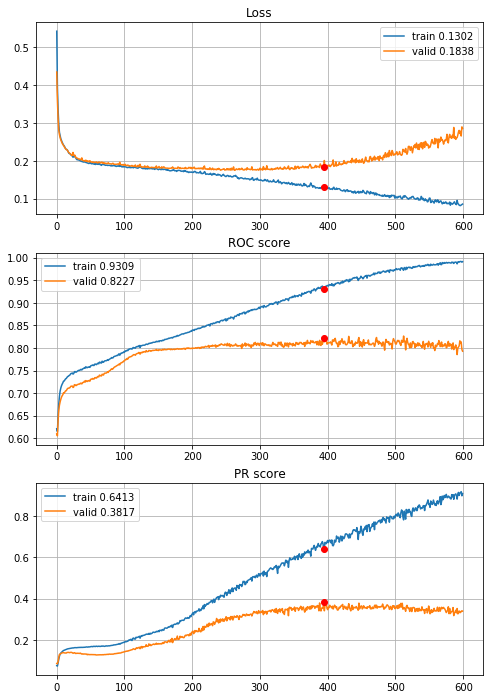


Fold 2------------------------------------------------------------


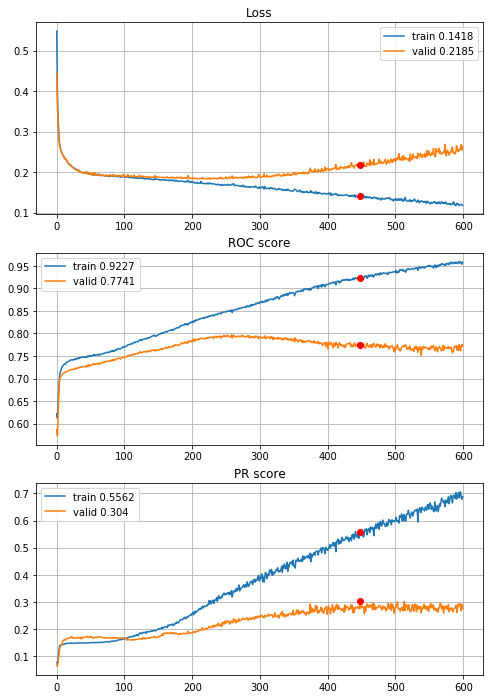


Fold 3------------------------------------------------------------


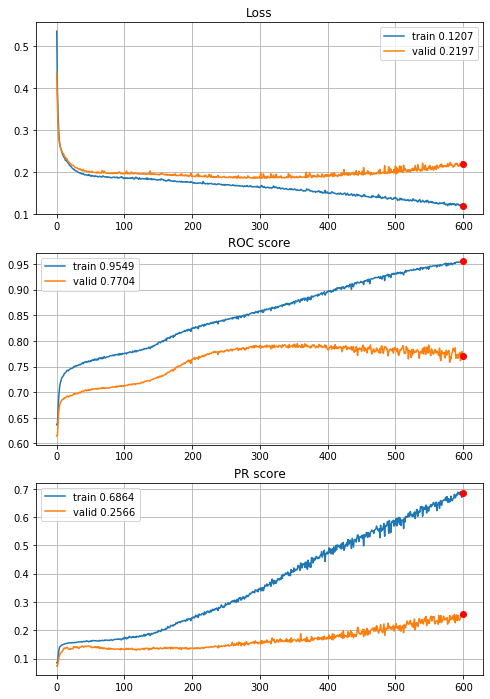


Fold 4------------------------------------------------------------


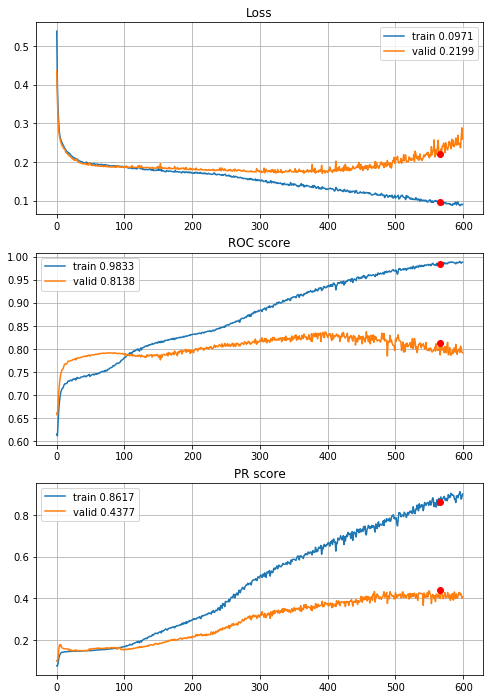


Fold 5------------------------------------------------------------


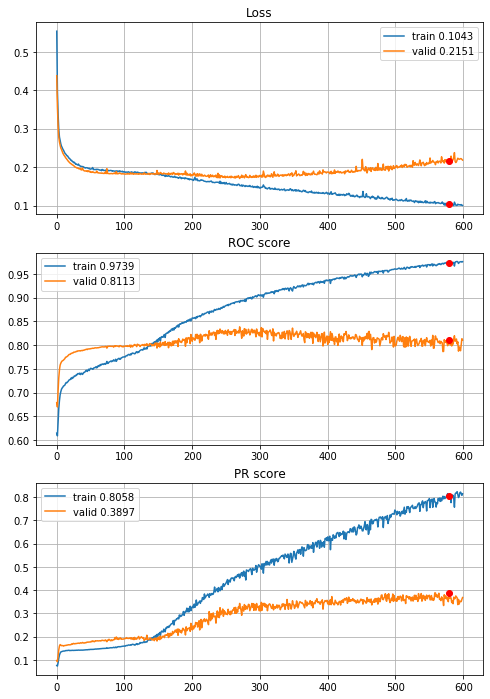


Fold 6------------------------------------------------------------


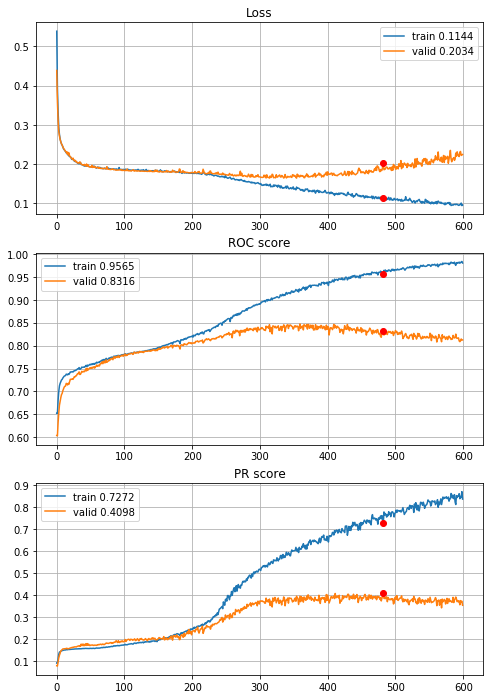

In [59]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_drop_02, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L1_drop_02_600ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets try bigger dropout rate, 0.4

In [53]:
def define_deep_CNN_2inc_std_L1_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 5.56s train loss: 0.556462057378236, validation loss: 0.4409886615019903
Epoch: 2/600,
cumulative time: 7.33s train loss: 0.39887491573141914, validation loss: 0.3614927783476568
Epoch: 3/600,
cumulative time: 9.06s train loss: 0.33809713260542706, validation loss: 0.31414888783974904
Epoch: 4/600,
cumulative time: 10.77s train loss: 0.30046061730086115, validation loss: 0.28315210658892065
Epoch: 5/600,
cumulative time: 12.48s train loss: 0.2786170856457193, validation loss: 0.2706072577779353
Epoch: 6/600,
cumulative time: 14.18s train loss: 0.26904527090736424, validation loss: 0.2627464654982861
Epoch: 7/600,
cumulative time: 15.89s train loss: 0.26229880111355164, validation loss: 0.2570668605820024
Epoch: 8/600,
cumulative time: 17.6s train loss: 0.25652140267746304, validation loss: 0.25328338310538384
Epoch: 9/600,
cumulative time: 19.28s train loss: 0.25154989570212855

Epoch: 76/600,
cumulative time: 136.06s train loss: 0.19028389275106475, validation loss: 0.193231754334627
Epoch: 77/600,
cumulative time: 137.79s train loss: 0.19067712565679795, validation loss: 0.19541792748045808
Epoch: 78/600,
cumulative time: 139.52s train loss: 0.1904746329027058, validation loss: 0.19503911878277122
Epoch: 79/600,
cumulative time: 141.21s train loss: 0.18989171275452243, validation loss: 0.19331119559994353
Epoch: 80/600,
cumulative time: 142.92s train loss: 0.18948799111157044, validation loss: 0.19299640352828232
Epoch: 81/600,
cumulative time: 144.62s train loss: 0.1888407137045561, validation loss: 0.1928854795075177
Epoch: 82/600,
cumulative time: 146.34s train loss: 0.1901444867527259, validation loss: 0.1927577870650061
Epoch: 83/600,
cumulative time: 148.03s train loss: 0.1894107376698754, validation loss: 0.1930160677964546
Epoch: 84/600,
cumulative time: 149.74s train loss: 0.18933427954595128, validation loss: 0.19436155902722646
Epoch: 85/600,
cumu

Epoch: 151/600,
cumulative time: 265.37s train loss: 0.1781454474245286, validation loss: 0.18349822711546945
Epoch: 152/600,
cumulative time: 267.13s train loss: 0.18051829451958132, validation loss: 0.1860509644648589
Epoch: 153/600,
cumulative time: 268.82s train loss: 0.1801926328317518, validation loss: 0.1825797601347476
Epoch: 154/600,
cumulative time: 270.54s train loss: 0.17857882959851124, validation loss: 0.18246071878503667
Epoch: 155/600,
cumulative time: 272.28s train loss: 0.17856930769461468, validation loss: 0.18213952828257
Epoch: 156/600,
cumulative time: 273.99s train loss: 0.18107855473189072, validation loss: 0.18627101842281038
Epoch: 157/600,
cumulative time: 275.7s train loss: 0.17862911345839225, validation loss: 0.18263421361344132
Epoch: 158/600,
cumulative time: 277.41s train loss: 0.1782800779385835, validation loss: 0.18335561584136045
Epoch: 159/600,
cumulative time: 279.14s train loss: 0.17927249672910295, validation loss: 0.18611110982195384
Epoch: 160

Epoch: 226/600,
cumulative time: 397.17s train loss: 0.17188687178333042, validation loss: 0.17910905591154522
Epoch: 227/600,
cumulative time: 398.88s train loss: 0.17207623976185749, validation loss: 0.1801449270415582
Epoch: 228/600,
cumulative time: 400.67s train loss: 0.1742602792882666, validation loss: 0.1786681136929153
Epoch: 229/600,
cumulative time: 402.49s train loss: 0.17211097955955368, validation loss: 0.17992670013435524
Epoch: 230/600,
cumulative time: 404.26s train loss: 0.16962686891323958, validation loss: 0.17904991673279003
Epoch: 231/600,
cumulative time: 406.02s train loss: 0.1702602893584888, validation loss: 0.1797973227042418
Epoch: 232/600,
cumulative time: 407.78s train loss: 0.1740059093093411, validation loss: 0.18096786060854234
Epoch: 233/600,
cumulative time: 409.54s train loss: 0.17113389014735073, validation loss: 0.1787156470277181
Epoch: 234/600,
cumulative time: 411.28s train loss: 0.1746061060561904, validation loss: 0.18046566705017206
Epoch: 23

Epoch: 301/600,
cumulative time: 528.11s train loss: 0.16132871227255963, validation loss: 0.17709875314758294
Epoch: 302/600,
cumulative time: 529.85s train loss: 0.16298676445627674, validation loss: 0.17611457939006747
Epoch: 303/600,
cumulative time: 531.58s train loss: 0.16079064315441405, validation loss: 0.17596520612319363
Epoch: 304/600,
cumulative time: 533.29s train loss: 0.16221917909991754, validation loss: 0.17882147403985485
Epoch: 305/600,
cumulative time: 535.0s train loss: 0.1599686297838035, validation loss: 0.17643040824374673
Epoch: 306/600,
cumulative time: 536.73s train loss: 0.15957403452271712, validation loss: 0.18196309642413588
Epoch: 307/600,
cumulative time: 538.46s train loss: 0.16244013876181507, validation loss: 0.18090364418117427
Epoch: 308/600,
cumulative time: 540.17s train loss: 0.15903392300389207, validation loss: 0.17864023756623837
Epoch: 309/600,
cumulative time: 541.94s train loss: 0.15979386114642322, validation loss: 0.17847786427883164
Epo

Epoch: 376/600,
cumulative time: 659.33s train loss: 0.15758896819475024, validation loss: 0.18797822287490046
Epoch: 377/600,
cumulative time: 661.03s train loss: 0.15207717309859506, validation loss: 0.18848199774165636
Epoch: 378/600,
cumulative time: 662.75s train loss: 0.14680845752392935, validation loss: 0.18801495793971015
Epoch: 379/600,
cumulative time: 664.48s train loss: 0.14648689714278282, validation loss: 0.185940346186708
Epoch: 380/600,
cumulative time: 666.18s train loss: 0.14822453502517427, validation loss: 0.18526049340720727
Epoch: 381/600,
cumulative time: 667.89s train loss: 0.1487666312962807, validation loss: 0.18375169869748162
Epoch: 382/600,
cumulative time: 669.65s train loss: 0.14658739333676818, validation loss: 0.18851064480308613
Epoch: 383/600,
cumulative time: 671.43s train loss: 0.1442584336640058, validation loss: 0.19098973470005232
Epoch: 384/600,
cumulative time: 673.19s train loss: 0.14337462666540238, validation loss: 0.18542322622950666
Epoch

Epoch: 451/600,
cumulative time: 789.3s train loss: 0.13664662856448823, validation loss: 0.204916537639801
Epoch: 452/600,
cumulative time: 791.02s train loss: 0.132665840206493, validation loss: 0.20216427216974547
Epoch: 453/600,
cumulative time: 792.82s train loss: 0.1353412873045586, validation loss: 0.20223752581156218
Epoch: 454/600,
cumulative time: 794.54s train loss: 0.13209373657440077, validation loss: 0.2003794055840367
Epoch: 455/600,
cumulative time: 796.26s train loss: 0.13637165557002073, validation loss: 0.19629615366742917
Epoch: 456/600,
cumulative time: 797.96s train loss: 0.13183365285144943, validation loss: 0.21040266713696812
Epoch: 457/600,
cumulative time: 799.67s train loss: 0.1311140383398291, validation loss: 0.2038782604337956
Epoch: 458/600,
cumulative time: 801.38s train loss: 0.13321916001678796, validation loss: 0.19555141218387
Epoch: 459/600,
cumulative time: 803.13s train loss: 0.13513758660060873, validation loss: 0.1978583277347057
Epoch: 460/600

Epoch: 526/600,
cumulative time: 918.4s train loss: 0.12073210731045225, validation loss: 0.21855690591468382
Epoch: 527/600,
cumulative time: 920.11s train loss: 0.124027442687801, validation loss: 0.22574382815497354
Epoch: 528/600,
cumulative time: 921.82s train loss: 0.11775526170706727, validation loss: 0.2345076092880871
Epoch: 529/600,
cumulative time: 923.55s train loss: 0.12067919863933571, validation loss: 0.2493838425028316
Epoch: 530/600,
cumulative time: 925.28s train loss: 0.12100505590414491, validation loss: 0.22964711078500324
Epoch: 531/600,
cumulative time: 926.98s train loss: 0.11712935129993539, validation loss: 0.22907639997317078
Epoch: 532/600,
cumulative time: 928.76s train loss: 0.11926037713380011, validation loss: 0.2461538177777343
Epoch: 533/600,
cumulative time: 930.5s train loss: 0.11439073398195884, validation loss: 0.2274895314763727
Epoch: 534/600,
cumulative time: 932.2s train loss: 0.1163795057729335, validation loss: 0.23910292693958388
Epoch: 535/

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.99s train loss: 0.5379239013721682, validation loss: 0.4385162122684567
Epoch: 2/600,
cumulative time: 6.77s train loss: 0.3930382624189389, validation loss: 0.36067616740727276
Epoch: 3/600,
cumulative time: 8.52s train loss: 0.33689640916759145, validation loss: 0.31150951034118723
Epoch: 4/600,
cumulative time: 10.26s train loss: 0.2966041403977208, validation loss: 0.28100712632873254
Epoch: 5/600,
cumulative time: 12.04s train loss: 0.27323397577628766, validation loss: 0.2670665454750892
Epoch: 6/600,
cumulative time: 13.8s train loss: 0.26258943401085294, validation loss: 0.2584284922961397
Epoch: 7/600,
cumulative time: 15.56s train loss: 0.2563179462770667, validation loss: 0.25394178310205046
Epoch: 8/600,
cumulative time: 17.33s train loss: 0.25134882464828373, validation loss: 0.24784452584302694
Epoch: 9/600,
cumulative time: 19.11s train loss: 0.24706982297158997, validation loss: 0.244168181

Epoch: 77/600,
cumulative time: 139.69s train loss: 0.19154779845575992, validation loss: 0.19088933950098622
Epoch: 78/600,
cumulative time: 141.5s train loss: 0.19136717138312484, validation loss: 0.1939141480714955
Epoch: 79/600,
cumulative time: 143.47s train loss: 0.19322782190549315, validation loss: 0.1911595557886699
Epoch: 80/600,
cumulative time: 145.22s train loss: 0.19108083694016562, validation loss: 0.19436480183030083
Epoch: 81/600,
cumulative time: 146.94s train loss: 0.1918394804004913, validation loss: 0.19088908693188303
Epoch: 82/600,
cumulative time: 148.71s train loss: 0.19079397683099458, validation loss: 0.1910555577748807
Epoch: 83/600,
cumulative time: 150.49s train loss: 0.19334893217572852, validation loss: 0.1924803511089334
Epoch: 84/600,
cumulative time: 152.23s train loss: 0.19115257025755314, validation loss: 0.1916506104095198
Epoch: 85/600,
cumulative time: 153.96s train loss: 0.19329592371472348, validation loss: 0.19041730642034702
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 272.18s train loss: 0.18180820749709606, validation loss: 0.18694739378456196
Epoch: 153/600,
cumulative time: 273.95s train loss: 0.18215734701657935, validation loss: 0.18641941663235365
Epoch: 154/600,
cumulative time: 275.88s train loss: 0.1811860948932945, validation loss: 0.1882108097136467
Epoch: 155/600,
cumulative time: 277.83s train loss: 0.1812509874950617, validation loss: 0.1870290094021634
Epoch: 156/600,
cumulative time: 279.58s train loss: 0.18168181119060284, validation loss: 0.18713548318961593
Epoch: 157/600,
cumulative time: 281.44s train loss: 0.1806097695377953, validation loss: 0.18708128710844793
Epoch: 158/600,
cumulative time: 283.39s train loss: 0.17953454843824637, validation loss: 0.18689775812820644
Epoch: 159/600,
cumulative time: 285.17s train loss: 0.18239650691779646, validation loss: 0.1886413215454782
Epoch: 160/600,
cumulative time: 286.91s train loss: 0.1821401337077698, validation loss: 0.18650429158733361
Epoch: 1

Epoch: 227/600,
cumulative time: 403.71s train loss: 0.17487784492641578, validation loss: 0.18353743505283146
Epoch: 228/600,
cumulative time: 405.5s train loss: 0.17351607803316707, validation loss: 0.18216478935182298
Epoch: 229/600,
cumulative time: 407.35s train loss: 0.17395775904086277, validation loss: 0.18273188523730102
Epoch: 230/600,
cumulative time: 409.09s train loss: 0.17316651223555876, validation loss: 0.18264832190910596
Epoch: 231/600,
cumulative time: 410.82s train loss: 0.17326325272305954, validation loss: 0.1829178070559479
Epoch: 232/600,
cumulative time: 412.54s train loss: 0.17427116998547545, validation loss: 0.1873587910377549
Epoch: 233/600,
cumulative time: 414.25s train loss: 0.174251431770989, validation loss: 0.18262753048829272
Epoch: 234/600,
cumulative time: 415.96s train loss: 0.1742921723553843, validation loss: 0.1830728532324201
Epoch: 235/600,
cumulative time: 417.68s train loss: 0.1730387194713, validation loss: 0.1840567712661277
Epoch: 236/60

Epoch: 302/600,
cumulative time: 536.14s train loss: 0.16700655107993806, validation loss: 0.18498552572857044
Epoch: 303/600,
cumulative time: 537.83s train loss: 0.1673772209580776, validation loss: 0.18430556703822965
Epoch: 304/600,
cumulative time: 539.53s train loss: 0.1674535373170256, validation loss: 0.18543554010684998
Epoch: 305/600,
cumulative time: 541.24s train loss: 0.16832167232018733, validation loss: 0.1859746213629588
Epoch: 306/600,
cumulative time: 542.95s train loss: 0.1668710688528079, validation loss: 0.18502730073329945
Epoch: 307/600,
cumulative time: 544.72s train loss: 0.1650334967326423, validation loss: 0.19257390547804965
Epoch: 308/600,
cumulative time: 546.57s train loss: 0.17221539958156812, validation loss: 0.18578729693827944
Epoch: 309/600,
cumulative time: 548.32s train loss: 0.16754195643846367, validation loss: 0.18519470675856667
Epoch: 310/600,
cumulative time: 550.06s train loss: 0.16510550702127955, validation loss: 0.18474866506637888
Epoch:

Epoch: 377/600,
cumulative time: 667.71s train loss: 0.1590773508482338, validation loss: 0.1929287365742327
Epoch: 378/600,
cumulative time: 669.47s train loss: 0.1580699388453734, validation loss: 0.19137706445787456
Epoch: 379/600,
cumulative time: 671.22s train loss: 0.15820092269441793, validation loss: 0.1913646662961552
Epoch: 380/600,
cumulative time: 672.99s train loss: 0.15925756456432139, validation loss: 0.19105273091606415
Epoch: 381/600,
cumulative time: 674.76s train loss: 0.15915013790682586, validation loss: 0.19601478740583073
Epoch: 382/600,
cumulative time: 676.49s train loss: 0.15948677595274074, validation loss: 0.19130247560506616
Epoch: 383/600,
cumulative time: 678.22s train loss: 0.15754188092717938, validation loss: 0.1937068147144811
Epoch: 384/600,
cumulative time: 679.94s train loss: 0.15559606620186797, validation loss: 0.19307661899463752
Epoch: 385/600,
cumulative time: 681.66s train loss: 0.15689282761345147, validation loss: 0.1922140897355005
Epoch: 

Epoch: 452/600,
cumulative time: 799.89s train loss: 0.15051223745539907, validation loss: 0.20488580063218725
Epoch: 453/600,
cumulative time: 801.59s train loss: 0.15019537127993662, validation loss: 0.20836406465368745
Epoch: 454/600,
cumulative time: 803.3s train loss: 0.14868606768429773, validation loss: 0.21204051725348297
Epoch: 455/600,
cumulative time: 805.08s train loss: 0.14878251234224962, validation loss: 0.2087692900771913
Epoch: 456/600,
cumulative time: 806.89s train loss: 0.1492925053207455, validation loss: 0.20560139542416378
Epoch: 457/600,
cumulative time: 808.6s train loss: 0.14736140504465203, validation loss: 0.2100222984327598
Epoch: 458/600,
cumulative time: 810.38s train loss: 0.14771644972405804, validation loss: 0.20993200954813143
Epoch: 459/600,
cumulative time: 812.1s train loss: 0.1502290957673408, validation loss: 0.21067753441281833
Epoch: 460/600,
cumulative time: 813.84s train loss: 0.14619254965670472, validation loss: 0.20896152223836328
Epoch: 4

Epoch: 527/600,
cumulative time: 929.83s train loss: 0.13731754997860066, validation loss: 0.22911731542739194
Epoch: 528/600,
cumulative time: 931.54s train loss: 0.13840974219692317, validation loss: 0.22714529733742234
Epoch: 529/600,
cumulative time: 933.22s train loss: 0.1382942801110835, validation loss: 0.2295533440971634
Epoch: 530/600,
cumulative time: 934.94s train loss: 0.13517805489535295, validation loss: 0.22646380640398978
Epoch: 531/600,
cumulative time: 936.66s train loss: 0.13621368568152672, validation loss: 0.22857003979045085
Epoch: 532/600,
cumulative time: 938.41s train loss: 0.13462442711419798, validation loss: 0.22824053938004174
Epoch: 533/600,
cumulative time: 940.19s train loss: 0.1369610334782433, validation loss: 0.22998453418035097
Epoch: 534/600,
cumulative time: 941.94s train loss: 0.1377704745851306, validation loss: 0.23167281433016854
Epoch: 535/600,
cumulative time: 943.68s train loss: 0.138698766993499, validation loss: 0.2335411445919229
Epoch: 5

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 5.43s train loss: 0.536171840473626, validation loss: 0.4382464033637102
Epoch: 2/600,
cumulative time: 7.38s train loss: 0.3975766742568761, validation loss: 0.35835013521861836
Epoch: 3/600,
cumulative time: 9.22s train loss: 0.3373672342642961, validation loss: 0.3102761996368554
Epoch: 4/600,
cumulative time: 11.01s train loss: 0.29598299944886197, validation loss: 0.28069403378065955
Epoch: 5/600,
cumulative time: 12.81s train loss: 0.274692326926185, validation loss: 0.2686236657765222
Epoch: 6/600,
cumulative time: 14.62s train loss: 0.2640344299640835, validation loss: 0.26061820501044464
Epoch: 7/600,
cumulative time: 16.41s train loss: 0.25783870215882204, validation loss: 0.25561534317680734
Epoch: 8/600,
cumulative time: 18.2s train loss: 0.25177563379688517, validation loss: 0.2515899668630895
Epoch: 9/600,
cumulative time: 19.99s train loss: 0.2465599637768273, validation loss: 0.24796196473464

Epoch: 77/600,
cumulative time: 145.87s train loss: 0.18867870955648725, validation loss: 0.19784478691055954
Epoch: 78/600,
cumulative time: 147.65s train loss: 0.1900809445506819, validation loss: 0.19872327554664132
Epoch: 79/600,
cumulative time: 149.44s train loss: 0.18992908543500103, validation loss: 0.19852070168543218
Epoch: 80/600,
cumulative time: 151.23s train loss: 0.18755610014451357, validation loss: 0.19769999201278285
Epoch: 81/600,
cumulative time: 153.0s train loss: 0.1881999187044628, validation loss: 0.19849407031797406
Epoch: 82/600,
cumulative time: 154.79s train loss: 0.18887525617297074, validation loss: 0.1976981343583561
Epoch: 83/600,
cumulative time: 156.58s train loss: 0.18865368369447752, validation loss: 0.1976702205983857
Epoch: 84/600,
cumulative time: 158.36s train loss: 0.18958383242570623, validation loss: 0.20161239283477636
Epoch: 85/600,
cumulative time: 160.15s train loss: 0.19013904579755933, validation loss: 0.19753428211294932
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 284.54s train loss: 0.18622672106717078, validation loss: 0.19589377260070176
Epoch: 153/600,
cumulative time: 286.33s train loss: 0.18565422954017746, validation loss: 0.19599235012183958
Epoch: 154/600,
cumulative time: 288.11s train loss: 0.18291355163695036, validation loss: 0.19749961801537694
Epoch: 155/600,
cumulative time: 289.91s train loss: 0.18583618724815334, validation loss: 0.19982091062039725
Epoch: 156/600,
cumulative time: 291.74s train loss: 0.18591989267956865, validation loss: 0.19632438218780243
Epoch: 157/600,
cumulative time: 293.56s train loss: 0.18568331608326805, validation loss: 0.20066693506328487
Epoch: 158/600,
cumulative time: 295.4s train loss: 0.1871079572806335, validation loss: 0.1955948495759373
Epoch: 159/600,
cumulative time: 297.23s train loss: 0.18470178967326306, validation loss: 0.19596883600832574
Epoch: 160/600,
cumulative time: 299.03s train loss: 0.18385198243377351, validation loss: 0.19602748716137214
Epoc

Epoch: 227/600,
cumulative time: 422.09s train loss: 0.17970776727571972, validation loss: 0.19428048068321505
Epoch: 228/600,
cumulative time: 423.99s train loss: 0.1794621965846768, validation loss: 0.1933716780641113
Epoch: 229/600,
cumulative time: 425.86s train loss: 0.17990529704618305, validation loss: 0.1973830683751525
Epoch: 230/600,
cumulative time: 427.66s train loss: 0.17839681874515737, validation loss: 0.1928227087565228
Epoch: 231/600,
cumulative time: 429.45s train loss: 0.17755870746118113, validation loss: 0.19307892077264532
Epoch: 232/600,
cumulative time: 431.31s train loss: 0.17796864651877142, validation loss: 0.19473571967843278
Epoch: 233/600,
cumulative time: 433.27s train loss: 0.17807930112737377, validation loss: 0.1934247372546433
Epoch: 234/600,
cumulative time: 435.1s train loss: 0.17914005456512344, validation loss: 0.19455030724822137
Epoch: 235/600,
cumulative time: 436.91s train loss: 0.17930356563395772, validation loss: 0.19282223043837785
Epoch: 

Epoch: 302/600,
cumulative time: 561.0s train loss: 0.17402134630557678, validation loss: 0.20070039556495506
Epoch: 303/600,
cumulative time: 562.88s train loss: 0.175504117767817, validation loss: 0.19180621591208336
Epoch: 304/600,
cumulative time: 564.76s train loss: 0.17499341281699368, validation loss: 0.19182805508030282
Epoch: 305/600,
cumulative time: 566.6s train loss: 0.17338936320648976, validation loss: 0.19236573997892598
Epoch: 306/600,
cumulative time: 568.45s train loss: 0.170715859152471, validation loss: 0.20110202696836263
Epoch: 307/600,
cumulative time: 570.3s train loss: 0.1738922282998607, validation loss: 0.1974397150126341
Epoch: 308/600,
cumulative time: 572.13s train loss: 0.1722399136486567, validation loss: 0.19324788562775957
Epoch: 309/600,
cumulative time: 573.96s train loss: 0.17231531199318958, validation loss: 0.19270973026224997
Epoch: 310/600,
cumulative time: 575.75s train loss: 0.17176553189762603, validation loss: 0.19408727280536908
Epoch: 311/

Epoch: 377/600,
cumulative time: 703.84s train loss: 0.1677973149064028, validation loss: 0.19166793998323223
Epoch: 378/600,
cumulative time: 705.84s train loss: 0.16855476015751814, validation loss: 0.19160721459666266
Epoch: 379/600,
cumulative time: 707.76s train loss: 0.16477976867861374, validation loss: 0.19192607168278134
Epoch: 380/600,
cumulative time: 709.62s train loss: 0.1666661352893239, validation loss: 0.1948592438837393
Epoch: 381/600,
cumulative time: 711.47s train loss: 0.165923560609711, validation loss: 0.1913865869085021
Epoch: 382/600,
cumulative time: 713.4s train loss: 0.1664969758341784, validation loss: 0.1936964308671841
Epoch: 383/600,
cumulative time: 715.26s train loss: 0.1661596168687456, validation loss: 0.1934130480899707
Epoch: 384/600,
cumulative time: 717.11s train loss: 0.16609977068128143, validation loss: 0.19005616974919892
Epoch: 385/600,
cumulative time: 718.95s train loss: 0.164751454605388, validation loss: 0.1905961785493374
Epoch: 386/600,

Epoch: 452/600,
cumulative time: 845.56s train loss: 0.1598359027251664, validation loss: 0.1934078235846137
Epoch: 453/600,
cumulative time: 847.49s train loss: 0.15946045740332895, validation loss: 0.19152368052302776
Epoch: 454/600,
cumulative time: 849.38s train loss: 0.16067284061118756, validation loss: 0.18987639956404515
Epoch: 455/600,
cumulative time: 851.3s train loss: 0.16173203489395022, validation loss: 0.19676677424174088
Epoch: 456/600,
cumulative time: 853.22s train loss: 0.16068868178746915, validation loss: 0.1899364217862213
Epoch: 457/600,
cumulative time: 855.12s train loss: 0.1591101623630225, validation loss: 0.18976977724173671
Epoch: 458/600,
cumulative time: 857.01s train loss: 0.15678320825708736, validation loss: 0.19160923051379666
Epoch: 459/600,
cumulative time: 858.92s train loss: 0.16044296377826642, validation loss: 0.18979909419607677
Epoch: 460/600,
cumulative time: 860.82s train loss: 0.15804691842437424, validation loss: 0.19018794611410839
Epoch:

Epoch: 527/600,
cumulative time: 989.15s train loss: 0.15714403626526893, validation loss: 0.20116992314061477
Epoch: 528/600,
cumulative time: 991.06s train loss: 0.15347353057398322, validation loss: 0.19066106217137968
Epoch: 529/600,
cumulative time: 992.97s train loss: 0.15228233702027244, validation loss: 0.19010740327867542
Epoch: 530/600,
cumulative time: 994.85s train loss: 0.1524886982704433, validation loss: 0.1998988583105774
Epoch: 531/600,
cumulative time: 996.74s train loss: 0.1511439346319873, validation loss: 0.1974715582159119
Epoch: 532/600,
cumulative time: 998.65s train loss: 0.15186917107087072, validation loss: 0.19222146195566842
Epoch: 533/600,
cumulative time: 1000.57s train loss: 0.1505730239329214, validation loss: 0.1914141144555308
Epoch: 534/600,
cumulative time: 1002.45s train loss: 0.150598661300598, validation loss: 0.19828226875293165
Epoch: 535/600,
cumulative time: 1004.33s train loss: 0.1505067355105894, validation loss: 0.19293153310325212
Epoch: 

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 5.75s train loss: 0.538067007103782, validation loss: 0.43583347977546705
Epoch: 2/600,
cumulative time: 7.75s train loss: 0.3971586791643992, validation loss: 0.3581003623198619
Epoch: 3/600,
cumulative time: 9.72s train loss: 0.3360283556774139, validation loss: 0.3096152249244381
Epoch: 4/600,
cumulative time: 11.69s train loss: 0.2983359876387486, validation loss: 0.27950418717687514
Epoch: 5/600,
cumulative time: 13.64s train loss: 0.27676341603631205, validation loss: 0.2668010512325048
Epoch: 6/600,
cumulative time: 15.62s train loss: 0.26700007835136486, validation loss: 0.2583637106085895
Epoch: 7/600,
cumulative time: 17.85s train loss: 0.2588131545728191, validation loss: 0.25165032127262216
Epoch: 8/600,
cumulative time: 19.98s train loss: 0.2540484565521608, validation loss: 0.2467447750579751
Epoch: 9/600,
cumulative time: 21.96s train loss: 0.24982571758529754, validation loss: 0.2421797240182

Epoch: 77/600,
cumulative time: 162.74s train loss: 0.19225618741816855, validation loss: 0.18777610781527118
Epoch: 78/600,
cumulative time: 164.76s train loss: 0.1929913658760848, validation loss: 0.1866944037666931
Epoch: 79/600,
cumulative time: 166.8s train loss: 0.19204945667683226, validation loss: 0.1869799478209043
Epoch: 80/600,
cumulative time: 168.81s train loss: 0.19041890297584763, validation loss: 0.18659062229142537
Epoch: 81/600,
cumulative time: 170.86s train loss: 0.19113429141323848, validation loss: 0.18643284401900106
Epoch: 82/600,
cumulative time: 172.86s train loss: 0.19105531794164773, validation loss: 0.1871968022287095
Epoch: 83/600,
cumulative time: 175.01s train loss: 0.19071119085581317, validation loss: 0.1860878838820876
Epoch: 84/600,
cumulative time: 177.03s train loss: 0.19141931507351384, validation loss: 0.18731915208253022
Epoch: 85/600,
cumulative time: 179.05s train loss: 0.1909914246562325, validation loss: 0.1869125887802298
Epoch: 86/600,
cum

Epoch: 152/600,
cumulative time: 315.83s train loss: 0.17850683428206074, validation loss: 0.18578593906616175
Epoch: 153/600,
cumulative time: 317.87s train loss: 0.1785640836058302, validation loss: 0.1835506676491464
Epoch: 154/600,
cumulative time: 319.91s train loss: 0.1760798253359464, validation loss: 0.19395760111536112
Epoch: 155/600,
cumulative time: 321.95s train loss: 0.18040476585382598, validation loss: 0.1846233294519784
Epoch: 156/600,
cumulative time: 323.99s train loss: 0.1756201296634835, validation loss: 0.18666974955711987
Epoch: 157/600,
cumulative time: 326.05s train loss: 0.1778428353593474, validation loss: 0.1836934497033438
Epoch: 158/600,
cumulative time: 328.09s train loss: 0.1755919177047112, validation loss: 0.1834185262412908
Epoch: 159/600,
cumulative time: 330.25s train loss: 0.1759001436986635, validation loss: 0.18417590259085553
Epoch: 160/600,
cumulative time: 332.27s train loss: 0.17562822918630208, validation loss: 0.18262875677575213
Epoch: 161/

Epoch: 227/600,
cumulative time: 468.91s train loss: 0.17163982427113714, validation loss: 0.17877516558253093
Epoch: 228/600,
cumulative time: 470.93s train loss: 0.1713297267538414, validation loss: 0.17914714941652232
Epoch: 229/600,
cumulative time: 472.93s train loss: 0.17064282189317512, validation loss: 0.1803661054539145
Epoch: 230/600,
cumulative time: 475.03s train loss: 0.17039175908522988, validation loss: 0.18115524218308024
Epoch: 231/600,
cumulative time: 477.04s train loss: 0.17271765746327425, validation loss: 0.1799914572943304
Epoch: 232/600,
cumulative time: 479.03s train loss: 0.1720591313029998, validation loss: 0.17837007491867748
Epoch: 233/600,
cumulative time: 481.06s train loss: 0.17294858763356893, validation loss: 0.17969687143055413
Epoch: 234/600,
cumulative time: 483.08s train loss: 0.17193035436808113, validation loss: 0.17946031808325674
Epoch: 235/600,
cumulative time: 485.08s train loss: 0.1707236961465789, validation loss: 0.17902215708673527
Epoch:

Epoch: 302/600,
cumulative time: 619.57s train loss: 0.1654788875257581, validation loss: 0.17769827865637267
Epoch: 303/600,
cumulative time: 621.42s train loss: 0.1667072484940676, validation loss: 0.17812973209146418
Epoch: 304/600,
cumulative time: 623.31s train loss: 0.16618738164048452, validation loss: 0.17750422470905572
Epoch: 305/600,
cumulative time: 625.26s train loss: 0.1671233447975056, validation loss: 0.17850978542664492
Epoch: 306/600,
cumulative time: 627.18s train loss: 0.16563943411988002, validation loss: 0.17887207086675422
Epoch: 307/600,
cumulative time: 629.06s train loss: 0.165989068549481, validation loss: 0.1853727142753205
Epoch: 308/600,
cumulative time: 631.01s train loss: 0.16565606474925107, validation loss: 0.1779059850597479
Epoch: 309/600,
cumulative time: 632.94s train loss: 0.1655724413969951, validation loss: 0.17892626837819023
Epoch: 310/600,
cumulative time: 634.87s train loss: 0.16636394542337163, validation loss: 0.18598967423400073
Epoch: 31

Epoch: 377/600,
cumulative time: 761.33s train loss: 0.15780559387227974, validation loss: 0.17543469829937486
Epoch: 378/600,
cumulative time: 763.17s train loss: 0.15618994739401265, validation loss: 0.18240400176010949
Epoch: 379/600,
cumulative time: 765.03s train loss: 0.15855499232081582, validation loss: 0.1769314135334133
Epoch: 380/600,
cumulative time: 766.9s train loss: 0.15712316736658083, validation loss: 0.17670462777048168
Epoch: 381/600,
cumulative time: 768.75s train loss: 0.1632754105699658, validation loss: 0.1781750964603106
Epoch: 382/600,
cumulative time: 770.61s train loss: 0.16052896011659823, validation loss: 0.1768913630971785
Epoch: 383/600,
cumulative time: 772.52s train loss: 0.1583146450590344, validation loss: 0.17718711134282158
Epoch: 384/600,
cumulative time: 774.45s train loss: 0.1586702923334442, validation loss: 0.1755943217899947
Epoch: 385/600,
cumulative time: 776.4s train loss: 0.1566112072937709, validation loss: 0.17636585240667577
Epoch: 386/

Epoch: 452/600,
cumulative time: 903.35s train loss: 0.15360310909924382, validation loss: 0.1743054062209217
Epoch: 453/600,
cumulative time: 905.22s train loss: 0.15037560380764947, validation loss: 0.17374548352519373
Epoch: 454/600,
cumulative time: 907.07s train loss: 0.15210033094389439, validation loss: 0.17607351158694234
Epoch: 455/600,
cumulative time: 908.97s train loss: 0.1483955475045504, validation loss: 0.17805399032090294
Epoch: 456/600,
cumulative time: 910.92s train loss: 0.15160512809538798, validation loss: 0.17442949851651512
Epoch: 457/600,
cumulative time: 912.79s train loss: 0.15337675103866225, validation loss: 0.17245852953321356
Epoch: 458/600,
cumulative time: 914.67s train loss: 0.14973470287801588, validation loss: 0.17224103209313443
Epoch: 459/600,
cumulative time: 916.52s train loss: 0.15019098591060967, validation loss: 0.1739883776158196
Epoch: 460/600,
cumulative time: 918.37s train loss: 0.1501281839652979, validation loss: 0.1743669905087995
Epoch:

Epoch: 527/600,
cumulative time: 1045.73s train loss: 0.14667121264852717, validation loss: 0.1763905750459518
Epoch: 528/600,
cumulative time: 1047.62s train loss: 0.1468141651922264, validation loss: 0.17465633192461635
Epoch: 529/600,
cumulative time: 1049.6s train loss: 0.14661733654138584, validation loss: 0.17611851281986665
Epoch: 530/600,
cumulative time: 1051.51s train loss: 0.14572816710738026, validation loss: 0.1766934706046518
Epoch: 531/600,
cumulative time: 1053.47s train loss: 0.14532472542078054, validation loss: 0.1769013942058919
Epoch: 532/600,
cumulative time: 1055.37s train loss: 0.14240279890334073, validation loss: 0.1745703625711476
Epoch: 533/600,
cumulative time: 1057.24s train loss: 0.14254191576984035, validation loss: 0.1735714285287669
Epoch: 534/600,
cumulative time: 1059.12s train loss: 0.14418632214163202, validation loss: 0.1746856535552228
Epoch: 535/600,
cumulative time: 1060.99s train loss: 0.14186572175040227, validation loss: 0.1745716335113719
E

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 5.36s train loss: 0.5440239281208946, validation loss: 0.4319939902838959
Epoch: 2/600,
cumulative time: 7.25s train loss: 0.3966066681725137, validation loss: 0.3549976493016251
Epoch: 3/600,
cumulative time: 9.15s train loss: 0.3379964121659986, validation loss: 0.3074497667417864
Epoch: 4/600,
cumulative time: 11.06s train loss: 0.29912565843342176, validation loss: 0.27757805053966894
Epoch: 5/600,
cumulative time: 12.98s train loss: 0.27841504168146836, validation loss: 0.2648176034399859
Epoch: 6/600,
cumulative time: 14.91s train loss: 0.2697478220199513, validation loss: 0.2559301679197709
Epoch: 7/600,
cumulative time: 16.83s train loss: 0.2610089522025554, validation loss: 0.24886276871371985
Epoch: 8/600,
cumulative time: 18.75s train loss: 0.2542841476641904, validation loss: 0.2448274922996191
Epoch: 9/600,
cumulative time: 20.66s train loss: 0.2507590200297518, validation loss: 0.24104119455619

Epoch: 77/600,
cumulative time: 152.64s train loss: 0.1932333320590276, validation loss: 0.18468351154626228
Epoch: 78/600,
cumulative time: 154.63s train loss: 0.19283121582607624, validation loss: 0.18565365123976155
Epoch: 79/600,
cumulative time: 156.57s train loss: 0.1932883251839863, validation loss: 0.18406419474276275
Epoch: 80/600,
cumulative time: 158.52s train loss: 0.19320135909763686, validation loss: 0.18398233332572256
Epoch: 81/600,
cumulative time: 160.43s train loss: 0.19302289059267974, validation loss: 0.18479072333031843
Epoch: 82/600,
cumulative time: 162.36s train loss: 0.19266541556643893, validation loss: 0.18449180461567818
Epoch: 83/600,
cumulative time: 164.27s train loss: 0.19205313765145596, validation loss: 0.1838120047906439
Epoch: 84/600,
cumulative time: 166.16s train loss: 0.19244631691906836, validation loss: 0.1842832923219704
Epoch: 85/600,
cumulative time: 168.06s train loss: 0.19314795757252276, validation loss: 0.18490676319972696
Epoch: 86/600,

Epoch: 152/600,
cumulative time: 300.53s train loss: 0.18719992825197368, validation loss: 0.1811820898377603
Epoch: 153/600,
cumulative time: 302.53s train loss: 0.18637880841209217, validation loss: 0.18157908247342228
Epoch: 154/600,
cumulative time: 304.53s train loss: 0.18641762303955414, validation loss: 0.1808167023619774
Epoch: 155/600,
cumulative time: 306.43s train loss: 0.1861512010150096, validation loss: 0.1809163022309298
Epoch: 156/600,
cumulative time: 308.32s train loss: 0.18567511605703493, validation loss: 0.18032438496802744
Epoch: 157/600,
cumulative time: 310.21s train loss: 0.18611752651307187, validation loss: 0.1805250024478832
Epoch: 158/600,
cumulative time: 312.13s train loss: 0.1857079289293562, validation loss: 0.18057013359885124
Epoch: 159/600,
cumulative time: 314.05s train loss: 0.18691939160162846, validation loss: 0.17995775968079997
Epoch: 160/600,
cumulative time: 315.94s train loss: 0.18561105034466274, validation loss: 0.1804530107154833
Epoch: 1

Epoch: 227/600,
cumulative time: 446.08s train loss: 0.17979785445306556, validation loss: 0.17919016694421663
Epoch: 228/600,
cumulative time: 448.02s train loss: 0.18165902752826935, validation loss: 0.17911727285921086
Epoch: 229/600,
cumulative time: 449.93s train loss: 0.18153444468195923, validation loss: 0.17919316187460352
Epoch: 230/600,
cumulative time: 451.83s train loss: 0.17785419478671613, validation loss: 0.17836855967054574
Epoch: 231/600,
cumulative time: 453.73s train loss: 0.1790991303204581, validation loss: 0.18333214442232973
Epoch: 232/600,
cumulative time: 455.65s train loss: 0.1792964941065166, validation loss: 0.17875126369642627
Epoch: 233/600,
cumulative time: 457.54s train loss: 0.1786557497712327, validation loss: 0.17948092731370588
Epoch: 234/600,
cumulative time: 459.45s train loss: 0.17864794378252072, validation loss: 0.18083713055469036
Epoch: 235/600,
cumulative time: 461.35s train loss: 0.17842618337870944, validation loss: 0.17924483759932686
Epoc

Epoch: 302/600,
cumulative time: 591.37s train loss: 0.16618332282633952, validation loss: 0.17869224299851816
Epoch: 303/600,
cumulative time: 593.27s train loss: 0.16537754324494106, validation loss: 0.17701030270848678
Epoch: 304/600,
cumulative time: 595.18s train loss: 0.1656238140542393, validation loss: 0.1792112961208463
Epoch: 305/600,
cumulative time: 597.07s train loss: 0.16648938070398336, validation loss: 0.17730867117643356
Epoch: 306/600,
cumulative time: 598.97s train loss: 0.17276551045298835, validation loss: 0.19274280092371907
Epoch: 307/600,
cumulative time: 600.9s train loss: 0.1691866754138262, validation loss: 0.18153041459071864
Epoch: 308/600,
cumulative time: 602.81s train loss: 0.16635414118795352, validation loss: 0.17732290834269668
Epoch: 309/600,
cumulative time: 604.77s train loss: 0.16483767372444436, validation loss: 0.17727953593477566
Epoch: 310/600,
cumulative time: 606.69s train loss: 0.16459784997639312, validation loss: 0.17714675040839478
Epoch

Epoch: 377/600,
cumulative time: 736.71s train loss: 0.1548853640227471, validation loss: 0.18025397087069234
Epoch: 378/600,
cumulative time: 738.67s train loss: 0.15512925818002496, validation loss: 0.18200684953937737
Epoch: 379/600,
cumulative time: 740.7s train loss: 0.15470465091675975, validation loss: 0.18067501089472213
Epoch: 380/600,
cumulative time: 742.62s train loss: 0.15504026906625704, validation loss: 0.18129652608642785
Epoch: 381/600,
cumulative time: 744.57s train loss: 0.15484336396772616, validation loss: 0.18359135397854554
Epoch: 382/600,
cumulative time: 746.49s train loss: 0.15387626245723376, validation loss: 0.18135464339636326
Epoch: 383/600,
cumulative time: 748.38s train loss: 0.15312163348965072, validation loss: 0.17977584494475773
Epoch: 384/600,
cumulative time: 750.28s train loss: 0.15502002478571109, validation loss: 0.18112728204730422
Epoch: 385/600,
cumulative time: 752.28s train loss: 0.15664953253108171, validation loss: 0.18125205888978793
Epo

Epoch: 452/600,
cumulative time: 882.74s train loss: 0.14931804512491478, validation loss: 0.18948333010036875
Epoch: 453/600,
cumulative time: 884.75s train loss: 0.14833653511881245, validation loss: 0.19506385349935018
Epoch: 454/600,
cumulative time: 886.76s train loss: 0.14749899334710473, validation loss: 0.18777667361562844
Epoch: 455/600,
cumulative time: 888.76s train loss: 0.1473316346297207, validation loss: 0.18887836185641768
Epoch: 456/600,
cumulative time: 890.74s train loss: 0.14519353263274906, validation loss: 0.18838321831716828
Epoch: 457/600,
cumulative time: 892.74s train loss: 0.14513878710770853, validation loss: 0.19220585522193676
Epoch: 458/600,
cumulative time: 894.69s train loss: 0.15062542608076776, validation loss: 0.18786827850406762
Epoch: 459/600,
cumulative time: 896.58s train loss: 0.14652546357225488, validation loss: 0.1955504426758036
Epoch: 460/600,
cumulative time: 898.47s train loss: 0.1468941067225728, validation loss: 0.18671591815409283
Epoc

Epoch: 527/600,
cumulative time: 1029.56s train loss: 0.13715858472823642, validation loss: 0.2014390679852839
Epoch: 528/600,
cumulative time: 1031.49s train loss: 0.13686267721764986, validation loss: 0.1967771977835845
Epoch: 529/600,
cumulative time: 1033.47s train loss: 0.13629412396419346, validation loss: 0.19585017196082938
Epoch: 530/600,
cumulative time: 1035.45s train loss: 0.13801003491794103, validation loss: 0.20202298773000935
Epoch: 531/600,
cumulative time: 1037.44s train loss: 0.13824484641166618, validation loss: 0.19349957277810542
Epoch: 532/600,
cumulative time: 1039.42s train loss: 0.13733701983543847, validation loss: 0.2004429735141814
Epoch: 533/600,
cumulative time: 1041.34s train loss: 0.13837206668031762, validation loss: 0.19541998924205348
Epoch: 534/600,
cumulative time: 1043.29s train loss: 0.13515859704529604, validation loss: 0.200149736669148
Epoch: 535/600,
cumulative time: 1045.2s train loss: 0.13342500286692174, validation loss: 0.1946108707858691

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 6.58s train loss: 0.5402443961266729, validation loss: 0.43951263581212274
Epoch: 2/600,
cumulative time: 8.53s train loss: 0.39498034162621354, validation loss: 0.3594538452920862
Epoch: 3/600,
cumulative time: 10.47s train loss: 0.3359679140085618, validation loss: 0.31246919787872063
Epoch: 4/600,
cumulative time: 12.43s train loss: 0.2940998142077902, validation loss: 0.2832068461082287
Epoch: 5/600,
cumulative time: 14.36s train loss: 0.27669591371026825, validation loss: 0.2712999088562802
Epoch: 6/600,
cumulative time: 16.29s train loss: 0.26647584793241064, validation loss: 0.262327579004888
Epoch: 7/600,
cumulative time: 18.27s train loss: 0.2587695587345263, validation loss: 0.25691748611446297
Epoch: 8/600,
cumulative time: 20.21s train loss: 0.25264026734710127, validation loss: 0.25164207168512187
Epoch: 9/600,
cumulative time: 22.16s train loss: 0.2500018707206696, validation loss: 0.2488253550

Epoch: 77/600,
cumulative time: 155.24s train loss: 0.1892047216811406, validation loss: 0.18739529977215083
Epoch: 78/600,
cumulative time: 157.16s train loss: 0.1892344907153406, validation loss: 0.18691769512294099
Epoch: 79/600,
cumulative time: 159.08s train loss: 0.1899860462129181, validation loss: 0.18688225232531655
Epoch: 80/600,
cumulative time: 161.07s train loss: 0.18933359903642555, validation loss: 0.186668985383712
Epoch: 81/600,
cumulative time: 163.04s train loss: 0.18896153775370458, validation loss: 0.1875516334370956
Epoch: 82/600,
cumulative time: 165.0s train loss: 0.18885227686001194, validation loss: 0.18669699376058188
Epoch: 83/600,
cumulative time: 167.03s train loss: 0.18969747644883614, validation loss: 0.1866325538920122
Epoch: 84/600,
cumulative time: 169.02s train loss: 0.1894195510119135, validation loss: 0.1872872926842939
Epoch: 85/600,
cumulative time: 171.08s train loss: 0.18742794747218847, validation loss: 0.18589013723570255
Epoch: 86/600,
cumul

Epoch: 152/600,
cumulative time: 302.86s train loss: 0.1839050728835831, validation loss: 0.1818269815610605
Epoch: 153/600,
cumulative time: 304.86s train loss: 0.18320031181659574, validation loss: 0.1821038962953422
Epoch: 154/600,
cumulative time: 306.89s train loss: 0.18634403818784068, validation loss: 0.18205120946389777
Epoch: 155/600,
cumulative time: 309.2s train loss: 0.1839451486273204, validation loss: 0.18167258183946403
Epoch: 156/600,
cumulative time: 311.2s train loss: 0.18368955796142158, validation loss: 0.18150626157463734
Epoch: 157/600,
cumulative time: 313.38s train loss: 0.18319691002596178, validation loss: 0.18221134757394686
Epoch: 158/600,
cumulative time: 315.36s train loss: 0.18208809204253495, validation loss: 0.18220167759328837
Epoch: 159/600,
cumulative time: 317.3s train loss: 0.183745235151942, validation loss: 0.1818117487779755
Epoch: 160/600,
cumulative time: 319.24s train loss: 0.18388246625361554, validation loss: 0.18235218208232432
Epoch: 161/

Epoch: 227/600,
cumulative time: 450.05s train loss: 0.17928378090408503, validation loss: 0.17997809806051956
Epoch: 228/600,
cumulative time: 452.01s train loss: 0.17967123921741457, validation loss: 0.18188645936325396
Epoch: 229/600,
cumulative time: 453.98s train loss: 0.17769058460211443, validation loss: 0.18150785928769722
Epoch: 230/600,
cumulative time: 455.93s train loss: 0.17843230372225796, validation loss: 0.18035499702844698
Epoch: 231/600,
cumulative time: 457.88s train loss: 0.17835571848602727, validation loss: 0.17990980538912624
Epoch: 232/600,
cumulative time: 459.83s train loss: 0.17794422962761652, validation loss: 0.17927154555551364
Epoch: 233/600,
cumulative time: 461.79s train loss: 0.17645146137342863, validation loss: 0.18048767690681305
Epoch: 234/600,
cumulative time: 463.7s train loss: 0.17771315406236904, validation loss: 0.1796709577621491
Epoch: 235/600,
cumulative time: 465.63s train loss: 0.17741706083916242, validation loss: 0.17905724714497454
Epo

Epoch: 302/600,
cumulative time: 597.81s train loss: 0.1702865445235651, validation loss: 0.1773792789888642
Epoch: 303/600,
cumulative time: 599.81s train loss: 0.17091052972332196, validation loss: 0.177978163417581
Epoch: 304/600,
cumulative time: 601.8s train loss: 0.16897894317093498, validation loss: 0.17663959590388253
Epoch: 305/600,
cumulative time: 603.69s train loss: 0.16846393316188799, validation loss: 0.17628773537335019
Epoch: 306/600,
cumulative time: 605.6s train loss: 0.16852975164769393, validation loss: 0.1761215742504889
Epoch: 307/600,
cumulative time: 607.51s train loss: 0.1693398935115675, validation loss: 0.1809001841280376
Epoch: 308/600,
cumulative time: 609.43s train loss: 0.1693914492121514, validation loss: 0.17690499480153948
Epoch: 309/600,
cumulative time: 611.38s train loss: 0.16930285600584186, validation loss: 0.17777635366211794
Epoch: 310/600,
cumulative time: 613.45s train loss: 0.17067335775702347, validation loss: 0.17739318749722732
Epoch: 311/

Epoch: 377/600,
cumulative time: 746.15s train loss: 0.1606392286746298, validation loss: 0.18059414893145131
Epoch: 378/600,
cumulative time: 748.06s train loss: 0.16314317998202407, validation loss: 0.17752345850341003
Epoch: 379/600,
cumulative time: 750.01s train loss: 0.16230679157520755, validation loss: 0.1787097041345422
Epoch: 380/600,
cumulative time: 751.96s train loss: 0.16128291599533656, validation loss: 0.1778821432176338
Epoch: 381/600,
cumulative time: 753.91s train loss: 0.1631697969965653, validation loss: 0.17641867027295707
Epoch: 382/600,
cumulative time: 755.87s train loss: 0.1605078430079362, validation loss: 0.1784348328082698
Epoch: 383/600,
cumulative time: 757.86s train loss: 0.1591052469616849, validation loss: 0.17659874591336913
Epoch: 384/600,
cumulative time: 759.83s train loss: 0.16381479784326874, validation loss: 0.17666598218581983
Epoch: 385/600,
cumulative time: 761.81s train loss: 0.16272896525403382, validation loss: 0.18258495588231152
Epoch: 3

Epoch: 452/600,
cumulative time: 893.75s train loss: 0.1555197205504074, validation loss: 0.18284858263805712
Epoch: 453/600,
cumulative time: 895.84s train loss: 0.1549473472126234, validation loss: 0.1786676990807219
Epoch: 454/600,
cumulative time: 897.87s train loss: 0.15341528519087172, validation loss: 0.1788508571907675
Epoch: 455/600,
cumulative time: 899.84s train loss: 0.15017425201930643, validation loss: 0.18635527284090136
Epoch: 456/600,
cumulative time: 901.78s train loss: 0.15306468034459356, validation loss: 0.17987050674348176
Epoch: 457/600,
cumulative time: 903.76s train loss: 0.15271642797044224, validation loss: 0.18181051330118153
Epoch: 458/600,
cumulative time: 905.72s train loss: 0.15256063924992785, validation loss: 0.18034998154932536
Epoch: 459/600,
cumulative time: 907.65s train loss: 0.15157872159034014, validation loss: 0.17883447811454128
Epoch: 460/600,
cumulative time: 909.57s train loss: 0.15219419531743317, validation loss: 0.18031263511820775
Epoch

Epoch: 527/600,
cumulative time: 1042.45s train loss: 0.1453268334618516, validation loss: 0.18504925863944216
Epoch: 528/600,
cumulative time: 1044.42s train loss: 0.1483770690691984, validation loss: 0.19709595782068184
Epoch: 529/600,
cumulative time: 1046.36s train loss: 0.14346248018991584, validation loss: 0.18381553512746696
Epoch: 530/600,
cumulative time: 1048.31s train loss: 0.14755310670296157, validation loss: 0.1836065230155186
Epoch: 531/600,
cumulative time: 1050.51s train loss: 0.1491369842095118, validation loss: 0.1885913876811555
Epoch: 532/600,
cumulative time: 1052.46s train loss: 0.14183917232385324, validation loss: 0.18327160873919807
Epoch: 533/600,
cumulative time: 1054.69s train loss: 0.14153913653015376, validation loss: 0.1908721959761443
Epoch: 534/600,
cumulative time: 1056.79s train loss: 0.1452238318451512, validation loss: 0.18230929566745213
Epoch: 535/600,
cumulative time: 1058.76s train loss: 0.14269485649265234, validation loss: 0.1870591327223206


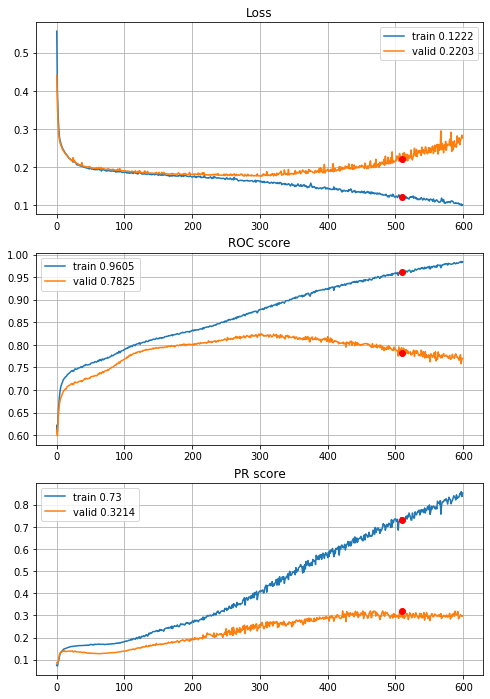


Fold 2------------------------------------------------------------


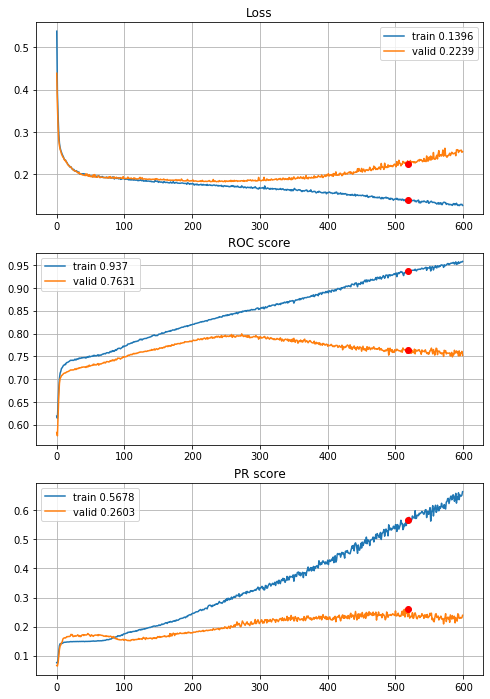


Fold 3------------------------------------------------------------


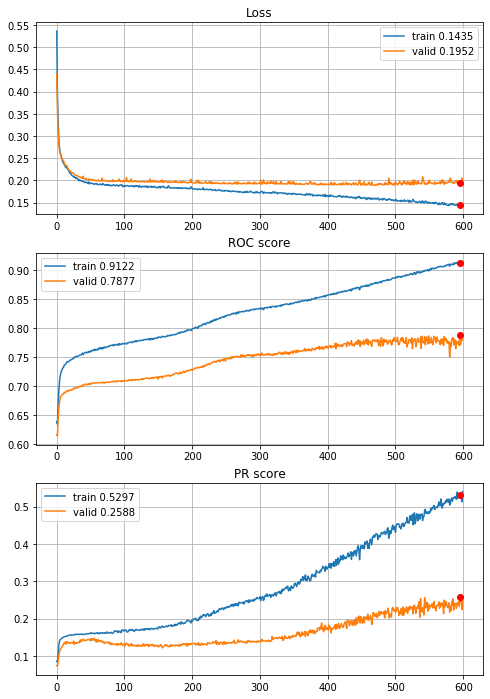


Fold 4------------------------------------------------------------


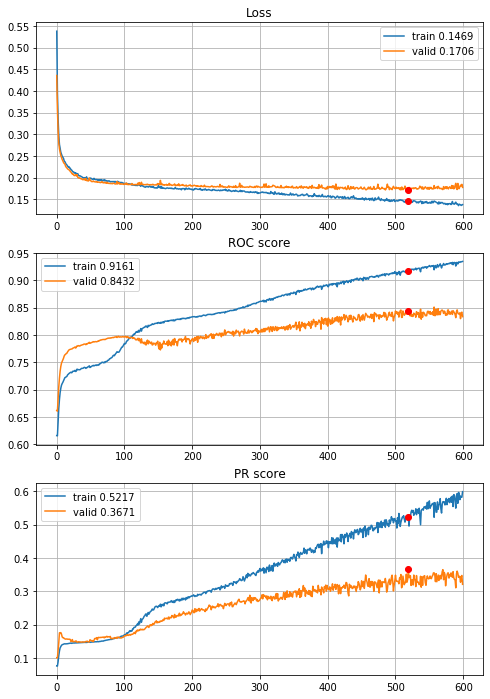


Fold 5------------------------------------------------------------


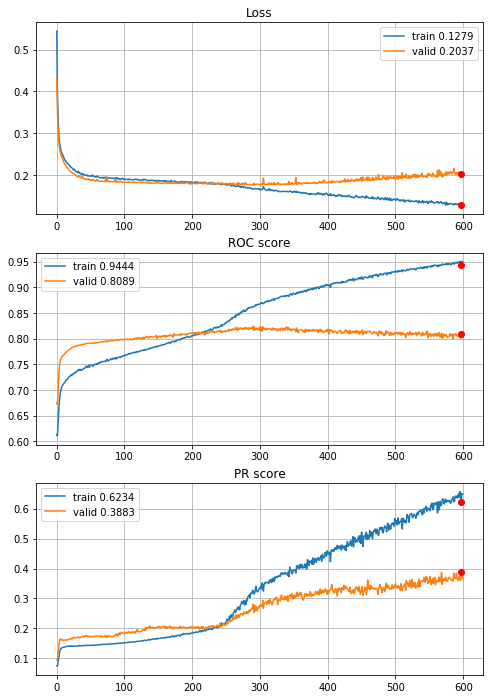


Fold 6------------------------------------------------------------


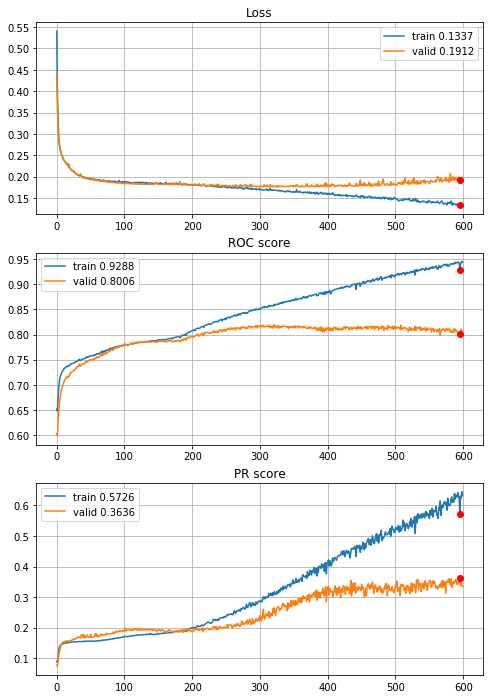

In [61]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_drop_04, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L1_drop_04_600ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets try define_deep_CNN_2inc_2dense_std_drop2_02 model with lower regularization coef, 0.000025.

In [54]:
def define_deep_CNN_2inc_2dense_std_drop2_02_l1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (256,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(dense)                         # (128,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 7.75s train loss: 0.484313550500962, validation loss: 0.3630763723016029
Epoch: 2/600,
cumulative time: 9.8s train loss: 0.3470386514932538, validation loss: 0.3201142154111596
Epoch: 3/600,
cumulative time: 11.88s train loss: 0.3100611924004948, validation loss: 0.29182430186833225
Epoch: 4/600,
cumulative time: 13.96s train loss: 0.2848353830585846, validation loss: 0.2712719819430513
Epoch: 5/600,
cumulative time: 16.03s train loss: 0.266307490046174, validation loss: 0.2607809080608529
Epoch: 6/600,
cumulative time: 18.07s train loss: 0.25971096909924457, validation loss: 0.25434637294893286
Epoch: 7/600,
cumulative time: 20.14s train loss: 0.2557411237234123, validation loss: 0.24818188327360186
Epoch: 8/600,
cumulative time: 22.21s train loss: 0.24821856752267313, validation loss: 0.24438923013056113
Epoch: 9/600,
cumulative time: 24.27s train loss: 0.24397939060456125, v

Epoch: 76/600,
cumulative time: 164.24s train loss: 0.1830797830869761, validation loss: 0.19186530958599912
Epoch: 77/600,
cumulative time: 166.28s train loss: 0.18211166248949157, validation loss: 0.18997609560549705
Epoch: 78/600,
cumulative time: 168.33s train loss: 0.18297492494687678, validation loss: 0.18818644841484994
Epoch: 79/600,
cumulative time: 170.37s train loss: 0.18278680090076768, validation loss: 0.19317536266017235
Epoch: 80/600,
cumulative time: 172.4s train loss: 0.18474204225832705, validation loss: 0.18810021259534757
Epoch: 81/600,
cumulative time: 174.44s train loss: 0.18181919758340634, validation loss: 0.18832950459360834
Epoch: 82/600,
cumulative time: 176.52s train loss: 0.1808315946257733, validation loss: 0.18925876436670108
Epoch: 83/600,
cumulative time: 178.6s train loss: 0.18003436472927958, validation loss: 0.19049434557587538
Epoch: 84/600,
cumulative time: 180.62s train loss: 0.18056214168864634, validation loss: 0.1906708329408813
Epoch: 85/600,


Epoch: 151/600,
cumulative time: 318.02s train loss: 0.15493251432616623, validation loss: 0.18133414563595476
Epoch: 152/600,
cumulative time: 320.06s train loss: 0.15602872677042878, validation loss: 0.18692723601305866
Epoch: 153/600,
cumulative time: 322.11s train loss: 0.15672098891815925, validation loss: 0.18205248239374713
Epoch: 154/600,
cumulative time: 324.17s train loss: 0.1560898479629761, validation loss: 0.1817963128900593
Epoch: 155/600,
cumulative time: 326.23s train loss: 0.15553451616514383, validation loss: 0.17945816811653445
Epoch: 156/600,
cumulative time: 328.27s train loss: 0.155722017476446, validation loss: 0.18274680899875842
Epoch: 157/600,
cumulative time: 330.31s train loss: 0.1528654875631766, validation loss: 0.19315477334333164
Epoch: 158/600,
cumulative time: 332.37s train loss: 0.15344663281117996, validation loss: 0.1892642723288643
Epoch: 159/600,
cumulative time: 334.43s train loss: 0.15508260132383947, validation loss: 0.18522605323280258
Epoch: 

Epoch: 226/600,
cumulative time: 472.48s train loss: 0.1329141390113809, validation loss: 0.1900865463495579
Epoch: 227/600,
cumulative time: 474.54s train loss: 0.13204937401347763, validation loss: 0.1870961616118803
Epoch: 228/600,
cumulative time: 476.72s train loss: 0.1337820683356999, validation loss: 0.1888116235287519
Epoch: 229/600,
cumulative time: 478.81s train loss: 0.1328965918672486, validation loss: 0.19049552457319627
Epoch: 230/600,
cumulative time: 480.9s train loss: 0.13099823733628096, validation loss: 0.1889715150272546
Epoch: 231/600,
cumulative time: 482.98s train loss: 0.13328987499616557, validation loss: 0.18915221767615428
Epoch: 232/600,
cumulative time: 485.06s train loss: 0.13063727737479616, validation loss: 0.18960230324323524
Epoch: 233/600,
cumulative time: 487.12s train loss: 0.13076330997363336, validation loss: 0.1884693244917203
Epoch: 234/600,
cumulative time: 489.15s train loss: 0.13560070091967327, validation loss: 0.1977319548108125
Epoch: 235/

Epoch: 301/600,
cumulative time: 626.2s train loss: 0.11516103697995245, validation loss: 0.19742455759001395
Epoch: 302/600,
cumulative time: 628.27s train loss: 0.11467558162264808, validation loss: 0.19714229328239588
Epoch: 303/600,
cumulative time: 630.32s train loss: 0.11343253362605768, validation loss: 0.20188227196466849
Epoch: 304/600,
cumulative time: 632.33s train loss: 0.11567197770314565, validation loss: 0.2068691999430231
Epoch: 305/600,
cumulative time: 634.37s train loss: 0.120392932965347, validation loss: 0.20118063431641453
Epoch: 306/600,
cumulative time: 636.4s train loss: 0.11457922728180511, validation loss: 0.2039079340422048
Epoch: 307/600,
cumulative time: 638.42s train loss: 0.11698528642808159, validation loss: 0.20624179448336463
Epoch: 308/600,
cumulative time: 640.44s train loss: 0.12639766760463694, validation loss: 0.20096541219945666
Epoch: 309/600,
cumulative time: 642.49s train loss: 0.12320076208193848, validation loss: 0.20334535011472632
Epoch: 

Epoch: 376/600,
cumulative time: 778.75s train loss: 0.11080811941727588, validation loss: 0.22434117463959408
Epoch: 377/600,
cumulative time: 780.78s train loss: 0.10592322420857996, validation loss: 0.23100480444379368
Epoch: 378/600,
cumulative time: 782.81s train loss: 0.10432054115814197, validation loss: 0.23071004347869375
Epoch: 379/600,
cumulative time: 784.83s train loss: 0.09934385900627798, validation loss: 0.2208703078730241
Epoch: 380/600,
cumulative time: 786.85s train loss: 0.10225180559541133, validation loss: 0.21345127083315502
Epoch: 381/600,
cumulative time: 788.85s train loss: 0.10207828791690558, validation loss: 0.22440597870424542
Epoch: 382/600,
cumulative time: 790.89s train loss: 0.10205030316076275, validation loss: 0.2264657182564453
Epoch: 383/600,
cumulative time: 792.91s train loss: 0.10545988252657108, validation loss: 0.22283705235176787
Epoch: 384/600,
cumulative time: 794.93s train loss: 0.10330219434308661, validation loss: 0.22153493696081955
Epo

Epoch: 451/600,
cumulative time: 931.88s train loss: 0.09298359559770016, validation loss: 0.25033446760953404
Epoch: 452/600,
cumulative time: 933.93s train loss: 0.09384408870684781, validation loss: 0.27547664823704143
Epoch: 453/600,
cumulative time: 935.97s train loss: 0.09826565472692977, validation loss: 0.2819846708446721
Epoch: 454/600,
cumulative time: 938.03s train loss: 0.09871135901669366, validation loss: 0.24684669739782933
Epoch: 455/600,
cumulative time: 940.07s train loss: 0.09406707119579684, validation loss: 0.24233998539822696
Epoch: 456/600,
cumulative time: 942.1s train loss: 0.09254331991784695, validation loss: 0.24626299984362598
Epoch: 457/600,
cumulative time: 944.13s train loss: 0.09978670935028176, validation loss: 0.270182269336903
Epoch: 458/600,
cumulative time: 946.17s train loss: 0.09537815749361131, validation loss: 0.2656069906939447
Epoch: 459/600,
cumulative time: 948.21s train loss: 0.0944476308678795, validation loss: 0.26714252906238406
Epoch: 

Epoch: 525/600,
cumulative time: 1082.75s train loss: 0.07741405310604661, validation loss: 0.3264553843914367
Epoch: 526/600,
cumulative time: 1084.85s train loss: 0.07559965862803152, validation loss: 0.30267660306618277
Epoch: 527/600,
cumulative time: 1086.95s train loss: 0.08746127796732371, validation loss: 0.31200975983056833
Epoch: 528/600,
cumulative time: 1089.02s train loss: 0.08440972367246032, validation loss: 0.3020816539484599
Epoch: 529/600,
cumulative time: 1091.07s train loss: 0.08854228117705268, validation loss: 0.3053822646220579
Epoch: 530/600,
cumulative time: 1093.14s train loss: 0.08919590044765142, validation loss: 0.30805701429215804
Epoch: 531/600,
cumulative time: 1095.17s train loss: 0.08458964195572743, validation loss: 0.3091286958440621
Epoch: 532/600,
cumulative time: 1097.23s train loss: 0.0828338121034202, validation loss: 0.31639661269174946
Epoch: 533/600,
cumulative time: 1099.26s train loss: 0.08605887125769153, validation loss: 0.322868033949415

Epoch: 599/600,
cumulative time: 1233.82s train loss: 0.07978878333813551, validation loss: 0.35042140689165596
Epoch: 600/600,
cumulative time: 1235.86s train loss: 0.07435557520468294, validation loss: 0.3619628497700532

Early stopping results:
best results in epoch: 432, 
best valid PR: 0.346291008074359, 
valid ROC: 0.8102048813255709        
overfitting PR: 0.4851835464250711, 
overfitting ROC: 0.17299893694819224

----------
Fold: 2
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 7.36s train loss: 0.47912077471993364, validation loss: 0.3662968558507196
Epoch: 2/600,
cumulative time: 9.47s train loss: 0.3449294402978246, validation loss: 0.3222936290392996
Epoch: 3/600,
cumulative time: 11.58s train loss: 0.308902009479457, validation loss: 0.2933617347434234
Epoch: 4/600,
cumulative time: 13.71s train loss: 0.2850865151854411, validation loss: 0.27254596750212007
Epoch: 5/600,
cumulative time: 15.81s train loss: 0.26754489716385427, val

Epoch: 72/600,
cumulative time: 157.38s train loss: 0.18399199009769607, validation loss: 0.19251369194484552
Epoch: 73/600,
cumulative time: 159.49s train loss: 0.18416431644023576, validation loss: 0.19254419981540669
Epoch: 74/600,
cumulative time: 161.63s train loss: 0.18354450949535828, validation loss: 0.19384862928872534
Epoch: 75/600,
cumulative time: 163.74s train loss: 0.18538013659493727, validation loss: 0.19267751352571158
Epoch: 76/600,
cumulative time: 165.82s train loss: 0.1829477692070862, validation loss: 0.19187917258562565
Epoch: 77/600,
cumulative time: 167.93s train loss: 0.18221065287679802, validation loss: 0.19281497742749948
Epoch: 78/600,
cumulative time: 170.04s train loss: 0.18164940358799225, validation loss: 0.19468679870976485
Epoch: 79/600,
cumulative time: 172.11s train loss: 0.18226406561424083, validation loss: 0.19239482038113598
Epoch: 80/600,
cumulative time: 174.2s train loss: 0.18185123167480513, validation loss: 0.19198572384085763
Epoch: 81/60

Epoch: 147/600,
cumulative time: 314.57s train loss: 0.1611515427522953, validation loss: 0.1940842524951944
Epoch: 148/600,
cumulative time: 316.65s train loss: 0.15913167386236493, validation loss: 0.20008785626042694
Epoch: 149/600,
cumulative time: 318.76s train loss: 0.15950424130485993, validation loss: 0.19658031250198654
Epoch: 150/600,
cumulative time: 320.84s train loss: 0.15774910543613663, validation loss: 0.19508464496463557
Epoch: 151/600,
cumulative time: 322.92s train loss: 0.15733764367184425, validation loss: 0.19803484432384058
Epoch: 152/600,
cumulative time: 325.02s train loss: 0.15836408085148032, validation loss: 0.19828611865913567
Epoch: 153/600,
cumulative time: 327.13s train loss: 0.1575375018568044, validation loss: 0.19783505459599465
Epoch: 154/600,
cumulative time: 329.24s train loss: 0.1556057970446802, validation loss: 0.19911993207210907
Epoch: 155/600,
cumulative time: 331.42s train loss: 0.15604883564495836, validation loss: 0.20086654119949263
Epoch

Epoch: 222/600,
cumulative time: 472.89s train loss: 0.13371493195754444, validation loss: 0.21860516079434575
Epoch: 223/600,
cumulative time: 474.99s train loss: 0.136265692643666, validation loss: 0.22285953629698535
Epoch: 224/600,
cumulative time: 477.08s train loss: 0.13975413234547504, validation loss: 0.22012362624610501
Epoch: 225/600,
cumulative time: 479.17s train loss: 0.133269076185494, validation loss: 0.22570318608482
Epoch: 226/600,
cumulative time: 481.28s train loss: 0.13412593758253966, validation loss: 0.22201677295648783
Epoch: 227/600,
cumulative time: 483.38s train loss: 0.1349915248361771, validation loss: 0.21996765317480282
Epoch: 228/600,
cumulative time: 485.48s train loss: 0.1362228685155172, validation loss: 0.22847212109539766
Epoch: 229/600,
cumulative time: 487.58s train loss: 0.13669620905425103, validation loss: 0.2361308929971321
Epoch: 230/600,
cumulative time: 489.68s train loss: 0.1356291459011119, validation loss: 0.23658640917017804
Epoch: 231/6

Epoch: 297/600,
cumulative time: 630.42s train loss: 0.11272807983953233, validation loss: 0.277899471217471
Epoch: 298/600,
cumulative time: 632.51s train loss: 0.112885232121422, validation loss: 0.2637736621034478
Epoch: 299/600,
cumulative time: 634.62s train loss: 0.1127556336765375, validation loss: 0.26678746853497987
Epoch: 300/600,
cumulative time: 636.7s train loss: 0.11088558433857208, validation loss: 0.281968396047981
Epoch: 301/600,
cumulative time: 638.78s train loss: 0.10804491426101193, validation loss: 0.2708174412939482
Epoch: 302/600,
cumulative time: 640.9s train loss: 0.11106138557082022, validation loss: 0.2761795697080756
Epoch: 303/600,
cumulative time: 643.0s train loss: 0.10675052069223952, validation loss: 0.2720886045893169
Epoch: 304/600,
cumulative time: 645.08s train loss: 0.11119525847355612, validation loss: 0.2776470866695888
Epoch: 305/600,
cumulative time: 647.17s train loss: 0.11473401801780639, validation loss: 0.27679767607222455
Epoch: 306/600,


Epoch: 372/600,
cumulative time: 787.61s train loss: 0.08534987438959694, validation loss: 0.36650651777537196
Epoch: 373/600,
cumulative time: 789.71s train loss: 0.08601940229959226, validation loss: 0.34650924444766656
Epoch: 374/600,
cumulative time: 791.8s train loss: 0.08717908718561454, validation loss: 0.3593540901712531
Epoch: 375/600,
cumulative time: 793.91s train loss: 0.0886401759870741, validation loss: 0.33545362466529083
Epoch: 376/600,
cumulative time: 795.98s train loss: 0.09615133764648671, validation loss: 0.3695381452146235
Epoch: 377/600,
cumulative time: 798.07s train loss: 0.08661236972363529, validation loss: 0.3669098945926695
Epoch: 378/600,
cumulative time: 800.14s train loss: 0.08847937962246026, validation loss: 0.35906325487598745
Epoch: 379/600,
cumulative time: 802.23s train loss: 0.0855538827498651, validation loss: 0.40063678773996214
Epoch: 380/600,
cumulative time: 804.31s train loss: 0.08918165449516237, validation loss: 0.38112813399672263
Epoch: 

Epoch: 447/600,
cumulative time: 945.82s train loss: 0.06994905059995597, validation loss: 0.4955942715366654
Epoch: 448/600,
cumulative time: 947.95s train loss: 0.07457212925192674, validation loss: 0.514262087070025
Epoch: 449/600,
cumulative time: 950.05s train loss: 0.06725142494018552, validation loss: 0.538698863727532
Epoch: 450/600,
cumulative time: 952.17s train loss: 0.06602276024073424, validation loss: 0.5038988207415548
Epoch: 451/600,
cumulative time: 954.26s train loss: 0.07071866694876873, validation loss: 0.5020872530805732
Epoch: 452/600,
cumulative time: 956.37s train loss: 0.07386061082548818, validation loss: 0.49320011194909485
Epoch: 453/600,
cumulative time: 958.45s train loss: 0.07087565294715376, validation loss: 0.49586474534359976
Epoch: 454/600,
cumulative time: 960.53s train loss: 0.07254763184987637, validation loss: 0.5195935247218715
Epoch: 455/600,
cumulative time: 962.63s train loss: 0.07524887744216069, validation loss: 0.4700764614741278
Epoch: 456

Epoch: 522/600,
cumulative time: 1111.11s train loss: 0.06069401088591153, validation loss: 0.607018311304491
Epoch: 523/600,
cumulative time: 1113.35s train loss: 0.062101212285137396, validation loss: 0.609017543154886
Epoch: 524/600,
cumulative time: 1115.46s train loss: 0.0709178134115129, validation loss: 0.5890441618661965
Epoch: 525/600,
cumulative time: 1117.56s train loss: 0.06522819722289694, validation loss: 0.6112944164634806
Epoch: 526/600,
cumulative time: 1119.69s train loss: 0.05923632649956194, validation loss: 0.6835348354544747
Epoch: 527/600,
cumulative time: 1121.89s train loss: 0.06324392248994727, validation loss: 0.6684231845151006
Epoch: 528/600,
cumulative time: 1124.21s train loss: 0.06104678602694621, validation loss: 0.6757304048237953
Epoch: 529/600,
cumulative time: 1126.4s train loss: 0.06147718181889177, validation loss: 0.6215903750684815
Epoch: 530/600,
cumulative time: 1128.62s train loss: 0.06224092358276075, validation loss: 0.6599805063540795
Epoc

Epoch: 596/600,
cumulative time: 1272.89s train loss: 0.047414560147450664, validation loss: 0.8599679320340582
Epoch: 597/600,
cumulative time: 1275.09s train loss: 0.05139618688854667, validation loss: 0.7579302127220097
Epoch: 598/600,
cumulative time: 1277.27s train loss: 0.044111929525435176, validation loss: 0.8285841374392409
Epoch: 599/600,
cumulative time: 1279.45s train loss: 0.04835566336393811, validation loss: 0.7769624937789792
Epoch: 600/600,
cumulative time: 1281.65s train loss: 0.06112176251621674, validation loss: 0.7693395601437155

Early stopping results:
best results in epoch: 295, 
best valid PR: 0.28335290263435337, 
valid ROC: 0.7682163382594418        
overfitting PR: 0.4468331745305721, 
overfitting ROC: 0.20189353728246962

----------
Fold: 3
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 8.95s train loss: 0.4871507891919654, validation loss: 0.37286651893243083
Epoch: 2/600,
cumulative time: 12.04s train loss: 0.348

Epoch: 69/600,
cumulative time: 211.93s train loss: 0.19265088210894238, validation loss: 0.2022726596152401
Epoch: 70/600,
cumulative time: 215.02s train loss: 0.19019817168139866, validation loss: 0.20041646600946267
Epoch: 71/600,
cumulative time: 218.16s train loss: 0.19055497732780033, validation loss: 0.20558044368146308
Epoch: 72/600,
cumulative time: 221.17s train loss: 0.18936747442624005, validation loss: 0.20075811369634958
Epoch: 73/600,
cumulative time: 224.18s train loss: 0.1888677445185147, validation loss: 0.20027076915018083
Epoch: 74/600,
cumulative time: 227.17s train loss: 0.18923482537699804, validation loss: 0.1997075069307713
Epoch: 75/600,
cumulative time: 230.12s train loss: 0.1862581523525184, validation loss: 0.1991358657752356
Epoch: 76/600,
cumulative time: 233.08s train loss: 0.18772491768061358, validation loss: 0.20012964173350065
Epoch: 77/600,
cumulative time: 236.08s train loss: 0.1858936124230769, validation loss: 0.19880226254463196
Epoch: 78/600,
c

Epoch: 144/600,
cumulative time: 434.41s train loss: 0.15777900303017292, validation loss: 0.1958504103636401
Epoch: 145/600,
cumulative time: 437.39s train loss: 0.1579354356273747, validation loss: 0.20674960536361148
Epoch: 146/600,
cumulative time: 440.37s train loss: 0.15826871847685914, validation loss: 0.19600260057889174
Epoch: 147/600,
cumulative time: 443.32s train loss: 0.1587109917981024, validation loss: 0.19571514330281944
Epoch: 148/600,
cumulative time: 446.28s train loss: 0.1571528661844436, validation loss: 0.19561849348881036
Epoch: 149/600,
cumulative time: 449.26s train loss: 0.1580924688572457, validation loss: 0.19519054883592707
Epoch: 150/600,
cumulative time: 452.23s train loss: 0.1607563314601996, validation loss: 0.19815721372465767
Epoch: 151/600,
cumulative time: 455.18s train loss: 0.15546975583629485, validation loss: 0.1955605138009547
Epoch: 152/600,
cumulative time: 458.13s train loss: 0.15772719876278848, validation loss: 0.19432924357176315
Epoch: 1

Epoch: 219/600,
cumulative time: 657.76s train loss: 0.1303726753247104, validation loss: 0.21080919712721044
Epoch: 220/600,
cumulative time: 660.73s train loss: 0.13274102753613473, validation loss: 0.2119743467351058
Epoch: 221/600,
cumulative time: 663.69s train loss: 0.12674921337044825, validation loss: 0.21383206819173348
Epoch: 222/600,
cumulative time: 666.65s train loss: 0.12579521001497343, validation loss: 0.21146431161563684
Epoch: 223/600,
cumulative time: 669.6s train loss: 0.1307645788938558, validation loss: 0.21090984165952512
Epoch: 224/600,
cumulative time: 672.55s train loss: 0.1276251218181109, validation loss: 0.21303063265882924
Epoch: 225/600,
cumulative time: 675.51s train loss: 0.12552496741168037, validation loss: 0.21022312250812497
Epoch: 226/600,
cumulative time: 678.47s train loss: 0.12765866338021584, validation loss: 0.21908539823726214
Epoch: 227/600,
cumulative time: 681.44s train loss: 0.12780377023448644, validation loss: 0.22005124080741056
Epoch:

Epoch: 294/600,
cumulative time: 880.23s train loss: 0.10621394527598912, validation loss: 0.2571968257305491
Epoch: 295/600,
cumulative time: 883.19s train loss: 0.10845764464519012, validation loss: 0.25319291331720967
Epoch: 296/600,
cumulative time: 886.13s train loss: 0.10583105273306345, validation loss: 0.24770296102806855
Epoch: 297/600,
cumulative time: 889.05s train loss: 0.11023095347434708, validation loss: 0.24521215220468234
Epoch: 298/600,
cumulative time: 892.0s train loss: 0.106871999963564, validation loss: 0.2501248153924455
Epoch: 299/600,
cumulative time: 894.95s train loss: 0.10587489175448281, validation loss: 0.2501738235567442
Epoch: 300/600,
cumulative time: 897.92s train loss: 0.10427173398750672, validation loss: 0.28708167715978267
Epoch: 301/600,
cumulative time: 900.9s train loss: 0.10617860854605506, validation loss: 0.2643058139950017
Epoch: 302/600,
cumulative time: 903.85s train loss: 0.10575472913965549, validation loss: 0.25881727274134503
Epoch: 30

Epoch: 369/600,
cumulative time: 1103.51s train loss: 0.08759785731502276, validation loss: 0.34276038968214134
Epoch: 370/600,
cumulative time: 1106.48s train loss: 0.09075762405961114, validation loss: 0.3182443477127161
Epoch: 371/600,
cumulative time: 1109.45s train loss: 0.08817283744450309, validation loss: 0.28633356960636164
Epoch: 372/600,
cumulative time: 1112.43s train loss: 0.08828291169620252, validation loss: 0.2914222999037813
Epoch: 373/600,
cumulative time: 1115.4s train loss: 0.08847813846612682, validation loss: 0.3180102915322399
Epoch: 374/600,
cumulative time: 1118.36s train loss: 0.0885514948655584, validation loss: 0.33258450641933957
Epoch: 375/600,
cumulative time: 1121.34s train loss: 0.08956100878293177, validation loss: 0.34798295991691786
Epoch: 376/600,
cumulative time: 1124.34s train loss: 0.08731930802563434, validation loss: 0.3036685689441844
Epoch: 377/600,
cumulative time: 1127.31s train loss: 0.09031673561592413, validation loss: 0.3102894099169316

Epoch: 443/600,
cumulative time: 1323.93s train loss: 0.07581104588381977, validation loss: 0.37796048719595693
Epoch: 444/600,
cumulative time: 1326.91s train loss: 0.07601154027713444, validation loss: 0.3977575247347801
Epoch: 445/600,
cumulative time: 1329.95s train loss: 0.06918414881833158, validation loss: 0.38534739282846936
Epoch: 446/600,
cumulative time: 1332.88s train loss: 0.07347709138464346, validation loss: 0.38315170650339353
Epoch: 447/600,
cumulative time: 1335.76s train loss: 0.07768410255230206, validation loss: 0.4191261139591183
Epoch: 448/600,
cumulative time: 1338.65s train loss: 0.07572969764391911, validation loss: 0.3925338253186137
Epoch: 449/600,
cumulative time: 1341.53s train loss: 0.0713334379185777, validation loss: 0.383678298993854
Epoch: 450/600,
cumulative time: 1344.39s train loss: 0.07180225637901322, validation loss: 0.37020161145393987
Epoch: 451/600,
cumulative time: 1347.26s train loss: 0.07296808769774993, validation loss: 0.3842370069659916

Epoch: 517/600,
cumulative time: 1539.0s train loss: 0.06581565737927235, validation loss: 0.45900492261590564
Epoch: 518/600,
cumulative time: 1542.02s train loss: 0.06205210772239105, validation loss: 0.44718277636963627
Epoch: 519/600,
cumulative time: 1545.01s train loss: 0.06098343685409378, validation loss: 0.47386703814187775
Epoch: 520/600,
cumulative time: 1547.97s train loss: 0.06310146887945606, validation loss: 0.4222886846372268
Epoch: 521/600,
cumulative time: 1550.93s train loss: 0.062284819442886885, validation loss: 0.4269842347618347
Epoch: 522/600,
cumulative time: 1553.83s train loss: 0.06602432479772194, validation loss: 0.42707677091198604
Epoch: 523/600,
cumulative time: 1556.76s train loss: 0.06557109604556538, validation loss: 0.45780572654277474
Epoch: 524/600,
cumulative time: 1559.8s train loss: 0.06627193893707124, validation loss: 0.4571799206198114
Epoch: 525/600,
cumulative time: 1562.76s train loss: 0.06145571585707585, validation loss: 0.42493313323729

Epoch: 591/600,
cumulative time: 1754.8s train loss: 0.05998269992004245, validation loss: 0.5245641821740515
Epoch: 592/600,
cumulative time: 1757.79s train loss: 0.05795119755425652, validation loss: 0.5392743998274988
Epoch: 593/600,
cumulative time: 1760.68s train loss: 0.05477064571555298, validation loss: 0.5392024041114818
Epoch: 594/600,
cumulative time: 1763.59s train loss: 0.0528585648022863, validation loss: 0.5226187320531348
Epoch: 595/600,
cumulative time: 1766.44s train loss: 0.05040749448338752, validation loss: 0.5601260348840016
Epoch: 596/600,
cumulative time: 1769.31s train loss: 0.05123005214387108, validation loss: 0.5250602514667524
Epoch: 597/600,
cumulative time: 1772.2s train loss: 0.0559529939608809, validation loss: 0.5453727721275319
Epoch: 598/600,
cumulative time: 1775.06s train loss: 0.05301163556470495, validation loss: 0.5599517648198963
Epoch: 599/600,
cumulative time: 1777.91s train loss: 0.05448233990812194, validation loss: 0.5373519975932948
Epoch

Epoch: 64/600,
cumulative time: 200.83s train loss: 0.19455085088434587, validation loss: 0.18953289058112707
Epoch: 65/600,
cumulative time: 203.78s train loss: 0.19358421756195857, validation loss: 0.18926307617847088
Epoch: 66/600,
cumulative time: 206.75s train loss: 0.1919937994476724, validation loss: 0.19002842439568068
Epoch: 67/600,
cumulative time: 209.7s train loss: 0.19411521942036264, validation loss: 0.18871998013972913
Epoch: 68/600,
cumulative time: 212.68s train loss: 0.19250141372152071, validation loss: 0.1893417710264659
Epoch: 69/600,
cumulative time: 215.64s train loss: 0.19166658594889813, validation loss: 0.1879616143185724
Epoch: 70/600,
cumulative time: 218.58s train loss: 0.19075823700364694, validation loss: 0.1872109037787838
Epoch: 71/600,
cumulative time: 221.55s train loss: 0.1918809783242792, validation loss: 0.18973273556195122
Epoch: 72/600,
cumulative time: 224.55s train loss: 0.18914183966351777, validation loss: 0.18878023505941227
Epoch: 73/600,
c

Epoch: 139/600,
cumulative time: 423.31s train loss: 0.16855226178292956, validation loss: 0.17713925170403422
Epoch: 140/600,
cumulative time: 426.32s train loss: 0.16268482994443956, validation loss: 0.17759755603751007
Epoch: 141/600,
cumulative time: 429.27s train loss: 0.16538011815069678, validation loss: 0.17884371540755784
Epoch: 142/600,
cumulative time: 432.23s train loss: 0.16244336325905068, validation loss: 0.1768146198042564
Epoch: 143/600,
cumulative time: 435.19s train loss: 0.16435177384768035, validation loss: 0.17757497798877156
Epoch: 144/600,
cumulative time: 438.14s train loss: 0.1613512173382281, validation loss: 0.17923656639556157
Epoch: 145/600,
cumulative time: 441.08s train loss: 0.1608908693204049, validation loss: 0.1763588207830289
Epoch: 146/600,
cumulative time: 444.02s train loss: 0.1610450030355351, validation loss: 0.17657038287454271
Epoch: 147/600,
cumulative time: 446.97s train loss: 0.1609089994027117, validation loss: 0.17933944144607644
Epoch: 

Epoch: 214/600,
cumulative time: 645.34s train loss: 0.14329219050122008, validation loss: 0.18453065209075495
Epoch: 215/600,
cumulative time: 648.3s train loss: 0.14091695437034565, validation loss: 0.17658606111759875
Epoch: 216/600,
cumulative time: 651.28s train loss: 0.13710769963665456, validation loss: 0.17962899307071797
Epoch: 217/600,
cumulative time: 654.22s train loss: 0.13702690930095726, validation loss: 0.1780065788023321
Epoch: 218/600,
cumulative time: 657.18s train loss: 0.13991095187365968, validation loss: 0.1793526173692889
Epoch: 219/600,
cumulative time: 660.11s train loss: 0.14086588720007098, validation loss: 0.17861583706186773
Epoch: 220/600,
cumulative time: 663.07s train loss: 0.14067564475898373, validation loss: 0.17805914602123854
Epoch: 221/600,
cumulative time: 666.01s train loss: 0.13689092631221841, validation loss: 0.1791515794536384
Epoch: 222/600,
cumulative time: 668.96s train loss: 0.1378312832784315, validation loss: 0.1841925874281449
Epoch: 

Epoch: 289/600,
cumulative time: 867.67s train loss: 0.11920085568227058, validation loss: 0.19229796375645675
Epoch: 290/600,
cumulative time: 870.64s train loss: 0.1169797422372725, validation loss: 0.19299250698113946
Epoch: 291/600,
cumulative time: 873.59s train loss: 0.11533878490391697, validation loss: 0.19268646316921087
Epoch: 292/600,
cumulative time: 876.6s train loss: 0.11526553960265669, validation loss: 0.19697943933363915
Epoch: 293/600,
cumulative time: 879.6s train loss: 0.11391979358845797, validation loss: 0.1900948241626916
Epoch: 294/600,
cumulative time: 882.62s train loss: 0.11788406146959893, validation loss: 0.20592432535571092
Epoch: 295/600,
cumulative time: 885.58s train loss: 0.11321724016773885, validation loss: 0.19052334353987094
Epoch: 296/600,
cumulative time: 888.52s train loss: 0.11364611125310566, validation loss: 0.19256308869572217
Epoch: 297/600,
cumulative time: 891.44s train loss: 0.11587982483732753, validation loss: 0.2111853875011875
Epoch:

Epoch: 363/600,
cumulative time: 1087.1s train loss: 0.09287463240787117, validation loss: 0.244147572055246
Epoch: 364/600,
cumulative time: 1090.07s train loss: 0.09906792808001946, validation loss: 0.25896606126190286
Epoch: 365/600,
cumulative time: 1093.03s train loss: 0.10055084512435203, validation loss: 0.25371941704990264
Epoch: 366/600,
cumulative time: 1095.96s train loss: 0.09739981975746824, validation loss: 0.23522367925364765
Epoch: 367/600,
cumulative time: 1098.91s train loss: 0.09181789984036479, validation loss: 0.229090193133114
Epoch: 368/600,
cumulative time: 1101.91s train loss: 0.0942254933679151, validation loss: 0.23379330580497454
Epoch: 369/600,
cumulative time: 1104.85s train loss: 0.0941679706119978, validation loss: 0.2297300379583834
Epoch: 370/600,
cumulative time: 1107.8s train loss: 0.09209600467415965, validation loss: 0.24324893130787056
Epoch: 371/600,
cumulative time: 1110.76s train loss: 0.09702109538975519, validation loss: 0.2582986717162447
Ep

Epoch: 437/600,
cumulative time: 1305.79s train loss: 0.08010014257772115, validation loss: 0.2837961102481437
Epoch: 438/600,
cumulative time: 1308.75s train loss: 0.07258491339949615, validation loss: 0.3095624056537594
Epoch: 439/600,
cumulative time: 1311.76s train loss: 0.06968525065261078, validation loss: 0.30691341379209797
Epoch: 440/600,
cumulative time: 1314.8s train loss: 0.07448246839377498, validation loss: 0.34590774559504
Epoch: 441/600,
cumulative time: 1317.78s train loss: 0.0701333264257527, validation loss: 0.3181319818600576
Epoch: 442/600,
cumulative time: 1320.76s train loss: 0.07331811284196647, validation loss: 0.32064982396636066
Epoch: 443/600,
cumulative time: 1323.69s train loss: 0.07002980306584261, validation loss: 0.31984082012455667
Epoch: 444/600,
cumulative time: 1326.65s train loss: 0.07137400284257325, validation loss: 0.33228042421493503
Epoch: 445/600,
cumulative time: 1329.63s train loss: 0.07242978141006033, validation loss: 0.33120357355266467


Epoch: 511/600,
cumulative time: 1524.58s train loss: 0.05930103137774638, validation loss: 0.3949607281436557
Epoch: 512/600,
cumulative time: 1527.53s train loss: 0.057681923907442444, validation loss: 0.3980536914098985
Epoch: 513/600,
cumulative time: 1530.47s train loss: 0.05867201419163916, validation loss: 0.36137391153121984
Epoch: 514/600,
cumulative time: 1533.41s train loss: 0.05825373241110944, validation loss: 0.3840049101309844
Epoch: 515/600,
cumulative time: 1536.36s train loss: 0.05836493240464664, validation loss: 0.404674032864074
Epoch: 516/600,
cumulative time: 1539.31s train loss: 0.05943426631475265, validation loss: 0.37330764921609033
Epoch: 517/600,
cumulative time: 1542.24s train loss: 0.06566146374191167, validation loss: 0.3799264058927195
Epoch: 518/600,
cumulative time: 1545.19s train loss: 0.06165503897001158, validation loss: 0.3495356642607526
Epoch: 519/600,
cumulative time: 1548.15s train loss: 0.06457281317123029, validation loss: 0.3808378871198087

Epoch: 585/600,
cumulative time: 1743.4s train loss: 0.04875198383521972, validation loss: 0.433069333789136
Epoch: 586/600,
cumulative time: 1746.35s train loss: 0.05059746482228041, validation loss: 0.4973134442078491
Epoch: 587/600,
cumulative time: 1749.29s train loss: 0.05504021482461239, validation loss: 0.43901984057838694
Epoch: 588/600,
cumulative time: 1752.24s train loss: 0.05953732750123745, validation loss: 0.4283075388837948
Epoch: 589/600,
cumulative time: 1755.18s train loss: 0.056992911183873035, validation loss: 0.4297838444365702
Epoch: 590/600,
cumulative time: 1758.14s train loss: 0.057542942599300206, validation loss: 0.4701472753931504
Epoch: 591/600,
cumulative time: 1761.08s train loss: 0.055349749663772915, validation loss: 0.44138529880506155
Epoch: 592/600,
cumulative time: 1764.07s train loss: 0.05730294586283203, validation loss: 0.4216372221809735
Epoch: 593/600,
cumulative time: 1767.0s train loss: 0.05565803288352127, validation loss: 0.4561521130568969

Epoch: 58/600,
cumulative time: 187.02s train loss: 0.19469060106426153, validation loss: 0.18801075634254746
Epoch: 59/600,
cumulative time: 190.11s train loss: 0.19348038521581096, validation loss: 0.18892604618127729
Epoch: 60/600,
cumulative time: 193.17s train loss: 0.1933642150124044, validation loss: 0.19406341469011776
Epoch: 61/600,
cumulative time: 196.23s train loss: 0.19493193479664706, validation loss: 0.18715612608584137
Epoch: 62/600,
cumulative time: 199.32s train loss: 0.19338081971882215, validation loss: 0.18833109289813757
Epoch: 63/600,
cumulative time: 202.41s train loss: 0.19276914307705587, validation loss: 0.18762444619505542
Epoch: 64/600,
cumulative time: 205.47s train loss: 0.19094764894130184, validation loss: 0.18733001902334048
Epoch: 65/600,
cumulative time: 208.56s train loss: 0.1920816655877434, validation loss: 0.1863438366869165
Epoch: 66/600,
cumulative time: 211.64s train loss: 0.1909965647908013, validation loss: 0.18682834073616958
Epoch: 67/600,

Epoch: 133/600,
cumulative time: 418.41s train loss: 0.15476829442347773, validation loss: 0.17590839880688638
Epoch: 134/600,
cumulative time: 421.5s train loss: 0.15125779821770774, validation loss: 0.1722920911554095
Epoch: 135/600,
cumulative time: 424.58s train loss: 0.15333935721475056, validation loss: 0.16896112894573392
Epoch: 136/600,
cumulative time: 427.66s train loss: 0.15197562419632876, validation loss: 0.17295446417393412
Epoch: 137/600,
cumulative time: 430.73s train loss: 0.15361897623032525, validation loss: 0.17658183112618708
Epoch: 138/600,
cumulative time: 433.86s train loss: 0.1525556973662544, validation loss: 0.17199678402343302
Epoch: 139/600,
cumulative time: 436.96s train loss: 0.15713776336386312, validation loss: 0.18202149076260404
Epoch: 140/600,
cumulative time: 440.02s train loss: 0.15322348078376002, validation loss: 0.17743989670958765
Epoch: 141/600,
cumulative time: 443.09s train loss: 0.15458285647052825, validation loss: 0.1693657350800018
Epoch

Epoch: 208/600,
cumulative time: 649.63s train loss: 0.12030896798084634, validation loss: 0.18387540080648027
Epoch: 209/600,
cumulative time: 652.68s train loss: 0.11822099918357558, validation loss: 0.18629626466890123
Epoch: 210/600,
cumulative time: 655.78s train loss: 0.11834558664388906, validation loss: 0.1818642610587606
Epoch: 211/600,
cumulative time: 658.86s train loss: 0.11638396962551899, validation loss: 0.1812193840539098
Epoch: 212/600,
cumulative time: 661.96s train loss: 0.11794476010806225, validation loss: 0.18370673060417175
Epoch: 213/600,
cumulative time: 665.02s train loss: 0.12338117375758868, validation loss: 0.1841220438723993
Epoch: 214/600,
cumulative time: 668.11s train loss: 0.11837232531878229, validation loss: 0.18272742383405363
Epoch: 215/600,
cumulative time: 671.19s train loss: 0.11368261559710134, validation loss: 0.1903678800007303
Epoch: 216/600,
cumulative time: 674.27s train loss: 0.1204836870318437, validation loss: 0.18543408443638673
Epoch:

Epoch: 283/600,
cumulative time: 880.96s train loss: 0.09429543787788007, validation loss: 0.2087322456675914
Epoch: 284/600,
cumulative time: 884.04s train loss: 0.09189017494117804, validation loss: 0.22380563131551326
Epoch: 285/600,
cumulative time: 887.15s train loss: 0.09406438298028344, validation loss: 0.21689867017135958
Epoch: 286/600,
cumulative time: 890.21s train loss: 0.09600222717122477, validation loss: 0.21740182332836638
Epoch: 287/600,
cumulative time: 893.27s train loss: 0.09074893828343462, validation loss: 0.21640661848094872
Epoch: 288/600,
cumulative time: 896.34s train loss: 0.09154365096679505, validation loss: 0.222348499566073
Epoch: 289/600,
cumulative time: 899.4s train loss: 0.09048002750931353, validation loss: 0.22759128593375313
Epoch: 290/600,
cumulative time: 902.46s train loss: 0.0931364548806515, validation loss: 0.21997237108059087
Epoch: 291/600,
cumulative time: 905.53s train loss: 0.08966436280923731, validation loss: 0.21397675013509693
Epoch:

Epoch: 357/600,
cumulative time: 1109.11s train loss: 0.07591413683613077, validation loss: 0.26956423453235495
Epoch: 358/600,
cumulative time: 1112.17s train loss: 0.0744116000906201, validation loss: 0.2838565926866895
Epoch: 359/600,
cumulative time: 1115.25s train loss: 0.07153990723635019, validation loss: 0.26552676021727944
Epoch: 360/600,
cumulative time: 1118.33s train loss: 0.0758758994064868, validation loss: 0.2761005216585193
Epoch: 361/600,
cumulative time: 1121.39s train loss: 0.07307285281539386, validation loss: 0.2901451442319626
Epoch: 362/600,
cumulative time: 1124.48s train loss: 0.07074058871951627, validation loss: 0.28418509471319026
Epoch: 363/600,
cumulative time: 1127.56s train loss: 0.07257504202729834, validation loss: 0.27321817979663204
Epoch: 364/600,
cumulative time: 1130.63s train loss: 0.07348173132779032, validation loss: 0.2716482592497924
Epoch: 365/600,
cumulative time: 1133.71s train loss: 0.07437924394477362, validation loss: 0.2756858000922593

Epoch: 431/600,
cumulative time: 1337.05s train loss: 0.06488340387977092, validation loss: 0.3355023653858039
Epoch: 432/600,
cumulative time: 1340.14s train loss: 0.06551447274946569, validation loss: 0.3111101923667767
Epoch: 433/600,
cumulative time: 1343.21s train loss: 0.06395370078279204, validation loss: 0.33448555164181243
Epoch: 434/600,
cumulative time: 1346.29s train loss: 0.0636655433967807, validation loss: 0.33595504526465075
Epoch: 435/600,
cumulative time: 1349.37s train loss: 0.06472089054765005, validation loss: 0.3393164521910514
Epoch: 436/600,
cumulative time: 1352.46s train loss: 0.06209089421547446, validation loss: 0.37489638682607085
Epoch: 437/600,
cumulative time: 1355.58s train loss: 0.062148023327743565, validation loss: 0.35250997466189987
Epoch: 438/600,
cumulative time: 1358.68s train loss: 0.060658177772784413, validation loss: 0.3621464845919804
Epoch: 439/600,
cumulative time: 1361.76s train loss: 0.06362642343145894, validation loss: 0.3444539174153

Epoch: 505/600,
cumulative time: 1565.09s train loss: 0.04742614552987362, validation loss: 0.461030014975844
Epoch: 506/600,
cumulative time: 1568.15s train loss: 0.04751283006564042, validation loss: 0.44025690723667354
Epoch: 507/600,
cumulative time: 1571.23s train loss: 0.04558562495378465, validation loss: 0.4125619744653598
Epoch: 508/600,
cumulative time: 1574.32s train loss: 0.05179073688551816, validation loss: 0.4449413709078563
Epoch: 509/600,
cumulative time: 1577.38s train loss: 0.05053050266497632, validation loss: 0.42707717483634844
Epoch: 510/600,
cumulative time: 1580.47s train loss: 0.046691529817010774, validation loss: 0.45424501719689175
Epoch: 511/600,
cumulative time: 1583.55s train loss: 0.05293252379562471, validation loss: 0.45581742743542797
Epoch: 512/600,
cumulative time: 1586.64s train loss: 0.046726074587139815, validation loss: 0.4556862863760228
Epoch: 513/600,
cumulative time: 1589.74s train loss: 0.04659143322267142, validation loss: 0.4519544921470

Epoch: 579/600,
cumulative time: 1793.22s train loss: 0.04277030934431551, validation loss: 0.5337135603382412
Epoch: 580/600,
cumulative time: 1796.36s train loss: 0.04154538024168194, validation loss: 0.49729234690724666
Epoch: 581/600,
cumulative time: 1799.52s train loss: 0.04311790315470859, validation loss: 0.5075973768081588
Epoch: 582/600,
cumulative time: 1802.62s train loss: 0.04452183326170628, validation loss: 0.49787812592710395
Epoch: 583/600,
cumulative time: 1805.7s train loss: 0.04077102170043781, validation loss: 0.5046675742809389
Epoch: 584/600,
cumulative time: 1808.77s train loss: 0.04134650546895068, validation loss: 0.5405492958402114
Epoch: 585/600,
cumulative time: 1811.86s train loss: 0.04252294879426981, validation loss: 0.5217536900608676
Epoch: 586/600,
cumulative time: 1814.92s train loss: 0.044372064126391685, validation loss: 0.49055634260340025
Epoch: 587/600,
cumulative time: 1817.98s train loss: 0.044831663015053036, validation loss: 0.48449036223199

Epoch: 52/600,
cumulative time: 169.61s train loss: 0.19403317221694003, validation loss: 0.1914466883205588
Epoch: 53/600,
cumulative time: 172.83s train loss: 0.1922416544371246, validation loss: 0.19714983071553285
Epoch: 54/600,
cumulative time: 176.03s train loss: 0.19303784137977234, validation loss: 0.1905545616872629
Epoch: 55/600,
cumulative time: 179.17s train loss: 0.19583696479176643, validation loss: 0.19223420090506446
Epoch: 56/600,
cumulative time: 182.29s train loss: 0.19506688395713928, validation loss: 0.19057534976128987
Epoch: 57/600,
cumulative time: 185.39s train loss: 0.1936573920718725, validation loss: 0.19392691611512805
Epoch: 58/600,
cumulative time: 188.51s train loss: 0.19117846167879687, validation loss: 0.189106117010279
Epoch: 59/600,
cumulative time: 191.62s train loss: 0.19124550199489188, validation loss: 0.188536241955101
Epoch: 60/600,
cumulative time: 194.73s train loss: 0.1892971952033913, validation loss: 0.19072171223504666
Epoch: 61/600,
cumu

Epoch: 127/600,
cumulative time: 404.15s train loss: 0.167778347466701, validation loss: 0.1809026967399127
Epoch: 128/600,
cumulative time: 407.28s train loss: 0.16651969232387467, validation loss: 0.1768468370310942
Epoch: 129/600,
cumulative time: 410.46s train loss: 0.16582905914033874, validation loss: 0.1769344633094946
Epoch: 130/600,
cumulative time: 413.69s train loss: 0.1650551611472384, validation loss: 0.1786176346506345
Epoch: 131/600,
cumulative time: 416.84s train loss: 0.16543754022811946, validation loss: 0.17588782454625138
Epoch: 132/600,
cumulative time: 420.01s train loss: 0.16569888982556613, validation loss: 0.1839231906981494
Epoch: 133/600,
cumulative time: 423.11s train loss: 0.1699709863866596, validation loss: 0.18464605463541822
Epoch: 134/600,
cumulative time: 426.21s train loss: 0.1669167310733973, validation loss: 0.17467794703365347
Epoch: 135/600,
cumulative time: 429.32s train loss: 0.16416494408723836, validation loss: 0.17626725029636794
Epoch: 136/

Epoch: 202/600,
cumulative time: 639.37s train loss: 0.14669120737020747, validation loss: 0.1909817636662673
Epoch: 203/600,
cumulative time: 642.51s train loss: 0.14615805349099675, validation loss: 0.18105713010077906
Epoch: 204/600,
cumulative time: 645.67s train loss: 0.1443260809150981, validation loss: 0.1826687482584075
Epoch: 205/600,
cumulative time: 648.8s train loss: 0.14740258078486507, validation loss: 0.18540606944128993
Epoch: 206/600,
cumulative time: 652.01s train loss: 0.14532632298751336, validation loss: 0.1790180525435414
Epoch: 207/600,
cumulative time: 655.21s train loss: 0.14557777835393004, validation loss: 0.18177141701899044
Epoch: 208/600,
cumulative time: 658.35s train loss: 0.14408330818179646, validation loss: 0.18056342170170284
Epoch: 209/600,
cumulative time: 661.47s train loss: 0.1456849422845543, validation loss: 0.18212206649520415
Epoch: 210/600,
cumulative time: 664.6s train loss: 0.14684581878942018, validation loss: 0.18189204628363617
Epoch: 2

Epoch: 277/600,
cumulative time: 874.74s train loss: 0.1257472461828057, validation loss: 0.20089523802823528
Epoch: 278/600,
cumulative time: 877.84s train loss: 0.12279045028908256, validation loss: 0.2038472509392276
Epoch: 279/600,
cumulative time: 880.96s train loss: 0.12696921239426454, validation loss: 0.20188162733650988
Epoch: 280/600,
cumulative time: 884.08s train loss: 0.1298811297157621, validation loss: 0.20423186828232592
Epoch: 281/600,
cumulative time: 887.22s train loss: 0.1273668784412813, validation loss: 0.2037210771433339
Epoch: 282/600,
cumulative time: 890.36s train loss: 0.12556468745721971, validation loss: 0.2098235555744301
Epoch: 283/600,
cumulative time: 893.59s train loss: 0.12528869288939018, validation loss: 0.20940847031020987
Epoch: 284/600,
cumulative time: 896.75s train loss: 0.1244333044814518, validation loss: 0.21641205113167983
Epoch: 285/600,
cumulative time: 899.9s train loss: 0.12751049687578658, validation loss: 0.20053050673137893
Epoch: 28

Epoch: 351/600,
cumulative time: 1106.6s train loss: 0.10491566386982831, validation loss: 0.24569917372770467
Epoch: 352/600,
cumulative time: 1109.72s train loss: 0.10443730045856668, validation loss: 0.2371092730833659
Epoch: 353/600,
cumulative time: 1112.84s train loss: 0.10313476258300423, validation loss: 0.2643944702697385
Epoch: 354/600,
cumulative time: 1115.98s train loss: 0.10669371900848704, validation loss: 0.24328595883027734
Epoch: 355/600,
cumulative time: 1119.1s train loss: 0.1145126366468394, validation loss: 0.2334937522700437
Epoch: 356/600,
cumulative time: 1122.25s train loss: 0.10911799911084973, validation loss: 0.25136025028673764
Epoch: 357/600,
cumulative time: 1125.35s train loss: 0.10833526022066738, validation loss: 0.27075758866701854
Epoch: 358/600,
cumulative time: 1128.46s train loss: 0.10910030829868318, validation loss: 0.23506009351330168
Epoch: 359/600,
cumulative time: 1131.66s train loss: 0.10507585086163806, validation loss: 0.2402745631881241

Epoch: 425/600,
cumulative time: 1338.71s train loss: 0.08452483615888717, validation loss: 0.305502797139438
Epoch: 426/600,
cumulative time: 1341.84s train loss: 0.08559364998360085, validation loss: 0.32068322371559504
Epoch: 427/600,
cumulative time: 1344.97s train loss: 0.0855776067054171, validation loss: 0.32400024288437995
Epoch: 428/600,
cumulative time: 1348.09s train loss: 0.08396426031532371, validation loss: 0.285637693058405
Epoch: 429/600,
cumulative time: 1351.21s train loss: 0.09105241126309845, validation loss: 0.2855525800618229
Epoch: 430/600,
cumulative time: 1354.36s train loss: 0.08538204332923188, validation loss: 0.28876804448765697
Epoch: 431/600,
cumulative time: 1357.5s train loss: 0.08439562452879931, validation loss: 0.295511925740203
Epoch: 432/600,
cumulative time: 1360.61s train loss: 0.08267778179289728, validation loss: 0.3015367681470164
Epoch: 433/600,
cumulative time: 1363.77s train loss: 0.09035513767960414, validation loss: 0.3079665751077174
Epo

Epoch: 499/600,
cumulative time: 1570.59s train loss: 0.07498451612974985, validation loss: 0.3814675633767645
Epoch: 500/600,
cumulative time: 1573.71s train loss: 0.07528181169141482, validation loss: 0.3471556779311853
Epoch: 501/600,
cumulative time: 1576.84s train loss: 0.06807305156567778, validation loss: 0.3861902883575788
Epoch: 502/600,
cumulative time: 1579.97s train loss: 0.06864431292256888, validation loss: 0.3827399142106807
Epoch: 503/600,
cumulative time: 1583.1s train loss: 0.07170200516918192, validation loss: 0.38367954720755687
Epoch: 504/600,
cumulative time: 1586.21s train loss: 0.0665644134439463, validation loss: 0.38642149615515153
Epoch: 505/600,
cumulative time: 1589.35s train loss: 0.06958653659647035, validation loss: 0.4145752583764879
Epoch: 506/600,
cumulative time: 1592.48s train loss: 0.06957921694582714, validation loss: 0.41428468329705076
Epoch: 507/600,
cumulative time: 1595.63s train loss: 0.0705605665037169, validation loss: 0.40803083225232056


Epoch: 573/600,
cumulative time: 1802.57s train loss: 0.06168041275996788, validation loss: 0.467237443300294
Epoch: 574/600,
cumulative time: 1805.7s train loss: 0.06523110529241478, validation loss: 0.46681776614377546
Epoch: 575/600,
cumulative time: 1808.85s train loss: 0.06752158629389435, validation loss: 0.44442990568418267
Epoch: 576/600,
cumulative time: 1811.98s train loss: 0.07285926678706943, validation loss: 0.41640671563895587
Epoch: 577/600,
cumulative time: 1815.08s train loss: 0.06627188466919469, validation loss: 0.5098125271966087
Epoch: 578/600,
cumulative time: 1818.2s train loss: 0.06541587188555849, validation loss: 0.4409773119545113
Epoch: 579/600,
cumulative time: 1821.31s train loss: 0.0676843562206022, validation loss: 0.45882535159425447
Epoch: 580/600,
cumulative time: 1824.45s train loss: 0.06490802227099444, validation loss: 0.4781671186315266
Epoch: 581/600,
cumulative time: 1827.59s train loss: 0.06327787142912482, validation loss: 0.4580172551262931
E

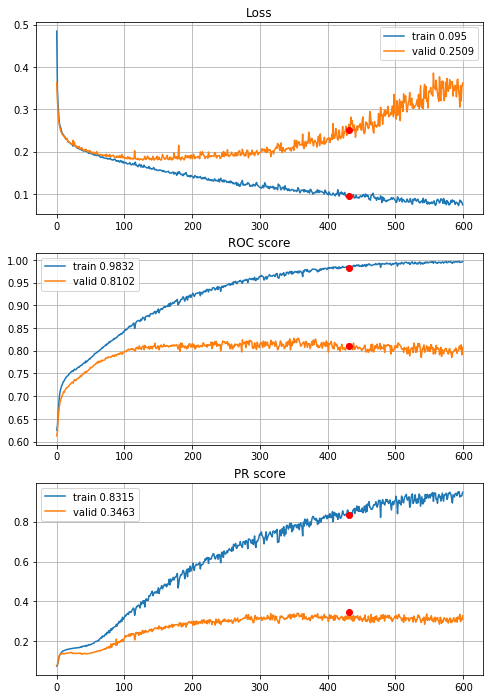


Fold 2------------------------------------------------------------


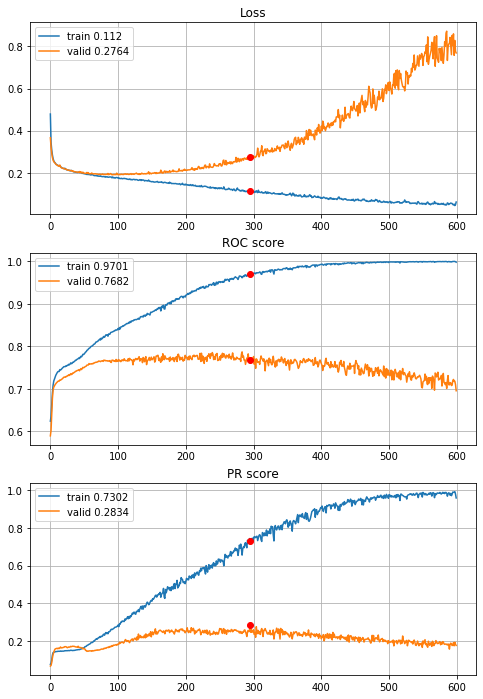


Fold 3------------------------------------------------------------


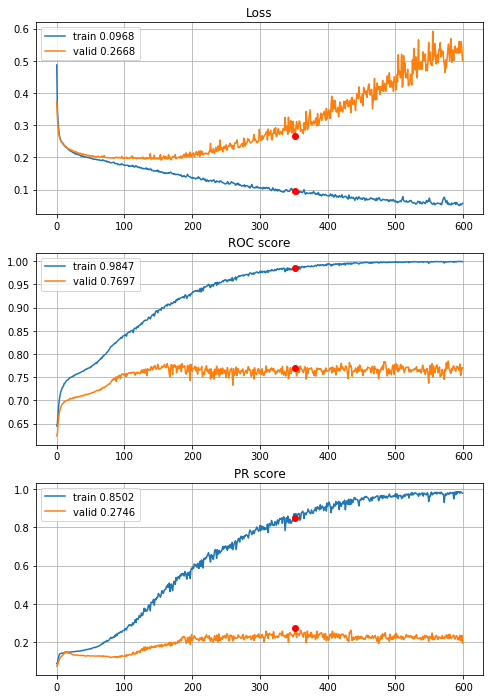


Fold 4------------------------------------------------------------


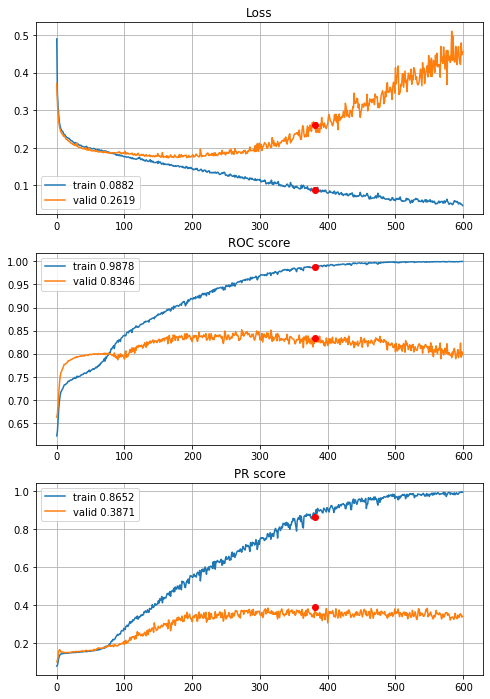


Fold 5------------------------------------------------------------


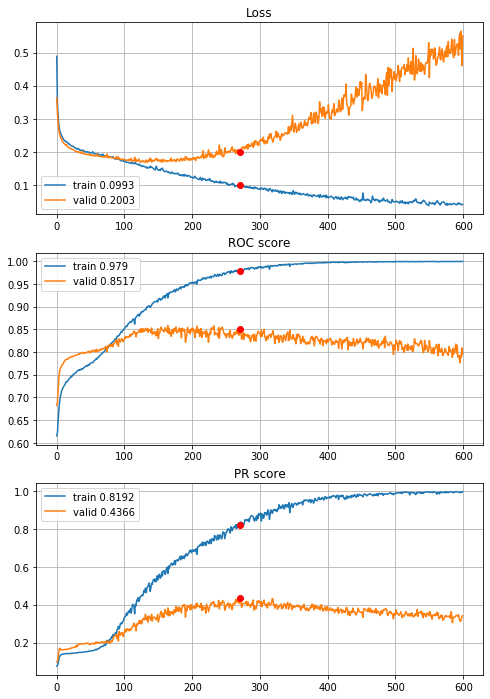


Fold 6------------------------------------------------------------


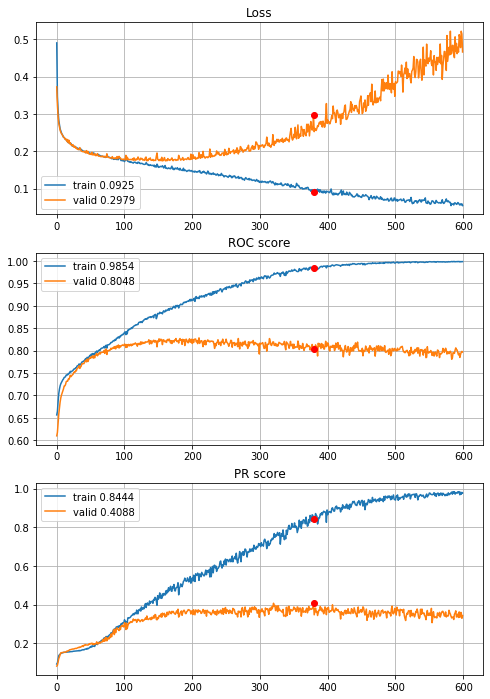

In [63]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_drop2_02_l1_000025, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_2dense_std_drop2_02_l1_000025_600ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Standard CNN model results was very close to the best of inceptions. Maybe in this problem standard CNN architecture is the best idea, lets perform some experiments with that. There were used 2 dense layers, and huge overfitting occurs even on 100 epochs. Lets start with some regularization and more epochs, ideas:
 - more epochs: 400
 - regularization: $L_1$, $L_2$,
 - dropout
 - different regularization configurations on dese layers

In [55]:
def define_CNN_L1_00005(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                          #(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)                          #(8,8,32)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                           #(8,8,64)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)               #(4,4,64)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                           #(4,4,32)
    dense = layers.Flatten()(early)                                                                   #(512,)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l1(l=0.00005))(dense)                        #(512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l1(l=0.00005))(dense)                        #(256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)             #(1,)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 2.51s train loss: 0.8378033361609619, validation loss: 0.688972629277052
Epoch: 2/400,
cumulative time: 3.89s train loss: 0.6167390785018576, validation loss: 0.5254553551573263
Epoch: 3/400,
cumulative time: 5.26s train loss: 0.4875752733007985, validation loss: 0.43587763894569964
Epoch: 4/400,
cumulative time: 6.67s train loss: 0.4290559691693175, validation loss: 0.4053160564440136
Epoch: 5/400,
cumulative time: 8.07s train loss: 0.40434882375568326, validation loss: 0.38090704806488823
Epoch: 6/400,
cumulative time: 9.44s train loss: 0.3771486070327208, validation loss: 0.4100475310062047
Epoch: 7/400,
cumulative time: 10.81s train loss: 0.361777191402054, validation loss: 0.3445375421730493
Epoch: 8/400,
cumulative time: 12.29s train loss: 0.3416400358849969, validation loss: 0.3570645671462104
Epoch: 9/400,
cumulative time: 13.84s train loss: 0.336935204656316, validatio

Epoch: 77/400,
cumulative time: 107.53s train loss: 0.19709850684565255, validation loss: 0.2024172262686138
Epoch: 78/400,
cumulative time: 108.9s train loss: 0.19844267905229251, validation loss: 0.20232768180298918
Epoch: 79/400,
cumulative time: 110.26s train loss: 0.19537219070745362, validation loss: 0.2085489583023557
Epoch: 80/400,
cumulative time: 111.62s train loss: 0.19636041147579342, validation loss: 0.20058940929202826
Epoch: 81/400,
cumulative time: 112.98s train loss: 0.19493069374218763, validation loss: 0.20295574643361966
Epoch: 82/400,
cumulative time: 114.33s train loss: 0.1970081285756306, validation loss: 0.20128890943007863
Epoch: 83/400,
cumulative time: 115.69s train loss: 0.1943181128661314, validation loss: 0.20659473819380475
Epoch: 84/400,
cumulative time: 117.04s train loss: 0.19419989537335572, validation loss: 0.207040964339849
Epoch: 85/400,
cumulative time: 118.39s train loss: 0.19576371086848363, validation loss: 0.2002255341952313
Epoch: 86/400,
cum

Epoch: 152/400,
cumulative time: 210.15s train loss: 0.16813304002840546, validation loss: 0.2038577059911497
Epoch: 153/400,
cumulative time: 211.51s train loss: 0.1688949245450673, validation loss: 0.192447457470157
Epoch: 154/400,
cumulative time: 212.89s train loss: 0.1692115225767417, validation loss: 0.19263407871015548
Epoch: 155/400,
cumulative time: 214.23s train loss: 0.16998419541437912, validation loss: 0.20399253508564238
Epoch: 156/400,
cumulative time: 215.6s train loss: 0.16739375722086852, validation loss: 0.19635143951139455
Epoch: 157/400,
cumulative time: 216.95s train loss: 0.16711597576033235, validation loss: 0.19797312704132397
Epoch: 158/400,
cumulative time: 218.3s train loss: 0.1648807805658085, validation loss: 0.1965331626717455
Epoch: 159/400,
cumulative time: 219.67s train loss: 0.1702346324790779, validation loss: 0.19511909628701582
Epoch: 160/400,
cumulative time: 221.02s train loss: 0.16623713670091214, validation loss: 0.19248589932147625
Epoch: 161/

Epoch: 227/400,
cumulative time: 312.7s train loss: 0.14341511379206487, validation loss: 0.21804094560053822
Epoch: 228/400,
cumulative time: 314.05s train loss: 0.143453835316807, validation loss: 0.1925057095277058
Epoch: 229/400,
cumulative time: 315.41s train loss: 0.1416971199625392, validation loss: 0.1937136770390263
Epoch: 230/400,
cumulative time: 316.77s train loss: 0.14174309382033773, validation loss: 0.20021841922043293
Epoch: 231/400,
cumulative time: 318.13s train loss: 0.14054279173449763, validation loss: 0.19577543785411375
Epoch: 232/400,
cumulative time: 319.49s train loss: 0.14394749596717002, validation loss: 0.19313089905586917
Epoch: 233/400,
cumulative time: 320.84s train loss: 0.14029588987136365, validation loss: 0.19920862047667404
Epoch: 234/400,
cumulative time: 322.21s train loss: 0.13982148667365965, validation loss: 0.19089227422838556
Epoch: 235/400,
cumulative time: 323.59s train loss: 0.1402719138938709, validation loss: 0.20554492575445493
Epoch: 2

Epoch: 302/400,
cumulative time: 415.22s train loss: 0.11788613131150845, validation loss: 0.20562472788349473
Epoch: 303/400,
cumulative time: 416.58s train loss: 0.11363679833987193, validation loss: 0.21231619646510272
Epoch: 304/400,
cumulative time: 417.92s train loss: 0.11315439911778642, validation loss: 0.20385532859152397
Epoch: 305/400,
cumulative time: 419.29s train loss: 0.11613297197132202, validation loss: 0.20823622294597027
Epoch: 306/400,
cumulative time: 420.64s train loss: 0.10890634131459179, validation loss: 0.20392948542223893
Epoch: 307/400,
cumulative time: 422.0s train loss: 0.11214237036463774, validation loss: 0.2133455162980753
Epoch: 308/400,
cumulative time: 423.38s train loss: 0.11065109906129383, validation loss: 0.21307995405182537
Epoch: 309/400,
cumulative time: 424.73s train loss: 0.11121302457222185, validation loss: 0.21126177957708775
Epoch: 310/400,
cumulative time: 426.09s train loss: 0.11178520509860795, validation loss: 0.2039288062072271
Epoc

Epoch: 377/400,
cumulative time: 519.69s train loss: 0.08400824492923833, validation loss: 0.2203689195656955
Epoch: 378/400,
cumulative time: 521.05s train loss: 0.08967485879010763, validation loss: 0.23630023168981928
Epoch: 379/400,
cumulative time: 522.42s train loss: 0.08570773146481406, validation loss: 0.22390990765667676
Epoch: 380/400,
cumulative time: 523.78s train loss: 0.08681299848004873, validation loss: 0.2279891840570877
Epoch: 381/400,
cumulative time: 525.15s train loss: 0.08672966383449326, validation loss: 0.22654820736206008
Epoch: 382/400,
cumulative time: 526.52s train loss: 0.0859428236716842, validation loss: 0.24413607337995805
Epoch: 383/400,
cumulative time: 527.87s train loss: 0.08518731062713085, validation loss: 0.22869198818528141
Epoch: 384/400,
cumulative time: 529.24s train loss: 0.08640569150873999, validation loss: 0.26701848366132314
Epoch: 385/400,
cumulative time: 530.59s train loss: 0.08662932816536213, validation loss: 0.23712218497544427
Epoc

Epoch: 50/400,
cumulative time: 71.54s train loss: 0.20293714040942337, validation loss: 0.20194341828621837
Epoch: 51/400,
cumulative time: 72.93s train loss: 0.20258621645813074, validation loss: 0.20094368630643603
Epoch: 52/400,
cumulative time: 74.31s train loss: 0.20405386485911253, validation loss: 0.20601016033499156
Epoch: 53/400,
cumulative time: 75.7s train loss: 0.20252936883257144, validation loss: 0.204310589162487
Epoch: 54/400,
cumulative time: 77.08s train loss: 0.20206297709817508, validation loss: 0.2091094865695078
Epoch: 55/400,
cumulative time: 78.46s train loss: 0.20276047229912955, validation loss: 0.20058843773428967
Epoch: 56/400,
cumulative time: 79.84s train loss: 0.20221308840485144, validation loss: 0.21328699853527375
Epoch: 57/400,
cumulative time: 81.23s train loss: 0.20177784786145792, validation loss: 0.20356703340155158
Epoch: 58/400,
cumulative time: 82.72s train loss: 0.20168641049084604, validation loss: 0.20887002770879629
Epoch: 59/400,
cumulati

Epoch: 125/400,
cumulative time: 175.66s train loss: 0.18811525516673652, validation loss: 0.19494709915210798
Epoch: 126/400,
cumulative time: 177.12s train loss: 0.18753275873062641, validation loss: 0.1940810813982524
Epoch: 127/400,
cumulative time: 178.56s train loss: 0.18904119001476474, validation loss: 0.19725301055335284
Epoch: 128/400,
cumulative time: 179.99s train loss: 0.188279428224172, validation loss: 0.19261871205251016
Epoch: 129/400,
cumulative time: 181.46s train loss: 0.18711459444919237, validation loss: 0.19764346021263676
Epoch: 130/400,
cumulative time: 182.84s train loss: 0.18655726000469777, validation loss: 0.19506485396051504
Epoch: 131/400,
cumulative time: 184.28s train loss: 0.1864662274148051, validation loss: 0.195593743907748
Epoch: 132/400,
cumulative time: 185.67s train loss: 0.18861186601973418, validation loss: 0.2000130916875264
Epoch: 133/400,
cumulative time: 187.07s train loss: 0.1849500652609121, validation loss: 0.19432979053262953
Epoch: 13

Epoch: 200/400,
cumulative time: 279.28s train loss: 0.16459758756889012, validation loss: 0.19988681996777563
Epoch: 201/400,
cumulative time: 280.7s train loss: 0.1595332929744036, validation loss: 0.22156483916866285
Epoch: 202/400,
cumulative time: 282.07s train loss: 0.15922267861937237, validation loss: 0.19694670660508742
Epoch: 203/400,
cumulative time: 283.44s train loss: 0.16172272559084394, validation loss: 0.20276347967213396
Epoch: 204/400,
cumulative time: 284.81s train loss: 0.1606889593228647, validation loss: 0.19602534329104052
Epoch: 205/400,
cumulative time: 286.2s train loss: 0.16092792650537335, validation loss: 0.20412511304984537
Epoch: 206/400,
cumulative time: 287.57s train loss: 0.15969780077527432, validation loss: 0.19909868340170894
Epoch: 207/400,
cumulative time: 288.96s train loss: 0.15977475489905107, validation loss: 0.20856437903630481
Epoch: 208/400,
cumulative time: 290.34s train loss: 0.15849015864286276, validation loss: 0.20331893005161727
Epoch

Epoch: 275/400,
cumulative time: 383.05s train loss: 0.13746139888000897, validation loss: 0.2101019228129585
Epoch: 276/400,
cumulative time: 384.43s train loss: 0.13863538225713712, validation loss: 0.2165973947882409
Epoch: 277/400,
cumulative time: 385.79s train loss: 0.13659356613015017, validation loss: 0.21404568239326296
Epoch: 278/400,
cumulative time: 387.18s train loss: 0.13780530161133875, validation loss: 0.21994919422696935
Epoch: 279/400,
cumulative time: 388.56s train loss: 0.13759512564157994, validation loss: 0.22161504805818394
Epoch: 280/400,
cumulative time: 389.93s train loss: 0.13599439633569585, validation loss: 0.2124841546955524
Epoch: 281/400,
cumulative time: 391.31s train loss: 0.13604919491055453, validation loss: 0.2159492672301215
Epoch: 282/400,
cumulative time: 392.67s train loss: 0.13460764424256697, validation loss: 0.2145378995785671
Epoch: 283/400,
cumulative time: 394.05s train loss: 0.136122790083693, validation loss: 0.20919482135058584
Epoch: 2

Epoch: 350/400,
cumulative time: 487.99s train loss: 0.12112095233762717, validation loss: 0.23468618145639836
Epoch: 351/400,
cumulative time: 489.38s train loss: 0.11951117953771338, validation loss: 0.24726270553082166
Epoch: 352/400,
cumulative time: 490.77s train loss: 0.12060755851863597, validation loss: 0.23345892203349172
Epoch: 353/400,
cumulative time: 492.17s train loss: 0.11748221395358426, validation loss: 0.22660089004721423
Epoch: 354/400,
cumulative time: 493.55s train loss: 0.11674720759159957, validation loss: 0.24023823378198078
Epoch: 355/400,
cumulative time: 494.97s train loss: 0.12127318564433583, validation loss: 0.23179458314014018
Epoch: 356/400,
cumulative time: 496.38s train loss: 0.11536156523114863, validation loss: 0.24934361618420475
Epoch: 357/400,
cumulative time: 497.79s train loss: 0.1197473303885806, validation loss: 0.2316811976078175
Epoch: 358/400,
cumulative time: 499.2s train loss: 0.1179343303197511, validation loss: 0.22924880644875859
Epoch

Epoch: 23/400,
cumulative time: 33.25s train loss: 0.22670325554271137, validation loss: 0.2231192605036144
Epoch: 24/400,
cumulative time: 34.65s train loss: 0.22301747237249597, validation loss: 0.24536771255743756
Epoch: 25/400,
cumulative time: 36.04s train loss: 0.21744942056512567, validation loss: 0.2191488758855486
Epoch: 26/400,
cumulative time: 37.42s train loss: 0.21845230725396642, validation loss: 0.22083108599815668
Epoch: 27/400,
cumulative time: 38.81s train loss: 0.21386130908018364, validation loss: 0.2195216007302455
Epoch: 28/400,
cumulative time: 40.19s train loss: 0.21058529093871725, validation loss: 0.2150040091788225
Epoch: 29/400,
cumulative time: 41.57s train loss: 0.20843064999297906, validation loss: 0.20961870034995575
Epoch: 30/400,
cumulative time: 42.94s train loss: 0.20884425860610106, validation loss: 0.21837020094821533
Epoch: 31/400,
cumulative time: 44.33s train loss: 0.20936540726191274, validation loss: 0.210171273121467
Epoch: 32/400,
cumulative

Epoch: 99/400,
cumulative time: 139.54s train loss: 0.19445731860284793, validation loss: 0.20436064990261446
Epoch: 100/400,
cumulative time: 140.94s train loss: 0.19219851935817325, validation loss: 0.20426623433970367
Epoch: 101/400,
cumulative time: 142.33s train loss: 0.1940918211393585, validation loss: 0.2007932738230454
Epoch: 102/400,
cumulative time: 143.74s train loss: 0.19324444731752993, validation loss: 0.2038780223803913
Epoch: 103/400,
cumulative time: 145.13s train loss: 0.19298267368560557, validation loss: 0.20770693703765689
Epoch: 104/400,
cumulative time: 146.52s train loss: 0.19305194677115622, validation loss: 0.20650449639644
Epoch: 105/400,
cumulative time: 147.92s train loss: 0.19082839804864232, validation loss: 0.2014549106278332
Epoch: 106/400,
cumulative time: 149.31s train loss: 0.19303883914521844, validation loss: 0.21056889327226486
Epoch: 107/400,
cumulative time: 150.69s train loss: 0.19160213305923215, validation loss: 0.21249408680131598
Epoch: 10

Epoch: 174/400,
cumulative time: 244.7s train loss: 0.17172805353518195, validation loss: 0.2125673638041771
Epoch: 175/400,
cumulative time: 246.11s train loss: 0.173007726618579, validation loss: 0.2045072592323211
Epoch: 176/400,
cumulative time: 247.51s train loss: 0.17135161458106615, validation loss: 0.20442492079174868
Epoch: 177/400,
cumulative time: 248.91s train loss: 0.17100453304121024, validation loss: 0.20563335858736823
Epoch: 178/400,
cumulative time: 250.3s train loss: 0.1718064331519706, validation loss: 0.2054855847760396
Epoch: 179/400,
cumulative time: 251.69s train loss: 0.17015308831467968, validation loss: 0.2028135143124059
Epoch: 180/400,
cumulative time: 253.08s train loss: 0.1674396606040686, validation loss: 0.2203910146910289
Epoch: 181/400,
cumulative time: 254.47s train loss: 0.1701819926954884, validation loss: 0.20706888886233266
Epoch: 182/400,
cumulative time: 255.86s train loss: 0.16857469638719005, validation loss: 0.2109317991748158
Epoch: 183/400

Epoch: 249/400,
cumulative time: 349.85s train loss: 0.13959526352307364, validation loss: 0.21199443510310678
Epoch: 250/400,
cumulative time: 351.26s train loss: 0.13839680985292038, validation loss: 0.22023188027092355
Epoch: 251/400,
cumulative time: 352.68s train loss: 0.14074152675787693, validation loss: 0.21668480870227086
Epoch: 252/400,
cumulative time: 354.07s train loss: 0.1436732003768929, validation loss: 0.21743577822200938
Epoch: 253/400,
cumulative time: 355.47s train loss: 0.13610593806158275, validation loss: 0.21495679392142714
Epoch: 254/400,
cumulative time: 356.87s train loss: 0.1404009925869429, validation loss: 0.21215509213989003
Epoch: 255/400,
cumulative time: 358.26s train loss: 0.13636837868535126, validation loss: 0.21552766830114542
Epoch: 256/400,
cumulative time: 359.64s train loss: 0.13725286048860977, validation loss: 0.2131353411506519
Epoch: 257/400,
cumulative time: 361.05s train loss: 0.13907687034420887, validation loss: 0.21264987873576627
Epoc

Epoch: 324/400,
cumulative time: 455.12s train loss: 0.11912227306836115, validation loss: 0.23643260058129703
Epoch: 325/400,
cumulative time: 456.52s train loss: 0.11454550769617881, validation loss: 0.256349401542165
Epoch: 326/400,
cumulative time: 457.96s train loss: 0.11770667520673986, validation loss: 0.2262631297476686
Epoch: 327/400,
cumulative time: 459.34s train loss: 0.11481526957518655, validation loss: 0.22586045616577075
Epoch: 328/400,
cumulative time: 460.74s train loss: 0.11895942732429984, validation loss: 0.22468339776083918
Epoch: 329/400,
cumulative time: 462.12s train loss: 0.11611051454655111, validation loss: 0.2294804762016761
Epoch: 330/400,
cumulative time: 463.51s train loss: 0.11657238348326177, validation loss: 0.2275596472420118
Epoch: 331/400,
cumulative time: 464.9s train loss: 0.11514025164384308, validation loss: 0.2265177749305294
Epoch: 332/400,
cumulative time: 466.28s train loss: 0.11349893658521243, validation loss: 0.22408372037990146
Epoch: 3

Epoch: 399/400,
cumulative time: 559.58s train loss: 0.09805284233427204, validation loss: 0.2532619827454231
Epoch: 400/400,
cumulative time: 560.98s train loss: 0.09520758001531289, validation loss: 0.2536805012016738

Early stopping results:
best results in epoch: 335, 
best valid PR: 0.26141151887298336, 
valid ROC: 0.7835591133004925        
overfitting PR: 0.5087376553575262, 
overfitting ROC: 0.16345179977695345

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 2.35s train loss: 0.8324912187271607, validation loss: 0.6957275388677401
Epoch: 2/400,
cumulative time: 3.83s train loss: 0.6131528240611925, validation loss: 0.5452913790028301
Epoch: 3/400,
cumulative time: 5.31s train loss: 0.4867708003482003, validation loss: 0.43676883534073746
Epoch: 4/400,
cumulative time: 6.74s train loss: 0.41951784295914335, validation loss: 0.4088301527167438
Epoch: 5/400,
cumulative time: 8.22s train loss: 0.39243766342799735, valida

Epoch: 73/400,
cumulative time: 103.78s train loss: 0.20233615908995484, validation loss: 0.19974510228658227
Epoch: 74/400,
cumulative time: 105.19s train loss: 0.2017648390300362, validation loss: 0.20203883206462925
Epoch: 75/400,
cumulative time: 106.6s train loss: 0.20214894670857633, validation loss: 0.20422133679613927
Epoch: 76/400,
cumulative time: 108.01s train loss: 0.20292532044430772, validation loss: 0.1986673821025028
Epoch: 77/400,
cumulative time: 109.41s train loss: 0.20184143363057666, validation loss: 0.19835149862475748
Epoch: 78/400,
cumulative time: 110.81s train loss: 0.20189089712095928, validation loss: 0.19872426334451543
Epoch: 79/400,
cumulative time: 112.22s train loss: 0.20247419008633333, validation loss: 0.1996807847362217
Epoch: 80/400,
cumulative time: 113.62s train loss: 0.1999968566760435, validation loss: 0.20884237595161181
Epoch: 81/400,
cumulative time: 115.05s train loss: 0.20200042177996713, validation loss: 0.19830345491757598
Epoch: 82/400,


Epoch: 148/400,
cumulative time: 210.03s train loss: 0.19005595411013051, validation loss: 0.18963693567203616
Epoch: 149/400,
cumulative time: 211.45s train loss: 0.19183561204849303, validation loss: 0.19615012348469135
Epoch: 150/400,
cumulative time: 212.88s train loss: 0.1918849099052548, validation loss: 0.19254338461335133
Epoch: 151/400,
cumulative time: 214.29s train loss: 0.18987573069195227, validation loss: 0.19775640712943185
Epoch: 152/400,
cumulative time: 215.69s train loss: 0.18999179570661584, validation loss: 0.1916629652574486
Epoch: 153/400,
cumulative time: 217.1s train loss: 0.18975269889435423, validation loss: 0.1906843205610857
Epoch: 154/400,
cumulative time: 218.51s train loss: 0.19002146766058484, validation loss: 0.1960055544881126
Epoch: 155/400,
cumulative time: 219.92s train loss: 0.19193041624140386, validation loss: 0.19030295980877418
Epoch: 156/400,
cumulative time: 221.31s train loss: 0.19121292655561822, validation loss: 0.1907812966486481
Epoch: 

Epoch: 223/400,
cumulative time: 316.34s train loss: 0.17554807593967614, validation loss: 0.18964339178017486
Epoch: 224/400,
cumulative time: 317.76s train loss: 0.1736065292504914, validation loss: 0.20001020761798888
Epoch: 225/400,
cumulative time: 319.16s train loss: 0.17733261207744924, validation loss: 0.19526258179977526
Epoch: 226/400,
cumulative time: 320.57s train loss: 0.17581072081771773, validation loss: 0.19195509606108851
Epoch: 227/400,
cumulative time: 321.98s train loss: 0.17343703684074002, validation loss: 0.1889741054455223
Epoch: 228/400,
cumulative time: 323.37s train loss: 0.17771628204985274, validation loss: 0.19202085382034376
Epoch: 229/400,
cumulative time: 324.78s train loss: 0.1730523815328575, validation loss: 0.21430830639223405
Epoch: 230/400,
cumulative time: 326.19s train loss: 0.17512117352437603, validation loss: 0.19389379780214608
Epoch: 231/400,
cumulative time: 327.61s train loss: 0.17312169913722533, validation loss: 0.19381285633782774
Epoc

Epoch: 298/400,
cumulative time: 422.87s train loss: 0.15525637380347562, validation loss: 0.21292239928667525
Epoch: 299/400,
cumulative time: 424.28s train loss: 0.16176823138111085, validation loss: 0.1979048429418373
Epoch: 300/400,
cumulative time: 425.69s train loss: 0.1558304272960386, validation loss: 0.20534145553108785
Epoch: 301/400,
cumulative time: 427.09s train loss: 0.158041452342396, validation loss: 0.19703567483499798
Epoch: 302/400,
cumulative time: 428.5s train loss: 0.15541544783899508, validation loss: 0.19581850969604767
Epoch: 303/400,
cumulative time: 429.91s train loss: 0.1562663841280839, validation loss: 0.20775719541850912
Epoch: 304/400,
cumulative time: 431.31s train loss: 0.16335847723813599, validation loss: 0.21204880844621612
Epoch: 305/400,
cumulative time: 432.72s train loss: 0.15375616279777318, validation loss: 0.20153321091458454
Epoch: 306/400,
cumulative time: 434.13s train loss: 0.15572771375427352, validation loss: 0.2054086280891569
Epoch: 3

Epoch: 373/400,
cumulative time: 529.16s train loss: 0.14199350888131992, validation loss: 0.21011343363030904
Epoch: 374/400,
cumulative time: 530.56s train loss: 0.13701124720038987, validation loss: 0.21024453556805422
Epoch: 375/400,
cumulative time: 531.96s train loss: 0.13870982342072052, validation loss: 0.20861721426309413
Epoch: 376/400,
cumulative time: 533.37s train loss: 0.16061815244047906, validation loss: 0.21847702289942253
Epoch: 377/400,
cumulative time: 534.81s train loss: 0.13549440747184519, validation loss: 0.20819171575399545
Epoch: 378/400,
cumulative time: 536.22s train loss: 0.1360202646642684, validation loss: 0.20905318954633645
Epoch: 379/400,
cumulative time: 537.62s train loss: 0.13793135553103256, validation loss: 0.21343056342283667
Epoch: 380/400,
cumulative time: 539.04s train loss: 0.13829293381968133, validation loss: 0.21289764475546538
Epoch: 381/400,
cumulative time: 540.44s train loss: 0.1357236701741979, validation loss: 0.23072823402303835
Epo

Epoch: 46/400,
cumulative time: 67.04s train loss: 0.20533745132045808, validation loss: 0.19994875985611363
Epoch: 47/400,
cumulative time: 68.48s train loss: 0.20373054727717163, validation loss: 0.1999611571958994
Epoch: 48/400,
cumulative time: 69.95s train loss: 0.207909103994276, validation loss: 0.19916945541587122
Epoch: 49/400,
cumulative time: 71.37s train loss: 0.20283306634747514, validation loss: 0.1997185005560233
Epoch: 50/400,
cumulative time: 72.77s train loss: 0.20425982430398723, validation loss: 0.20128567362513788
Epoch: 51/400,
cumulative time: 74.18s train loss: 0.20407031963057898, validation loss: 0.20079137803098487
Epoch: 52/400,
cumulative time: 75.58s train loss: 0.20303975880421973, validation loss: 0.2002719799691065
Epoch: 53/400,
cumulative time: 76.98s train loss: 0.2040544696200907, validation loss: 0.20238407222142987
Epoch: 54/400,
cumulative time: 78.4s train loss: 0.20375985514640418, validation loss: 0.2003638910824986
Epoch: 55/400,
cumulative t

Epoch: 121/400,
cumulative time: 173.95s train loss: 0.19716578653824876, validation loss: 0.19656915723140622
Epoch: 122/400,
cumulative time: 175.34s train loss: 0.19618581663938908, validation loss: 0.1981891962707205
Epoch: 123/400,
cumulative time: 176.73s train loss: 0.19675570737757195, validation loss: 0.19682591028856647
Epoch: 124/400,
cumulative time: 178.13s train loss: 0.19651723986244019, validation loss: 0.2045814352927156
Epoch: 125/400,
cumulative time: 179.52s train loss: 0.19604129857162506, validation loss: 0.1962941559361502
Epoch: 126/400,
cumulative time: 180.91s train loss: 0.1959851658892917, validation loss: 0.1963625107701533
Epoch: 127/400,
cumulative time: 182.29s train loss: 0.19524799062097384, validation loss: 0.19635567883136162
Epoch: 128/400,
cumulative time: 183.67s train loss: 0.19616112578457348, validation loss: 0.19590420982412163
Epoch: 129/400,
cumulative time: 185.05s train loss: 0.195615225376192, validation loss: 0.19666522938240452
Epoch: 1

Epoch: 196/400,
cumulative time: 278.88s train loss: 0.1743202403934433, validation loss: 0.19326477788124813
Epoch: 197/400,
cumulative time: 280.26s train loss: 0.17207385758282961, validation loss: 0.19352546675328663
Epoch: 198/400,
cumulative time: 281.65s train loss: 0.1707192905539391, validation loss: 0.21189583289850636
Epoch: 199/400,
cumulative time: 283.02s train loss: 0.1718443871631991, validation loss: 0.19280819024393278
Epoch: 200/400,
cumulative time: 284.41s train loss: 0.17400904918953874, validation loss: 0.1942752658183958
Epoch: 201/400,
cumulative time: 285.78s train loss: 0.17008907519167285, validation loss: 0.19760158410351672
Epoch: 202/400,
cumulative time: 287.17s train loss: 0.17065485758394458, validation loss: 0.19081598546670633
Epoch: 203/400,
cumulative time: 288.57s train loss: 0.1709322306187519, validation loss: 0.1934817346467634
Epoch: 204/400,
cumulative time: 289.98s train loss: 0.16982874735451278, validation loss: 0.19959514263296646
Epoch: 

Epoch: 271/400,
cumulative time: 383.19s train loss: 0.15036341222916164, validation loss: 0.19994498783220063
Epoch: 272/400,
cumulative time: 384.58s train loss: 0.15173033600944968, validation loss: 0.20214237642223243
Epoch: 273/400,
cumulative time: 386.2s train loss: 0.14782043334405082, validation loss: 0.20414993237978107
Epoch: 274/400,
cumulative time: 387.66s train loss: 0.14975199687714671, validation loss: 0.19848048989470712
Epoch: 275/400,
cumulative time: 389.1s train loss: 0.14888829551840074, validation loss: 0.19950443203751334
Epoch: 276/400,
cumulative time: 390.56s train loss: 0.14577236285226214, validation loss: 0.20039558820730985
Epoch: 277/400,
cumulative time: 392.01s train loss: 0.14920379404254533, validation loss: 0.20046800553636265
Epoch: 278/400,
cumulative time: 393.47s train loss: 0.147311052747785, validation loss: 0.19906687805535683
Epoch: 279/400,
cumulative time: 394.87s train loss: 0.14794345789493624, validation loss: 0.20811331186859744
Epoch

Epoch: 346/400,
cumulative time: 488.32s train loss: 0.1315097845948762, validation loss: 0.21073868221093264
Epoch: 347/400,
cumulative time: 489.76s train loss: 0.13005098778437946, validation loss: 0.20935152014286057
Epoch: 348/400,
cumulative time: 491.16s train loss: 0.13175986942577467, validation loss: 0.21327633522349418
Epoch: 349/400,
cumulative time: 492.58s train loss: 0.12817637295074646, validation loss: 0.20712680192994162
Epoch: 350/400,
cumulative time: 493.97s train loss: 0.12974635656509134, validation loss: 0.21183040035680464
Epoch: 351/400,
cumulative time: 495.37s train loss: 0.13018680932426374, validation loss: 0.21428477867666318
Epoch: 352/400,
cumulative time: 496.76s train loss: 0.12873522367141735, validation loss: 0.2146868770104663
Epoch: 353/400,
cumulative time: 498.15s train loss: 0.1289666889211029, validation loss: 0.2172469160740317
Epoch: 354/400,
cumulative time: 499.54s train loss: 0.130123142258534, validation loss: 0.21574286824188701
Epoch: 

Epoch: 19/400,
cumulative time: 29.38s train loss: 0.22437007059718528, validation loss: 0.2328356754552441
Epoch: 20/400,
cumulative time: 30.93s train loss: 0.22128781152398108, validation loss: 0.21801934194337444
Epoch: 21/400,
cumulative time: 32.45s train loss: 0.21775648817988133, validation loss: 0.21699447113746517
Epoch: 22/400,
cumulative time: 33.93s train loss: 0.2148768178193398, validation loss: 0.2096322161381511
Epoch: 23/400,
cumulative time: 35.48s train loss: 0.21027407023755423, validation loss: 0.21179950838192932
Epoch: 24/400,
cumulative time: 37.03s train loss: 0.20948944857632154, validation loss: 0.2086465190639288
Epoch: 25/400,
cumulative time: 38.54s train loss: 0.2078094235895311, validation loss: 0.20802767479370984
Epoch: 26/400,
cumulative time: 39.95s train loss: 0.20712464010192808, validation loss: 0.20432447063500614
Epoch: 27/400,
cumulative time: 41.47s train loss: 0.20689191997927778, validation loss: 0.20681029988569524
Epoch: 28/400,
cumulativ

Epoch: 95/400,
cumulative time: 143.34s train loss: 0.19317202059418156, validation loss: 0.1959619081962336
Epoch: 96/400,
cumulative time: 144.74s train loss: 0.19365152597329974, validation loss: 0.19319362244099297
Epoch: 97/400,
cumulative time: 146.17s train loss: 0.1928560704414881, validation loss: 0.20735638221213212
Epoch: 98/400,
cumulative time: 147.59s train loss: 0.19205075806749414, validation loss: 0.19363378061423184
Epoch: 99/400,
cumulative time: 149.01s train loss: 0.19364494647351874, validation loss: 0.1926925552435402
Epoch: 100/400,
cumulative time: 150.54s train loss: 0.19290654425771017, validation loss: 0.19405072525509046
Epoch: 101/400,
cumulative time: 152.07s train loss: 0.1916752314207211, validation loss: 0.19282454175098065
Epoch: 102/400,
cumulative time: 153.55s train loss: 0.19339483584356465, validation loss: 0.2211149158286139
Epoch: 103/400,
cumulative time: 155.08s train loss: 0.19190032861940157, validation loss: 0.19497404775356403
Epoch: 104/

Epoch: 170/400,
cumulative time: 251.15s train loss: 0.17619343732193535, validation loss: 0.1928759102153843
Epoch: 171/400,
cumulative time: 252.57s train loss: 0.17585787757792892, validation loss: 0.18846953302946662
Epoch: 172/400,
cumulative time: 253.99s train loss: 0.17433334137505826, validation loss: 0.18763599865524255
Epoch: 173/400,
cumulative time: 255.43s train loss: 0.17625381010696128, validation loss: 0.18459176682240308
Epoch: 174/400,
cumulative time: 256.85s train loss: 0.17526654524562277, validation loss: 0.1894657324380381
Epoch: 175/400,
cumulative time: 258.26s train loss: 0.1744315285511591, validation loss: 0.1861657847622435
Epoch: 176/400,
cumulative time: 259.66s train loss: 0.17326013545844549, validation loss: 0.18471213499190697
Epoch: 177/400,
cumulative time: 261.1s train loss: 0.17478710705970368, validation loss: 0.18476378523848688
Epoch: 178/400,
cumulative time: 262.51s train loss: 0.17434352430594124, validation loss: 0.18900143726645113
Epoch:

Epoch: 245/400,
cumulative time: 358.26s train loss: 0.15918711423955062, validation loss: 0.18385251528235808
Epoch: 246/400,
cumulative time: 359.69s train loss: 0.15802187783225624, validation loss: 0.1865905511119385
Epoch: 247/400,
cumulative time: 361.1s train loss: 0.15760026648559472, validation loss: 0.20457876341706727
Epoch: 248/400,
cumulative time: 362.52s train loss: 0.15976945670983045, validation loss: 0.18468200202209098
Epoch: 249/400,
cumulative time: 363.93s train loss: 0.1563050040816949, validation loss: 0.18627823808050287
Epoch: 250/400,
cumulative time: 365.36s train loss: 0.1543160779665433, validation loss: 0.18584014759563944
Epoch: 251/400,
cumulative time: 366.77s train loss: 0.15765971244842397, validation loss: 0.18857152721456352
Epoch: 252/400,
cumulative time: 368.18s train loss: 0.15501464181833277, validation loss: 0.18757460457184008
Epoch: 253/400,
cumulative time: 369.6s train loss: 0.15645719265812819, validation loss: 0.1877657569518531
Epoch: 

Epoch: 320/400,
cumulative time: 464.36s train loss: 0.14060730122289497, validation loss: 0.19002096941669241
Epoch: 321/400,
cumulative time: 465.75s train loss: 0.13731547962663154, validation loss: 0.19270688981548642
Epoch: 322/400,
cumulative time: 467.15s train loss: 0.13967088006501754, validation loss: 0.18943443914687602
Epoch: 323/400,
cumulative time: 468.53s train loss: 0.1373355128723227, validation loss: 0.19199392767952964
Epoch: 324/400,
cumulative time: 469.92s train loss: 0.13939761526452496, validation loss: 0.1958241282431891
Epoch: 325/400,
cumulative time: 471.31s train loss: 0.13834633019576276, validation loss: 0.1876121376328962
Epoch: 326/400,
cumulative time: 472.69s train loss: 0.13768936800597995, validation loss: 0.1920820675810611
Epoch: 327/400,
cumulative time: 474.09s train loss: 0.13587105068660185, validation loss: 0.18890991496373913
Epoch: 328/400,
cumulative time: 475.47s train loss: 0.13638443077157592, validation loss: 0.1846320106767179
Epoch:

Epoch: 395/400,
cumulative time: 570.65s train loss: 0.12072621320002998, validation loss: 0.20639359277015812
Epoch: 396/400,
cumulative time: 572.03s train loss: 0.12184028716834996, validation loss: 0.19904068540730982
Epoch: 397/400,
cumulative time: 573.42s train loss: 0.12042636337663679, validation loss: 0.1963937357271075
Epoch: 398/400,
cumulative time: 574.78s train loss: 0.1250543876171664, validation loss: 0.19758532906829174
Epoch: 399/400,
cumulative time: 576.17s train loss: 0.12092132027989379, validation loss: 0.20548188530050765
Epoch: 400/400,
cumulative time: 577.6s train loss: 0.1212839782278587, validation loss: 0.2083304505135448

Early stopping results:
best results in epoch: 386, 
best valid PR: 0.36309704909680396, 
valid ROC: 0.8179950890231262        
overfitting PR: 0.3247598740132166, 
overfitting ROC: 0.115627743456578

Cross validation time: 3424s
ROC: 		0.7923373483311601
PR: 		0.3080278568601588
overfittingROC: 0.1434444338036902
overfittingPR:  0.4003

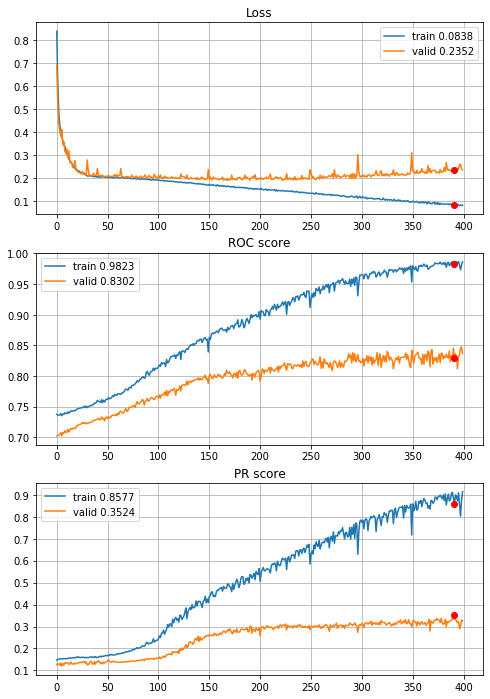


Fold 2------------------------------------------------------------


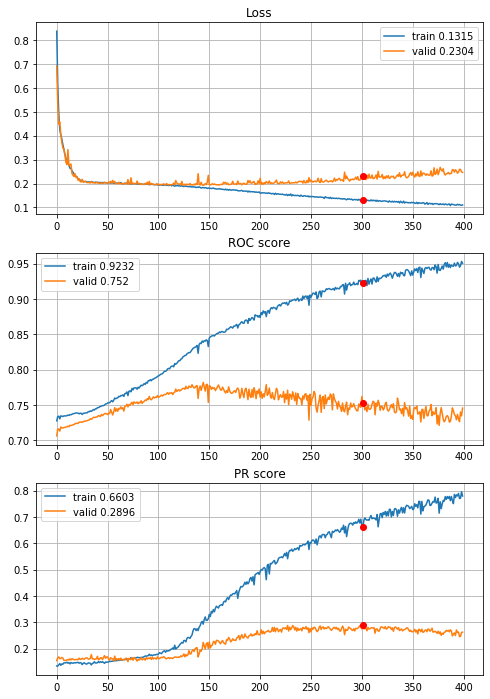


Fold 3------------------------------------------------------------


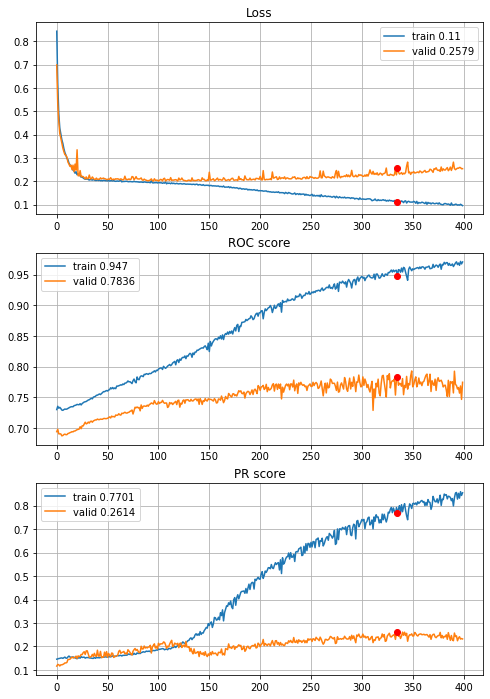


Fold 4------------------------------------------------------------


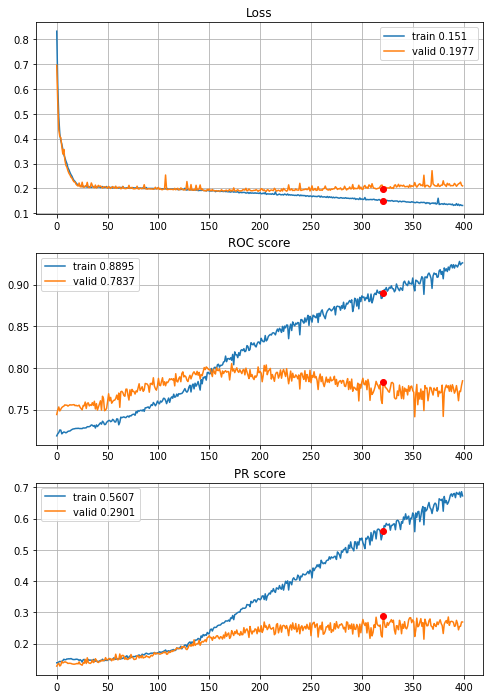


Fold 5------------------------------------------------------------


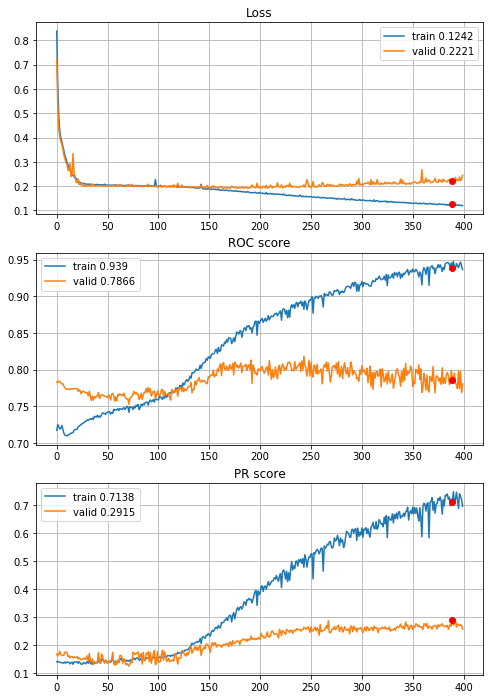


Fold 6------------------------------------------------------------


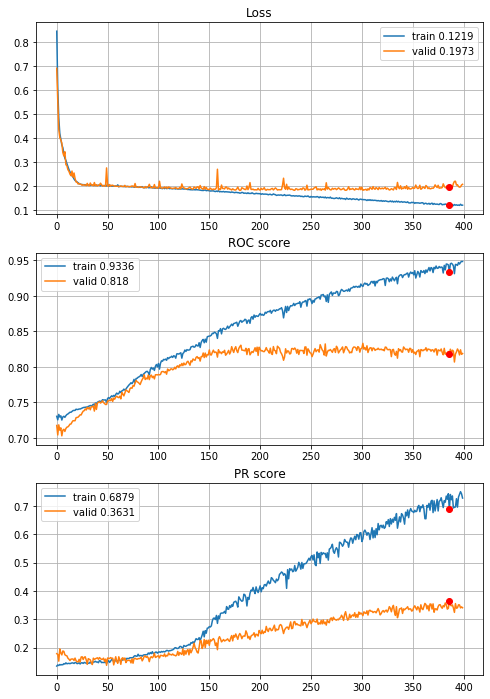

In [57]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L1_00005, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_CNN_L1_00005_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets try $L_2$

In [56]:
def define_CNN_L2_00005(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                          #(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)                          #(8,8,32)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                           #(8,8,64)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)               #(4,4,64)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                           #(4,4,32)
    dense = layers.Flatten()(early)                                                                   #(512,)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                        #(512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                        #(256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)             #(1,)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 2.26s train loss: 0.2560640693636238, validation loss: 0.23608373831818102
Epoch: 2/400,
cumulative time: 3.69s train loss: 0.24027318806247588, validation loss: 0.22181928152734523
Epoch: 3/400,
cumulative time: 5.13s train loss: 0.22627396254323248, validation loss: 0.218290075456877
Epoch: 4/400,
cumulative time: 6.63s train loss: 0.22094995954714336, validation loss: 0.21348088558755657
Epoch: 5/400,
cumulative time: 8.08s train loss: 0.2191907144747101, validation loss: 0.21067912952684073
Epoch: 6/400,
cumulative time: 9.54s train loss: 0.21529220852071967, validation loss: 0.21073458640448814
Epoch: 7/400,
cumulative time: 10.98s train loss: 0.21027656937918285, validation loss: 0.20819216986916517
Epoch: 8/400,
cumulative time: 12.42s train loss: 0.20720102698986723, validation loss: 0.2071083688752192
Epoch: 9/400,
cumulative time: 13.84s train loss: 0.2148184777341096

Epoch: 76/400,
cumulative time: 110.07s train loss: 0.12243116346769918, validation loss: 0.17094739819157279
Epoch: 77/400,
cumulative time: 111.48s train loss: 0.12401580933928409, validation loss: 0.18319686909489602
Epoch: 78/400,
cumulative time: 112.89s train loss: 0.12099300914834797, validation loss: 0.18673930313613157
Epoch: 79/400,
cumulative time: 114.3s train loss: 0.11845208953061026, validation loss: 0.2149367215501118
Epoch: 80/400,
cumulative time: 115.71s train loss: 0.11981313832304093, validation loss: 0.17151237046377768
Epoch: 81/400,
cumulative time: 117.13s train loss: 0.115611680691125, validation loss: 0.1900312984229108
Epoch: 82/400,
cumulative time: 118.55s train loss: 0.12728809119163767, validation loss: 0.16951156527798059
Epoch: 83/400,
cumulative time: 119.96s train loss: 0.10968322972786713, validation loss: 0.1759255823734425
Epoch: 84/400,
cumulative time: 121.37s train loss: 0.11446357890202566, validation loss: 0.17149015373523094
Epoch: 85/400,
c

Epoch: 151/400,
cumulative time: 216.59s train loss: 0.07226687082677094, validation loss: 0.22967069988107908
Epoch: 152/400,
cumulative time: 217.99s train loss: 0.06118634236406017, validation loss: 0.24983621570754003
Epoch: 153/400,
cumulative time: 219.4s train loss: 0.07063460748489978, validation loss: 0.2397527991710998
Epoch: 154/400,
cumulative time: 220.82s train loss: 0.07578701703490474, validation loss: 0.2249403416278656
Epoch: 155/400,
cumulative time: 222.21s train loss: 0.06453038072973251, validation loss: 0.2325458264294086
Epoch: 156/400,
cumulative time: 223.62s train loss: 0.07437793984572894, validation loss: 0.23069931595117726
Epoch: 157/400,
cumulative time: 225.03s train loss: 0.06345398037769352, validation loss: 0.23454378665994835
Epoch: 158/400,
cumulative time: 226.45s train loss: 0.06941387559860908, validation loss: 0.23937727623524677
Epoch: 159/400,
cumulative time: 227.86s train loss: 0.05990231215718428, validation loss: 0.2531184068011783
Epoch:

Epoch: 226/400,
cumulative time: 322.95s train loss: 0.049605516573518464, validation loss: 0.3262143858522684
Epoch: 227/400,
cumulative time: 324.38s train loss: 0.050840099228653325, validation loss: 0.3334030629096995
Epoch: 228/400,
cumulative time: 325.81s train loss: 0.03955786013611733, validation loss: 0.3402510058360493
Epoch: 229/400,
cumulative time: 327.23s train loss: 0.04346107130170875, validation loss: 0.3013216913598504
Epoch: 230/400,
cumulative time: 328.65s train loss: 0.050559322693059607, validation loss: 0.2901643349290138
Epoch: 231/400,
cumulative time: 330.04s train loss: 0.04075899061480676, validation loss: 0.2832171328421593
Epoch: 232/400,
cumulative time: 331.43s train loss: 0.04565093589810411, validation loss: 0.2920049232556919
Epoch: 233/400,
cumulative time: 332.85s train loss: 0.04695016410276365, validation loss: 0.2813413686254059
Epoch: 234/400,
cumulative time: 334.25s train loss: 0.041399846669480794, validation loss: 0.2867210519971127
Epoch:

Epoch: 300/400,
cumulative time: 427.52s train loss: 0.04019479399381339, validation loss: 0.3210473490702692
Epoch: 301/400,
cumulative time: 428.91s train loss: 0.032665062383229214, validation loss: 0.33049086596464283
Epoch: 302/400,
cumulative time: 430.33s train loss: 0.0392962792041304, validation loss: 0.3395060310565021
Epoch: 303/400,
cumulative time: 431.73s train loss: 0.031443228607511024, validation loss: 0.37801990507410205
Epoch: 304/400,
cumulative time: 433.13s train loss: 0.033853908008679566, validation loss: 0.4657046669920421
Epoch: 305/400,
cumulative time: 434.54s train loss: 0.02914102022586451, validation loss: 0.33399844555079006
Epoch: 306/400,
cumulative time: 435.94s train loss: 0.028144560076005125, validation loss: 0.3654927258957317
Epoch: 307/400,
cumulative time: 437.34s train loss: 0.04182270091789531, validation loss: 0.32504553333117575
Epoch: 308/400,
cumulative time: 438.74s train loss: 0.03913413854773738, validation loss: 0.37366465093166024
Ep

Epoch: 374/400,
cumulative time: 532.05s train loss: 0.016580834756736596, validation loss: 0.3467170778913024
Epoch: 375/400,
cumulative time: 533.45s train loss: 0.0287820678014051, validation loss: 0.3395363697192554
Epoch: 376/400,
cumulative time: 534.88s train loss: 0.023724736285109408, validation loss: 0.4137607416666796
Epoch: 377/400,
cumulative time: 536.28s train loss: 0.029087829042490392, validation loss: 0.37930637610210216
Epoch: 378/400,
cumulative time: 537.69s train loss: 0.021316589243242288, validation loss: 0.44875663608170596
Epoch: 379/400,
cumulative time: 539.09s train loss: 0.024679746583051373, validation loss: 0.33558774635530475
Epoch: 380/400,
cumulative time: 540.49s train loss: 0.03339049489956882, validation loss: 0.3554573666895223
Epoch: 381/400,
cumulative time: 541.88s train loss: 0.02028794327668869, validation loss: 0.3962519485338599
Epoch: 382/400,
cumulative time: 543.29s train loss: 0.03328009383037867, validation loss: 0.36149992907915574
Ep

Epoch: 47/400,
cumulative time: 68.38s train loss: 0.1603131241265425, validation loss: 0.1808378443963841
Epoch: 48/400,
cumulative time: 69.8s train loss: 0.16032644382260824, validation loss: 0.21805220712521517
Epoch: 49/400,
cumulative time: 71.22s train loss: 0.1624440274179899, validation loss: 0.18571870288652495
Epoch: 50/400,
cumulative time: 72.64s train loss: 0.15795680134169465, validation loss: 0.1873010715978173
Epoch: 51/400,
cumulative time: 74.07s train loss: 0.15827373832151706, validation loss: 0.18208580378410036
Epoch: 52/400,
cumulative time: 75.49s train loss: 0.1606627022328793, validation loss: 0.1895451973375615
Epoch: 53/400,
cumulative time: 76.91s train loss: 0.1513250573047026, validation loss: 0.20036335077474035
Epoch: 54/400,
cumulative time: 78.33s train loss: 0.15184709982725575, validation loss: 0.18305147140508124
Epoch: 55/400,
cumulative time: 79.76s train loss: 0.15643484951745876, validation loss: 0.18186373915333096
Epoch: 56/400,
cumulative t

Epoch: 122/400,
cumulative time: 175.43s train loss: 0.09588959003933993, validation loss: 0.30388096260975783
Epoch: 123/400,
cumulative time: 176.95s train loss: 0.09471928223665187, validation loss: 0.24576072554104664
Epoch: 124/400,
cumulative time: 178.38s train loss: 0.09767633102743921, validation loss: 0.27986427258073754
Epoch: 125/400,
cumulative time: 179.78s train loss: 0.0842926367959047, validation loss: 0.26840917115880164
Epoch: 126/400,
cumulative time: 181.21s train loss: 0.08643762943052424, validation loss: 0.25990767786095464
Epoch: 127/400,
cumulative time: 182.64s train loss: 0.10083413638106552, validation loss: 0.2484122447268828
Epoch: 128/400,
cumulative time: 184.13s train loss: 0.09533670725435095, validation loss: 0.25071927010404405
Epoch: 129/400,
cumulative time: 185.57s train loss: 0.08829903649071102, validation loss: 0.24432298634391483
Epoch: 130/400,
cumulative time: 186.98s train loss: 0.09164405531748007, validation loss: 0.25106829489024013
Epo

Epoch: 197/400,
cumulative time: 282.23s train loss: 0.059102031585814827, validation loss: 0.3623874628113759
Epoch: 198/400,
cumulative time: 283.65s train loss: 0.06051307334992682, validation loss: 0.3323452288983548
Epoch: 199/400,
cumulative time: 285.09s train loss: 0.05924488619592913, validation loss: 0.3431221253414232
Epoch: 200/400,
cumulative time: 286.51s train loss: 0.04746836913189235, validation loss: 0.3376445523162047
Epoch: 201/400,
cumulative time: 287.94s train loss: 0.06340218740844539, validation loss: 0.37278175498045085
Epoch: 202/400,
cumulative time: 289.52s train loss: 0.062321442842329294, validation loss: 0.3196168319354502
Epoch: 203/400,
cumulative time: 290.99s train loss: 0.04717347992731995, validation loss: 0.34096602197810044
Epoch: 204/400,
cumulative time: 292.46s train loss: 0.05989880652152825, validation loss: 0.3263960645424419
Epoch: 205/400,
cumulative time: 293.92s train loss: 0.050917655952507156, validation loss: 0.3410657252926174
Epoch

Epoch: 272/400,
cumulative time: 389.49s train loss: 0.04790668478371312, validation loss: 0.3864527406783393
Epoch: 273/400,
cumulative time: 390.9s train loss: 0.04513260918114769, validation loss: 0.40268399905720237
Epoch: 274/400,
cumulative time: 392.32s train loss: 0.041085652669659106, validation loss: 0.4212389016045933
Epoch: 275/400,
cumulative time: 393.74s train loss: 0.028455641534142415, validation loss: 0.4073338082771548
Epoch: 276/400,
cumulative time: 395.15s train loss: 0.03850178827520094, validation loss: 0.5036459947784715
Epoch: 277/400,
cumulative time: 396.58s train loss: 0.04545340616467553, validation loss: 0.5573028127420021
Epoch: 278/400,
cumulative time: 397.99s train loss: 0.03810205201254494, validation loss: 0.4443644899507215
Epoch: 279/400,
cumulative time: 399.42s train loss: 0.05152030751650947, validation loss: 0.39699374606935567
Epoch: 280/400,
cumulative time: 400.84s train loss: 0.028832606964668654, validation loss: 0.5259732737315602
Epoch:

Epoch: 347/400,
cumulative time: 496.7s train loss: 0.02873504790842095, validation loss: 0.44108079697421976
Epoch: 348/400,
cumulative time: 498.12s train loss: 0.026708080557984293, validation loss: 0.6069185019269778
Epoch: 349/400,
cumulative time: 499.53s train loss: 0.03807830346534395, validation loss: 0.4284915842313682
Epoch: 350/400,
cumulative time: 500.95s train loss: 0.037078189342071535, validation loss: 0.45448852392830275
Epoch: 351/400,
cumulative time: 502.35s train loss: 0.0297735198879703, validation loss: 0.43556726463722323
Epoch: 352/400,
cumulative time: 503.75s train loss: 0.03711004979603057, validation loss: 0.4318131273136892
Epoch: 353/400,
cumulative time: 505.17s train loss: 0.01931722991545949, validation loss: 0.4280370742670933
Epoch: 354/400,
cumulative time: 506.58s train loss: 0.043091458243224176, validation loss: 0.4321639599282373
Epoch: 355/400,
cumulative time: 508.01s train loss: 0.029704259125860548, validation loss: 0.420656855675215
Epoch:

Epoch: 19/400,
cumulative time: 28.04s train loss: 0.19037493620177925, validation loss: 0.20464832447798906
Epoch: 20/400,
cumulative time: 29.45s train loss: 0.1904510329659492, validation loss: 0.20857399279077984
Epoch: 21/400,
cumulative time: 30.87s train loss: 0.18550083259746877, validation loss: 0.24825612860849067
Epoch: 22/400,
cumulative time: 32.3s train loss: 0.18625488891095698, validation loss: 0.20045963409524778
Epoch: 23/400,
cumulative time: 33.72s train loss: 0.18660865171710883, validation loss: 0.199279605693116
Epoch: 24/400,
cumulative time: 35.15s train loss: 0.1830019197001471, validation loss: 0.22772441342868635
Epoch: 25/400,
cumulative time: 36.58s train loss: 0.18066948150827045, validation loss: 0.2007956431482502
Epoch: 26/400,
cumulative time: 37.99s train loss: 0.18427188095630198, validation loss: 0.2009918736693322
Epoch: 27/400,
cumulative time: 39.43s train loss: 0.17919151810060385, validation loss: 0.2112912884003618
Epoch: 28/400,
cumulative t

Epoch: 95/400,
cumulative time: 137.1s train loss: 0.12022867367883056, validation loss: 0.21144982953311797
Epoch: 96/400,
cumulative time: 138.53s train loss: 0.11812423171540722, validation loss: 0.20606156579079962
Epoch: 97/400,
cumulative time: 139.95s train loss: 0.1171022802814547, validation loss: 0.22025166627417786
Epoch: 98/400,
cumulative time: 141.38s train loss: 0.117640113759135, validation loss: 0.19990615476711499
Epoch: 99/400,
cumulative time: 142.79s train loss: 0.1133057456846606, validation loss: 0.26549780277511226
Epoch: 100/400,
cumulative time: 144.19s train loss: 0.11797195654522248, validation loss: 0.2036238648884957
Epoch: 101/400,
cumulative time: 145.63s train loss: 0.11512681024650552, validation loss: 0.2067827036220091
Epoch: 102/400,
cumulative time: 147.05s train loss: 0.11742027676265408, validation loss: 0.20296000148099325
Epoch: 103/400,
cumulative time: 148.47s train loss: 0.11538058430682926, validation loss: 0.2047509960855571
Epoch: 104/400

Epoch: 170/400,
cumulative time: 244.32s train loss: 0.06293596401171415, validation loss: 0.2923404225652278
Epoch: 171/400,
cumulative time: 245.75s train loss: 0.06521469369240487, validation loss: 0.30982961264737535
Epoch: 172/400,
cumulative time: 247.17s train loss: 0.0720426147938359, validation loss: 0.2904565365765677
Epoch: 173/400,
cumulative time: 248.58s train loss: 0.069777120429331, validation loss: 0.37120057893010366
Epoch: 174/400,
cumulative time: 249.99s train loss: 0.06169713633476137, validation loss: 0.2822671945887086
Epoch: 175/400,
cumulative time: 251.41s train loss: 0.05543864634074195, validation loss: 0.2751157000366728
Epoch: 176/400,
cumulative time: 252.83s train loss: 0.07642862064469401, validation loss: 0.28673995861883794
Epoch: 177/400,
cumulative time: 254.24s train loss: 0.0649997268643737, validation loss: 0.41398975835356117
Epoch: 178/400,
cumulative time: 255.67s train loss: 0.06466721455894697, validation loss: 0.2964946957085715
Epoch: 179

Epoch: 245/400,
cumulative time: 351.39s train loss: 0.04765122124082335, validation loss: 0.34280347458921867
Epoch: 246/400,
cumulative time: 352.81s train loss: 0.03989069533081433, validation loss: 0.3358667196060542
Epoch: 247/400,
cumulative time: 354.22s train loss: 0.041947546009043817, validation loss: 0.35521487854142186
Epoch: 248/400,
cumulative time: 355.64s train loss: 0.04129587876367322, validation loss: 0.3399422135257331
Epoch: 249/400,
cumulative time: 357.07s train loss: 0.06412002659398602, validation loss: 0.3383504854042243
Epoch: 250/400,
cumulative time: 358.5s train loss: 0.023872610380695266, validation loss: 0.34460018961668176
Epoch: 251/400,
cumulative time: 359.92s train loss: 0.05028754901777622, validation loss: 0.35293164431359025
Epoch: 252/400,
cumulative time: 361.34s train loss: 0.032341692716402755, validation loss: 0.4292267517543634
Epoch: 253/400,
cumulative time: 362.76s train loss: 0.03816062023823372, validation loss: 0.4095881652515546
Epoc

Epoch: 320/400,
cumulative time: 458.47s train loss: 0.026354383383502787, validation loss: 0.38258256595340856
Epoch: 321/400,
cumulative time: 459.9s train loss: 0.04408347611732189, validation loss: 0.3696277333693572
Epoch: 322/400,
cumulative time: 461.31s train loss: 0.01894853768704593, validation loss: 0.46900326699282213
Epoch: 323/400,
cumulative time: 462.73s train loss: 0.034365634597157094, validation loss: 0.3788277140233369
Epoch: 324/400,
cumulative time: 464.15s train loss: 0.0464296614139639, validation loss: 0.4085371738148839
Epoch: 325/400,
cumulative time: 465.57s train loss: 0.01993040600417421, validation loss: 0.4256038098939022
Epoch: 326/400,
cumulative time: 466.98s train loss: 0.03946717035664081, validation loss: 0.38936340439636097
Epoch: 327/400,
cumulative time: 468.39s train loss: 0.02840110345717089, validation loss: 0.35990639364662586
Epoch: 328/400,
cumulative time: 469.82s train loss: 0.047914247222708435, validation loss: 0.4432577128877763
Epoch

Epoch: 394/400,
cumulative time: 564.23s train loss: 0.03606926933378407, validation loss: 0.38220851881070717
Epoch: 395/400,
cumulative time: 565.67s train loss: 0.021711813531999656, validation loss: 0.38453700497411725
Epoch: 396/400,
cumulative time: 567.12s train loss: 0.018261486789470115, validation loss: 0.3836843825628191
Epoch: 397/400,
cumulative time: 568.56s train loss: 0.03665535105157699, validation loss: 0.3768557785846004
Epoch: 398/400,
cumulative time: 569.98s train loss: 0.017305538962588442, validation loss: 0.4032652808988557
Epoch: 399/400,
cumulative time: 571.41s train loss: 0.038917517369930384, validation loss: 0.37504417765213566
Epoch: 400/400,
cumulative time: 572.83s train loss: 0.026231601281946668, validation loss: 0.3902978391124733

Early stopping results:
best results in epoch: 84, 
best valid PR: 0.29519950379816173, 
valid ROC: 0.7826914464845499        
overfitting PR: 0.3945443373925652, 
overfitting ROC: 0.16007931930768537

----------
Fold: 4


Epoch: 68/400,
cumulative time: 99.04s train loss: 0.1334422206673297, validation loss: 0.17125863611819875
Epoch: 69/400,
cumulative time: 100.47s train loss: 0.13374494583766142, validation loss: 0.17839473202936174
Epoch: 70/400,
cumulative time: 101.9s train loss: 0.1313587178570137, validation loss: 0.17538101214426077
Epoch: 71/400,
cumulative time: 103.38s train loss: 0.1349014347756768, validation loss: 0.17553967575259238
Epoch: 72/400,
cumulative time: 104.91s train loss: 0.12464111929536921, validation loss: 0.23076289867851668
Epoch: 73/400,
cumulative time: 106.35s train loss: 0.1347048646598815, validation loss: 0.18758038276713912
Epoch: 74/400,
cumulative time: 107.76s train loss: 0.13214250046916606, validation loss: 0.18283752791730623
Epoch: 75/400,
cumulative time: 109.21s train loss: 0.1256499054904986, validation loss: 0.176628557028131
Epoch: 76/400,
cumulative time: 110.64s train loss: 0.1307839901929377, validation loss: 0.19049930140386234
Epoch: 77/400,
cumul

Epoch: 143/400,
cumulative time: 206.49s train loss: 0.08608542625624527, validation loss: 0.20118256753159672
Epoch: 144/400,
cumulative time: 207.92s train loss: 0.08083382621255311, validation loss: 0.20983645515712934
Epoch: 145/400,
cumulative time: 209.53s train loss: 0.07608864336483455, validation loss: 0.22008368538260217
Epoch: 146/400,
cumulative time: 211.02s train loss: 0.08049451800609388, validation loss: 0.2113915479166967
Epoch: 147/400,
cumulative time: 212.49s train loss: 0.07207665012457642, validation loss: 0.2276350440745292
Epoch: 148/400,
cumulative time: 213.93s train loss: 0.07686223185579474, validation loss: 0.22045985230424114
Epoch: 149/400,
cumulative time: 215.4s train loss: 0.07277266523060984, validation loss: 0.2358707281969452
Epoch: 150/400,
cumulative time: 216.88s train loss: 0.07760241826158867, validation loss: 0.23871078807290028
Epoch: 151/400,
cumulative time: 218.29s train loss: 0.07314765734701281, validation loss: 0.2816994926854816
Epoch:

Epoch: 218/400,
cumulative time: 313.56s train loss: 0.0631523795570987, validation loss: 0.27554584998026277
Epoch: 219/400,
cumulative time: 314.95s train loss: 0.047370791962352776, validation loss: 0.26759134276616
Epoch: 220/400,
cumulative time: 316.35s train loss: 0.041593135515286005, validation loss: 0.3061530366489236
Epoch: 221/400,
cumulative time: 317.74s train loss: 0.043241259626852435, validation loss: 0.2951075678337505
Epoch: 222/400,
cumulative time: 319.15s train loss: 0.04826891340896737, validation loss: 0.29887905367951234
Epoch: 223/400,
cumulative time: 320.55s train loss: 0.04478288068555688, validation loss: 0.29125145209574066
Epoch: 224/400,
cumulative time: 321.96s train loss: 0.047664291602697, validation loss: 0.3373552383696489
Epoch: 225/400,
cumulative time: 323.35s train loss: 0.04170401565843198, validation loss: 0.3066511404522428
Epoch: 226/400,
cumulative time: 324.77s train loss: 0.05029302528076027, validation loss: 0.2856414982500005
Epoch: 22

Epoch: 293/400,
cumulative time: 419.6s train loss: 0.026360711986616298, validation loss: 0.4385853446893257
Epoch: 294/400,
cumulative time: 421.03s train loss: 0.03485562369160442, validation loss: 0.35971842017443184
Epoch: 295/400,
cumulative time: 422.46s train loss: 0.03773406495068876, validation loss: 0.34147190047495213
Epoch: 296/400,
cumulative time: 423.9s train loss: 0.03662854604535672, validation loss: 0.34531893636435373
Epoch: 297/400,
cumulative time: 425.3s train loss: 0.032137129699828335, validation loss: 0.36836045266333856
Epoch: 298/400,
cumulative time: 426.72s train loss: 0.029419921806819526, validation loss: 0.42076697831984844
Epoch: 299/400,
cumulative time: 428.13s train loss: 0.039803384336369346, validation loss: 0.4143020175727068
Epoch: 300/400,
cumulative time: 429.56s train loss: 0.023137945141508843, validation loss: 0.42079709166974094
Epoch: 301/400,
cumulative time: 430.96s train loss: 0.039025420325297225, validation loss: 0.41397808720417945


Epoch: 367/400,
cumulative time: 524.65s train loss: 0.028489136900719806, validation loss: 0.3386029317680876
Epoch: 368/400,
cumulative time: 526.07s train loss: 0.024471926327729345, validation loss: 0.35173067900905647
Epoch: 369/400,
cumulative time: 527.47s train loss: 0.03170051845278878, validation loss: 0.3579310184640086
Epoch: 370/400,
cumulative time: 528.92s train loss: 0.01723701854852951, validation loss: 0.37446327553142733
Epoch: 371/400,
cumulative time: 530.32s train loss: 0.035691825029441876, validation loss: 0.3367034679290143
Epoch: 372/400,
cumulative time: 531.71s train loss: 0.023357429157475285, validation loss: 0.3432599417484886
Epoch: 373/400,
cumulative time: 533.14s train loss: 0.03066392270532345, validation loss: 0.3507184601706498
Epoch: 374/400,
cumulative time: 534.54s train loss: 0.02307531125965283, validation loss: 0.562597165146679
Epoch: 375/400,
cumulative time: 535.92s train loss: 0.030856157002769422, validation loss: 0.3649009679392782
Epoc

Epoch: 40/400,
cumulative time: 58.5s train loss: 0.16619831693514955, validation loss: 0.17182908668017843
Epoch: 41/400,
cumulative time: 59.93s train loss: 0.16445459462580533, validation loss: 0.17350536637637531
Epoch: 42/400,
cumulative time: 61.37s train loss: 0.16286038712868245, validation loss: 0.1721028092974538
Epoch: 43/400,
cumulative time: 62.8s train loss: 0.1585482032482628, validation loss: 0.20092617078844144
Epoch: 44/400,
cumulative time: 64.24s train loss: 0.16070949627910305, validation loss: 0.17609998851770925
Epoch: 45/400,
cumulative time: 65.68s train loss: 0.16333167162604126, validation loss: 0.17160685441636908
Epoch: 46/400,
cumulative time: 67.11s train loss: 0.1594086268425702, validation loss: 0.17381667177261384
Epoch: 47/400,
cumulative time: 68.56s train loss: 0.15411188100791315, validation loss: 0.17564974093875704
Epoch: 48/400,
cumulative time: 69.99s train loss: 0.1527909698240735, validation loss: 0.17450941303283057
Epoch: 49/400,
cumulative

Epoch: 115/400,
cumulative time: 166.86s train loss: 0.10050295058370026, validation loss: 0.23898952846143812
Epoch: 116/400,
cumulative time: 168.29s train loss: 0.09875148315640057, validation loss: 0.21738024959366067
Epoch: 117/400,
cumulative time: 169.72s train loss: 0.10212343486029987, validation loss: 0.2015766429560061
Epoch: 118/400,
cumulative time: 171.16s train loss: 0.09228049810115484, validation loss: 0.22513412789769005
Epoch: 119/400,
cumulative time: 172.59s train loss: 0.10267936390842877, validation loss: 0.1922038116718183
Epoch: 120/400,
cumulative time: 174.01s train loss: 0.0898482763545267, validation loss: 0.21154215406088478
Epoch: 121/400,
cumulative time: 175.44s train loss: 0.10261880052387552, validation loss: 0.19497625259758666
Epoch: 122/400,
cumulative time: 176.85s train loss: 0.09134445723332871, validation loss: 0.22163300642525469
Epoch: 123/400,
cumulative time: 178.29s train loss: 0.09727300101209407, validation loss: 0.20046572153753417
Epoc

Epoch: 190/400,
cumulative time: 275.41s train loss: 0.06327541938765799, validation loss: 0.255041629339921
Epoch: 191/400,
cumulative time: 276.86s train loss: 0.05968387658486634, validation loss: 0.25458095123235147
Epoch: 192/400,
cumulative time: 278.29s train loss: 0.05575517102901485, validation loss: 0.2982403126618843
Epoch: 193/400,
cumulative time: 279.73s train loss: 0.06404461556171069, validation loss: 0.2733645386973584
Epoch: 194/400,
cumulative time: 281.16s train loss: 0.05855738801104554, validation loss: 0.2892374685414805
Epoch: 195/400,
cumulative time: 282.61s train loss: 0.06093015095466557, validation loss: 0.3141535684994196
Epoch: 196/400,
cumulative time: 284.03s train loss: 0.062165666301582566, validation loss: 0.24950664025561362
Epoch: 197/400,
cumulative time: 285.48s train loss: 0.06436077012094082, validation loss: 0.24602329505643014
Epoch: 198/400,
cumulative time: 286.94s train loss: 0.047809572470392664, validation loss: 0.3653792211486468
Epoch:

Epoch: 265/400,
cumulative time: 384.33s train loss: 0.04527523393401864, validation loss: 0.3019612991639314
Epoch: 266/400,
cumulative time: 385.8s train loss: 0.049098089877576905, validation loss: 0.2990895430950768
Epoch: 267/400,
cumulative time: 387.24s train loss: 0.04861301270492115, validation loss: 0.28615386365869716
Epoch: 268/400,
cumulative time: 388.69s train loss: 0.030135278160377428, validation loss: 0.29807964657567826
Epoch: 269/400,
cumulative time: 390.11s train loss: 0.04505449066938901, validation loss: 0.36853506893163157
Epoch: 270/400,
cumulative time: 391.57s train loss: 0.04452223976879241, validation loss: 0.3178704375710734
Epoch: 271/400,
cumulative time: 393.0s train loss: 0.053169317178282084, validation loss: 0.3090363418130199
Epoch: 272/400,
cumulative time: 394.44s train loss: 0.03133866009261857, validation loss: 0.32188203419261796
Epoch: 273/400,
cumulative time: 395.87s train loss: 0.04194898275640227, validation loss: 0.3480145787104599
Epoch

Epoch: 339/400,
cumulative time: 491.34s train loss: 0.030665833559820596, validation loss: 0.4089151973701628
Epoch: 340/400,
cumulative time: 492.8s train loss: 0.03644250483304863, validation loss: 0.3209272945040903
Epoch: 341/400,
cumulative time: 494.23s train loss: 0.034408388104926885, validation loss: 0.326218248185085
Epoch: 342/400,
cumulative time: 495.67s train loss: 0.04575070091431924, validation loss: 0.3415980843740848
Epoch: 343/400,
cumulative time: 497.12s train loss: 0.023392554632264285, validation loss: 0.3243918621491346
Epoch: 344/400,
cumulative time: 498.57s train loss: 0.03952525465643695, validation loss: 0.3147498090682952
Epoch: 345/400,
cumulative time: 500.02s train loss: 0.034081765509378935, validation loss: 0.3208138887498944
Epoch: 346/400,
cumulative time: 501.48s train loss: 0.02337317938575509, validation loss: 0.44338772289597045
Epoch: 347/400,
cumulative time: 502.99s train loss: 0.03407000415615559, validation loss: 0.3394187968173534
Epoch: 

Epoch: 11/400,
cumulative time: 16.95s train loss: 0.20375877174027346, validation loss: 0.20502490799985726
Epoch: 12/400,
cumulative time: 18.37s train loss: 0.19963366154394638, validation loss: 0.20247754929663375
Epoch: 13/400,
cumulative time: 19.83s train loss: 0.19908289249767275, validation loss: 0.19690047115168716
Epoch: 14/400,
cumulative time: 21.29s train loss: 0.1958068985337785, validation loss: 0.20804881024344415
Epoch: 15/400,
cumulative time: 22.7s train loss: 0.1962181719259434, validation loss: 0.19567434055278995
Epoch: 16/400,
cumulative time: 24.13s train loss: 0.1932762696779047, validation loss: 0.19779767205669704
Epoch: 17/400,
cumulative time: 25.55s train loss: 0.19175062843543642, validation loss: 0.1941015648703809
Epoch: 18/400,
cumulative time: 26.98s train loss: 0.1907897503125382, validation loss: 0.20145221604719474
Epoch: 19/400,
cumulative time: 28.39s train loss: 0.18704304467959731, validation loss: 0.20955177116377802
Epoch: 20/400,
cumulative

Epoch: 87/400,
cumulative time: 125.64s train loss: 0.12333387188402396, validation loss: 0.19117364634528797
Epoch: 88/400,
cumulative time: 127.11s train loss: 0.12955625632002724, validation loss: 0.17276034187474756
Epoch: 89/400,
cumulative time: 128.58s train loss: 0.12586932153540434, validation loss: 0.1822987354134669
Epoch: 90/400,
cumulative time: 130.04s train loss: 0.1283483653570767, validation loss: 0.1743176809895266
Epoch: 91/400,
cumulative time: 131.55s train loss: 0.12520740024769814, validation loss: 0.16878087674483291
Epoch: 92/400,
cumulative time: 132.98s train loss: 0.1147063978864509, validation loss: 0.17499539846863993
Epoch: 93/400,
cumulative time: 134.42s train loss: 0.12127465091459047, validation loss: 0.20564413082859498
Epoch: 94/400,
cumulative time: 135.85s train loss: 0.12288523705834462, validation loss: 0.1753144829815675
Epoch: 95/400,
cumulative time: 137.27s train loss: 0.12354944573516485, validation loss: 0.17327667315990464
Epoch: 96/400,


Epoch: 162/400,
cumulative time: 232.81s train loss: 0.07476627463799514, validation loss: 0.27581325609856144
Epoch: 163/400,
cumulative time: 234.24s train loss: 0.08163434094069667, validation loss: 0.2961076355516423
Epoch: 164/400,
cumulative time: 235.65s train loss: 0.07539142154498038, validation loss: 0.23959855166865304
Epoch: 165/400,
cumulative time: 237.07s train loss: 0.07948704359724242, validation loss: 0.22174688483453903
Epoch: 166/400,
cumulative time: 238.5s train loss: 0.0789639028661716, validation loss: 0.21970472328506957
Epoch: 167/400,
cumulative time: 239.94s train loss: 0.07915805929598109, validation loss: 0.22707237211901096
Epoch: 168/400,
cumulative time: 241.35s train loss: 0.07408230611242857, validation loss: 0.26999012297603026
Epoch: 169/400,
cumulative time: 242.84s train loss: 0.0765961106614999, validation loss: 0.2461806667679337
Epoch: 170/400,
cumulative time: 244.41s train loss: 0.07717387198545607, validation loss: 0.23812843079625423
Epoch:

Epoch: 237/400,
cumulative time: 340.46s train loss: 0.05400730812646173, validation loss: 0.27910206893240724
Epoch: 238/400,
cumulative time: 341.91s train loss: 0.05559094286115925, validation loss: 0.26633062445094213
Epoch: 239/400,
cumulative time: 343.35s train loss: 0.04160860814823726, validation loss: 0.2869182447484144
Epoch: 240/400,
cumulative time: 344.79s train loss: 0.055219726431567, validation loss: 0.2689489107934266
Epoch: 241/400,
cumulative time: 346.21s train loss: 0.05260684274285139, validation loss: 0.3219096706494973
Epoch: 242/400,
cumulative time: 347.66s train loss: 0.044935561028717, validation loss: 0.31716063385194915
Epoch: 243/400,
cumulative time: 349.08s train loss: 0.044298015860536326, validation loss: 0.3139787453153153
Epoch: 244/400,
cumulative time: 350.51s train loss: 0.0523764022325687, validation loss: 0.2927341785190541
Epoch: 245/400,
cumulative time: 351.96s train loss: 0.05531052531713056, validation loss: 0.29622635807669456
Epoch: 246

Epoch: 312/400,
cumulative time: 448.27s train loss: 0.04475313021998228, validation loss: 0.316802869050964
Epoch: 313/400,
cumulative time: 449.71s train loss: 0.02211591859007242, validation loss: 0.31301623601111145
Epoch: 314/400,
cumulative time: 451.13s train loss: 0.05389843350793752, validation loss: 0.30071461677794886
Epoch: 315/400,
cumulative time: 452.56s train loss: 0.021580016573237697, validation loss: 0.3563385480756006
Epoch: 316/400,
cumulative time: 453.99s train loss: 0.046112032120738965, validation loss: 0.3076309524984061
Epoch: 317/400,
cumulative time: 455.43s train loss: 0.027075952533247002, validation loss: 0.31210826442904305
Epoch: 318/400,
cumulative time: 456.85s train loss: 0.03502860748460658, validation loss: 0.30884625364795365
Epoch: 319/400,
cumulative time: 458.29s train loss: 0.03429709591807428, validation loss: 0.3356512203122355
Epoch: 320/400,
cumulative time: 459.75s train loss: 0.03290368305024141, validation loss: 0.31962010006570035
Epo

Epoch: 387/400,
cumulative time: 556.41s train loss: 0.03256564919911893, validation loss: 0.337358867318169
Epoch: 388/400,
cumulative time: 557.84s train loss: 0.024597079735827553, validation loss: 0.40950748048296415
Epoch: 389/400,
cumulative time: 559.33s train loss: 0.02913155653493678, validation loss: 0.37054073530419324
Epoch: 390/400,
cumulative time: 560.77s train loss: 0.027500109965172402, validation loss: 0.4348207296402643
Epoch: 391/400,
cumulative time: 562.19s train loss: 0.02493532125336932, validation loss: 0.3500540574418751
Epoch: 392/400,
cumulative time: 563.62s train loss: 0.030389043050544226, validation loss: 0.4031185213405365
Epoch: 393/400,
cumulative time: 565.04s train loss: 0.023297273620612076, validation loss: 0.33179570092979505
Epoch: 394/400,
cumulative time: 566.47s train loss: 0.036091401218132306, validation loss: 0.3224032135929009
Epoch: 395/400,
cumulative time: 567.9s train loss: 0.03138634117425689, validation loss: 0.31377519590003616
Epo

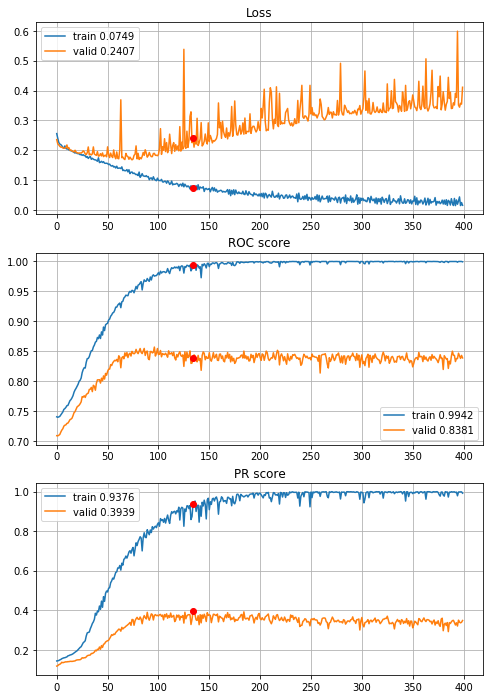


Fold 2------------------------------------------------------------


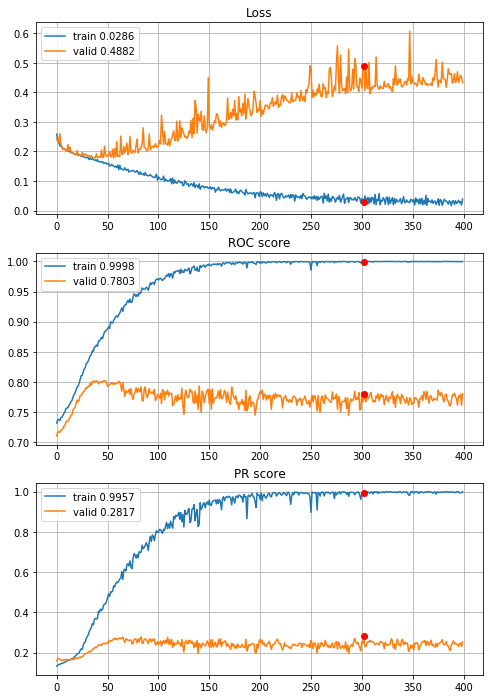


Fold 3------------------------------------------------------------


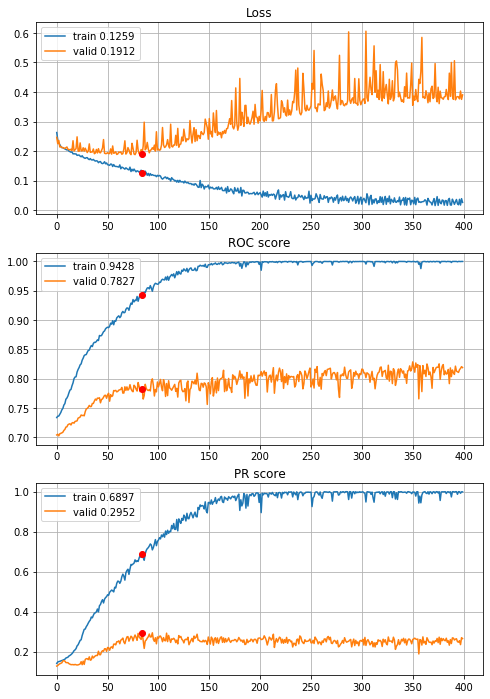


Fold 4------------------------------------------------------------


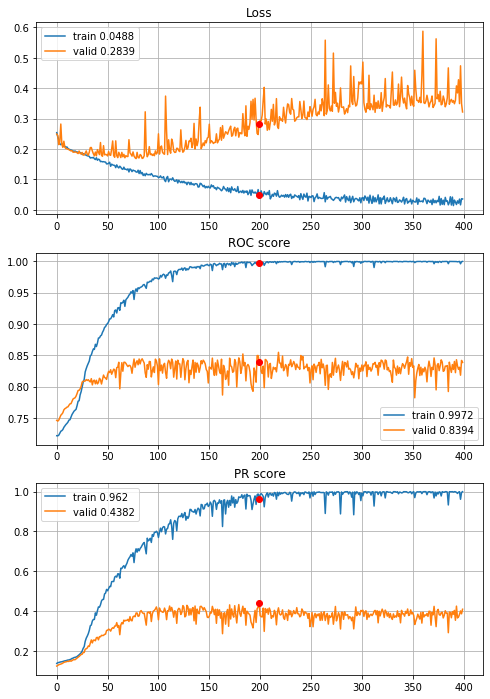


Fold 5------------------------------------------------------------


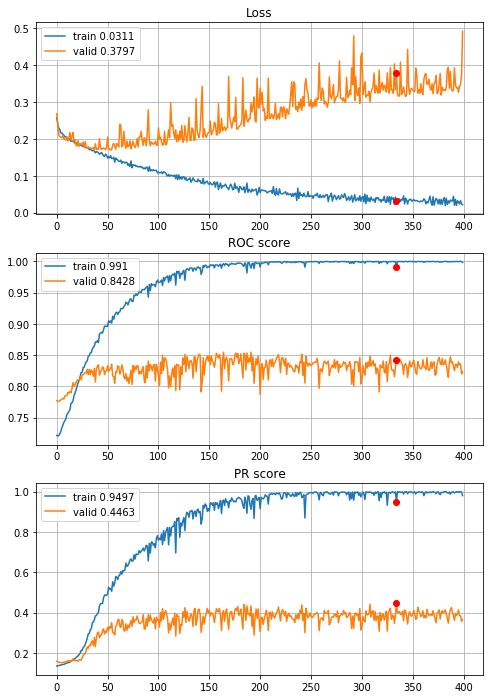


Fold 6------------------------------------------------------------


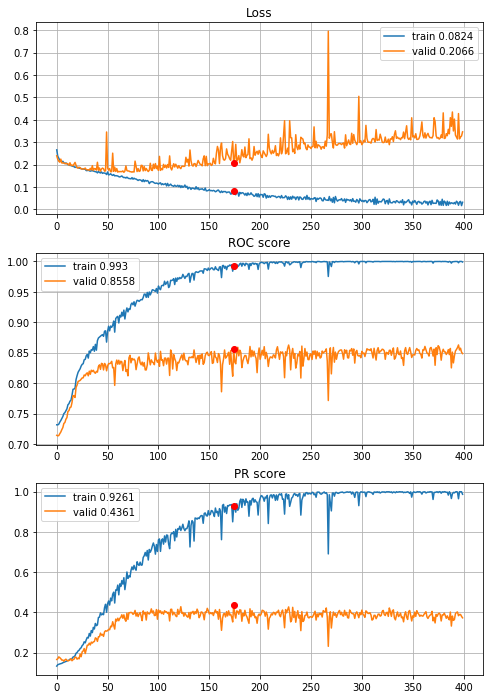

In [59]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_00005, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_CNN_L2_00005_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Very interesting example, much better results and overfitting compared to $L_1$, what's more by looking on learning curves it can be concluded that 100 epochs is enough, lets add some dropout, maybe it'll help keep learnig curves smoother. 200 epochs should be enough. 

In [57]:
def define_CNN_L2_00005_drop_2_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                          #(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)                          #(8,8,32)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                           #(8,8,64)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)               #(4,4,64)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                           #(4,4,32)
    dense = layers.Flatten()(early)                                                                   #(512,)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                        #(512,)
    dense = layers.Dropout(rate=0.2)(dense)                                                           #(256,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                        #(256,)
    dense = layers.Dropout(rate=0.2)(dense)                                                           #(256,)   
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)             #(1,)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/200,
cumulative time: 2.62s train loss: 0.2665967996156493, validation loss: 0.231771475395189
Epoch: 2/200,
cumulative time: 4.13s train loss: 0.24141720201742514, validation loss: 0.22207033445512137
Epoch: 3/200,
cumulative time: 5.68s train loss: 0.2296199662255507, validation loss: 0.21794545181841166
Epoch: 4/200,
cumulative time: 7.2s train loss: 0.22412165650372673, validation loss: 0.21433281366966306
Epoch: 5/200,
cumulative time: 8.71s train loss: 0.22339764031632695, validation loss: 0.21352199643059114
Epoch: 6/200,
cumulative time: 10.24s train loss: 0.21438659862927809, validation loss: 0.24509199117827044
Epoch: 7/200,
cumulative time: 11.76s train loss: 0.21372138391142723, validation loss: 0.20983378805215055
Epoch: 8/200,
cumulative time: 13.28s train loss: 0.2118161147363696, validation loss: 0.2081695792117518
Epoch: 9/200,
cumulative time: 14.81s train loss: 0.21766748670886846

Epoch: 76/200,
cumulative time: 117.59s train loss: 0.13167664724240166, validation loss: 0.1744700890361573
Epoch: 77/200,
cumulative time: 119.19s train loss: 0.13586907595067296, validation loss: 0.1779841680543775
Epoch: 78/200,
cumulative time: 120.71s train loss: 0.1405084236662865, validation loss: 0.17028209990064166
Epoch: 79/200,
cumulative time: 122.22s train loss: 0.12519101270408667, validation loss: 0.20753204113492518
Epoch: 80/200,
cumulative time: 123.72s train loss: 0.12844463096162725, validation loss: 0.2045599140221769
Epoch: 81/200,
cumulative time: 125.23s train loss: 0.12967691056599787, validation loss: 0.19560855298402602
Epoch: 82/200,
cumulative time: 126.72s train loss: 0.13784151609434542, validation loss: 0.16984492942051793
Epoch: 83/200,
cumulative time: 128.24s train loss: 0.12300025669589738, validation loss: 0.1700131988813473
Epoch: 84/200,
cumulative time: 129.73s train loss: 0.1214077248915687, validation loss: 0.1716477240710294
Epoch: 85/200,
cu

Epoch: 151/200,
cumulative time: 232.18s train loss: 0.08605603399583402, validation loss: 0.19925665267070514
Epoch: 152/200,
cumulative time: 233.7s train loss: 0.0799905689795701, validation loss: 0.20356077488341892
Epoch: 153/200,
cumulative time: 235.21s train loss: 0.07096235686843376, validation loss: 0.21218514130016505
Epoch: 154/200,
cumulative time: 236.71s train loss: 0.08660831957158545, validation loss: 0.2256362881787867
Epoch: 155/200,
cumulative time: 238.22s train loss: 0.07609638026516606, validation loss: 0.2104404483363286
Epoch: 156/200,
cumulative time: 239.73s train loss: 0.08378875770418517, validation loss: 0.2121494489717516
Epoch: 157/200,
cumulative time: 241.27s train loss: 0.071151459561444, validation loss: 0.24963665895108222
Epoch: 158/200,
cumulative time: 242.78s train loss: 0.08235121546986642, validation loss: 0.22116736855695165
Epoch: 159/200,
cumulative time: 244.29s train loss: 0.07623385952337389, validation loss: 0.22612657784969326
Epoch: 1

Epoch: 24/200,
cumulative time: 38.69s train loss: 0.1911669232313467, validation loss: 0.18911090890837007
Epoch: 25/200,
cumulative time: 40.27s train loss: 0.18918317383687663, validation loss: 0.1886964534378279
Epoch: 26/200,
cumulative time: 41.91s train loss: 0.19114904801104937, validation loss: 0.202766636811283
Epoch: 27/200,
cumulative time: 43.57s train loss: 0.1863260181986245, validation loss: 0.18790373281202322
Epoch: 28/200,
cumulative time: 45.22s train loss: 0.1845379159652, validation loss: 0.19514728837105755
Epoch: 29/200,
cumulative time: 46.84s train loss: 0.18507091756836525, validation loss: 0.19411708875080613
Epoch: 30/200,
cumulative time: 48.47s train loss: 0.18539031310179213, validation loss: 0.1873058854133763
Epoch: 31/200,
cumulative time: 49.99s train loss: 0.1826124971367984, validation loss: 0.18963548361524746
Epoch: 32/200,
cumulative time: 51.55s train loss: 0.182342464643328, validation loss: 0.1851660559642388
Epoch: 33/200,
cumulative time: 5

Epoch: 100/200,
cumulative time: 155.56s train loss: 0.11732980195368471, validation loss: 0.22555458814494053
Epoch: 101/200,
cumulative time: 157.06s train loss: 0.12549740585115354, validation loss: 0.2202782208230562
Epoch: 102/200,
cumulative time: 158.6s train loss: 0.1231016633725452, validation loss: 0.22386062986149602
Epoch: 103/200,
cumulative time: 160.1s train loss: 0.11677516944301594, validation loss: 0.2249431719355554
Epoch: 104/200,
cumulative time: 161.62s train loss: 0.11978328158594713, validation loss: 0.30271202542897063
Epoch: 105/200,
cumulative time: 163.12s train loss: 0.11482420407340131, validation loss: 0.22036142316580307
Epoch: 106/200,
cumulative time: 164.63s train loss: 0.11378732680194825, validation loss: 0.24077850553841718
Epoch: 107/200,
cumulative time: 166.14s train loss: 0.11936404756632453, validation loss: 0.22035011290043208
Epoch: 108/200,
cumulative time: 167.63s train loss: 0.1190043004960467, validation loss: 0.22289687497547647
Epoch: 

Epoch: 175/200,
cumulative time: 269.57s train loss: 0.07387770828147294, validation loss: 0.3348862182899265
Epoch: 176/200,
cumulative time: 271.09s train loss: 0.08374572547116364, validation loss: 0.293594300138293
Epoch: 177/200,
cumulative time: 272.61s train loss: 0.07497057842247236, validation loss: 0.2887077170358863
Epoch: 178/200,
cumulative time: 274.12s train loss: 0.08026935267104256, validation loss: 0.2809122387063674
Epoch: 179/200,
cumulative time: 275.63s train loss: 0.07854558640146603, validation loss: 0.2827449327447611
Epoch: 180/200,
cumulative time: 277.15s train loss: 0.07251253825664747, validation loss: 0.3019887007280951
Epoch: 181/200,
cumulative time: 278.69s train loss: 0.07907528780379446, validation loss: 0.2835356845406954
Epoch: 182/200,
cumulative time: 280.19s train loss: 0.07968341649678526, validation loss: 0.2901112794916674
Epoch: 183/200,
cumulative time: 281.71s train loss: 0.07850589158667151, validation loss: 0.2783596720660601
Epoch: 184/

Epoch: 48/200,
cumulative time: 74.76s train loss: 0.16797738641005325, validation loss: 0.2027449770859101
Epoch: 49/200,
cumulative time: 76.27s train loss: 0.160829676128239, validation loss: 0.1994390454297978
Epoch: 50/200,
cumulative time: 77.78s train loss: 0.16390951383256724, validation loss: 0.20075345475548706
Epoch: 51/200,
cumulative time: 79.29s train loss: 0.1590982262670677, validation loss: 0.20160945848269557
Epoch: 52/200,
cumulative time: 80.8s train loss: 0.1567945048044573, validation loss: 0.20771562057015358
Epoch: 53/200,
cumulative time: 82.32s train loss: 0.15600327804053526, validation loss: 0.21654137318802982
Epoch: 54/200,
cumulative time: 83.84s train loss: 0.15582585297235754, validation loss: 0.211913351565498
Epoch: 55/200,
cumulative time: 85.35s train loss: 0.1592148102025448, validation loss: 0.19924012925082765
Epoch: 56/200,
cumulative time: 86.86s train loss: 0.15165276675462624, validation loss: 0.21589860261257526
Epoch: 57/200,
cumulative tim

Epoch: 123/200,
cumulative time: 188.66s train loss: 0.0988861683638921, validation loss: 0.26354708283673023
Epoch: 124/200,
cumulative time: 190.19s train loss: 0.10328457829199125, validation loss: 0.33229435267214713
Epoch: 125/200,
cumulative time: 191.72s train loss: 0.09283842106926722, validation loss: 0.26476120713456625
Epoch: 126/200,
cumulative time: 193.23s train loss: 0.09368186029762204, validation loss: 0.2634181242722731
Epoch: 127/200,
cumulative time: 194.75s train loss: 0.09672738932023399, validation loss: 0.27389240818741045
Epoch: 128/200,
cumulative time: 196.27s train loss: 0.09164410789668292, validation loss: 0.29750183330172986
Epoch: 129/200,
cumulative time: 197.79s train loss: 0.09617551044593564, validation loss: 0.25809608522607325
Epoch: 130/200,
cumulative time: 199.31s train loss: 0.09872164767695661, validation loss: 0.278341340523662
Epoch: 131/200,
cumulative time: 200.84s train loss: 0.08900544788050713, validation loss: 0.26787966897570414
Epoch

Epoch: 198/200,
cumulative time: 302.69s train loss: 0.05839794922184265, validation loss: 0.3577923191656784
Epoch: 199/200,
cumulative time: 304.2s train loss: 0.06425843231839623, validation loss: 0.3409167770587968
Epoch: 200/200,
cumulative time: 305.75s train loss: 0.06753838599442494, validation loss: 0.36784334234269483

Early stopping results:
best results in epoch: 121, 
best valid PR: 0.23061213465272482, 
valid ROC: 0.7550194058814749        
overfitting PR: 0.6280902628525772, 
overfitting ROC: 0.22214099691855282

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/200,
cumulative time: 3.51s train loss: 0.2608144178542132, validation loss: 0.23233146299059657
Epoch: 2/200,
cumulative time: 5.07s train loss: 0.23821839975832626, validation loss: 0.2479684321226272
Epoch: 3/200,
cumulative time: 6.6s train loss: 0.2345065195055078, validation loss: 0.21767207108808262
Epoch: 4/200,
cumulative time: 8.13s train loss: 0.2200192808455543, va

Epoch: 72/200,
cumulative time: 113.19s train loss: 0.13716353363624212, validation loss: 0.200357029547977
Epoch: 73/200,
cumulative time: 114.72s train loss: 0.14013633038633025, validation loss: 0.1882461729485458
Epoch: 74/200,
cumulative time: 116.26s train loss: 0.13750888387647617, validation loss: 0.18767728981637402
Epoch: 75/200,
cumulative time: 117.78s train loss: 0.1338352592187374, validation loss: 0.18650136029866377
Epoch: 76/200,
cumulative time: 119.31s train loss: 0.1371009630515987, validation loss: 0.20211242014571384
Epoch: 77/200,
cumulative time: 120.85s train loss: 0.1372057668794716, validation loss: 0.17914782257571846
Epoch: 78/200,
cumulative time: 122.36s train loss: 0.13129135053318203, validation loss: 0.17901683541444632
Epoch: 79/200,
cumulative time: 123.9s train loss: 0.13132389726876464, validation loss: 0.18224841522634883
Epoch: 80/200,
cumulative time: 125.41s train loss: 0.13055473960348588, validation loss: 0.1834097603010109
Epoch: 81/200,
cum

Epoch: 147/200,
cumulative time: 228.67s train loss: 0.08003010548246373, validation loss: 0.22899578080605779
Epoch: 148/200,
cumulative time: 230.21s train loss: 0.08056944337269274, validation loss: 0.24963415405472741
Epoch: 149/200,
cumulative time: 231.73s train loss: 0.08756807809927702, validation loss: 0.22476484852229925
Epoch: 150/200,
cumulative time: 233.26s train loss: 0.07459322351672645, validation loss: 0.2246802399420592
Epoch: 151/200,
cumulative time: 234.78s train loss: 0.08481912599349158, validation loss: 0.2158015198838232
Epoch: 152/200,
cumulative time: 236.29s train loss: 0.08963505571156874, validation loss: 0.21562388672197327
Epoch: 153/200,
cumulative time: 237.83s train loss: 0.08295998799326829, validation loss: 0.22356379963330789
Epoch: 154/200,
cumulative time: 239.37s train loss: 0.08274326305042475, validation loss: 0.2352285797170752
Epoch: 155/200,
cumulative time: 240.9s train loss: 0.08273708833127617, validation loss: 0.21798370043139137
Epoch

Epoch: 20/200,
cumulative time: 33.51s train loss: 0.1990815208563358, validation loss: 0.18653836897104897
Epoch: 21/200,
cumulative time: 35.08s train loss: 0.19475928022402433, validation loss: 0.18582201824201225
Epoch: 22/200,
cumulative time: 36.63s train loss: 0.19406417172507653, validation loss: 0.20470449900919474
Epoch: 23/200,
cumulative time: 38.18s train loss: 0.1915818550593518, validation loss: 0.18533372334953224
Epoch: 24/200,
cumulative time: 39.73s train loss: 0.1923062847379376, validation loss: 0.19140562622196344
Epoch: 25/200,
cumulative time: 41.29s train loss: 0.18733424169857518, validation loss: 0.1927427402634062
Epoch: 26/200,
cumulative time: 42.86s train loss: 0.18774135019183807, validation loss: 0.19479347211219958
Epoch: 27/200,
cumulative time: 44.4s train loss: 0.18225632098245725, validation loss: 0.1925725957393971
Epoch: 28/200,
cumulative time: 45.95s train loss: 0.1855946300766372, validation loss: 0.18063669739042382
Epoch: 29/200,
cumulative 

Epoch: 96/200,
cumulative time: 152.53s train loss: 0.1206483186399138, validation loss: 0.18409673090039547
Epoch: 97/200,
cumulative time: 154.08s train loss: 0.11410575154113678, validation loss: 0.1884108589155148
Epoch: 98/200,
cumulative time: 155.64s train loss: 0.12520086139740833, validation loss: 0.1917917672595471
Epoch: 99/200,
cumulative time: 157.19s train loss: 0.11577246663990494, validation loss: 0.18266787899693612
Epoch: 100/200,
cumulative time: 158.74s train loss: 0.10865960379125052, validation loss: 0.18425568030786774
Epoch: 101/200,
cumulative time: 160.29s train loss: 0.11620538847313987, validation loss: 0.21678068651246765
Epoch: 102/200,
cumulative time: 161.87s train loss: 0.11073081640522595, validation loss: 0.20049107178274228
Epoch: 103/200,
cumulative time: 163.41s train loss: 0.11354647034856294, validation loss: 0.19392362153741255
Epoch: 104/200,
cumulative time: 164.96s train loss: 0.11272603468989754, validation loss: 0.19231001994184319
Epoch: 1

Epoch: 171/200,
cumulative time: 269.77s train loss: 0.07739125097612799, validation loss: 0.23967611341044429
Epoch: 172/200,
cumulative time: 271.32s train loss: 0.07961556012082788, validation loss: 0.2515620132070796
Epoch: 173/200,
cumulative time: 272.89s train loss: 0.07825967061692496, validation loss: 0.2501850852321539
Epoch: 174/200,
cumulative time: 274.43s train loss: 0.07282064429307783, validation loss: 0.2401758207652809
Epoch: 175/200,
cumulative time: 275.98s train loss: 0.07930120613328577, validation loss: 0.24017484540916595
Epoch: 176/200,
cumulative time: 277.55s train loss: 0.07263534663707699, validation loss: 0.24223152064903555
Epoch: 177/200,
cumulative time: 279.11s train loss: 0.07456115263256534, validation loss: 0.2968453533480538
Epoch: 178/200,
cumulative time: 280.69s train loss: 0.06960870108966896, validation loss: 0.240355126275516
Epoch: 179/200,
cumulative time: 282.24s train loss: 0.07356592916177428, validation loss: 0.25917254461417083
Epoch: 

Epoch: 44/200,
cumulative time: 76.11s train loss: 0.16816267361844156, validation loss: 0.17310266736742586
Epoch: 45/200,
cumulative time: 77.7s train loss: 0.1727153865624552, validation loss: 0.1830503952966074
Epoch: 46/200,
cumulative time: 79.26s train loss: 0.1654440377126722, validation loss: 0.1796314933157097
Epoch: 47/200,
cumulative time: 80.81s train loss: 0.16611415288798626, validation loss: 0.20737349536340957
Epoch: 48/200,
cumulative time: 82.37s train loss: 0.16989539324027975, validation loss: 0.1761291502728774
Epoch: 49/200,
cumulative time: 83.91s train loss: 0.16695613121463712, validation loss: 0.175648853467011
Epoch: 50/200,
cumulative time: 85.5s train loss: 0.16345496327171918, validation loss: 0.2466710064083094
Epoch: 51/200,
cumulative time: 87.07s train loss: 0.16698340441796256, validation loss: 0.1864416887349264
Epoch: 52/200,
cumulative time: 88.62s train loss: 0.15936085235627778, validation loss: 0.17547170462579104
Epoch: 53/200,
cumulative time

Epoch: 119/200,
cumulative time: 193.29s train loss: 0.100805536095126, validation loss: 0.2059964819808747
Epoch: 120/200,
cumulative time: 194.84s train loss: 0.10816774481383998, validation loss: 0.19810075836626645
Epoch: 121/200,
cumulative time: 196.38s train loss: 0.10343217928051819, validation loss: 0.20060746416408945
Epoch: 122/200,
cumulative time: 197.94s train loss: 0.10524529026017762, validation loss: 0.21893948056717336
Epoch: 123/200,
cumulative time: 199.48s train loss: 0.10549586485008139, validation loss: 0.20659822767615643
Epoch: 124/200,
cumulative time: 201.03s train loss: 0.10107053115391751, validation loss: 0.2331996021706012
Epoch: 125/200,
cumulative time: 202.57s train loss: 0.09960811080366438, validation loss: 0.20295367869028277
Epoch: 126/200,
cumulative time: 204.11s train loss: 0.10053861744636934, validation loss: 0.20214832226976712
Epoch: 127/200,
cumulative time: 205.67s train loss: 0.10868528769970395, validation loss: 0.21142533665132132
Epoch

Epoch: 194/200,
cumulative time: 310.36s train loss: 0.07165138394782859, validation loss: 0.24044112808373058
Epoch: 195/200,
cumulative time: 311.91s train loss: 0.06049057060532061, validation loss: 0.27939921808340246
Epoch: 196/200,
cumulative time: 313.46s train loss: 0.0739739940061451, validation loss: 0.29972676116699093
Epoch: 197/200,
cumulative time: 315.04s train loss: 0.06072665946172603, validation loss: 0.29846355810314823
Epoch: 198/200,
cumulative time: 316.59s train loss: 0.06136099248211466, validation loss: 0.24282928448606902
Epoch: 199/200,
cumulative time: 318.17s train loss: 0.07288029037054815, validation loss: 0.24605010866063168
Epoch: 200/200,
cumulative time: 319.73s train loss: 0.06856698103245015, validation loss: 0.24173117420897497

Early stopping results:
best results in epoch: 174, 
best valid PR: 0.41001179767747176, 
valid ROC: 0.8274809302846685        
overfitting PR: 0.5259243595854844, 
overfitting ROC: 0.16159601845439797

Cross validation tim

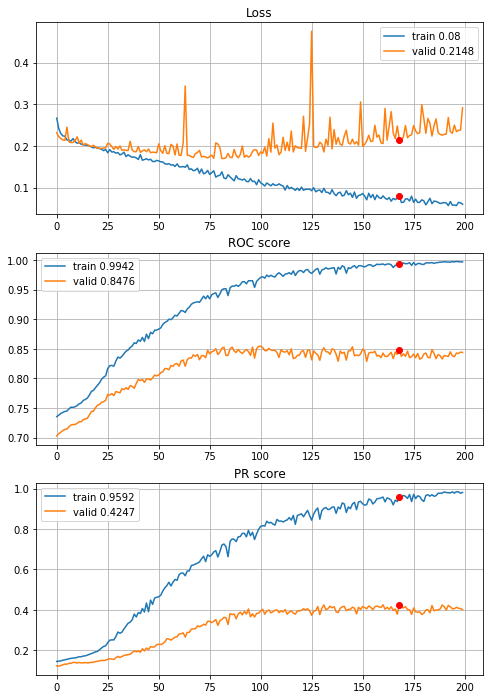


Fold 2------------------------------------------------------------


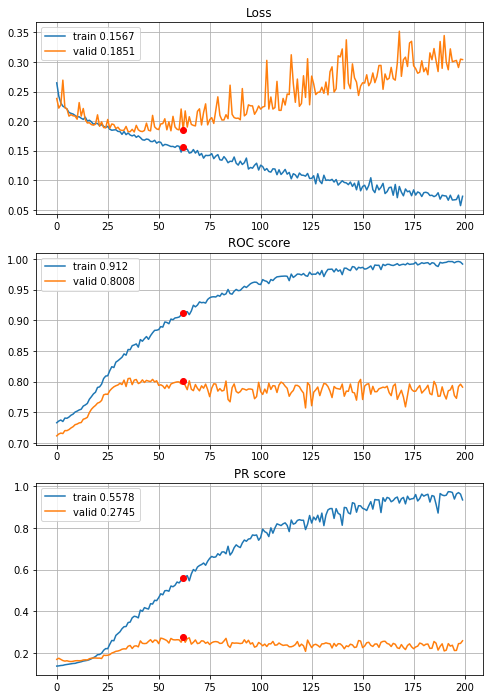


Fold 3------------------------------------------------------------


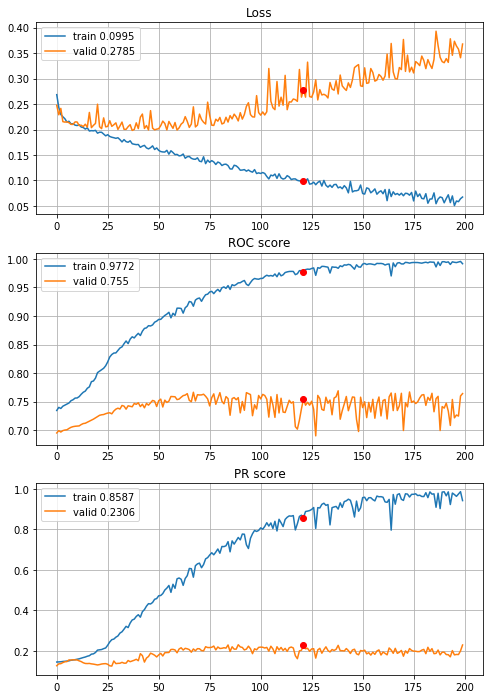


Fold 4------------------------------------------------------------


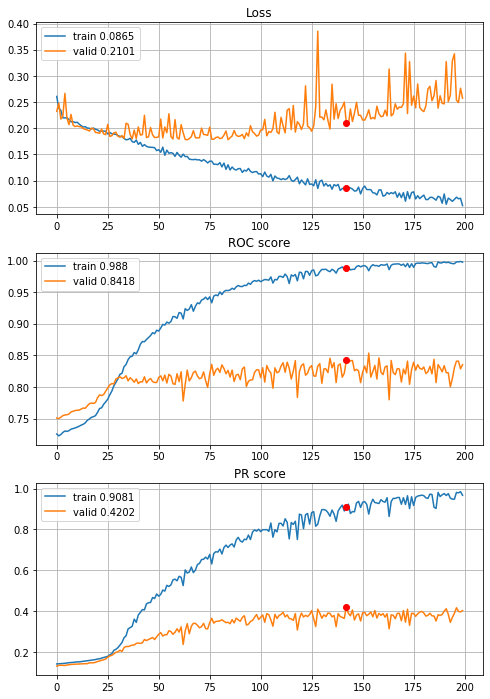


Fold 5------------------------------------------------------------


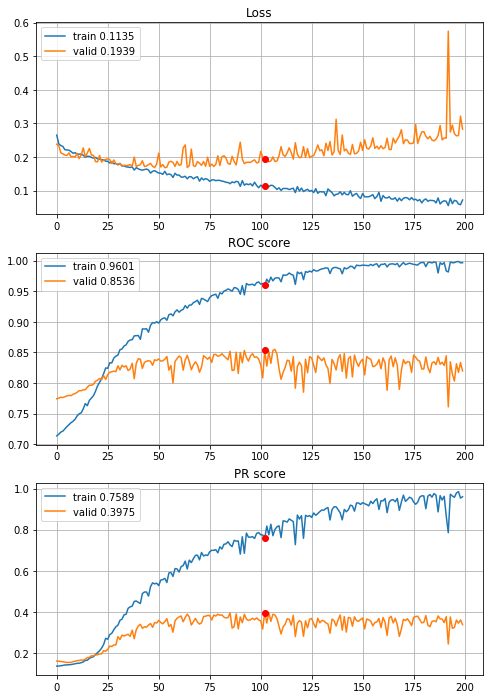


Fold 6------------------------------------------------------------


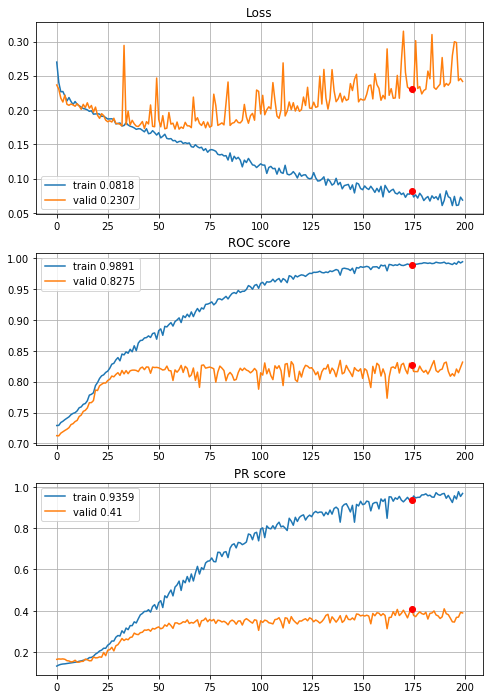

In [61]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_00005_drop_2_02, features=features,
                                        target=target, n_epochs=200, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_CNN_L2_00005_drop_2_02_200ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Dropout doesn't help, lets try $L_2$ regularization on inception model

In [58]:
def define_deep_CNN_2inc_std_L2_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.2)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.42s train loss: 0.3124453185949828, validation loss: 0.23508647416950976
Epoch: 2/600,
cumulative time: 5.79s train loss: 0.2197260021530249, validation loss: 0.21447867641974827
Epoch: 3/600,
cumulative time: 7.14s train loss: 0.21093150179457246, validation loss: 0.2092878669500351
Epoch: 4/600,
cumulative time: 8.47s train loss: 0.2077214687506639, validation loss: 0.2044187407354825
Epoch: 5/600,
cumulative time: 9.82s train loss: 0.20316383235504562, validation loss: 0.20145263892602888
Epoch: 6/600,
cumulative time: 11.14s train loss: 0.2006775144557123, validation loss: 0.1999743496422219
Epoch: 7/600,
cumulative time: 12.48s train loss: 0.19856299410419276, validation loss: 0.1977645008133089
Epoch: 8/600,
cumulative time: 13.81s train loss: 0.196693385366148, validation loss: 0.19691919792542414
Epoch: 9/600,
cumulative time: 15.13s train loss: 0.1957179413725111, va

Epoch: 77/600,
cumulative time: 104.78s train loss: 0.17812970811918422, validation loss: 0.1854418996161064
Epoch: 78/600,
cumulative time: 106.08s train loss: 0.17734664092917185, validation loss: 0.18338674073563374
Epoch: 79/600,
cumulative time: 107.36s train loss: 0.17742479667747343, validation loss: 0.18878827445396687
Epoch: 80/600,
cumulative time: 108.67s train loss: 0.17957088892870277, validation loss: 0.18343352075536856
Epoch: 81/600,
cumulative time: 109.95s train loss: 0.17798509463885004, validation loss: 0.18270901818312782
Epoch: 82/600,
cumulative time: 111.24s train loss: 0.17820929867905036, validation loss: 0.18375745063699614
Epoch: 83/600,
cumulative time: 112.52s train loss: 0.17566212437855164, validation loss: 0.1846943067562994
Epoch: 84/600,
cumulative time: 113.82s train loss: 0.17696207140595327, validation loss: 0.18727387225165346
Epoch: 85/600,
cumulative time: 115.12s train loss: 0.17669063607053473, validation loss: 0.1840808261528236
Epoch: 86/600

Epoch: 152/600,
cumulative time: 202.2s train loss: 0.1513965225087416, validation loss: 0.17896127594296343
Epoch: 153/600,
cumulative time: 203.5s train loss: 0.15211208202234003, validation loss: 0.17613908485176613
Epoch: 154/600,
cumulative time: 204.79s train loss: 0.15014771956214296, validation loss: 0.17790488959616588
Epoch: 155/600,
cumulative time: 206.08s train loss: 0.15045254938603747, validation loss: 0.1752417754100406
Epoch: 156/600,
cumulative time: 207.39s train loss: 0.1493454926242527, validation loss: 0.17583067721254247
Epoch: 157/600,
cumulative time: 208.68s train loss: 0.14834559867220679, validation loss: 0.1816512158101233
Epoch: 158/600,
cumulative time: 210.0s train loss: 0.14806627827055624, validation loss: 0.17975179015210568
Epoch: 159/600,
cumulative time: 211.32s train loss: 0.1513149540962193, validation loss: 0.18251240429949647
Epoch: 160/600,
cumulative time: 212.67s train loss: 0.14828499621986516, validation loss: 0.1779681434024346
Epoch: 161

Epoch: 227/600,
cumulative time: 299.86s train loss: 0.12335861645041313, validation loss: 0.17537616141561427
Epoch: 228/600,
cumulative time: 301.32s train loss: 0.12411076887928627, validation loss: 0.17463071776174866
Epoch: 229/600,
cumulative time: 302.66s train loss: 0.12619979527995678, validation loss: 0.1795911541838805
Epoch: 230/600,
cumulative time: 303.97s train loss: 0.12421948318745742, validation loss: 0.1739546623641411
Epoch: 231/600,
cumulative time: 305.27s train loss: 0.12045159788421012, validation loss: 0.18227291991712286
Epoch: 232/600,
cumulative time: 306.6s train loss: 0.12305823062845493, validation loss: 0.17811995247661702
Epoch: 233/600,
cumulative time: 307.91s train loss: 0.12448677665349915, validation loss: 0.17429693240020613
Epoch: 234/600,
cumulative time: 309.26s train loss: 0.12747999219913567, validation loss: 0.18026089048491115
Epoch: 235/600,
cumulative time: 310.54s train loss: 0.12570228921986398, validation loss: 0.1799690600274127
Epoch

Epoch: 302/600,
cumulative time: 397.73s train loss: 0.10501216730653598, validation loss: 0.186325392232532
Epoch: 303/600,
cumulative time: 399.02s train loss: 0.10800988280195217, validation loss: 0.1809958006002369
Epoch: 304/600,
cumulative time: 400.33s train loss: 0.10376720463857815, validation loss: 0.18560017866492678
Epoch: 305/600,
cumulative time: 401.61s train loss: 0.10671246768486901, validation loss: 0.19011865222510876
Epoch: 306/600,
cumulative time: 402.92s train loss: 0.10145951159948811, validation loss: 0.19972201463638964
Epoch: 307/600,
cumulative time: 404.21s train loss: 0.10590617785953979, validation loss: 0.1988655513873954
Epoch: 308/600,
cumulative time: 405.5s train loss: 0.10565203471898416, validation loss: 0.18258701393683804
Epoch: 309/600,
cumulative time: 406.79s train loss: 0.10406251918728956, validation loss: 0.18061314614513765
Epoch: 310/600,
cumulative time: 408.1s train loss: 0.1040333165762682, validation loss: 0.18324886657008516
Epoch: 3

Epoch: 377/600,
cumulative time: 495.73s train loss: 0.09280989670256706, validation loss: 0.19554142531202795
Epoch: 378/600,
cumulative time: 497.02s train loss: 0.0891752444830664, validation loss: 0.20361707342815205
Epoch: 379/600,
cumulative time: 498.31s train loss: 0.08716944576904784, validation loss: 0.20063816450176147
Epoch: 380/600,
cumulative time: 499.59s train loss: 0.08972746426023742, validation loss: 0.19740622323779852
Epoch: 381/600,
cumulative time: 500.88s train loss: 0.09271515323853405, validation loss: 0.1952056183731418
Epoch: 382/600,
cumulative time: 502.19s train loss: 0.08399843799979424, validation loss: 0.1992470359948316
Epoch: 383/600,
cumulative time: 503.47s train loss: 0.0855751687765576, validation loss: 0.20277061537060306
Epoch: 384/600,
cumulative time: 504.76s train loss: 0.08706793793476231, validation loss: 0.20671470113316712
Epoch: 385/600,
cumulative time: 506.05s train loss: 0.09388097212069628, validation loss: 0.2101064178917666
Epoch:

Epoch: 452/600,
cumulative time: 593.71s train loss: 0.07389923405695169, validation loss: 0.23064451196552377
Epoch: 453/600,
cumulative time: 595.0s train loss: 0.07147969027399513, validation loss: 0.2633049860951688
Epoch: 454/600,
cumulative time: 596.28s train loss: 0.07134136973382926, validation loss: 0.2284065297442768
Epoch: 455/600,
cumulative time: 597.59s train loss: 0.07181179820862157, validation loss: 0.2215276777318256
Epoch: 456/600,
cumulative time: 598.9s train loss: 0.06714371746033329, validation loss: 0.22663254974000385
Epoch: 457/600,
cumulative time: 600.19s train loss: 0.07014389846782894, validation loss: 0.22634880020555143
Epoch: 458/600,
cumulative time: 601.48s train loss: 0.07018686847333344, validation loss: 0.2229776074482195
Epoch: 459/600,
cumulative time: 602.78s train loss: 0.07841126009746807, validation loss: 0.21811752843970422
Epoch: 460/600,
cumulative time: 604.08s train loss: 0.0752852067369605, validation loss: 0.2200964058821018
Epoch: 46

Epoch: 527/600,
cumulative time: 691.38s train loss: 0.0649119982158279, validation loss: 0.254811544374514
Epoch: 528/600,
cumulative time: 692.71s train loss: 0.06198988470028065, validation loss: 0.25791872809580835
Epoch: 529/600,
cumulative time: 694.04s train loss: 0.06063514416214232, validation loss: 0.25535115498194816
Epoch: 530/600,
cumulative time: 695.33s train loss: 0.06115565964949321, validation loss: 0.25798195225191084
Epoch: 531/600,
cumulative time: 696.63s train loss: 0.060601532924983735, validation loss: 0.2658879506985617
Epoch: 532/600,
cumulative time: 697.92s train loss: 0.059815474389262734, validation loss: 0.2818255734492355
Epoch: 533/600,
cumulative time: 699.21s train loss: 0.05677484252531831, validation loss: 0.2876764875110759
Epoch: 534/600,
cumulative time: 700.52s train loss: 0.057886427898230355, validation loss: 0.2815238679648257
Epoch: 535/600,
cumulative time: 701.81s train loss: 0.05827628814336407, validation loss: 0.29574389714136506
Epoch

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.46s train loss: 0.30426879820326247, validation loss: 0.2354915885595824
Epoch: 2/600,
cumulative time: 5.77s train loss: 0.21696940988371227, validation loss: 0.21583329271994292
Epoch: 3/600,
cumulative time: 7.1s train loss: 0.2111560314849078, validation loss: 0.20903236754213247
Epoch: 4/600,
cumulative time: 8.42s train loss: 0.20656966353800485, validation loss: 0.20478739586916808
Epoch: 5/600,
cumulative time: 9.72s train loss: 0.20140772508808627, validation loss: 0.20063408942470914
Epoch: 6/600,
cumulative time: 11.04s train loss: 0.1984546411395414, validation loss: 0.1982133812933572
Epoch: 7/600,
cumulative time: 12.35s train loss: 0.1965973221215081, validation loss: 0.19867504425118618
Epoch: 8/600,
cumulative time: 13.66s train loss: 0.19657656575570748, validation loss: 0.196382554261923
Epoch: 9/600,
cumulative time: 14.98s train loss: 0.19517244508379117, validation loss: 0.19569636630

Epoch: 77/600,
cumulative time: 103.63s train loss: 0.1772132032487075, validation loss: 0.18464407795460716
Epoch: 78/600,
cumulative time: 104.95s train loss: 0.17646070069226422, validation loss: 0.18642131599785927
Epoch: 79/600,
cumulative time: 106.42s train loss: 0.1774754698060927, validation loss: 0.18441270022996029
Epoch: 80/600,
cumulative time: 107.83s train loss: 0.17730498951307422, validation loss: 0.18495777024145107
Epoch: 81/600,
cumulative time: 109.16s train loss: 0.17672169117208042, validation loss: 0.18526043653122984
Epoch: 82/600,
cumulative time: 110.48s train loss: 0.17690131409152335, validation loss: 0.18380943585854148
Epoch: 83/600,
cumulative time: 111.8s train loss: 0.17669288042730327, validation loss: 0.18579558055363518
Epoch: 84/600,
cumulative time: 113.14s train loss: 0.1763115604956631, validation loss: 0.18491402776611346
Epoch: 85/600,
cumulative time: 114.46s train loss: 0.17701209066723603, validation loss: 0.1843570236387993
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 202.2s train loss: 0.1524745810345215, validation loss: 0.18479849146571267
Epoch: 153/600,
cumulative time: 203.5s train loss: 0.15392186222682933, validation loss: 0.18355130704995967
Epoch: 154/600,
cumulative time: 204.79s train loss: 0.15193807204644233, validation loss: 0.18459198949002667
Epoch: 155/600,
cumulative time: 206.09s train loss: 0.15191131670103564, validation loss: 0.18528112384678963
Epoch: 156/600,
cumulative time: 207.39s train loss: 0.15184799253932466, validation loss: 0.18321228938252038
Epoch: 157/600,
cumulative time: 208.68s train loss: 0.1519419046878068, validation loss: 0.18340483172926633
Epoch: 158/600,
cumulative time: 210.0s train loss: 0.15348438152529215, validation loss: 0.1883536186386242
Epoch: 159/600,
cumulative time: 211.31s train loss: 0.1543114509980912, validation loss: 0.18477866390353567
Epoch: 160/600,
cumulative time: 212.62s train loss: 0.15158522648762962, validation loss: 0.18399659524449205
Epoch: 1

Epoch: 227/600,
cumulative time: 300.48s train loss: 0.12632211605392585, validation loss: 0.19091235682459573
Epoch: 228/600,
cumulative time: 301.78s train loss: 0.127186637679725, validation loss: 0.2005916782651652
Epoch: 229/600,
cumulative time: 303.08s train loss: 0.12776795080778597, validation loss: 0.19231005899552345
Epoch: 230/600,
cumulative time: 304.37s train loss: 0.12185527160144803, validation loss: 0.20269941858607463
Epoch: 231/600,
cumulative time: 305.68s train loss: 0.12393683638415057, validation loss: 0.19183229684951436
Epoch: 232/600,
cumulative time: 307.0s train loss: 0.12262348557353003, validation loss: 0.19343887378034988
Epoch: 233/600,
cumulative time: 308.3s train loss: 0.11977666059903873, validation loss: 0.19868103001416337
Epoch: 234/600,
cumulative time: 309.59s train loss: 0.12072463829973876, validation loss: 0.19623964371690952
Epoch: 235/600,
cumulative time: 310.9s train loss: 0.12325238595862131, validation loss: 0.19303461338201294
Epoch: 

Epoch: 302/600,
cumulative time: 399.13s train loss: 0.10367326708019681, validation loss: 0.21210923004791477
Epoch: 303/600,
cumulative time: 400.46s train loss: 0.09828837378244544, validation loss: 0.21289293864618927
Epoch: 304/600,
cumulative time: 401.75s train loss: 0.10556328724133746, validation loss: 0.21250962369128748
Epoch: 305/600,
cumulative time: 403.08s train loss: 0.10300348103087004, validation loss: 0.21463053983397187
Epoch: 306/600,
cumulative time: 404.37s train loss: 0.09588339275435824, validation loss: 0.2212137611667829
Epoch: 307/600,
cumulative time: 405.67s train loss: 0.09641230629203301, validation loss: 0.24083128284442334
Epoch: 308/600,
cumulative time: 406.97s train loss: 0.10462606442481154, validation loss: 0.21769796650656395
Epoch: 309/600,
cumulative time: 408.28s train loss: 0.09532860218950989, validation loss: 0.21771657443557815
Epoch: 310/600,
cumulative time: 409.57s train loss: 0.09636708874578585, validation loss: 0.21058222994340203
Ep

Epoch: 377/600,
cumulative time: 499.57s train loss: 0.07768469293192526, validation loss: 0.259128419465561
Epoch: 378/600,
cumulative time: 500.87s train loss: 0.08406474013107278, validation loss: 0.24426154784193813
Epoch: 379/600,
cumulative time: 502.18s train loss: 0.08591040666021704, validation loss: 0.2680680999105037
Epoch: 380/600,
cumulative time: 503.47s train loss: 0.08296231635094468, validation loss: 0.25617452971053983
Epoch: 381/600,
cumulative time: 504.76s train loss: 0.0749424892749998, validation loss: 0.2571588988568687
Epoch: 382/600,
cumulative time: 506.06s train loss: 0.0743429161056249, validation loss: 0.26020329403503967
Epoch: 383/600,
cumulative time: 507.35s train loss: 0.07497809260137948, validation loss: 0.2628060107818666
Epoch: 384/600,
cumulative time: 508.65s train loss: 0.07267552568857147, validation loss: 0.2614614081025692
Epoch: 385/600,
cumulative time: 509.97s train loss: 0.07545709125844736, validation loss: 0.2753207596022714
Epoch: 386

Epoch: 452/600,
cumulative time: 597.55s train loss: 0.06144848852247775, validation loss: 0.295004185666999
Epoch: 453/600,
cumulative time: 598.85s train loss: 0.06336725280388944, validation loss: 0.309952632211519
Epoch: 454/600,
cumulative time: 600.15s train loss: 0.05812781410202755, validation loss: 0.2961471236790825
Epoch: 455/600,
cumulative time: 601.44s train loss: 0.06199874175020221, validation loss: 0.2845071182517148
Epoch: 456/600,
cumulative time: 602.75s train loss: 0.059251505088598354, validation loss: 0.29429674715594906
Epoch: 457/600,
cumulative time: 604.05s train loss: 0.05574710941748562, validation loss: 0.2978089710556787
Epoch: 458/600,
cumulative time: 605.4s train loss: 0.05773921507084368, validation loss: 0.30702616996591475
Epoch: 459/600,
cumulative time: 606.7s train loss: 0.0569890715261985, validation loss: 0.30203816745052375
Epoch: 460/600,
cumulative time: 608.0s train loss: 0.056381854014964546, validation loss: 0.29595384572824707
Epoch: 461

Epoch: 527/600,
cumulative time: 695.36s train loss: 0.05259022565999165, validation loss: 0.35481113548421633
Epoch: 528/600,
cumulative time: 696.67s train loss: 0.04616210200643363, validation loss: 0.35306913995515576
Epoch: 529/600,
cumulative time: 697.97s train loss: 0.04981321028996744, validation loss: 0.3382862564493313
Epoch: 530/600,
cumulative time: 699.28s train loss: 0.044606622441919236, validation loss: 0.3528424911632109
Epoch: 531/600,
cumulative time: 700.61s train loss: 0.04122877532463299, validation loss: 0.3643456908251007
Epoch: 532/600,
cumulative time: 701.9s train loss: 0.041789006173963784, validation loss: 0.36288426864139073
Epoch: 533/600,
cumulative time: 703.22s train loss: 0.04224886641567886, validation loss: 0.3525628743730004
Epoch: 534/600,
cumulative time: 704.52s train loss: 0.04576417173057425, validation loss: 0.35463420313341104
Epoch: 535/600,
cumulative time: 705.91s train loss: 0.046919862367745466, validation loss: 0.3532377833651393
Epoc

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.51s train loss: 0.3041698395075581, validation loss: 0.23751212846185984
Epoch: 2/600,
cumulative time: 5.88s train loss: 0.2202899370367352, validation loss: 0.21353377657451136
Epoch: 3/600,
cumulative time: 7.24s train loss: 0.21076836244710603, validation loss: 0.20771113347447268
Epoch: 4/600,
cumulative time: 8.62s train loss: 0.2058922049948261, validation loss: 0.20476200690757992
Epoch: 5/600,
cumulative time: 9.97s train loss: 0.20261509306186, validation loss: 0.20284896674125352
Epoch: 6/600,
cumulative time: 11.36s train loss: 0.19914873591905133, validation loss: 0.20089547779383182
Epoch: 7/600,
cumulative time: 12.75s train loss: 0.1980975872973858, validation loss: 0.20004664888951632
Epoch: 8/600,
cumulative time: 14.12s train loss: 0.19543526061188699, validation loss: 0.2000494957112227
Epoch: 9/600,
cumulative time: 15.47s train loss: 0.19448845080770558, validation loss: 0.19967284824

Epoch: 77/600,
cumulative time: 107.54s train loss: 0.1742667276069804, validation loss: 0.19565016978691027
Epoch: 78/600,
cumulative time: 108.88s train loss: 0.17395354722349127, validation loss: 0.1962916670079293
Epoch: 79/600,
cumulative time: 110.22s train loss: 0.17411081262980985, validation loss: 0.19523045934934533
Epoch: 80/600,
cumulative time: 111.57s train loss: 0.17236071847755643, validation loss: 0.19564405471147364
Epoch: 81/600,
cumulative time: 112.92s train loss: 0.17164887462927927, validation loss: 0.195755721203643
Epoch: 82/600,
cumulative time: 114.26s train loss: 0.17213276874445999, validation loss: 0.19593753572870387
Epoch: 83/600,
cumulative time: 115.61s train loss: 0.1719830206056455, validation loss: 0.19545182247929543
Epoch: 84/600,
cumulative time: 116.94s train loss: 0.17319140906443017, validation loss: 0.19588796696020194
Epoch: 85/600,
cumulative time: 118.31s train loss: 0.173029828261131, validation loss: 0.19500115725805842
Epoch: 86/600,
cu

Epoch: 152/600,
cumulative time: 209.42s train loss: 0.1598413934783781, validation loss: 0.19022974475376292
Epoch: 153/600,
cumulative time: 210.78s train loss: 0.15687101441582005, validation loss: 0.1906852445243734
Epoch: 154/600,
cumulative time: 212.13s train loss: 0.15569919010087285, validation loss: 0.1965949705176162
Epoch: 155/600,
cumulative time: 213.5s train loss: 0.15855712696339672, validation loss: 0.19049152200363217
Epoch: 156/600,
cumulative time: 214.86s train loss: 0.156056536775299, validation loss: 0.1906451343820564
Epoch: 157/600,
cumulative time: 216.22s train loss: 0.15493414409475886, validation loss: 0.19083428131308663
Epoch: 158/600,
cumulative time: 217.58s train loss: 0.15534549854451266, validation loss: 0.19040218302999085
Epoch: 159/600,
cumulative time: 218.94s train loss: 0.1549115441957709, validation loss: 0.19819223948730913
Epoch: 160/600,
cumulative time: 220.31s train loss: 0.1562640725801268, validation loss: 0.1918737669535605
Epoch: 161/

Epoch: 227/600,
cumulative time: 311.38s train loss: 0.13513486298166666, validation loss: 0.19615966599964624
Epoch: 228/600,
cumulative time: 312.72s train loss: 0.13441525457418535, validation loss: 0.20187663698253216
Epoch: 229/600,
cumulative time: 314.07s train loss: 0.13550214656534432, validation loss: 0.19274949103370664
Epoch: 230/600,
cumulative time: 315.4s train loss: 0.1345230904717902, validation loss: 0.19514881317878435
Epoch: 231/600,
cumulative time: 316.75s train loss: 0.1366196960275738, validation loss: 0.19523383492389612
Epoch: 232/600,
cumulative time: 318.09s train loss: 0.13486304377342268, validation loss: 0.20384528008628816
Epoch: 233/600,
cumulative time: 319.45s train loss: 0.1344713062731833, validation loss: 0.20480157764612045
Epoch: 234/600,
cumulative time: 320.78s train loss: 0.13369968920706662, validation loss: 0.1952249359484024
Epoch: 235/600,
cumulative time: 322.12s train loss: 0.13200912599535675, validation loss: 0.19476922445754927
Epoch:

Epoch: 302/600,
cumulative time: 412.81s train loss: 0.11202930132553426, validation loss: 0.21510354130750128
Epoch: 303/600,
cumulative time: 414.15s train loss: 0.112795467840932, validation loss: 0.20780514392664515
Epoch: 304/600,
cumulative time: 415.49s train loss: 0.11196935704670695, validation loss: 0.20981523264744723
Epoch: 305/600,
cumulative time: 416.82s train loss: 0.11258245954863563, validation loss: 0.2075768042738702
Epoch: 306/600,
cumulative time: 418.16s train loss: 0.11220332621781293, validation loss: 0.22088603647977337
Epoch: 307/600,
cumulative time: 419.51s train loss: 0.11281724960468258, validation loss: 0.2157474854432295
Epoch: 308/600,
cumulative time: 420.94s train loss: 0.10887188939462643, validation loss: 0.21381105796019995
Epoch: 309/600,
cumulative time: 422.28s train loss: 0.1101279532744614, validation loss: 0.21324780011274444
Epoch: 310/600,
cumulative time: 423.62s train loss: 0.10964171572845978, validation loss: 0.2226468584949748
Epoch: 

Epoch: 377/600,
cumulative time: 514.35s train loss: 0.09358438282056447, validation loss: 0.23026803748554076
Epoch: 378/600,
cumulative time: 515.71s train loss: 0.09285283884982005, validation loss: 0.24297407519013967
Epoch: 379/600,
cumulative time: 517.1s train loss: 0.09006362277306702, validation loss: 0.24337978075766256
Epoch: 380/600,
cumulative time: 518.45s train loss: 0.09546266581107757, validation loss: 0.22808660632741135
Epoch: 381/600,
cumulative time: 519.79s train loss: 0.09655326852214997, validation loss: 0.23604285219967
Epoch: 382/600,
cumulative time: 521.14s train loss: 0.1001815327444324, validation loss: 0.22683844075793713
Epoch: 383/600,
cumulative time: 522.49s train loss: 0.09489976033217314, validation loss: 0.23137308664269962
Epoch: 384/600,
cumulative time: 523.88s train loss: 0.09041327286177332, validation loss: 0.23577237380776297
Epoch: 385/600,
cumulative time: 525.25s train loss: 0.09244382623433417, validation loss: 0.22855131893112515
Epoch:

Epoch: 452/600,
cumulative time: 615.41s train loss: 0.07862592040558984, validation loss: 0.298692025482614
Epoch: 453/600,
cumulative time: 616.76s train loss: 0.0742703903880948, validation loss: 0.2595636666713725
Epoch: 454/600,
cumulative time: 618.1s train loss: 0.07563009555207421, validation loss: 0.2731676976075377
Epoch: 455/600,
cumulative time: 619.44s train loss: 0.07499240952361658, validation loss: 0.28128136764423145
Epoch: 456/600,
cumulative time: 620.77s train loss: 0.07387508304611337, validation loss: 0.28566674972327083
Epoch: 457/600,
cumulative time: 622.13s train loss: 0.0736692909166028, validation loss: 0.27154823701506653
Epoch: 458/600,
cumulative time: 623.47s train loss: 0.07292796362226445, validation loss: 0.2750548958737806
Epoch: 459/600,
cumulative time: 624.86s train loss: 0.07405208120099468, validation loss: 0.26942202854594705
Epoch: 460/600,
cumulative time: 626.19s train loss: 0.07266370972625309, validation loss: 0.2913987929111764
Epoch: 461

Epoch: 527/600,
cumulative time: 717.05s train loss: 0.06100705757800068, validation loss: 0.3146357329789273
Epoch: 528/600,
cumulative time: 718.42s train loss: 0.05905534904873795, validation loss: 0.3138710649099538
Epoch: 529/600,
cumulative time: 719.78s train loss: 0.06135240812060068, validation loss: 0.3296310067217394
Epoch: 530/600,
cumulative time: 721.13s train loss: 0.0597020536980763, validation loss: 0.3158555750014264
Epoch: 531/600,
cumulative time: 722.48s train loss: 0.05754754640365936, validation loss: 0.33007735433912827
Epoch: 532/600,
cumulative time: 723.84s train loss: 0.05991587185772826, validation loss: 0.34204544951673915
Epoch: 533/600,
cumulative time: 725.18s train loss: 0.06026867042501989, validation loss: 0.3180924026920651
Epoch: 534/600,
cumulative time: 726.53s train loss: 0.055742505799822206, validation loss: 0.34048277452091036
Epoch: 535/600,
cumulative time: 727.89s train loss: 0.06192299674363888, validation loss: 0.33460991974182075
Epoch:

Train on 7343 samples, validate on 1469 samples
Epoch: 1/600,
cumulative time: 4.7s train loss: 0.297921963057368, validation loss: 0.2318222558035828
Epoch: 2/600,
cumulative time: 6.07s train loss: 0.2186082304396617, validation loss: 0.21324603050602303
Epoch: 3/600,
cumulative time: 7.46s train loss: 0.21085883330401065, validation loss: 0.20638821330339913
Epoch: 4/600,
cumulative time: 8.81s train loss: 0.20730326038468327, validation loss: 0.20234339310450972
Epoch: 5/600,
cumulative time: 10.19s train loss: 0.20387846418562172, validation loss: 0.19977176064654545
Epoch: 6/600,
cumulative time: 11.55s train loss: 0.2011413893265538, validation loss: 0.1972527330712123
Epoch: 7/600,
cumulative time: 12.92s train loss: 0.1995579104616388, validation loss: 0.19489795487904077
Epoch: 8/600,
cumulative time: 14.28s train loss: 0.19873021049296907, validation loss: 0.19299308512387753
Epoch: 9/600,
cumulative time: 15.64s train loss: 0.19810633078657866, validation loss: 0.1922204480

Epoch: 77/600,
cumulative time: 108.51s train loss: 0.17602057612942332, validation loss: 0.1779474606312725
Epoch: 78/600,
cumulative time: 109.87s train loss: 0.1755589315563493, validation loss: 0.17723499612795243
Epoch: 79/600,
cumulative time: 111.23s train loss: 0.17426334271375124, validation loss: 0.17765218735633861
Epoch: 80/600,
cumulative time: 112.57s train loss: 0.17275918043270175, validation loss: 0.17722414924913396
Epoch: 81/600,
cumulative time: 113.94s train loss: 0.17270295217026485, validation loss: 0.17729770110690568
Epoch: 82/600,
cumulative time: 115.28s train loss: 0.17386340270668418, validation loss: 0.1773998689862479
Epoch: 83/600,
cumulative time: 116.64s train loss: 0.17280760420029484, validation loss: 0.1783816906324936
Epoch: 84/600,
cumulative time: 117.98s train loss: 0.17527214131197164, validation loss: 0.1791540651681717
Epoch: 85/600,
cumulative time: 119.33s train loss: 0.17201349542029917, validation loss: 0.17733816618899897
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 210.77s train loss: 0.15173093225575104, validation loss: 0.17940739670564237
Epoch: 153/600,
cumulative time: 212.12s train loss: 0.1535394665076527, validation loss: 0.18427491521778522
Epoch: 154/600,
cumulative time: 213.5s train loss: 0.15172386162736898, validation loss: 0.17898741097698576
Epoch: 155/600,
cumulative time: 214.86s train loss: 0.14933476447003846, validation loss: 0.176323805732172
Epoch: 156/600,
cumulative time: 216.2s train loss: 0.14861235729553518, validation loss: 0.18150771523390277
Epoch: 157/600,
cumulative time: 217.55s train loss: 0.14880241812022266, validation loss: 0.18472521593369456
Epoch: 158/600,
cumulative time: 218.9s train loss: 0.15191779998055632, validation loss: 0.1822564374069684
Epoch: 159/600,
cumulative time: 220.26s train loss: 0.15046623358321615, validation loss: 0.17929983050787507
Epoch: 160/600,
cumulative time: 221.63s train loss: 0.14795546440236917, validation loss: 0.1785105852102081
Epoch: 16

Epoch: 227/600,
cumulative time: 312.75s train loss: 0.12490812465944229, validation loss: 0.18706025069590893
Epoch: 228/600,
cumulative time: 314.12s train loss: 0.12601790113173436, validation loss: 0.18221834312092292
Epoch: 229/600,
cumulative time: 315.48s train loss: 0.1283105454266469, validation loss: 0.1848041831209515
Epoch: 230/600,
cumulative time: 316.87s train loss: 0.12266474838244174, validation loss: 0.18681869147138744
Epoch: 231/600,
cumulative time: 318.27s train loss: 0.12257569646289039, validation loss: 0.18765201706152695
Epoch: 232/600,
cumulative time: 319.62s train loss: 0.12406338332671163, validation loss: 0.19373238676052015
Epoch: 233/600,
cumulative time: 320.98s train loss: 0.12532177061881516, validation loss: 0.19009550231261024
Epoch: 234/600,
cumulative time: 322.35s train loss: 0.12440563131889336, validation loss: 0.1807331232147366
Epoch: 235/600,
cumulative time: 323.71s train loss: 0.12222938217252115, validation loss: 0.19003555150239787
Epoc

Epoch: 302/600,
cumulative time: 415.37s train loss: 0.10366308367878999, validation loss: 0.19570091787733296
Epoch: 303/600,
cumulative time: 416.75s train loss: 0.10361867571123026, validation loss: 0.19859629796426095
Epoch: 304/600,
cumulative time: 418.1s train loss: 0.10457922186056665, validation loss: 0.19474598374839053
Epoch: 305/600,
cumulative time: 419.47s train loss: 0.10520465630618392, validation loss: 0.19569511602044998
Epoch: 306/600,
cumulative time: 420.81s train loss: 0.10245211227833373, validation loss: 0.20545123699086307
Epoch: 307/600,
cumulative time: 422.16s train loss: 0.10481633904656255, validation loss: 0.2090836254571716
Epoch: 308/600,
cumulative time: 423.51s train loss: 0.1109262360253549, validation loss: 0.1974636185952317
Epoch: 309/600,
cumulative time: 424.89s train loss: 0.10809953940973187, validation loss: 0.20632691382144566
Epoch: 310/600,
cumulative time: 426.24s train loss: 0.1060056272535465, validation loss: 0.2002620259116019
Epoch: 

Epoch: 377/600,
cumulative time: 517.2s train loss: 0.0886451038871233, validation loss: 0.22754259453167147
Epoch: 378/600,
cumulative time: 518.61s train loss: 0.0859326930229855, validation loss: 0.23001948100437997
Epoch: 379/600,
cumulative time: 519.94s train loss: 0.08845843806665989, validation loss: 0.23583928316608427
Epoch: 380/600,
cumulative time: 521.33s train loss: 0.08368947989878465, validation loss: 0.2252879039092158
Epoch: 381/600,
cumulative time: 522.73s train loss: 0.0852037308777968, validation loss: 0.22779555179538818
Epoch: 382/600,
cumulative time: 524.18s train loss: 0.08231350206661563, validation loss: 0.2264834187767634
Epoch: 383/600,
cumulative time: 525.71s train loss: 0.08457534822130437, validation loss: 0.22884324470939402
Epoch: 384/600,
cumulative time: 527.09s train loss: 0.08492220588049738, validation loss: 0.22457264196393925
Epoch: 385/600,
cumulative time: 528.46s train loss: 0.08622928135463316, validation loss: 0.23675234071083667
Epoch: 

Epoch: 452/600,
cumulative time: 619.65s train loss: 0.0755589359461344, validation loss: 0.25947836897582566
Epoch: 453/600,
cumulative time: 620.99s train loss: 0.07502568782544762, validation loss: 0.26593206629126637
Epoch: 454/600,
cumulative time: 622.35s train loss: 0.07126634891548128, validation loss: 0.2583217950318442
Epoch: 455/600,
cumulative time: 623.7s train loss: 0.06970898233771113, validation loss: 0.25993371358771483
Epoch: 456/600,
cumulative time: 625.04s train loss: 0.06499575371822934, validation loss: 0.26304519908861534
Epoch: 457/600,
cumulative time: 626.39s train loss: 0.06515769993785647, validation loss: 0.252498889716001
Epoch: 458/600,
cumulative time: 627.73s train loss: 0.07050366804559745, validation loss: 0.25113100125888643
Epoch: 459/600,
cumulative time: 629.07s train loss: 0.07471959829537433, validation loss: 0.2507001425312684
Epoch: 460/600,
cumulative time: 630.43s train loss: 0.0772870943385534, validation loss: 0.2588941546383969
Epoch: 46

Epoch: 527/600,
cumulative time: 721.77s train loss: 0.05862193827580873, validation loss: 0.29457523960333604
Epoch: 528/600,
cumulative time: 723.14s train loss: 0.0574145142248236, validation loss: 0.3204067750314696
Epoch: 529/600,
cumulative time: 724.5s train loss: 0.055065393722846336, validation loss: 0.2854038867072397
Epoch: 530/600,
cumulative time: 725.87s train loss: 0.05638468996741524, validation loss: 0.3082935404542192
Epoch: 531/600,
cumulative time: 727.23s train loss: 0.0580543368480502, validation loss: 0.32992285895785806
Epoch: 532/600,
cumulative time: 728.58s train loss: 0.061082126447165125, validation loss: 0.3247394873586295
Epoch: 533/600,
cumulative time: 729.94s train loss: 0.05571901200974116, validation loss: 0.3056985530178104
Epoch: 534/600,
cumulative time: 731.28s train loss: 0.056375151161466165, validation loss: 0.3007939697894375
Epoch: 535/600,
cumulative time: 732.64s train loss: 0.05143582870356559, validation loss: 0.3109140513988479
Epoch: 5

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 4.45s train loss: 0.30170062815360643, validation loss: 0.22928464759841602
Epoch: 2/600,
cumulative time: 5.85s train loss: 0.2191099582122302, validation loss: 0.2100239611289157
Epoch: 3/600,
cumulative time: 7.27s train loss: 0.21132053614214616, validation loss: 0.20409244083741054
Epoch: 4/600,
cumulative time: 8.67s train loss: 0.2074374374050915, validation loss: 0.20038652158157053
Epoch: 5/600,
cumulative time: 10.06s train loss: 0.20613875348437455, validation loss: 0.19723508841984927
Epoch: 6/600,
cumulative time: 11.46s train loss: 0.20330636745850375, validation loss: 0.19492503434257222
Epoch: 7/600,
cumulative time: 12.86s train loss: 0.20049989355366862, validation loss: 0.19208653939111356
Epoch: 8/600,
cumulative time: 14.24s train loss: 0.19878593253170612, validation loss: 0.1919441970435735
Epoch: 9/600,
cumulative time: 15.64s train loss: 0.19839257552554274, validation loss: 0.191458

Epoch: 77/600,
cumulative time: 110.84s train loss: 0.1790599104317315, validation loss: 0.17818176927050064
Epoch: 78/600,
cumulative time: 112.22s train loss: 0.17956547115063032, validation loss: 0.17862170617976694
Epoch: 79/600,
cumulative time: 113.63s train loss: 0.17934725218308453, validation loss: 0.17728228702613377
Epoch: 80/600,
cumulative time: 115.02s train loss: 0.17893026896989814, validation loss: 0.17705301327341583
Epoch: 81/600,
cumulative time: 116.42s train loss: 0.17914733048406692, validation loss: 0.17698484104969195
Epoch: 82/600,
cumulative time: 117.81s train loss: 0.17848910048425456, validation loss: 0.17829568026338677
Epoch: 83/600,
cumulative time: 119.19s train loss: 0.17759151490961156, validation loss: 0.17656902899859062
Epoch: 84/600,
cumulative time: 120.57s train loss: 0.17861808880692864, validation loss: 0.17724629367729625
Epoch: 85/600,
cumulative time: 121.96s train loss: 0.17688695798893833, validation loss: 0.17677989173731298
Epoch: 86/6

Epoch: 152/600,
cumulative time: 215.94s train loss: 0.14746474943779134, validation loss: 0.17212624397199874
Epoch: 153/600,
cumulative time: 217.35s train loss: 0.14932334186277943, validation loss: 0.16936793888865764
Epoch: 154/600,
cumulative time: 218.75s train loss: 0.14818444225555671, validation loss: 0.170813027332849
Epoch: 155/600,
cumulative time: 220.14s train loss: 0.15317205749533275, validation loss: 0.1653907006905904
Epoch: 156/600,
cumulative time: 221.54s train loss: 0.1501278862629029, validation loss: 0.16851689489888236
Epoch: 157/600,
cumulative time: 222.93s train loss: 0.15133750948178418, validation loss: 0.16922576463596048
Epoch: 158/600,
cumulative time: 224.33s train loss: 0.145883705087558, validation loss: 0.1667612694630181
Epoch: 159/600,
cumulative time: 225.72s train loss: 0.14442466486302205, validation loss: 0.17130042421720335
Epoch: 160/600,
cumulative time: 227.12s train loss: 0.14656412445641812, validation loss: 0.1659895608795436
Epoch: 16

Epoch: 227/600,
cumulative time: 323.56s train loss: 0.12005272772049527, validation loss: 0.17505031003939034
Epoch: 228/600,
cumulative time: 325.01s train loss: 0.11539344161683958, validation loss: 0.17950197382340313
Epoch: 229/600,
cumulative time: 326.46s train loss: 0.12015735315390272, validation loss: 0.17412501210169182
Epoch: 230/600,
cumulative time: 327.88s train loss: 0.11724593612509486, validation loss: 0.17851963523541875
Epoch: 231/600,
cumulative time: 329.27s train loss: 0.11638060773972397, validation loss: 0.17632961096571967
Epoch: 232/600,
cumulative time: 330.66s train loss: 0.11241997213129254, validation loss: 0.17643584061302345
Epoch: 233/600,
cumulative time: 332.04s train loss: 0.1143192034214735, validation loss: 0.17587957309929486
Epoch: 234/600,
cumulative time: 333.46s train loss: 0.11749899184254195, validation loss: 0.18124614434687253
Epoch: 235/600,
cumulative time: 334.95s train loss: 0.11328951244228286, validation loss: 0.1755312608519432
Epo

Epoch: 302/600,
cumulative time: 433.91s train loss: 0.09146025261287791, validation loss: 0.19297219378422
Epoch: 303/600,
cumulative time: 435.42s train loss: 0.09182842056954803, validation loss: 0.19110548281052456
Epoch: 304/600,
cumulative time: 436.94s train loss: 0.09008592944429915, validation loss: 0.19621095323189078
Epoch: 305/600,
cumulative time: 438.4s train loss: 0.08965214079120125, validation loss: 0.19877732370546145
Epoch: 306/600,
cumulative time: 439.9s train loss: 0.09407030503024105, validation loss: 0.20157809360637977
Epoch: 307/600,
cumulative time: 441.34s train loss: 0.09194014561291548, validation loss: 0.19176403904074868
Epoch: 308/600,
cumulative time: 442.84s train loss: 0.09537100926354072, validation loss: 0.1908111847145356
Epoch: 309/600,
cumulative time: 444.33s train loss: 0.09690312096901839, validation loss: 0.19882848156408003
Epoch: 310/600,
cumulative time: 445.8s train loss: 0.0922854230637725, validation loss: 0.20396233701251185
Epoch: 31

Epoch: 377/600,
cumulative time: 540.2s train loss: 0.06845739138899026, validation loss: 0.22989258537581572
Epoch: 378/600,
cumulative time: 541.64s train loss: 0.07109410549800088, validation loss: 0.23141416229246747
Epoch: 379/600,
cumulative time: 543.06s train loss: 0.0674170883045753, validation loss: 0.2365654988534119
Epoch: 380/600,
cumulative time: 544.5s train loss: 0.07014342964969754, validation loss: 0.24005073802266524
Epoch: 381/600,
cumulative time: 545.91s train loss: 0.06888927294099642, validation loss: 0.23516725545764294
Epoch: 382/600,
cumulative time: 547.34s train loss: 0.07524012165825839, validation loss: 0.22672836590121812
Epoch: 383/600,
cumulative time: 548.73s train loss: 0.07166333118766091, validation loss: 0.23615441371861856
Epoch: 384/600,
cumulative time: 550.14s train loss: 0.06911627717888336, validation loss: 0.24886453334414665
Epoch: 385/600,
cumulative time: 551.58s train loss: 0.0688084152654982, validation loss: 0.23640788659169173
Epoch:

Epoch: 452/600,
cumulative time: 645.09s train loss: 0.05527963629601146, validation loss: 0.2747300074357103
Epoch: 453/600,
cumulative time: 646.49s train loss: 0.06457253957110455, validation loss: 0.2888678836887474
Epoch: 454/600,
cumulative time: 647.87s train loss: 0.051374664908571246, validation loss: 0.2984947207350822
Epoch: 455/600,
cumulative time: 649.27s train loss: 0.04720104213252112, validation loss: 0.3033747894724968
Epoch: 456/600,
cumulative time: 650.66s train loss: 0.05321548666707636, validation loss: 0.29413982391438626
Epoch: 457/600,
cumulative time: 652.04s train loss: 0.04989752283295482, validation loss: 0.32262197540875026
Epoch: 458/600,
cumulative time: 653.44s train loss: 0.053356010355217656, validation loss: 0.32087541923779556
Epoch: 459/600,
cumulative time: 654.82s train loss: 0.05895059056628763, validation loss: 0.28176526412652037
Epoch: 460/600,
cumulative time: 656.41s train loss: 0.05247573584849766, validation loss: 0.29939506146092504
Epo

Epoch: 527/600,
cumulative time: 750.42s train loss: 0.04152345292326996, validation loss: 0.37471498678912907
Epoch: 528/600,
cumulative time: 751.82s train loss: 0.0442079745886405, validation loss: 0.3427987808630642
Epoch: 529/600,
cumulative time: 753.19s train loss: 0.04128429136383053, validation loss: 0.34166432277626824
Epoch: 530/600,
cumulative time: 754.59s train loss: 0.041116654669991766, validation loss: 0.36930021290395826
Epoch: 531/600,
cumulative time: 755.99s train loss: 0.03963780401767615, validation loss: 0.36483610039754527
Epoch: 532/600,
cumulative time: 757.37s train loss: 0.03837957590400426, validation loss: 0.36248872524548614
Epoch: 533/600,
cumulative time: 758.78s train loss: 0.041358319180662496, validation loss: 0.3406077877945731
Epoch: 534/600,
cumulative time: 760.16s train loss: 0.04149430918797429, validation loss: 0.34603223275667316
Epoch: 535/600,
cumulative time: 761.56s train loss: 0.03927183456765589, validation loss: 0.3412574420832808
Epo

Train on 7344 samples, validate on 1468 samples
Epoch: 1/600,
cumulative time: 4.89s train loss: 0.3049191514127492, validation loss: 0.23645928355913395
Epoch: 2/600,
cumulative time: 6.36s train loss: 0.21802685106242145, validation loss: 0.213653475188267
Epoch: 3/600,
cumulative time: 7.8s train loss: 0.20886815294688305, validation loss: 0.20904027733555933
Epoch: 4/600,
cumulative time: 9.23s train loss: 0.20370654793849827, validation loss: 0.2062491919510371
Epoch: 5/600,
cumulative time: 10.67s train loss: 0.20408456503517097, validation loss: 0.2042593505507594
Epoch: 6/600,
cumulative time: 12.11s train loss: 0.20010297202499083, validation loss: 0.201342106027889
Epoch: 7/600,
cumulative time: 13.55s train loss: 0.19776502634705023, validation loss: 0.20022890002185056
Epoch: 8/600,
cumulative time: 14.98s train loss: 0.19621015099447406, validation loss: 0.19893545056477555
Epoch: 9/600,
cumulative time: 16.42s train loss: 0.19650745702692365, validation loss: 0.1995449381

Epoch: 77/600,
cumulative time: 114.53s train loss: 0.17498588040146432, validation loss: 0.17682682942061073
Epoch: 78/600,
cumulative time: 115.99s train loss: 0.17421795788559907, validation loss: 0.17629687157167725
Epoch: 79/600,
cumulative time: 117.41s train loss: 0.17260097767873658, validation loss: 0.17661092042598153
Epoch: 80/600,
cumulative time: 118.84s train loss: 0.1718165433127636, validation loss: 0.1759521415715971
Epoch: 81/600,
cumulative time: 120.28s train loss: 0.1713979884653407, validation loss: 0.17622464237485985
Epoch: 82/600,
cumulative time: 121.71s train loss: 0.17055330409877376, validation loss: 0.17626565148703735
Epoch: 83/600,
cumulative time: 123.14s train loss: 0.17107649897235347, validation loss: 0.17962440208859276
Epoch: 84/600,
cumulative time: 124.56s train loss: 0.1703126973985879, validation loss: 0.1761870638388704
Epoch: 85/600,
cumulative time: 126.01s train loss: 0.16943388994304312, validation loss: 0.17572326678021402
Epoch: 86/600,


Epoch: 152/600,
cumulative time: 223.65s train loss: 0.14496032463301436, validation loss: 0.1720538761984425
Epoch: 153/600,
cumulative time: 225.1s train loss: 0.14533629948739976, validation loss: 0.17002124386035128
Epoch: 154/600,
cumulative time: 226.55s train loss: 0.1458823234755911, validation loss: 0.17157812410463105
Epoch: 155/600,
cumulative time: 228.01s train loss: 0.14633005981846897, validation loss: 0.16834625553045351
Epoch: 156/600,
cumulative time: 229.44s train loss: 0.14580154098156425, validation loss: 0.17818064918635002
Epoch: 157/600,
cumulative time: 230.88s train loss: 0.14790321774943072, validation loss: 0.16903177344263087
Epoch: 158/600,
cumulative time: 232.32s train loss: 0.14546330262397564, validation loss: 0.1692020439971695
Epoch: 159/600,
cumulative time: 233.76s train loss: 0.1433437517326739, validation loss: 0.16979155971666124
Epoch: 160/600,
cumulative time: 235.19s train loss: 0.14866551067396058, validation loss: 0.18072292036110438
Epoch:

Epoch: 227/600,
cumulative time: 331.9s train loss: 0.11537641443896528, validation loss: 0.1831874186198458
Epoch: 228/600,
cumulative time: 333.35s train loss: 0.11481359109590905, validation loss: 0.17284725427789974
Epoch: 229/600,
cumulative time: 334.78s train loss: 0.11680794643615586, validation loss: 0.18202686102741095
Epoch: 230/600,
cumulative time: 336.2s train loss: 0.11807729023222635, validation loss: 0.16883335329531324
Epoch: 231/600,
cumulative time: 337.64s train loss: 0.1167156052935974, validation loss: 0.17827950219042618
Epoch: 232/600,
cumulative time: 339.06s train loss: 0.11585164165493579, validation loss: 0.1751637540412534
Epoch: 233/600,
cumulative time: 340.49s train loss: 0.11281960657625287, validation loss: 0.1705965552204961
Epoch: 234/600,
cumulative time: 341.92s train loss: 0.11290855384340473, validation loss: 0.1752212217295852
Epoch: 235/600,
cumulative time: 343.35s train loss: 0.11416360661428024, validation loss: 0.1716693106642861
Epoch: 23

Epoch: 302/600,
cumulative time: 439.86s train loss: 0.0910719276014269, validation loss: 0.19992991630241722
Epoch: 303/600,
cumulative time: 441.29s train loss: 0.0887600969003761, validation loss: 0.20935398697528268
Epoch: 304/600,
cumulative time: 442.72s train loss: 0.0895520251605473, validation loss: 0.21570214848427421
Epoch: 305/600,
cumulative time: 444.14s train loss: 0.0859450761407354, validation loss: 0.19708346155261475
Epoch: 306/600,
cumulative time: 445.57s train loss: 0.08595932842473741, validation loss: 0.20716298840513672
Epoch: 307/600,
cumulative time: 447.0s train loss: 0.08985997430071202, validation loss: 0.1956639485560581
Epoch: 308/600,
cumulative time: 448.44s train loss: 0.08772342587965247, validation loss: 0.19815422834102725
Epoch: 309/600,
cumulative time: 449.86s train loss: 0.08881157884995143, validation loss: 0.20211787889292845
Epoch: 310/600,
cumulative time: 451.29s train loss: 0.08887827329739344, validation loss: 0.21180785997524573
Epoch: 

Epoch: 377/600,
cumulative time: 547.67s train loss: 0.06743961703519222, validation loss: 0.24471338338926638
Epoch: 378/600,
cumulative time: 549.18s train loss: 0.0661318461230118, validation loss: 0.23451101055180995
Epoch: 379/600,
cumulative time: 550.63s train loss: 0.06589548001654268, validation loss: 0.2531020489270096
Epoch: 380/600,
cumulative time: 552.07s train loss: 0.06771502947974503, validation loss: 0.28510734879434596
Epoch: 381/600,
cumulative time: 553.5s train loss: 0.07074216893855848, validation loss: 0.2588712036487842
Epoch: 382/600,
cumulative time: 554.94s train loss: 0.06671977716788227, validation loss: 0.24950791824334972
Epoch: 383/600,
cumulative time: 556.36s train loss: 0.06454137970098905, validation loss: 0.247644840229597
Epoch: 384/600,
cumulative time: 557.81s train loss: 0.06540186644667731, validation loss: 0.2352470149582998
Epoch: 385/600,
cumulative time: 559.25s train loss: 0.07352547562419394, validation loss: 0.24574214104329534
Epoch: 3

Epoch: 452/600,
cumulative time: 655.67s train loss: 0.05331134004924195, validation loss: 0.2993814629129558
Epoch: 453/600,
cumulative time: 657.09s train loss: 0.0537414715730855, validation loss: 0.30162287231443363
Epoch: 454/600,
cumulative time: 658.54s train loss: 0.05694995843348842, validation loss: 0.3185258216607798
Epoch: 455/600,
cumulative time: 659.96s train loss: 0.05351162333881446, validation loss: 0.3047301113524294
Epoch: 456/600,
cumulative time: 661.4s train loss: 0.050421804107506484, validation loss: 0.28855763925924616
Epoch: 457/600,
cumulative time: 662.84s train loss: 0.05301214287195493, validation loss: 0.31176852248101533
Epoch: 458/600,
cumulative time: 664.26s train loss: 0.06117905632537954, validation loss: 0.2827061625040195
Epoch: 459/600,
cumulative time: 665.69s train loss: 0.059696596690041695, validation loss: 0.29640612763426283
Epoch: 460/600,
cumulative time: 667.14s train loss: 0.05338994327989409, validation loss: 0.3088873692201983
Epoch:

Epoch: 527/600,
cumulative time: 764.56s train loss: 0.04165093321302472, validation loss: 0.3603979251690067
Epoch: 528/600,
cumulative time: 765.99s train loss: 0.04300740498578691, validation loss: 0.36208622319984174
Epoch: 529/600,
cumulative time: 767.45s train loss: 0.0440857344274541, validation loss: 0.3548241972273637
Epoch: 530/600,
cumulative time: 768.87s train loss: 0.040719767091978415, validation loss: 0.38793917174884995
Epoch: 531/600,
cumulative time: 770.31s train loss: 0.047995102947906536, validation loss: 0.34396938577659775
Epoch: 532/600,
cumulative time: 771.84s train loss: 0.04648470646784943, validation loss: 0.3344417513025879
Epoch: 533/600,
cumulative time: 773.26s train loss: 0.042704849034722304, validation loss: 0.37786130294487974
Epoch: 534/600,
cumulative time: 774.69s train loss: 0.04470569387682935, validation loss: 0.3735517106686366
Epoch: 535/600,
cumulative time: 776.12s train loss: 0.04366950164569343, validation loss: 0.3869641136570912
Epoc

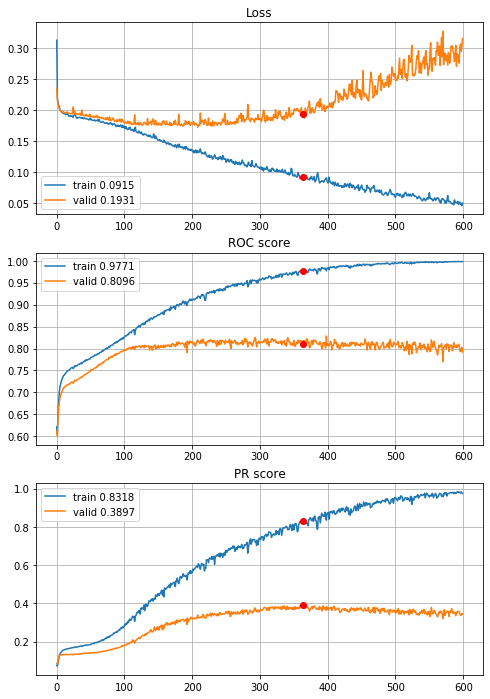


Fold 2------------------------------------------------------------


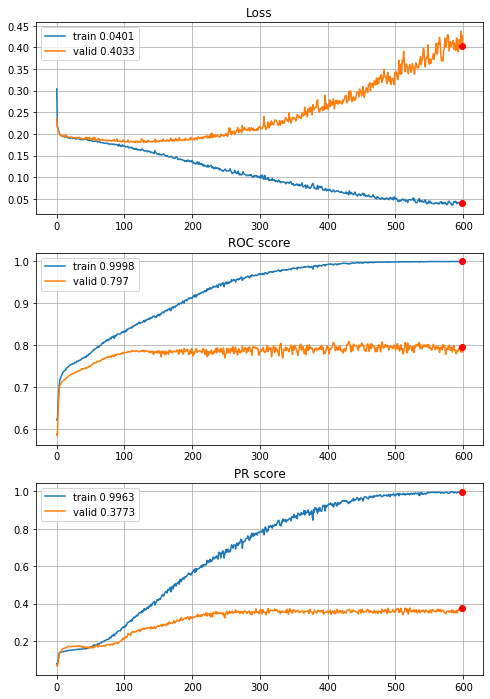


Fold 3------------------------------------------------------------


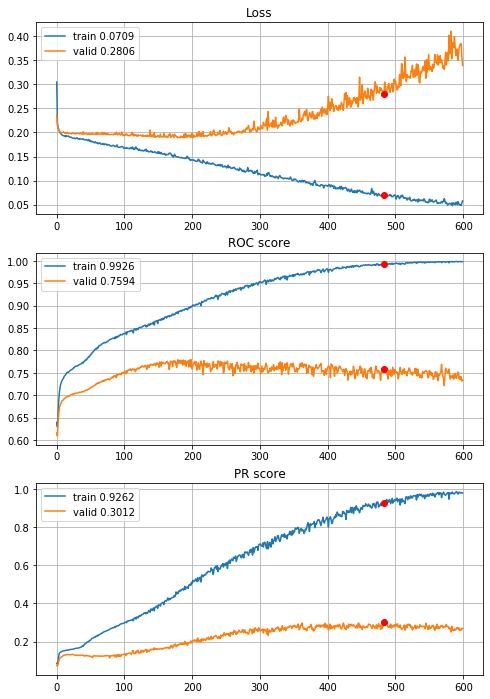


Fold 4------------------------------------------------------------


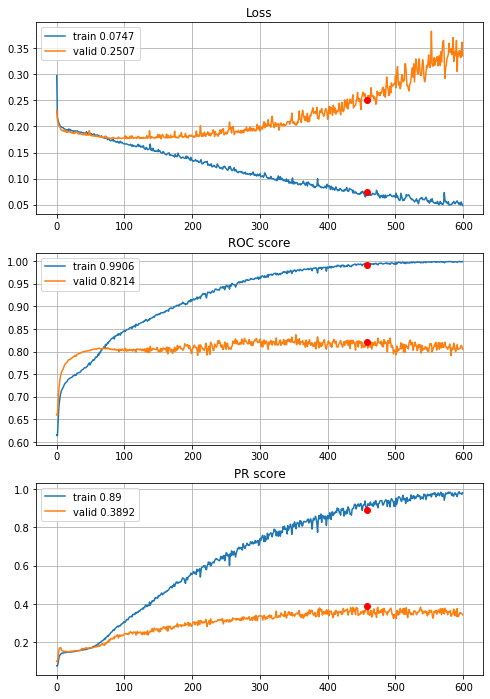


Fold 5------------------------------------------------------------


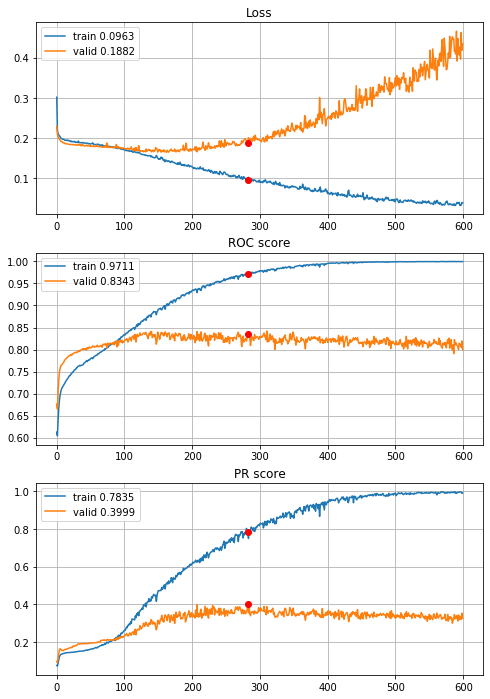


Fold 6------------------------------------------------------------


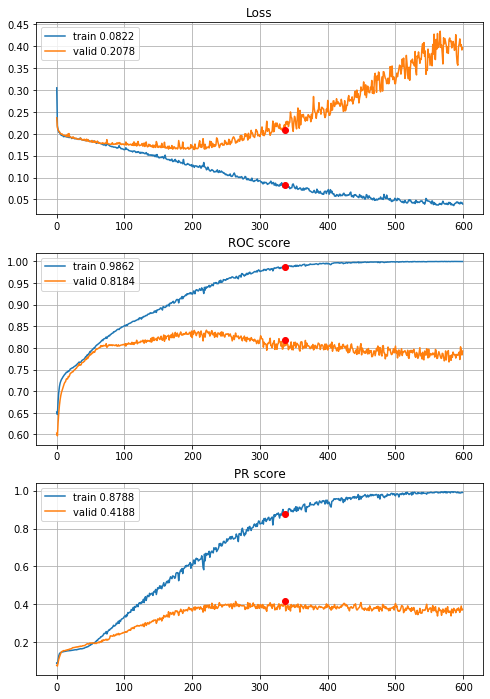

In [63]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_02, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L2_drop_02_600ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

This is the best model, one of the highest results, nice and smooth learning curves, but huge overfitting, which seems to be caused by early stopping, because after approx 300 epochs validation PRs are pretty constant while training PRs grows. Early stopping catches a PR deviation on 400 epoch for example what causes overfitting. Lets try the model with another dropout settings (last attemps). 411 is an early stopping epochs median, so lets set the training with 400 epochs to save computation power.  

In [59]:
def define_deep_CNN_2inc_std_L2_drop_01(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.1)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 5.97s train loss: 0.31172365162242066, validation loss: 0.2346812780715723
Epoch: 2/400,
cumulative time: 7.73s train loss: 0.21870076548179782, validation loss: 0.2144225535038136
Epoch: 3/400,
cumulative time: 9.5s train loss: 0.2106842131222137, validation loss: 0.2096579158241202
Epoch: 4/400,
cumulative time: 11.27s train loss: 0.2074453763265011, validation loss: 0.20537657927217087
Epoch: 5/400,
cumulative time: 13.03s train loss: 0.20440923434446412, validation loss: 0.20292610817616127
Epoch: 6/400,
cumulative time: 14.84s train loss: 0.20217297943650125, validation loss: 0.2007869213129729
Epoch: 7/400,
cumulative time: 16.82s train loss: 0.19980207226037103, validation loss: 0.19917623152977923
Epoch: 8/400,
cumulative time: 18.54s train loss: 0.1977160298197662, validation loss: 0.19790258723671864
Epoch: 9/400,
cumulative time: 20.44s train loss: 0.1967675344817858

Epoch: 76/400,
cumulative time: 139.6s train loss: 0.1715409238275481, validation loss: 0.18383437130344085
Epoch: 77/400,
cumulative time: 141.27s train loss: 0.17319035205402086, validation loss: 0.18116576332596387
Epoch: 78/400,
cumulative time: 142.93s train loss: 0.17162103463539097, validation loss: 0.17873926398866108
Epoch: 79/400,
cumulative time: 144.58s train loss: 0.17150575880797833, validation loss: 0.18428320525413147
Epoch: 80/400,
cumulative time: 146.24s train loss: 0.17309280211466396, validation loss: 0.17879558257743403
Epoch: 81/400,
cumulative time: 147.89s train loss: 0.17165459359672727, validation loss: 0.17825516411201575
Epoch: 82/400,
cumulative time: 149.59s train loss: 0.17102874084306677, validation loss: 0.18002570937327417
Epoch: 83/400,
cumulative time: 151.26s train loss: 0.16934586673808588, validation loss: 0.18008056233292782
Epoch: 84/400,
cumulative time: 152.92s train loss: 0.1704106113005769, validation loss: 0.18311204847995727
Epoch: 85/400

Epoch: 151/400,
cumulative time: 265.56s train loss: 0.14596735265288094, validation loss: 0.1726797924429645
Epoch: 152/400,
cumulative time: 267.26s train loss: 0.14760841196675595, validation loss: 0.1728961854219599
Epoch: 153/400,
cumulative time: 268.97s train loss: 0.14819773430762914, validation loss: 0.17245116045760653
Epoch: 154/400,
cumulative time: 270.68s train loss: 0.14511504328560962, validation loss: 0.17380299016965173
Epoch: 155/400,
cumulative time: 272.39s train loss: 0.14458971931245856, validation loss: 0.1714551715805386
Epoch: 156/400,
cumulative time: 274.1s train loss: 0.14421131657381953, validation loss: 0.17224084028506295
Epoch: 157/400,
cumulative time: 275.81s train loss: 0.143180006441532, validation loss: 0.1768312203977447
Epoch: 158/400,
cumulative time: 277.54s train loss: 0.14269577566015287, validation loss: 0.1726912757809102
Epoch: 159/400,
cumulative time: 279.25s train loss: 0.14392048950077127, validation loss: 0.17637410690948377
Epoch: 16

Epoch: 226/400,
cumulative time: 396.27s train loss: 0.11817514157929992, validation loss: 0.1763166330597529
Epoch: 227/400,
cumulative time: 397.99s train loss: 0.11481728982806903, validation loss: 0.17082555455119533
Epoch: 228/400,
cumulative time: 399.7s train loss: 0.11497814435956752, validation loss: 0.1712759125488319
Epoch: 229/400,
cumulative time: 401.41s train loss: 0.11637235300146914, validation loss: 0.18135582893539076
Epoch: 230/400,
cumulative time: 403.13s train loss: 0.11566430959765826, validation loss: 0.1730336281131773
Epoch: 231/400,
cumulative time: 404.85s train loss: 0.11380970523920077, validation loss: 0.17713937794293896
Epoch: 232/400,
cumulative time: 406.56s train loss: 0.11521666077839879, validation loss: 0.17454844936373445
Epoch: 233/400,
cumulative time: 408.28s train loss: 0.11671755211758837, validation loss: 0.17464882408257973
Epoch: 234/400,
cumulative time: 410.0s train loss: 0.11538649148184842, validation loss: 0.1709847413738866
Epoch: 

Epoch: 301/400,
cumulative time: 526.02s train loss: 0.08929513230459186, validation loss: 0.191265726207145
Epoch: 302/400,
cumulative time: 527.73s train loss: 0.09017127909980807, validation loss: 0.18977807179204942
Epoch: 303/400,
cumulative time: 529.44s train loss: 0.09050042434043429, validation loss: 0.1907599233319112
Epoch: 304/400,
cumulative time: 531.16s train loss: 0.08965647469403941, validation loss: 0.19037688910514827
Epoch: 305/400,
cumulative time: 532.88s train loss: 0.08896304481314911, validation loss: 0.2029542782584204
Epoch: 306/400,
cumulative time: 534.6s train loss: 0.09075775822891163, validation loss: 0.20611602518329658
Epoch: 307/400,
cumulative time: 536.31s train loss: 0.08967094825704758, validation loss: 0.20772767330692932
Epoch: 308/400,
cumulative time: 538.05s train loss: 0.090762594722117, validation loss: 0.19608260119058715
Epoch: 309/400,
cumulative time: 539.79s train loss: 0.08896076353323909, validation loss: 0.1998976924494061
Epoch: 31

Epoch: 376/400,
cumulative time: 655.7s train loss: 0.06742227639093332, validation loss: 0.24486954602520022
Epoch: 377/400,
cumulative time: 657.4s train loss: 0.0688707598977285, validation loss: 0.23680235479988151
Epoch: 378/400,
cumulative time: 659.1s train loss: 0.06589838655227441, validation loss: 0.23934624817316186
Epoch: 379/400,
cumulative time: 660.84s train loss: 0.06827543126263184, validation loss: 0.22586228187754498
Epoch: 380/400,
cumulative time: 662.61s train loss: 0.0681262973751292, validation loss: 0.23570679897065874
Epoch: 381/400,
cumulative time: 664.41s train loss: 0.06662270156548683, validation loss: 0.2721299153554188
Epoch: 382/400,
cumulative time: 666.2s train loss: 0.07494071261947395, validation loss: 0.23708938571407
Epoch: 383/400,
cumulative time: 667.97s train loss: 0.06967739563323197, validation loss: 0.24719232036760666
Epoch: 384/400,
cumulative time: 669.73s train loss: 0.0647694149847156, validation loss: 0.24672517681543807
Epoch: 385/4

Epoch: 49/400,
cumulative time: 94.47s train loss: 0.18755100204998834, validation loss: 0.1929750082097628
Epoch: 50/400,
cumulative time: 96.27s train loss: 0.18527336659506785, validation loss: 0.1881935659255845
Epoch: 51/400,
cumulative time: 98.09s train loss: 0.1854503891512855, validation loss: 0.1878823968039799
Epoch: 52/400,
cumulative time: 99.89s train loss: 0.18514766856920453, validation loss: 0.1887589592646384
Epoch: 53/400,
cumulative time: 101.7s train loss: 0.1836107992499267, validation loss: 0.1874544505585287
Epoch: 54/400,
cumulative time: 103.51s train loss: 0.18321114972519903, validation loss: 0.18735709960887512
Epoch: 55/400,
cumulative time: 105.31s train loss: 0.18328616003379436, validation loss: 0.1919483055846881
Epoch: 56/400,
cumulative time: 107.11s train loss: 0.18368218915064427, validation loss: 0.18687495510135077
Epoch: 57/400,
cumulative time: 108.92s train loss: 0.184268203269359, validation loss: 0.19238294145742835
Epoch: 58/400,
cumulative

Epoch: 124/400,
cumulative time: 230.46s train loss: 0.1637631865969377, validation loss: 0.18270120643449528
Epoch: 125/400,
cumulative time: 232.27s train loss: 0.1610728476521723, validation loss: 0.18151116230156733
Epoch: 126/400,
cumulative time: 234.08s train loss: 0.16122763848760935, validation loss: 0.18620460717308027
Epoch: 127/400,
cumulative time: 235.91s train loss: 0.1637841671132983, validation loss: 0.1865034989246793
Epoch: 128/400,
cumulative time: 237.72s train loss: 0.16256163653326702, validation loss: 0.18579062995982057
Epoch: 129/400,
cumulative time: 239.51s train loss: 0.1610882324568017, validation loss: 0.18075340913216867
Epoch: 130/400,
cumulative time: 241.31s train loss: 0.1609553955064131, validation loss: 0.18488243312515962
Epoch: 131/400,
cumulative time: 243.11s train loss: 0.16028942994902248, validation loss: 0.1822750335996698
Epoch: 132/400,
cumulative time: 244.89s train loss: 0.1599086482419267, validation loss: 0.18014531480649282
Epoch: 13

Epoch: 199/400,
cumulative time: 366.39s train loss: 0.13694697234134787, validation loss: 0.1866766680070054
Epoch: 200/400,
cumulative time: 368.2s train loss: 0.1361537726955438, validation loss: 0.18895225908538774
Epoch: 201/400,
cumulative time: 370.02s train loss: 0.13730798841099087, validation loss: 0.18784658549958302
Epoch: 202/400,
cumulative time: 371.81s train loss: 0.13288412020817839, validation loss: 0.18738660196043994
Epoch: 203/400,
cumulative time: 373.62s train loss: 0.13057442631024066, validation loss: 0.18766465184638256
Epoch: 204/400,
cumulative time: 375.45s train loss: 0.1320811655749324, validation loss: 0.18771485528871265
Epoch: 205/400,
cumulative time: 377.25s train loss: 0.13081231531266635, validation loss: 0.18970706179443877
Epoch: 206/400,
cumulative time: 379.08s train loss: 0.1301499496398124, validation loss: 0.18671007914921312
Epoch: 207/400,
cumulative time: 380.87s train loss: 0.12988184751334217, validation loss: 0.19076779735299337
Epoch:

Epoch: 274/400,
cumulative time: 502.31s train loss: 0.10232041861816792, validation loss: 0.2107089724343516
Epoch: 275/400,
cumulative time: 504.13s train loss: 0.1063606588764264, validation loss: 0.24020247978974232
Epoch: 276/400,
cumulative time: 505.95s train loss: 0.11242477666222885, validation loss: 0.21149776935820844
Epoch: 277/400,
cumulative time: 507.75s train loss: 0.10419922347908431, validation loss: 0.21373266814475647
Epoch: 278/400,
cumulative time: 509.55s train loss: 0.10762872960381428, validation loss: 0.22080682346900357
Epoch: 279/400,
cumulative time: 511.36s train loss: 0.10706294389056296, validation loss: 0.23360058422840072
Epoch: 280/400,
cumulative time: 513.17s train loss: 0.10669578971442971, validation loss: 0.2140373036904429
Epoch: 281/400,
cumulative time: 514.98s train loss: 0.10385107089822825, validation loss: 0.22020612742277618
Epoch: 282/400,
cumulative time: 516.78s train loss: 0.10252396054347757, validation loss: 0.2166467400393249
Epoch

Epoch: 349/400,
cumulative time: 638.98s train loss: 0.08188400657328276, validation loss: 0.2412380445685169
Epoch: 350/400,
cumulative time: 640.79s train loss: 0.07656855163653117, validation loss: 0.249614343645623
Epoch: 351/400,
cumulative time: 642.59s train loss: 0.0800511309498827, validation loss: 0.24992243003244705
Epoch: 352/400,
cumulative time: 644.4s train loss: 0.07746997904516964, validation loss: 0.25954848377780904
Epoch: 353/400,
cumulative time: 646.22s train loss: 0.08149004506915462, validation loss: 0.24682271218851684
Epoch: 354/400,
cumulative time: 648.02s train loss: 0.0810094915333454, validation loss: 0.24735323799719527
Epoch: 355/400,
cumulative time: 649.83s train loss: 0.07779630425879631, validation loss: 0.25785963292061836
Epoch: 356/400,
cumulative time: 651.66s train loss: 0.08038028116635629, validation loss: 0.26489598803612713
Epoch: 357/400,
cumulative time: 653.46s train loss: 0.07646453360038039, validation loss: 0.2509445170101623
Epoch: 3

Epoch: 22/400,
cumulative time: 47.48s train loss: 0.18888213672479492, validation loss: 0.19747779611181127
Epoch: 23/400,
cumulative time: 49.37s train loss: 0.18868753466621724, validation loss: 0.1973106549701535
Epoch: 24/400,
cumulative time: 51.25s train loss: 0.18778512943761802, validation loss: 0.19743551340250842
Epoch: 25/400,
cumulative time: 53.11s train loss: 0.18736819929823667, validation loss: 0.1984105515005314
Epoch: 26/400,
cumulative time: 55.02s train loss: 0.18723907194555772, validation loss: 0.19822567582657907
Epoch: 27/400,
cumulative time: 56.93s train loss: 0.18821896752463071, validation loss: 0.19748004234267222
Epoch: 28/400,
cumulative time: 58.91s train loss: 0.18676384926921874, validation loss: 0.1969523299523484
Epoch: 29/400,
cumulative time: 60.84s train loss: 0.18677966360595818, validation loss: 0.1967733521255366
Epoch: 30/400,
cumulative time: 62.75s train loss: 0.18738708748092414, validation loss: 0.19808228094817992
Epoch: 31/400,
cumulati

Epoch: 98/400,
cumulative time: 191.8s train loss: 0.16793497288671905, validation loss: 0.19526091686635702
Epoch: 99/400,
cumulative time: 193.7s train loss: 0.16780439018391466, validation loss: 0.19257011413168468
Epoch: 100/400,
cumulative time: 195.58s train loss: 0.16551701418916454, validation loss: 0.19400570439675618
Epoch: 101/400,
cumulative time: 197.45s train loss: 0.16598554066760687, validation loss: 0.19411270018131901
Epoch: 102/400,
cumulative time: 199.35s train loss: 0.16564041245832734, validation loss: 0.19314507254538202
Epoch: 103/400,
cumulative time: 201.24s train loss: 0.16572935015356835, validation loss: 0.19606918385639086
Epoch: 104/400,
cumulative time: 203.15s train loss: 0.1663737796408335, validation loss: 0.19557116183194276
Epoch: 105/400,
cumulative time: 205.01s train loss: 0.16598305715765208, validation loss: 0.19281820329051994
Epoch: 106/400,
cumulative time: 206.9s train loss: 0.1648999132174376, validation loss: 0.19354817316879458
Epoch: 1

Epoch: 173/400,
cumulative time: 333.4s train loss: 0.14718152593400716, validation loss: 0.19379802243980604
Epoch: 174/400,
cumulative time: 335.29s train loss: 0.1487343248746448, validation loss: 0.18917723470719353
Epoch: 175/400,
cumulative time: 337.14s train loss: 0.1517515893278274, validation loss: 0.19502456379715807
Epoch: 176/400,
cumulative time: 338.98s train loss: 0.14954951497351102, validation loss: 0.1987945959935633
Epoch: 177/400,
cumulative time: 340.85s train loss: 0.14653428895270876, validation loss: 0.1903566091116632
Epoch: 178/400,
cumulative time: 342.71s train loss: 0.1474125675697767, validation loss: 0.19051933018750605
Epoch: 179/400,
cumulative time: 344.57s train loss: 0.1466467531483423, validation loss: 0.1890921145981879
Epoch: 180/400,
cumulative time: 346.45s train loss: 0.14771658075808763, validation loss: 0.18915178996515242
Epoch: 181/400,
cumulative time: 348.32s train loss: 0.145789043700096, validation loss: 0.18984085425906963
Epoch: 182/

Epoch: 248/400,
cumulative time: 474.88s train loss: 0.1251648671719094, validation loss: 0.19708994601030916
Epoch: 249/400,
cumulative time: 476.8s train loss: 0.12701698668614633, validation loss: 0.19870971441471796
Epoch: 250/400,
cumulative time: 478.67s train loss: 0.12467792952347237, validation loss: 0.20238718400608527
Epoch: 251/400,
cumulative time: 480.57s train loss: 0.1270628772208237, validation loss: 0.19991824306786019
Epoch: 252/400,
cumulative time: 482.45s train loss: 0.12211960635903776, validation loss: 0.1970203242349008
Epoch: 253/400,
cumulative time: 484.34s train loss: 0.12345201062373629, validation loss: 0.20238918883610615
Epoch: 254/400,
cumulative time: 486.31s train loss: 0.1272129441862468, validation loss: 0.1994671720258227
Epoch: 255/400,
cumulative time: 488.37s train loss: 0.12226863351948462, validation loss: 0.20791606823143463
Epoch: 256/400,
cumulative time: 490.39s train loss: 0.12124208053978558, validation loss: 0.20827866255871855
Epoch: 

Epoch: 323/400,
cumulative time: 619.95s train loss: 0.09824571489727693, validation loss: 0.2100784405102285
Epoch: 324/400,
cumulative time: 621.79s train loss: 0.09884317951277152, validation loss: 0.23145865184908582
Epoch: 325/400,
cumulative time: 623.63s train loss: 0.09940570260987983, validation loss: 0.21828786798526512
Epoch: 326/400,
cumulative time: 625.48s train loss: 0.10058155501938379, validation loss: 0.2238785972028788
Epoch: 327/400,
cumulative time: 627.32s train loss: 0.09645246083139318, validation loss: 0.21139099216120352
Epoch: 328/400,
cumulative time: 629.16s train loss: 0.09548445463070959, validation loss: 0.21634180664285824
Epoch: 329/400,
cumulative time: 631.0s train loss: 0.09625328010541452, validation loss: 0.21667930662347964
Epoch: 330/400,
cumulative time: 632.86s train loss: 0.10275013512983384, validation loss: 0.21893274575126992
Epoch: 331/400,
cumulative time: 634.69s train loss: 0.09831743563400958, validation loss: 0.22547490978987547
Epoc

Epoch: 398/400,
cumulative time: 759.67s train loss: 0.0804745123489431, validation loss: 0.24881126482605204
Epoch: 399/400,
cumulative time: 761.52s train loss: 0.07492371545461515, validation loss: 0.2630346236056905
Epoch: 400/400,
cumulative time: 763.38s train loss: 0.07532142567022546, validation loss: 0.26439022595903516

Early stopping results:
best results in epoch: 362, 
best valid PR: 0.2943519541305249, 
valid ROC: 0.7862134273772204        
overfitting PR: 0.5348880275350438, 
overfitting ROC: 0.19326487791934222

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 5.99s train loss: 0.30712395946222676, validation loss: 0.2362333731516597
Epoch: 2/400,
cumulative time: 8.07s train loss: 0.21988522734715732, validation loss: 0.2142259101627472
Epoch: 3/400,
cumulative time: 10.14s train loss: 0.21130115886962203, validation loss: 0.20723255428024667
Epoch: 4/400,
cumulative time: 12.19s train loss: 0.2069003445875185

Epoch: 71/400,
cumulative time: 145.64s train loss: 0.17748214407332763, validation loss: 0.18014730741330115
Epoch: 72/400,
cumulative time: 147.61s train loss: 0.17604596368196337, validation loss: 0.18248264583866153
Epoch: 73/400,
cumulative time: 149.64s train loss: 0.1779328915142776, validation loss: 0.18263923817544345
Epoch: 74/400,
cumulative time: 151.66s train loss: 0.17595528830190324, validation loss: 0.17790889326125445
Epoch: 75/400,
cumulative time: 153.66s train loss: 0.17569204733479857, validation loss: 0.17866500008057543
Epoch: 76/400,
cumulative time: 155.63s train loss: 0.17387433846656297, validation loss: 0.17791982282173724
Epoch: 77/400,
cumulative time: 157.61s train loss: 0.1739863926641431, validation loss: 0.17795831813059185
Epoch: 78/400,
cumulative time: 159.56s train loss: 0.1737972394323927, validation loss: 0.1774118373574977
Epoch: 79/400,
cumulative time: 161.54s train loss: 0.17326423488876955, validation loss: 0.17792833917517498
Epoch: 80/400,

Epoch: 146/400,
cumulative time: 294.33s train loss: 0.15230164551392378, validation loss: 0.17409462914367854
Epoch: 147/400,
cumulative time: 296.28s train loss: 0.15204501287595917, validation loss: 0.17410137544407012
Epoch: 148/400,
cumulative time: 298.26s train loss: 0.15284996190269814, validation loss: 0.17648902937130834
Epoch: 149/400,
cumulative time: 300.22s train loss: 0.15494668120489155, validation loss: 0.17307600103080314
Epoch: 150/400,
cumulative time: 302.22s train loss: 0.15112344780714881, validation loss: 0.17806069659407728
Epoch: 151/400,
cumulative time: 304.19s train loss: 0.15382723787366476, validation loss: 0.17423526850421872
Epoch: 152/400,
cumulative time: 306.15s train loss: 0.1529779396479386, validation loss: 0.17320190699754562
Epoch: 153/400,
cumulative time: 308.11s train loss: 0.15449554433488852, validation loss: 0.18354038197301212
Epoch: 154/400,
cumulative time: 310.14s train loss: 0.15254104736267537, validation loss: 0.17326909379743247
Ep

Epoch: 221/400,
cumulative time: 441.89s train loss: 0.13014299161229945, validation loss: 0.17420189564450408
Epoch: 222/400,
cumulative time: 443.88s train loss: 0.12791582144290536, validation loss: 0.17894563735180602
Epoch: 223/400,
cumulative time: 445.92s train loss: 0.12896315352267015, validation loss: 0.17819449980093396
Epoch: 224/400,
cumulative time: 447.96s train loss: 0.12464109254105774, validation loss: 0.17774416049821917
Epoch: 225/400,
cumulative time: 449.93s train loss: 0.12375697100071593, validation loss: 0.17529740145492098
Epoch: 226/400,
cumulative time: 451.92s train loss: 0.12266020136301287, validation loss: 0.17461502525658734
Epoch: 227/400,
cumulative time: 453.98s train loss: 0.12034570811823443, validation loss: 0.1767169423984621
Epoch: 228/400,
cumulative time: 455.96s train loss: 0.12475888631262831, validation loss: 0.17339030311901282
Epoch: 229/400,
cumulative time: 457.93s train loss: 0.12383217868729604, validation loss: 0.17480978012653012
Ep

Epoch: 296/400,
cumulative time: 589.94s train loss: 0.10135326815669386, validation loss: 0.1888588148063344
Epoch: 297/400,
cumulative time: 591.89s train loss: 0.10331425456634322, validation loss: 0.18639554091462315
Epoch: 298/400,
cumulative time: 593.84s train loss: 0.10279451034345209, validation loss: 0.1871503153124823
Epoch: 299/400,
cumulative time: 595.79s train loss: 0.09985895604544563, validation loss: 0.18839416831954958
Epoch: 300/400,
cumulative time: 597.73s train loss: 0.10045913413286729, validation loss: 0.19387073372601651
Epoch: 301/400,
cumulative time: 599.68s train loss: 0.1023363515980218, validation loss: 0.18811398913983668
Epoch: 302/400,
cumulative time: 601.61s train loss: 0.09832390593716157, validation loss: 0.18939238292697014
Epoch: 303/400,
cumulative time: 603.55s train loss: 0.10114900437635832, validation loss: 0.2043569999600528
Epoch: 304/400,
cumulative time: 605.52s train loss: 0.10126427587932939, validation loss: 0.19218478233656808
Epoch

Epoch: 371/400,
cumulative time: 736.62s train loss: 0.08028045464593708, validation loss: 0.21503794974336177
Epoch: 372/400,
cumulative time: 738.56s train loss: 0.08496674401963356, validation loss: 0.21009171103400548
Epoch: 373/400,
cumulative time: 740.5s train loss: 0.08269913154476007, validation loss: 0.21643046050797196
Epoch: 374/400,
cumulative time: 742.43s train loss: 0.08293999904843032, validation loss: 0.21049751551318444
Epoch: 375/400,
cumulative time: 744.36s train loss: 0.07710124453879516, validation loss: 0.2146074106248566
Epoch: 376/400,
cumulative time: 746.31s train loss: 0.08053867163165265, validation loss: 0.21831885003532334
Epoch: 377/400,
cumulative time: 748.25s train loss: 0.08107925261416878, validation loss: 0.2254126536513446
Epoch: 378/400,
cumulative time: 750.18s train loss: 0.07713899202162866, validation loss: 0.2235544785563032
Epoch: 379/400,
cumulative time: 752.12s train loss: 0.07845844601243064, validation loss: 0.2252001935645299
Epoch:

Epoch: 44/400,
cumulative time: 96.32s train loss: 0.18715317611438517, validation loss: 0.18188476781754143
Epoch: 45/400,
cumulative time: 98.4s train loss: 0.1875472070470712, validation loss: 0.18155995569615663
Epoch: 46/400,
cumulative time: 100.46s train loss: 0.18791955977288727, validation loss: 0.18134653637292275
Epoch: 47/400,
cumulative time: 102.52s train loss: 0.1858527345018774, validation loss: 0.1803515096694962
Epoch: 48/400,
cumulative time: 104.58s train loss: 0.18574823774316213, validation loss: 0.18332012221014143
Epoch: 49/400,
cumulative time: 106.63s train loss: 0.18642486061308378, validation loss: 0.18173642503224535
Epoch: 50/400,
cumulative time: 108.69s train loss: 0.18545789931432094, validation loss: 0.1797790908602343
Epoch: 51/400,
cumulative time: 110.73s train loss: 0.18500112304727756, validation loss: 0.18190635367212893
Epoch: 52/400,
cumulative time: 112.8s train loss: 0.18553257499839745, validation loss: 0.17965079781063895
Epoch: 53/400,
cum

Epoch: 119/400,
cumulative time: 251.3s train loss: 0.16366596547541795, validation loss: 0.17047543805447846
Epoch: 120/400,
cumulative time: 253.4s train loss: 0.16424145964268505, validation loss: 0.16750004485614942
Epoch: 121/400,
cumulative time: 255.46s train loss: 0.16152871008921812, validation loss: 0.16996079254946203
Epoch: 122/400,
cumulative time: 257.49s train loss: 0.16243051382467508, validation loss: 0.17984342384240934
Epoch: 123/400,
cumulative time: 259.52s train loss: 0.16612866524533898, validation loss: 0.16843384682969761
Epoch: 124/400,
cumulative time: 261.54s train loss: 0.15993840837433188, validation loss: 0.16614481278921017
Epoch: 125/400,
cumulative time: 263.59s train loss: 0.1588934064621597, validation loss: 0.1674938800995941
Epoch: 126/400,
cumulative time: 265.63s train loss: 0.1573958891101003, validation loss: 0.1688786957829135
Epoch: 127/400,
cumulative time: 267.67s train loss: 0.15757935793668615, validation loss: 0.16702625695463746
Epoch: 

Epoch: 194/400,
cumulative time: 406.06s train loss: 0.12800222156419214, validation loss: 0.17707633413881957
Epoch: 195/400,
cumulative time: 408.11s train loss: 0.13027494079950783, validation loss: 0.1741473446993477
Epoch: 196/400,
cumulative time: 410.17s train loss: 0.12630768138550075, validation loss: 0.175111676655121
Epoch: 197/400,
cumulative time: 412.21s train loss: 0.1282716518113783, validation loss: 0.17893817052448152
Epoch: 198/400,
cumulative time: 414.26s train loss: 0.13130309418744707, validation loss: 0.17973324898072093
Epoch: 199/400,
cumulative time: 416.3s train loss: 0.12730208809704627, validation loss: 0.17575858289766702
Epoch: 200/400,
cumulative time: 418.44s train loss: 0.1269500056375021, validation loss: 0.17727429202531925
Epoch: 201/400,
cumulative time: 420.57s train loss: 0.12432496145992562, validation loss: 0.1803464739702703
Epoch: 202/400,
cumulative time: 422.71s train loss: 0.12482532933110894, validation loss: 0.17818403719069198
Epoch: 2

Epoch: 269/400,
cumulative time: 560.6s train loss: 0.10069835037784347, validation loss: 0.1946239710178947
Epoch: 270/400,
cumulative time: 562.65s train loss: 0.11028117405895899, validation loss: 0.19545916638436045
Epoch: 271/400,
cumulative time: 564.68s train loss: 0.10089039590518134, validation loss: 0.19108039337623997
Epoch: 272/400,
cumulative time: 566.72s train loss: 0.09859633637279727, validation loss: 0.19360642082359875
Epoch: 273/400,
cumulative time: 568.77s train loss: 0.09803613640716977, validation loss: 0.19561684515317065
Epoch: 274/400,
cumulative time: 570.8s train loss: 0.10196864433903126, validation loss: 0.19559880248613515
Epoch: 275/400,
cumulative time: 572.83s train loss: 0.0964888742209812, validation loss: 0.19138567679503307
Epoch: 276/400,
cumulative time: 574.86s train loss: 0.09911398543349279, validation loss: 0.2007409248105187
Epoch: 277/400,
cumulative time: 576.9s train loss: 0.10449531384234464, validation loss: 0.2068816360482078
Epoch: 2

Epoch: 344/400,
cumulative time: 714.84s train loss: 0.07811001864767153, validation loss: 0.22428199458024808
Epoch: 345/400,
cumulative time: 716.89s train loss: 0.07992877215471662, validation loss: 0.2188175036406972
Epoch: 346/400,
cumulative time: 718.91s train loss: 0.07842160678775027, validation loss: 0.22071732290353047
Epoch: 347/400,
cumulative time: 720.99s train loss: 0.07505120786641419, validation loss: 0.23180850804339312
Epoch: 348/400,
cumulative time: 723.04s train loss: 0.07552583492310283, validation loss: 0.24644033214945235
Epoch: 349/400,
cumulative time: 725.11s train loss: 0.07372299267064317, validation loss: 0.24052760201919957
Epoch: 350/400,
cumulative time: 727.17s train loss: 0.08124197298084632, validation loss: 0.22542276803901476
Epoch: 351/400,
cumulative time: 729.21s train loss: 0.07707081415156848, validation loss: 0.22388681292290258
Epoch: 352/400,
cumulative time: 731.26s train loss: 0.07578107133438741, validation loss: 0.2294123119773592
Epo

Epoch: 16/400,
cumulative time: 38.5s train loss: 0.19089779686710284, validation loss: 0.19203506810057716
Epoch: 17/400,
cumulative time: 40.57s train loss: 0.19074406422074064, validation loss: 0.1973947567778972
Epoch: 18/400,
cumulative time: 42.64s train loss: 0.19028470498836378, validation loss: 0.19117735523212834
Epoch: 19/400,
cumulative time: 44.72s train loss: 0.19001604012804094, validation loss: 0.19732185217681308
Epoch: 20/400,
cumulative time: 46.79s train loss: 0.18940210747197758, validation loss: 0.19075334447687264
Epoch: 21/400,
cumulative time: 48.87s train loss: 0.19115033250683533, validation loss: 0.19282743405824787
Epoch: 22/400,
cumulative time: 50.91s train loss: 0.19032913204363683, validation loss: 0.18964634797147575
Epoch: 23/400,
cumulative time: 52.98s train loss: 0.18744203506325716, validation loss: 0.18898944112114427
Epoch: 24/400,
cumulative time: 55.04s train loss: 0.1877545473553354, validation loss: 0.18874877997818695
Epoch: 25/400,
cumulat

Epoch: 92/400,
cumulative time: 197.67s train loss: 0.16596986693461996, validation loss: 0.17695771730238474
Epoch: 93/400,
cumulative time: 199.75s train loss: 0.17225454663675205, validation loss: 0.1821798032976951
Epoch: 94/400,
cumulative time: 201.82s train loss: 0.17177841965766513, validation loss: 0.17711046575606681
Epoch: 95/400,
cumulative time: 203.89s train loss: 0.16739916057206186, validation loss: 0.17790073672010073
Epoch: 96/400,
cumulative time: 205.97s train loss: 0.16286963048494524, validation loss: 0.17394546435623143
Epoch: 97/400,
cumulative time: 208.04s train loss: 0.1640171795263724, validation loss: 0.17359455906321633
Epoch: 98/400,
cumulative time: 210.11s train loss: 0.16299115511749046, validation loss: 0.1739882309730761
Epoch: 99/400,
cumulative time: 212.19s train loss: 0.16243936696895328, validation loss: 0.17249150324501197
Epoch: 100/400,
cumulative time: 214.27s train loss: 0.16245354791141414, validation loss: 0.1731639623195339
Epoch: 101/40

Epoch: 167/400,
cumulative time: 353.49s train loss: 0.14131400958190557, validation loss: 0.16367678606136618
Epoch: 168/400,
cumulative time: 355.54s train loss: 0.13691756427125734, validation loss: 0.16151110121437248
Epoch: 169/400,
cumulative time: 357.65s train loss: 0.13466680486542468, validation loss: 0.16322343325501243
Epoch: 170/400,
cumulative time: 359.71s train loss: 0.1346907772241497, validation loss: 0.16525993483998794
Epoch: 171/400,
cumulative time: 361.88s train loss: 0.13913961923184087, validation loss: 0.1606749832142926
Epoch: 172/400,
cumulative time: 363.99s train loss: 0.1335969228695161, validation loss: 0.16081255850983575
Epoch: 173/400,
cumulative time: 366.09s train loss: 0.13324031468951558, validation loss: 0.1626954393141601
Epoch: 174/400,
cumulative time: 368.17s train loss: 0.13210709116062502, validation loss: 0.16521140876193138
Epoch: 175/400,
cumulative time: 370.28s train loss: 0.13623752123382032, validation loss: 0.16321447619544063
Epoch

Epoch: 242/400,
cumulative time: 509.47s train loss: 0.10356271972226422, validation loss: 0.1762213784521217
Epoch: 243/400,
cumulative time: 511.53s train loss: 0.1061748527416509, validation loss: 0.1850163539724389
Epoch: 244/400,
cumulative time: 513.6s train loss: 0.10773214980886847, validation loss: 0.18669339419629333
Epoch: 245/400,
cumulative time: 515.71s train loss: 0.10786232469128627, validation loss: 0.19622006707847606
Epoch: 246/400,
cumulative time: 517.82s train loss: 0.11461781140635996, validation loss: 0.18659902652294175
Epoch: 247/400,
cumulative time: 519.95s train loss: 0.10424695842268356, validation loss: 0.17741443438084964
Epoch: 248/400,
cumulative time: 522.03s train loss: 0.10095085522306024, validation loss: 0.1745969417634387
Epoch: 249/400,
cumulative time: 524.11s train loss: 0.10015319170702192, validation loss: 0.17792179084278906
Epoch: 250/400,
cumulative time: 526.22s train loss: 0.10068249989357779, validation loss: 0.1798695043866251
Epoch: 

Epoch: 317/400,
cumulative time: 665.69s train loss: 0.07782879987049823, validation loss: 0.2019208274192966
Epoch: 318/400,
cumulative time: 667.76s train loss: 0.07441412112706043, validation loss: 0.20738860723189503
Epoch: 319/400,
cumulative time: 669.85s train loss: 0.07213858732129884, validation loss: 0.210269103826554
Epoch: 320/400,
cumulative time: 671.97s train loss: 0.07576812732323582, validation loss: 0.227749153443838
Epoch: 321/400,
cumulative time: 674.07s train loss: 0.07481225649471149, validation loss: 0.19886662204031724
Epoch: 322/400,
cumulative time: 676.18s train loss: 0.07231672668285781, validation loss: 0.2027402163079714
Epoch: 323/400,
cumulative time: 678.26s train loss: 0.07293196047974795, validation loss: 0.22246897640848678
Epoch: 324/400,
cumulative time: 680.39s train loss: 0.07402484913200368, validation loss: 0.2185373958149463
Epoch: 325/400,
cumulative time: 682.46s train loss: 0.07330153202780061, validation loss: 0.2123156848289986
Epoch: 32

Epoch: 392/400,
cumulative time: 822.7s train loss: 0.05414151913975416, validation loss: 0.2516072674448873
Epoch: 393/400,
cumulative time: 824.77s train loss: 0.056435280217746506, validation loss: 0.2691948140187225
Epoch: 394/400,
cumulative time: 826.87s train loss: 0.054097956274727396, validation loss: 0.2666828312406098
Epoch: 395/400,
cumulative time: 828.96s train loss: 0.05510231770355912, validation loss: 0.27537174360466266
Epoch: 396/400,
cumulative time: 831.03s train loss: 0.05458022771029853, validation loss: 0.2421276771770511
Epoch: 397/400,
cumulative time: 833.11s train loss: 0.05734268073215756, validation loss: 0.2601499831968822
Epoch: 398/400,
cumulative time: 835.26s train loss: 0.055098263593492035, validation loss: 0.2840694015901485
Epoch: 399/400,
cumulative time: 837.44s train loss: 0.05543808880300628, validation loss: 0.2576460420313908
Epoch: 400/400,
cumulative time: 839.59s train loss: 0.053509179939980535, validation loss: 0.2481518850461339

Early

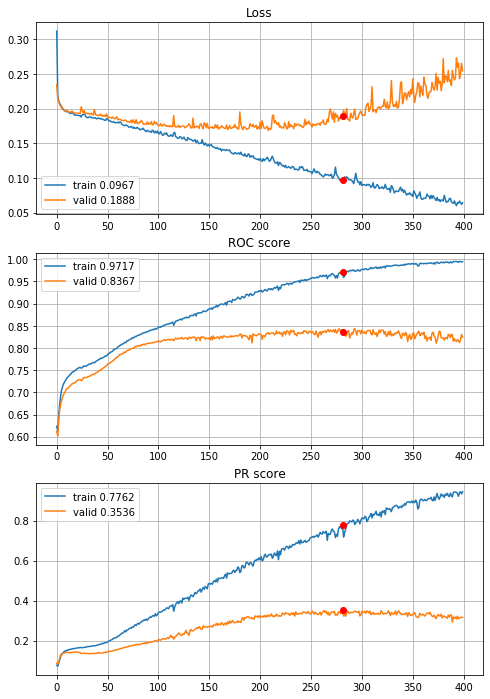


Fold 2------------------------------------------------------------


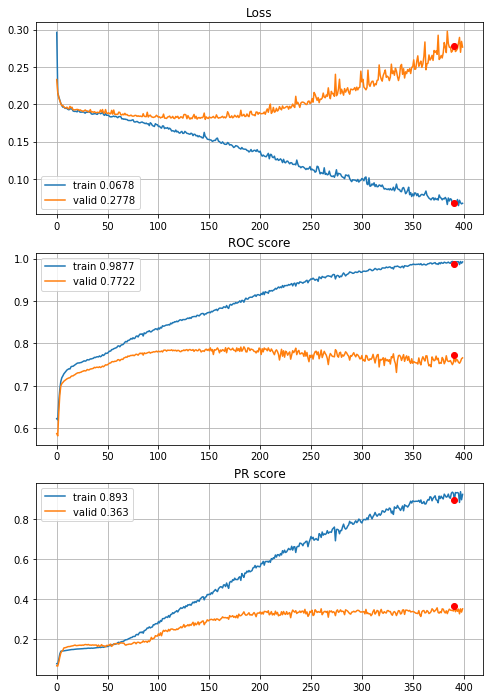


Fold 3------------------------------------------------------------


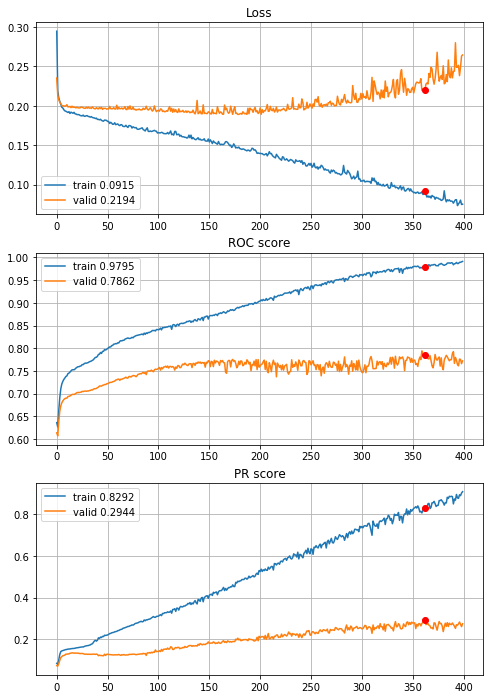


Fold 4------------------------------------------------------------


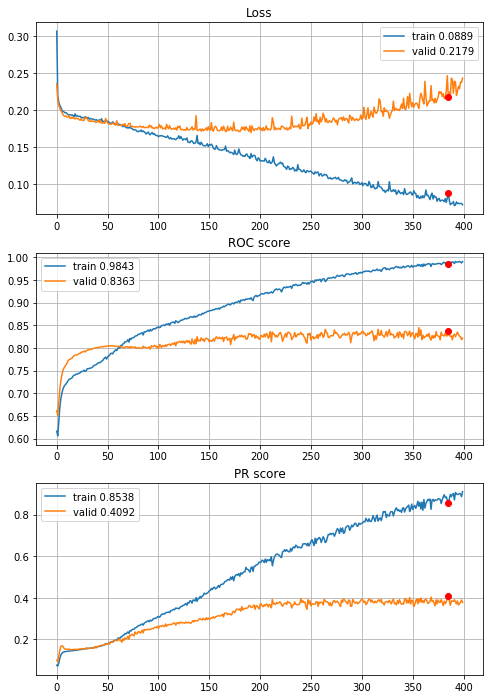


Fold 5------------------------------------------------------------


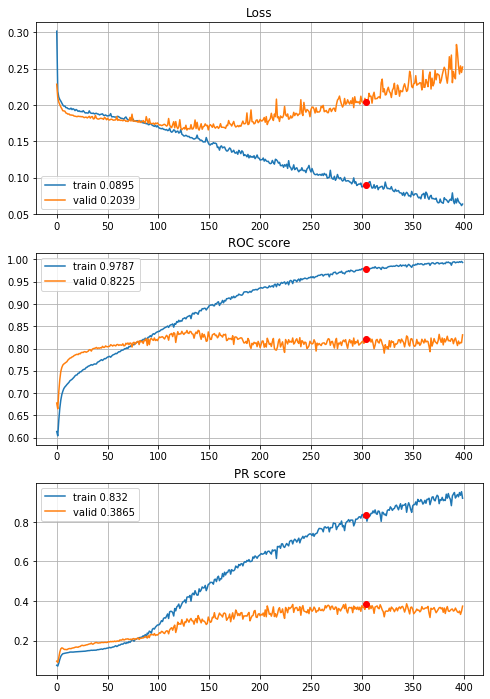


Fold 6------------------------------------------------------------


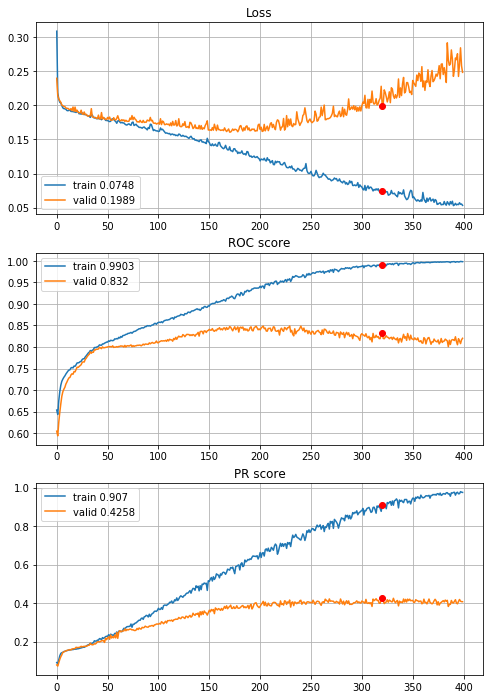

In [68]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_01, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L2_drop_01_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

There are no significant differences, lets try 0.4 dropout for completeness

In [60]:
def define_deep_CNN_2inc_std_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 7.25s train loss: 0.30486356636353806, validation loss: 0.23237868576450685
Epoch: 2/400,
cumulative time: 9.54s train loss: 0.22019726640275822, validation loss: 0.21393920492363105
Epoch: 3/400,
cumulative time: 11.85s train loss: 0.21201368845338703, validation loss: 0.2101101475337316
Epoch: 4/400,
cumulative time: 14.13s train loss: 0.21049811570809646, validation loss: 0.2056356683789345
Epoch: 5/400,
cumulative time: 16.34s train loss: 0.2065592793828701, validation loss: 0.20326343253812795
Epoch: 6/400,
cumulative time: 18.56s train loss: 0.2046685092182619, validation loss: 0.20114217872032103
Epoch: 7/400,
cumulative time: 20.8s train loss: 0.20266876751121962, validation loss: 0.19941407843785192
Epoch: 8/400,
cumulative time: 23.0s train loss: 0.20018760825468151, validation loss: 0.19808355845140713
Epoch: 9/400,
cumulative time: 25.16s train loss: 0.1981684299462

Epoch: 76/400,
cumulative time: 168.92s train loss: 0.17639723696331067, validation loss: 0.18114463373298464
Epoch: 77/400,
cumulative time: 171.05s train loss: 0.17686920098115194, validation loss: 0.18544971916527875
Epoch: 78/400,
cumulative time: 173.2s train loss: 0.17524030419878522, validation loss: 0.18174373724170084
Epoch: 79/400,
cumulative time: 175.34s train loss: 0.17470260177745686, validation loss: 0.18049712201175924
Epoch: 80/400,
cumulative time: 177.44s train loss: 0.17504518621464313, validation loss: 0.18056866130997648
Epoch: 81/400,
cumulative time: 179.58s train loss: 0.17378323139927457, validation loss: 0.17962788589111064
Epoch: 82/400,
cumulative time: 181.72s train loss: 0.17488215489907338, validation loss: 0.17935916436538152
Epoch: 83/400,
cumulative time: 183.84s train loss: 0.17296462778895424, validation loss: 0.18092206163094757
Epoch: 84/400,
cumulative time: 185.96s train loss: 0.17334180196713447, validation loss: 0.18145358333220848
Epoch: 85/4

Epoch: 151/400,
cumulative time: 329.39s train loss: 0.15452984874188114, validation loss: 0.17206782350092215
Epoch: 152/400,
cumulative time: 331.52s train loss: 0.1556493870921085, validation loss: 0.1770674240597257
Epoch: 153/400,
cumulative time: 333.69s train loss: 0.15488509439113565, validation loss: 0.1719253522612109
Epoch: 154/400,
cumulative time: 335.83s train loss: 0.154177795776502, validation loss: 0.17260557153421327
Epoch: 155/400,
cumulative time: 337.94s train loss: 0.1539559011798731, validation loss: 0.17573490660761878
Epoch: 156/400,
cumulative time: 340.1s train loss: 0.1554065305259204, validation loss: 0.17144593379382295
Epoch: 157/400,
cumulative time: 342.27s train loss: 0.15368915293337815, validation loss: 0.17302626698012252
Epoch: 158/400,
cumulative time: 344.47s train loss: 0.15327848884490503, validation loss: 0.178158521479778
Epoch: 159/400,
cumulative time: 346.62s train loss: 0.1542031210010746, validation loss: 0.1742051729870297
Epoch: 160/40

Epoch: 226/400,
cumulative time: 492.2s train loss: 0.13225931330478338, validation loss: 0.16946606339038514
Epoch: 227/400,
cumulative time: 494.47s train loss: 0.1279978883411747, validation loss: 0.167651320838701
Epoch: 228/400,
cumulative time: 496.79s train loss: 0.13014513370546094, validation loss: 0.17292957446094756
Epoch: 229/400,
cumulative time: 498.96s train loss: 0.12939662936413854, validation loss: 0.1720128661621339
Epoch: 230/400,
cumulative time: 501.08s train loss: 0.12639512770952427, validation loss: 0.17073304210697574
Epoch: 231/400,
cumulative time: 503.24s train loss: 0.12703883786722928, validation loss: 0.18397113770104492
Epoch: 232/400,
cumulative time: 505.4s train loss: 0.126921447144369, validation loss: 0.16994458917779448
Epoch: 233/400,
cumulative time: 507.5s train loss: 0.1287275904143488, validation loss: 0.1713896613388016
Epoch: 234/400,
cumulative time: 509.6s train loss: 0.13228948884717812, validation loss: 0.18106485223632188
Epoch: 235/40

Epoch: 301/400,
cumulative time: 653.05s train loss: 0.11053732414791406, validation loss: 0.18157080519840457
Epoch: 302/400,
cumulative time: 655.17s train loss: 0.11101286089214954, validation loss: 0.18352926720803575
Epoch: 303/400,
cumulative time: 657.26s train loss: 0.11106530808589121, validation loss: 0.1826969275087463
Epoch: 304/400,
cumulative time: 659.38s train loss: 0.10892697810582856, validation loss: 0.18849354296658946
Epoch: 305/400,
cumulative time: 661.51s train loss: 0.10923640837863212, validation loss: 0.18514443533285854
Epoch: 306/400,
cumulative time: 663.63s train loss: 0.10889835840660075, validation loss: 0.19238373564164438
Epoch: 307/400,
cumulative time: 665.75s train loss: 0.10769903552876366, validation loss: 0.18693722110974537
Epoch: 308/400,
cumulative time: 667.87s train loss: 0.10777978140043495, validation loss: 0.17856083289955327
Epoch: 309/400,
cumulative time: 669.98s train loss: 0.1088697485636905, validation loss: 0.18501386220882018
Epo

Epoch: 376/400,
cumulative time: 809.39s train loss: 0.10044919569758097, validation loss: 0.2155515300407955
Epoch: 377/400,
cumulative time: 811.4s train loss: 0.09672684694982656, validation loss: 0.19995300259778417
Epoch: 378/400,
cumulative time: 813.41s train loss: 0.09228898619543738, validation loss: 0.20976963215250805
Epoch: 379/400,
cumulative time: 815.42s train loss: 0.09489713452049194, validation loss: 0.20193389608918444
Epoch: 380/400,
cumulative time: 817.45s train loss: 0.09334149821653169, validation loss: 0.19974190336534814
Epoch: 381/400,
cumulative time: 819.5s train loss: 0.09801851726493117, validation loss: 0.20704285647286452
Epoch: 382/400,
cumulative time: 821.5s train loss: 0.09546093398891059, validation loss: 0.20724227592359196
Epoch: 383/400,
cumulative time: 823.51s train loss: 0.09405251458362324, validation loss: 0.21694680009673775
Epoch: 384/400,
cumulative time: 825.52s train loss: 0.09651922404636208, validation loss: 0.21644470641367933
Epoch

Epoch: 49/400,
cumulative time: 141.14s train loss: 0.18827326304984324, validation loss: 0.19208677883980793
Epoch: 50/400,
cumulative time: 144.0s train loss: 0.18764218525261186, validation loss: 0.1897610839205262
Epoch: 51/400,
cumulative time: 146.82s train loss: 0.18754744180684257, validation loss: 0.1896197854498765
Epoch: 52/400,
cumulative time: 149.62s train loss: 0.18730933415326406, validation loss: 0.18983322924663618
Epoch: 53/400,
cumulative time: 152.42s train loss: 0.18697717980242354, validation loss: 0.1893180305552856
Epoch: 54/400,
cumulative time: 155.27s train loss: 0.18624837815875206, validation loss: 0.18901299946441222
Epoch: 55/400,
cumulative time: 158.08s train loss: 0.1861658482103992, validation loss: 0.19463729782320352
Epoch: 56/400,
cumulative time: 160.89s train loss: 0.18613845857940123, validation loss: 0.18855825067580842
Epoch: 57/400,
cumulative time: 163.68s train loss: 0.18477767110317356, validation loss: 0.1924865986008154
Epoch: 58/400,
c

Epoch: 124/400,
cumulative time: 351.07s train loss: 0.16670964173866068, validation loss: 0.18243575886328095
Epoch: 125/400,
cumulative time: 353.84s train loss: 0.16549015546606427, validation loss: 0.1810531082649958
Epoch: 126/400,
cumulative time: 356.66s train loss: 0.16611538229384118, validation loss: 0.18235059468984766
Epoch: 127/400,
cumulative time: 359.47s train loss: 0.16520688373833411, validation loss: 0.1842274574335941
Epoch: 128/400,
cumulative time: 362.28s train loss: 0.16610853651206955, validation loss: 0.18476840131456468
Epoch: 129/400,
cumulative time: 365.06s train loss: 0.16476621305595118, validation loss: 0.18012599551693934
Epoch: 130/400,
cumulative time: 367.86s train loss: 0.16268592120540024, validation loss: 0.18232858468067736
Epoch: 131/400,
cumulative time: 370.65s train loss: 0.16386747265866972, validation loss: 0.18222977013065345
Epoch: 132/400,
cumulative time: 373.44s train loss: 0.16281787357005797, validation loss: 0.1806876380947514
Epoc

Epoch: 199/400,
cumulative time: 561.33s train loss: 0.1431067786115433, validation loss: 0.19100544814190304
Epoch: 200/400,
cumulative time: 564.12s train loss: 0.1399562337386191, validation loss: 0.18606041793802144
Epoch: 201/400,
cumulative time: 566.92s train loss: 0.14254370347186912, validation loss: 0.18791116331814908
Epoch: 202/400,
cumulative time: 569.76s train loss: 0.13800618060701275, validation loss: 0.18736950853310774
Epoch: 203/400,
cumulative time: 572.55s train loss: 0.13793089526616534, validation loss: 0.18529440444330522
Epoch: 204/400,
cumulative time: 575.33s train loss: 0.13677917130673986, validation loss: 0.18707274006003827
Epoch: 205/400,
cumulative time: 578.12s train loss: 0.13783693194884492, validation loss: 0.1883395316042488
Epoch: 206/400,
cumulative time: 580.91s train loss: 0.13625929228140615, validation loss: 0.19009416642198765
Epoch: 207/400,
cumulative time: 583.7s train loss: 0.1375232580940129, validation loss: 0.18702953810428907
Epoch:

Epoch: 274/400,
cumulative time: 771.41s train loss: 0.11745947677234725, validation loss: 0.19208789848607766
Epoch: 275/400,
cumulative time: 774.2s train loss: 0.11769387436046208, validation loss: 0.20719621082485087
Epoch: 276/400,
cumulative time: 777.01s train loss: 0.11948939355403027, validation loss: 0.20649324961062432
Epoch: 277/400,
cumulative time: 779.81s train loss: 0.12229573437275654, validation loss: 0.2007058431921239
Epoch: 278/400,
cumulative time: 782.6s train loss: 0.11469014908651168, validation loss: 0.20474296694632854
Epoch: 279/400,
cumulative time: 785.4s train loss: 0.11428626199967852, validation loss: 0.19669966694852623
Epoch: 280/400,
cumulative time: 788.27s train loss: 0.11410745770554931, validation loss: 0.19755304727000877
Epoch: 281/400,
cumulative time: 791.23s train loss: 0.11273711614273199, validation loss: 0.21188535137067774
Epoch: 282/400,
cumulative time: 794.09s train loss: 0.1122729447868772, validation loss: 0.19676923251744433
Epoch:

Epoch: 349/400,
cumulative time: 981.68s train loss: 0.09627992343439096, validation loss: 0.2108141562113395
Epoch: 350/400,
cumulative time: 984.47s train loss: 0.09882416629010385, validation loss: 0.22459015634653923
Epoch: 351/400,
cumulative time: 987.27s train loss: 0.09583091876876301, validation loss: 0.2187740617641549
Epoch: 352/400,
cumulative time: 990.07s train loss: 0.10030327340095614, validation loss: 0.22390733376256944
Epoch: 353/400,
cumulative time: 992.86s train loss: 0.10027329839109546, validation loss: 0.21821203303426362
Epoch: 354/400,
cumulative time: 995.66s train loss: 0.0990461276558266, validation loss: 0.21425301724140786
Epoch: 355/400,
cumulative time: 998.46s train loss: 0.10113986523728856, validation loss: 0.2112258170193113
Epoch: 356/400,
cumulative time: 1001.26s train loss: 0.10056072796996667, validation loss: 0.2169949941950805
Epoch: 357/400,
cumulative time: 1004.08s train loss: 0.09792295065227133, validation loss: 0.21779734002764814
Epoc

Epoch: 21/400,
cumulative time: 65.57s train loss: 0.1901297642552981, validation loss: 0.19816200050713662
Epoch: 22/400,
cumulative time: 68.46s train loss: 0.19098510058759327, validation loss: 0.1973708102478309
Epoch: 23/400,
cumulative time: 71.33s train loss: 0.18939385539493783, validation loss: 0.19717554055240546
Epoch: 24/400,
cumulative time: 74.19s train loss: 0.18909164628207514, validation loss: 0.19753655178600465
Epoch: 25/400,
cumulative time: 77.06s train loss: 0.1893317555575187, validation loss: 0.19874898987898948
Epoch: 26/400,
cumulative time: 79.97s train loss: 0.18789657681315922, validation loss: 0.19869851904754496
Epoch: 27/400,
cumulative time: 82.83s train loss: 0.18920839199550013, validation loss: 0.1974000878342972
Epoch: 28/400,
cumulative time: 85.72s train loss: 0.18910351977813605, validation loss: 0.19704300792059823
Epoch: 29/400,
cumulative time: 88.59s train loss: 0.1876902088561468, validation loss: 0.19731055462822936
Epoch: 30/400,
cumulativ

Epoch: 97/400,
cumulative time: 284.49s train loss: 0.17324857659111323, validation loss: 0.19498486092619705
Epoch: 98/400,
cumulative time: 287.36s train loss: 0.16851997380358605, validation loss: 0.19516057739702514
Epoch: 99/400,
cumulative time: 290.23s train loss: 0.16830538731130773, validation loss: 0.19454695268136615
Epoch: 100/400,
cumulative time: 293.1s train loss: 0.16769295320854385, validation loss: 0.1963092409850303
Epoch: 101/400,
cumulative time: 295.95s train loss: 0.16940362858225178, validation loss: 0.19504001801560897
Epoch: 102/400,
cumulative time: 298.82s train loss: 0.168750116921455, validation loss: 0.194628452193664
Epoch: 103/400,
cumulative time: 301.69s train loss: 0.16764010405988536, validation loss: 0.19694196902991476
Epoch: 104/400,
cumulative time: 304.58s train loss: 0.17002953672265383, validation loss: 0.20044850253222993
Epoch: 105/400,
cumulative time: 307.61s train loss: 0.16914689220842186, validation loss: 0.19509565962099396
Epoch: 106

Epoch: 172/400,
cumulative time: 504.21s train loss: 0.15042290770315953, validation loss: 0.19445711570057111
Epoch: 173/400,
cumulative time: 507.08s train loss: 0.1492968560498952, validation loss: 0.193490824898625
Epoch: 174/400,
cumulative time: 509.96s train loss: 0.15002905192767083, validation loss: 0.18996847893122185
Epoch: 175/400,
cumulative time: 512.84s train loss: 0.15247645488344452, validation loss: 0.1978095151823828
Epoch: 176/400,
cumulative time: 515.75s train loss: 0.14990663932780715, validation loss: 0.1963654796005188
Epoch: 177/400,
cumulative time: 518.64s train loss: 0.1485404522302413, validation loss: 0.19085100121730197
Epoch: 178/400,
cumulative time: 521.56s train loss: 0.14949090014186847, validation loss: 0.19334647530110374
Epoch: 179/400,
cumulative time: 524.43s train loss: 0.14922976403531532, validation loss: 0.19008403261800133
Epoch: 180/400,
cumulative time: 527.31s train loss: 0.14760065495148028, validation loss: 0.19102584447399787
Epoch: 

Epoch: 247/400,
cumulative time: 722.99s train loss: 0.12824733509556174, validation loss: 0.2016676247850253
Epoch: 248/400,
cumulative time: 725.89s train loss: 0.12876391534412102, validation loss: 0.1909337657965958
Epoch: 249/400,
cumulative time: 728.77s train loss: 0.12903884933541293, validation loss: 0.19380311676034154
Epoch: 250/400,
cumulative time: 731.75s train loss: 0.12649588095615008, validation loss: 0.20722167984087342
Epoch: 251/400,
cumulative time: 734.91s train loss: 0.13159450939569198, validation loss: 0.1928098580722017
Epoch: 252/400,
cumulative time: 738.41s train loss: 0.1277218965987784, validation loss: 0.19621897626280216
Epoch: 253/400,
cumulative time: 741.66s train loss: 0.12840254465403422, validation loss: 0.19460572401750162
Epoch: 254/400,
cumulative time: 744.7s train loss: 0.12867157731266612, validation loss: 0.19962501387923975
Epoch: 255/400,
cumulative time: 747.95s train loss: 0.12690320891449533, validation loss: 0.20720261136555526
Epoch:

Epoch: 322/400,
cumulative time: 945.07s train loss: 0.11219556345859925, validation loss: 0.20851256226178658
Epoch: 323/400,
cumulative time: 947.98s train loss: 0.1084005529585788, validation loss: 0.20178753577827027
Epoch: 324/400,
cumulative time: 950.95s train loss: 0.10771551420403552, validation loss: 0.23162312601763346
Epoch: 325/400,
cumulative time: 953.87s train loss: 0.11151537097849476, validation loss: 0.2020069625484773
Epoch: 326/400,
cumulative time: 956.8s train loss: 0.10972482699205323, validation loss: 0.20092125205542458
Epoch: 327/400,
cumulative time: 959.9s train loss: 0.1090562545431743, validation loss: 0.20621919400680624
Epoch: 328/400,
cumulative time: 962.88s train loss: 0.10652757164009193, validation loss: 0.2080297131697445
Epoch: 329/400,
cumulative time: 965.82s train loss: 0.1064530697953193, validation loss: 0.21043859699131112
Epoch: 330/400,
cumulative time: 968.8s train loss: 0.10854562660231507, validation loss: 0.20344908826605976
Epoch: 33

Epoch: 396/400,
cumulative time: 1168.11s train loss: 0.09086162641991488, validation loss: 0.2342715985398458
Epoch: 397/400,
cumulative time: 1171.06s train loss: 0.0945717679022379, validation loss: 0.2276500086747034
Epoch: 398/400,
cumulative time: 1174.03s train loss: 0.09400530402786673, validation loss: 0.23593218856883585
Epoch: 399/400,
cumulative time: 1176.96s train loss: 0.09618336702787664, validation loss: 0.23452427883875296
Epoch: 400/400,
cumulative time: 1179.93s train loss: 0.09253432577237208, validation loss: 0.22311965679943846

Early stopping results:
best results in epoch: 386, 
best valid PR: 0.3420980827980472, 
valid ROC: 0.7932760486639798        
overfitting PR: 0.5038805213299249, 
overfitting ROC: 0.18864658340377016

----------
Fold: 4
----------
Train on 7343 samples, validate on 1469 samples
Epoch: 1/400,
cumulative time: 8.01s train loss: 0.29821181509161326, validation loss: 0.23334985359782992
Epoch: 2/400,
cumulative time: 11.22s train loss: 0.221

Epoch: 69/400,
cumulative time: 215.36s train loss: 0.18002629933119568, validation loss: 0.17931162917427337
Epoch: 70/400,
cumulative time: 218.35s train loss: 0.1796596936884586, validation loss: 0.17927989710586423
Epoch: 71/400,
cumulative time: 221.36s train loss: 0.18087962193075421, validation loss: 0.17900171640618795
Epoch: 72/400,
cumulative time: 224.41s train loss: 0.17825698794703967, validation loss: 0.18062539481848905
Epoch: 73/400,
cumulative time: 227.43s train loss: 0.17995699506542687, validation loss: 0.18069481024983952
Epoch: 74/400,
cumulative time: 230.45s train loss: 0.1772913794320756, validation loss: 0.17823906923492722
Epoch: 75/400,
cumulative time: 233.45s train loss: 0.1783951388061428, validation loss: 0.18128091940837623
Epoch: 76/400,
cumulative time: 236.44s train loss: 0.17542137475700773, validation loss: 0.17862928688647878
Epoch: 77/400,
cumulative time: 239.42s train loss: 0.17671135316935058, validation loss: 0.17897329457646896
Epoch: 78/400

Epoch: 144/400,
cumulative time: 440.01s train loss: 0.15362822522255667, validation loss: 0.1789630828786659
Epoch: 145/400,
cumulative time: 442.97s train loss: 0.15333338380549888, validation loss: 0.18124850673526222
Epoch: 146/400,
cumulative time: 445.92s train loss: 0.15049875297598986, validation loss: 0.1790603216689326
Epoch: 147/400,
cumulative time: 448.88s train loss: 0.14984597603802002, validation loss: 0.18293266384840173
Epoch: 148/400,
cumulative time: 451.83s train loss: 0.15142793903497914, validation loss: 0.1797590647488731
Epoch: 149/400,
cumulative time: 454.8s train loss: 0.15025627228717917, validation loss: 0.1791958042741877
Epoch: 150/400,
cumulative time: 457.76s train loss: 0.15049093201742272, validation loss: 0.18661150752159103
Epoch: 151/400,
cumulative time: 460.7s train loss: 0.15493633254832864, validation loss: 0.18352201861983014
Epoch: 152/400,
cumulative time: 463.67s train loss: 0.1499593354640857, validation loss: 0.18130235604236855
Epoch: 1

Epoch: 219/400,
cumulative time: 663.71s train loss: 0.12902253378047193, validation loss: 0.18629891429935855
Epoch: 220/400,
cumulative time: 666.68s train loss: 0.1329102150108612, validation loss: 0.17772711716069908
Epoch: 221/400,
cumulative time: 669.75s train loss: 0.12938140816179913, validation loss: 0.1785936358228194
Epoch: 222/400,
cumulative time: 672.93s train loss: 0.12666454811796218, validation loss: 0.1804894398393235
Epoch: 223/400,
cumulative time: 676.09s train loss: 0.12970257273782718, validation loss: 0.1807452667786038
Epoch: 224/400,
cumulative time: 679.06s train loss: 0.1252836367726959, validation loss: 0.18808383930289396
Epoch: 225/400,
cumulative time: 682.14s train loss: 0.13106081192067773, validation loss: 0.179261581631158
Epoch: 226/400,
cumulative time: 685.15s train loss: 0.12645475824514332, validation loss: 0.17837379722671495
Epoch: 227/400,
cumulative time: 688.1s train loss: 0.12478169772774489, validation loss: 0.18088210380710332
Epoch: 22

Epoch: 294/400,
cumulative time: 890.83s train loss: 0.11304070264401365, validation loss: 0.18843036851483677
Epoch: 295/400,
cumulative time: 894.01s train loss: 0.10571462392957175, validation loss: 0.18905059630120993
Epoch: 296/400,
cumulative time: 897.11s train loss: 0.10796028286031947, validation loss: 0.19561280977612372
Epoch: 297/400,
cumulative time: 900.16s train loss: 0.11087168998489681, validation loss: 0.20206361741253598
Epoch: 298/400,
cumulative time: 903.14s train loss: 0.11107367525734824, validation loss: 0.18935449676013788
Epoch: 299/400,
cumulative time: 906.09s train loss: 0.110494567286038, validation loss: 0.18689271794483725
Epoch: 300/400,
cumulative time: 909.07s train loss: 0.10901061606195306, validation loss: 0.19909037838305155
Epoch: 301/400,
cumulative time: 912.03s train loss: 0.11048412952385919, validation loss: 0.1946505962118476
Epoch: 302/400,
cumulative time: 915.0s train loss: 0.11119935113135596, validation loss: 0.18623274513009944
Epoch

Epoch: 368/400,
cumulative time: 1116.01s train loss: 0.09779889860607599, validation loss: 0.1998219413263121
Epoch: 369/400,
cumulative time: 1119.02s train loss: 0.09760151676560688, validation loss: 0.21348287562799745
Epoch: 370/400,
cumulative time: 1122.11s train loss: 0.09639543170814827, validation loss: 0.20606289350556387
Epoch: 371/400,
cumulative time: 1125.21s train loss: 0.0912029489237639, validation loss: 0.21517885606697906
Epoch: 372/400,
cumulative time: 1128.28s train loss: 0.09712381824094106, validation loss: 0.21113581927030406
Epoch: 373/400,
cumulative time: 1131.37s train loss: 0.09802246141032726, validation loss: 0.2153083657208067
Epoch: 374/400,
cumulative time: 1134.46s train loss: 0.0938296016926144, validation loss: 0.21689384059893022
Epoch: 375/400,
cumulative time: 1137.5s train loss: 0.09244237508892153, validation loss: 0.21787272893790083
Epoch: 376/400,
cumulative time: 1140.55s train loss: 0.09112031503763021, validation loss: 0.213853726081088

Epoch: 41/400,
cumulative time: 132.47s train loss: 0.19042201562173874, validation loss: 0.1818714467275695
Epoch: 42/400,
cumulative time: 135.56s train loss: 0.19053283766366558, validation loss: 0.18178286610490946
Epoch: 43/400,
cumulative time: 138.66s train loss: 0.19040956445168175, validation loss: 0.18247946455303266
Epoch: 44/400,
cumulative time: 141.74s train loss: 0.19061162422993475, validation loss: 0.18091132609574606
Epoch: 45/400,
cumulative time: 144.81s train loss: 0.19066196137507627, validation loss: 0.18484399134765203
Epoch: 46/400,
cumulative time: 147.9s train loss: 0.18961403999794152, validation loss: 0.18104344279548454
Epoch: 47/400,
cumulative time: 150.95s train loss: 0.1878033613213916, validation loss: 0.18104257067152849
Epoch: 48/400,
cumulative time: 154.02s train loss: 0.18816806724161103, validation loss: 0.18204772415537926
Epoch: 49/400,
cumulative time: 157.09s train loss: 0.18810981595259735, validation loss: 0.18100900160356828
Epoch: 50/400

Epoch: 116/400,
cumulative time: 363.13s train loss: 0.16823047255460083, validation loss: 0.1710063571704181
Epoch: 117/400,
cumulative time: 366.16s train loss: 0.16856418521202338, validation loss: 0.17039917620553632
Epoch: 118/400,
cumulative time: 369.31s train loss: 0.16752328976688496, validation loss: 0.17432241363080386
Epoch: 119/400,
cumulative time: 372.52s train loss: 0.1670281066557226, validation loss: 0.17014503499305217
Epoch: 120/400,
cumulative time: 375.62s train loss: 0.16809680102056213, validation loss: 0.17026651297424406
Epoch: 121/400,
cumulative time: 378.7s train loss: 0.16671218210121125, validation loss: 0.170336939130557
Epoch: 122/400,
cumulative time: 381.85s train loss: 0.16751080305642227, validation loss: 0.17430818032178957
Epoch: 123/400,
cumulative time: 385.11s train loss: 0.16596952344499902, validation loss: 0.1696446803106599
Epoch: 124/400,
cumulative time: 388.21s train loss: 0.16520597571446224, validation loss: 0.16779264562055266
Epoch: 

Epoch: 191/400,
cumulative time: 591.27s train loss: 0.139972525752253, validation loss: 0.17697725579020762
Epoch: 192/400,
cumulative time: 594.33s train loss: 0.13959421101584218, validation loss: 0.16953513951977203
Epoch: 193/400,
cumulative time: 597.38s train loss: 0.13795610535118835, validation loss: 0.16605852794013817
Epoch: 194/400,
cumulative time: 600.43s train loss: 0.1364653097680711, validation loss: 0.16398989273189524
Epoch: 195/400,
cumulative time: 603.47s train loss: 0.13551255630041129, validation loss: 0.1656122848147917
Epoch: 196/400,
cumulative time: 606.52s train loss: 0.1358905185464453, validation loss: 0.1658795457282573
Epoch: 197/400,
cumulative time: 609.56s train loss: 0.13570711372748895, validation loss: 0.16697939907578746
Epoch: 198/400,
cumulative time: 612.63s train loss: 0.13587939881664865, validation loss: 0.1671802864818547
Epoch: 199/400,
cumulative time: 615.68s train loss: 0.1346608637091511, validation loss: 0.16581588599841016
Epoch: 20

Epoch: 266/400,
cumulative time: 816.98s train loss: 0.11060795651582396, validation loss: 0.18847439842100688
Epoch: 267/400,
cumulative time: 819.97s train loss: 0.10899180594896633, validation loss: 0.1768645694535175
Epoch: 268/400,
cumulative time: 823.04s train loss: 0.11381572697003228, validation loss: 0.17637540178743955
Epoch: 269/400,
cumulative time: 826.07s train loss: 0.11488432981163134, validation loss: 0.18114043908239386
Epoch: 270/400,
cumulative time: 829.12s train loss: 0.11731993725365089, validation loss: 0.1742810035880645
Epoch: 271/400,
cumulative time: 832.14s train loss: 0.10939736897227291, validation loss: 0.18044966436942853
Epoch: 272/400,
cumulative time: 835.14s train loss: 0.10924973190317747, validation loss: 0.1801062072208532
Epoch: 273/400,
cumulative time: 838.12s train loss: 0.10468217038218752, validation loss: 0.1841994923937873
Epoch: 274/400,
cumulative time: 841.09s train loss: 0.10950667658224215, validation loss: 0.18183316328951057
Epoch

Epoch: 341/400,
cumulative time: 1040.54s train loss: 0.08862068437340148, validation loss: 0.20099918771667116
Epoch: 342/400,
cumulative time: 1043.5s train loss: 0.08882154686039634, validation loss: 0.21196666179219772
Epoch: 343/400,
cumulative time: 1046.47s train loss: 0.08367368720942593, validation loss: 0.21309762829737053
Epoch: 344/400,
cumulative time: 1049.42s train loss: 0.08905369076017526, validation loss: 0.21298682529286403
Epoch: 345/400,
cumulative time: 1052.39s train loss: 0.09092424952776083, validation loss: 0.20547191337847254
Epoch: 346/400,
cumulative time: 1055.35s train loss: 0.08882442895477244, validation loss: 0.19900289253009437
Epoch: 347/400,
cumulative time: 1058.32s train loss: 0.08886468666554925, validation loss: 0.20575292306959791
Epoch: 348/400,
cumulative time: 1061.29s train loss: 0.08593746222157948, validation loss: 0.22957469293548236
Epoch: 349/400,
cumulative time: 1064.26s train loss: 0.08626571983861897, validation loss: 0.21260294379

Epoch: 13/400,
cumulative time: 45.33s train loss: 0.19449519527942136, validation loss: 0.19581966485818011
Epoch: 14/400,
cumulative time: 48.44s train loss: 0.19360283232640987, validation loss: 0.19412832429038732
Epoch: 15/400,
cumulative time: 51.53s train loss: 0.19413042230803462, validation loss: 0.19572450793081797
Epoch: 16/400,
cumulative time: 54.77s train loss: 0.19334721215848438, validation loss: 0.19292093687551223
Epoch: 17/400,
cumulative time: 58.05s train loss: 0.1928498833592421, validation loss: 0.19768158454011506
Epoch: 18/400,
cumulative time: 61.24s train loss: 0.1931050044194286, validation loss: 0.19228408727236598
Epoch: 19/400,
cumulative time: 64.4s train loss: 0.19174233966452234, validation loss: 0.19979427038242772
Epoch: 20/400,
cumulative time: 67.48s train loss: 0.1925491192976666, validation loss: 0.19346235306776188
Epoch: 21/400,
cumulative time: 70.58s train loss: 0.19196439657790468, validation loss: 0.19085217965639906
Epoch: 22/400,
cumulati

Epoch: 89/400,
cumulative time: 286.08s train loss: 0.17251572552013306, validation loss: 0.17715499192801093
Epoch: 90/400,
cumulative time: 289.32s train loss: 0.1720305694457882, validation loss: 0.1807224484571644
Epoch: 91/400,
cumulative time: 292.58s train loss: 0.1731132767315394, validation loss: 0.17672073569057423
Epoch: 92/400,
cumulative time: 295.85s train loss: 0.1738859438935948, validation loss: 0.17774359317501495
Epoch: 93/400,
cumulative time: 299.07s train loss: 0.17962548722693603, validation loss: 0.18098859328583736
Epoch: 94/400,
cumulative time: 302.35s train loss: 0.17603547192200986, validation loss: 0.17775856669007595
Epoch: 95/400,
cumulative time: 305.62s train loss: 0.17151438294299157, validation loss: 0.17908228375525176
Epoch: 96/400,
cumulative time: 308.85s train loss: 0.17122087163002533, validation loss: 0.17636668012155174
Epoch: 97/400,
cumulative time: 312.03s train loss: 0.17202967151285256, validation loss: 0.17628465570529736
Epoch: 98/400,

Epoch: 164/400,
cumulative time: 524.23s train loss: 0.1535024140841756, validation loss: 0.17046328191455118
Epoch: 165/400,
cumulative time: 527.38s train loss: 0.1540648107354028, validation loss: 0.1768851933711556
Epoch: 166/400,
cumulative time: 530.54s train loss: 0.15637358354936173, validation loss: 0.17033434582097653
Epoch: 167/400,
cumulative time: 533.7s train loss: 0.15649702270517293, validation loss: 0.17186796569775495
Epoch: 168/400,
cumulative time: 536.86s train loss: 0.1514510124869044, validation loss: 0.17088968574757146
Epoch: 169/400,
cumulative time: 540.01s train loss: 0.15440762522660828, validation loss: 0.17248536565160882
Epoch: 170/400,
cumulative time: 543.17s train loss: 0.1540743884040055, validation loss: 0.17079436088777694
Epoch: 171/400,
cumulative time: 546.27s train loss: 0.15682480138095506, validation loss: 0.17518167481922647
Epoch: 172/400,
cumulative time: 549.39s train loss: 0.15520168393079298, validation loss: 0.1718649899318043
Epoch: 1

Epoch: 239/400,
cumulative time: 763.2s train loss: 0.13571892017681225, validation loss: 0.1672557211539401
Epoch: 240/400,
cumulative time: 766.36s train loss: 0.1369464046794572, validation loss: 0.16685911233483608
Epoch: 241/400,
cumulative time: 769.51s train loss: 0.1355331083556763, validation loss: 0.1647998593767917
Epoch: 242/400,
cumulative time: 772.67s train loss: 0.13424796356022164, validation loss: 0.16616381276449652
Epoch: 243/400,
cumulative time: 775.84s train loss: 0.13674830319664252, validation loss: 0.16709338355941408
Epoch: 244/400,
cumulative time: 779.0s train loss: 0.13941708263334432, validation loss: 0.164690113765992
Epoch: 245/400,
cumulative time: 782.15s train loss: 0.136202903261534, validation loss: 0.16549531658679978
Epoch: 246/400,
cumulative time: 785.31s train loss: 0.13440102615144128, validation loss: 0.17088016528605765
Epoch: 247/400,
cumulative time: 788.47s train loss: 0.13631289678347785, validation loss: 0.16607116006456862
Epoch: 248/

Epoch: 314/400,
cumulative time: 1000.96s train loss: 0.11566951032119249, validation loss: 0.17254321888210988
Epoch: 315/400,
cumulative time: 1004.12s train loss: 0.11884946798528331, validation loss: 0.17282326556031646
Epoch: 316/400,
cumulative time: 1007.28s train loss: 0.11776826167905252, validation loss: 0.17185629658624327
Epoch: 317/400,
cumulative time: 1010.41s train loss: 0.1203710390721531, validation loss: 0.17135689245176575
Epoch: 318/400,
cumulative time: 1013.5s train loss: 0.11506083950173102, validation loss: 0.17242258425791843
Epoch: 319/400,
cumulative time: 1016.67s train loss: 0.11316182716569025, validation loss: 0.17357132123016855
Epoch: 320/400,
cumulative time: 1019.82s train loss: 0.11445823096526149, validation loss: 0.18195035992753603
Epoch: 321/400,
cumulative time: 1022.97s train loss: 0.11539608859588962, validation loss: 0.17287917171252196
Epoch: 322/400,
cumulative time: 1026.14s train loss: 0.11149043869430074, validation loss: 0.176023932280

Epoch: 388/400,
cumulative time: 1235.13s train loss: 0.09934436115446402, validation loss: 0.20394854383588812
Epoch: 389/400,
cumulative time: 1238.23s train loss: 0.09777309114523314, validation loss: 0.20208363103038285
Epoch: 390/400,
cumulative time: 1241.34s train loss: 0.10625678484078521, validation loss: 0.19200796073642673
Epoch: 391/400,
cumulative time: 1244.43s train loss: 0.09916558727816818, validation loss: 0.1973317286217895
Epoch: 392/400,
cumulative time: 1247.58s train loss: 0.09595119708962332, validation loss: 0.2025583195588894
Epoch: 393/400,
cumulative time: 1250.69s train loss: 0.0982265518085467, validation loss: 0.19973009260376404
Epoch: 394/400,
cumulative time: 1253.8s train loss: 0.0952310990034917, validation loss: 0.19606716618226075
Epoch: 395/400,
cumulative time: 1256.88s train loss: 0.09860186392851256, validation loss: 0.1924975926934536
Epoch: 396/400,
cumulative time: 1259.96s train loss: 0.09769857961335474, validation loss: 0.1940554701177560

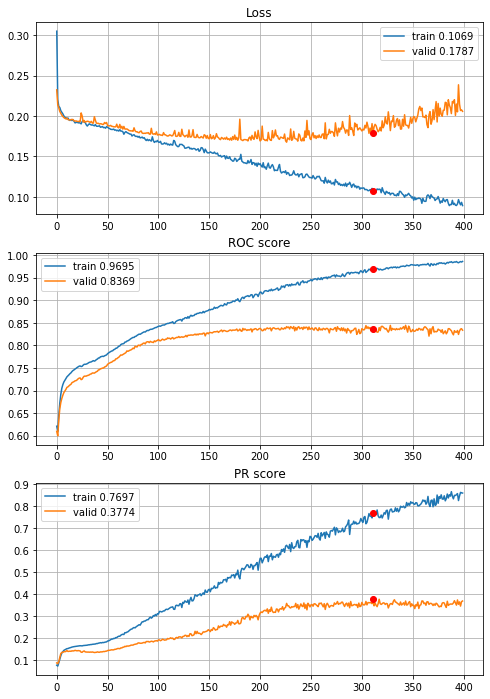


Fold 2------------------------------------------------------------


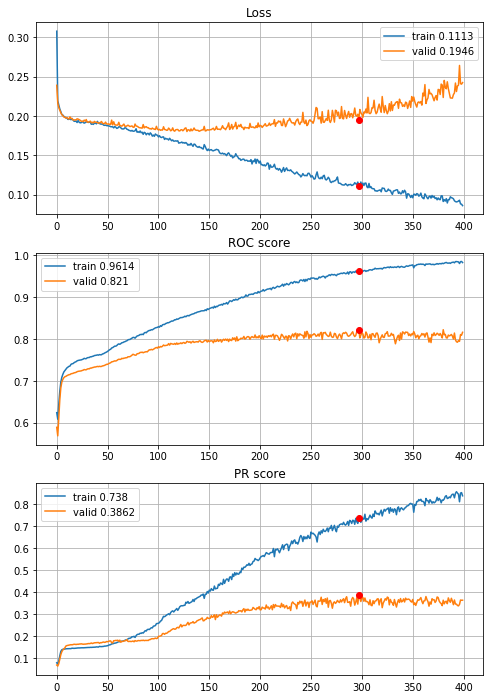


Fold 3------------------------------------------------------------


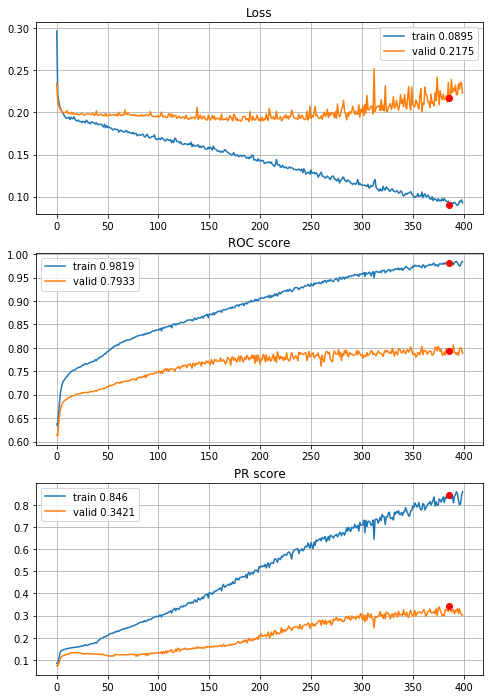


Fold 4------------------------------------------------------------


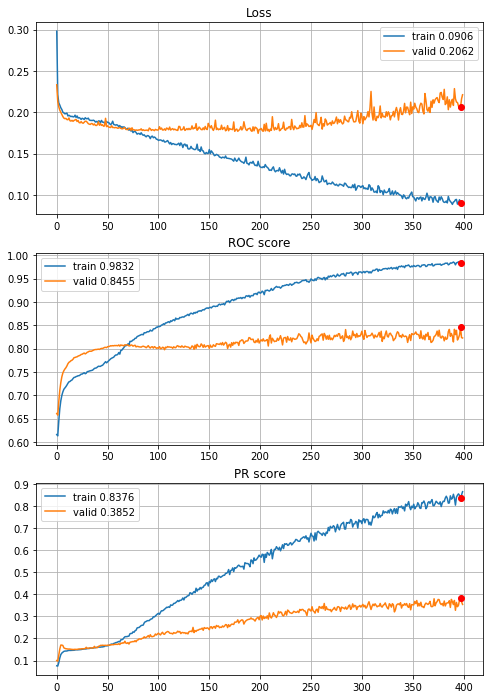


Fold 5------------------------------------------------------------


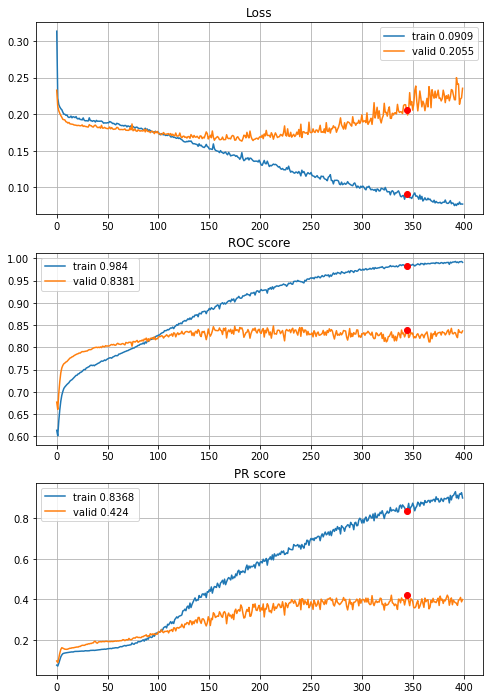


Fold 6------------------------------------------------------------


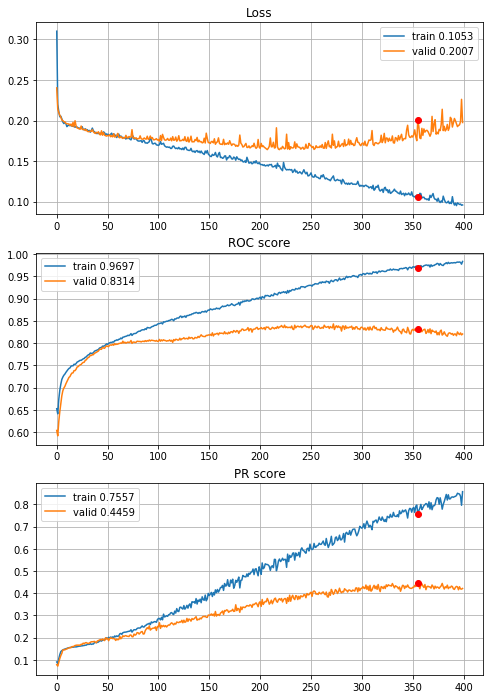

In [71]:
# THE BEST ONE
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L2_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

So that is the best model, best results and, one of the lowest overfitting (to comparable results models), the same in folds variance context. Moreover learning curves are pretty smooth.

To sum up, best 8x8 CNN configuration is:
 - definition: define_deep_CNN_2inc_std_L2_drop_04($\cdot$)
 - 8x8x1 input,
 - 2 inceptions $i^{[1]},i^{[2]}$,
     - $i^{[1]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=4, f_{2\_in}=f_{3\_in}=1$,
     - $i^{[2]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=8, f_{2\_in}=f_{3\_in}=4$,
     - relu activations,
 - 1 average pooling $f=(2,2),s=(2,2),p=\text{valid}$,
 - flatten ($512 \text{ units}$),
 - 1 dense layer $l^{[1]}$,
     - units: $u^{[1]}=256$,
     - activation: $a^{[1]}=relu$,
     - regularization: $L_2^{[1]}=0.00005$,
     - dropout: $0.4$
 - optimizer: Adam with default setings,
 - 350 epochs (rounded folds median: 349.5),
 - 394 batch size.
 
Because of small image size (8x8) CNN may be a bit under-trained, to fix it image dimensions has to increase. To do so feature generation method will be applied.

##### Feature generation for CNN
 - first, lets train the best XGBoost configuration and save the models (XGBoost achived much better results than Random Forest), note: best configuration excludes power transform from preprocessing pipeline, to get more reliable results best configuration with power transform will be used (CNN uses it too),

In [42]:
XGB_fi_hist, XGB_fi_models = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target,
                                                      random_state=random_state, info=0, normalize="power", q=0.005,
                                                      n_estimators=91, early_stopping_rounds=91, max_depth=7,
                                                      learning_rate=0.08, subsample=1, colsample_bytree=0.8, gamma=3, 
                                                      reg_alpha=0.3, reg_lambda=0.7, saveModels=True)


Cross validation time: 23s


 - second, lets create importance score table for each fold and on average,

In [43]:
XGBimportance=pd.DataFrame((features,
                           XGB_fi_models[0].feature_importances_,
                           XGB_fi_models[1].feature_importances_,
                           XGB_fi_models[2].feature_importances_,
                           XGB_fi_models[3].feature_importances_,
                           XGB_fi_models[4].feature_importances_,
                           XGB_fi_models[5].feature_importances_)).T

XGBimportance.columns = ("feature", "fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6")
XGBimportance["folds_mean_naive"] = XGBimportance.loc[:, ["fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6"]].mean(axis=1)
# normalize folds mean to sum up to 1
for i in range(len(features)):
    XGBimportance.loc[i,"folds_mean"]=XGBimportance.loc[i,"folds_mean_naive"]/XGBimportance["folds_mean_naive"].sum()

XGBimportance.drop(labels="folds_mean_naive",axis=1, inplace=True)
XGBimportance.sort_values(by="folds_mean", ascending=False, ignore_index=True, inplace=True)

XGBimportance

,feature,fold_1,fold_2,fold_3,fold_4,fold_5,fold_6,folds_mean
0,Attr26,0.0358361,0.0397653,0.0312129,0.0198683,0.0358452,0.0282916,0.031803
1,Attr24,0.0265769,0.0254667,0.0265744,0.0266204,0.0265626,0.0296526,0.026909
2,Attr56,0.0225564,0.0258177,0.0311075,0.0281522,0.019625,0.0209141,0.024695
3,Attr35,0.0232131,0.0249801,0.0319751,0.0260372,0.0188881,0.0157739,0.023478
4,Attr13,0.0223547,0.0203365,0.02251,0.0236687,0.0238796,0.0187246,0.021912
5,Attr44,0.0208219,0.0207346,0.0231928,0.0223389,0.021929,0.0216444,0.021777
6,Attr18,0.0152541,0.0177854,0.0118398,0.0205369,0.0161778,0.0448727,0.021078
7,Attr5,0.0196983,0.0206103,0.0216312,0.0208313,0.0229391,0.0195775,0.020881
8,Attr46,0.0237448,0.0208887,0.0191029,0.0214794,0.0182936,0.017469,0.020163
9,Attr4,0.023542,0.0217188,0.02151,0.0147323,0.0205267,0.0177846,0.019969


 - third, define the discrete probability distribution, where Attributes are events and its fold's average XGBoost importance score is the probability of that event (score average sums up to 1), then sample needed number of attributes pair and one of basic arithmetic operation to perform on them with uniform probability (addition, subtraction, multiplication, division) dealing with duplicates and commutative property of these basic operations to create instruction how to generate new features - feature_generation_instruction(),
 - fourth, define the function which will generate features by instruction and prevent dividing by 0 - generate_features(),

In [44]:
def feature_generation_instruction(image_shape, importance, random_state=random_state):
    '''
    function generates instruction how to create new features. The idea is to sample two features from discrete probability
    distribution with P(x=feature)=Importance(feature) and sample one of arithmetic operations in ["add", "subtract",
    "multiply", "divide"] uniformly distributed. Duplicates are not allowed. Different features sampling order for the same
    operation is forbidden too, arguments:
    image_shape - shape of image to create from all features (original and generated), tuple,
    importance - dataframe with importance score, needs to contain columns ["feature", "folds_mean"], where "folds_mean" is Importance(feature),
    random_state - random seed
    
    return feature generation instruction (pandas.DataFrame, colnames=["feature1", "feature2", "operation"])
    '''
    # random seeds
    np.random.seed(random_state)
    random.seed(random_state)

    # computing number of features to generate
    n_features = image_shape[0]*image_shape[1]-importance.shape[0]
    
    # check if it is possible to generate n_features
        # division by 2 because of we don't want (Attr1, Attr2, add) and (Attr2, Attr1, add) in our instruction
    if n_features > (importance.shape[0]*(importance.shape[0]-1)*4)/2:
        raise "Too may features to generate, maximum number of features with given importance is {}\
        ".format((importance.shape[0]*(importance.shape[0]-1)*4)/2)
    elif n_features <= 0:
        raise "image.shape[0]*image.shape[1]-importance.shape[0]<=0, there is no features to generate."

    # generate first row
    bse=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
    bse=np.append(bse, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
    bse=bse.reshape(1,-1) # needed for condition below (np.any(np.all()))
    # iterator (iterate through number of valid generated features) 
    i=1
    while True:
        # generate next row
        bse_tmp=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
        bse_tmp=np.append(bse_tmp, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
        # validate generated row
        if not np.any(np.all(bse==bse_tmp, axis=1)) and not np.any(np.all(np.array((bse_tmp[1], bse_tmp[0], bse_tmp[2]), dtype="object")==bse, axis=1)):
            # append
            bse=np.vstack((bse, bse_tmp))
            i+=1
        else:
            continue
        # stop generating rows when number of generated features is enough
        if i == n_features:
            break
    
    # convert to dataframe
    bse=pd.DataFrame(data=bse, columns=["feature1", "feature2", "operation"])
    
    return bse

def generate_features(data, instruction):
    '''
    function that generates new features for given dataframe with given istruction, arguments:
    data - dataframe with features,
    instruction - dataframe with 2 columns of features from data and column with arithmetic operation [+,-,*,/] to perform,
    
    return dataframe with old and generated features
    '''
    
    data_wgf=data.copy()
    
    for i in range(instruction.shape[0]):
        feature1=data[instruction.iloc[i,0]]
        feature2=data[instruction.iloc[i,1]]
        operation=instruction.iloc[i,2]
        if operation == "add":
            data_wgf["v"+str(i)]=feature1+feature2
        elif operation == "subtract":
            data_wgf["v"+str(i)]=feature1-feature2
        elif operation == "multiply":
            data_wgf["v"+str(i)]=feature1*feature2
        else:
            # prevent dividing by 0, when feature2==0 assign it to 1, then it won't cause an error 
            feature2.loc[feature2==0]=1
            data_wgf["v"+str(i)]=feature1/feature2
        
    return data_wgf

 - fifth generate instruction,

In [45]:
instruction=feature_generation_instruction(image_shape=(20,20), importance=XGBimportance, random_state=random_state)
instruction

,feature1,feature2,operation
0,Attr61,Attr43,subtract
1,Attr53,Attr9,multiply
2,Attr13,Attr5,add
3,Attr22,Attr8,multiply
4,Attr35,Attr24,multiply
...,...,...,...
336,Attr1,Attr13,multiply
337,Attr48,Attr31,divide
338,Attr42,Attr40,multiply
339,Attr44,Attr41,multiply


 - sixth perform Monte Carlo quasi optimization for image conversion with generated features for each of 6 folds (it will take a loooot of time) and save the results, 

In [56]:
# FOLD 1
# CV sets
fold=sets["training_sets"][0].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\4year_data\draft_20x20_fold_1.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2953286.4897
iteration: 100
current energy: 2856990.4276
iteration: 200
current energy: 2786724.9592
iteration: 300
current energy: 2734266.2822
iteration: 400
current energy: 2667563.5534
iteration: 500
current energy: 2590083.4694
iteration: 600
current energy: 2535200.1496
iteration: 700
current energy: 2513918.9813
iteration: 800
current energy: 2483201.4642
iteration: 900
current energy: 2470555.1045
iteration: 1000
current energy: 2440672.5805
iteration: 1100
current energy: 2420102.7157
iteration: 1200
current energy: 2403541.1311
iteration: 1300
current energy: 2378083.0427
iteration: 1400
current energy: 2360771.0832
iteration: 1500
current energy: 2350826.6103
iteration: 1600
current energy: 2341458.6227
iteration: 1700
current energy: 2307361.6975
iteration: 1800
current energy: 2286839.511
iteration: 1900
current energy: 2272232.5748
iteration: 2000
current energy: 2261319.6353
iteration: 2100
current energy: 2249197.1405
iteration: 2200
current energy

In [77]:
# FOLD 2
# CV sets
fold=sets["training_sets"][1].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\4year_data\draft_20x20_fold_2.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2956001.0273
iteration: 100
current energy: 2859354.2902
iteration: 200
current energy: 2791979.6916
iteration: 300
current energy: 2745553.4765
iteration: 400
current energy: 2677116.5262
iteration: 500
current energy: 2601258.5161
iteration: 600
current energy: 2561890.0026
iteration: 700
current energy: 2544982.5663
iteration: 800
current energy: 2515961.3252
iteration: 900
current energy: 2488245.3413
iteration: 1000
current energy: 2458769.3102
iteration: 1100
current energy: 2431753.3259
iteration: 1200
current energy: 2418180.6898
iteration: 1300
current energy: 2393702.0066
iteration: 1400
current energy: 2378985.0452
iteration: 1500
current energy: 2364715.4081
iteration: 1600
current energy: 2351861.4499
iteration: 1700
current energy: 2325290.9618
iteration: 1800
current energy: 2314987.3109
iteration: 1900
current energy: 2303081.9671
iteration: 2000
current energy: 2284148.8887
iteration: 2100
current energy: 2265455.7003
iteration: 2200
current energ

In [65]:
# FOLD 3
# CV sets
fold=sets["training_sets"][2].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\4year_data\draft_20x20_fold_3.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2955498.4564
iteration: 100
current energy: 2858730.7746
iteration: 200
current energy: 2788455.4011
iteration: 300
current energy: 2740647.9769
iteration: 400
current energy: 2672795.0737
iteration: 500
current energy: 2596919.2292
iteration: 600
current energy: 2558256.3987
iteration: 700
current energy: 2537435.4527
iteration: 800
current energy: 2510756.2368
iteration: 900
current energy: 2481451.8726
iteration: 1000
current energy: 2449691.646
iteration: 1100
current energy: 2423518.3934
iteration: 1200
current energy: 2409183.1682
iteration: 1300
current energy: 2383516.9449
iteration: 1400
current energy: 2366316.9441
iteration: 1500
current energy: 2354511.4975
iteration: 1600
current energy: 2330829.572
iteration: 1700
current energy: 2307484.1619
iteration: 1800
current energy: 2288733.9849
iteration: 1900
current energy: 2281374.2633
iteration: 2000
current energy: 2263752.9589
iteration: 2100
current energy: 2252126.5094
iteration: 2200
current energy:

In [66]:
# FOLD 4
# CV sets
fold=sets["training_sets"][3].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\4year_data\draft_20x20_fold_4.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2966656.4952
iteration: 100
current energy: 2870278.2502
iteration: 200
current energy: 2799905.8663
iteration: 300
current energy: 2747479.5125
iteration: 400
current energy: 2679990.1726
iteration: 500
current energy: 2602759.1418
iteration: 600
current energy: 2546586.6994
iteration: 700
current energy: 2524968.3119
iteration: 800
current energy: 2493312.0269
iteration: 900
current energy: 2475752.942
iteration: 1000
current energy: 2449861.0847
iteration: 1100
current energy: 2432463.8395
iteration: 1200
current energy: 2414102.6305
iteration: 1300
current energy: 2384483.496
iteration: 1400
current energy: 2359209.1337
iteration: 1500
current energy: 2346775.8692
iteration: 1600
current energy: 2329116.4636
iteration: 1700
current energy: 2301571.5404
iteration: 1800
current energy: 2277346.5275
iteration: 1900
current energy: 2265524.709
iteration: 2000
current energy: 2250736.6828
iteration: 2100
current energy: 2240546.4759
iteration: 2200
current energy: 

In [67]:
# FOLD 5
# CV sets
fold=sets["training_sets"][4].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\4year_data\draft_20x20_fold_5.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2970720.3222
iteration: 100
current energy: 2872139.1587
iteration: 200
current energy: 2800244.5663
iteration: 300
current energy: 2748769.5784
iteration: 400
current energy: 2682884.9241
iteration: 500
current energy: 2607073.2483
iteration: 600
current energy: 2558187.1068
iteration: 700
current energy: 2534662.7713
iteration: 800
current energy: 2511892.689
iteration: 900
current energy: 2497281.0994
iteration: 1000
current energy: 2471372.2877
iteration: 1100
current energy: 2440509.2504
iteration: 1200
current energy: 2422921.9916
iteration: 1300
current energy: 2392635.7812
iteration: 1400
current energy: 2374148.8223
iteration: 1500
current energy: 2363355.6239
iteration: 1600
current energy: 2348073.9016
iteration: 1700
current energy: 2312012.6442
iteration: 1800
current energy: 2305818.3718
iteration: 1900
current energy: 2276014.0968
iteration: 2000
current energy: 2258359.2356
iteration: 2100
current energy: 2251895.5755
iteration: 2200
current energy

In [68]:
# FOLD 6
# CV sets
fold=sets["training_sets"][5].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\4year_data\draft_20x20_fold_6.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2968090.9061
iteration: 100
current energy: 2871735.9592
iteration: 200
current energy: 2800837.9077
iteration: 300
current energy: 2749437.8063
iteration: 400
current energy: 2681731.892
iteration: 500
current energy: 2602966.7843
iteration: 600
current energy: 2548245.9038
iteration: 700
current energy: 2527381.4908
iteration: 800
current energy: 2497073.2904
iteration: 900
current energy: 2483874.877
iteration: 1000
current energy: 2454458.031
iteration: 1100
current energy: 2434790.5756
iteration: 1200
current energy: 2415167.0598
iteration: 1300
current energy: 2384519.8874
iteration: 1400
current energy: 2367498.9232
iteration: 1500
current energy: 2350881.3012
iteration: 1600
current energy: 2338290.9478
iteration: 1700
current energy: 2305713.7916
iteration: 1800
current energy: 2281927.47
iteration: 1900
current energy: 2269143.267
iteration: 2000
current energy: 2259359.0626
iteration: 2100
current energy: 2248108.8043
iteration: 2200
current energy: 224

In [69]:
# with open(r"data\4year_data\draft_20x20_fold_1.p", "rb") as fp:
#     draft_1 = pickle.load(fp)
# with open(r"data\4year_data\draft_20x20_fold_2.p", "rb") as fp:
#     draft_2 = pickle.load(fp)
# with open(r"data\4year_data\draft_20x20_fold_3.p", "rb") as fp:
#     draft_3 = pickle.load(fp)
# with open(r"data\4year_data\draft_20x20_fold_4.p", "rb") as fp:
#     draft_4 = pickle.load(fp)
# with open(r"data\4year_data\draft_20x20_fold_5.p", "rb") as fp:
#     draft_5 = pickle.load(fp)
# with open(r"data\4year_data\draft_20x20_fold_6.p", "rb") as fp:
#     draft_6 = pickle.load(fp)
# optimized_drafts=[draft_1,draft_2,draft_3,draft_4,draft_5,draft_6]

In [70]:
# # initial draft re-creation and saving (I forgot about saving when MC optimization was performed)
# train_folds=sets["training_sets"]
# initial_drafts=[]
# for fold in range(len(train_folds)):
#     X_train_fold=generate_features(train_folds[fold][features], instruction)
#     Y_train_fold=train_folds[fold][target].copy()
#     features_imp=X_train_fold.columns.tolist()
#     corr_matrix=X_train_fold[Y_train_fold==0].corr(method="spearman")
#     draft=image_dict_to_matrix(image_draft_inicialization(features_imp, random_state))
#     initial_drafts.append(draft)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [71]:
# drafts=dict(zip(["initial_drafts", "optimized_drafts"], [initial_drafts, optimized_drafts]))

# # saving drafts
# with open(r"data\4year_data\drafts_20x20.p", "wb") as fp:
#     pickle.dump(drafts, fp)

In [46]:
# LOADING 20x20 drafts
with open(r"data\4year_data\drafts_20x20.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

			 Normalization only

			-----FOLD 1 -----


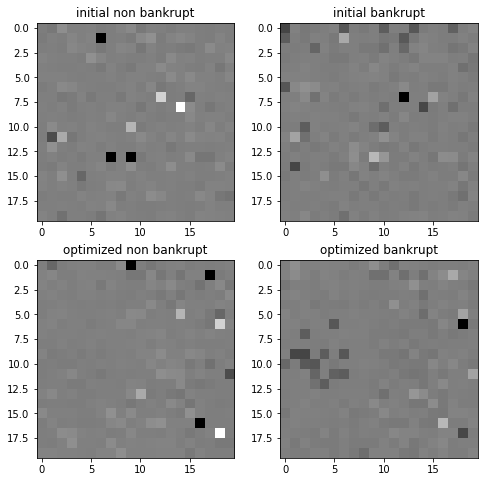


			-----FOLD 2 -----


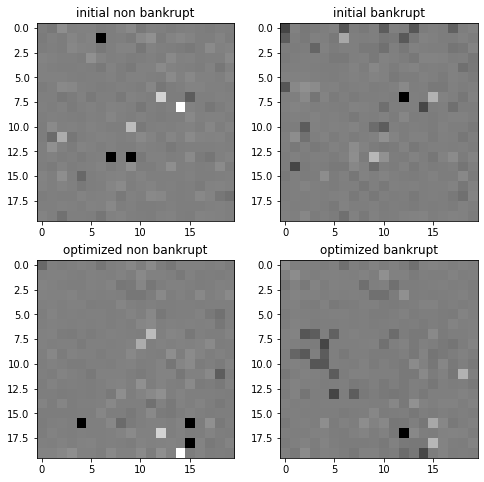


			-----FOLD 3 -----


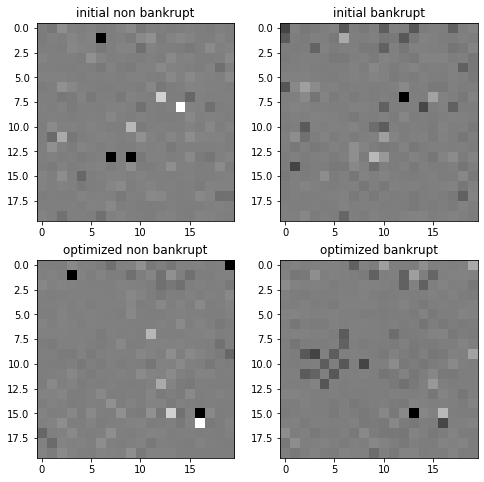


			-----FOLD 4 -----


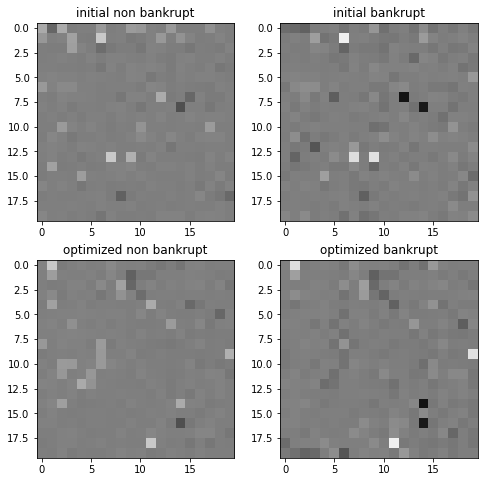


			-----FOLD 5 -----


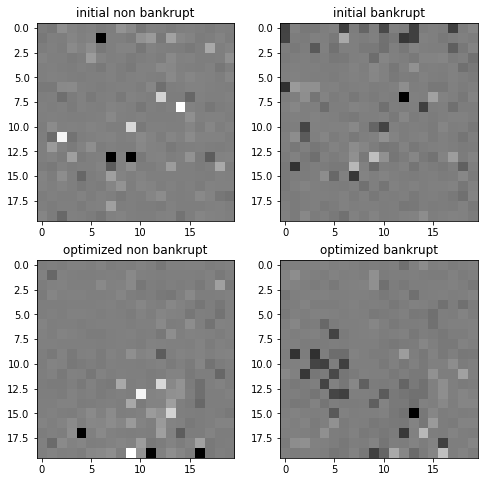


			-----FOLD 6 -----


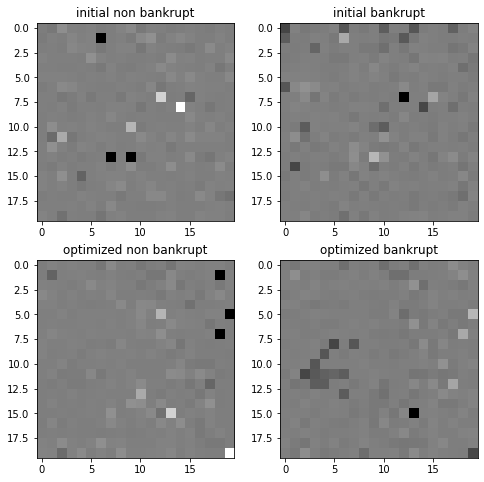

In [47]:
# printing images for normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization andquantile clipping

			-----FOLD 1 -----


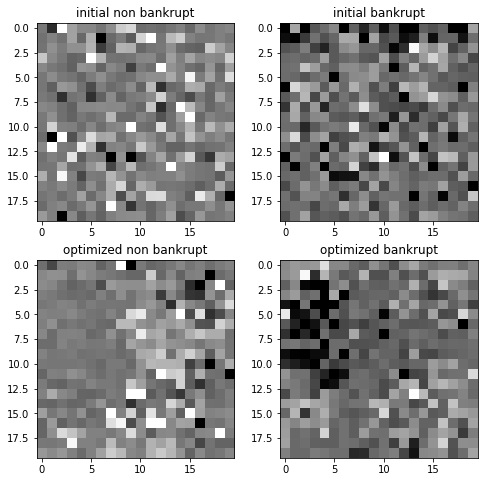


			-----FOLD 2 -----


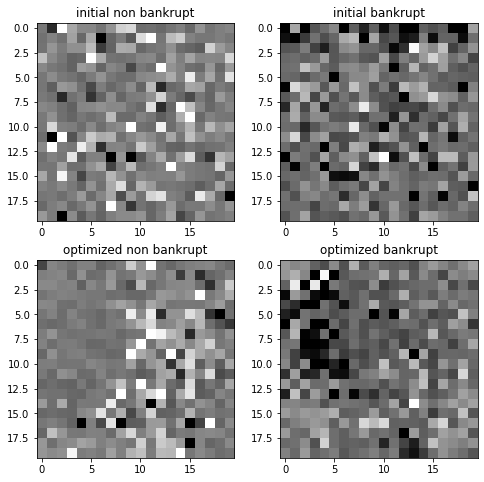


			-----FOLD 3 -----


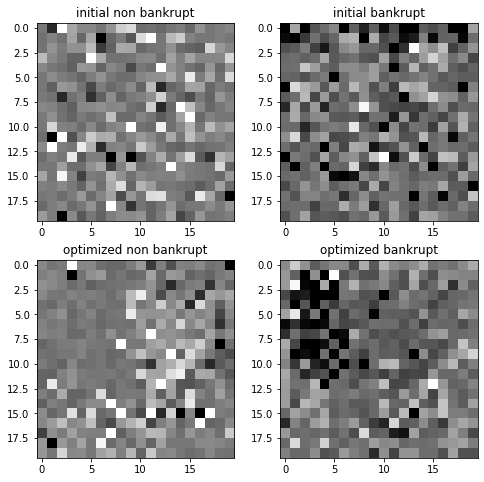


			-----FOLD 4 -----


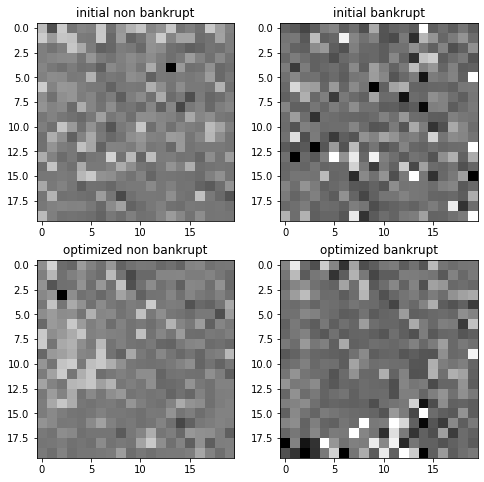


			-----FOLD 5 -----


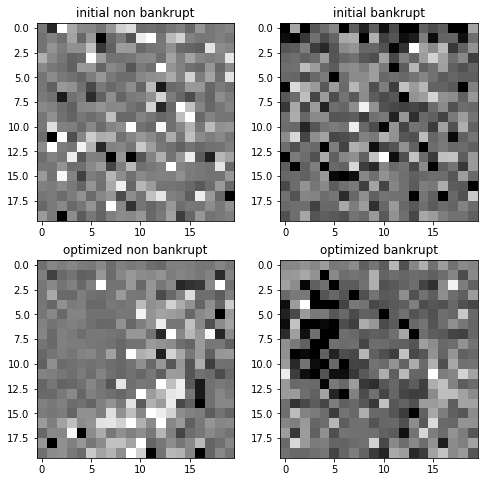


			-----FOLD 6 -----


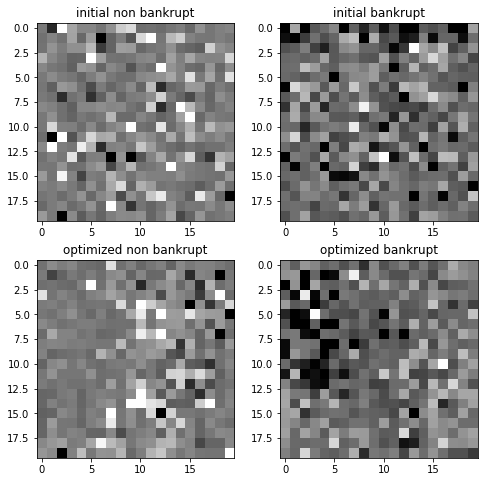

In [48]:
# printing images for normalization and quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t Normalization andquantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


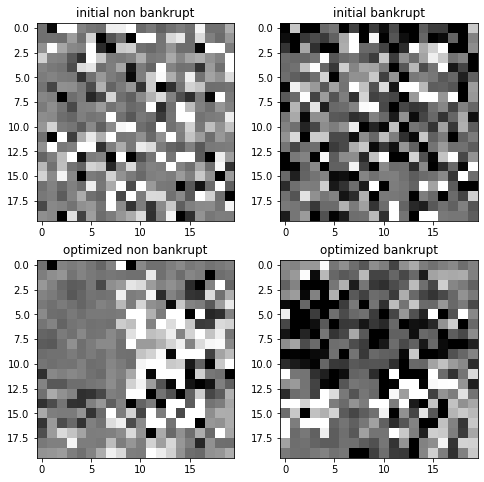


			-----FOLD 2 -----


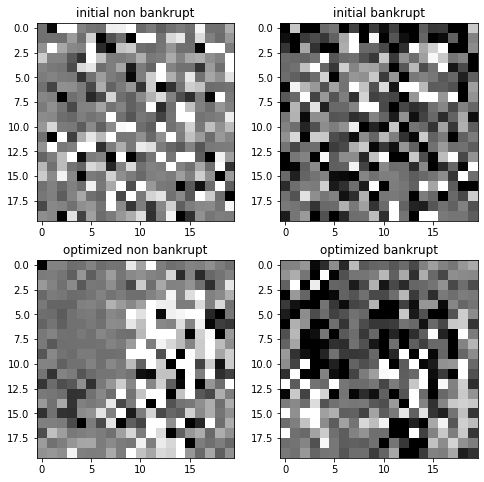


			-----FOLD 3 -----


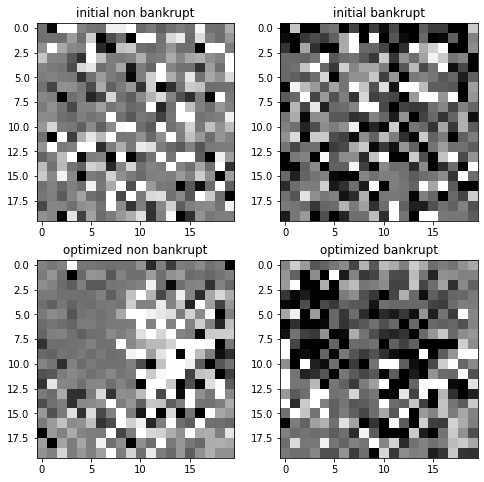


			-----FOLD 4 -----


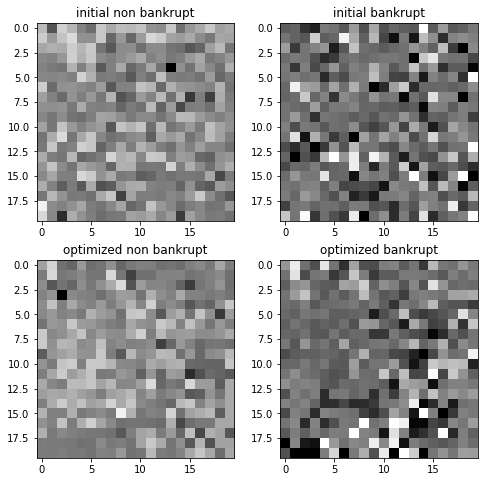


			-----FOLD 5 -----


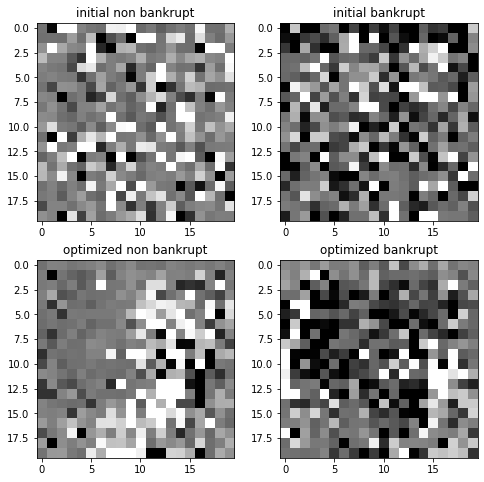


			-----FOLD 6 -----


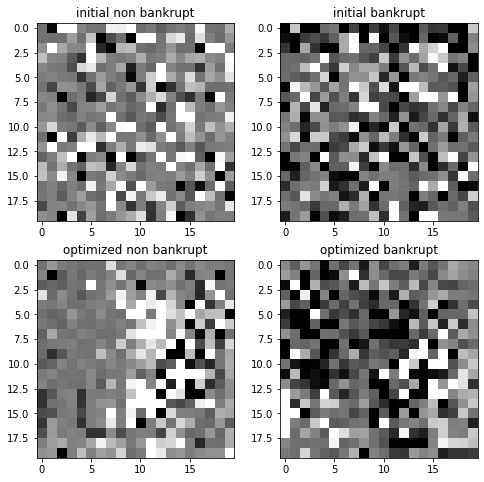

In [49]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

lets begin with the best 8x8 input model on 20x20 data
 - 300 epochs


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7343 samples, validate on 1469 samples
Epoch: 1/300,
cumulative time: 10.42s train loss: 0.2837171378503228, validation loss: 0.23344254590078956
Epoch: 2/300,
cumulative time: 17.45s train loss: 0.22544733298647945, validation loss: 0.21424210493543508
Epoch: 3/300,
cumulative time: 24.22s train loss: 0.21681259087705815, validation loss: 0.21326294641782023
Epoch: 4/300,
cumulative time: 30.94s train loss: 0.21249889970905333, validation loss: 0.2054915546640561
Epoch: 5/300,
cumulative time: 37.64s train loss: 0.20570400124485513, validation loss: 0.2025316353352237
Epoch: 6/300,
cumulative time: 44.35s train loss: 0.20200099386442233, validation loss: 0.20040206591883347
Epoch: 7/300,
cumulative time: 51.2s train loss: 0.20117309221361926, validation loss: 0.19911503425619892
Epoch: 8/300,
cumulative time: 57.98s train loss: 0.1971985829569705, validation loss: 0.19670593522494143
Epoch: 9/300,
cumulative time: 64.73s train loss: 0.19747056312129524, validation loss: 0.196

Epoch: 76/300,
cumulative time: 518.99s train loss: 0.13407679142418502, validation loss: 0.1665708709931682
Epoch: 77/300,
cumulative time: 525.72s train loss: 0.13699121023010172, validation loss: 0.15814422774955966
Epoch: 78/300,
cumulative time: 532.59s train loss: 0.13176953969527117, validation loss: 0.15713552540260728
Epoch: 79/300,
cumulative time: 539.36s train loss: 0.13116252033518588, validation loss: 0.1615233203640919
Epoch: 80/300,
cumulative time: 546.23s train loss: 0.12979183877405703, validation loss: 0.1591240995347378
Epoch: 81/300,
cumulative time: 553.03s train loss: 0.12738321360338128, validation loss: 0.15523485022795452
Epoch: 82/300,
cumulative time: 559.77s train loss: 0.12910606951053147, validation loss: 0.157806210620538
Epoch: 83/300,
cumulative time: 566.47s train loss: 0.1269762656692911, validation loss: 0.15524619319675892
Epoch: 84/300,
cumulative time: 573.22s train loss: 0.12855903444709982, validation loss: 0.16593487242235466
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1028.24s train loss: 0.07558011112425968, validation loss: 0.20300953078018394
Epoch: 152/300,
cumulative time: 1034.94s train loss: 0.07023095262321744, validation loss: 0.22628585291282102
Epoch: 153/300,
cumulative time: 1041.67s train loss: 0.07282047497772413, validation loss: 0.20115714898070483
Epoch: 154/300,
cumulative time: 1048.4s train loss: 0.07207736728684253, validation loss: 0.19328008775730535
Epoch: 155/300,
cumulative time: 1055.21s train loss: 0.07277777245496268, validation loss: 0.19862846295755685
Epoch: 156/300,
cumulative time: 1061.97s train loss: 0.07286687786030734, validation loss: 0.19026294938961286
Epoch: 157/300,
cumulative time: 1068.69s train loss: 0.06946488915676644, validation loss: 0.21261020228926059
Epoch: 158/300,
cumulative time: 1075.37s train loss: 0.06625145095806753, validation loss: 0.21970807726972358
Epoch: 159/300,
cumulative time: 1082.16s train loss: 0.06778329742120394, validation loss: 0.20823365093

Epoch: 225/300,
cumulative time: 1529.87s train loss: 0.04259049734342947, validation loss: 0.31203174660041916
Epoch: 226/300,
cumulative time: 1536.55s train loss: 0.044411712360734365, validation loss: 0.31620626680050845
Epoch: 227/300,
cumulative time: 1543.3s train loss: 0.045780263670183535, validation loss: 0.2947646018556383
Epoch: 228/300,
cumulative time: 1550.19s train loss: 0.04493531859253451, validation loss: 0.31009319016850667
Epoch: 229/300,
cumulative time: 1556.93s train loss: 0.04420324451851046, validation loss: 0.3213111193631278
Epoch: 230/300,
cumulative time: 1563.64s train loss: 0.03909542505725372, validation loss: 0.33116293320694773
Epoch: 231/300,
cumulative time: 1570.4s train loss: 0.03958283922272662, validation loss: 0.33898521839071083
Epoch: 232/300,
cumulative time: 1577.26s train loss: 0.04398865099926825, validation loss: 0.33554245723275766
Epoch: 233/300,
cumulative time: 1584.04s train loss: 0.043123275517958734, validation loss: 0.32337296197

Epoch: 299/300,
cumulative time: 2031.82s train loss: 0.03539748405310945, validation loss: 0.3911212191360998
Epoch: 300/300,
cumulative time: 2038.56s train loss: 0.038120846868162014, validation loss: 0.3754521681793374

Early stopping results:
best results in epoch: 108, 
best valid PR: 0.4423245542769906, 
valid ROC: 0.87668868487834        
overfitting PR: 0.35878598943314355, 
overfitting ROC: 0.09685866482945049

----------
Fold: 2
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7343 samples, validate on 1469 samples
Epoch: 1/300,
cumulative time: 9.66s train loss: 0.2704552881369941, validation loss: 0.22980694386567932
Epoch: 2/300,
cumulative time: 16.58s train loss: 0.22310244107455823, validation loss: 0.21883624020160017
Epoch: 3/300,
cumulative time: 23.57s train loss: 0.21715507564915795, validation loss: 0.21087601466435327
Epoch: 4/300,
cumulative time: 30.31s train loss: 0.20841860148792418, validation loss: 0.2060971448237268
Epoch: 5/300,
cumulative time: 37.12s train loss: 0.203248212634746, validation loss: 0.2003269185514333
Epoch: 6/300,
cumulative time: 43.85s train loss: 0.2025278918541502, validation loss: 0.20065470789467257
Epoch: 7/300,
cumulative time: 50.68s train loss: 0.20094448064614848, validation loss: 0.2000710498807867
Epoch: 8/300,
cumulative time: 57.67s train loss: 0.19684304910428221, validation loss: 0.19849742810039636
Epoch: 9/300,
cumulative time: 65.07s train loss: 0.19696542006389298, validation loss: 0.196536

Epoch: 76/300,
cumulative time: 519.01s train loss: 0.13729458839111167, validation loss: 0.19016081859580183
Epoch: 77/300,
cumulative time: 525.88s train loss: 0.1345561066954155, validation loss: 0.17965724968926447
Epoch: 78/300,
cumulative time: 532.54s train loss: 0.13274168934311348, validation loss: 0.18729510926689072
Epoch: 79/300,
cumulative time: 539.23s train loss: 0.13053349891849228, validation loss: 0.1792202404642527
Epoch: 80/300,
cumulative time: 545.95s train loss: 0.1320354741583659, validation loss: 0.17833281253129143
Epoch: 81/300,
cumulative time: 552.68s train loss: 0.12741950277077246, validation loss: 0.17445223664369122
Epoch: 82/300,
cumulative time: 559.4s train loss: 0.1283186790153504, validation loss: 0.1733548484483976
Epoch: 83/300,
cumulative time: 566.11s train loss: 0.12677137478201847, validation loss: 0.17987524516692852
Epoch: 84/300,
cumulative time: 572.86s train loss: 0.12966236038569548, validation loss: 0.18223328894502538
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1021.14s train loss: 0.07009036872187412, validation loss: 0.23784794703562134
Epoch: 152/300,
cumulative time: 1027.61s train loss: 0.07235422837643715, validation loss: 0.24541838489437362
Epoch: 153/300,
cumulative time: 1034.05s train loss: 0.07075684717558928, validation loss: 0.23925720939350584
Epoch: 154/300,
cumulative time: 1040.53s train loss: 0.0700075735493908, validation loss: 0.23491730728142923
Epoch: 155/300,
cumulative time: 1046.97s train loss: 0.07229781237976372, validation loss: 0.23039124763036278
Epoch: 156/300,
cumulative time: 1053.5s train loss: 0.07064015486780019, validation loss: 0.2289407763698622
Epoch: 157/300,
cumulative time: 1060.01s train loss: 0.06892014751100466, validation loss: 0.23218630941000173
Epoch: 158/300,
cumulative time: 1066.53s train loss: 0.06851055292278452, validation loss: 0.22903845182805746
Epoch: 159/300,
cumulative time: 1073.06s train loss: 0.07070643843299895, validation loss: 0.2299378485785

Epoch: 225/300,
cumulative time: 1513.24s train loss: 0.04134054452659778, validation loss: 0.37356460686846604
Epoch: 226/300,
cumulative time: 1519.8s train loss: 0.037964877589926255, validation loss: 0.3869579933669958
Epoch: 227/300,
cumulative time: 1526.31s train loss: 0.041838371963623874, validation loss: 0.36837164951149826
Epoch: 228/300,
cumulative time: 1532.93s train loss: 0.039766885369131325, validation loss: 0.34044287020532027
Epoch: 229/300,
cumulative time: 1539.46s train loss: 0.044851301428948796, validation loss: 0.32385158948625653
Epoch: 230/300,
cumulative time: 1546.09s train loss: 0.048082749876147406, validation loss: 0.3353064420314124
Epoch: 231/300,
cumulative time: 1552.65s train loss: 0.044255277440996985, validation loss: 0.3432554236636671
Epoch: 232/300,
cumulative time: 1559.17s train loss: 0.04750527580001447, validation loss: 0.3542752018625676
Epoch: 233/300,
cumulative time: 1565.79s train loss: 0.04488468152815488, validation loss: 0.375506278

Epoch: 299/300,
cumulative time: 2015.19s train loss: 0.03661300337780939, validation loss: 0.4254992761280847
Epoch: 300/300,
cumulative time: 2022.29s train loss: 0.035643927506411516, validation loss: 0.4477491102671445

Early stopping results:
best results in epoch: 173, 
best valid PR: 0.42946892884186505, 
valid ROC: 0.8131904015524705        
overfitting PR: 0.5435089495851924, 
overfitting ROC: 0.1848545838910497

----------
Fold: 3
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7343 samples, validate on 1469 samples
Epoch: 1/300,
cumulative time: 9.61s train loss: 0.27675628889999937, validation loss: 0.22842728755886332
Epoch: 2/300,
cumulative time: 16.32s train loss: 0.22289636133721394, validation loss: 0.21540785067092813
Epoch: 3/300,
cumulative time: 23.11s train loss: 0.21544255911451618, validation loss: 0.21039241330204894
Epoch: 4/300,
cumulative time: 29.9s train loss: 0.20949737720336573, validation loss: 0.20596296296101838
Epoch: 5/300,
cumulative time: 36.68s train loss: 0.20530042157386802, validation loss: 0.2016012461880099
Epoch: 6/300,
cumulative time: 43.38s train loss: 0.20082802842248773, validation loss: 0.2005536932171081
Epoch: 7/300,
cumulative time: 50.19s train loss: 0.19926550346776087, validation loss: 0.20015382855988587
Epoch: 8/300,
cumulative time: 56.96s train loss: 0.19501027749983504, validation loss: 0.1999480577148979
Epoch: 9/300,
cumulative time: 63.68s train loss: 0.19629024266060247, validation loss: 0.199

Epoch: 76/300,
cumulative time: 528.2s train loss: 0.13667961875927737, validation loss: 0.19870481649737037
Epoch: 77/300,
cumulative time: 534.96s train loss: 0.13689907498776419, validation loss: 0.19570888145753848
Epoch: 78/300,
cumulative time: 541.69s train loss: 0.13603130368718525, validation loss: 0.1897492960470724
Epoch: 79/300,
cumulative time: 548.45s train loss: 0.13404301749487818, validation loss: 0.19172592760349635
Epoch: 80/300,
cumulative time: 555.18s train loss: 0.13256535854027737, validation loss: 0.19443646212310675
Epoch: 81/300,
cumulative time: 562.12s train loss: 0.13074781538176145, validation loss: 0.1948310072585139
Epoch: 82/300,
cumulative time: 568.99s train loss: 0.13103742801930426, validation loss: 0.1997031563597524
Epoch: 83/300,
cumulative time: 575.77s train loss: 0.13155326178219018, validation loss: 0.19124522077907422
Epoch: 84/300,
cumulative time: 582.58s train loss: 0.1308035625962394, validation loss: 0.19633712378629134
Epoch: 85/300,


Epoch: 151/300,
cumulative time: 1039.38s train loss: 0.07832732854808495, validation loss: 0.21244972410698665
Epoch: 152/300,
cumulative time: 1046.33s train loss: 0.08070976320812946, validation loss: 0.2160914091734435
Epoch: 153/300,
cumulative time: 1053.43s train loss: 0.07946484109373357, validation loss: 0.22325702396033165
Epoch: 154/300,
cumulative time: 1060.58s train loss: 0.07928136584514998, validation loss: 0.22550314735846913
Epoch: 155/300,
cumulative time: 1067.38s train loss: 0.07154652036053762, validation loss: 0.2378451298539374
Epoch: 156/300,
cumulative time: 1074.27s train loss: 0.07329363407559279, validation loss: 0.23490264210431572
Epoch: 157/300,
cumulative time: 1081.61s train loss: 0.07412715984023138, validation loss: 0.22356428535638656
Epoch: 158/300,
cumulative time: 1088.42s train loss: 0.07560622078802497, validation loss: 0.24223207630130852
Epoch: 159/300,
cumulative time: 1095.17s train loss: 0.07570970652620652, validation loss: 0.238604171147

Epoch: 225/300,
cumulative time: 1547.95s train loss: 0.050198611235275234, validation loss: 0.3364893085214863
Epoch: 226/300,
cumulative time: 1554.73s train loss: 0.04925729798252732, validation loss: 0.32019436426354236
Epoch: 227/300,
cumulative time: 1561.93s train loss: 0.04994089267950089, validation loss: 0.321966166192776
Epoch: 228/300,
cumulative time: 1568.89s train loss: 0.04721832718691546, validation loss: 0.35386296609699364
Epoch: 229/300,
cumulative time: 1575.58s train loss: 0.05003467609923996, validation loss: 0.34631573113151926
Epoch: 230/300,
cumulative time: 1582.28s train loss: 0.04799639085444949, validation loss: 0.3368879240779669
Epoch: 231/300,
cumulative time: 1589.02s train loss: 0.04586347544761878, validation loss: 0.3330139946864526
Epoch: 232/300,
cumulative time: 1595.84s train loss: 0.04750003358905994, validation loss: 0.37479608770208833
Epoch: 233/300,
cumulative time: 1602.57s train loss: 0.050971022296058176, validation loss: 0.3635699983313

Epoch: 299/300,
cumulative time: 2049.72s train loss: 0.039819025572165635, validation loss: 0.48666003117194545
Epoch: 300/300,
cumulative time: 2056.58s train loss: 0.03489841482889079, validation loss: 0.5015178768305327

Early stopping results:
best results in epoch: 189, 
best valid PR: 0.4225728130908553, 
valid ROC: 0.8118609120764293        
overfitting PR: 0.5520502697264562, 
overfitting ROC: 0.1861250505466715

----------
Fold: 4
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7343 samples, validate on 1469 samples
Epoch: 1/300,
cumulative time: 9.79s train loss: 0.27305281759891264, validation loss: 0.22864314893462206
Epoch: 2/300,
cumulative time: 17.07s train loss: 0.2249151812060951, validation loss: 0.21511564493544497
Epoch: 3/300,
cumulative time: 24.19s train loss: 0.2143064442604484, validation loss: 0.2102564170581293
Epoch: 4/300,
cumulative time: 31.52s train loss: 0.21073821118023095, validation loss: 0.2032566814600326
Epoch: 5/300,
cumulative time: 38.53s train loss: 0.2058345245682672, validation loss: 0.19712774019366303
Epoch: 6/300,
cumulative time: 45.75s train loss: 0.20221419871892427, validation loss: 0.1954798991985269
Epoch: 7/300,
cumulative time: 53.59s train loss: 0.20017674881480427, validation loss: 0.19448707053416273
Epoch: 8/300,
cumulative time: 61.05s train loss: 0.1988221656906009, validation loss: 0.19625362118869674
Epoch: 9/300,
cumulative time: 68.07s train loss: 0.19784645634143633, validation loss: 0.191720

Epoch: 76/300,
cumulative time: 533.89s train loss: 0.145051882829683, validation loss: 0.16716405939009013
Epoch: 77/300,
cumulative time: 541.26s train loss: 0.14368850199740832, validation loss: 0.1658207424203095
Epoch: 78/300,
cumulative time: 548.16s train loss: 0.14262824480302747, validation loss: 0.16881309887882476
Epoch: 79/300,
cumulative time: 554.97s train loss: 0.1418621892112811, validation loss: 0.18144333792674128
Epoch: 80/300,
cumulative time: 561.83s train loss: 0.1403417313588375, validation loss: 0.16454982697720263
Epoch: 81/300,
cumulative time: 568.6s train loss: 0.13785985159878833, validation loss: 0.17102899617934567
Epoch: 82/300,
cumulative time: 575.36s train loss: 0.13726414255691324, validation loss: 0.16211848381914357
Epoch: 83/300,
cumulative time: 582.15s train loss: 0.13942521790340065, validation loss: 0.16543681927689732
Epoch: 84/300,
cumulative time: 588.94s train loss: 0.1355009230842273, validation loss: 0.1734997018958696
Epoch: 85/300,
cum

Epoch: 151/300,
cumulative time: 1047.89s train loss: 0.0932728731965444, validation loss: 0.18678639433552732
Epoch: 152/300,
cumulative time: 1054.61s train loss: 0.09062347858718058, validation loss: 0.19574508852014094
Epoch: 153/300,
cumulative time: 1061.26s train loss: 0.08893120442264073, validation loss: 0.16937741586511196
Epoch: 154/300,
cumulative time: 1067.99s train loss: 0.08738296264996893, validation loss: 0.17516424109775083
Epoch: 155/300,
cumulative time: 1075.76s train loss: 0.086355569377089, validation loss: 0.17430654443024454
Epoch: 156/300,
cumulative time: 1082.56s train loss: 0.08478309118940901, validation loss: 0.17764440724604627
Epoch: 157/300,
cumulative time: 1089.25s train loss: 0.0828177070352446, validation loss: 0.1937783671387042
Epoch: 158/300,
cumulative time: 1096.05s train loss: 0.08919990741007662, validation loss: 0.17169624061873368
Epoch: 159/300,
cumulative time: 1103.43s train loss: 0.08467920315082207, validation loss: 0.179347619241885

Epoch: 225/300,
cumulative time: 1554.24s train loss: 0.05678677941371533, validation loss: 0.22615274676382338
Epoch: 226/300,
cumulative time: 1560.94s train loss: 0.05388666253501934, validation loss: 0.23940280337492734
Epoch: 227/300,
cumulative time: 1567.66s train loss: 0.05418357695969707, validation loss: 0.23351627805348235
Epoch: 228/300,
cumulative time: 1574.5s train loss: 0.05537188570602996, validation loss: 0.23345177181932372
Epoch: 229/300,
cumulative time: 1581.35s train loss: 0.05494000443796298, validation loss: 0.2530467835939036
Epoch: 230/300,
cumulative time: 1588.15s train loss: 0.05685425709451591, validation loss: 0.2777697214916338
Epoch: 231/300,
cumulative time: 1594.97s train loss: 0.05628275181517263, validation loss: 0.24390572507297043
Epoch: 232/300,
cumulative time: 1601.72s train loss: 0.05760207730096204, validation loss: 0.23073260121965505
Epoch: 233/300,
cumulative time: 1608.53s train loss: 0.0579806927312026, validation loss: 0.26562621029077

Epoch: 299/300,
cumulative time: 2059.81s train loss: 0.041145382203231724, validation loss: 0.3581667931571633
Epoch: 300/300,
cumulative time: 2066.75s train loss: 0.04088505716284403, validation loss: 0.37225992798074886

Early stopping results:
best results in epoch: 181, 
best valid PR: 0.46707947925897064, 
valid ROC: 0.866840863426054        
overfitting PR: 0.47502552851898405, 
overfitting ROC: 0.12888562910986645

----------
Fold: 5
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7344 samples, validate on 1468 samples
Epoch: 1/300,
cumulative time: 10.12s train loss: 0.27919644625017453, validation loss: 0.22940695699943833
Epoch: 2/300,
cumulative time: 16.84s train loss: 0.22451403260653055, validation loss: 0.21297785337273367
Epoch: 3/300,
cumulative time: 23.45s train loss: 0.21683831850152, validation loss: 0.2072905126035376
Epoch: 4/300,
cumulative time: 30.08s train loss: 0.21049082812433148, validation loss: 0.2031286978835306
Epoch: 5/300,
cumulative time: 36.72s train loss: 0.20766438206166743, validation loss: 0.1938415712369885
Epoch: 6/300,
cumulative time: 43.35s train loss: 0.20715946190805867, validation loss: 0.18922359212136725
Epoch: 7/300,
cumulative time: 50.22s train loss: 0.20313388272746585, validation loss: 0.18813700604503747
Epoch: 8/300,
cumulative time: 57.25s train loss: 0.1988644866731367, validation loss: 0.1870754007909863
Epoch: 9/300,
cumulative time: 64.46s train loss: 0.19766139315769954, validation loss: 0.187735

Epoch: 76/300,
cumulative time: 515.27s train loss: 0.15360101377327717, validation loss: 0.16592647646850722
Epoch: 77/300,
cumulative time: 521.85s train loss: 0.1487499106095085, validation loss: 0.1602390996644867
Epoch: 78/300,
cumulative time: 528.48s train loss: 0.14515076184235431, validation loss: 0.16053597673733164
Epoch: 79/300,
cumulative time: 535.13s train loss: 0.1480286217422462, validation loss: 0.1620196673704428
Epoch: 80/300,
cumulative time: 541.75s train loss: 0.14584154349981052, validation loss: 0.15969113642172203
Epoch: 81/300,
cumulative time: 548.52s train loss: 0.14123999692442826, validation loss: 0.1574428240877731
Epoch: 82/300,
cumulative time: 555.17s train loss: 0.13962585669343638, validation loss: 0.16179740629907524
Epoch: 83/300,
cumulative time: 561.81s train loss: 0.14119047285432973, validation loss: 0.1618586309680497
Epoch: 84/300,
cumulative time: 568.51s train loss: 0.14079612344178757, validation loss: 0.1595331559145483
Epoch: 85/300,
cu

Epoch: 151/300,
cumulative time: 1003.93s train loss: 0.08723713375611762, validation loss: 0.2073799999435851
Epoch: 152/300,
cumulative time: 1010.34s train loss: 0.08565342443242409, validation loss: 0.19300055511965739
Epoch: 153/300,
cumulative time: 1016.86s train loss: 0.08338555704380238, validation loss: 0.20262289473568712
Epoch: 154/300,
cumulative time: 1023.28s train loss: 0.0822885517732997, validation loss: 0.20152485005212414
Epoch: 155/300,
cumulative time: 1030.22s train loss: 0.08403336939915268, validation loss: 0.2117008020954171
Epoch: 156/300,
cumulative time: 1037.21s train loss: 0.08457355514525848, validation loss: 0.19451721274479208
Epoch: 157/300,
cumulative time: 1043.76s train loss: 0.07828055766019523, validation loss: 0.19706232045911637
Epoch: 158/300,
cumulative time: 1050.21s train loss: 0.08184222509974942, validation loss: 0.1931012689011623
Epoch: 159/300,
cumulative time: 1057.17s train loss: 0.08271412764755047, validation loss: 0.19862215813726

Epoch: 225/300,
cumulative time: 1484.88s train loss: 0.056303499899561106, validation loss: 0.2779762861230068
Epoch: 226/300,
cumulative time: 1491.31s train loss: 0.053860835600157385, validation loss: 0.3082846304051558
Epoch: 227/300,
cumulative time: 1497.75s train loss: 0.05514151288484566, validation loss: 0.2874273813306798
Epoch: 228/300,
cumulative time: 1504.17s train loss: 0.05586629171098921, validation loss: 0.29045218994653194
Epoch: 229/300,
cumulative time: 1510.57s train loss: 0.05626781568872643, validation loss: 0.28082964183605336
Epoch: 230/300,
cumulative time: 1516.97s train loss: 0.05136855904921922, validation loss: 0.3124765307117223
Epoch: 231/300,
cumulative time: 1523.38s train loss: 0.05064012145233992, validation loss: 0.3168067458296342
Epoch: 232/300,
cumulative time: 1529.79s train loss: 0.05070025353511889, validation loss: 0.31729838120109055
Epoch: 233/300,
cumulative time: 1536.35s train loss: 0.0512040275116583, validation loss: 0.29352639241991

Epoch: 299/300,
cumulative time: 1962.51s train loss: 0.045260945613514264, validation loss: 0.4224675147913457
Epoch: 300/300,
cumulative time: 1968.93s train loss: 0.04527886457587055, validation loss: 0.4559751597184901

Early stopping results:
best results in epoch: 140, 
best valid PR: 0.5085246696355462, 
valid ROC: 0.8489501153052554        
overfitting PR: 0.33941646305299467, 
overfitting ROC: 0.13347292031780944

----------
Fold: 6
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7344 samples, validate on 1468 samples
Epoch: 1/300,
cumulative time: 8.91s train loss: 0.282398881244601, validation loss: 0.23023195473390964
Epoch: 2/300,
cumulative time: 15.39s train loss: 0.2227261930314544, validation loss: 0.21534040351004952
Epoch: 3/300,
cumulative time: 21.77s train loss: 0.21498520385822958, validation loss: 0.21084086519820813
Epoch: 4/300,
cumulative time: 28.68s train loss: 0.2068104836359328, validation loss: 0.2048389806490828
Epoch: 5/300,
cumulative time: 35.36s train loss: 0.2050764884471017, validation loss: 0.20078406036306143
Epoch: 6/300,
cumulative time: 41.79s train loss: 0.2012657281660631, validation loss: 0.19787624754437957
Epoch: 7/300,
cumulative time: 48.21s train loss: 0.19934427491054427, validation loss: 0.19861969845090316
Epoch: 8/300,
cumulative time: 54.71s train loss: 0.19744940055432791, validation loss: 0.20035353229870914
Epoch: 9/300,
cumulative time: 61.21s train loss: 0.19719069080999474, validation loss: 0.195401

Epoch: 76/300,
cumulative time: 498.17s train loss: 0.14168953867974104, validation loss: 0.16661023322178167
Epoch: 77/300,
cumulative time: 504.65s train loss: 0.1407957575963668, validation loss: 0.18216625036676834
Epoch: 78/300,
cumulative time: 511.24s train loss: 0.14113513699454744, validation loss: 0.1666893248905603
Epoch: 79/300,
cumulative time: 518.42s train loss: 0.14250265640127502, validation loss: 0.163592088429577
Epoch: 80/300,
cumulative time: 524.93s train loss: 0.14303071485844507, validation loss: 0.16321482273879429
Epoch: 81/300,
cumulative time: 531.38s train loss: 0.1362799416704018, validation loss: 0.16441186797635107
Epoch: 82/300,
cumulative time: 537.83s train loss: 0.13349790756909222, validation loss: 0.16488567258584078
Epoch: 83/300,
cumulative time: 544.26s train loss: 0.13600662864809593, validation loss: 0.17296653896651412
Epoch: 84/300,
cumulative time: 550.71s train loss: 0.1353170739198692, validation loss: 0.16505403861362863
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 991.78s train loss: 0.07883887590986549, validation loss: 0.19403497149980037
Epoch: 152/300,
cumulative time: 998.28s train loss: 0.0785614075220326, validation loss: 0.2009422542776009
Epoch: 153/300,
cumulative time: 1004.87s train loss: 0.07844128158280306, validation loss: 0.1921534163709882
Epoch: 154/300,
cumulative time: 1011.78s train loss: 0.08075955697824298, validation loss: 0.19960056141790317
Epoch: 155/300,
cumulative time: 1018.16s train loss: 0.0772784931122575, validation loss: 0.19651162620298868
Epoch: 156/300,
cumulative time: 1024.65s train loss: 0.07780690931295063, validation loss: 0.2180939146827612
Epoch: 157/300,
cumulative time: 1031.22s train loss: 0.08005409131804582, validation loss: 0.21974252913482184
Epoch: 158/300,
cumulative time: 1037.62s train loss: 0.07514348855315178, validation loss: 0.20178232831266335
Epoch: 159/300,
cumulative time: 1044.07s train loss: 0.07479449770005506, validation loss: 0.19247098514754377

Epoch: 225/300,
cumulative time: 1471.73s train loss: 0.04967991917237867, validation loss: 0.2991458240703601
Epoch: 226/300,
cumulative time: 1478.31s train loss: 0.04725409950858108, validation loss: 0.3368743361057637
Epoch: 227/300,
cumulative time: 1484.8s train loss: 0.04925808492410839, validation loss: 0.34088500008514855
Epoch: 228/300,
cumulative time: 1491.26s train loss: 0.04563385396303045, validation loss: 0.335750007621274
Epoch: 229/300,
cumulative time: 1497.72s train loss: 0.044707751563042075, validation loss: 0.3382105547173471
Epoch: 230/300,
cumulative time: 1504.19s train loss: 0.04342763094446563, validation loss: 0.3342573446823076
Epoch: 231/300,
cumulative time: 1510.66s train loss: 0.042380976159945294, validation loss: 0.357188001498377
Epoch: 232/300,
cumulative time: 1517.19s train loss: 0.04106672903957061, validation loss: 0.32494646925935955
Epoch: 233/300,
cumulative time: 1523.7s train loss: 0.041349049290329676, validation loss: 0.3507623796932379


Epoch: 299/300,
cumulative time: 1950.82s train loss: 0.04412836083139989, validation loss: 0.44506301160404405
Epoch: 300/300,
cumulative time: 1957.32s train loss: 0.047726515814974446, validation loss: 0.41362105626663653

Early stopping results:
best results in epoch: 139, 
best valid PR: 0.46611490064271816, 
valid ROC: 0.8577777362824093        
overfitting PR: 0.4188631302075106, 
overfitting ROC: 0.13000871596177377

Cross validation time: 12381s
ROC: 		0.8458847855868266
PR: 		0.4560142242911576
overfittingROC: 0.14336759410943678
overfittingPR:  0.44794172175404695
early stopping: [108, 173, 189, 181, 140, 139]

Fold 1------------------------------------------------------------


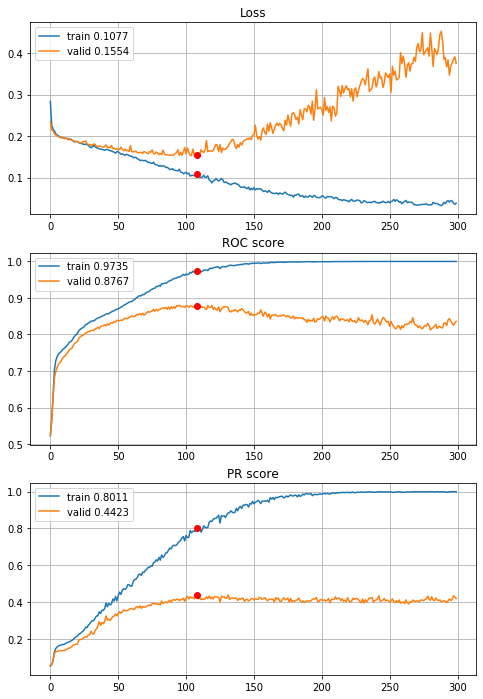


Fold 2------------------------------------------------------------


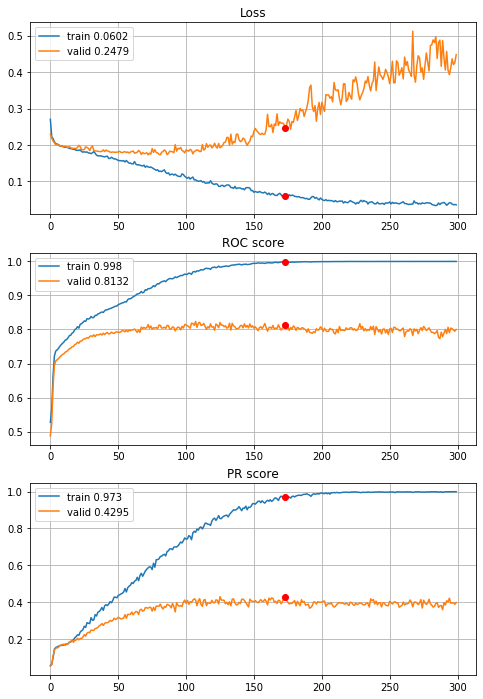


Fold 3------------------------------------------------------------


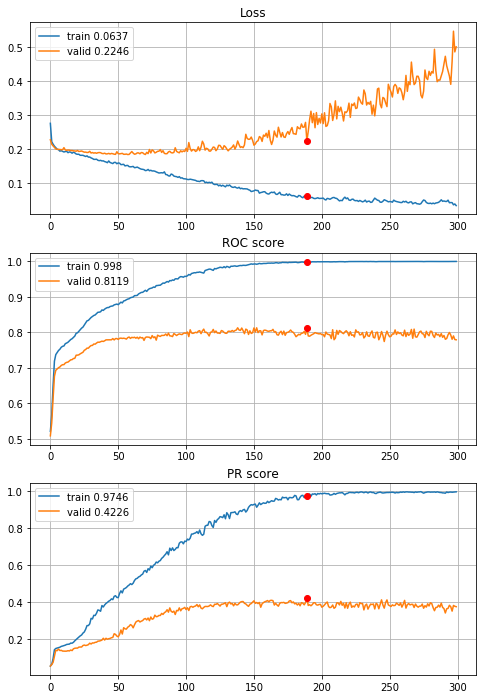


Fold 4------------------------------------------------------------


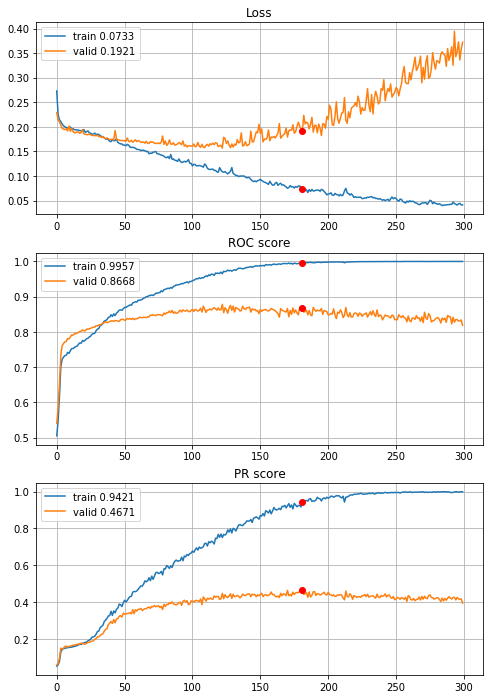


Fold 5------------------------------------------------------------


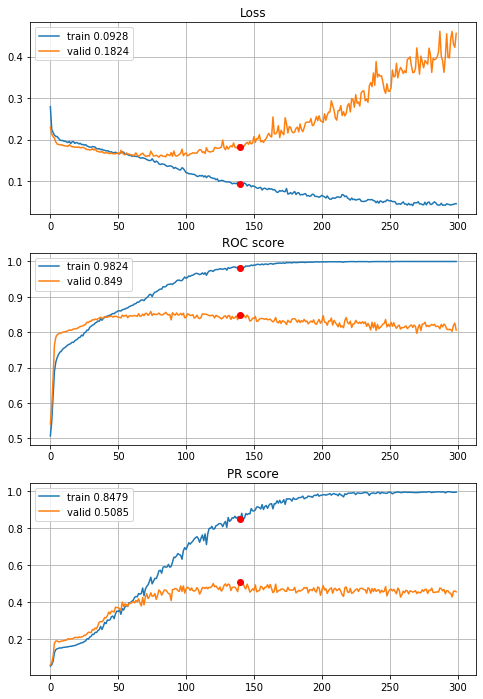


Fold 6------------------------------------------------------------


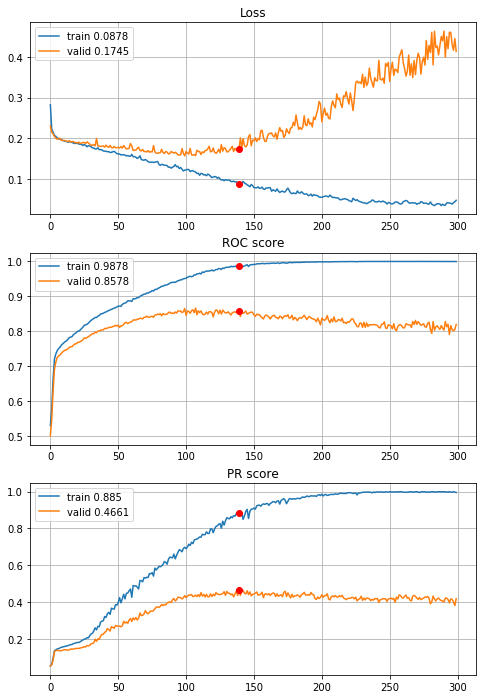

In [77]:
# the best model for 8x8 
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04,
                                        features=features, target=target, n_epochs=300, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\4year\define_deep_CNN_2inc_std_L2_drop_04_300ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Very nice and smooth learning curves. Models are pretty stable in terms of folds variance. What is more early stopping epochs variance is small too. And results are much better than 8x8 input model, there is no need to look for different architecture. Good model. Epochs median is 157 (rounded 156.5)

##### models cross validation results comparison

 - CV results

In [50]:
# LOADING 8x8 CNN
with open(r"results\4year\define_deep_CNN_2inc_std_L2_drop_04_400ep.p", "rb") as fp:
    CNN_8x8_CV = pickle.load(fp)

# LOADING 20x20 CNN
with open(r"results\4year\define_deep_CNN_2inc_std_L2_drop_04_300ep_20x20.p", "rb") as fp:
    CNN_20x20_CV = pickle.load(fp)

# LOADING MLP
with open(r"results\4year\MLP_L1_4000ep.p", "rb") as fp:
    MLP_CV = pickle.load(fp)

# TRAINING XGB
XGB_CV = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                  normalize=False, q=None, n_estimators=1000, early_stopping_rounds=50,
                                  max_depth=7, learning_rate=0.03, subsample=0.8, colsample_bytree=0.9, gamma=5, 
                                  reg_alpha=1, reg_lambda=0.2, saveModels=False)
# TRAINING RF
RF_CV = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                normalize="power", q=None, saveModels=False, max_depth=12, n_estimators=200,
                                max_features=58, min_samples_split=18, min_samples_leaf=17)
# TRAINING LOGIT
logit_CV = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                      normalize="power", q=0.005, alpha=0.08, info=0)


Cross validation time: 63s

Cross validation time: 278s

Cross validation time: 27s


 - CV results extraction

In [51]:
# 8x8 CNN
CNN_8x8_roc_valid, CNN_8x8_pr_valid, CNN_8x8_roc_train, CNN_8x8_pr_train, CNN_8x8_es=network_CV_results(network_history=CNN_8x8_CV,mean=False)
# 20x20 CNN
CNN_20x20_roc_valid, CNN_20x20_pr_valid, CNN_20x20_roc_train, CNN_20x20_pr_train, CNN_20x20_es = network_CV_results(network_history=CNN_20x20_CV,mean=False)
# MLP
MLP_roc_valid, MLP_pr_valid, MLP_roc_train, MLP_pr_train, MLP_es = network_CV_results(network_history=MLP_CV,mean=False)
# XGB
XGB_roc_valid, XGB_pr_valid, XGB_roc_train, XGB_pr_train, XGB_es = XGB_CV_results(XGB_history=XGB_CV,mean=False)

# RF
RF_roc_valid = RF_CV["valid_roc"]
RF_pr_valid = RF_CV["valid_pr"]
RF_roc_train = RF_CV["train_roc"]
RF_pr_train = RF_CV["train_pr"]

# logit
logit_roc_valid = logit_CV["valid_roc"]
logit_pr_valid = logit_CV["valid_pr"]
logit_roc_train = logit_CV["train_roc"]
logit_pr_train = logit_CV["train_pr"]

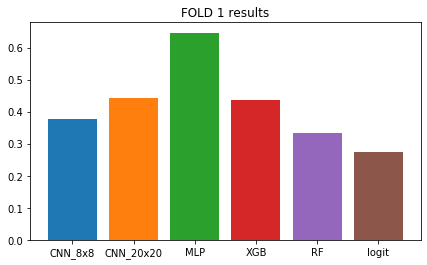

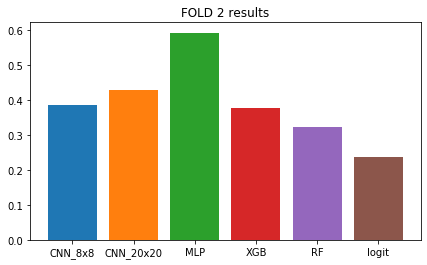

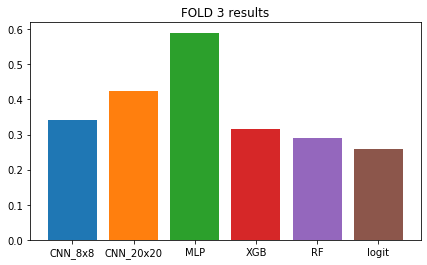

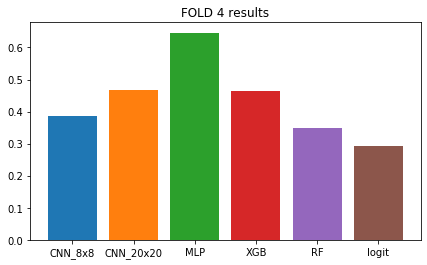

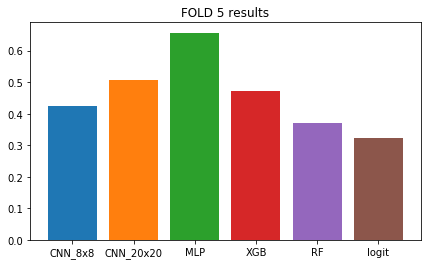

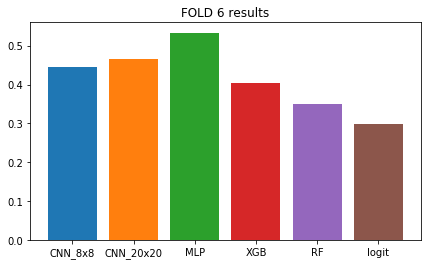

CNN_8x8 mean: 0.39345471119542763
CNN_20x20 mean: 0.4560142242911576
MLP mean: 0.6106813951610192
XGB mean: 0.4112370000000001
RF mean: 0.3369349267997852
Logit mean: 0.2803568632077377


In [52]:
for i in range(len(sets["training_sets"])):
    fig, ax = plt.subplots(figsize=(7,4))
    plt.bar(x="CNN_8x8", height=CNN_8x8_pr_valid[i])
    plt.bar(x="CNN_20x20", height=CNN_20x20_pr_valid[i])
    plt.bar(x="MLP", height=MLP_pr_valid[i])
    plt.bar(x="XGB", height=XGB_pr_valid[i])
    plt.bar(x="RF", height=RF_pr_valid[i])
    plt.bar(x="logit", height=logit_pr_valid[i])
    plt.title("FOLD {} results".format(i+1))
    plt.show()

print("CNN_8x8 mean: {}\nCNN_20x20 mean: {}\nMLP mean: {}\nXGB mean: {}\nRF mean: {}\nLogit mean: {}".format(
np.mean(CNN_8x8_pr_valid), np.mean(CNN_20x20_pr_valid), np.mean(MLP_pr_valid), np.mean(XGB_pr_valid), np.mean(RF_pr_valid),
np.mean(logit_pr_valid)))

 - wilcoxon median equality test

In [53]:
CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid = wilcoxon(
    x=np.array(CNN_20x20_pr_valid), y=np.array(CNN_8x8_pr_valid), alternative="greater")[1]
print("Wilcoxon tests p values, H0: median(A)==median(B)")
print("HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid):", CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid)

Wilcoxon tests p values, H0: median(A)==median(B)
HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid): 0.013853924679039932


C:\Users\maciej\anaconda3\lib\site-packages\scipy\stats\morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


Conclusions: 
 - there is a statistical difference in folds results median between 8x8 and 20x20 CNNs. The second one has the bigger median $\Rightarrow$ it is better model
 
##### "Production" models training
 - data normalization (CNNs excluded)

In [54]:
# loading imputed data
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# ----- Scaling: clipping, power transform and normalization -----
# scaler fitting
Scaler_norm_clip_pt=scaler(images=False)
Scaler_norm_clip_pt.fit(X=train_set_imp[features], q=0.005, power_transform=True)

# sets computing
X_train_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=train_set_imp[features]), columns=features)
X_test_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_clip_pt=train_set_imp[target].copy()
Y_test_norm_clip_pt=test_set_imp[target].copy()

# ----- Scaling: power transfor and normalization -----
# scaler fitting
Scaler_norm_pt=scaler(images=False)
Scaler_norm_pt.fit(X=train_set_imp[features], q=None, power_transform=True)

# sets computing
X_train_norm_pt=pd.DataFrame(Scaler_norm_pt.transform(X=train_set_imp[features]), columns=features)
X_test_norm_pt=pd.DataFrame(Scaler_norm_pt.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_pt=train_set_imp[target].copy()
Y_test_norm_pt=test_set_imp[target].copy()

# ----- Raw data for XGBoost -----
X_train_raw = train_test_imp_sets["train_set_imp"][features].copy()
X_test_raw = train_test_imp_sets["test_set_imp"][features].copy()
Y_train_raw = train_test_imp_sets["train_set_imp"][target].copy()
Y_test_raw = train_test_imp_sets["test_set_imp"][target].copy()

 - models fitting (Neural networks excluded)

In [55]:
# Logistic Regression
Logit_formula = "{}~{}".format(target, "+".join(features))
Logit = smf.logit(formula=Logit_formula, data=pd.concat((X_train_norm_clip_pt,Y_train_norm_clip_pt), axis=1))
Logit = Logit.fit_regularized(method="l1", alpha=0.08, disp=True, random_state=random_state)

# Random Forest
Random_Forest = RandomForestClassifier(n_estimators=200, criterion="gini", max_depth=12, min_samples_split=18,
                                      min_samples_leaf=17, max_features=58, random_state=random_state) 
Random_Forest.fit(X=X_train_norm_pt, y=Y_train_norm_pt)

# Extreme Gradient Boosted Decision Trees
XGBoost, XGBoost_history = XGB_training(X_train=X_train_raw,
                                        Y_train=Y_train_raw,
                                        X_valid=None, Y_valid=None, booster="gbtree", tree_method="auto",
                                        n_estimators=271, max_depth=12, learning_rate=0.03,
                                        subsample=0.8, colsample_bytree=0.9, colsample_bylevel=1,
                                        gamma=5, min_child_weight=0, reg_alpha=1, reg_lambda=0.2,
                                        random_state=random_state, info=0)

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.16404847971089426
            Iterations: 866
            Function evaluations: 867
            Gradient evaluations: 866


 - XGBoost training plots

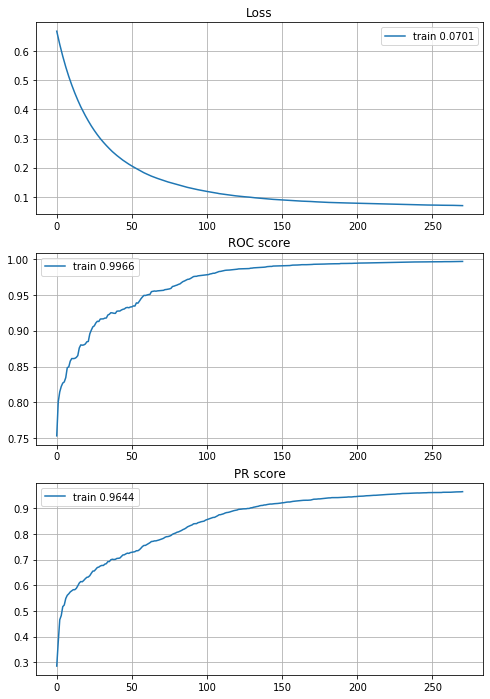

In [75]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(XGBoost_history["train_logloss"], "-", label="train {}".format(round(XGBoost_history["train_logloss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(XGBoost_history["train_auc"], label="train {}".format(round(XGBoost_history["train_auc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(XGBoost_history["train_aucpr"], label="train {}".format(round(XGBoost_history["train_aucpr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - Multilayer Percepton (Feedforward neural network)

In [92]:
# Multilayer Percepton
Multilayer_Percepton = define_MLP(input_shape=X_train_norm_clip_pt.iloc[0].shape, n_layers=2, n_units=[60,60],
                                  acti=[activations.tanh, activations.sigmoid], drop=[0.4,0.4],
                                  regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)], opti=optimizers.Adam(),
                                  random_state=random_state)

Multilayer_Percepton, MLP_history = network_training(network=Multilayer_Percepton,
                                                     X_train=X_train_norm_clip_pt.values, Y_train=Y_train_norm_clip_pt.values, 
                                                     n_epochs=3972, batch_size=394, random_state=random_state, info=None)
# SAVING MLP
with open(r"results\4year\MLP_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [Multilayer_Percepton, MLP_history,
                                                                 Multilayer_Percepton.get_weights()])), fp)

In [56]:
# LOADING MLP
with open(r"results\4year\MLP_production.p", "rb") as fp:
    MLP_dict = pickle.load(fp)

Multilayer_Percepton = MLP_dict["model"]
MLP_history = MLP_dict["history"]   

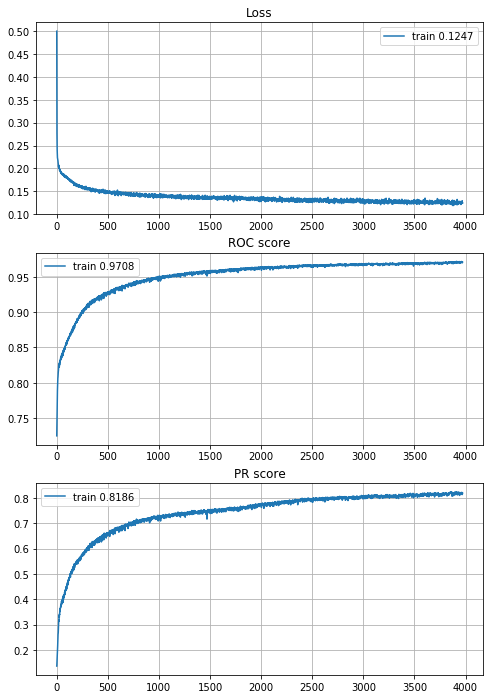

In [77]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(MLP_history["train_loss"], "-", label="train {}".format(round(MLP_history["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(MLP_history["train_roc"], label="train {}".format(round(MLP_history["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(MLP_history["train_pr"], label="train {}".format(round(MLP_history["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 8x8 input Convolutional Neural Network

In [101]:
# ----- IMAGE DRAFT -----
# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_8x8=X_train_CNN_8x8[Y_train_CNN_8x8==0].corr(method="spearman")
# draft inicialization
draft_8x8_ini=image_draft_inicialization(features, random_state)
# quasi optimization
draft_8x8_opt=MC_Energy_optimization(corr_matrix=corr_matrix_8x8, draft=draft_8x8_ini, alpha=3, n_eval=100,
                                     random_state=random_state)
# transform draft dictionary to matrix
draft_8x8_ini=image_dict_to_matrix(draft_8x8_ini)
draft_8x8_opt=image_dict_to_matrix(draft_8x8_opt)

# SAVING
with open(r"data\4year_data\drafts_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_8x8_ini, draft_8x8_opt])), fp)

initial image energy: 12241.2208
iteration: 100
current energy: 10844.1173
iteration: 200
current energy: 10157.9595
iteration: 300
current energy: 9453.5081
iteration: 400
current energy: 9186.4765
iteration: 500
current energy: 8998.1236
iteration: 600
current energy: 8826.3931
iteration: 700
current energy: 8699.8477
iteration: 800
current energy: 8622.2695
iteration: 900
current energy: 8452.7132
iteration: 1000
current energy: 8381.0118
iteration: 1100
current energy: 8312.7684
iteration: 1200
current energy: 8294.4409
iteration: 1300
current energy: 8289.7821
iteration: 1400
current energy: 8278.2184
iteration: 1500
current energy: 8199.322
iteration: 1600
current energy: 8178.0224
iteration: 1700
current energy: 8159.932
iteration: 1800
current energy: 8157.264
iteration: 1900
current energy: 8137.9116
iteration: 2000
current energy: 8037.1055
iteration: 2100
current energy: 8032.9112
iteration: 2200
current energy: 8002.6008
iteration: 2300
current energy: 7995.1849
iteration: 

In [57]:
# loading 8x8 drafts
with open(r"data\4year_data\drafts_8x8_production.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

draft_8x8_opt=drafts_8x8["optimized"]
draft_8x8_ini=drafts_8x8["initial"]

			 standarization only


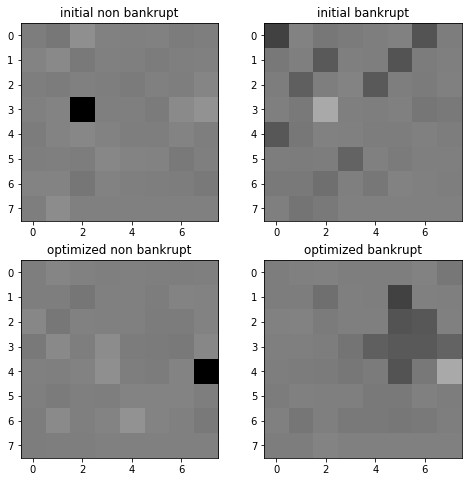

In [58]:
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_8x8, q=None, power_transform=False)
X_train_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


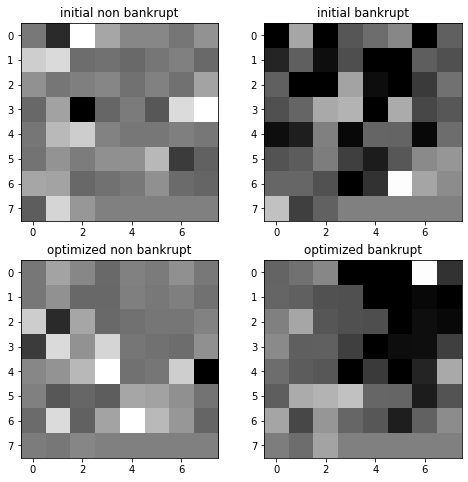

In [59]:
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_8x8, q=0.005, power_transform=False)
X_train_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

	 normalization, quantile clipping and power transform


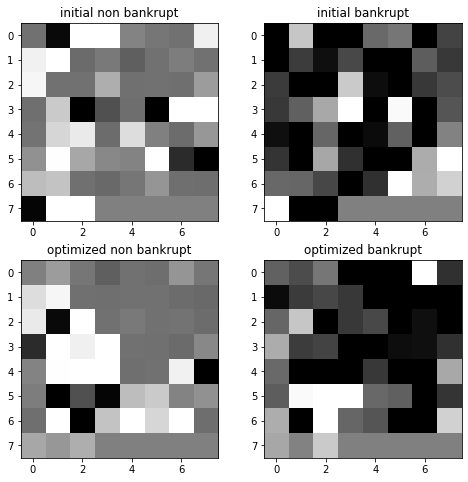

In [60]:
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_8x8, q=0.005, power_transform=True)
X_train_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t normalization, quantile clipping and power transform")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [107]:
# ----- vector to image conversion -----
# training set
X_train_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_train_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_8x8_norm_clip_pt.shape[0])])
X_train_CNN_8x8_norm_clip_pt = X_train_CNN_8x8_norm_clip_pt.reshape(X_train_CNN_8x8_norm_clip_pt.shape+(1,))
Y_train_CNN_8x8_norm_clip_pt = Y_train_CNN_8x8.values
# validation set
X_test_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_test_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_8x8_norm_clip_pt.shape[0])])
X_test_CNN_8x8_norm_clip_pt = X_test_CNN_8x8_norm_clip_pt.reshape(X_test_CNN_8x8_norm_clip_pt.shape+(1,))
Y_test_CNN_8x8_norm_clip_pt = Y_test_CNN_8x8.values

# ----- CNN training -----
modelCNN = define_deep_CNN_2inc_std_L2_drop_04(input_shape=X_train_CNN_8x8_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN_8x8_norm_clip_pt,
                                        Y_train=Y_train_CNN_8x8_norm_clip_pt,
                                        X_val=None, Y_val=None, n_epochs=350,
                                        batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\4year\CNN_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN, historyCNN,
                                                                 modelCNN.get_weights()])), fp)

Train on 8812 samples
Epoch: 1/350,
cumulative time: 4.02s train loss: 0.2856325263692691
Epoch: 2/350,
cumulative time: 5.68s train loss: 0.2154572915811729
Epoch: 3/350,
cumulative time: 7.42s train loss: 0.2086209147099847
Epoch: 4/350,
cumulative time: 9.13s train loss: 0.20429543146708853
Epoch: 5/350,
cumulative time: 10.58s train loss: 0.20041065999948054
Epoch: 6/350,
cumulative time: 12.01s train loss: 0.1983046521125357
Epoch: 7/350,
cumulative time: 13.46s train loss: 0.1980532114404578
Epoch: 8/350,
cumulative time: 14.89s train loss: 0.19621100083257303
Epoch: 9/350,
cumulative time: 16.35s train loss: 0.1955266854185924
Epoch: 10/350,
cumulative time: 17.86s train loss: 0.19390995707827918
Epoch: 11/350,
cumulative time: 19.29s train loss: 0.19335419349490757
Epoch: 12/350,
cumulative time: 20.73s train loss: 0.19269250494631324
Epoch: 13/350,
cumulative time: 22.17s train loss: 0.19426038449007005
Epoch: 14/350,
cumulative time: 23.62s train loss: 0.1951285557068049
Epoc

Epoch: 117/350,
cumulative time: 172.79s train loss: 0.16051375505075205
Epoch: 118/350,
cumulative time: 174.22s train loss: 0.159494404317883
Epoch: 119/350,
cumulative time: 175.63s train loss: 0.158694129827831
Epoch: 120/350,
cumulative time: 177.11s train loss: 0.1601891016035501
Epoch: 121/350,
cumulative time: 178.63s train loss: 0.15959602824352678
Epoch: 122/350,
cumulative time: 180.1s train loss: 0.15885327028425997
Epoch: 123/350,
cumulative time: 181.59s train loss: 0.1579351225462871
Epoch: 124/350,
cumulative time: 183.1s train loss: 0.16274625523911246
Epoch: 125/350,
cumulative time: 184.53s train loss: 0.1584201503140895
Epoch: 126/350,
cumulative time: 185.96s train loss: 0.15632159660620631
Epoch: 127/350,
cumulative time: 187.39s train loss: 0.15609184789031244
Epoch: 128/350,
cumulative time: 188.86s train loss: 0.1564513774038281
Epoch: 129/350,
cumulative time: 190.29s train loss: 0.1566517432721241
Epoch: 130/350,
cumulative time: 191.72s train loss: 0.1565248

Epoch: 230/350,
cumulative time: 334.95s train loss: 0.12220684877253098
Epoch: 231/350,
cumulative time: 336.39s train loss: 0.11869957528017458
Epoch: 232/350,
cumulative time: 337.97s train loss: 0.11784944881330389
Epoch: 233/350,
cumulative time: 339.43s train loss: 0.11876534779154059
Epoch: 234/350,
cumulative time: 340.87s train loss: 0.11951587544149612
Epoch: 235/350,
cumulative time: 342.32s train loss: 0.1166797388333166
Epoch: 236/350,
cumulative time: 343.78s train loss: 0.12128322649133297
Epoch: 237/350,
cumulative time: 345.25s train loss: 0.11602840804770974
Epoch: 238/350,
cumulative time: 346.68s train loss: 0.11640580970315408
Epoch: 239/350,
cumulative time: 348.12s train loss: 0.11631905462016207
Epoch: 240/350,
cumulative time: 349.55s train loss: 0.11558294507978832
Epoch: 241/350,
cumulative time: 350.97s train loss: 0.11660164697970848
Epoch: 242/350,
cumulative time: 352.39s train loss: 0.11712323969946198
Epoch: 243/350,
cumulative time: 353.81s train loss:

Epoch: 343/350,
cumulative time: 496.75s train loss: 0.08815122776315178
Epoch: 344/350,
cumulative time: 498.27s train loss: 0.08994336314144266
Epoch: 345/350,
cumulative time: 499.79s train loss: 0.08505407466476633
Epoch: 346/350,
cumulative time: 501.33s train loss: 0.0885325444847873
Epoch: 347/350,
cumulative time: 502.86s train loss: 0.08669437495023485
Epoch: 348/350,
cumulative time: 504.38s train loss: 0.08821444338863133
Epoch: 349/350,
cumulative time: 505.85s train loss: 0.08597490119930024
Epoch: 350/350,
cumulative time: 507.33s train loss: 0.08685311833350051


In [62]:
# LOADING CNN
with open(r"results\4year\CNN_8x8_production.p", "rb") as fp:
    CNN_8x8_dict = pickle.load(fp)

CNN_8x8 = CNN_8x8_dict["model"]
historyCNN_8x8 = CNN_8x8_dict["history"]

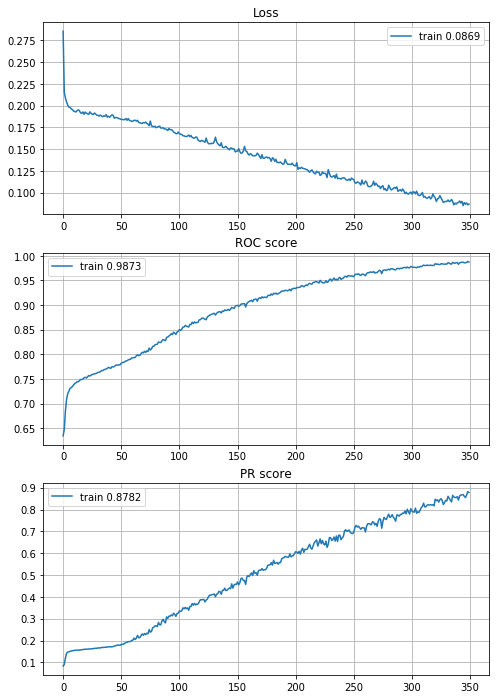

In [107]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_8x8["train_loss"], "-", label="train {}".format(round(historyCNN_8x8["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_8x8["train_roc"], label="train {}".format(round(historyCNN_8x8["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_8x8["train_pr"], label="train {}".format(round(historyCNN_8x8["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 20x20 input Convolutional Neural Network

In [85]:
# training draft for CNN 20x20 input
# loading data
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN=train_set_imp[target].copy()
X_test_CNN=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN=test_set_imp[target].copy()

features_20x20=X_train_CNN.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_20x20=X_train_CNN[Y_train_CNN==0].corr(method="spearman")
# draft inicialization
draft_20x20_ini=image_draft_inicialization(features_20x20, random_state)
# quasi optimization
draft_20x20_opt=MC_Energy_optimization(corr_matrix=corr_matrix_20x20, draft=draft_20x20_ini, alpha=3, n_eval=100,
                                       random_state=random_state)
# transform draft dictionary to matrix
draft_20x20_ini=image_dict_to_matrix(draft_20x20_ini)
draft_20x20_opt=image_dict_to_matrix(draft_20x20_opt)

# SAVING
with open(r"data\4year_data\drafts_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_20x20_ini, draft_20x20_opt])), fp)

initial image energy: 2961715.1988
iteration: 100
current energy: 2865069.845
iteration: 200
current energy: 2794156.8636
iteration: 300
current energy: 2743125.5303
iteration: 400
current energy: 2671825.2421
iteration: 500
current energy: 2597831.6857
iteration: 600
current energy: 2544383.1458
iteration: 700
current energy: 2524281.1143
iteration: 800
current energy: 2492509.2021
iteration: 900
current energy: 2472941.2542
iteration: 1000
current energy: 2445985.5805
iteration: 1100
current energy: 2413169.243
iteration: 1200
current energy: 2395020.4315
iteration: 1300
current energy: 2365224.628
iteration: 1400
current energy: 2350955.3142
iteration: 1500
current energy: 2336455.4068
iteration: 1600
current energy: 2324005.6739
iteration: 1700
current energy: 2299510.2979
iteration: 1800
current energy: 2288246.1835
iteration: 1900
current energy: 2273551.4464
iteration: 2000
current energy: 2250757.0141
iteration: 2100
current energy: 2239330.7008
iteration: 2200
current energy: 

In [63]:
# loading 20x20 drafts
with open(r"data\4year_data\drafts_20x20_production.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

draft_20x20_opt=drafts_20x20["optimized"]
draft_20x20_ini=drafts_20x20["initial"]

			 standarization only


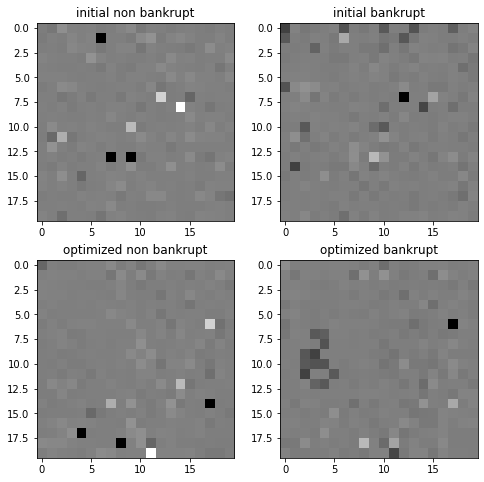

In [64]:
# loading data
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_20x20, q=None, power_transform=False)
X_train_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


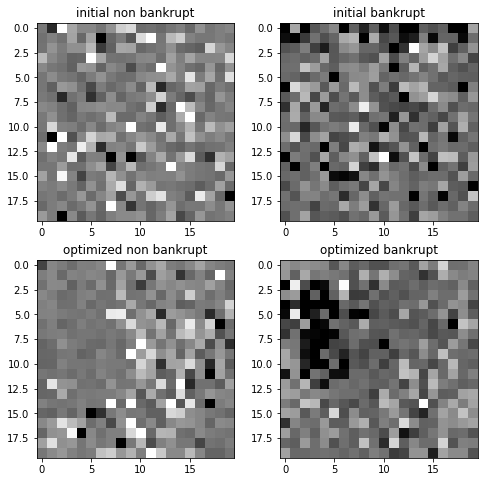

In [65]:
# loading data
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_20x20, q=0.005, power_transform=False)
X_train_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


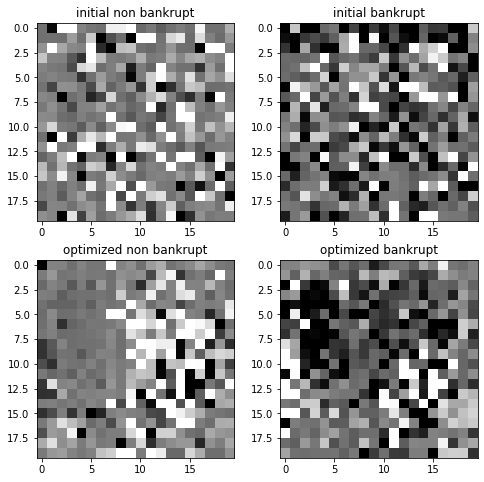

In [66]:
# loading data
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [90]:
# loading data
with open(r"data\4year_data\train_test_imp_sets_4year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)


# ----- vector to image conversion -----
# training set
X_train_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_train_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_20x20_norm_clip_pt.shape[0])])
X_train_CNN_20x20_norm_clip_pt = X_train_CNN_20x20_norm_clip_pt.reshape(X_train_CNN_20x20_norm_clip_pt.shape+(1,))
Y_train_CNN_20x20_norm_clip_pt = Y_train_CNN_20x20.values

# validation set
X_test_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_test_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_20x20_norm_clip_pt.shape[0])])
X_test_CNN_20x20_norm_clip_pt = X_test_CNN_20x20_norm_clip_pt.reshape(X_test_CNN_20x20_norm_clip_pt.shape+(1,))
Y_test_CNN_20x20_norm_clip_pt = Y_test_CNN_20x20.values

# ----- CNN training -----
modelCNN_20x20 = define_deep_CNN_2inc_std_L2_drop_04(input_shape=X_train_CNN_20x20_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN_20x20, historyCNN_20x20 = network_training(network=modelCNN_20x20, X_train=X_train_CNN_20x20_norm_clip_pt,
                                                    Y_train=Y_train_CNN_20x20_norm_clip_pt,
                                                    X_val=None, Y_val=None, n_epochs=157,
                                                    batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\4year\CNN_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN_20x20, historyCNN_20x20,
                                                                 modelCNN_20x20.get_weights()])), fp)

Train on 8812 samples
Epoch: 1/157,
cumulative time: 9.51s train loss: 0.2665133148945844
Epoch: 2/157,
cumulative time: 16.53s train loss: 0.21735058444511116
Epoch: 3/157,
cumulative time: 23.68s train loss: 0.2102411850996035
Epoch: 4/157,
cumulative time: 30.72s train loss: 0.204206593368495
Epoch: 5/157,
cumulative time: 37.73s train loss: 0.20202853492935896
Epoch: 6/157,
cumulative time: 44.86s train loss: 0.20147765246213592
Epoch: 7/157,
cumulative time: 52.15s train loss: 0.19762779424610433
Epoch: 8/157,
cumulative time: 59.31s train loss: 0.1940679321986299
Epoch: 9/157,
cumulative time: 66.51s train loss: 0.19413012751478312
Epoch: 10/157,
cumulative time: 73.76s train loss: 0.19301995329298435
Epoch: 11/157,
cumulative time: 81.2s train loss: 0.19158825139957722
Epoch: 12/157,
cumulative time: 88.7s train loss: 0.19114291246200873
Epoch: 13/157,
cumulative time: 96.04s train loss: 0.19253765786581564
Epoch: 14/157,
cumulative time: 103.09s train loss: 0.19076447515218733


Epoch: 116/157,
cumulative time: 822.29s train loss: 0.10730971930496973
Epoch: 117/157,
cumulative time: 829.36s train loss: 0.10375725770985544
Epoch: 118/157,
cumulative time: 836.35s train loss: 0.10451055575488537
Epoch: 119/157,
cumulative time: 843.35s train loss: 0.10327631112524611
Epoch: 120/157,
cumulative time: 850.38s train loss: 0.10565160508967236
Epoch: 121/157,
cumulative time: 857.39s train loss: 0.10650054106334096
Epoch: 122/157,
cumulative time: 864.42s train loss: 0.0992154605767833
Epoch: 123/157,
cumulative time: 871.46s train loss: 0.09987554346607373
Epoch: 124/157,
cumulative time: 878.49s train loss: 0.09932076086003132
Epoch: 125/157,
cumulative time: 885.49s train loss: 0.09715661714618659
Epoch: 126/157,
cumulative time: 892.51s train loss: 0.09567625605033248
Epoch: 127/157,
cumulative time: 899.51s train loss: 0.09654930654509036
Epoch: 128/157,
cumulative time: 906.49s train loss: 0.10121752434679447
Epoch: 129/157,
cumulative time: 913.55s train loss:

In [68]:
# LOADING CNN
with open(r"results\4year\CNN_20x20_production.p", "rb") as fp:
    CNN_20x20_dict = pickle.load(fp)

CNN_20x20 = CNN_20x20_dict["model"]
historyCNN_20x20 = CNN_20x20_dict["history"]

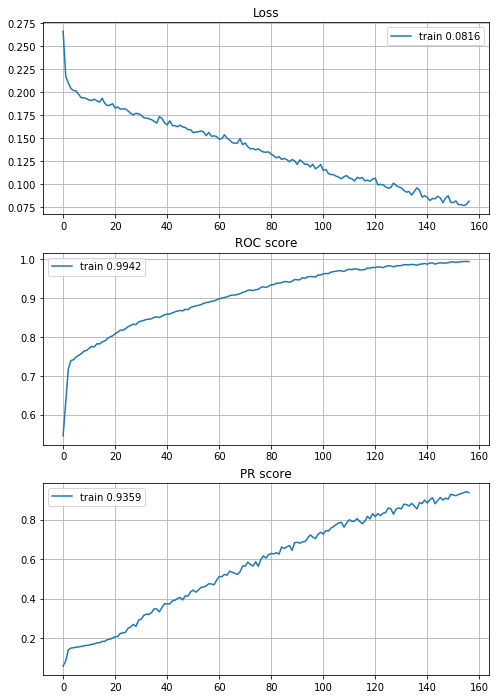

In [92]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_20x20["train_loss"], "-", label="train {}".format(round(historyCNN_20x20["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_20x20["train_roc"], label="train {}".format(round(historyCNN_20x20["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_20x20["train_pr"], label="train {}".format(round(historyCNN_20x20["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

##### "Production" results

In [69]:
# Logistic Regression
Logit_train_probs = Logit.predict(exog=X_train_norm_clip_pt)
Logit_test_probs = Logit.predict(exog=X_test_norm_clip_pt)

Logit_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)
Logit_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)

(Logit_train_roc, Logit_test_roc, Logit_train_pr, Logit_test_pr)

(0.8079900930958221,
 0.8059101458885941,
 0.34191561526841385,
 0.35393281733413906)

In [70]:
# Random Forest
Random_Forest_train_probs = Random_Forest.predict_proba(X=X_train_norm_pt)[:,1]
Random_Forest_test_probs = Random_Forest.predict_proba(X=X_test_norm_pt)[:,1]

Random_Forest_train_roc = roc_auc_score(y_true=Y_train_norm_pt, y_score=Random_Forest_train_probs)
Random_Forest_test_roc = roc_auc_score(y_true=Y_test_norm_pt, y_score=Random_Forest_test_probs)
Random_Forest_train_pr = average_precision_score(y_true=Y_train_norm_pt, y_score=Random_Forest_train_probs)
Random_Forest_test_pr = average_precision_score(y_true=Y_test_norm_pt, y_score=Random_Forest_test_probs)

(Random_Forest_train_roc,Random_Forest_test_roc,Random_Forest_train_pr,Random_Forest_test_pr)

(0.977130252145405,
 0.8545880305039788,
 0.7583794014222153,
 0.39688814530043526)

In [71]:
# Extreme Gradient Boosted Decision Trees
XGBoost_train_probs = XGBoost.predict_proba(data=X_train_raw)[:,1]
XGBoost_test_probs = XGBoost.predict_proba(data=X_test_raw)[:,1]

XGBoost_train_roc = roc_auc_score(y_true=Y_train_raw, y_score=XGBoost_train_probs)
XGBoost_test_roc = roc_auc_score(y_true=Y_test_raw, y_score=XGBoost_test_probs)
XGBoost_train_pr = average_precision_score(y_true=Y_train_raw, y_score=XGBoost_train_probs)
XGBoost_test_pr = average_precision_score(y_true=Y_test_raw, y_score=XGBoost_test_probs)

(XGBoost_train_roc,XGBoost_test_roc,XGBoost_train_pr,XGBoost_test_pr)

(0.9965759404716541,
 0.8928837864721486,
 0.9644119233124818,
 0.4798308128776753)

In [72]:
# Multilayer Percepton
Multilayer_Percepton_train_probs = Multilayer_Percepton.predict(x=X_train_norm_clip_pt.values)
Multilayer_Percepton_test_probs = Multilayer_Percepton.predict(x=X_test_norm_clip_pt.values)

Multilayer_Percepton_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)
Multilayer_Percepton_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)

(Multilayer_Percepton_train_roc,Multilayer_Percepton_test_roc,Multilayer_Percepton_train_pr,Multilayer_Percepton_test_pr)

(0.9708288805813968,
 0.9207352453580901,
 0.8185883718595636,
 0.6699221827397108)

In [73]:
# CNN 8x8
CNN_8x8_train_probs = CNN_8x8.predict(x=X_train_CNN_8x8_norm_clip_pt)
CNN_8x8_test_probs = CNN_8x8.predict(x=X_test_CNN_8x8_norm_clip_pt)

CNN_8x8_train_roc = roc_auc_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_roc = roc_auc_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)
CNN_8x8_train_pr = average_precision_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_pr = average_precision_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)

(CNN_8x8_train_roc,CNN_8x8_test_roc,CNN_8x8_train_pr,CNN_8x8_test_pr)

(0.9873121469003284,
 0.8279799403183024,
 0.8782065461279339,
 0.40943986822211825)

In [74]:
# CNN 20x20
CNN_20x20_train_probs = CNN_20x20.predict(x=X_train_CNN_20x20_norm_clip_pt)
CNN_20x20_test_probs = CNN_20x20.predict(x=X_test_CNN_20x20_norm_clip_pt)

CNN_20x20_train_roc = roc_auc_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_roc = roc_auc_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)
CNN_20x20_train_pr = average_precision_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_pr = average_precision_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)

(CNN_20x20_train_roc,CNN_20x20_test_roc,CNN_20x20_train_pr,CNN_20x20_test_pr)

(0.9941569029490217,
 0.8166238395225464,
 0.9359399314151512,
 0.4501465678004659)

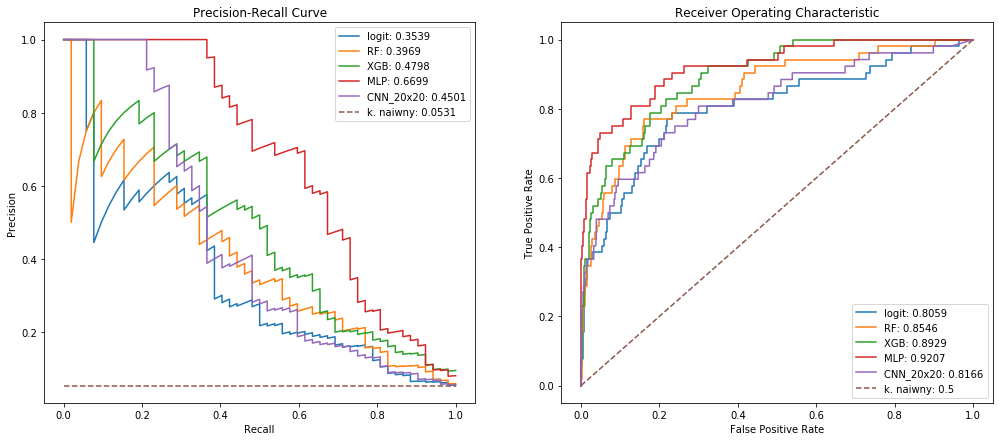

In [78]:
fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(17,7))

logit_precision, logit_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Logit_test_probs)
logit_fpr, logit_tpr, _ = roc_curve(Y_test_norm_clip_pt, Logit_test_probs)

rf_precision, rf_recall, _ = precision_recall_curve(Y_test_norm_pt, Random_Forest_test_probs)
rf_fpr, rf_tpr, _ = roc_curve(Y_test_norm_pt, Random_Forest_test_probs)

xgb_precision, xgb_recall, _ = precision_recall_curve(Y_test_raw, XGBoost_test_probs)
xgb_fpr, xgb_tpr, _ = roc_curve(Y_test_raw, XGBoost_test_probs)

mlp_precision, mlp_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)
mlp_fpr, mlp_tpr, _ = roc_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)

cnn_20x20_precision, cnn_20x20_recall, _ = precision_recall_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)
cnn_20x20_fpr, cnn_20x20_tpr, _ = roc_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)

# cnn_8x8_precision, cnn_8x8_recall, _ = precision_recall_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)
# cnn_8x8_fpr, cnn_8x8_tpr, _ = roc_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)


noskill_probs = [1 for i in range(Y_test.shape[0])]
noskill_fpr, noskill_tpr, _ = roc_curve(Y_test, noskill_probs)
noskill_precision = Y_test[Y_test==1].shape[0]/Y_test.shape[0]
# precision=(TP)/(TP+FP), when y_hat=1 always => TP+FP = n_obs => precision = TP/(n_obs)
# recall = (TP)/(TP+FN), when y_hat=1 always => FN=0 =? TP+FN=TP => recall=TP/TP=1

# ----- PLOTS -----
ax[0].plot(logit_recall, logit_precision, label= "logit: {}".format(round(Logit_test_pr,4)))
ax[0].plot(rf_recall, rf_precision, label= "RF: {}".format(round(Random_Forest_test_pr,4)))
ax[0].plot(xgb_recall, xgb_precision, label= "XGB: {}".format(round(XGBoost_test_pr,4)))
ax[0].plot(mlp_recall, mlp_precision, label= "MLP: {}".format(round(Multilayer_Percepton_test_pr,4)))
ax[0].plot(cnn_20x20_recall, cnn_20x20_precision, label= "CNN_20x20: {}".format(round(CNN_20x20_test_pr,4)))
# ax[0].plot(cnn_8x8_recall, cnn_8x8_precision, label= "CNN_8x8: {}".format(round(CNN_8x8_test_pr,4)))
ax[0].plot([0,1], [noskill_precision, noskill_precision], linestyle='--', label= "k. naiwny: {}".format(
    round(average_precision_score(Y_test, noskill_probs),4)))
ax[0].plot()
ax[0].legend()
ax[0].set_title("Precision-Recall Curve")
ax[0].set_xlabel('Recall')
ax[0].set_ylabel('Precision')


ax[1].plot(logit_fpr, logit_tpr, label="logit: {}".format(round(Logit_test_roc, 4)))
ax[1].plot(rf_fpr, rf_tpr, label="RF: {}".format(round(Random_Forest_test_roc, 4)))
ax[1].plot(xgb_fpr, xgb_tpr, label="XGB: {}".format(round(XGBoost_test_roc, 4)))
ax[1].plot(mlp_fpr, mlp_tpr, label="MLP: {}".format(round(Multilayer_Percepton_test_roc, 4)))
ax[1].plot(cnn_20x20_fpr, cnn_20x20_tpr, label= "CNN_20x20: {}".format(round(CNN_20x20_test_roc,4)))
# ax[1].plot(cnn_8x8_fpr, cnn_8x8_tpr, label= "CNN_8x8: {}".format(round(CNN_8x8_test_roc,4)))
ax[1].plot(noskill_fpr, noskill_tpr, linestyle='--', label= "k. naiwny: {}".format(
    round(roc_auc_score(Y_test, noskill_probs),4)))
ax[1].legend()
ax[1].set_title("Receiver Operating Characteristic")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')
plt.show()